In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.7,
    herding_behavior_stdev = 0.2,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[3139, 6200, 9234, 3724, 2910, 3478, 9498, 2246, 3190, 8064, 5632, 9720, 4784, 869, 7413, 9302, 2280, 4766, 3774, 1777]
log initialized
Average similarity between family members is 0.9740029296187501 at temperature -1
Average similarity between family and home is 0.9998360063349246 at temperature -1
Average similarity between students and their classroom is 0.964379077528699 at temperature -1
Average classroom occupancy is 1.7352941176470589 and number classrooms is 170
Average similarity between workers is 0.9647270158466213 at temperature -1
Average office occupancy is 3.5489130434782608 and number offices is 184
Average friend similarity for adults: 0.8584442160389868 for kids: 0.7528280994337172
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.6592105532725034
avg restaurant similarity 0.709310838790463
avg restaurant similarity 0.6422597325105102
avg restaurant similarity 0.7258635501067155
avg restaurant similarity 0.6610131281702805
avg restaurant similarity 0.7167851637668406
avg restaurant similarity 0.6992682346735352
avg restaurant similarity 0.663694423194587
avg restaurant similarity 0.677459385174019
avg restaurant similarity 0.6964418831267968
avg restaurant similarity 0.6775537814613704
avg restaurant similarity 0.7224192150833771
avg restaurant similarity 0.7379585718519746
avg restaurant similarity 0.697526429477586
avg restaurant similarity 0.6887391978004178
avg restaurant similarity 0.7001929044549913
avg restaurant similarity 0.6739193821281384
avg restaurant similarity 0.6515386231943152
avg restaurant similarity 0.6951275020039488
avg restaurant similarity 0.6964542502674915
avg restaurant similarity 0.6827645596747532
avg restaurant similarity 0.6666521768355519
avg restaurant

avg restaurant similarity 0.6917885757742285
avg restaurant similarity 0.613425441847136
avg restaurant similarity 0.7037715081761597
avg restaurant similarity 0.6330305517885879
avg restaurant similarity 0.659485530176121
avg restaurant similarity 0.703978747031244
avg restaurant similarity 0.7185132229848394
avg restaurant similarity 0.6299235952751605
avg restaurant similarity 0.6429745951791908
avg restaurant similarity 0.7012398801736851
avg restaurant similarity 0.6704089386852259
avg restaurant similarity 0.6445855764079711
avg restaurant similarity 0.7008164509375575
avg restaurant similarity 0.6760681696160309
avg restaurant similarity 0.6946713727209851
avg restaurant similarity 0.6949102093477325
avg restaurant similarity 0.6972474297927965
avg restaurant similarity 0.7117022909001784
avg restaurant similarity 0.6488769296092488
avg restaurant similarity 0.718214154672319
avg restaurant similarity 0.7146314088915557
avg restaurant similarity 0.7091844059662358
avg restaurant

Average similarity between workers is 0.9613711854903795 at temperature -1
Average office occupancy is 3.627027027027027 and number offices is 185
Average friend similarity for adults: 0.8589665919973535 for kids: 0.7288504696961062
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 peop

avg restaurant similarity 0.649418865164733
avg restaurant similarity 0.6710681786379162
avg restaurant similarity 0.7098064009461355
avg restaurant similarity 0.6726046081149814
avg restaurant similarity 0.5891208618721953
avg restaurant similarity 0.6263960361122098
avg restaurant similarity 0.6849807401303312
avg restaurant similarity 0.6444540656008491
avg restaurant similarity 0.6905264597446736
avg restaurant similarity 0.6776047287851064
avg restaurant similarity 0.6420192165483284
avg restaurant similarity 0.6313891191398993
avg restaurant similarity 0.6312743219220676
avg restaurant similarity 0.6392705564332225
avg restaurant similarity 0.7343413508277012
avg restaurant similarity 0.694083176846465
avg restaurant similarity 0.6241459369063453
avg restaurant similarity 0.647385911471511
avg restaurant similarity 0.5968686511269412
avg restaurant similarity 0.7214263591550854
avg restaurant similarity 0.6808646000173448
avg restaurant similarity 0.6148902577330319
avg restauran

avg restaurant similarity 0.6776598958274245
avg restaurant similarity 0.5955414230298923
avg restaurant similarity 0.6402604678099749
avg restaurant similarity 0.6462155155457092
avg restaurant similarity 0.6280311976173397
avg restaurant similarity 0.6549798270609993
avg restaurant similarity 0.6332983522530905
avg restaurant similarity 0.6515260930235184
avg restaurant similarity 0.6147093101376854
avg restaurant similarity 0.6420718082923779
avg restaurant similarity 0.6325993787554192
avg restaurant similarity 0.7064221503489464
avg restaurant similarity 0.6684919259169021
avg restaurant similarity 0.6120837384252406
avg restaurant similarity 0.6573646615138867
avg restaurant similarity 0.6768579045801559
avg restaurant similarity 0.6253613346462731
avg restaurant similarity 0.6566279610854138
avg restaurant similarity 0.6366303890568887
avg restaurant similarity 0.6916383150840327
avg restaurant similarity 0.6312651711454944
avg restaurant similarity 0.7023263152151905
avg restau

Average friend similarity for adults: 0.8581439470917784 for kids: 0.7357121362614478
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.6520127273970818
avg restaurant similarity 0.6367326125640125
avg restaurant similarity 0.6549981702860801
avg restaurant similarity 0.6724621730770743
avg restaurant similarity 0.6811261092049993
avg restaurant similarity 0.6645308728283763
avg restaurant similarity 0.6408387400425634
avg restaurant similarity 0.6825351397019686
avg restaurant similarity 0.6396819221606388
avg restaurant similarity 0.6543025073386827
avg restaurant similarity 0.610515714454656
avg restaurant similarity 0.6763818184923501
avg restaurant similarity 0.676502265165363
avg restaurant similarity 0.6673694240510455
avg restaurant similarity 0.6811783413753957
avg restaurant similarity 0.6761217394357383
avg restaurant similarity 0.645202105820413
avg restaurant similarity 0.6550929015938561
avg restaurant similarity 0.6661851097021144
avg restaurant similarity 0.6753839906405057
avg restaurant similarity 0.6979071330623514
avg restaurant similarity 0.6748126600674407
avg restauran

avg restaurant similarity 0.6804937613168592
avg restaurant similarity 0.71150824164509
avg restaurant similarity 0.6618964731265277
avg restaurant similarity 0.6876646115382128
avg restaurant similarity 0.7088314269941541
avg restaurant similarity 0.704324268154759
avg restaurant similarity 0.6963419951665742
avg restaurant similarity 0.7045651066458231
avg restaurant similarity 0.6845163639120648
avg restaurant similarity 0.6782734843290731
avg restaurant similarity 0.6666685858533179
avg restaurant similarity 0.7069667851077113
avg restaurant similarity 0.7168251321631798
avg restaurant similarity 0.7041838108766465
avg restaurant similarity 0.6858336713176303
avg restaurant similarity 0.6971633679441782
avg restaurant similarity 0.6298449586605784
avg restaurant similarity 0.6620055285815954
avg restaurant similarity 0.6833733293632095
avg restaurant similarity 0.6807582874043207
avg restaurant similarity 0.6593260576167527
avg restaurant similarity 0.6968462993325609
avg restauran

Average similarity between workers is 0.9681613876275178 at temperature -1
Average office occupancy is 3.5597826086956523 and number offices is 184
Average friend similarity for adults: 0.8553409775746026 for kids: 0.73456044602275
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6567244562032798
avg restaurant similarity 0.6495432932481924
avg restaurant similarity 0.7008600381252916
avg restaurant similarity 0.6511018801674573
avg restaurant similarity 0.6513603698810104
avg restaurant similarity 0.6483570759642941
avg restaurant similarity 0.6747822993115481
avg restaurant similarity 0.6669311657693145
avg restaurant similarity 0.6453433767919184
avg restaurant similarity 0.6418637237809713
avg restaurant similarity 0.7072852480351635
avg restaurant similarity 0.7041121573115147
avg restaurant similarity 0.6507941267282669
avg restaurant similarity 0.6740537234794864
avg restaurant similarity 0.6662955793593858
avg restaurant similarity 0.6576519399163508
avg restaurant similarity 0.6615113928872735
avg restaurant similarity 0.64529263193382
avg restaurant similarity 0.7104555863362685
avg restaurant similarity 0.6988258741052118
avg restaurant similarity 0.6560663520268484
avg restaurant similarity 0.7012035483526196
avg restaura

avg restaurant similarity 0.6662113787910942
avg restaurant similarity 0.6678452396642245
avg restaurant similarity 0.7017961495485077
avg restaurant similarity 0.6815209765239699
avg restaurant similarity 0.6296957661754946
avg restaurant similarity 0.6786862900347218
avg restaurant similarity 0.6382006847593538
avg restaurant similarity 0.618060254962888
avg restaurant similarity 0.678859708712294
avg restaurant similarity 0.6879757516265662
avg restaurant similarity 0.708810523682784
avg restaurant similarity 0.7113510575569502
avg restaurant similarity 0.606282368577069
avg restaurant similarity 0.6031550069716967
avg restaurant similarity 0.6580196702754348
avg restaurant similarity 0.7186733375255977
avg restaurant similarity 0.6871109034514262
avg restaurant similarity 0.7075289973454935
avg restaurant similarity 0.661478944480554
avg restaurant similarity 0.7155731611907679
avg restaurant similarity 0.72009277343294
avg restaurant similarity 0.6781736042099308
avg restaurant si

Average similarity between workers is 0.9732399645231626 at temperature -1
Average office occupancy is 3.5722222222222224 and number offices is 180
Average friend similarity for adults: 0.8537355173106775 for kids: 0.739853196820064
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.7262554572452893
avg restaurant similarity 0.6311779398515417
avg restaurant similarity 0.6244818996091911
avg restaurant similarity 0.5979358100018437
avg restaurant similarity 0.6210554243956132
avg restaurant similarity 0.6328964337091327
avg restaurant similarity 0.5698994696961512
avg restaurant similarity 0.7122829120040046
avg restaurant similarity 0.6503392442480289
avg restaurant similarity 0.6171082255187663
avg restaurant similarity 0.5935261263476166
avg restaurant similarity 0.6479935673544979
avg restaurant similarity 0.6498173189771664
avg restaurant similarity 0.6564778578428345
avg restaurant similarity 0.6382808333521705
avg restaurant similarity 0.551662307629926
avg restaurant similarity 0.6587360036445775
avg restaurant similarity 0.6658312811635505
avg restaurant similarity 0.5701384301449739
avg restaurant similarity 0.6816686985724343
avg restaurant similarity 0.6526026916994617
avg restaurant similarity 0.610648565466958
avg restaura

avg restaurant similarity 0.5946614662592709
avg restaurant similarity 0.6764855113759699
avg restaurant similarity 0.6285049101412763
avg restaurant similarity 0.6599265161687761
avg restaurant similarity 0.5277896962543625
avg restaurant similarity 0.6488768159256647
avg restaurant similarity 0.6995001005835213
avg restaurant similarity 0.6283514541571502
avg restaurant similarity 0.6548937983626787
avg restaurant similarity 0.5697635131256317
avg restaurant similarity 0.554558865717597
avg restaurant similarity 0.5908342334633903
avg restaurant similarity 0.6596903325159585
avg restaurant similarity 0.638489946335281
avg restaurant similarity 0.6239491036593867
avg restaurant similarity 0.6448269071680239
avg restaurant similarity 0.6101991240955331
avg restaurant similarity 0.6596969930346807
avg restaurant similarity 0.6244819437775213
avg restaurant similarity 0.5808259574978611
avg restaurant similarity 0.6227612430374094
avg restaurant similarity 0.6280224934795016
avg restaura

Average similarity between workers is 0.977485011598453 at temperature -1
Average office occupancy is 3.552486187845304 and number offices is 181
Average friend similarity for adults: 0.8519356590352444 for kids: 0.7400373336140376
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 peo

avg restaurant similarity 0.6219487809406741
avg restaurant similarity 0.6441331017093581
avg restaurant similarity 0.6496852157680231
avg restaurant similarity 0.718120305210064
avg restaurant similarity 0.6423214627896577
avg restaurant similarity 0.6387351993247761
avg restaurant similarity 0.6556770270348137
avg restaurant similarity 0.6344899078817243
avg restaurant similarity 0.6548230505798214
avg restaurant similarity 0.6577657255205042
avg restaurant similarity 0.6223251153374706
avg restaurant similarity 0.6251482630322418
avg restaurant similarity 0.6657066642980277
avg restaurant similarity 0.6286410401902797
avg restaurant similarity 0.6765725772608829
avg restaurant similarity 0.6685874594556586
avg restaurant similarity 0.6469579822442072
avg restaurant similarity 0.6515238822789945
avg restaurant similarity 0.6081225991977113
avg restaurant similarity 0.6367644913895731
avg restaurant similarity 0.6417876435636615
avg restaurant similarity 0.6461370529829128
avg restaur

avg restaurant similarity 0.6233963907445833
avg restaurant similarity 0.6721514988655221
avg restaurant similarity 0.6469567986169656
avg restaurant similarity 0.6330397843341473
avg restaurant similarity 0.6544620528181014
avg restaurant similarity 0.6157180787925268
avg restaurant similarity 0.6308564440147377
avg restaurant similarity 0.6436990190402331
avg restaurant similarity 0.6512412442671709
avg restaurant similarity 0.6463458511583007
avg restaurant similarity 0.6508269322331517
avg restaurant similarity 0.6199921990153707
avg restaurant similarity 0.6590989764399579
avg restaurant similarity 0.680427197171124
avg restaurant similarity 0.6272586571520391
avg restaurant similarity 0.6753828346104555
avg restaurant similarity 0.6610030384483374
avg restaurant similarity 0.6774625522850727
avg restaurant similarity 0.6432350503438775
avg restaurant similarity 0.575034339234318
avg restaurant similarity 0.6553501197176109
avg restaurant similarity 0.6479137857212979
avg restaura

Average similarity between workers is 0.9781111029719215 at temperature -1
Average office occupancy is 3.469945355191257 and number offices is 183
Average friend similarity for adults: 0.8523959453885738 for kids: 0.7454507243918462
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 pe

avg restaurant similarity 0.7120091508578312
avg restaurant similarity 0.672242335799651
avg restaurant similarity 0.630662989477394
avg restaurant similarity 0.6761565780507123
avg restaurant similarity 0.6663173530792692
avg restaurant similarity 0.6790115997033155
avg restaurant similarity 0.6645574246648714
avg restaurant similarity 0.6637218235742157
avg restaurant similarity 0.7033836843093912
avg restaurant similarity 0.6664571734788145
avg restaurant similarity 0.6701205406340731
avg restaurant similarity 0.7178037070173011
avg restaurant similarity 0.6314878500008909
avg restaurant similarity 0.6736585502177237
avg restaurant similarity 0.6740145642460468
avg restaurant similarity 0.6659323780597041
avg restaurant similarity 0.6920434903543715
avg restaurant similarity 0.7138826616006312
avg restaurant similarity 0.6534993474276714
avg restaurant similarity 0.6677101975859473
avg restaurant similarity 0.6637147420066697
avg restaurant similarity 0.6937210936309802
avg restaura

avg restaurant similarity 0.6438016612251878
avg restaurant similarity 0.6931451638401289
avg restaurant similarity 0.6632803443295693
avg restaurant similarity 0.6597272336671026
avg restaurant similarity 0.6729858391819133
avg restaurant similarity 0.6717490995216981
avg restaurant similarity 0.692373774785567
avg restaurant similarity 0.6718782611734956
avg restaurant similarity 0.6516653333386961
avg restaurant similarity 0.6942745482770182
avg restaurant similarity 0.7152078308382726
avg restaurant similarity 0.7081938124316007
avg restaurant similarity 0.6320770061208099
avg restaurant similarity 0.6686867872869758
avg restaurant similarity 0.6669450222846212
avg restaurant similarity 0.685617255291962
avg restaurant similarity 0.6417965180333295
avg restaurant similarity 0.6897160587547297
avg restaurant similarity 0.6591470555315572
avg restaurant similarity 0.6445240863455978
avg restaurant similarity 0.6487679702682495
avg restaurant similarity 0.6812489314130316
avg restaura

Average similarity between workers is 0.9651793959878948 at temperature -1
Average office occupancy is 3.557377049180328 and number offices is 183
Average friend similarity for adults: 0.847992007409634 for kids: 0.726820721475526
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6813911415670504
avg restaurant similarity 0.6582925243736735
avg restaurant similarity 0.693974742116518
avg restaurant similarity 0.6812502191382227
avg restaurant similarity 0.6642893331586237
avg restaurant similarity 0.6697416036797388
avg restaurant similarity 0.6869042208508709
avg restaurant similarity 0.647409368612858
avg restaurant similarity 0.6673207346725735
avg restaurant similarity 0.680732119955139
avg restaurant similarity 0.6937815874576783
avg restaurant similarity 0.6274812369378978
avg restaurant similarity 0.7124913162393604
avg restaurant similarity 0.7025014557680984
avg restaurant similarity 0.6631693244280039
avg restaurant similarity 0.6554996566101261
avg restaurant similarity 0.6693147746822796
avg restaurant similarity 0.6927371055862986
avg restaurant similarity 0.7576904292111588
avg restaurant similarity 0.6619561776131128
avg restaurant similarity 0.6502124053790891
avg restaurant similarity 0.7133612656338616
avg restauran

avg restaurant similarity 0.6562394286511588
avg restaurant similarity 0.6927853707643575
avg restaurant similarity 0.699399125338128
avg restaurant similarity 0.6814109544955226
avg restaurant similarity 0.6686841837936216
avg restaurant similarity 0.6840510760561261
avg restaurant similarity 0.6658594678337947
avg restaurant similarity 0.6451721918124037
avg restaurant similarity 0.6923009292486824
avg restaurant similarity 0.6823571190174023
avg restaurant similarity 0.7084240451437055
avg restaurant similarity 0.6494304788003971
avg restaurant similarity 0.6605176867385429
avg restaurant similarity 0.7053532103747113
avg restaurant similarity 0.7388449442431273
avg restaurant similarity 0.6507185234665436
avg restaurant similarity 0.6534190361639189
avg restaurant similarity 0.7441803958246705
avg restaurant similarity 0.686721146580631
avg restaurant similarity 0.691022241092254
avg restaurant similarity 0.7049622304246179
avg restaurant similarity 0.6713461062488356
avg restauran

Average similarity between workers is 0.9592215056607813 at temperature -1
Average office occupancy is 3.393617021276596 and number offices is 188
Average friend similarity for adults: 0.853070474745195 for kids: 0.7414518186235017
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 peopl

avg restaurant similarity 0.7231547770716311
avg restaurant similarity 0.6385213545653633
avg restaurant similarity 0.6820770213713337
avg restaurant similarity 0.6651139676613166
avg restaurant similarity 0.6889063065103135
avg restaurant similarity 0.654085942914057
avg restaurant similarity 0.6669372086690292
avg restaurant similarity 0.689415006778319
avg restaurant similarity 0.6833382822905795
avg restaurant similarity 0.6985503217477604
avg restaurant similarity 0.7054215814726478
avg restaurant similarity 0.6909384348603905
avg restaurant similarity 0.7056273780828045
avg restaurant similarity 0.7016825901235475
avg restaurant similarity 0.7526477876517793
avg restaurant similarity 0.6448014565592739
avg restaurant similarity 0.6951967433124823
avg restaurant similarity 0.6697153423398817
avg restaurant similarity 0.6180898288512318
avg restaurant similarity 0.6476875093556173
avg restaurant similarity 0.6652765087328936
avg restaurant similarity 0.7190239326656023
avg restaura

avg restaurant similarity 0.6579098337601942
avg restaurant similarity 0.7297498532287353
avg restaurant similarity 0.6424833969203424
avg restaurant similarity 0.6554192468857831
avg restaurant similarity 0.6584504829514941
avg restaurant similarity 0.6775787369248227
avg restaurant similarity 0.703284685533945
avg restaurant similarity 0.6606250477310958
avg restaurant similarity 0.689301060586305
avg restaurant similarity 0.7086614744739823
avg restaurant similarity 0.6968183342346196
avg restaurant similarity 0.7328843426414067
avg restaurant similarity 0.6515963776126362
avg restaurant similarity 0.6765886743765007
avg restaurant similarity 0.6931876314985855
avg restaurant similarity 0.6755750905205015
avg restaurant similarity 0.6820981438672804
avg restaurant similarity 0.6775402921132987
avg restaurant similarity 0.6761444337433508
avg restaurant similarity 0.7014407988572062
avg restaurant similarity 0.7174179684711176
avg restaurant similarity 0.6802983828064906
avg restaura

Average similarity between workers is 0.9745905613898322 at temperature -1
Average office occupancy is 3.582010582010582 and number offices is 189
Average friend similarity for adults: 0.8667424001654092 for kids: 0.7406167623206104
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peop

avg restaurant similarity 0.6973230480854788
avg restaurant similarity 0.6620388489375176
avg restaurant similarity 0.6809988609504286
avg restaurant similarity 0.644304956785791
avg restaurant similarity 0.7026731340137458
avg restaurant similarity 0.6937457004519458
avg restaurant similarity 0.687651792650644
avg restaurant similarity 0.6666613971199354
avg restaurant similarity 0.6930956751478268
avg restaurant similarity 0.6624297805395181
avg restaurant similarity 0.6187731433995888
avg restaurant similarity 0.6767597746771784
avg restaurant similarity 0.6882069965871005
avg restaurant similarity 0.7098201220588257
avg restaurant similarity 0.6669760362073113
avg restaurant similarity 0.723312125475391
avg restaurant similarity 0.6986133427614215
avg restaurant similarity 0.6541613719427372
avg restaurant similarity 0.701634299531919
avg restaurant similarity 0.7336439018639571
avg restaurant similarity 0.6877283781216941
avg restaurant similarity 0.6723917809954149
avg restaurant

avg restaurant similarity 0.7397936997947256
avg restaurant similarity 0.6388010727943875
avg restaurant similarity 0.6549731776545783
avg restaurant similarity 0.6805758794771023
avg restaurant similarity 0.6730618819040433
avg restaurant similarity 0.6836637012647037
avg restaurant similarity 0.6882889567337632
avg restaurant similarity 0.6940371800696225
avg restaurant similarity 0.6696756565835071
avg restaurant similarity 0.7057283131938014
avg restaurant similarity 0.6880683015474146
avg restaurant similarity 0.6882044792567608
avg restaurant similarity 0.6677906513805156
avg restaurant similarity 0.6805092287446578
avg restaurant similarity 0.6893148148611076
avg restaurant similarity 0.6933008188785788
avg restaurant similarity 0.6527419363274609
avg restaurant similarity 0.7128919377896977
avg restaurant similarity 0.7047359047212746
avg restaurant similarity 0.6815367601282982
avg restaurant similarity 0.7117851763830294
avg restaurant similarity 0.6738606492976347
avg restau

Average similarity between workers is 0.9575020557292019 at temperature -1
Average office occupancy is 3.630434782608696 and number offices is 184
Average friend similarity for adults: 0.858632368077426 for kids: 0.7349414063712044
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people 

avg restaurant similarity 0.6405574611206195
avg restaurant similarity 0.6464022874783877
avg restaurant similarity 0.6426344332334245
avg restaurant similarity 0.6813056193740132
avg restaurant similarity 0.6721342431306282
avg restaurant similarity 0.6405624770496235
avg restaurant similarity 0.6934919272534859
avg restaurant similarity 0.6450690020544307
avg restaurant similarity 0.6538482415999454
avg restaurant similarity 0.6563224591145123
avg restaurant similarity 0.6401499315461564
avg restaurant similarity 0.6269666496691332
avg restaurant similarity 0.6477736055137594
avg restaurant similarity 0.6049557752215386
avg restaurant similarity 0.6406070379583385
avg restaurant similarity 0.6800934328040151
avg restaurant similarity 0.6203017025563943
avg restaurant similarity 0.5842843199573057
avg restaurant similarity 0.6437206538086069
avg restaurant similarity 0.675172809160618
avg restaurant similarity 0.6740601718130736
avg restaurant similarity 0.6838989220234638
avg restaur

avg restaurant similarity 0.648481852058017
avg restaurant similarity 0.6850008322636354
avg restaurant similarity 0.6840934608107134
avg restaurant similarity 0.6438388332662732
avg restaurant similarity 0.6332697696330126
avg restaurant similarity 0.6530302692748434
avg restaurant similarity 0.6293454307732061
avg restaurant similarity 0.6628433478416274
avg restaurant similarity 0.6690434476056845
avg restaurant similarity 0.6237942752054281
avg restaurant similarity 0.6240634226678162
avg restaurant similarity 0.6293034896435995
avg restaurant similarity 0.6869756152300887
avg restaurant similarity 0.6455005741068308
avg restaurant similarity 0.6684490196442708
avg restaurant similarity 0.6566840043560893
avg restaurant similarity 0.606527329542836
avg restaurant similarity 0.6322824588531613
avg restaurant similarity 0.6457348343977666
avg restaurant similarity 0.6761221432932881
avg restaurant similarity 0.660185517694429
avg restaurant similarity 0.5801767517955995
avg restauran

Average similarity between workers is 0.969483737548456 at temperature -1
Average office occupancy is 3.449197860962567 and number offices is 187
Average friend similarity for adults: 0.8536362618493555 for kids: 0.7497449809008778
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6246862740172233
avg restaurant similarity 0.6644227908328861
avg restaurant similarity 0.660658581365262
avg restaurant similarity 0.6523979960992907
avg restaurant similarity 0.666849100840993
avg restaurant similarity 0.7028055045640175
avg restaurant similarity 0.6702157392448919
avg restaurant similarity 0.669402788221102
avg restaurant similarity 0.6801097201044488
avg restaurant similarity 0.68006943977039
avg restaurant similarity 0.6385735285086468
avg restaurant similarity 0.694002833207601
avg restaurant similarity 0.6827611061967569
avg restaurant similarity 0.6545213054257136
avg restaurant similarity 0.6583901046816084
avg restaurant similarity 0.6931280817563749
avg restaurant similarity 0.7048721478047015
avg restaurant similarity 0.669323905317678
avg restaurant similarity 0.6997737788808086
avg restaurant similarity 0.7028332325502613
avg restaurant similarity 0.663520896173612
avg restaurant similarity 0.6674477722563027
avg restaurant sim

avg restaurant similarity 0.6194700115232096
avg restaurant similarity 0.6254894611943516
avg restaurant similarity 0.7040052372724047
avg restaurant similarity 0.6684287704950959
avg restaurant similarity 0.6715278185418825
avg restaurant similarity 0.6880785330602788
avg restaurant similarity 0.667649665042339
avg restaurant similarity 0.680697582758898
avg restaurant similarity 0.6281395495291068
avg restaurant similarity 0.6967128596581734
avg restaurant similarity 0.6754796129987878
avg restaurant similarity 0.7064004098906023
avg restaurant similarity 0.7344640560904236
avg restaurant similarity 0.6431368920394
avg restaurant similarity 0.6635748576453435
avg restaurant similarity 0.6764016276164294
avg restaurant similarity 0.6611538280387802
avg restaurant similarity 0.6517731328735217
avg restaurant similarity 0.6472326417236751
avg restaurant similarity 0.6361123756122268
avg restaurant similarity 0.6579448950588789
avg restaurant similarity 0.6664736566001741
avg restaurant 

Average similarity between workers is 0.9636623175368092 at temperature -1
Average office occupancy is 3.6923076923076925 and number offices is 182
Average friend similarity for adults: 0.8564262276958525 for kids: 0.7305807828208123
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.6524670694766151
avg restaurant similarity 0.6637129032300373
avg restaurant similarity 0.6436586113514708
avg restaurant similarity 0.640022700987557
avg restaurant similarity 0.7331779699064809
avg restaurant similarity 0.6728435757189093
avg restaurant similarity 0.6348765921918237
avg restaurant similarity 0.7012681559442491
avg restaurant similarity 0.6483339264908228
avg restaurant similarity 0.6617909007424294
avg restaurant similarity 0.6652365851826579
avg restaurant similarity 0.6756101766819276
avg restaurant similarity 0.6519005412249155
avg restaurant similarity 0.7238806127576061
avg restaurant similarity 0.6893114612021861
avg restaurant similarity 0.6844213431321184
avg restaurant similarity 0.6459986752895465
avg restaurant similarity 0.6762271717766075
avg restaurant similarity 0.6716426580229183
avg restaurant similarity 0.6739095185186686
avg restaurant similarity 0.694041498277906
avg restaurant similarity 0.6579205802247416
avg restaura

avg restaurant similarity 0.6648302017539447
avg restaurant similarity 0.677787883836433
avg restaurant similarity 0.6552182484947022
avg restaurant similarity 0.6667946164606356
avg restaurant similarity 0.6789669806603154
avg restaurant similarity 0.7058575072497876
avg restaurant similarity 0.6527325065143195
avg restaurant similarity 0.7028067731370523
avg restaurant similarity 0.6804894309689663
avg restaurant similarity 0.6571322033017891
avg restaurant similarity 0.6678170437511024
avg restaurant similarity 0.6685669327006721
avg restaurant similarity 0.7062678496742414
avg restaurant similarity 0.6923421707844865
avg restaurant similarity 0.6706878455647881
avg restaurant similarity 0.6763180233116521
avg restaurant similarity 0.6863811605579488
avg restaurant similarity 0.6732415954440731
avg restaurant similarity 0.670385662993063
avg restaurant similarity 0.6672879046186352
avg restaurant similarity 0.6795922300640087
avg restaurant similarity 0.6596025976841855
avg restaura

Average similarity between workers is 0.9737992162205529 at temperature -1
Average office occupancy is 3.5631578947368423 and number offices is 190
Average friend similarity for adults: 0.8585386651791737 for kids: 0.726409110010679
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6805942796315039
avg restaurant similarity 0.667879769721791
avg restaurant similarity 0.6967879032850799
avg restaurant similarity 0.6424415930767524
avg restaurant similarity 0.6680730566279244
avg restaurant similarity 0.6968086580051089
avg restaurant similarity 0.6694670180541423
avg restaurant similarity 0.6517888831420662
avg restaurant similarity 0.6632237430117031
avg restaurant similarity 0.6539048285065592
avg restaurant similarity 0.6150750710036907
avg restaurant similarity 0.6200435391047139
avg restaurant similarity 0.6046125156212582
avg restaurant similarity 0.6619721050386201
avg restaurant similarity 0.702162654342848
avg restaurant similarity 0.686519818523532
avg restaurant similarity 0.6312545319404177
avg restaurant similarity 0.6883688749903957
avg restaurant similarity 0.6880173855481164
avg restaurant similarity 0.5858646973826986
avg restaurant similarity 0.6599261649707279
avg restaurant similarity 0.6865437708211247
avg restauran

avg restaurant similarity 0.6903268826480303
avg restaurant similarity 0.6520997111127104
avg restaurant similarity 0.6268108924549691
avg restaurant similarity 0.6826428034140486
avg restaurant similarity 0.6276320543191153
avg restaurant similarity 0.6549578146527235
avg restaurant similarity 0.7191061294674856
avg restaurant similarity 0.629065489805152
avg restaurant similarity 0.66804977960811
avg restaurant similarity 0.726652228699043
avg restaurant similarity 0.6854611274687801
avg restaurant similarity 0.7175587288867792
avg restaurant similarity 0.6865349375962098
avg restaurant similarity 0.6539622463574152
avg restaurant similarity 0.7420022783430203
avg restaurant similarity 0.6607178061909433
avg restaurant similarity 0.6379933546660946
avg restaurant similarity 0.6511737557244183
avg restaurant similarity 0.6478735081885927
avg restaurant similarity 0.6820119045275522
avg restaurant similarity 0.6732928058596486
avg restaurant similarity 0.6755160167933915
avg restaurant

Average similarity between workers is 0.9676755834489739 at temperature -1
Average office occupancy is 3.6777777777777776 and number offices is 180
Average friend similarity for adults: 0.8654768652272525 for kids: 0.7285414439612444
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6163628727629479
avg restaurant similarity 0.7154034338540202
avg restaurant similarity 0.6683398864834621
avg restaurant similarity 0.6707608208365238
avg restaurant similarity 0.6518202949815768
avg restaurant similarity 0.7409304918861301
avg restaurant similarity 0.7249444531270286
avg restaurant similarity 0.6669753269536761
avg restaurant similarity 0.6876896667237822
avg restaurant similarity 0.6863794650384657
avg restaurant similarity 0.6454583726366299
avg restaurant similarity 0.7087120792859866
avg restaurant similarity 0.6486423781296048
avg restaurant similarity 0.6429463861093657
avg restaurant similarity 0.6186308657326168
avg restaurant similarity 0.67897371480006
avg restaurant similarity 0.6817757958254932
avg restaurant similarity 0.6376354081467538
avg restaurant similarity 0.6532246740622284
avg restaurant similarity 0.691161726127837
avg restaurant similarity 0.6588059635977499
avg restaurant similarity 0.6358249331475314
avg restauran

avg restaurant similarity 0.6215273699760582
avg restaurant similarity 0.7052189818628685
avg restaurant similarity 0.6979221594382462
avg restaurant similarity 0.6525816331819042
avg restaurant similarity 0.6563380335132479
avg restaurant similarity 0.6588227434805839
avg restaurant similarity 0.616050468204617
avg restaurant similarity 0.719128958164535
avg restaurant similarity 0.6401324332702625
avg restaurant similarity 0.6592726036891784
avg restaurant similarity 0.666023454329999
avg restaurant similarity 0.6613230558898764
avg restaurant similarity 0.689131894940907
avg restaurant similarity 0.7028260387396639
avg restaurant similarity 0.676015071533284
avg restaurant similarity 0.6695540598953893
avg restaurant similarity 0.7077553755362097
avg restaurant similarity 0.6373332742183124
avg restaurant similarity 0.6324665029638313
avg restaurant similarity 0.6371488763096659
avg restaurant similarity 0.6743612037054838
avg restaurant similarity 0.6305715466963331
avg restaurant 

Average similarity between workers is 0.9612344969446462 at temperature -1
Average office occupancy is 3.585635359116022 and number offices is 181
Average friend similarity for adults: 0.8468059642147521 for kids: 0.7426124993357944
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6889644464673964
avg restaurant similarity 0.7286090106891439
avg restaurant similarity 0.6513069289533525
avg restaurant similarity 0.6478420188129436
avg restaurant similarity 0.6930733140401488
avg restaurant similarity 0.6803559213336053
avg restaurant similarity 0.6588011795067875
avg restaurant similarity 0.6570009977797051
avg restaurant similarity 0.6481007176080559
avg restaurant similarity 0.6762035041279201
avg restaurant similarity 0.6444944188701068
avg restaurant similarity 0.6822399277731996
avg restaurant similarity 0.6870908599374212
avg restaurant similarity 0.6560288018406438
avg restaurant similarity 0.7054497326228765
avg restaurant similarity 0.6580286583227177
avg restaurant similarity 0.6652141895910971
avg restaurant similarity 0.7093959112523188
avg restaurant similarity 0.6686752424183808
avg restaurant similarity 0.6492749023451265
avg restaurant similarity 0.7058659253276369
avg restaurant similarity 0.667663853503823
avg restaur

avg restaurant similarity 0.7012289230488589
avg restaurant similarity 0.6575616664947203
avg restaurant similarity 0.6686099339868976
avg restaurant similarity 0.6816894463767238
avg restaurant similarity 0.65368230564909
avg restaurant similarity 0.6732433179189442
avg restaurant similarity 0.6585108828145193
avg restaurant similarity 0.6823629203627621
avg restaurant similarity 0.6733798900992954
avg restaurant similarity 0.7065860623754422
avg restaurant similarity 0.7060196493195783
avg restaurant similarity 0.720808983556732
avg restaurant similarity 0.6983383296118701
avg restaurant similarity 0.6726030732984062
avg restaurant similarity 0.6542530094452587
avg restaurant similarity 0.7072236212810846
avg restaurant similarity 0.6174711496524556
avg restaurant similarity 0.7084955974934942
avg restaurant similarity 0.6371928194821532
avg restaurant similarity 0.6853081968826558
avg restaurant similarity 0.6773372001461138
avg restaurant similarity 0.6434845516907421
avg restauran

Average similarity between workers is 0.9552714938774137 at temperature -1
Average office occupancy is 3.619047619047619 and number offices is 189
Average friend similarity for adults: 0.8609002600213365 for kids: 0.7335812037195061
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 peop

avg restaurant similarity 0.6889549241344385
avg restaurant similarity 0.7168880984507633
avg restaurant similarity 0.6934053417897595
avg restaurant similarity 0.6921220703699024
avg restaurant similarity 0.7210612682448664
avg restaurant similarity 0.7430588474223637
avg restaurant similarity 0.7255108091489894
avg restaurant similarity 0.6445653706542941
avg restaurant similarity 0.73411777245818
avg restaurant similarity 0.7283543694252379
avg restaurant similarity 0.7086818169053587
avg restaurant similarity 0.7223059945252537
avg restaurant similarity 0.7129259912558045
avg restaurant similarity 0.6801659092365431
avg restaurant similarity 0.642984980394275
avg restaurant similarity 0.7039074418401505
avg restaurant similarity 0.7126960242528909
avg restaurant similarity 0.7052483861683354
avg restaurant similarity 0.7005112743081
avg restaurant similarity 0.6660399668692589
avg restaurant similarity 0.6632897741729521
avg restaurant similarity 0.6355556343073064
avg restaurant s

avg restaurant similarity 0.69343358934224
avg restaurant similarity 0.6530142041093454
avg restaurant similarity 0.6409773506870216
avg restaurant similarity 0.6747533360111435
avg restaurant similarity 0.6656237518597344
avg restaurant similarity 0.6760783553616188
avg restaurant similarity 0.6452875614714402
avg restaurant similarity 0.6255801521473587
avg restaurant similarity 0.6771923948710539
avg restaurant similarity 0.6769452356655269
avg restaurant similarity 0.6598245316774403
avg restaurant similarity 0.6644781694560543
avg restaurant similarity 0.663506268960306
avg restaurant similarity 0.6596547774148832
avg restaurant similarity 0.6139215389809403
avg restaurant similarity 0.6631620404528544
avg restaurant similarity 0.6777642981893586
avg restaurant similarity 0.6929022726398967
avg restaurant similarity 0.6734158360203034
avg restaurant similarity 0.6419364452173795
avg restaurant similarity 0.6867768943965015
avg restaurant similarity 0.707131326134898
avg restaurant

Average similarity between workers is 0.9661594530647745 at temperature -1
Average office occupancy is 3.4789473684210526 and number offices is 190
Average friend similarity for adults: 0.8635673478224642 for kids: 0.7474925317732899
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6727227713582916
avg restaurant similarity 0.6529004033127113
avg restaurant similarity 0.6759761955284216
avg restaurant similarity 0.70991784789245
avg restaurant similarity 0.6803108396925341
avg restaurant similarity 0.6866679662615403
avg restaurant similarity 0.6640333538895467
avg restaurant similarity 0.6859445303575779
avg restaurant similarity 0.6839942935234306
avg restaurant similarity 0.6747284147730599
avg restaurant similarity 0.6534894518914012
avg restaurant similarity 0.6743566006894466
avg restaurant similarity 0.681933258520631
avg restaurant similarity 0.6635267592373573
avg restaurant similarity 0.7379890485844479
avg restaurant similarity 0.6745535250683022
avg restaurant similarity 0.706688807110461
avg restaurant similarity 0.6775412121591111
avg restaurant similarity 0.6982201777413204
avg restaurant similarity 0.6697890675953186
avg restaurant similarity 0.6850019409389575
avg restaurant similarity 0.6988024393327639
avg restaurant

avg restaurant similarity 0.6736777057306038
avg restaurant similarity 0.6782646781258005
avg restaurant similarity 0.6417715208137597
avg restaurant similarity 0.6874405088742896
avg restaurant similarity 0.6633213265992797
avg restaurant similarity 0.6775715202233384
avg restaurant similarity 0.6667776327815571
avg restaurant similarity 0.7057530892037288
avg restaurant similarity 0.660943331517092
avg restaurant similarity 0.710457830896687
avg restaurant similarity 0.6810614239505722
avg restaurant similarity 0.692512494554816
avg restaurant similarity 0.7195061416665796
avg restaurant similarity 0.6574014513978946
avg restaurant similarity 0.6593789832405177
avg restaurant similarity 0.6875533577456948
avg restaurant similarity 0.6959021823675023
avg restaurant similarity 0.6916851069608025
avg restaurant similarity 0.6588910898479258
avg restaurant similarity 0.6672356235243917
avg restaurant similarity 0.6599245420950272
avg restaurant similarity 0.7064689996639213
avg restauran

Average similarity between workers is 0.9628173369214 at temperature -1
Average office occupancy is 3.535135135135135 and number offices is 185
Average friend similarity for adults: 0.8627898076948973 for kids: 0.7376986975463017
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people 

avg restaurant similarity 0.6799096804714783
avg restaurant similarity 0.7378403382686848
avg restaurant similarity 0.702634744751735
avg restaurant similarity 0.6863409094823993
avg restaurant similarity 0.6829543506838998
avg restaurant similarity 0.6815639903919621
avg restaurant similarity 0.7429538000150334
avg restaurant similarity 0.6771496844286646
avg restaurant similarity 0.7521092138380435
avg restaurant similarity 0.6519657095539072
avg restaurant similarity 0.7141186694859767
avg restaurant similarity 0.6924137088657916
avg restaurant similarity 0.7107613514295754
avg restaurant similarity 0.6930921814082817
avg restaurant similarity 0.7310661745634534
avg restaurant similarity 0.7100823758887201
avg restaurant similarity 0.7383153652852699
avg restaurant similarity 0.6729108581897209
avg restaurant similarity 0.7000676676563262
avg restaurant similarity 0.677306223994222
avg restaurant similarity 0.7037741099843722
avg restaurant similarity 0.7109840128663458
avg restaura

avg restaurant similarity 0.717383121215101
avg restaurant similarity 0.6918028871546648
avg restaurant similarity 0.6908626545103927
avg restaurant similarity 0.6945413028993426
avg restaurant similarity 0.7207186364324618
avg restaurant similarity 0.7102259815130895
avg restaurant similarity 0.6633751379617504
avg restaurant similarity 0.656872580199789
avg restaurant similarity 0.6788405134201858
avg restaurant similarity 0.7235690666766862
avg restaurant similarity 0.697117047597743
avg restaurant similarity 0.694019647377606
avg restaurant similarity 0.7558096192773782
avg restaurant similarity 0.6812491985101268
avg restaurant similarity 0.6987775999094905
avg restaurant similarity 0.6962902071063105
avg restaurant similarity 0.6897546135615156
avg restaurant similarity 0.7200436705382938
avg restaurant similarity 0.7147994084080918
avg restaurant similarity 0.7219145805296967
avg restaurant similarity 0.7034581293762174
avg restaurant similarity 0.7156401192863179
avg restaurant

Average similarity between workers is 0.9587935309516025 at temperature -1
Average office occupancy is 3.5801104972375692 and number offices is 181
Average friend similarity for adults: 0.8488298788210228 for kids: 0.7419814576830845
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.631729765482703
avg restaurant similarity 0.6809024908009389
avg restaurant similarity 0.6874001199888615
avg restaurant similarity 0.6522922649967136
avg restaurant similarity 0.644099592981134
avg restaurant similarity 0.6866925549642006
avg restaurant similarity 0.6801408757961714
avg restaurant similarity 0.684498502704924
avg restaurant similarity 0.6855446312453213
avg restaurant similarity 0.6826236575979766
avg restaurant similarity 0.6239253928915276
avg restaurant similarity 0.6722639806167309
avg restaurant similarity 0.6726719011238909
avg restaurant similarity 0.6961929029100102
avg restaurant similarity 0.6607910787531085
avg restaurant similarity 0.6516488399587985
avg restaurant similarity 0.6778384594097864
avg restaurant similarity 0.6938247901474242
avg restaurant similarity 0.6993985427417126
avg restaurant similarity 0.6439286515058041
avg restaurant similarity 0.6944469089897018
avg restaurant similarity 0.6274644282462674
avg restauran

avg restaurant similarity 0.6522436016301221
avg restaurant similarity 0.667984276199134
avg restaurant similarity 0.6718891379740638
avg restaurant similarity 0.6446896559680879
avg restaurant similarity 0.6926999500864879
avg restaurant similarity 0.6809910591814909
avg restaurant similarity 0.699368030363084
avg restaurant similarity 0.6998434526020918
avg restaurant similarity 0.6805510982812706
avg restaurant similarity 0.6497813824102984
avg restaurant similarity 0.6783482669362793
avg restaurant similarity 0.6287589738638487
avg restaurant similarity 0.673469530162355
avg restaurant similarity 0.6325717060259369
avg restaurant similarity 0.6707574617879147
avg restaurant similarity 0.6581631693137848
avg restaurant similarity 0.6509415630844357
avg restaurant similarity 0.6486522215634362
avg restaurant similarity 0.7019983768517611
avg restaurant similarity 0.6779653421583353
avg restaurant similarity 0.6931452112896558
avg restaurant similarity 0.6366493630183145
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

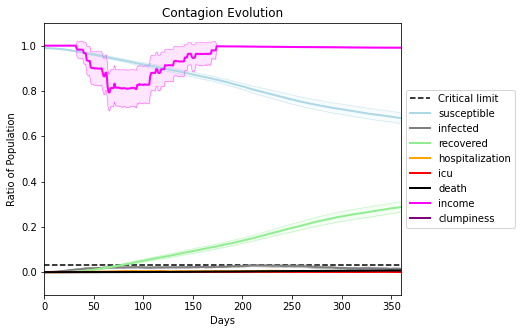

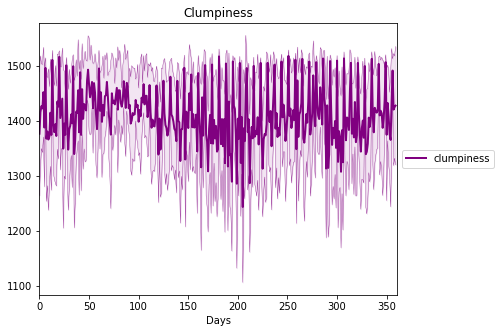

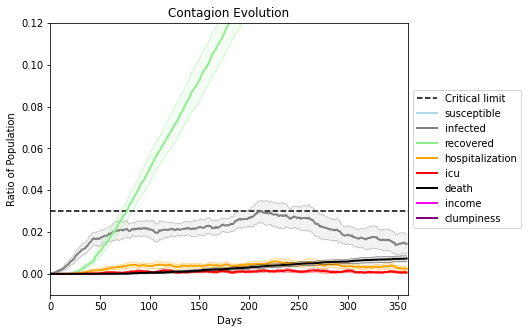

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9754, 3674, 3712, 8541, 2771, 5088, 5422, 5952, 2333, 548, 3318, 1311, 8706, 5946, 7732, 457, 4153, 8908, 7737, 8783]
Average similarity between family members is 0.9664150124859351 at temperature -0.999
Average similarity between family and home is 0.9998520915310534 at temperature -1
Average similarity between students and their classroom is 0.9637991580556694 at temperature -0.999
Average classroom occupancy is 1.7745664739884393 and number classrooms is 173
Average similarity between workers is 0.9738266164871552 at temperature -0.999
Average office occupancy is 3.4171122994652405 and number offices is 187
Average friend similarity for adults: 0.853695735460823 for kids: 0.7456458665674413
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.7082092771660793
avg restaurant similarity 0.6487782952598272
avg restaurant similarity 0.6831163487002863
avg restaurant similarity 0.6973328855336056
avg restaurant similarity 0.6736234952485608
avg restaurant similarity 0.6615374544578624
avg restaurant similarity 0.6998762579121602
avg restaurant similarity 0.6690862378498899
avg restaurant similarity 0.6621749782260821
avg restaurant similarity 0.6715927339898881
avg restaurant similarity 0.6487989616442955
avg restaurant similarity 0.6836230575185246
avg restaurant similarity 0.6836534963863425
avg restaurant similarity 0.6606768099367601
avg restaurant similarity 0.6486774007862158
avg restaurant similarity 0.6724996171405616
avg restaurant similarity 0.6370940724529887
avg restaurant similarity 0.6302694545599995
avg restaurant similarity 0.6633879884647303
avg restaurant similarity 0.6770592002780288
avg restaurant similarity 0.7050575288408176
avg restaurant similarity 0.6682124879587218
avg restau

avg restaurant similarity 0.6460493672492277
avg restaurant similarity 0.5967174951212422
avg restaurant similarity 0.6648160441560194
avg restaurant similarity 0.6689388799279872
avg restaurant similarity 0.6757031161721675
avg restaurant similarity 0.6384987777180945
avg restaurant similarity 0.6479722172310012
avg restaurant similarity 0.6961147347153696
avg restaurant similarity 0.7066494305233788
avg restaurant similarity 0.6610932750077297
avg restaurant similarity 0.7015759324945674
avg restaurant similarity 0.6249704508688839
avg restaurant similarity 0.6732395103081584
avg restaurant similarity 0.6414152829588006
avg restaurant similarity 0.6769981229554564
avg restaurant similarity 0.6612693560811644
avg restaurant similarity 0.7268738412348923
avg restaurant similarity 0.6782741468921762
avg restaurant similarity 0.6875324594891423
avg restaurant similarity 0.6898253766895798
avg restaurant similarity 0.7140524479558311
avg restaurant similarity 0.655354223887376
avg restaur

Average similarity between workers is 0.966976734168778 at temperature -0.999
Average office occupancy is 3.405128205128205 and number offices is 195
Average friend similarity for adults: 0.8602094088205275 for kids: 0.7435747118655163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.7248408804299699
avg restaurant similarity 0.670885877118196
avg restaurant similarity 0.6632271650921199
avg restaurant similarity 0.6477707025714151
avg restaurant similarity 0.6130051963860474
avg restaurant similarity 0.6704975849236888
avg restaurant similarity 0.6483979455826373
avg restaurant similarity 0.695768369666756
avg restaurant similarity 0.6832307749815185
avg restaurant similarity 0.6184090275976084
avg restaurant similarity 0.6433987319842082
avg restaurant similarity 0.5918482995631882
avg restaurant similarity 0.6464072951693376
avg restaurant similarity 0.6225702892563902
avg restaurant similarity 0.696846905268706
avg restaurant similarity 0.6656745718430872
avg restaurant similarity 0.6637210805397299
avg restaurant similarity 0.6191977401893928
avg restaurant similarity 0.6379902424987285
avg restaurant similarity 0.6425241858891878
avg restaurant similarity 0.6856531183994065
avg restaurant similarity 0.6430308822094156
avg restauran

avg restaurant similarity 0.6916071468845566
avg restaurant similarity 0.7063511671266175
avg restaurant similarity 0.7131892833211781
avg restaurant similarity 0.6843833126718767
avg restaurant similarity 0.7124229051699005
avg restaurant similarity 0.6563190918254294
avg restaurant similarity 0.7035130049142866
avg restaurant similarity 0.6342041597856537
avg restaurant similarity 0.6759098136726241
avg restaurant similarity 0.6665835921081753
avg restaurant similarity 0.7121805075590791
avg restaurant similarity 0.674880385930394
avg restaurant similarity 0.6540704031151551
avg restaurant similarity 0.683596807326263
avg restaurant similarity 0.7230356376353841
avg restaurant similarity 0.6863437630774638
avg restaurant similarity 0.6747068702543435
avg restaurant similarity 0.6882699809406799
avg restaurant similarity 0.6673607727597597
avg restaurant similarity 0.7404264204459335
avg restaurant similarity 0.6624897991620063
avg restaurant similarity 0.6999179177352816
avg restaura

Average similarity between workers is 0.9767077774228704 at temperature -0.999
Average office occupancy is 3.4345549738219896 and number offices is 191
Average friend similarity for adults: 0.8538645757240917 for kids: 0.7372064272025743
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6670580444379741
avg restaurant similarity 0.6838839934792242
avg restaurant similarity 0.6605455594968267
avg restaurant similarity 0.618818010402393
avg restaurant similarity 0.6696797517754907
avg restaurant similarity 0.6385281178810128
avg restaurant similarity 0.7007117238976489
avg restaurant similarity 0.6643132615836259
avg restaurant similarity 0.6770815163426951
avg restaurant similarity 0.6697250169816638
avg restaurant similarity 0.6614996397948871
avg restaurant similarity 0.6839741142080551
avg restaurant similarity 0.6790850382394075
avg restaurant similarity 0.7041869643395886
avg restaurant similarity 0.6479149094573847
avg restaurant similarity 0.6693117642342302
avg restaurant similarity 0.6795264496902484
avg restaurant similarity 0.6519348122215373
avg restaurant similarity 0.7131903654668619
avg restaurant similarity 0.6500164965732472
avg restaurant similarity 0.66257842137964
avg restaurant similarity 0.6908222848323095
avg restauran

avg restaurant similarity 0.6364845857657426
avg restaurant similarity 0.5820436624387645
avg restaurant similarity 0.6265884099042972
avg restaurant similarity 0.6341884747541318
avg restaurant similarity 0.6884946049939602
avg restaurant similarity 0.6296040630550754
avg restaurant similarity 0.6532223539529752
avg restaurant similarity 0.645401369539064
avg restaurant similarity 0.6378536819505028
avg restaurant similarity 0.6406103048237235
avg restaurant similarity 0.6179951392077613
avg restaurant similarity 0.6532633446508154
avg restaurant similarity 0.6355414534572569
avg restaurant similarity 0.6173334601499194
avg restaurant similarity 0.6381730412595683
avg restaurant similarity 0.6231965998286761
avg restaurant similarity 0.6080035283100939
avg restaurant similarity 0.6308121782934528
avg restaurant similarity 0.6498413321590137
avg restaurant similarity 0.6265313935778765
avg restaurant similarity 0.6110053548448922
avg restaurant similarity 0.6321303208527985
avg restaur

Average similarity between workers is 0.9651101780619761 at temperature -0.999
Average office occupancy is 3.6055555555555556 and number offices is 180
Average friend similarity for adults: 0.8536556448408578 for kids: 0.7289493507361142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.697821076352717
avg restaurant similarity 0.6627936066805752
avg restaurant similarity 0.7008796110191178
avg restaurant similarity 0.7635943290344591
avg restaurant similarity 0.6714230866582002
avg restaurant similarity 0.752801281736488
avg restaurant similarity 0.7163395062637925
avg restaurant similarity 0.7112689414831257
avg restaurant similarity 0.6799516880066588
avg restaurant similarity 0.7279224032658027
avg restaurant similarity 0.7039800335645039
avg restaurant similarity 0.620292067100766
avg restaurant similarity 0.7533815205094853
avg restaurant similarity 0.7461759580304311
avg restaurant similarity 0.705268460061188
avg restaurant similarity 0.6810403066935131
avg restaurant similarity 0.693137626053004
avg restaurant similarity 0.6931438625002039
avg restaurant similarity 0.7549531309312596
avg restaurant similarity 0.6791930527573836
avg restaurant similarity 0.72606172793841
avg restaurant similarity 0.6881439841869751
avg restaurant si

avg restaurant similarity 0.6687417436075246
avg restaurant similarity 0.6810632292755636
avg restaurant similarity 0.7007440761314576
avg restaurant similarity 0.6995791015611595
avg restaurant similarity 0.7688550090100575
avg restaurant similarity 0.7138018169278189
avg restaurant similarity 0.6932755056315801
avg restaurant similarity 0.746595150102719
avg restaurant similarity 0.701292370127835
avg restaurant similarity 0.7092813406220491
avg restaurant similarity 0.6469448709699225
avg restaurant similarity 0.7020923730965284
avg restaurant similarity 0.6620857083497628
avg restaurant similarity 0.7058087336356503
avg restaurant similarity 0.7490226644991061
avg restaurant similarity 0.7212294649962205
avg restaurant similarity 0.713666865438459
avg restaurant similarity 0.7056412960249148
avg restaurant similarity 0.7176614019746931
avg restaurant similarity 0.6385318758180077
avg restaurant similarity 0.6611522330962758
avg restaurant similarity 0.7404700263907275
avg restauran

Average similarity between workers is 0.9633697568778934 at temperature -0.999
Average office occupancy is 3.6956521739130435 and number offices is 184
Average friend similarity for adults: 0.8630697990818201 for kids: 0.732091323649996
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.7311162146411564
avg restaurant similarity 0.6536660519054895
avg restaurant similarity 0.7264457654632921
avg restaurant similarity 0.7079689659774998
avg restaurant similarity 0.7333247381947922
avg restaurant similarity 0.7347608229754422
avg restaurant similarity 0.7436130491700838
avg restaurant similarity 0.6757547197539767
avg restaurant similarity 0.6735758438616769
avg restaurant similarity 0.6766890459767573
avg restaurant similarity 0.7445081321701781
avg restaurant similarity 0.6937465766093562
avg restaurant similarity 0.7285442212130224
avg restaurant similarity 0.7141387900331011
avg restaurant similarity 0.7529178062383681
avg restaurant similarity 0.6807868365928015
avg restaurant similarity 0.7568784783150223
avg restaurant similarity 0.7357482926119214
avg restaurant similarity 0.7138271167311613
avg restaurant similarity 0.6987575094625867
avg restaurant similarity 0.7404202047008359
avg restaurant similarity 0.6489022172105656
avg restau

avg restaurant similarity 0.6947111528758563
avg restaurant similarity 0.7285084409817392
avg restaurant similarity 0.6790267200827282
avg restaurant similarity 0.7072595318674701
avg restaurant similarity 0.6699526718915741
avg restaurant similarity 0.7125389172831033
avg restaurant similarity 0.6775339494516881
avg restaurant similarity 0.6902869059035175
avg restaurant similarity 0.6815892301879594
avg restaurant similarity 0.6993474361779763
avg restaurant similarity 0.7366776862575233
avg restaurant similarity 0.685398007044
avg restaurant similarity 0.7000040800326933
avg restaurant similarity 0.7042907102807143
avg restaurant similarity 0.7191533338199421
avg restaurant similarity 0.699630979356625
avg restaurant similarity 0.6752831374149528
avg restaurant similarity 0.6744062474945387
avg restaurant similarity 0.7248312535339958
avg restaurant similarity 0.701589066367168
avg restaurant similarity 0.713522871758026
avg restaurant similarity 0.683389876328803
avg restaurant sim

Average similarity between workers is 0.9797560790860533 at temperature -0.999
Average office occupancy is 3.596685082872928 and number offices is 181
Average friend similarity for adults: 0.8533256106686092 for kids: 0.7379292240950218
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6294228261551179
avg restaurant similarity 0.6104405055773967
avg restaurant similarity 0.6088655001026088
avg restaurant similarity 0.6914553179790229
avg restaurant similarity 0.6057551325046557
avg restaurant similarity 0.6631249643052191
avg restaurant similarity 0.6433676506263569
avg restaurant similarity 0.6493759120642226
avg restaurant similarity 0.6461818566698165
avg restaurant similarity 0.6012933468655134
avg restaurant similarity 0.6824343572239879
avg restaurant similarity 0.6477043226438179
avg restaurant similarity 0.6901610449176877
avg restaurant similarity 0.6540270345967174
avg restaurant similarity 0.679972194327265
avg restaurant similarity 0.6727125253910747
avg restaurant similarity 0.6856796930692135
avg restaurant similarity 0.6601762516022154
avg restaurant similarity 0.688832462360568
avg restaurant similarity 0.6509794863572801
avg restaurant similarity 0.6625076174768787
avg restaurant similarity 0.6973395667445128
avg restaura

avg restaurant similarity 0.7099765522991835
avg restaurant similarity 0.6829998514580852
avg restaurant similarity 0.6158144639794833
avg restaurant similarity 0.67265644198147
avg restaurant similarity 0.7013300202688793
avg restaurant similarity 0.5467063421907138
avg restaurant similarity 0.7055431447791326
avg restaurant similarity 0.6470314063882486
avg restaurant similarity 0.6319890082859438
avg restaurant similarity 0.6297923679412899
avg restaurant similarity 0.6630196556849078
avg restaurant similarity 0.608634749510315
avg restaurant similarity 0.6932561731126595
avg restaurant similarity 0.6298348900096049
avg restaurant similarity 0.6744664207426532
avg restaurant similarity 0.6102160151495652
avg restaurant similarity 0.6271561308446024
avg restaurant similarity 0.609783409990307
avg restaurant similarity 0.6939379071955
avg restaurant similarity 0.6187249402484446
avg restaurant similarity 0.6481533825326002
avg restaurant similarity 0.6438249944337049
avg restaurant si

Average similarity between workers is 0.9586487522715521 at temperature -0.999
Average office occupancy is 3.4456521739130435 and number offices is 184
Average friend similarity for adults: 0.8458620603588352 for kids: 0.7361529701364254
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6743891042376131
avg restaurant similarity 0.6553441970860596
avg restaurant similarity 0.6360986754692504
avg restaurant similarity 0.6565798098110555
avg restaurant similarity 0.6530581289757025
avg restaurant similarity 0.659076458372144
avg restaurant similarity 0.6759376171767455
avg restaurant similarity 0.6590799655790235
avg restaurant similarity 0.6507307829183214
avg restaurant similarity 0.6589110913960868
avg restaurant similarity 0.6151687111187475
avg restaurant similarity 0.6581718690244366
avg restaurant similarity 0.6188539007595738
avg restaurant similarity 0.6593777681897127
avg restaurant similarity 0.6765052207391361
avg restaurant similarity 0.6450555005883124
avg restaurant similarity 0.7189525133051511
avg restaurant similarity 0.6592226891496279
avg restaurant similarity 0.6916983298267199
avg restaurant similarity 0.6674658624840659
avg restaurant similarity 0.6573024495621348
avg restaurant similarity 0.6482618448281774
avg restaur

avg restaurant similarity 0.6582138645350093
avg restaurant similarity 0.6463996908856722
avg restaurant similarity 0.6687185579526462
avg restaurant similarity 0.6671433227037513
avg restaurant similarity 0.705489079187204
avg restaurant similarity 0.6607534435174728
avg restaurant similarity 0.6816250653152416
avg restaurant similarity 0.6957162369946364
avg restaurant similarity 0.6482689792798808
avg restaurant similarity 0.6496154396668317
avg restaurant similarity 0.655498164588083
avg restaurant similarity 0.6667518003336738
avg restaurant similarity 0.6517095655533605
avg restaurant similarity 0.6270286919556237
avg restaurant similarity 0.6556198322907176
avg restaurant similarity 0.6431739116819657
avg restaurant similarity 0.6219231824859573
avg restaurant similarity 0.6447825379277298
avg restaurant similarity 0.6537845436401809
avg restaurant similarity 0.6654100792581794
avg restaurant similarity 0.657030983424493
avg restaurant similarity 0.6785531437983097
avg restauran

Average similarity between workers is 0.9709023102374493 at temperature -0.999
Average office occupancy is 3.3703703703703702 and number offices is 189
Average friend similarity for adults: 0.8606768051324651 for kids: 0.7537225947844162
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6724491165422032
avg restaurant similarity 0.6702458720181368
avg restaurant similarity 0.6796648980619013
avg restaurant similarity 0.7185575585358654
avg restaurant similarity 0.6744847471810207
avg restaurant similarity 0.6503838891626079
avg restaurant similarity 0.6641196514281734
avg restaurant similarity 0.638980844634323
avg restaurant similarity 0.6673845590656419
avg restaurant similarity 0.7169302306619827
avg restaurant similarity 0.6695151912117039
avg restaurant similarity 0.6634195263348011
avg restaurant similarity 0.6143684413776099
avg restaurant similarity 0.7108663781115576
avg restaurant similarity 0.6510397118598469
avg restaurant similarity 0.6480521434982159
avg restaurant similarity 0.6857602114667146
avg restaurant similarity 0.7334710619860942
avg restaurant similarity 0.674594856964089
avg restaurant similarity 0.6833322749945843
avg restaurant similarity 0.6212660136328613
avg restaurant similarity 0.6650686411573948
avg restaura

avg restaurant similarity 0.6164611840131974
avg restaurant similarity 0.6944133284091748
avg restaurant similarity 0.6096067838413419
avg restaurant similarity 0.6014226421282868
avg restaurant similarity 0.5982491777403511
avg restaurant similarity 0.6016977047573296
avg restaurant similarity 0.644996318895974
avg restaurant similarity 0.6877567814490257
avg restaurant similarity 0.6619384659394631
avg restaurant similarity 0.6951233109023799
avg restaurant similarity 0.6628217220524464
avg restaurant similarity 0.6446473080657795
avg restaurant similarity 0.6419440680794745
avg restaurant similarity 0.6334728850021993
avg restaurant similarity 0.6158061036684663
avg restaurant similarity 0.6470768510252414
avg restaurant similarity 0.6467273392008228
avg restaurant similarity 0.6119971667830829
avg restaurant similarity 0.6986099846381522
avg restaurant similarity 0.6533068577976439
avg restaurant similarity 0.5887751797540209
avg restaurant similarity 0.6133642441346083
avg restaur

Average similarity between workers is 0.9560419416483021 at temperature -0.999
Average office occupancy is 3.4972677595628414 and number offices is 183
Average friend similarity for adults: 0.8497658924051222 for kids: 0.7377003449223644
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6745702665914355
avg restaurant similarity 0.6422570458204482
avg restaurant similarity 0.6594643755183545
avg restaurant similarity 0.6601791897109383
avg restaurant similarity 0.6593165061769831
avg restaurant similarity 0.6692668802186965
avg restaurant similarity 0.6616584534207623
avg restaurant similarity 0.647964368402054
avg restaurant similarity 0.6450354286941181
avg restaurant similarity 0.6791874854575753
avg restaurant similarity 0.6552749061182229
avg restaurant similarity 0.6414358801757856
avg restaurant similarity 0.700250496442075
avg restaurant similarity 0.6199066073119995
avg restaurant similarity 0.7041278181600996
avg restaurant similarity 0.6476080854086966
avg restaurant similarity 0.6849027353172373
avg restaurant similarity 0.6446736985980904
avg restaurant similarity 0.6438660110918567
avg restaurant similarity 0.6520320100459317
avg restaurant similarity 0.7031142315476685
avg restaurant similarity 0.7045494853675739
avg restaura

avg restaurant similarity 0.6500719903620981
avg restaurant similarity 0.6770649442392322
avg restaurant similarity 0.6618944908465435
avg restaurant similarity 0.6730751226547288
avg restaurant similarity 0.6823316228868022
avg restaurant similarity 0.6744962232276085
avg restaurant similarity 0.6418346907457626
avg restaurant similarity 0.6747868617816556
avg restaurant similarity 0.7298380600238501
avg restaurant similarity 0.63440114042081
avg restaurant similarity 0.6855126936815323
avg restaurant similarity 0.6811239849427501
avg restaurant similarity 0.6883826073972483
avg restaurant similarity 0.6982228633929287
avg restaurant similarity 0.6924743228458965
avg restaurant similarity 0.697506049720673
avg restaurant similarity 0.6863403834128563
avg restaurant similarity 0.6863447489225356
avg restaurant similarity 0.6875645816077472
avg restaurant similarity 0.6743637484608807
avg restaurant similarity 0.6983250380536009
avg restaurant similarity 0.6397459492448164
avg restauran

Average similarity between workers is 0.9843015326393555 at temperature -0.999
Average office occupancy is 3.453038674033149 and number offices is 181
Average friend similarity for adults: 0.8496326648430723 for kids: 0.7530099244569919
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6853374594949463
avg restaurant similarity 0.684030387096718
avg restaurant similarity 0.6770254596551953
avg restaurant similarity 0.7524215653283456
avg restaurant similarity 0.6675796820022658
avg restaurant similarity 0.6410241535640644
avg restaurant similarity 0.6564095166753895
avg restaurant similarity 0.6919950732012672
avg restaurant similarity 0.661726947464307
avg restaurant similarity 0.7315447640147288
avg restaurant similarity 0.6576985092629533
avg restaurant similarity 0.6661880616258278
avg restaurant similarity 0.6346719453400974
avg restaurant similarity 0.661328901594637
avg restaurant similarity 0.6877446556796991
avg restaurant similarity 0.7072947858283135
avg restaurant similarity 0.7418155104247445
avg restaurant similarity 0.6780218859209528
avg restaurant similarity 0.6312389831970353
avg restaurant similarity 0.6563625466035824
avg restaurant similarity 0.6313181597866807
avg restaurant similarity 0.6583764912296978
avg restauran

avg restaurant similarity 0.6825577507585772
avg restaurant similarity 0.6625572995402939
avg restaurant similarity 0.6648345208810119
avg restaurant similarity 0.7177721053440083
avg restaurant similarity 0.6617890418903464
avg restaurant similarity 0.6629445623765192
avg restaurant similarity 0.6458355716788687
avg restaurant similarity 0.6436299939887101
avg restaurant similarity 0.6732185910910529
avg restaurant similarity 0.6692393487905752
avg restaurant similarity 0.6763257037066892
avg restaurant similarity 0.6692096583366853
avg restaurant similarity 0.6812636937649883
avg restaurant similarity 0.669015618747201
avg restaurant similarity 0.6624259936068034
avg restaurant similarity 0.5651109529587934
avg restaurant similarity 0.6490682579334425
avg restaurant similarity 0.6409327225932876
avg restaurant similarity 0.642951503174996
avg restaurant similarity 0.6917548160774082
avg restaurant similarity 0.6506976497051471
avg restaurant similarity 0.6512263848891785
avg restaura

Average similarity between workers is 0.9767441956477618 at temperature -0.999
Average office occupancy is 3.357142857142857 and number offices is 196
Average friend similarity for adults: 0.8654909704414495 for kids: 0.736527313516454
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6873446285981465
avg restaurant similarity 0.6442585906812641
avg restaurant similarity 0.7243986598236877
avg restaurant similarity 0.6167887426319942
avg restaurant similarity 0.7281158353692111
avg restaurant similarity 0.6315286601133964
avg restaurant similarity 0.6844402903255855
avg restaurant similarity 0.6296994566538667
avg restaurant similarity 0.638306854850456
avg restaurant similarity 0.7135328301448819
avg restaurant similarity 0.6461977040033543
avg restaurant similarity 0.6269006691147503
avg restaurant similarity 0.6799248691041512
avg restaurant similarity 0.6853475209747074
avg restaurant similarity 0.6557485554756006
avg restaurant similarity 0.6678469549179386
avg restaurant similarity 0.6958676803917537
avg restaurant similarity 0.6849594536349318
avg restaurant similarity 0.6927985615705355
avg restaurant similarity 0.7155655410730725
avg restaurant similarity 0.6240291185364745
avg restaurant similarity 0.697112669188225
avg restaura

avg restaurant similarity 0.6321900567662058
avg restaurant similarity 0.6932767479824439
avg restaurant similarity 0.6383348699506423
avg restaurant similarity 0.6414184273484181
avg restaurant similarity 0.6964714872993403
avg restaurant similarity 0.6634546639585828
avg restaurant similarity 0.6801256861735294
avg restaurant similarity 0.7623529496334184
avg restaurant similarity 0.6970178516317476
avg restaurant similarity 0.7148747580762311
avg restaurant similarity 0.6681797072440333
avg restaurant similarity 0.645375444044116
avg restaurant similarity 0.6473361981349692
avg restaurant similarity 0.6818577838695351
avg restaurant similarity 0.6772049156940522
avg restaurant similarity 0.6802373598433119
avg restaurant similarity 0.6511169519521791
avg restaurant similarity 0.6471208420817692
avg restaurant similarity 0.6285069769273899
avg restaurant similarity 0.6738504053053249
avg restaurant similarity 0.6726750042471766
avg restaurant similarity 0.618119677725158
avg restaura

Average similarity between workers is 0.9707140797636975 at temperature -0.999
Average office occupancy is 3.618279569892473 and number offices is 186
Average friend similarity for adults: 0.8558273899535195 for kids: 0.7285606234358674
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6299683605495884
avg restaurant similarity 0.7010932439492517
avg restaurant similarity 0.6501718237428528
avg restaurant similarity 0.6994786518308636
avg restaurant similarity 0.679049065391277
avg restaurant similarity 0.7035720042697624
avg restaurant similarity 0.691320788724625
avg restaurant similarity 0.6906822671484877
avg restaurant similarity 0.6099462383452452
avg restaurant similarity 0.6487661821964101
avg restaurant similarity 0.6861469357606065
avg restaurant similarity 0.657771680940932
avg restaurant similarity 0.7261834302324652
avg restaurant similarity 0.6526800230615427
avg restaurant similarity 0.6678656981205923
avg restaurant similarity 0.6970400754317105
avg restaurant similarity 0.6692444920038205
avg restaurant similarity 0.6517901420129
avg restaurant similarity 0.6807006797496127
avg restaurant similarity 0.6491945824929435
avg restaurant similarity 0.6861329821260915
avg restaurant similarity 0.6474813349423144
avg restaurant s

avg restaurant similarity 0.7145129526906062
avg restaurant similarity 0.6697638208985939
avg restaurant similarity 0.6568985727800017
avg restaurant similarity 0.6985078768384295
avg restaurant similarity 0.6643115187943411
avg restaurant similarity 0.6719566411075754
avg restaurant similarity 0.6532478518018823
avg restaurant similarity 0.6608769163516838
avg restaurant similarity 0.6280684018282296
avg restaurant similarity 0.6271171744570692
avg restaurant similarity 0.6925947522802687
avg restaurant similarity 0.5928379830376933
avg restaurant similarity 0.6507049756012252
avg restaurant similarity 0.6691115111898319
avg restaurant similarity 0.6436594792583201
avg restaurant similarity 0.6449281119041629
avg restaurant similarity 0.6986115290272578
avg restaurant similarity 0.6197404054506043
avg restaurant similarity 0.5695640937359371
avg restaurant similarity 0.6832901130927955
avg restaurant similarity 0.6108145855462673
avg restaurant similarity 0.6502727081359698
avg restau

Average similarity between workers is 0.9660172044820401 at temperature -0.999
Average office occupancy is 3.39247311827957 and number offices is 186
Average friend similarity for adults: 0.8459678673106134 for kids: 0.7398651346417597
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6614397000038772
avg restaurant similarity 0.63170302632784
avg restaurant similarity 0.6043009987574085
avg restaurant similarity 0.6379931750740045
avg restaurant similarity 0.6205593176936607
avg restaurant similarity 0.6057952047504183
avg restaurant similarity 0.6310345810271599
avg restaurant similarity 0.6357289854850238
avg restaurant similarity 0.5538380390596628
avg restaurant similarity 0.6527544779034309
avg restaurant similarity 0.6801541884830185
avg restaurant similarity 0.6531756357251545
avg restaurant similarity 0.5958445405554736
avg restaurant similarity 0.6996485185623356
avg restaurant similarity 0.6256346264745075
avg restaurant similarity 0.6282576013036145
avg restaurant similarity 0.6395060112607295
avg restaurant similarity 0.6257404995456004
avg restaurant similarity 0.7109338197791787
avg restaurant similarity 0.6868775080799102
avg restaurant similarity 0.6611950402256839
avg restaurant similarity 0.6779948127187508
avg restaura

avg restaurant similarity 0.649199427139123
avg restaurant similarity 0.6403005130744109
avg restaurant similarity 0.6236816658027503
avg restaurant similarity 0.5247784176111172
avg restaurant similarity 0.6574382054718487
avg restaurant similarity 0.6340849059308907
avg restaurant similarity 0.7146406066683786
avg restaurant similarity 0.6357517174231055
avg restaurant similarity 0.6548422367795586
avg restaurant similarity 0.7033170660758472
avg restaurant similarity 0.6601833877935719
avg restaurant similarity 0.6888800411431681
avg restaurant similarity 0.6631519128653707
avg restaurant similarity 0.624454379417582
avg restaurant similarity 0.6221596379051486
avg restaurant similarity 0.6783791773321421
avg restaurant similarity 0.674284078115344
avg restaurant similarity 0.6624492064111352
avg restaurant similarity 0.6800892316915118
avg restaurant similarity 0.6566920699312284
avg restaurant similarity 0.6886778226451061
avg restaurant similarity 0.6315066740064399
avg restauran

Average similarity between workers is 0.9650901697146939 at temperature -0.999
Average office occupancy is 3.4322916666666665 and number offices is 192
Average friend similarity for adults: 0.854910905454539 for kids: 0.7436701909822562
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.699791992002583
avg restaurant similarity 0.6898251023102652
avg restaurant similarity 0.6970932561848279
avg restaurant similarity 0.7132310453197005
avg restaurant similarity 0.6692162964692023
avg restaurant similarity 0.7208498422792919
avg restaurant similarity 0.6988598959123301
avg restaurant similarity 0.6716298006345602
avg restaurant similarity 0.728621393272119
avg restaurant similarity 0.6903991278176647
avg restaurant similarity 0.7193532867154878
avg restaurant similarity 0.7726687606811582
avg restaurant similarity 0.7541491627770657
avg restaurant similarity 0.669614443784706
avg restaurant similarity 0.6497366908577746
avg restaurant similarity 0.6801424216983826
avg restaurant similarity 0.6562327600358312
avg restaurant similarity 0.6817401971404858
avg restaurant similarity 0.6536870596942598
avg restaurant similarity 0.7135183161988286
avg restaurant similarity 0.7017306376614556
avg restaurant similarity 0.6634072807450241
avg restauran

avg restaurant similarity 0.7481741455422243
avg restaurant similarity 0.7691930177130989
avg restaurant similarity 0.7098562958948756
avg restaurant similarity 0.6782105288044127
avg restaurant similarity 0.5872995563725728
avg restaurant similarity 0.6548589024043618
avg restaurant similarity 0.7171835873216844
avg restaurant similarity 0.6819490168356591
avg restaurant similarity 0.7087017215347007
avg restaurant similarity 0.6475733110254352
avg restaurant similarity 0.7461253485934075
avg restaurant similarity 0.6684648714851034
avg restaurant similarity 0.7146519744184899
avg restaurant similarity 0.7014317256825812
avg restaurant similarity 0.732164147621382
avg restaurant similarity 0.6221199342458116
avg restaurant similarity 0.6739371391080357
avg restaurant similarity 0.6227887857843084
avg restaurant similarity 0.6745992492570562
avg restaurant similarity 0.7477813427221107
avg restaurant similarity 0.6887379156498459
avg restaurant similarity 0.748379802936004
avg restaura

Average similarity between workers is 0.9592217779440186 at temperature -0.999
Average office occupancy is 3.4371584699453552 and number offices is 183
Average friend similarity for adults: 0.8588104537286815 for kids: 0.7552396800458453
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.649730916920358
avg restaurant similarity 0.6430224244289979
avg restaurant similarity 0.6689626857658371
avg restaurant similarity 0.688850105527598
avg restaurant similarity 0.6731992589586043
avg restaurant similarity 0.684212572228991
avg restaurant similarity 0.6316717366011865
avg restaurant similarity 0.6305547649347802
avg restaurant similarity 0.6509592830630168
avg restaurant similarity 0.637739413199536
avg restaurant similarity 0.6595268624604196
avg restaurant similarity 0.6404811520976859
avg restaurant similarity 0.6927613891011412
avg restaurant similarity 0.6726788837012883
avg restaurant similarity 0.6602571978513848
avg restaurant similarity 0.6808664577687862
avg restaurant similarity 0.6127028207374322
avg restaurant similarity 0.6632363777732
avg restaurant similarity 0.6645997205408682
avg restaurant similarity 0.668403844158618
avg restaurant similarity 0.6965473550030393
avg restaurant similarity 0.7029388744191281
avg restaurant sim

avg restaurant similarity 0.6779734826648931
avg restaurant similarity 0.6965987770003557
avg restaurant similarity 0.6883521425570955
avg restaurant similarity 0.6419523539564636
avg restaurant similarity 0.6512055285919203
avg restaurant similarity 0.6511646116213949
avg restaurant similarity 0.6776091172431518
avg restaurant similarity 0.6398395283620335
avg restaurant similarity 0.6836822247285087
avg restaurant similarity 0.6673084902108204
avg restaurant similarity 0.593376737368453
avg restaurant similarity 0.6839228879567641
avg restaurant similarity 0.6791529576829997
avg restaurant similarity 0.6511794583931889
avg restaurant similarity 0.6440532287208343
avg restaurant similarity 0.6693337646751742
avg restaurant similarity 0.6674240790890067
avg restaurant similarity 0.6754483363362557
avg restaurant similarity 0.7102287004895025
avg restaurant similarity 0.6947213277629009
avg restaurant similarity 0.6553207776717068
avg restaurant similarity 0.6831694007561985
avg restaur

Average similarity between workers is 0.9629842234624344 at temperature -0.999
Average office occupancy is 3.622950819672131 and number offices is 183
Average friend similarity for adults: 0.8568769284131174 for kids: 0.7299804301825883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.7055256929104078
avg restaurant similarity 0.6554843110936822
avg restaurant similarity 0.6819841362515142
avg restaurant similarity 0.7351442825245855
avg restaurant similarity 0.6573907341925493
avg restaurant similarity 0.705322232516483
avg restaurant similarity 0.6537357563575786
avg restaurant similarity 0.7090891239861957
avg restaurant similarity 0.6437988944428034
avg restaurant similarity 0.6587050283151692
avg restaurant similarity 0.6883882879670062
avg restaurant similarity 0.6571837057805276
avg restaurant similarity 0.6860450864137893
avg restaurant similarity 0.6754352912838895
avg restaurant similarity 0.6590389882863704
avg restaurant similarity 0.6400468476843322
avg restaurant similarity 0.6526025063417326
avg restaurant similarity 0.6903214741593758
avg restaurant similarity 0.6415002995916107
avg restaurant similarity 0.6695777558455409
avg restaurant similarity 0.6851648310569254
avg restaurant similarity 0.6341964315532632
avg restaur

avg restaurant similarity 0.6398877150194776
avg restaurant similarity 0.6477053477709787
avg restaurant similarity 0.6751577318352533
avg restaurant similarity 0.6799919001671635
avg restaurant similarity 0.6061824362256297
avg restaurant similarity 0.662275752337537
avg restaurant similarity 0.6932075346586566
avg restaurant similarity 0.6243649490557064
avg restaurant similarity 0.6768432800808453
avg restaurant similarity 0.6674187126132503
avg restaurant similarity 0.6413615058272769
avg restaurant similarity 0.6566896844402876
avg restaurant similarity 0.6121334213478916
avg restaurant similarity 0.6532920984748426
avg restaurant similarity 0.6304344698070589
avg restaurant similarity 0.6352998060789146
avg restaurant similarity 0.6152359764448502
avg restaurant similarity 0.6539790771874298
avg restaurant similarity 0.6785948409856623
avg restaurant similarity 0.632566750440551
avg restaurant similarity 0.6369643924647393
avg restaurant similarity 0.6648441828075881
avg restaura

Average similarity between workers is 0.9654211850849193 at temperature -0.999
Average office occupancy is 3.7252747252747254 and number offices is 182
Average friend similarity for adults: 0.8593769679531457 for kids: 0.7200597577018689
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6588002982924608
avg restaurant similarity 0.6936215319013029
avg restaurant similarity 0.6681248112017626
avg restaurant similarity 0.6773375976933971
avg restaurant similarity 0.7149051104694141
avg restaurant similarity 0.6674172720903043
avg restaurant similarity 0.7468273844936738
avg restaurant similarity 0.7045883954279809
avg restaurant similarity 0.6662239731147264
avg restaurant similarity 0.6857979177292217
avg restaurant similarity 0.6723841291615521
avg restaurant similarity 0.7106308503731629
avg restaurant similarity 0.6685812861227121
avg restaurant similarity 0.7020992874906762
avg restaurant similarity 0.6679349641706187
avg restaurant similarity 0.6676353465026773
avg restaurant similarity 0.6791962895827082
avg restaurant similarity 0.6334936751270233
avg restaurant similarity 0.6866049378859892
avg restaurant similarity 0.7044713638916217
avg restaurant similarity 0.6906845924017105
avg restaurant similarity 0.6671494338038738
avg restau

avg restaurant similarity 0.7130565685353412
avg restaurant similarity 0.6708590885857947
avg restaurant similarity 0.7241143725433129
avg restaurant similarity 0.6991206753237953
avg restaurant similarity 0.6590468040156121
avg restaurant similarity 0.708023754012367
avg restaurant similarity 0.7332635281937286
avg restaurant similarity 0.6828398309301237
avg restaurant similarity 0.6776383778231505
avg restaurant similarity 0.6839960928428247
avg restaurant similarity 0.7216739395288291
avg restaurant similarity 0.7052402850708737
avg restaurant similarity 0.7135974640872161
avg restaurant similarity 0.6879014048661134
avg restaurant similarity 0.6661219879555613
avg restaurant similarity 0.7017432928064198
avg restaurant similarity 0.6423598321934156
avg restaurant similarity 0.6894960878852316
avg restaurant similarity 0.6953321072969573
avg restaurant similarity 0.6954019284344466
avg restaurant similarity 0.6733341738584073
avg restaurant similarity 0.6137675880329903
avg restaur

Average similarity between workers is 0.9650884023098771 at temperature -0.999
Average office occupancy is 3.532608695652174 and number offices is 184
Average friend similarity for adults: 0.8609033291241952 for kids: 0.7453029243375451
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6755344511574807
avg restaurant similarity 0.6585211522207227
avg restaurant similarity 0.6628164246168688
avg restaurant similarity 0.6951821406669283
avg restaurant similarity 0.6679118555439869
avg restaurant similarity 0.6384990613747239
avg restaurant similarity 0.6813773530207196
avg restaurant similarity 0.6641285311015033
avg restaurant similarity 0.6736657631102014
avg restaurant similarity 0.6941069343451838
avg restaurant similarity 0.6363464053690039
avg restaurant similarity 0.6537026332490332
avg restaurant similarity 0.6588306593142411
avg restaurant similarity 0.6788195207872214
avg restaurant similarity 0.7254995356541704
avg restaurant similarity 0.6433168822115466
avg restaurant similarity 0.6950663269387656
avg restaurant similarity 0.6867551460001426
avg restaurant similarity 0.6599309215650266
avg restaurant similarity 0.6265656442532724
avg restaurant similarity 0.663070459013698
avg restaurant similarity 0.7322051798833361
avg restaur

avg restaurant similarity 0.6719429409689932
avg restaurant similarity 0.6464595850231017
avg restaurant similarity 0.6260425122720616
avg restaurant similarity 0.6656486327411381
avg restaurant similarity 0.6484559966866835
avg restaurant similarity 0.6653897743859252
avg restaurant similarity 0.6625501198535041
avg restaurant similarity 0.6634333475170037
avg restaurant similarity 0.5952364646391455
avg restaurant similarity 0.6445736929338606
avg restaurant similarity 0.6614697787284651
avg restaurant similarity 0.6394510588851562
avg restaurant similarity 0.6176639943929317
avg restaurant similarity 0.6397208540195172
avg restaurant similarity 0.6307256023311136
avg restaurant similarity 0.6407461185346248
avg restaurant similarity 0.6295067933918855
avg restaurant similarity 0.6354330988079315
avg restaurant similarity 0.6400495171238765
avg restaurant similarity 0.6718918472522649
avg restaurant similarity 0.6258892397185288
avg restaurant similarity 0.6338519729626829
avg restau

Average similarity between workers is 0.9712345584833254 at temperature -0.999
Average office occupancy is 3.6235955056179776 and number offices is 178
Average friend similarity for adults: 0.8535965440988421 for kids: 0.754468703486829
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6916058461308742
avg restaurant similarity 0.6575333329232208
avg restaurant similarity 0.6468910148373299
avg restaurant similarity 0.6635841498905838
avg restaurant similarity 0.6818968142798718
avg restaurant similarity 0.6638884719018349
avg restaurant similarity 0.6878228330642828
avg restaurant similarity 0.7264054727823562
avg restaurant similarity 0.6740389708455545
avg restaurant similarity 0.6875095829578868
avg restaurant similarity 0.7089145205452957
avg restaurant similarity 0.6577148071707875
avg restaurant similarity 0.6418488394673846
avg restaurant similarity 0.6877940340886041
avg restaurant similarity 0.6641589466434318
avg restaurant similarity 0.6766131359950432
avg restaurant similarity 0.6815410983222867
avg restaurant similarity 0.6595649534937502
avg restaurant similarity 0.6898566340755493
avg restaurant similarity 0.6471372121375529
avg restaurant similarity 0.7256241907872226
avg restaurant similarity 0.7021562098801731
avg restau

avg restaurant similarity 0.7250963783931565
avg restaurant similarity 0.6831074812452429
avg restaurant similarity 0.6911916885413254
avg restaurant similarity 0.6955603384293039
avg restaurant similarity 0.6905920484583387
avg restaurant similarity 0.6745380559780243
avg restaurant similarity 0.6713677874010295
avg restaurant similarity 0.6782359653350288
avg restaurant similarity 0.6195189712497944
avg restaurant similarity 0.6931285870828701
avg restaurant similarity 0.6874360866886753
avg restaurant similarity 0.6605037921635366
avg restaurant similarity 0.6716354003383004
avg restaurant similarity 0.7239902598279881
avg restaurant similarity 0.6441155188534874
avg restaurant similarity 0.7031054285055953
avg restaurant similarity 0.7151636081700706
avg restaurant similarity 0.6749895731062782
avg restaurant similarity 0.6680099803274755
avg restaurant similarity 0.6692078259191722
avg restaurant similarity 0.6713804827241666
avg restaurant similarity 0.6874049470814086
avg restau

Average similarity between workers is 0.959305680376981 at temperature -0.999
Average office occupancy is 3.712707182320442 and number offices is 181
Average friend similarity for adults: 0.8625038275878658 for kids: 0.7200747140880133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.7109559501718475
avg restaurant similarity 0.686461562336514
avg restaurant similarity 0.6806394434082507
avg restaurant similarity 0.6733752321730496
avg restaurant similarity 0.6861443463602419
avg restaurant similarity 0.7129556681164199
avg restaurant similarity 0.7552142093659532
avg restaurant similarity 0.6954702197127435
avg restaurant similarity 0.6424766319255889
avg restaurant similarity 0.675595446776144
avg restaurant similarity 0.6477639469123754
avg restaurant similarity 0.6396140591489806
avg restaurant similarity 0.6723668411640015
avg restaurant similarity 0.7518093376187793
avg restaurant similarity 0.7053059565264131
avg restaurant similarity 0.6711626231682912
avg restaurant similarity 0.6786863728302573
avg restaurant similarity 0.6705013918466989
avg restaurant similarity 0.6561296875777657
avg restaurant similarity 0.7194862091098426
avg restaurant similarity 0.6925546681812842
avg restaurant similarity 0.723888957494899
avg restauran

avg restaurant similarity 0.7516620284914891
avg restaurant similarity 0.679012476564786
avg restaurant similarity 0.6768876586809768
avg restaurant similarity 0.7100244529928066
avg restaurant similarity 0.7022695968892159
avg restaurant similarity 0.6926236117525552
avg restaurant similarity 0.6605651541271275
avg restaurant similarity 0.72071149233125
avg restaurant similarity 0.6992997621058231
avg restaurant similarity 0.6658893565025346
avg restaurant similarity 0.6781505125901778
avg restaurant similarity 0.7050103854655595
avg restaurant similarity 0.7094937990276485
avg restaurant similarity 0.7025039432090081
avg restaurant similarity 0.7196779843462418
avg restaurant similarity 0.6982200644713941
avg restaurant similarity 0.6943859452112665
avg restaurant similarity 0.6750777818374133
avg restaurant similarity 0.679347794762959
avg restaurant similarity 0.7141218200346172
avg restaurant similarity 0.7292631636197187
avg restaurant similarity 0.6915210037599318
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

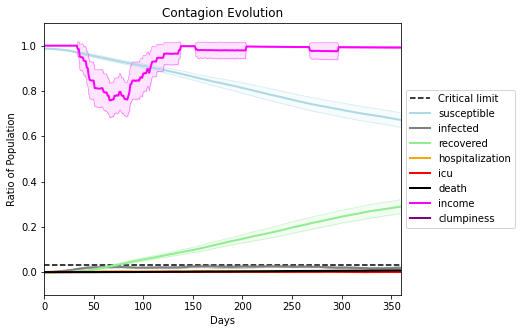

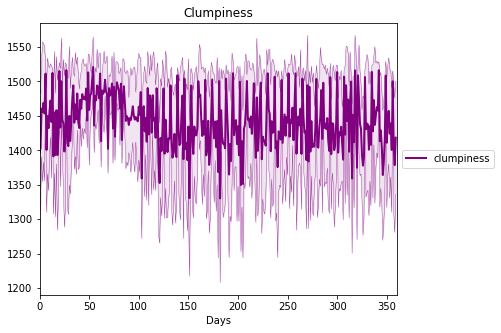

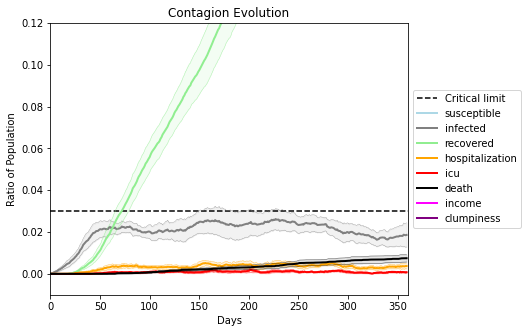

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7520, 3863, 9722, 9328, 9858, 3930, 8966, 4498, 8198, 5418, 253, 3122, 6433, 1953, 1597, 5621, 4308, 3024, 9288, 4145]
Average similarity between family members is 0.9709779557527858 at temperature -0.998
Average similarity between family and home is 0.9998517749757739 at temperature -1
Average similarity between students and their classroom is 0.9528007132206906 at temperature -0.998
Average classroom occupancy is 1.968944099378882 and number classrooms is 161
Average similarity between workers is 0.9617354096039858 at temperature -0.998
Average office occupancy is 3.4239130434782608 and number offices is 184
Average friend similarity for adults: 0.8497598989222402 for kids: 0.7452933172238901
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6547594375386278
avg restaurant similarity 0.6835311088523462
avg restaurant similarity 0.6314937438823706
avg restaurant similarity 0.6951643589117869
avg restaurant similarity 0.6696191168224658
avg restaurant similarity 0.6998491353452417
avg restaurant similarity 0.7059054206271891
avg restaurant similarity 0.6325710900147252
avg restaurant similarity 0.6627434324956596
avg restaurant similarity 0.6892633678200477
avg restaurant similarity 0.6564632702658662
avg restaurant similarity 0.6779525434164733
avg restaurant similarity 0.6725445239410995
avg restaurant similarity 0.6860282941851825
avg restaurant similarity 0.7321600569824455
avg restaurant similarity 0.7044472149062613
avg restaurant similarity 0.6801651534750757
avg restaurant similarity 0.6545901701311925
avg restaurant similarity 0.6650592251547645
avg restaurant similarity 0.6937053175013754
avg restaurant similarity 0.7169817947847328
avg restaurant similarity 0.668842437384706
avg restaur

avg restaurant similarity 0.6896071243874203
avg restaurant similarity 0.6850847993097128
avg restaurant similarity 0.6691584758799538
avg restaurant similarity 0.6872499468872761
avg restaurant similarity 0.6486825412092778
avg restaurant similarity 0.7046523755180941
avg restaurant similarity 0.6591196457134101
avg restaurant similarity 0.6947722915873641
avg restaurant similarity 0.6386742257275577
avg restaurant similarity 0.6780086708380997
avg restaurant similarity 0.655135831130397
avg restaurant similarity 0.6241394120126816
avg restaurant similarity 0.6755033614317859
avg restaurant similarity 0.6319406832511882
avg restaurant similarity 0.651000055378229
avg restaurant similarity 0.6640329134786652
avg restaurant similarity 0.6682974308674986
avg restaurant similarity 0.6583110282089182
avg restaurant similarity 0.6418562741073589
avg restaurant similarity 0.6960375606877258
avg restaurant similarity 0.6800659968279434
avg restaurant similarity 0.6744625611772233
avg restaura

Average similarity between workers is 0.9656305608305298 at temperature -0.998
Average office occupancy is 3.5268817204301075 and number offices is 186
Average friend similarity for adults: 0.8596011594005344 for kids: 0.7453886466823568
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.684395398185864
avg restaurant similarity 0.6713798189589122
avg restaurant similarity 0.6790720039734737
avg restaurant similarity 0.6738775948827174
avg restaurant similarity 0.6943537414659012
avg restaurant similarity 0.6387990515989728
avg restaurant similarity 0.677405654350981
avg restaurant similarity 0.677886992446845
avg restaurant similarity 0.6703609286810698
avg restaurant similarity 0.6581720635188535
avg restaurant similarity 0.691263325668603
avg restaurant similarity 0.6850167591013746
avg restaurant similarity 0.6748496029867539
avg restaurant similarity 0.6547348434178163
avg restaurant similarity 0.6356483463965886
avg restaurant similarity 0.6867981540332923
avg restaurant similarity 0.6926165356678867
avg restaurant similarity 0.6610327873433108
avg restaurant similarity 0.6501178335209691
avg restaurant similarity 0.6825887761441883
avg restaurant similarity 0.719763834693901
avg restaurant similarity 0.6724185583700941
avg restaurant 

avg restaurant similarity 0.6699550974781944
avg restaurant similarity 0.6649231189200279
avg restaurant similarity 0.6579097471963605
avg restaurant similarity 0.6304662651607994
avg restaurant similarity 0.6651076981215812
avg restaurant similarity 0.7088910138636573
avg restaurant similarity 0.664136200350193
avg restaurant similarity 0.6577203332541761
avg restaurant similarity 0.65535721286971
avg restaurant similarity 0.6438347964149101
avg restaurant similarity 0.6499911640114037
avg restaurant similarity 0.6623556749176785
avg restaurant similarity 0.707361256726597
avg restaurant similarity 0.6692413377486628
avg restaurant similarity 0.6745622986658653
avg restaurant similarity 0.6394005214501662
avg restaurant similarity 0.659395969257135
avg restaurant similarity 0.6412579171839223
avg restaurant similarity 0.7012290053826974
avg restaurant similarity 0.6867696311087448
avg restaurant similarity 0.6732491178167413
avg restaurant similarity 0.6587287265361267
avg restaurant 

Average similarity between workers is 0.9669466982642377 at temperature -0.998
Average office occupancy is 3.543956043956044 and number offices is 182
Average friend similarity for adults: 0.8607091816395301 for kids: 0.7499723244974346
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6704202065854319
avg restaurant similarity 0.6537683294601649
avg restaurant similarity 0.6881443567045182
avg restaurant similarity 0.6855648186687451
avg restaurant similarity 0.6886049629438636
avg restaurant similarity 0.6856052078244447
avg restaurant similarity 0.7006179136611447
avg restaurant similarity 0.6909257767735236
avg restaurant similarity 0.6909252805265468
avg restaurant similarity 0.6890065911120864
avg restaurant similarity 0.6972190654706031
avg restaurant similarity 0.6777948703123302
avg restaurant similarity 0.6621649113864218
avg restaurant similarity 0.6935902689371887
avg restaurant similarity 0.7292281434231092
avg restaurant similarity 0.6844247900652348
avg restaurant similarity 0.6847797308489719
avg restaurant similarity 0.7098329240214277
avg restaurant similarity 0.7308623339174848
avg restaurant similarity 0.6619964616788109
avg restaurant similarity 0.695283656524347
avg restaurant similarity 0.6369892717259612
avg restaur

avg restaurant similarity 0.6708486784712573
avg restaurant similarity 0.6674007360473213
avg restaurant similarity 0.689780311815824
avg restaurant similarity 0.6538140477674939
avg restaurant similarity 0.667468969057756
avg restaurant similarity 0.6839833526827568
avg restaurant similarity 0.681554694912263
avg restaurant similarity 0.7224196790323503
avg restaurant similarity 0.6659729225937252
avg restaurant similarity 0.6838863509954753
avg restaurant similarity 0.6837715865125539
avg restaurant similarity 0.6959921789338217
avg restaurant similarity 0.710890098293058
avg restaurant similarity 0.6601236060962021
avg restaurant similarity 0.6616517965722012
avg restaurant similarity 0.7055737986929178
avg restaurant similarity 0.7132708485712457
avg restaurant similarity 0.6970314177414005
avg restaurant similarity 0.6830006607930702
avg restaurant similarity 0.6337086064061169
avg restaurant similarity 0.6922970082915519
avg restaurant similarity 0.6772460495470733
avg restaurant

Average similarity between workers is 0.9580448978519415 at temperature -0.998
Average office occupancy is 3.551912568306011 and number offices is 183
Average friend similarity for adults: 0.857203327821753 for kids: 0.7504191180859382
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6663522495334802
avg restaurant similarity 0.6564849265208441
avg restaurant similarity 0.7041691012484995
avg restaurant similarity 0.6883523586626265
avg restaurant similarity 0.7227135890268656
avg restaurant similarity 0.7207805815545977
avg restaurant similarity 0.7207845839177092
avg restaurant similarity 0.6938636052438308
avg restaurant similarity 0.7186434142967925
avg restaurant similarity 0.6657277293061549
avg restaurant similarity 0.6727928596165778
avg restaurant similarity 0.725901943353382
avg restaurant similarity 0.7418992972251862
avg restaurant similarity 0.6997340290171928
avg restaurant similarity 0.7054539925805695
avg restaurant similarity 0.699553326990904
avg restaurant similarity 0.6655336196625448
avg restaurant similarity 0.6569892717733935
avg restaurant similarity 0.7093992326386653
avg restaurant similarity 0.6491718508390343
avg restaurant similarity 0.704074963048035
avg restaurant similarity 0.6835018134228689
avg restauran

avg restaurant similarity 0.7201088226679115
avg restaurant similarity 0.6936928157317133
avg restaurant similarity 0.606536671222923
avg restaurant similarity 0.7411368261765611
avg restaurant similarity 0.7361741988962922
avg restaurant similarity 0.6997791934975743
avg restaurant similarity 0.6371076165043458
avg restaurant similarity 0.6770623505590727
avg restaurant similarity 0.7144646889689341
avg restaurant similarity 0.722449949628415
avg restaurant similarity 0.685957627836542
avg restaurant similarity 0.7205115909275794
avg restaurant similarity 0.6857550186220772
avg restaurant similarity 0.6698844897833228
avg restaurant similarity 0.6988473068610025
avg restaurant similarity 0.6835574397036281
avg restaurant similarity 0.6837955413697874
avg restaurant similarity 0.7235539886215708
avg restaurant similarity 0.6891446565909137
avg restaurant similarity 0.6706945706840277
avg restaurant similarity 0.6125649388119638
avg restaurant similarity 0.6724327506955117
avg restauran

Average similarity between workers is 0.9798972406555534 at temperature -0.998
Average office occupancy is 3.5614973262032086 and number offices is 187
Average friend similarity for adults: 0.864959816894333 for kids: 0.7266979332862683
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.7103237647165243
avg restaurant similarity 0.7021108446901912
avg restaurant similarity 0.7103098989390925
avg restaurant similarity 0.7348917141724176
avg restaurant similarity 0.6726663724084735
avg restaurant similarity 0.7120635216077604
avg restaurant similarity 0.6915070419661103
avg restaurant similarity 0.7063641489248993
avg restaurant similarity 0.6976055749685669
avg restaurant similarity 0.7112973528880402
avg restaurant similarity 0.7170625783023437
avg restaurant similarity 0.7396067708675964
avg restaurant similarity 0.7853788526835082
avg restaurant similarity 0.762333560111534
avg restaurant similarity 0.7415613223078802
avg restaurant similarity 0.6939405246478418
avg restaurant similarity 0.7169185950930104
avg restaurant similarity 0.7181857531612349
avg restaurant similarity 0.7151793675074362
avg restaurant similarity 0.6918576419719882
avg restaurant similarity 0.7240718255166616
avg restaurant similarity 0.7018079778900578
avg restaur

avg restaurant similarity 0.6633397155793125
avg restaurant similarity 0.6814275959785123
avg restaurant similarity 0.6770058361922603
avg restaurant similarity 0.6822987190580307
avg restaurant similarity 0.684004943197804
avg restaurant similarity 0.7161395296498632
avg restaurant similarity 0.6973158087654329
avg restaurant similarity 0.7128957038131052
avg restaurant similarity 0.6959366522104742
avg restaurant similarity 0.7207473558840282
avg restaurant similarity 0.6515720861879651
avg restaurant similarity 0.6784787949573204
avg restaurant similarity 0.7132765170506701
avg restaurant similarity 0.6709338992376401
avg restaurant similarity 0.7067638938474672
avg restaurant similarity 0.6668439941227114
avg restaurant similarity 0.6568397107811011
avg restaurant similarity 0.6567592042328351
avg restaurant similarity 0.7048008773636223
avg restaurant similarity 0.6994879314354693
avg restaurant similarity 0.7169822808645964
avg restaurant similarity 0.7137934093383573
avg restaur

Average similarity between workers is 0.9701903765716146 at temperature -0.998
Average office occupancy is 3.7074468085106385 and number offices is 188
Average friend similarity for adults: 0.8712000511309967 for kids: 0.7389490826300973
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.682419793308333
avg restaurant similarity 0.6474859302543491
avg restaurant similarity 0.6652855439526655
avg restaurant similarity 0.6824943584695979
avg restaurant similarity 0.6843394185775614
avg restaurant similarity 0.6961870070335766
avg restaurant similarity 0.5973531330234404
avg restaurant similarity 0.6525389037858345
avg restaurant similarity 0.7062353367535603
avg restaurant similarity 0.6900601514762897
avg restaurant similarity 0.6461057073612742
avg restaurant similarity 0.650115864305275
avg restaurant similarity 0.689749027161237
avg restaurant similarity 0.6568274291235231
avg restaurant similarity 0.6911382408213057
avg restaurant similarity 0.6482051610174433
avg restaurant similarity 0.6511254974672483
avg restaurant similarity 0.6952237871343645
avg restaurant similarity 0.6736241929341455
avg restaurant similarity 0.6316295774986405
avg restaurant similarity 0.6540147469040252
avg restaurant similarity 0.6620023606802949
avg restauran

avg restaurant similarity 0.7019511389517679
avg restaurant similarity 0.6959462986553204
avg restaurant similarity 0.6917387559456166
avg restaurant similarity 0.6982142443803709
avg restaurant similarity 0.6455889327015648
avg restaurant similarity 0.6514981797845898
avg restaurant similarity 0.6700772427442181
avg restaurant similarity 0.6858437486160113
avg restaurant similarity 0.6640650891559663
avg restaurant similarity 0.7307415782226111
avg restaurant similarity 0.6332757676312593
avg restaurant similarity 0.6633045270145506
avg restaurant similarity 0.6671003958829879
avg restaurant similarity 0.6860945148310951
avg restaurant similarity 0.6907462959891678
avg restaurant similarity 0.7203495246932596
avg restaurant similarity 0.6647882346291843
avg restaurant similarity 0.6816113351945917
avg restaurant similarity 0.6751284344355383
avg restaurant similarity 0.6296908480742506
avg restaurant similarity 0.6841988929516566
avg restaurant similarity 0.6650062651253311
avg restau

Average similarity between workers is 0.9490381974224851 at temperature -0.998
Average office occupancy is 3.553763440860215 and number offices is 186
Average friend similarity for adults: 0.8605870008332658 for kids: 0.7318353451018863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6656497151689126
avg restaurant similarity 0.7297413110017065
avg restaurant similarity 0.7154143749547534
avg restaurant similarity 0.7479472108305752
avg restaurant similarity 0.6835366445621154
avg restaurant similarity 0.7123794632113285
avg restaurant similarity 0.6800377559267585
avg restaurant similarity 0.6496356523611847
avg restaurant similarity 0.7063813957609302
avg restaurant similarity 0.7061507412066366
avg restaurant similarity 0.686898941691044
avg restaurant similarity 0.6816846879112358
avg restaurant similarity 0.6694562510614019
avg restaurant similarity 0.7382497892017691
avg restaurant similarity 0.6516696200432242
avg restaurant similarity 0.6784406608303608
avg restaurant similarity 0.6709710374244959
avg restaurant similarity 0.7178594449004546
avg restaurant similarity 0.6806872408053465
avg restaurant similarity 0.6902534837817811
avg restaurant similarity 0.6582035015387703
avg restaurant similarity 0.6597863566908738
avg restaur

avg restaurant similarity 0.5998221610147907
avg restaurant similarity 0.6937719050946473
avg restaurant similarity 0.6554214117914453
avg restaurant similarity 0.6425987011313454
avg restaurant similarity 0.6939086969918165
avg restaurant similarity 0.6619323404109724
avg restaurant similarity 0.6368034578642973
avg restaurant similarity 0.6909307655509912
avg restaurant similarity 0.6372216246054554
avg restaurant similarity 0.6117904319443506
avg restaurant similarity 0.7116740497537664
avg restaurant similarity 0.6977388716376677
avg restaurant similarity 0.6723547483713239
avg restaurant similarity 0.6845543301204915
avg restaurant similarity 0.6382607819108411
avg restaurant similarity 0.6492426706445847
avg restaurant similarity 0.6788813872344048
avg restaurant similarity 0.6696600445095574
avg restaurant similarity 0.6317063506616679
avg restaurant similarity 0.7162537669885922
avg restaurant similarity 0.6553675763515635
avg restaurant similarity 0.6670986770849944
avg restau

Average similarity between workers is 0.9620642249274499 at temperature -0.998
Average office occupancy is 3.5240641711229945 and number offices is 187
Average friend similarity for adults: 0.864438652416839 for kids: 0.7338026783009031
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6368377738428553
avg restaurant similarity 0.6423446986386169
avg restaurant similarity 0.6134791188077923
avg restaurant similarity 0.6903245404244671
avg restaurant similarity 0.6326334120572573
avg restaurant similarity 0.6116008450964124
avg restaurant similarity 0.6586968561792518
avg restaurant similarity 0.6534902930889467
avg restaurant similarity 0.6750054064042074
avg restaurant similarity 0.619477792434198
avg restaurant similarity 0.6103501637000017
avg restaurant similarity 0.6327771037121543
avg restaurant similarity 0.6231219909239493
avg restaurant similarity 0.6778617354231808
avg restaurant similarity 0.5976385005685376
avg restaurant similarity 0.6719248670186527
avg restaurant similarity 0.6304687112162947
avg restaurant similarity 0.6161410964029044
avg restaurant similarity 0.6320565252776975
avg restaurant similarity 0.6716421788333964
avg restaurant similarity 0.6449652655064602
avg restaurant similarity 0.600834716828378
avg restaura

avg restaurant similarity 0.6303444133886195
avg restaurant similarity 0.6746619010376257
avg restaurant similarity 0.6811318923211951
avg restaurant similarity 0.6386020792921421
avg restaurant similarity 0.6252724565590748
avg restaurant similarity 0.6603998587181428
avg restaurant similarity 0.6394340116353759
avg restaurant similarity 0.6159651667538966
avg restaurant similarity 0.6033457068801971
avg restaurant similarity 0.6411226428297493
avg restaurant similarity 0.640050684968305
avg restaurant similarity 0.6139747671020408
avg restaurant similarity 0.630483538056221
avg restaurant similarity 0.6323457089447442
avg restaurant similarity 0.62634829397657
avg restaurant similarity 0.6498296272860352
avg restaurant similarity 0.6408725553845334
avg restaurant similarity 0.6463500889309824
avg restaurant similarity 0.6475629286336168
avg restaurant similarity 0.6143108428908949
avg restaurant similarity 0.6785783092631797
avg restaurant similarity 0.6514171383164458
avg restaurant

Average similarity between workers is 0.9797919796890647 at temperature -0.998
Average office occupancy is 3.443243243243243 and number offices is 185
Average friend similarity for adults: 0.8545868343411158 for kids: 0.7410560963070433
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6046249438442254
avg restaurant similarity 0.692827113171584
avg restaurant similarity 0.6182715770407605
avg restaurant similarity 0.624303599283289
avg restaurant similarity 0.618497478743624
avg restaurant similarity 0.6685610328688381
avg restaurant similarity 0.7028520051245463
avg restaurant similarity 0.6740860421164951
avg restaurant similarity 0.6502952211684104
avg restaurant similarity 0.6272636693761756
avg restaurant similarity 0.6039793969208469
avg restaurant similarity 0.6734946350832489
avg restaurant similarity 0.6757891785944589
avg restaurant similarity 0.6292694098266336
avg restaurant similarity 0.6200569245731697
avg restaurant similarity 0.6979119795388172
avg restaurant similarity 0.6583195825753547
avg restaurant similarity 0.6342241003877295
avg restaurant similarity 0.6857707972427365
avg restaurant similarity 0.6732360059863894
avg restaurant similarity 0.6704167535317278
avg restaurant similarity 0.6950333295629837
avg restauran

avg restaurant similarity 0.6591679823493286
avg restaurant similarity 0.6321104563717251
avg restaurant similarity 0.6270977905903977
avg restaurant similarity 0.6651910958394752
avg restaurant similarity 0.6689992517960178
avg restaurant similarity 0.5575235961441074
avg restaurant similarity 0.6497653431744574
avg restaurant similarity 0.5428267485206176
avg restaurant similarity 0.5976460759899671
avg restaurant similarity 0.6599449263960417
avg restaurant similarity 0.6836887051661897
avg restaurant similarity 0.6678510421440355
avg restaurant similarity 0.6624902168358193
avg restaurant similarity 0.5983575386131456
avg restaurant similarity 0.6381445698672501
avg restaurant similarity 0.616894804777745
avg restaurant similarity 0.6361652292406842
avg restaurant similarity 0.6361313201691701
avg restaurant similarity 0.6447430456656859
avg restaurant similarity 0.6499322896236426
avg restaurant similarity 0.6260197197716756
avg restaurant similarity 0.6702696466133751
avg restaur

Average similarity between workers is 0.9683914995407127 at temperature -0.998
Average office occupancy is 3.260204081632653 and number offices is 196
Average friend similarity for adults: 0.8600035189576006 for kids: 0.7557287653077324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.6828638123502625
avg restaurant similarity 0.6579204279791369
avg restaurant similarity 0.675066523800141
avg restaurant similarity 0.6829800899758641
avg restaurant similarity 0.6617952708927702
avg restaurant similarity 0.6946124451984473
avg restaurant similarity 0.6624285333436751
avg restaurant similarity 0.6850687421094265
avg restaurant similarity 0.6873763796287684
avg restaurant similarity 0.6602976516824629
avg restaurant similarity 0.676064438522496
avg restaurant similarity 0.6605451952700413
avg restaurant similarity 0.6666421368321607
avg restaurant similarity 0.6717130402285933
avg restaurant similarity 0.6547259216642027
avg restaurant similarity 0.6848564469911946
avg restaurant similarity 0.6955799640046028
avg restaurant similarity 0.6598434250052452
avg restaurant similarity 0.6847226542363035
avg restaurant similarity 0.6604860456021583
avg restaurant similarity 0.6844347774725766
avg restaurant similarity 0.6845223995044912
avg restaura

avg restaurant similarity 0.7130790748682364
avg restaurant similarity 0.6377848262544239
avg restaurant similarity 0.6223248684430239
avg restaurant similarity 0.7210380953158689
avg restaurant similarity 0.6895815074249523
avg restaurant similarity 0.6899285729540967
avg restaurant similarity 0.7062609229811713
avg restaurant similarity 0.650021335395106
avg restaurant similarity 0.6995994333892689
avg restaurant similarity 0.6889579536782898
avg restaurant similarity 0.6408667909697615
avg restaurant similarity 0.6665311768200799
avg restaurant similarity 0.6732562386525657
avg restaurant similarity 0.7020000753823396
avg restaurant similarity 0.6719459065219898
avg restaurant similarity 0.7067893655133604
avg restaurant similarity 0.6755849203625356
avg restaurant similarity 0.7535265073489699
avg restaurant similarity 0.6715701776184396
avg restaurant similarity 0.6400774001542974
avg restaurant similarity 0.714772469989163
avg restaurant similarity 0.6435272005913616
avg restaura

Average similarity between workers is 0.9496930426491119 at temperature -0.998
Average office occupancy is 3.413978494623656 and number offices is 186
Average friend similarity for adults: 0.8533335399326457 for kids: 0.7324587187602642
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6658931021669023
avg restaurant similarity 0.642228964045917
avg restaurant similarity 0.6227953714683672
avg restaurant similarity 0.6635600790063182
avg restaurant similarity 0.6516154751911938
avg restaurant similarity 0.6193883505430131
avg restaurant similarity 0.6488797215668533
avg restaurant similarity 0.6604874264535289
avg restaurant similarity 0.6693777381371347
avg restaurant similarity 0.631909388827468
avg restaurant similarity 0.6531735382485445
avg restaurant similarity 0.638276163626966
avg restaurant similarity 0.6774707823980705
avg restaurant similarity 0.6008250482704416
avg restaurant similarity 0.6476345561234776
avg restaurant similarity 0.6424975035569952
avg restaurant similarity 0.5966624275465435
avg restaurant similarity 0.6276148892344309
avg restaurant similarity 0.6545743000580349
avg restaurant similarity 0.6712856470943867
avg restaurant similarity 0.6717830031077094
avg restaurant similarity 0.729981661727876
avg restaurant

avg restaurant similarity 0.6713472809209134
avg restaurant similarity 0.6697390185135866
avg restaurant similarity 0.6556383313575
avg restaurant similarity 0.6182430967826569
avg restaurant similarity 0.692716592991432
avg restaurant similarity 0.6631065000660539
avg restaurant similarity 0.6366986397965462
avg restaurant similarity 0.6467072544840826
avg restaurant similarity 0.6193152186004217
avg restaurant similarity 0.6464923167140222
avg restaurant similarity 0.6771602935515593
avg restaurant similarity 0.6831852508066542
avg restaurant similarity 0.6678636285369975
avg restaurant similarity 0.6709945403625012
avg restaurant similarity 0.6940521166075183
avg restaurant similarity 0.6085758068312592
avg restaurant similarity 0.6757756075440777
avg restaurant similarity 0.6961422809111583
avg restaurant similarity 0.7038292617582707
avg restaurant similarity 0.6217896897586328
avg restaurant similarity 0.6318989694122141
avg restaurant similarity 0.6660228809916459
avg restaurant

Average similarity between workers is 0.9706135758330436 at temperature -0.998
Average office occupancy is 3.5494505494505493 and number offices is 182
Average friend similarity for adults: 0.8558408232211043 for kids: 0.7422940878981055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6885131236976659
avg restaurant similarity 0.6208602543970589
avg restaurant similarity 0.6201010406913471
avg restaurant similarity 0.691968519335603
avg restaurant similarity 0.6390883422417426
avg restaurant similarity 0.6645982021226498
avg restaurant similarity 0.5958738843973105
avg restaurant similarity 0.6716986048890163
avg restaurant similarity 0.6957989248247549
avg restaurant similarity 0.6754470014079994
avg restaurant similarity 0.6665512904752661
avg restaurant similarity 0.6820617846769693
avg restaurant similarity 0.6573422101089165
avg restaurant similarity 0.6412168028459304
avg restaurant similarity 0.633627009385647
avg restaurant similarity 0.6684520409812662
avg restaurant similarity 0.6625734085495315
avg restaurant similarity 0.7403416041668867
avg restaurant similarity 0.6379498203804904
avg restaurant similarity 0.7030601503849356
avg restaurant similarity 0.6874513343197949
avg restaurant similarity 0.6544598907811513
avg restaura

avg restaurant similarity 0.6767714475169951
avg restaurant similarity 0.6228998677306439
avg restaurant similarity 0.6871398154207097
avg restaurant similarity 0.6271362456363601
avg restaurant similarity 0.6398153869833044
avg restaurant similarity 0.6621463453229934
avg restaurant similarity 0.6713368728016096
avg restaurant similarity 0.5982864475276772
avg restaurant similarity 0.6856613714970263
avg restaurant similarity 0.6532946780510247
avg restaurant similarity 0.6480240425517396
avg restaurant similarity 0.6843687961691524
avg restaurant similarity 0.6604572332214572
avg restaurant similarity 0.6894226996201065
avg restaurant similarity 0.6474337954614371
avg restaurant similarity 0.7665920008778069
avg restaurant similarity 0.6553226866956262
avg restaurant similarity 0.659140503832905
avg restaurant similarity 0.7236015988285823
avg restaurant similarity 0.6756292087351271
avg restaurant similarity 0.6594911809193884
avg restaurant similarity 0.6252720971227957
avg restaur

Average similarity between workers is 0.9649312718018961 at temperature -0.998
Average office occupancy is 3.5434782608695654 and number offices is 184
Average friend similarity for adults: 0.8632142566390671 for kids: 0.7541266099867773
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.6092120543813694
avg restaurant similarity 0.5893820766844223
avg restaurant similarity 0.6303058295515767
avg restaurant similarity 0.704327928370434
avg restaurant similarity 0.6031563866798594
avg restaurant similarity 0.6238368517207962
avg restaurant similarity 0.6265220133707268
avg restaurant similarity 0.6121289298111454
avg restaurant similarity 0.6584653515982118
avg restaurant similarity 0.5872477514448186
avg restaurant similarity 0.6400062359575718
avg restaurant similarity 0.6311948996449039
avg restaurant similarity 0.6299460343353465
avg restaurant similarity 0.6489492371489292
avg restaurant similarity 0.6625710115412122
avg restaurant similarity 0.6363267271696957
avg restaurant similarity 0.6421814176312696
avg restaurant similarity 0.5836201247803402
avg restaurant similarity 0.6494369684171034
avg restaurant similarity 0.696339233864068
avg restaurant similarity 0.655945402013289
avg restaurant similarity 0.6746967454801885
avg restauran

avg restaurant similarity 0.6526726512009577
avg restaurant similarity 0.6629353159300224
avg restaurant similarity 0.6570521624859907
avg restaurant similarity 0.7027442113673597
avg restaurant similarity 0.6798580538306416
avg restaurant similarity 0.6358990539711518
avg restaurant similarity 0.7295384899656074
avg restaurant similarity 0.6955884465598092
avg restaurant similarity 0.6027740519824086
avg restaurant similarity 0.6259426670944879
avg restaurant similarity 0.6412329282821101
avg restaurant similarity 0.6653644526671109
avg restaurant similarity 0.6507741502297173
avg restaurant similarity 0.689967451742293
avg restaurant similarity 0.6797350851023654
avg restaurant similarity 0.653130671373706
avg restaurant similarity 0.5984103011318028
avg restaurant similarity 0.6799638905672017
avg restaurant similarity 0.6426509311635382
avg restaurant similarity 0.6091096789888207
avg restaurant similarity 0.6349384581346211
avg restaurant similarity 0.683957398514013
avg restauran

Average similarity between workers is 0.9565757203282291 at temperature -0.998
Average office occupancy is 3.5531914893617023 and number offices is 188
Average friend similarity for adults: 0.8564131125864901 for kids: 0.7258266910155365
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6337443983738604
avg restaurant similarity 0.648086684942116
avg restaurant similarity 0.6264256632861602
avg restaurant similarity 0.6465592893928509
avg restaurant similarity 0.58888887001783
avg restaurant similarity 0.6449593264575613
avg restaurant similarity 0.608168311437249
avg restaurant similarity 0.6292974826437142
avg restaurant similarity 0.6685111245817077
avg restaurant similarity 0.5735407116402758
avg restaurant similarity 0.6974487580144478
avg restaurant similarity 0.6551226958447671
avg restaurant similarity 0.6193969327474362
avg restaurant similarity 0.6524664326732993
avg restaurant similarity 0.6726783402375229
avg restaurant similarity 0.675298693697731
avg restaurant similarity 0.6299065128528267
avg restaurant similarity 0.6391759146118461
avg restaurant similarity 0.6418799471311224
avg restaurant similarity 0.591630297275567
avg restaurant similarity 0.6684730816445733
avg restaurant similarity 0.6517899880957511
avg restaurant s

avg restaurant similarity 0.6139744906236096
avg restaurant similarity 0.6567643903907602
avg restaurant similarity 0.6414154911438159
avg restaurant similarity 0.642597986594015
avg restaurant similarity 0.6394659038186898
avg restaurant similarity 0.6602914640570642
avg restaurant similarity 0.6587907576152502
avg restaurant similarity 0.6245119670566912
avg restaurant similarity 0.6450399520125042
avg restaurant similarity 0.6779074014754876
avg restaurant similarity 0.6104890046218029
avg restaurant similarity 0.6563189173067271
avg restaurant similarity 0.6352148706461769
avg restaurant similarity 0.6632556302154484
avg restaurant similarity 0.6065506632878128
avg restaurant similarity 0.6725633086530434
avg restaurant similarity 0.6498854230081205
avg restaurant similarity 0.6709740453110319
avg restaurant similarity 0.6525370122133243
avg restaurant similarity 0.6319755731307709
avg restaurant similarity 0.6727993153145848
avg restaurant similarity 0.6055237149187326
avg restaur

Average similarity between workers is 0.968414671672052 at temperature -0.998
Average office occupancy is 3.6065573770491803 and number offices is 183
Average friend similarity for adults: 0.856297481731143 for kids: 0.7309094541697756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.5532232751621977
avg restaurant similarity 0.6421657668531605
avg restaurant similarity 0.6274864584884305
avg restaurant similarity 0.689256760203699
avg restaurant similarity 0.6106077926984064
avg restaurant similarity 0.658494055929832
avg restaurant similarity 0.5856952309006491
avg restaurant similarity 0.6304500208028448
avg restaurant similarity 0.6584091793941085
avg restaurant similarity 0.6259178646884003
avg restaurant similarity 0.6313666809194136
avg restaurant similarity 0.6008096864118216
avg restaurant similarity 0.6066130682763446
avg restaurant similarity 0.6165667577784528
avg restaurant similarity 0.6269079244603293
avg restaurant similarity 0.6379408209233784
avg restaurant similarity 0.6374204639718596
avg restaurant similarity 0.6326890299538465
avg restaurant similarity 0.6624175975781449
avg restaurant similarity 0.68153144930197
avg restaurant similarity 0.6613063665289157
avg restaurant similarity 0.6460374033636345
avg restaurant

avg restaurant similarity 0.6890942521530062
avg restaurant similarity 0.6510186317421016
avg restaurant similarity 0.6239977627210649
avg restaurant similarity 0.6208960507678916
avg restaurant similarity 0.6769807099774758
avg restaurant similarity 0.618740959206237
avg restaurant similarity 0.6605028240027626
avg restaurant similarity 0.6804612401337196
avg restaurant similarity 0.6394470787356029
avg restaurant similarity 0.6864414643920217
avg restaurant similarity 0.6631923270496509
avg restaurant similarity 0.6381528450584736
avg restaurant similarity 0.6943504693885978
avg restaurant similarity 0.6061908209689766
avg restaurant similarity 0.6417007830231789
avg restaurant similarity 0.6500081740068919
avg restaurant similarity 0.6534477323669835
avg restaurant similarity 0.6869922275541744
avg restaurant similarity 0.6419891084395534
avg restaurant similarity 0.671685968444779
avg restaurant similarity 0.6524836123661014
avg restaurant similarity 0.6483734587103365
avg restaura

Average similarity between workers is 0.9583014938928444 at temperature -0.998
Average office occupancy is 3.5783783783783782 and number offices is 185
Average friend similarity for adults: 0.8596345650450077 for kids: 0.7312402559769754
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6820366102464299
avg restaurant similarity 0.6947248962514069
avg restaurant similarity 0.6978124556495365
avg restaurant similarity 0.631441868491612
avg restaurant similarity 0.6688826772299179
avg restaurant similarity 0.7430409079942174
avg restaurant similarity 0.7148354120970276
avg restaurant similarity 0.7487695100747062
avg restaurant similarity 0.7260931274948494
avg restaurant similarity 0.7450178595356562
avg restaurant similarity 0.7327776908534859
avg restaurant similarity 0.7100884369230599
avg restaurant similarity 0.719861589914725
avg restaurant similarity 0.6930042066413501
avg restaurant similarity 0.6423776726768873
avg restaurant similarity 0.6502054210047956
avg restaurant similarity 0.7233710494026288
avg restaurant similarity 0.6662430656006579
avg restaurant similarity 0.6764578282337355
avg restaurant similarity 0.7034440300266749
avg restaurant similarity 0.6722601437945979
avg restaurant similarity 0.7140773942028449
avg restaura

avg restaurant similarity 0.624998929277311
avg restaurant similarity 0.6476553836625428
avg restaurant similarity 0.6865388879042951
avg restaurant similarity 0.6848267357185591
avg restaurant similarity 0.7204320347429501
avg restaurant similarity 0.7378223180371317
avg restaurant similarity 0.7129444155594609
avg restaurant similarity 0.612972287518888
avg restaurant similarity 0.6390087008697899
avg restaurant similarity 0.6919981301518023
avg restaurant similarity 0.6415677127110506
avg restaurant similarity 0.6508980351005835
avg restaurant similarity 0.7257498045672484
avg restaurant similarity 0.6162402847661875
avg restaurant similarity 0.6709714025147805
avg restaurant similarity 0.5912617179988932
avg restaurant similarity 0.7733525773507577
avg restaurant similarity 0.6910112788736209
avg restaurant similarity 0.6975892680173301
avg restaurant similarity 0.6696898069257663
avg restaurant similarity 0.6493240046194952
avg restaurant similarity 0.7698386018115778
avg restaura

Average similarity between workers is 0.9608986053740556 at temperature -0.998
Average office occupancy is 3.643617021276596 and number offices is 188
Average friend similarity for adults: 0.8569572877033252 for kids: 0.7169376948444797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.6858029206761207
avg restaurant similarity 0.6835648231501238
avg restaurant similarity 0.7020098856095673
avg restaurant similarity 0.7069734092594129
avg restaurant similarity 0.6832675151185418
avg restaurant similarity 0.6605381415191285
avg restaurant similarity 0.6578286113027103
avg restaurant similarity 0.7127328322893869
avg restaurant similarity 0.7168066997361815
avg restaurant similarity 0.6612327119052966
avg restaurant similarity 0.712888883141375
avg restaurant similarity 0.6831486740298021
avg restaurant similarity 0.6994104380507982
avg restaurant similarity 0.7116786123069379
avg restaurant similarity 0.6735428651475558
avg restaurant similarity 0.7492635242790273
avg restaurant similarity 0.7173637650257696
avg restaurant similarity 0.6925718344656566
avg restaurant similarity 0.7110601182227674
avg restaurant similarity 0.6794559728648587
avg restaurant similarity 0.7039856896757976
avg restaurant similarity 0.6788578148923495
avg restaur

avg restaurant similarity 0.6493893643508116
avg restaurant similarity 0.6868156116052974
avg restaurant similarity 0.6532484622860186
avg restaurant similarity 0.6528879537698823
avg restaurant similarity 0.6951483129490996
avg restaurant similarity 0.7008209038408113
avg restaurant similarity 0.7071781476953101
avg restaurant similarity 0.6814150997132385
avg restaurant similarity 0.6828964268617275
avg restaurant similarity 0.7166258652008622
avg restaurant similarity 0.6810497895380262
avg restaurant similarity 0.6527957664642448
avg restaurant similarity 0.6906724631327203
avg restaurant similarity 0.6701229786124511
avg restaurant similarity 0.67218363120655
avg restaurant similarity 0.6895040759820107
avg restaurant similarity 0.6921323436511478
avg restaurant similarity 0.6981413308273058
avg restaurant similarity 0.7172477767808446
avg restaurant similarity 0.691155698395017
avg restaurant similarity 0.6739119007749257
avg restaurant similarity 0.616470991211166
avg restaurant

Average similarity between workers is 0.9652514409471343 at temperature -0.998
Average office occupancy is 3.5053763440860215 and number offices is 186
Average friend similarity for adults: 0.8551697049003505 for kids: 0.7445438075686923
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6749727132127799
avg restaurant similarity 0.663148890023648
avg restaurant similarity 0.6769707641931415
avg restaurant similarity 0.6558926216512627
avg restaurant similarity 0.6971471040675649
avg restaurant similarity 0.7030475660334852
avg restaurant similarity 0.7033847643531613
avg restaurant similarity 0.717382822445801
avg restaurant similarity 0.6606044184200076
avg restaurant similarity 0.7001401730889519
avg restaurant similarity 0.7023060029252834
avg restaurant similarity 0.6603700674636241
avg restaurant similarity 0.7059153115494259
avg restaurant similarity 0.6649027923443865
avg restaurant similarity 0.699096164135211
avg restaurant similarity 0.6884600383445002
avg restaurant similarity 0.7064514663408036
avg restaurant similarity 0.6690456161697155
avg restaurant similarity 0.7533838457564244
avg restaurant similarity 0.7058572305353751
avg restaurant similarity 0.6510758553269841
avg restaurant similarity 0.6805368590814209
avg restauran

avg restaurant similarity 0.6454224499581817
avg restaurant similarity 0.710840973836687
avg restaurant similarity 0.7103595973753531
avg restaurant similarity 0.7001744699612524
avg restaurant similarity 0.6630670072313543
avg restaurant similarity 0.693639544840783
avg restaurant similarity 0.6743068825858918
avg restaurant similarity 0.6848514349710386
avg restaurant similarity 0.6417260257491146
avg restaurant similarity 0.6917093471875668
avg restaurant similarity 0.6584587347819246
avg restaurant similarity 0.7174412159156749
avg restaurant similarity 0.7002868367291524
avg restaurant similarity 0.6848130421814526
avg restaurant similarity 0.6392284497963002
avg restaurant similarity 0.6833946352846834
avg restaurant similarity 0.6898342007804925
avg restaurant similarity 0.6647526848925059
avg restaurant similarity 0.6334375841441554
avg restaurant similarity 0.665275606485701
avg restaurant similarity 0.7469212566873493
avg restaurant similarity 0.6584535295459876
avg restauran

Average similarity between workers is 0.9557036294624743 at temperature -0.998
Average office occupancy is 3.6363636363636362 and number offices is 187
Average friend similarity for adults: 0.8574972018789366 for kids: 0.7308014663903928
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.7171967263730847
avg restaurant similarity 0.7186107388505449
avg restaurant similarity 0.6781372986783348
avg restaurant similarity 0.7396923233944324
avg restaurant similarity 0.7388308271589303
avg restaurant similarity 0.7109718939230308
avg restaurant similarity 0.7368802767468877
avg restaurant similarity 0.6862787795739168
avg restaurant similarity 0.7288013103430904
avg restaurant similarity 0.6680492314103494
avg restaurant similarity 0.7300621026868295
avg restaurant similarity 0.7009542819074175
avg restaurant similarity 0.6772695956819005
avg restaurant similarity 0.7422883662598048
avg restaurant similarity 0.7161952124367235
avg restaurant similarity 0.6804014130962127
avg restaurant similarity 0.6308701413770852
avg restaurant similarity 0.6816865092673546
avg restaurant similarity 0.7525005511702171
avg restaurant similarity 0.6837761758815735
avg restaurant similarity 0.7149179603617413
avg restaurant similarity 0.6823787648609978
avg restau

avg restaurant similarity 0.7020745876759751
avg restaurant similarity 0.7147768921435244
avg restaurant similarity 0.7169312618954633
avg restaurant similarity 0.6949710618736621
avg restaurant similarity 0.745372961279023
avg restaurant similarity 0.6638548699549951
avg restaurant similarity 0.7121534932964637
avg restaurant similarity 0.732369889111513
avg restaurant similarity 0.6648067317090632
avg restaurant similarity 0.6851876214022085
avg restaurant similarity 0.7326822861693659
avg restaurant similarity 0.666414127768811
avg restaurant similarity 0.7259572712385273
avg restaurant similarity 0.7408967426810777
avg restaurant similarity 0.6950470586450297
avg restaurant similarity 0.687741652707824
avg restaurant similarity 0.6868932608678326
avg restaurant similarity 0.7343988254556237
avg restaurant similarity 0.6789083921896802
avg restaurant similarity 0.698040135889261
avg restaurant similarity 0.680779231051682
avg restaurant similarity 0.7537918880740488
avg restaurant s

Average similarity between workers is 0.9710859249603766 at temperature -0.998
Average office occupancy is 3.4919786096256686 and number offices is 187
Average friend similarity for adults: 0.863811162440518 for kids: 0.7406331201914232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.7767358396839237
avg restaurant similarity 0.7040808182860125
avg restaurant similarity 0.7041763031705343
avg restaurant similarity 0.689244397050144
avg restaurant similarity 0.6617205043125697
avg restaurant similarity 0.7144384569383009
avg restaurant similarity 0.7138268577887434
avg restaurant similarity 0.7436216869732958
avg restaurant similarity 0.661831550016956
avg restaurant similarity 0.6802030654504063
avg restaurant similarity 0.6676786929899998
avg restaurant similarity 0.6940419404446332
avg restaurant similarity 0.7301649765671772
avg restaurant similarity 0.6880270109107262
avg restaurant similarity 0.6955524216581906
avg restaurant similarity 0.6504947472600003
avg restaurant similarity 0.6682205141233181
avg restaurant similarity 0.6741427220132213
avg restaurant similarity 0.6448468175731052
avg restaurant similarity 0.667592902422434
avg restaurant similarity 0.7109676217373238
avg restaurant similarity 0.6906935096478685
avg restauran

avg restaurant similarity 0.630208966947825
avg restaurant similarity 0.7077993450346108
avg restaurant similarity 0.6323783662199584
avg restaurant similarity 0.6675752372757989
avg restaurant similarity 0.6549291112250791
avg restaurant similarity 0.7379486257110641
avg restaurant similarity 0.6689798376816971
avg restaurant similarity 0.626882050232788
avg restaurant similarity 0.7013105492230628
avg restaurant similarity 0.6865845337444781
avg restaurant similarity 0.7285137822975437
avg restaurant similarity 0.6370049516314914
avg restaurant similarity 0.7062820166266147
avg restaurant similarity 0.7240578040033223
avg restaurant similarity 0.6704555026374744
avg restaurant similarity 0.6954328472089759
avg restaurant similarity 0.7112822689581579
avg restaurant similarity 0.7453885992370597
avg restaurant similarity 0.7461714944009838
avg restaurant similarity 0.7348353398966658
avg restaurant similarity 0.6762305897383688
avg restaurant similarity 0.7440621169338911
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

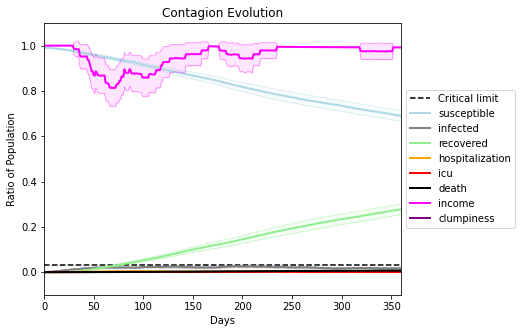

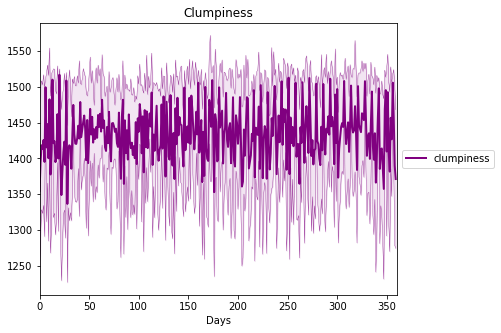

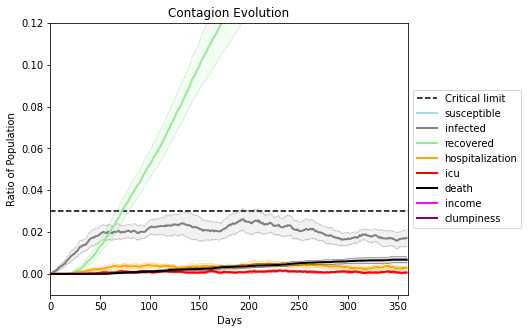

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8491, 8489, 3816, 4274, 2279, 1927, 1346, 1409, 9823, 3548, 8449, 7276, 8061, 5630, 4004, 7055, 907, 7821, 4267, 8391]
Average similarity between family members is 0.9572444800112322 at temperature -0.9975
Average similarity between family and home is 0.9998536455941339 at temperature -1
Average similarity between students and their classroom is 0.9418167277149421 at temperature -0.9975
Average classroom occupancy is 1.7183908045977012 and number classrooms is 174
Average similarity between workers is 0.9161646367707452 at temperature -0.9975
Average office occupancy is 3.3842105263157896 and number offices is 190
Average friend similarity for adults: 0.8417740627366065 for kids: 0.7376960489709324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.5741888204994875
avg restaurant similarity 0.650175718317363
avg restaurant similarity 0.7016381318270689
avg restaurant similarity 0.6159702332581259
avg restaurant similarity 0.597708026784969
avg restaurant similarity 0.6716334965411908
avg restaurant similarity 0.6279305746192414
avg restaurant similarity 0.6138384082287435
avg restaurant similarity 0.608070789173839
avg restaurant similarity 0.6533885040710071
avg restaurant similarity 0.5849311554761479
avg restaurant similarity 0.6396075412629979
avg restaurant similarity 0.587272115934546
avg restaurant similarity 0.621447675873657
avg restaurant similarity 0.6677593722578443
avg restaurant similarity 0.6180707816423312
avg restaurant similarity 0.6274981236020625
avg restaurant similarity 0.6074422319694615
avg restaurant similarity 0.6670379182129944
avg restaurant similarity 0.6115866741435464
avg restaurant similarity 0.6134475890283084
avg restaurant similarity 0.6398080521510829
avg restaurant 

avg restaurant similarity 0.626888398674778
avg restaurant similarity 0.5939687525729311
avg restaurant similarity 0.612607267571313
avg restaurant similarity 0.6163716482188625
avg restaurant similarity 0.582524695079467
avg restaurant similarity 0.6401902272624668
avg restaurant similarity 0.6335124948153773
avg restaurant similarity 0.6267609467364226
avg restaurant similarity 0.5685907512602911
avg restaurant similarity 0.6453346420866626
avg restaurant similarity 0.5705578244018845
avg restaurant similarity 0.6605324093894654
avg restaurant similarity 0.661928140219829
avg restaurant similarity 0.6214958697855651
avg restaurant similarity 0.6630001799811082
avg restaurant similarity 0.584880289583241
avg restaurant similarity 0.6646456449115854
avg restaurant similarity 0.634668724308569
avg restaurant similarity 0.6258823082632244
avg restaurant similarity 0.567365918703619
avg restaurant similarity 0.6203347760546583
avg restaurant similarity 0.632904128297644
avg restaurant sim

Average similarity between workers is 0.9431699975781958 at temperature -0.9975
Average office occupancy is 3.4497354497354498 and number offices is 189
Average friend similarity for adults: 0.8666499789352831 for kids: 0.7480602420743011
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total 

avg restaurant similarity 0.5875306840755206
avg restaurant similarity 0.6560283777902499
avg restaurant similarity 0.6439381543877568
avg restaurant similarity 0.5947649442818783
avg restaurant similarity 0.6746607089951379
avg restaurant similarity 0.6027077295757867
avg restaurant similarity 0.6630803966632375
avg restaurant similarity 0.6360729821733169
avg restaurant similarity 0.5930614162171192
avg restaurant similarity 0.6598959666419217
avg restaurant similarity 0.6477671615052583
avg restaurant similarity 0.63049441889617
avg restaurant similarity 0.6363629876679792
avg restaurant similarity 0.6278496527295685
avg restaurant similarity 0.5861344991295763
avg restaurant similarity 0.6632523595404302
avg restaurant similarity 0.647567256319634
avg restaurant similarity 0.6377892959930969
avg restaurant similarity 0.6079251852358946
avg restaurant similarity 0.6348905730536558
avg restaurant similarity 0.6766446959155046
avg restaurant similarity 0.6162454501852831
avg restauran

avg restaurant similarity 0.5956311235049317
avg restaurant similarity 0.6847249213729726
avg restaurant similarity 0.6399264417760148
avg restaurant similarity 0.6361271865907071
avg restaurant similarity 0.6716064497863513
avg restaurant similarity 0.6258310459969979
avg restaurant similarity 0.617547696736567
avg restaurant similarity 0.6217356785379738
avg restaurant similarity 0.6502624651511517
avg restaurant similarity 0.6527014315219921
avg restaurant similarity 0.6091196066812921
avg restaurant similarity 0.6434683663082938
avg restaurant similarity 0.6434172761002841
avg restaurant similarity 0.6305539955139245
avg restaurant similarity 0.6529645986263335
avg restaurant similarity 0.6617114678452106
avg restaurant similarity 0.595032488843808
avg restaurant similarity 0.6289338186617857
avg restaurant similarity 0.6345355927541475
avg restaurant similarity 0.6319976107592176
avg restaurant similarity 0.652955580176218
avg restaurant similarity 0.6476814429845413
avg restauran

Average similarity between workers is 0.9325546043301004 at temperature -0.9975
Average office occupancy is 3.345744680851064 and number offices is 188
Average friend similarity for adults: 0.8521603707027696 for kids: 0.7464140585774078
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.649991935967171
avg restaurant similarity 0.5754337391527345
avg restaurant similarity 0.6656430946468205
avg restaurant similarity 0.5891964207708139
avg restaurant similarity 0.5914869872732125
avg restaurant similarity 0.6253508507991757
avg restaurant similarity 0.6126795357108831
avg restaurant similarity 0.6015840283889514
avg restaurant similarity 0.6345893640303178
avg restaurant similarity 0.6502225859834225
avg restaurant similarity 0.6210546130971716
avg restaurant similarity 0.661838280315902
avg restaurant similarity 0.6494656601583693
avg restaurant similarity 0.6132116955687091
avg restaurant similarity 0.677285864602295
avg restaurant similarity 0.6381183285958502
avg restaurant similarity 0.6003756079103945
avg restaurant similarity 0.656709008455735
avg restaurant similarity 0.6690341933260398
avg restaurant similarity 0.6238791395282951
avg restaurant similarity 0.6027826395081612
avg restaurant similarity 0.6672249444254008
avg restaurant

avg restaurant similarity 0.6609314012268047
avg restaurant similarity 0.5763925271184764
avg restaurant similarity 0.6348449185956139
avg restaurant similarity 0.5984080000510887
avg restaurant similarity 0.5697911013722728
avg restaurant similarity 0.5993324206464434
avg restaurant similarity 0.5966118896785678
avg restaurant similarity 0.6034328881143359
avg restaurant similarity 0.6580640558503669
avg restaurant similarity 0.6291896586447708
avg restaurant similarity 0.5989535623093803
avg restaurant similarity 0.5750572710507359
avg restaurant similarity 0.597860878423076
avg restaurant similarity 0.5724473982564487
avg restaurant similarity 0.631974211287658
avg restaurant similarity 0.5990606021510115
avg restaurant similarity 0.5818380501957966
avg restaurant similarity 0.6403399951549763
avg restaurant similarity 0.646426759338723
avg restaurant similarity 0.6221813224610475
avg restaurant similarity 0.5832300239307969
avg restaurant similarity 0.6031893839686241
avg restauran

Average similarity between workers is 0.9310057022841066 at temperature -0.9975
Average office occupancy is 3.4972375690607733 and number offices is 181
Average friend similarity for adults: 0.8551247623688114 for kids: 0.7549347428545606
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 

avg restaurant similarity 0.6810944865231051
avg restaurant similarity 0.6314059172193107
avg restaurant similarity 0.677362407690119
avg restaurant similarity 0.696054304533885
avg restaurant similarity 0.6946822120218583
avg restaurant similarity 0.6296114303146031
avg restaurant similarity 0.6831542471467636
avg restaurant similarity 0.6642601575417576
avg restaurant similarity 0.6453426529012506
avg restaurant similarity 0.6163913762603351
avg restaurant similarity 0.6607551884178413
avg restaurant similarity 0.6333093755024577
avg restaurant similarity 0.6775276315479175
avg restaurant similarity 0.6680572696588745
avg restaurant similarity 0.6556514757907164
avg restaurant similarity 0.6808208893680299
avg restaurant similarity 0.6487156218829566
avg restaurant similarity 0.6631182679628478
avg restaurant similarity 0.6637146376009259
avg restaurant similarity 0.6491848077231832
avg restaurant similarity 0.6587237332887834
avg restaurant similarity 0.6415491120879123
avg restaura

avg restaurant similarity 0.6916070219819064
avg restaurant similarity 0.6400155602200189
avg restaurant similarity 0.6845155914987796
avg restaurant similarity 0.6617719399266482
avg restaurant similarity 0.6970005175141304
avg restaurant similarity 0.661402221383162
avg restaurant similarity 0.6763287873181318
avg restaurant similarity 0.6295075410164195
avg restaurant similarity 0.6837512692262723
avg restaurant similarity 0.724858430756605
avg restaurant similarity 0.6705212562428717
avg restaurant similarity 0.6983721856933481
avg restaurant similarity 0.6240703761358396
avg restaurant similarity 0.6677570885472905
avg restaurant similarity 0.6142150958529263
avg restaurant similarity 0.6753148528218351
avg restaurant similarity 0.6442398232187697
avg restaurant similarity 0.7474354485256496
avg restaurant similarity 0.6740018687016522
avg restaurant similarity 0.7139933762428353
avg restaurant similarity 0.6429657965807013
avg restaurant similarity 0.6769752022309052
avg restaura

Average similarity between workers is 0.9451492138336055 at temperature -0.9975
Average office occupancy is 3.430051813471503 and number offices is 193
Average friend similarity for adults: 0.8567635110189833 for kids: 0.7333918572500477
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6676977992573958
avg restaurant similarity 0.6503636245328935
avg restaurant similarity 0.640146364152927
avg restaurant similarity 0.6492957597389075
avg restaurant similarity 0.6788359559864128
avg restaurant similarity 0.6708589522310366
avg restaurant similarity 0.6922864928035781
avg restaurant similarity 0.6919686639205543
avg restaurant similarity 0.6521154019752783
avg restaurant similarity 0.6421250191511517
avg restaurant similarity 0.6540039069146866
avg restaurant similarity 0.674143826559603
avg restaurant similarity 0.6545663449075404
avg restaurant similarity 0.6496354583035456
avg restaurant similarity 0.7049929699838541
avg restaurant similarity 0.6457620380394051
avg restaurant similarity 0.660584954856436
avg restaurant similarity 0.6340848121856865
avg restaurant similarity 0.6312643630176299
avg restaurant similarity 0.648887600898039
avg restaurant similarity 0.6778259777845442
avg restaurant similarity 0.657586186791171
avg restaurant 

avg restaurant similarity 0.6229304397938394
avg restaurant similarity 0.6294942038401905
avg restaurant similarity 0.6877943160130869
avg restaurant similarity 0.6537348825401598
avg restaurant similarity 0.6572032448103312
avg restaurant similarity 0.6322848455517901
avg restaurant similarity 0.6068168266363442
avg restaurant similarity 0.69174821532256
avg restaurant similarity 0.6490904849839457
avg restaurant similarity 0.6450539591175553
avg restaurant similarity 0.6518056216851641
avg restaurant similarity 0.658969531749561
avg restaurant similarity 0.6473351577331569
avg restaurant similarity 0.6519432839843733
avg restaurant similarity 0.674981620959821
avg restaurant similarity 0.6641594049690787
avg restaurant similarity 0.6833787368476772
avg restaurant similarity 0.6724535745086876
avg restaurant similarity 0.6960280756608648
avg restaurant similarity 0.6248314930835182
avg restaurant similarity 0.6150231251024192
avg restaurant similarity 0.6318198596299015
avg restaurant

Average similarity between workers is 0.930198903714234 at temperature -0.9975
Average office occupancy is 3.4627659574468086 and number offices is 188
Average friend similarity for adults: 0.8525439880839984 for kids: 0.722214482611721
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.6921392183060562
avg restaurant similarity 0.6334283135185732
avg restaurant similarity 0.7500819754420545
avg restaurant similarity 0.6718069536220711
avg restaurant similarity 0.6053260240273007
avg restaurant similarity 0.6316484460626415
avg restaurant similarity 0.661049798069095
avg restaurant similarity 0.6294285111456509
avg restaurant similarity 0.665337147296004
avg restaurant similarity 0.5943872528855269
avg restaurant similarity 0.5543226551390581
avg restaurant similarity 0.6400946659880935
avg restaurant similarity 0.662148772519861
avg restaurant similarity 0.6723715333683323
avg restaurant similarity 0.7021623687719988
avg restaurant similarity 0.6175294333644371
avg restaurant similarity 0.6483347568808314
avg restaurant similarity 0.6795808186865349
avg restaurant similarity 0.6007552518646613
avg restaurant similarity 0.6123238927912813
avg restaurant similarity 0.638216274779714
avg restaurant similarity 0.6691096253852846
avg restaurant

avg restaurant similarity 0.6477150679036888
avg restaurant similarity 0.6079986690784471
avg restaurant similarity 0.6768139889578642
avg restaurant similarity 0.5638600925668109
avg restaurant similarity 0.5422509701251464
avg restaurant similarity 0.668083817602307
avg restaurant similarity 0.7138513708800874
avg restaurant similarity 0.6677510677131041
avg restaurant similarity 0.6419838746438119
avg restaurant similarity 0.5851427741747557
avg restaurant similarity 0.6746613107833654
avg restaurant similarity 0.5882709466326533
avg restaurant similarity 0.5861419758248222
avg restaurant similarity 0.6646639713874787
avg restaurant similarity 0.6057974662925834
avg restaurant similarity 0.5743560622266124
avg restaurant similarity 0.6165268762250008
avg restaurant similarity 0.6197108235444743
avg restaurant similarity 0.5695786381957268
avg restaurant similarity 0.6929741620958733
avg restaurant similarity 0.7171167082062413
avg restaurant similarity 0.6070437688616702
avg restaur

Average similarity between workers is 0.9373481855633432 at temperature -0.9975
Average office occupancy is 3.4623655913978495 and number offices is 186
Average friend similarity for adults: 0.856924105858618 for kids: 0.7482280263421133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.6364011015481728
avg restaurant similarity 0.6127296842518799
avg restaurant similarity 0.6535658013108766
avg restaurant similarity 0.6072936878951887
avg restaurant similarity 0.590208943704122
avg restaurant similarity 0.6196846298497033
avg restaurant similarity 0.6400452801410436
avg restaurant similarity 0.6391014875064444
avg restaurant similarity 0.6675225457437892
avg restaurant similarity 0.602356724183234
avg restaurant similarity 0.7012617056198645
avg restaurant similarity 0.6370172432607993
avg restaurant similarity 0.7043974968536341
avg restaurant similarity 0.6346733753909741
avg restaurant similarity 0.6005875025334859
avg restaurant similarity 0.6341423734375132
avg restaurant similarity 0.6531567678051498
avg restaurant similarity 0.5988004756684866
avg restaurant similarity 0.6231365320511149
avg restaurant similarity 0.6039167735520325
avg restaurant similarity 0.6147462249399409
avg restaurant similarity 0.6656102568708612
avg restaura

avg restaurant similarity 0.6343944599770363
avg restaurant similarity 0.6289341279804807
avg restaurant similarity 0.6448766708092796
avg restaurant similarity 0.6694893947958483
avg restaurant similarity 0.6681800486602724
avg restaurant similarity 0.6045797306175188
avg restaurant similarity 0.6403353166337963
avg restaurant similarity 0.6797657246673248
avg restaurant similarity 0.6617963726004954
avg restaurant similarity 0.6888998295778955
avg restaurant similarity 0.6379844898511488
avg restaurant similarity 0.6333880538448634
avg restaurant similarity 0.7000909732387792
avg restaurant similarity 0.6485128536936468
avg restaurant similarity 0.6922165627002668
avg restaurant similarity 0.6073627041708203
avg restaurant similarity 0.689687824595595
avg restaurant similarity 0.6252599083737296
avg restaurant similarity 0.6356421204887248
avg restaurant similarity 0.6733212679572446
avg restaurant similarity 0.6485391491971065
avg restaurant similarity 0.6851296157103794
avg restaur

Average similarity between workers is 0.9318516905231335 at temperature -0.9975
Average office occupancy is 3.373056994818653 and number offices is 193
Average friend similarity for adults: 0.8461914366355634 for kids: 0.7206029552197782
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.5958047879125694
avg restaurant similarity 0.5697590416217406
avg restaurant similarity 0.5788974225092007
avg restaurant similarity 0.642961103193584
avg restaurant similarity 0.6570625068190714
avg restaurant similarity 0.6347971642428809
avg restaurant similarity 0.5762419007941915
avg restaurant similarity 0.6207445025040806
avg restaurant similarity 0.6161262560036176
avg restaurant similarity 0.6404758840807134
avg restaurant similarity 0.6047526507856542
avg restaurant similarity 0.604768530456523
avg restaurant similarity 0.62762501584948
avg restaurant similarity 0.5912119859803019
avg restaurant similarity 0.6144489670259919
avg restaurant similarity 0.6243066885178485
avg restaurant similarity 0.5768740430355934
avg restaurant similarity 0.607267839590555
avg restaurant similarity 0.6146993109975537
avg restaurant similarity 0.5944692896460844
avg restaurant similarity 0.615624031126617
avg restaurant similarity 0.6390646322317342
avg restaurant s

avg restaurant similarity 0.622050385748389
avg restaurant similarity 0.6382806824975521
avg restaurant similarity 0.5890780356721411
avg restaurant similarity 0.6323389721218353
avg restaurant similarity 0.5654782569407558
avg restaurant similarity 0.6581465790415335
avg restaurant similarity 0.6618943285547785
avg restaurant similarity 0.5839068674745062
avg restaurant similarity 0.6662600677120738
avg restaurant similarity 0.5605875770241994
avg restaurant similarity 0.5809749533721967
avg restaurant similarity 0.5415942963830787
avg restaurant similarity 0.6099155935722705
avg restaurant similarity 0.6130127463477693
avg restaurant similarity 0.593226533076111
avg restaurant similarity 0.5504975491628636
avg restaurant similarity 0.6214976301149588
avg restaurant similarity 0.5888237847995764
avg restaurant similarity 0.5932689390580608
avg restaurant similarity 0.5931362181479138
avg restaurant similarity 0.6357328023878785
avg restaurant similarity 0.5980804075370998
avg restaura

Average similarity between workers is 0.9329456470612504 at temperature -0.9975
Average office occupancy is 3.3645833333333335 and number offices is 192
Average friend similarity for adults: 0.8424598948400589 for kids: 0.7283986647848978
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5725713751638536
avg restaurant similarity 0.6582205303827925
avg restaurant similarity 0.6430162681683215
avg restaurant similarity 0.6012198918571764
avg restaurant similarity 0.6640716580075252
avg restaurant similarity 0.6369193721743561
avg restaurant similarity 0.6707570273176531
avg restaurant similarity 0.6022020583782074
avg restaurant similarity 0.6522301480951974
avg restaurant similarity 0.6378803334829922
avg restaurant similarity 0.5934238756488383
avg restaurant similarity 0.727714485479199
avg restaurant similarity 0.6729608538312373
avg restaurant similarity 0.6746412908793963
avg restaurant similarity 0.6565695515430973
avg restaurant similarity 0.6622245366184193
avg restaurant similarity 0.6377058530984929
avg restaurant similarity 0.638680663947907
avg restaurant similarity 0.6178178085332949
avg restaurant similarity 0.5543614535754328
avg restaurant similarity 0.6267384522199677
avg restaurant similarity 0.6697971969482139
avg restaura

avg restaurant similarity 0.5928626253216644
avg restaurant similarity 0.5884565990246224
avg restaurant similarity 0.6243164915227823
avg restaurant similarity 0.59543424748808
avg restaurant similarity 0.6057854488984596
avg restaurant similarity 0.6267667598859026
avg restaurant similarity 0.6064243932313691
avg restaurant similarity 0.6186382143773427
avg restaurant similarity 0.6107215827750957
avg restaurant similarity 0.6068052129966529
avg restaurant similarity 0.5771307654935066
avg restaurant similarity 0.5972283408188146
avg restaurant similarity 0.5832262687833948
avg restaurant similarity 0.5585807169639009
avg restaurant similarity 0.5938805992679019
avg restaurant similarity 0.6071769227266915
avg restaurant similarity 0.6916418874209167
avg restaurant similarity 0.5782534946045943
avg restaurant similarity 0.5927570410280889
avg restaurant similarity 0.6430639790414175
avg restaurant similarity 0.616367801094938
avg restaurant similarity 0.650355245335073
avg restaurant

Average similarity between workers is 0.9350440220090411 at temperature -0.9975
Average office occupancy is 3.497297297297297 and number offices is 185
Average friend similarity for adults: 0.8523810113578114 for kids: 0.7435005799739486
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.6367879371551711
avg restaurant similarity 0.651584427192407
avg restaurant similarity 0.6192541356967132
avg restaurant similarity 0.6185660809193814
avg restaurant similarity 0.5938336937865026
avg restaurant similarity 0.6315109270317123
avg restaurant similarity 0.6098924211766388
avg restaurant similarity 0.6834355503393749
avg restaurant similarity 0.6866769099571304
avg restaurant similarity 0.6544598396179229
avg restaurant similarity 0.6864397483317287
avg restaurant similarity 0.6030225870338811
avg restaurant similarity 0.6796455422340419
avg restaurant similarity 0.6547241103073078
avg restaurant similarity 0.6238111283544358
avg restaurant similarity 0.643381416203996
avg restaurant similarity 0.610927996786968
avg restaurant similarity 0.6894967143901347
avg restaurant similarity 0.6925611076434826
avg restaurant similarity 0.6401040270347319
avg restaurant similarity 0.6175702206451567
avg restaurant similarity 0.6458600087212755
avg restauran

avg restaurant similarity 0.647883704787168
avg restaurant similarity 0.671060310086573
avg restaurant similarity 0.6679185831240511
avg restaurant similarity 0.6578814843200023
avg restaurant similarity 0.6143131394851595
avg restaurant similarity 0.6892413426168823
avg restaurant similarity 0.6586634038941714
avg restaurant similarity 0.6123062840234611
avg restaurant similarity 0.6086241960176433
avg restaurant similarity 0.6629887387091182
avg restaurant similarity 0.6530514036144902
avg restaurant similarity 0.6468398023065132
avg restaurant similarity 0.6616005585116318
avg restaurant similarity 0.6629068296492546
avg restaurant similarity 0.6062111909062268
avg restaurant similarity 0.5757690375083886
avg restaurant similarity 0.6292339147881466
avg restaurant similarity 0.6812422674879327
avg restaurant similarity 0.6101093469677392
avg restaurant similarity 0.6376197451843257
avg restaurant similarity 0.6913584154607837
avg restaurant similarity 0.6429602198398824
avg restaura

Average similarity between workers is 0.9310197840941689 at temperature -0.9975
Average office occupancy is 3.3604060913705585 and number offices is 197
Average friend similarity for adults: 0.851299151443171 for kids: 0.7317957950915217
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6882047705374192
avg restaurant similarity 0.650942362849443
avg restaurant similarity 0.6317683144151083
avg restaurant similarity 0.6937653938168307
avg restaurant similarity 0.6084457318846043
avg restaurant similarity 0.6676456041270459
avg restaurant similarity 0.6457609740773252
avg restaurant similarity 0.6185545625823962
avg restaurant similarity 0.6964378883457781
avg restaurant similarity 0.6649435261094546
avg restaurant similarity 0.6222698459591194
avg restaurant similarity 0.6187901546765048
avg restaurant similarity 0.6240025206135743
avg restaurant similarity 0.6344849359577205
avg restaurant similarity 0.6348559777460117
avg restaurant similarity 0.6142298418364138
avg restaurant similarity 0.6836237124943789
avg restaurant similarity 0.6594483209015622
avg restaurant similarity 0.6094645629955389
avg restaurant similarity 0.6540165710275158
avg restaurant similarity 0.593215454841036
avg restaurant similarity 0.6435479272685898
avg restaura

avg restaurant similarity 0.6209371734216512
avg restaurant similarity 0.6542535669994939
avg restaurant similarity 0.7030586534314444
avg restaurant similarity 0.6751440520171894
avg restaurant similarity 0.6472230687472116
avg restaurant similarity 0.6575278393986544
avg restaurant similarity 0.609623083281214
avg restaurant similarity 0.6022103833538096
avg restaurant similarity 0.6220040225724804
avg restaurant similarity 0.6586831457136163
avg restaurant similarity 0.6162367891545404
avg restaurant similarity 0.6585137129074994
avg restaurant similarity 0.6403243188084647
avg restaurant similarity 0.6906851875460892
avg restaurant similarity 0.6258255482287608
avg restaurant similarity 0.5908587968910359
avg restaurant similarity 0.6583409410910495
avg restaurant similarity 0.636477644367624
avg restaurant similarity 0.6187374564419281
avg restaurant similarity 0.6676851961566244
avg restaurant similarity 0.6671114300768239
avg restaurant similarity 0.6482915315601199
avg restaura

Average similarity between workers is 0.926010209912675 at temperature -0.9975
Average office occupancy is 3.481675392670157 and number offices is 191
Average friend similarity for adults: 0.8537228507011226 for kids: 0.7217364730548482
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.64266805217189
avg restaurant similarity 0.6317421340589623
avg restaurant similarity 0.6613547434931344
avg restaurant similarity 0.6544027700101841
avg restaurant similarity 0.6304637566132779
avg restaurant similarity 0.6291590065159643
avg restaurant similarity 0.6488277258370039
avg restaurant similarity 0.5971685897713241
avg restaurant similarity 0.6077621650629204
avg restaurant similarity 0.6247113946121171
avg restaurant similarity 0.6401553929244221
avg restaurant similarity 0.6445274182717661
avg restaurant similarity 0.6268232890243501
avg restaurant similarity 0.6202624939590321
avg restaurant similarity 0.6117681967248493
avg restaurant similarity 0.590382270738324
avg restaurant similarity 0.6479015039917209
avg restaurant similarity 0.6113890669325441
avg restaurant similarity 0.6110927813485199
avg restaurant similarity 0.6850153276699935
avg restaurant similarity 0.6494651121969316
avg restaurant similarity 0.6094478397478748
avg restauran

avg restaurant similarity 0.6684930057330578
avg restaurant similarity 0.6140532247869395
avg restaurant similarity 0.6098036133026076
avg restaurant similarity 0.6266355352293916
avg restaurant similarity 0.6463669935296348
avg restaurant similarity 0.5893926924106285
avg restaurant similarity 0.6083079584761956
avg restaurant similarity 0.6186433213528799
avg restaurant similarity 0.6140301360284282
avg restaurant similarity 0.6144911260239433
avg restaurant similarity 0.5848050043019066
avg restaurant similarity 0.6033625483355843
avg restaurant similarity 0.6090576684478705
avg restaurant similarity 0.6066430864441286
avg restaurant similarity 0.6255259084139522
avg restaurant similarity 0.6446913799618602
avg restaurant similarity 0.5890247345843495
avg restaurant similarity 0.6053291441509909
avg restaurant similarity 0.5926177739530585
avg restaurant similarity 0.6285183245077648
avg restaurant similarity 0.603453965549768
avg restaurant similarity 0.615354434103633
avg restaura

Average similarity between workers is 0.9350981711823019 at temperature -0.9975
Average office occupancy is 3.3807106598984773 and number offices is 197
Average friend similarity for adults: 0.8595656293326797 for kids: 0.7199430365117102
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.629211509328839
avg restaurant similarity 0.6791262236983264
avg restaurant similarity 0.6118552994625545
avg restaurant similarity 0.6282669761614179
avg restaurant similarity 0.6142141743677662
avg restaurant similarity 0.651021195388578
avg restaurant similarity 0.6321901071646525
avg restaurant similarity 0.6441119465848552
avg restaurant similarity 0.6466500925488232
avg restaurant similarity 0.6201628443396148
avg restaurant similarity 0.6067318029082873
avg restaurant similarity 0.6416470819500915
avg restaurant similarity 0.6195548272053818
avg restaurant similarity 0.6440641427675629
avg restaurant similarity 0.6619333671088347
avg restaurant similarity 0.6066113065400139
avg restaurant similarity 0.6217116630064963
avg restaurant similarity 0.6545757262679816
avg restaurant similarity 0.6350432907877553
avg restaurant similarity 0.6613227345719038
avg restaurant similarity 0.6387453241880461
avg restaurant similarity 0.6660030986425584
avg restaura

avg restaurant similarity 0.620167025207842
avg restaurant similarity 0.5693073474512059
avg restaurant similarity 0.6033823116194599
avg restaurant similarity 0.6178241995213952
avg restaurant similarity 0.6204865869119213
avg restaurant similarity 0.6688634767691589
avg restaurant similarity 0.62231818712419
avg restaurant similarity 0.6256305994814065
avg restaurant similarity 0.6200205457752038
avg restaurant similarity 0.631002481820202
avg restaurant similarity 0.6425555585089658
avg restaurant similarity 0.5763354289611139
avg restaurant similarity 0.6501115267911762
avg restaurant similarity 0.6197621508262688
avg restaurant similarity 0.6383033196666895
avg restaurant similarity 0.617377649599773
avg restaurant similarity 0.5636913608328066
avg restaurant similarity 0.6507583976712912
avg restaurant similarity 0.6208653370779319
avg restaurant similarity 0.6377271035010138
avg restaurant similarity 0.6288934403778701
avg restaurant similarity 0.6245464086741194
avg restaurant 

Average similarity between workers is 0.9404174902732134 at temperature -0.9975
Average office occupancy is 3.405263157894737 and number offices is 190
Average friend similarity for adults: 0.8465240360012465 for kids: 0.7338636137000095
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6928518864712989
avg restaurant similarity 0.6177438441640656
avg restaurant similarity 0.6534300091521543
avg restaurant similarity 0.6121077058051501
avg restaurant similarity 0.662633217096034
avg restaurant similarity 0.6739552226785215
avg restaurant similarity 0.6287625765148359
avg restaurant similarity 0.6993208510002633
avg restaurant similarity 0.6699275131444645
avg restaurant similarity 0.6181256373912661
avg restaurant similarity 0.661801925196562
avg restaurant similarity 0.6738075029536166
avg restaurant similarity 0.6490047160312019
avg restaurant similarity 0.6551412032524476
avg restaurant similarity 0.6425201514344763
avg restaurant similarity 0.6733887369214674
avg restaurant similarity 0.6408780360579263
avg restaurant similarity 0.6206709820939021
avg restaurant similarity 0.6640869611613691
avg restaurant similarity 0.6525494925859714
avg restaurant similarity 0.5905301250583472
avg restaurant similarity 0.6749200125704956
avg restaura

avg restaurant similarity 0.6723284093104102
avg restaurant similarity 0.6303327318861841
avg restaurant similarity 0.6634146264041928
avg restaurant similarity 0.681704197154371
avg restaurant similarity 0.6700586313249904
avg restaurant similarity 0.662310240655963
avg restaurant similarity 0.6507092378308278
avg restaurant similarity 0.6076969574357958
avg restaurant similarity 0.7264717272754946
avg restaurant similarity 0.6703854744184317
avg restaurant similarity 0.6784445391912169
avg restaurant similarity 0.6480982546526985
avg restaurant similarity 0.656497603040449
avg restaurant similarity 0.6757443595555813
avg restaurant similarity 0.61072813188515
avg restaurant similarity 0.5984425346799859
avg restaurant similarity 0.7165264151756383
avg restaurant similarity 0.6920031210867884
avg restaurant similarity 0.679831308807542
avg restaurant similarity 0.6488327168495488
avg restaurant similarity 0.6120781958673173
avg restaurant similarity 0.6598585628783279
avg restaurant s

Average similarity between workers is 0.9327083156306977 at temperature -0.9975
Average office occupancy is 3.383419689119171 and number offices is 193
Average friend similarity for adults: 0.8543965741684522 for kids: 0.7313997061937045
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.5883503668656236
avg restaurant similarity 0.6073848299177043
avg restaurant similarity 0.6171162154388556
avg restaurant similarity 0.5883241313941044
avg restaurant similarity 0.5733751446564161
avg restaurant similarity 0.5770675914630589
avg restaurant similarity 0.5718948832136438
avg restaurant similarity 0.6574483339300786
avg restaurant similarity 0.623824756495375
avg restaurant similarity 0.6381700295680024
avg restaurant similarity 0.6072663522337324
avg restaurant similarity 0.624459066373855
avg restaurant similarity 0.6057555299376994
avg restaurant similarity 0.6055961866948566
avg restaurant similarity 0.6337506700535429
avg restaurant similarity 0.6043076052953793
avg restaurant similarity 0.623788127187767
avg restaurant similarity 0.6160869558177541
avg restaurant similarity 0.6244752346785583
avg restaurant similarity 0.6510218874351416
avg restaurant similarity 0.6618029090839986
avg restaurant similarity 0.6159271511308935
avg restauran

avg restaurant similarity 0.671861704004963
avg restaurant similarity 0.5846478665525376
avg restaurant similarity 0.6224789303164497
avg restaurant similarity 0.6064583487310037
avg restaurant similarity 0.6400188853968446
avg restaurant similarity 0.5776220123332317
avg restaurant similarity 0.6165253561485678
avg restaurant similarity 0.6500586669873747
avg restaurant similarity 0.6508350878570053
avg restaurant similarity 0.5793969671248781
avg restaurant similarity 0.6632759751086431
avg restaurant similarity 0.6162738927676862
avg restaurant similarity 0.6511358616239247
avg restaurant similarity 0.6273027704177753
avg restaurant similarity 0.6528789337654675
avg restaurant similarity 0.6132549471296376
avg restaurant similarity 0.660583597927301
avg restaurant similarity 0.6265412304880226
avg restaurant similarity 0.6275709594035999
avg restaurant similarity 0.644919161632559
avg restaurant similarity 0.5568479014694001
avg restaurant similarity 0.6352489632254507
avg restauran

Average similarity between workers is 0.9243874546524422 at temperature -0.9975
Average office occupancy is 3.4627659574468086 and number offices is 188
Average friend similarity for adults: 0.847613181597536 for kids: 0.7276615128624355
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5444686650546662
avg restaurant similarity 0.6014070134490686
avg restaurant similarity 0.5719737943283065
avg restaurant similarity 0.6227236162835031
avg restaurant similarity 0.570086682898017
avg restaurant similarity 0.6545559749447959
avg restaurant similarity 0.5756507389654549
avg restaurant similarity 0.591961190443685
avg restaurant similarity 0.5886977736901187
avg restaurant similarity 0.5670663745340022
avg restaurant similarity 0.557305713193252
avg restaurant similarity 0.6338471800015618
avg restaurant similarity 0.5863969451837576
avg restaurant similarity 0.5761526887937328
avg restaurant similarity 0.6175139868904018
avg restaurant similarity 0.6200002016298553
avg restaurant similarity 0.5908853089514935
avg restaurant similarity 0.6280422150418008
avg restaurant similarity 0.5851614180802023
avg restaurant similarity 0.5986640984075127
avg restaurant similarity 0.5864575230900411
avg restaurant similarity 0.6267549042797042
avg restauran

avg restaurant similarity 0.6747170547051174
avg restaurant similarity 0.5981771835285511
avg restaurant similarity 0.647985660511038
avg restaurant similarity 0.6139459851919308
avg restaurant similarity 0.6241877698047558
avg restaurant similarity 0.6378803231541846
avg restaurant similarity 0.6606470461296481
avg restaurant similarity 0.5973333714146266
avg restaurant similarity 0.6017375859901052
avg restaurant similarity 0.6073949162553696
avg restaurant similarity 0.5640322457063287
avg restaurant similarity 0.6130847796965514
avg restaurant similarity 0.5978308093916427
avg restaurant similarity 0.6086219585974781
avg restaurant similarity 0.5572024110184394
avg restaurant similarity 0.5924362629416566
avg restaurant similarity 0.6236225218524818
avg restaurant similarity 0.6125041724527673
avg restaurant similarity 0.6181173458313742
avg restaurant similarity 0.6081122317502977
avg restaurant similarity 0.6237343629820407
avg restaurant similarity 0.5867022027477379
avg restaur

Average similarity between workers is 0.9354530044209316 at temperature -0.9975
Average office occupancy is 3.5217391304347827 and number offices is 184
Average friend similarity for adults: 0.8486798436949073 for kids: 0.74046917204883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5686326107478087
avg restaurant similarity 0.5856088328076996
avg restaurant similarity 0.5774471401492088
avg restaurant similarity 0.583347967347582
avg restaurant similarity 0.6347795772653451
avg restaurant similarity 0.6252205420237301
avg restaurant similarity 0.5378970883178393
avg restaurant similarity 0.6514511844884012
avg restaurant similarity 0.630560550445115
avg restaurant similarity 0.6053920777820853
avg restaurant similarity 0.5928856535659333
avg restaurant similarity 0.5851351456646905
avg restaurant similarity 0.5835597506088024
avg restaurant similarity 0.6028375450646879
avg restaurant similarity 0.6404887272577016
avg restaurant similarity 0.6109879746504367
avg restaurant similarity 0.7046508694345671
avg restaurant similarity 0.6532696551308301
avg restaurant similarity 0.5974104354455733
avg restaurant similarity 0.5851082897852752
avg restaurant similarity 0.6071987668482888
avg restaurant similarity 0.5943043818795302
avg restaura

avg restaurant similarity 0.640653168040865
avg restaurant similarity 0.574920028237001
avg restaurant similarity 0.5301362545655994
avg restaurant similarity 0.5997582270500919
avg restaurant similarity 0.6236651293032247
avg restaurant similarity 0.5140351586288755
avg restaurant similarity 0.5559295608160025
avg restaurant similarity 0.5531604401345694
avg restaurant similarity 0.5649191908233273
avg restaurant similarity 0.6356747029525622
avg restaurant similarity 0.6512436670616465
avg restaurant similarity 0.6126146044942216
avg restaurant similarity 0.6373872634349576
avg restaurant similarity 0.5339211400600951
avg restaurant similarity 0.5812507149722917
avg restaurant similarity 0.6265362080820703
avg restaurant similarity 0.5479183527923283
avg restaurant similarity 0.597321236032374
avg restaurant similarity 0.6200547281092383
avg restaurant similarity 0.5768249040211866
avg restaurant similarity 0.6365281571086812
avg restaurant similarity 0.6088287074596511
avg restauran

Average similarity between workers is 0.9302026121474847 at temperature -0.9975
Average office occupancy is 3.265625 and number offices is 192
Average friend similarity for adults: 0.8432320221114878 for kids: 0.7554112610669086
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people a

avg restaurant similarity 0.6369741071831946
avg restaurant similarity 0.6229066192755546
avg restaurant similarity 0.662005969256352
avg restaurant similarity 0.5922301668355618
avg restaurant similarity 0.6328699042917543
avg restaurant similarity 0.6184185344277334
avg restaurant similarity 0.6359385764667063
avg restaurant similarity 0.6211030737368282
avg restaurant similarity 0.6027619893490022
avg restaurant similarity 0.6373829113959616
avg restaurant similarity 0.6030656361128747
avg restaurant similarity 0.6703484409632979
avg restaurant similarity 0.6264409730913243
avg restaurant similarity 0.6130022500079072
avg restaurant similarity 0.5937264514074782
avg restaurant similarity 0.6424010576361159
avg restaurant similarity 0.6478916837770825
avg restaurant similarity 0.6224280434636152
avg restaurant similarity 0.6133383153146907
avg restaurant similarity 0.6000414732601438
avg restaurant similarity 0.6194553165425718
avg restaurant similarity 0.6626343787560868
avg restaur

avg restaurant similarity 0.5835534213912433
avg restaurant similarity 0.6755663543733356
avg restaurant similarity 0.6229612388320401
avg restaurant similarity 0.6731831606317075
avg restaurant similarity 0.6727768063170515
avg restaurant similarity 0.5970268758243027
avg restaurant similarity 0.6185298108499888
avg restaurant similarity 0.6348138283146195
avg restaurant similarity 0.6247584698302869
avg restaurant similarity 0.6090796697084698
avg restaurant similarity 0.6155781065839613
avg restaurant similarity 0.6368468790294993
avg restaurant similarity 0.6188005729925201
avg restaurant similarity 0.6004410418166735
avg restaurant similarity 0.5898581323792558
avg restaurant similarity 0.6249014933107105
avg restaurant similarity 0.5984066495469534
avg restaurant similarity 0.6423060812362565
avg restaurant similarity 0.6392787936576909
avg restaurant similarity 0.6307036400969575
avg restaurant similarity 0.6623326895720932
avg restaurant similarity 0.6090525964770935
avg restau

Average similarity between workers is 0.940228025677812 at temperature -0.9975
Average office occupancy is 3.4895833333333335 and number offices is 192
Average friend similarity for adults: 0.8532468539073744 for kids: 0.7155428095577568
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5726622905758847
avg restaurant similarity 0.6748820275125754
avg restaurant similarity 0.6465208798514558
avg restaurant similarity 0.5798965737005563
avg restaurant similarity 0.6769750545445925
avg restaurant similarity 0.6019742964528451
avg restaurant similarity 0.6218837236831184
avg restaurant similarity 0.6562074064336294
avg restaurant similarity 0.6428428250853451
avg restaurant similarity 0.624030154135723
avg restaurant similarity 0.6484245577652455
avg restaurant similarity 0.6588958834231619
avg restaurant similarity 0.6139327664040668
avg restaurant similarity 0.6372656195567885
avg restaurant similarity 0.6410409028919187
avg restaurant similarity 0.6474449460995195
avg restaurant similarity 0.6003111163617856
avg restaurant similarity 0.6832581918467646
avg restaurant similarity 0.627808602344732
avg restaurant similarity 0.6084161072255989
avg restaurant similarity 0.6192779221898358
avg restaurant similarity 0.6219769220648036
avg restaura

avg restaurant similarity 0.6011622945757803
avg restaurant similarity 0.6079147055143563
avg restaurant similarity 0.6324371584370364
avg restaurant similarity 0.6235177238717491
avg restaurant similarity 0.6742899720663461
avg restaurant similarity 0.6782212790891515
avg restaurant similarity 0.6014139947441168
avg restaurant similarity 0.6372579280971589
avg restaurant similarity 0.5593731119180587
avg restaurant similarity 0.6124471317209794
avg restaurant similarity 0.6554327227018016
avg restaurant similarity 0.5778611644423898
avg restaurant similarity 0.6109300520167147
avg restaurant similarity 0.6544200202132682
avg restaurant similarity 0.6266034371900803
avg restaurant similarity 0.6479464488414902
avg restaurant similarity 0.6028669950000419
avg restaurant similarity 0.6442897911976809
avg restaurant similarity 0.6213755638488655
avg restaurant similarity 0.6343936930237635
avg restaurant similarity 0.6014451672570224
avg restaurant similarity 0.6173159382715195
avg restau

Average similarity between workers is 0.9286480761090168 at temperature -0.9975
Average office occupancy is 3.3769633507853403 and number offices is 191
Average friend similarity for adults: 0.8475170370892285 for kids: 0.7328283685529586
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.6173763392092855
avg restaurant similarity 0.6368999297897953
avg restaurant similarity 0.6312354786831044
avg restaurant similarity 0.6469815585287726
avg restaurant similarity 0.5670056954747723
avg restaurant similarity 0.6285122709969218
avg restaurant similarity 0.621827237098353
avg restaurant similarity 0.5937919849057555
avg restaurant similarity 0.6284077776571224
avg restaurant similarity 0.6340059004680854
avg restaurant similarity 0.6363692613657418
avg restaurant similarity 0.6143356997655862
avg restaurant similarity 0.595415324898109
avg restaurant similarity 0.649612475437058
avg restaurant similarity 0.6224011283855927
avg restaurant similarity 0.6161816270345015
avg restaurant similarity 0.6067930630062766
avg restaurant similarity 0.6146869531576301
avg restaurant similarity 0.6061003554577348
avg restaurant similarity 0.608262524340896
avg restaurant similarity 0.6315976528976142
avg restaurant similarity 0.6272115013565692
avg restaurant

avg restaurant similarity 0.6063944331051906
avg restaurant similarity 0.6030929593762867
avg restaurant similarity 0.5765092998776001
avg restaurant similarity 0.6094656183843379
avg restaurant similarity 0.5951925891862644
avg restaurant similarity 0.5873430859018123
avg restaurant similarity 0.6090886764547998
avg restaurant similarity 0.601480205492101
avg restaurant similarity 0.5684401189764666
avg restaurant similarity 0.5645492620215762
avg restaurant similarity 0.5660941384890388
avg restaurant similarity 0.575450140085063
avg restaurant similarity 0.6188539991267428
avg restaurant similarity 0.6146282139471329
avg restaurant similarity 0.5659876319471125
avg restaurant similarity 0.6184274066009805
avg restaurant similarity 0.5285513096275042
avg restaurant similarity 0.5866974282615021
avg restaurant similarity 0.6162183165818893
avg restaurant similarity 0.5928413179581321
avg restaurant similarity 0.6068451187022691
avg restaurant similarity 0.6311311399525495
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

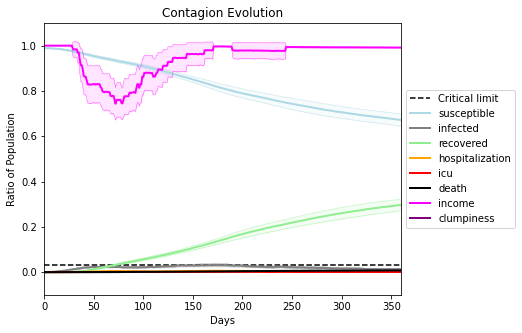

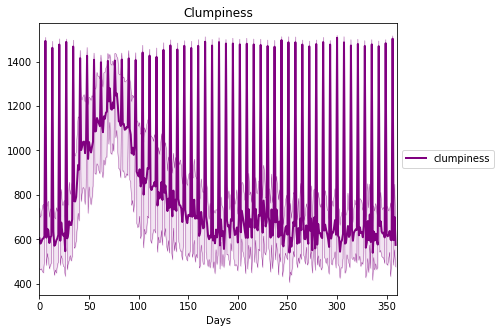

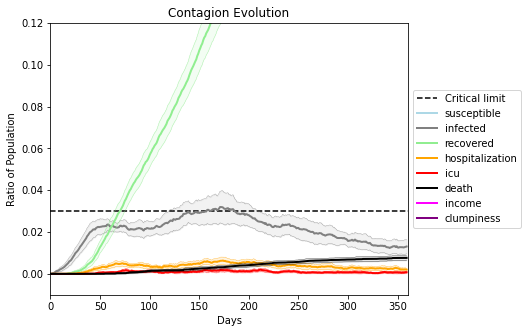

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1729, 8995, 5412, 3004, 8864, 9465, 2949, 9767, 3305, 6305, 4697, 7930, 7227, 2184, 7486, 7783, 7757, 152, 2423, 1248]
Average similarity between family members is 0.9553904335768812 at temperature -0.997
Average similarity between family and home is 0.9998492752597046 at temperature -1
Average similarity between students and their classroom is 0.9460092070111372 at temperature -0.997
Average classroom occupancy is 1.7407407407407407 and number classrooms is 162
Average similarity between workers is 0.9293268511794325 at temperature -0.997
Average office occupancy is 3.453125 and number offices is 192
Average friend similarity for adults: 0.8578353057936629 for kids: 0.719091239625968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.5937596206566675
avg restaurant similarity 0.6123952624583954
avg restaurant similarity 0.5903310268427044
avg restaurant similarity 0.6542421298611074
avg restaurant similarity 0.6446344350535181
avg restaurant similarity 0.5603110632243672
avg restaurant similarity 0.5972245025786699
avg restaurant similarity 0.629109522045596
avg restaurant similarity 0.6697157926492798
avg restaurant similarity 0.6306391897085027
avg restaurant similarity 0.6339278295334528
avg restaurant similarity 0.579165419781216
avg restaurant similarity 0.6787097520666641
avg restaurant similarity 0.655009542890857
avg restaurant similarity 0.5985481980350138
avg restaurant similarity 0.609837686967414
avg restaurant similarity 0.6260269739409222
avg restaurant similarity 0.551065214893357
avg restaurant similarity 0.5913011355936969
avg restaurant similarity 0.6248035200906011
avg restaurant similarity 0.6105435381277668
avg restaurant similarity 0.6247520573803156
avg restaurant 

avg restaurant similarity 0.6470780824240738
avg restaurant similarity 0.6389793989585768
avg restaurant similarity 0.67351784312962
avg restaurant similarity 0.6716398005426871
avg restaurant similarity 0.618187260663868
avg restaurant similarity 0.6148599651083884
avg restaurant similarity 0.608582647237171
avg restaurant similarity 0.6815643955491979
avg restaurant similarity 0.6239022112183048
avg restaurant similarity 0.6880096027095707
avg restaurant similarity 0.6558226046399143
avg restaurant similarity 0.6438682763538345
avg restaurant similarity 0.6311049221720435
avg restaurant similarity 0.5768426139363436
avg restaurant similarity 0.6473052324403968
avg restaurant similarity 0.6057137073969411
avg restaurant similarity 0.640922853387179
avg restaurant similarity 0.6353505403409706
avg restaurant similarity 0.6582465756776433
avg restaurant similarity 0.6203452399333399
avg restaurant similarity 0.6334777864160462
avg restaurant similarity 0.6423601380142153
avg restaurant 

Average similarity between workers is 0.9124628435502149 at temperature -0.997
Average office occupancy is 3.292307692307692 and number offices is 195
Average friend similarity for adults: 0.8478807380706672 for kids: 0.7335921059208637
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.5711008480965322
avg restaurant similarity 0.5347856975374403
avg restaurant similarity 0.5622262118043556
avg restaurant similarity 0.5762288098008234
avg restaurant similarity 0.6406834146075643
avg restaurant similarity 0.601631619809878
avg restaurant similarity 0.6245645889448731
avg restaurant similarity 0.5974415747834741
avg restaurant similarity 0.5973180757873349
avg restaurant similarity 0.5911472483135581
avg restaurant similarity 0.5721613975401335
avg restaurant similarity 0.58690267713823
avg restaurant similarity 0.5970534420588672
avg restaurant similarity 0.5461012440489238
avg restaurant similarity 0.6498652660627573
avg restaurant similarity 0.5828469801500632
avg restaurant similarity 0.6157160826984405
avg restaurant similarity 0.5785650575826955
avg restaurant similarity 0.6133489701044496
avg restaurant similarity 0.6015993579641821
avg restaurant similarity 0.6053788385287402
avg restaurant similarity 0.6283232871956592
avg restauran

avg restaurant similarity 0.6195422960208344
avg restaurant similarity 0.5983162512594961
avg restaurant similarity 0.5888640672022394
avg restaurant similarity 0.5829714545792387
avg restaurant similarity 0.6392387351970573
avg restaurant similarity 0.5666056854052555
avg restaurant similarity 0.5988822400085224
avg restaurant similarity 0.5983551983045385
avg restaurant similarity 0.6113574501716725
avg restaurant similarity 0.6035363839000782
avg restaurant similarity 0.6144706672348331
avg restaurant similarity 0.547201590818938
avg restaurant similarity 0.6155302228400689
avg restaurant similarity 0.5967408992977004
avg restaurant similarity 0.5957571997191043
avg restaurant similarity 0.5970847469935701
avg restaurant similarity 0.578635939067262
avg restaurant similarity 0.5899426916651433
avg restaurant similarity 0.6254821097211954
avg restaurant similarity 0.6237719701980219
avg restaurant similarity 0.5704151691843714
avg restaurant similarity 0.6169277482778567
avg restaura

Average similarity between workers is 0.926217719961607 at temperature -0.997
Average office occupancy is 3.3743589743589744 and number offices is 195
Average friend similarity for adults: 0.8560313600451197 for kids: 0.735752150813554
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5909258965492435
avg restaurant similarity 0.5893525349159193
avg restaurant similarity 0.6471409055671151
avg restaurant similarity 0.5764157553851795
avg restaurant similarity 0.5786135564357335
avg restaurant similarity 0.5509857064123375
avg restaurant similarity 0.6898320853357881
avg restaurant similarity 0.6647543802824066
avg restaurant similarity 0.5451384908508208
avg restaurant similarity 0.603319832627584
avg restaurant similarity 0.6038666432267858
avg restaurant similarity 0.6407697868816823
avg restaurant similarity 0.6300631582456754
avg restaurant similarity 0.599296867790219
avg restaurant similarity 0.6494662854706666
avg restaurant similarity 0.5932429309444096
avg restaurant similarity 0.59020816698226
avg restaurant similarity 0.5587381421397675
avg restaurant similarity 0.6452415491332504
avg restaurant similarity 0.6237046423687557
avg restaurant similarity 0.6536481709886561
avg restaurant similarity 0.6737563550049839
avg restaurant

avg restaurant similarity 0.5946122740000227
avg restaurant similarity 0.5790646725313271
avg restaurant similarity 0.6652900334583131
avg restaurant similarity 0.5567948886496887
avg restaurant similarity 0.6226059822436444
avg restaurant similarity 0.6492023642658926
avg restaurant similarity 0.5453448051549823
avg restaurant similarity 0.5892652855121487
avg restaurant similarity 0.6050732648419122
avg restaurant similarity 0.6031387342877702
avg restaurant similarity 0.5776760778177248
avg restaurant similarity 0.5713263636985706
avg restaurant similarity 0.5862448038130809
avg restaurant similarity 0.6190140425866602
avg restaurant similarity 0.494992328232406
avg restaurant similarity 0.5924043837374133
avg restaurant similarity 0.5944702967497222
avg restaurant similarity 0.5613727681759758
avg restaurant similarity 0.603251615737656
avg restaurant similarity 0.5542446870435219
avg restaurant similarity 0.6175287738322107
avg restaurant similarity 0.6428161234063429
avg restaura

Average similarity between workers is 0.9208582125535455 at temperature -0.997
Average office occupancy is 3.3197969543147208 and number offices is 197
Average friend similarity for adults: 0.854685593261956 for kids: 0.7302824813464608
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6669002184851919
avg restaurant similarity 0.5787857005020725
avg restaurant similarity 0.6313216123432608
avg restaurant similarity 0.637174687861505
avg restaurant similarity 0.6390796529524008
avg restaurant similarity 0.6228037624723627
avg restaurant similarity 0.6289170592570952
avg restaurant similarity 0.631941465531256
avg restaurant similarity 0.6096566478488684
avg restaurant similarity 0.6375724330551952
avg restaurant similarity 0.6053535997172038
avg restaurant similarity 0.6678900674487596
avg restaurant similarity 0.7007755908374003
avg restaurant similarity 0.6217713092999371
avg restaurant similarity 0.5378135985935575
avg restaurant similarity 0.6428834906941355
avg restaurant similarity 0.6195965103166018
avg restaurant similarity 0.6418074674177118
avg restaurant similarity 0.5990796717738727
avg restaurant similarity 0.6418202591425715
avg restaurant similarity 0.6009321149096285
avg restaurant similarity 0.6581724799233657
avg restaura

avg restaurant similarity 0.5628951394682936
avg restaurant similarity 0.6664601195360125
avg restaurant similarity 0.6424917302335938
avg restaurant similarity 0.5474941234271687
avg restaurant similarity 0.6285771868469765
avg restaurant similarity 0.6273438357116283
avg restaurant similarity 0.6583692421562195
avg restaurant similarity 0.6691905970901959
avg restaurant similarity 0.6013344006818311
avg restaurant similarity 0.6156402779802612
avg restaurant similarity 0.6583597718991745
avg restaurant similarity 0.6515416557007656
avg restaurant similarity 0.6327753074616251
avg restaurant similarity 0.6298369941306464
avg restaurant similarity 0.6128585130738352
avg restaurant similarity 0.6435458256850495
avg restaurant similarity 0.6183513171543888
avg restaurant similarity 0.6807969805196574
avg restaurant similarity 0.6244584393119453
avg restaurant similarity 0.6419281459141498
avg restaurant similarity 0.6766846817238162
avg restaurant similarity 0.6482284260533391
avg restau

Average similarity between workers is 0.9151447072189084 at temperature -0.997
Average office occupancy is 3.326530612244898 and number offices is 196
Average friend similarity for adults: 0.8399448835512999 for kids: 0.7225303510206507
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5349777315441231
avg restaurant similarity 0.5029681317291458
avg restaurant similarity 0.5659133866360428
avg restaurant similarity 0.5753662326443841
avg restaurant similarity 0.6008647418089396
avg restaurant similarity 0.5408157940825798
avg restaurant similarity 0.6093576060339235
avg restaurant similarity 0.5534133035841412
avg restaurant similarity 0.5547681019953081
avg restaurant similarity 0.5598260327480977
avg restaurant similarity 0.5878349059382164
avg restaurant similarity 0.5681138329202668
avg restaurant similarity 0.5749503049645328
avg restaurant similarity 0.5472436184636797
avg restaurant similarity 0.5794961563687276
avg restaurant similarity 0.6045853799542611
avg restaurant similarity 0.5613121340063959
avg restaurant similarity 0.604178139648716
avg restaurant similarity 0.5965188633277375
avg restaurant similarity 0.6138559571486489
avg restaurant similarity 0.5288779550749328
avg restaurant similarity 0.5904383395372242
avg restaur

avg restaurant similarity 0.5193462874534536
avg restaurant similarity 0.5973483505227157
avg restaurant similarity 0.564637793356123
avg restaurant similarity 0.5680316786162088
avg restaurant similarity 0.6193674567481272
avg restaurant similarity 0.5693962664602639
avg restaurant similarity 0.6002531679349734
avg restaurant similarity 0.565421946781363
avg restaurant similarity 0.6119373209470763
avg restaurant similarity 0.5650211735544735
avg restaurant similarity 0.5747658401421613
avg restaurant similarity 0.5540329922806451
avg restaurant similarity 0.6067061350385627
avg restaurant similarity 0.5646581494315294
avg restaurant similarity 0.5872054489640581
avg restaurant similarity 0.573401268257528
avg restaurant similarity 0.5522967188823952
avg restaurant similarity 0.5929605015894545
avg restaurant similarity 0.557405916001517
avg restaurant similarity 0.6118496973936842
avg restaurant similarity 0.5906167739453617
avg restaurant similarity 0.6220346044105802
avg restaurant

Average similarity between workers is 0.9313950593239878 at temperature -0.997
Average office occupancy is 3.3664921465968587 and number offices is 191
Average friend similarity for adults: 0.8531023271492335 for kids: 0.740423702882789
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 

avg restaurant similarity 0.6483459659965812
avg restaurant similarity 0.6479601157801915
avg restaurant similarity 0.6381929182088897
avg restaurant similarity 0.6344934851539302
avg restaurant similarity 0.6037418364513484
avg restaurant similarity 0.6338191205578305
avg restaurant similarity 0.6584145733470321
avg restaurant similarity 0.6260736247451328
avg restaurant similarity 0.6536797268923955
avg restaurant similarity 0.6420729512726117
avg restaurant similarity 0.6805580407156803
avg restaurant similarity 0.581841255240145
avg restaurant similarity 0.6111593625030614
avg restaurant similarity 0.6610363329084821
avg restaurant similarity 0.5916543045528193
avg restaurant similarity 0.6212500035176858
avg restaurant similarity 0.6428844462466575
avg restaurant similarity 0.6793122093801566
avg restaurant similarity 0.6152971158192772
avg restaurant similarity 0.6411839741555633
avg restaurant similarity 0.6467754404277256
avg restaurant similarity 0.6501604849898577
avg restaur

avg restaurant similarity 0.6548951898943527
avg restaurant similarity 0.6788054637977468
avg restaurant similarity 0.6455144281975712
avg restaurant similarity 0.6268073048364211
avg restaurant similarity 0.6321173841233776
avg restaurant similarity 0.6331535603059584
avg restaurant similarity 0.6486313727412509
avg restaurant similarity 0.6351014940916736
avg restaurant similarity 0.6758587846570518
avg restaurant similarity 0.6947165723425865
avg restaurant similarity 0.6494111008624733
avg restaurant similarity 0.6550397460276923
avg restaurant similarity 0.6454669948504141
avg restaurant similarity 0.6512310758811094
avg restaurant similarity 0.6488997240240483
avg restaurant similarity 0.6404347788055292
avg restaurant similarity 0.6132414366300796
avg restaurant similarity 0.6193221336949183
avg restaurant similarity 0.6002711106455995
avg restaurant similarity 0.6719736412197748
avg restaurant similarity 0.6330982169231762
avg restaurant similarity 0.6383779326975316
avg restau

Average similarity between workers is 0.9420729017545214 at temperature -0.997
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8581870894413567 for kids: 0.747263329834441
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.624972825141413
avg restaurant similarity 0.5773532788743884
avg restaurant similarity 0.6168491626220299
avg restaurant similarity 0.6110899225603261
avg restaurant similarity 0.6186401147701829
avg restaurant similarity 0.6017592187246369
avg restaurant similarity 0.6266501448819024
avg restaurant similarity 0.6783853440818263
avg restaurant similarity 0.5818422806678483
avg restaurant similarity 0.5120368948902689
avg restaurant similarity 0.614093447966651
avg restaurant similarity 0.6299664524432237
avg restaurant similarity 0.6122812114615207
avg restaurant similarity 0.5950093211617841
avg restaurant similarity 0.6315265086093679
avg restaurant similarity 0.5980963530556485
avg restaurant similarity 0.5595977086269666
avg restaurant similarity 0.6061691249726228
avg restaurant similarity 0.6430432524173
avg restaurant similarity 0.6057568220352041
avg restaurant similarity 0.62019894852334
avg restaurant similarity 0.6025545663511054
avg restaurant si

avg restaurant similarity 0.6147761305235714
avg restaurant similarity 0.6068151970949683
avg restaurant similarity 0.544623680901462
avg restaurant similarity 0.602485904395529
avg restaurant similarity 0.600791908251786
avg restaurant similarity 0.5919956699671566
avg restaurant similarity 0.6025028334722783
avg restaurant similarity 0.5342695005940392
avg restaurant similarity 0.6006825389837755
avg restaurant similarity 0.5723420815918034
avg restaurant similarity 0.5833379972152131
avg restaurant similarity 0.5668334226166205
avg restaurant similarity 0.6126210319888339
avg restaurant similarity 0.6094346797918615
avg restaurant similarity 0.56884505376671
avg restaurant similarity 0.5438210056872183
avg restaurant similarity 0.6343152149868191
avg restaurant similarity 0.5953805975366185
avg restaurant similarity 0.6109380382232822
avg restaurant similarity 0.573664549805857
avg restaurant similarity 0.5888058041669569
avg restaurant similarity 0.5967543216197745
avg restaurant s

Average similarity between workers is 0.9363410836650071 at temperature -0.997
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.8576912329546179 for kids: 0.7215885124414081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6226100085392593
avg restaurant similarity 0.637071445240401
avg restaurant similarity 0.6190109857827766
avg restaurant similarity 0.6093073242499758
avg restaurant similarity 0.6337189299643683
avg restaurant similarity 0.6167673210047594
avg restaurant similarity 0.6292109334282181
avg restaurant similarity 0.5978528655624537
avg restaurant similarity 0.6317794307831788
avg restaurant similarity 0.6101286416524255
avg restaurant similarity 0.6264935114712594
avg restaurant similarity 0.5824901926697289
avg restaurant similarity 0.6607803394088603
avg restaurant similarity 0.6043694471631381
avg restaurant similarity 0.6398321770654377
avg restaurant similarity 0.5861166362248478
avg restaurant similarity 0.622896722996628
avg restaurant similarity 0.6170405643821812
avg restaurant similarity 0.6511345133172166
avg restaurant similarity 0.6428662420433763
avg restaurant similarity 0.6153865777724694
avg restaurant similarity 0.6364281525540861
avg restaura

avg restaurant similarity 0.6345615259627312
avg restaurant similarity 0.6480669130349579
avg restaurant similarity 0.5901764376391427
avg restaurant similarity 0.6505096699095133
avg restaurant similarity 0.6535406112067902
avg restaurant similarity 0.6071891909712611
avg restaurant similarity 0.5793056812305393
avg restaurant similarity 0.5851441284145548
avg restaurant similarity 0.6260898715093185
avg restaurant similarity 0.6329602070260005
avg restaurant similarity 0.6174317350700214
avg restaurant similarity 0.6414133214746206
avg restaurant similarity 0.6357828454269535
avg restaurant similarity 0.5933556660529427
avg restaurant similarity 0.595006879088129
avg restaurant similarity 0.5976045039984148
avg restaurant similarity 0.6649366707280111
avg restaurant similarity 0.5868813169939499
avg restaurant similarity 0.6388642772611731
avg restaurant similarity 0.694000856737635
avg restaurant similarity 0.6106647676349263
avg restaurant similarity 0.6056691173594588
avg restaura

Average similarity between workers is 0.9186362449994939 at temperature -0.997
Average office occupancy is 3.4507772020725387 and number offices is 193
Average friend similarity for adults: 0.8592138437233621 for kids: 0.7198115949492857
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6375515312871181
avg restaurant similarity 0.6241494539716258
avg restaurant similarity 0.589821433641949
avg restaurant similarity 0.6288956085807147
avg restaurant similarity 0.6107844216208123
avg restaurant similarity 0.6259853614606486
avg restaurant similarity 0.6307937882084068
avg restaurant similarity 0.6242112435112808
avg restaurant similarity 0.608199651178274
avg restaurant similarity 0.6555850950521733
avg restaurant similarity 0.5883429974538349
avg restaurant similarity 0.6335031436262318
avg restaurant similarity 0.6360629476370241
avg restaurant similarity 0.665732434324388
avg restaurant similarity 0.6438056650586413
avg restaurant similarity 0.5867298636086837
avg restaurant similarity 0.5797114558203424
avg restaurant similarity 0.5788824023276632
avg restaurant similarity 0.6230324902926363
avg restaurant similarity 0.656383325153539
avg restaurant similarity 0.6039915772525158
avg restaurant similarity 0.5708134373907152
avg restaurant

avg restaurant similarity 0.6027139629666275
avg restaurant similarity 0.6081379111047462
avg restaurant similarity 0.6495753960631899
avg restaurant similarity 0.6451310807404702
avg restaurant similarity 0.614412312958984
avg restaurant similarity 0.6207025974451923
avg restaurant similarity 0.6487559180812488
avg restaurant similarity 0.6380277295346968
avg restaurant similarity 0.6209653119423573
avg restaurant similarity 0.5578009961483313
avg restaurant similarity 0.6579802726372432
avg restaurant similarity 0.6492630395576285
avg restaurant similarity 0.6026235666291633
avg restaurant similarity 0.6454093817433756
avg restaurant similarity 0.5889110734252702
avg restaurant similarity 0.6268226282299282
avg restaurant similarity 0.6535307259651794
avg restaurant similarity 0.6719012790551869
avg restaurant similarity 0.6019059778220571
avg restaurant similarity 0.6293583074404022
avg restaurant similarity 0.6300491961312116
avg restaurant similarity 0.6151273667450993
avg restaur

Average similarity between workers is 0.9284706267544841 at temperature -0.997
Average office occupancy is 3.4444444444444446 and number offices is 198
Average friend similarity for adults: 0.8615090997345376 for kids: 0.7309843231746603
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6277054855460367
avg restaurant similarity 0.5757834227851453
avg restaurant similarity 0.6579856154452536
avg restaurant similarity 0.6118828826765639
avg restaurant similarity 0.5990734085172522
avg restaurant similarity 0.6495305223296444
avg restaurant similarity 0.6677517022005774
avg restaurant similarity 0.6892882648094774
avg restaurant similarity 0.6573865320738976
avg restaurant similarity 0.6442806277828678
avg restaurant similarity 0.6127200888806372
avg restaurant similarity 0.6255696413164582
avg restaurant similarity 0.6378009014850459
avg restaurant similarity 0.5663587265781446
avg restaurant similarity 0.6618109308552601
avg restaurant similarity 0.6130995016887651
avg restaurant similarity 0.6139381418566876
avg restaurant similarity 0.5814647135888605
avg restaurant similarity 0.643923861936656
avg restaurant similarity 0.620404624333733
avg restaurant similarity 0.6638817243315202
avg restaurant similarity 0.650781821517608
avg restauran

avg restaurant similarity 0.6053343562482826
avg restaurant similarity 0.5707229202532315
avg restaurant similarity 0.6525845183295347
avg restaurant similarity 0.5933716891541693
avg restaurant similarity 0.6498738927154977
avg restaurant similarity 0.6010341509230726
avg restaurant similarity 0.6260418706361404
avg restaurant similarity 0.5842150507827715
avg restaurant similarity 0.697143826616923
avg restaurant similarity 0.621715626629388
avg restaurant similarity 0.6020969586855691
avg restaurant similarity 0.6145437765666621
avg restaurant similarity 0.6194967623647286
avg restaurant similarity 0.6298264821887949
avg restaurant similarity 0.6413620472591808
avg restaurant similarity 0.6212629358382173
avg restaurant similarity 0.5664823953172428
avg restaurant similarity 0.6132433070481546
avg restaurant similarity 0.640579898702005
avg restaurant similarity 0.6268599345051845
avg restaurant similarity 0.6612218921625461
avg restaurant similarity 0.6279339451704411
avg restauran

Average similarity between workers is 0.9340734378519142 at temperature -0.997
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.8509416669587695 for kids: 0.7331743196928593
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5977831265029675
avg restaurant similarity 0.6153223627928329
avg restaurant similarity 0.6321474969729134
avg restaurant similarity 0.6284598984606558
avg restaurant similarity 0.6255093938203712
avg restaurant similarity 0.6340109480893799
avg restaurant similarity 0.5843534697815407
avg restaurant similarity 0.5678555212975628
avg restaurant similarity 0.5903322431741251
avg restaurant similarity 0.5811418241929904
avg restaurant similarity 0.5473245676106004
avg restaurant similarity 0.6177272496293149
avg restaurant similarity 0.6014796971050091
avg restaurant similarity 0.5850596008796946
avg restaurant similarity 0.5899883696280577
avg restaurant similarity 0.6402436335335563
avg restaurant similarity 0.6296596445977583
avg restaurant similarity 0.6521449445011293
avg restaurant similarity 0.5976999083585691
avg restaurant similarity 0.582165311297238
avg restaurant similarity 0.6291676044990675
avg restaurant similarity 0.6226826843803773
avg restaur

avg restaurant similarity 0.6161096993618957
avg restaurant similarity 0.6348926789785139
avg restaurant similarity 0.6008981397995309
avg restaurant similarity 0.627442730038874
avg restaurant similarity 0.6244498150152354
avg restaurant similarity 0.617235098483352
avg restaurant similarity 0.6172104397533072
avg restaurant similarity 0.624741656069505
avg restaurant similarity 0.6078676353393331
avg restaurant similarity 0.6224686516706471
avg restaurant similarity 0.6249759664170755
avg restaurant similarity 0.6406316415553559
avg restaurant similarity 0.6287909621119199
avg restaurant similarity 0.6413010396207661
avg restaurant similarity 0.606459415466835
avg restaurant similarity 0.6428180736967163
avg restaurant similarity 0.610238555150491
avg restaurant similarity 0.5875230103261622
avg restaurant similarity 0.6076159559659517
avg restaurant similarity 0.6250317549118971
avg restaurant similarity 0.606301135142367
avg restaurant similarity 0.6798771134319029
avg restaurant s

Average similarity between workers is 0.9263491873490701 at temperature -0.997
Average office occupancy is 3.518918918918919 and number offices is 185
Average friend similarity for adults: 0.8570182812070523 for kids: 0.7448747211965073
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.6133242679493367
avg restaurant similarity 0.6486676692943435
avg restaurant similarity 0.5996182675928892
avg restaurant similarity 0.5973856891413437
avg restaurant similarity 0.5833896802767329
avg restaurant similarity 0.5933783859893846
avg restaurant similarity 0.5894794168420413
avg restaurant similarity 0.6042049998888612
avg restaurant similarity 0.6233286891927854
avg restaurant similarity 0.6122031048862037
avg restaurant similarity 0.5946327374508589
avg restaurant similarity 0.6368801390327195
avg restaurant similarity 0.6577523058385967
avg restaurant similarity 0.5650551026032274
avg restaurant similarity 0.6255891253087362
avg restaurant similarity 0.5984865582916254
avg restaurant similarity 0.6416133417132405
avg restaurant similarity 0.6322227967076285
avg restaurant similarity 0.5720944599527211
avg restaurant similarity 0.6130610238106255
avg restaurant similarity 0.6520790811677855
avg restaurant similarity 0.5980615919243972
avg restau

avg restaurant similarity 0.582751484042661
avg restaurant similarity 0.5908272607224707
avg restaurant similarity 0.6218558392835348
avg restaurant similarity 0.5860585958384917
avg restaurant similarity 0.6214723361752122
avg restaurant similarity 0.5863845754284973
avg restaurant similarity 0.6104006961826529
avg restaurant similarity 0.5332526065640999
avg restaurant similarity 0.59898060823359
avg restaurant similarity 0.5758269662553361
avg restaurant similarity 0.5943747331394502
avg restaurant similarity 0.5957048765614525
avg restaurant similarity 0.6300659098393359
avg restaurant similarity 0.6131727361299045
avg restaurant similarity 0.6319856132832019
avg restaurant similarity 0.5747813802136325
avg restaurant similarity 0.6019442054232794
avg restaurant similarity 0.5674801366979892
avg restaurant similarity 0.6451139408352881
avg restaurant similarity 0.6278623704914423
avg restaurant similarity 0.6013211893020335
avg restaurant similarity 0.6477820282500972
avg restauran

Average similarity between workers is 0.9359552893404106 at temperature -0.997
Average office occupancy is 3.3125 and number offices is 192
Average friend similarity for adults: 0.8538060128121839 for kids: 0.7383873547843688
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people alloca

avg restaurant similarity 0.581568205190568
avg restaurant similarity 0.576920682845666
avg restaurant similarity 0.531320225998963
avg restaurant similarity 0.6187563528923802
avg restaurant similarity 0.5252432154805738
avg restaurant similarity 0.540716711052824
avg restaurant similarity 0.5110432662143575
avg restaurant similarity 0.5873685294037305
avg restaurant similarity 0.5636258468030798
avg restaurant similarity 0.5461329671215411
avg restaurant similarity 0.5500293354668764
avg restaurant similarity 0.5787846100061312
avg restaurant similarity 0.5698730168310401
avg restaurant similarity 0.6047283374400365
avg restaurant similarity 0.5089393184271709
avg restaurant similarity 0.5874172248620495
avg restaurant similarity 0.5658294742740055
avg restaurant similarity 0.5617503995330181
avg restaurant similarity 0.5473299892470618
avg restaurant similarity 0.5254950359829818
avg restaurant similarity 0.5681862306567638
avg restaurant similarity 0.5744392761663376
avg restaurant

avg restaurant similarity 0.49367484169582954
avg restaurant similarity 0.5875795717856706
avg restaurant similarity 0.534383414283976
avg restaurant similarity 0.5326090060733506
avg restaurant similarity 0.541065980020605
avg restaurant similarity 0.5855717982124861
avg restaurant similarity 0.5212019637906106
avg restaurant similarity 0.6108475882972596
avg restaurant similarity 0.5167168685155688
avg restaurant similarity 0.5516299778527809
avg restaurant similarity 0.5900967661106192
avg restaurant similarity 0.5818323585685145
avg restaurant similarity 0.5794891922493848
avg restaurant similarity 0.5217643051102486
avg restaurant similarity 0.5865870758381245
avg restaurant similarity 0.5131895005078579
avg restaurant similarity 0.644346547194131
avg restaurant similarity 0.4992365962687405
avg restaurant similarity 0.5474882322680595
avg restaurant similarity 0.5562676532029431
avg restaurant similarity 0.5847609837295805
avg restaurant similarity 0.5500533928290676
avg restaura

Average similarity between workers is 0.9322623089295431 at temperature -0.997
Average office occupancy is 3.378238341968912 and number offices is 193
Average friend similarity for adults: 0.8539783298593758 for kids: 0.7253954607272943
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.6198524818403235
avg restaurant similarity 0.5675441786622327
avg restaurant similarity 0.6018592746385514
avg restaurant similarity 0.6031964125140481
avg restaurant similarity 0.5810406337508572
avg restaurant similarity 0.599745179619031
avg restaurant similarity 0.5947151246108879
avg restaurant similarity 0.6003273184517108
avg restaurant similarity 0.5595638169051581
avg restaurant similarity 0.5412625117807017
avg restaurant similarity 0.5589093317367321
avg restaurant similarity 0.5686348298305998
avg restaurant similarity 0.5591703189586696
avg restaurant similarity 0.6613665703574175
avg restaurant similarity 0.5444624653602953
avg restaurant similarity 0.5885463778022662
avg restaurant similarity 0.6426906811296235
avg restaurant similarity 0.6310726828270947
avg restaurant similarity 0.6243214770891794
avg restaurant similarity 0.5570458836345037
avg restaurant similarity 0.5618949695342056
avg restaurant similarity 0.6297480253607556
avg restaur

avg restaurant similarity 0.6390590301697106
avg restaurant similarity 0.5971590055774032
avg restaurant similarity 0.5783039475751898
avg restaurant similarity 0.5664786405409271
avg restaurant similarity 0.6277400745199434
avg restaurant similarity 0.5744406015373374
avg restaurant similarity 0.6257263627662589
avg restaurant similarity 0.5752129098802614
avg restaurant similarity 0.5743305232896593
avg restaurant similarity 0.5917977194665293
avg restaurant similarity 0.57749414576376
avg restaurant similarity 0.6310265973186021
avg restaurant similarity 0.5910191089561373
avg restaurant similarity 0.6050304235948052
avg restaurant similarity 0.6198931563864375
avg restaurant similarity 0.5614769847304057
avg restaurant similarity 0.5943988108857786
avg restaurant similarity 0.6401603758970552
avg restaurant similarity 0.5417360485477696
avg restaurant similarity 0.6301906872506543
avg restaurant similarity 0.6151177067597257
avg restaurant similarity 0.631177840844691
avg restauran

Average similarity between workers is 0.9144268134179566 at temperature -0.997
Average office occupancy is 3.373056994818653 and number offices is 193
Average friend similarity for adults: 0.8476090660155142 for kids: 0.7359157670883065
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5358214051058937
avg restaurant similarity 0.5898245945797863
avg restaurant similarity 0.6065151722915323
avg restaurant similarity 0.6116977300394381
avg restaurant similarity 0.6139298265795596
avg restaurant similarity 0.6239759132660863
avg restaurant similarity 0.5646929367127665
avg restaurant similarity 0.6108328521303075
avg restaurant similarity 0.5920544134203842
avg restaurant similarity 0.6329434304774196
avg restaurant similarity 0.5854092178257454
avg restaurant similarity 0.6259214929433632
avg restaurant similarity 0.603608864944351
avg restaurant similarity 0.6231774172258211
avg restaurant similarity 0.6494315133672831
avg restaurant similarity 0.5930891730546685
avg restaurant similarity 0.6383178055027807
avg restaurant similarity 0.6112598123379045
avg restaurant similarity 0.6135474393116737
avg restaurant similarity 0.5991371845037325
avg restaurant similarity 0.58794208484978
avg restaurant similarity 0.6267158291075943
avg restauran

avg restaurant similarity 0.5890503492307236
avg restaurant similarity 0.6609993774293458
avg restaurant similarity 0.6243224072026311
avg restaurant similarity 0.5853300538899594
avg restaurant similarity 0.5890946585360224
avg restaurant similarity 0.6323730725990993
avg restaurant similarity 0.6057485298045858
avg restaurant similarity 0.6519772153891215
avg restaurant similarity 0.6345244951471519
avg restaurant similarity 0.6007971871749463
avg restaurant similarity 0.6176940609872016
avg restaurant similarity 0.5959657889474178
avg restaurant similarity 0.5826974068436632
avg restaurant similarity 0.5927339497089044
avg restaurant similarity 0.6152576443650357
avg restaurant similarity 0.6188743825738149
avg restaurant similarity 0.653411359014011
avg restaurant similarity 0.6062897179580092
avg restaurant similarity 0.6287244536299021
avg restaurant similarity 0.5598726284989006
avg restaurant similarity 0.6541927265950119
avg restaurant similarity 0.6369158087687612
avg restaur

Average similarity between workers is 0.9359264309879054 at temperature -0.997
Average office occupancy is 3.4 and number offices is 200
Average friend similarity for adults: 0.8637538089735527 for kids: 0.7390312345075352
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people alloc

avg restaurant similarity 0.622256372481782
avg restaurant similarity 0.6108076869599138
avg restaurant similarity 0.6212980684693331
avg restaurant similarity 0.5991935807752232
avg restaurant similarity 0.5389266739038254
avg restaurant similarity 0.5610283140929556
avg restaurant similarity 0.6252785327890573
avg restaurant similarity 0.6229392660381414
avg restaurant similarity 0.6091702927006303
avg restaurant similarity 0.6395760812960058
avg restaurant similarity 0.6134284359263906
avg restaurant similarity 0.5858096159433869
avg restaurant similarity 0.6442404708003843
avg restaurant similarity 0.6004584750589371
avg restaurant similarity 0.5893045646271386
avg restaurant similarity 0.5780487514356094
avg restaurant similarity 0.6042046685608036
avg restaurant similarity 0.6529891716124399
avg restaurant similarity 0.5759220099150311
avg restaurant similarity 0.6518311746528547
avg restaurant similarity 0.6490049777696943
avg restaurant similarity 0.61376822660598
avg restauran

avg restaurant similarity 0.6140410377361045
avg restaurant similarity 0.5983668709533898
avg restaurant similarity 0.6125369736971271
avg restaurant similarity 0.5855475497914681
avg restaurant similarity 0.5104741033885389
avg restaurant similarity 0.5653599106637078
avg restaurant similarity 0.6340872265008114
avg restaurant similarity 0.6075607539753892
avg restaurant similarity 0.5914525678206535
avg restaurant similarity 0.5694999526155576
avg restaurant similarity 0.6219608980614852
avg restaurant similarity 0.6578374076139966
avg restaurant similarity 0.5813834634495134
avg restaurant similarity 0.6836771236589625
avg restaurant similarity 0.5857900622188723
avg restaurant similarity 0.6020367568256635
avg restaurant similarity 0.6035054047206738
avg restaurant similarity 0.6062174893814362
avg restaurant similarity 0.6219950108255305
avg restaurant similarity 0.6081068902701156
avg restaurant similarity 0.6258018695174125
avg restaurant similarity 0.5681978707269741
avg restau

Average similarity between workers is 0.9188863763088578 at temperature -0.997
Average office occupancy is 3.49468085106383 and number offices is 188
Average friend similarity for adults: 0.8612521450533496 for kids: 0.7461900770367434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.6121587644542041
avg restaurant similarity 0.6669330911199397
avg restaurant similarity 0.651653962417099
avg restaurant similarity 0.6505344846195003
avg restaurant similarity 0.6131017057632374
avg restaurant similarity 0.6641294587011177
avg restaurant similarity 0.6380484990530935
avg restaurant similarity 0.6907959191295926
avg restaurant similarity 0.6413940427648241
avg restaurant similarity 0.6220618586070105
avg restaurant similarity 0.6577841125617339
avg restaurant similarity 0.6077402783442479
avg restaurant similarity 0.6656259845676648
avg restaurant similarity 0.6809017850519657
avg restaurant similarity 0.6372528693909469
avg restaurant similarity 0.6708299700568464
avg restaurant similarity 0.6418360285476347
avg restaurant similarity 0.6646708208305528
avg restaurant similarity 0.6950477296026827
avg restaurant similarity 0.5993870880780311
avg restaurant similarity 0.6553410048124061
avg restaurant similarity 0.6453160231539441
avg restaur

avg restaurant similarity 0.6750621816119386
avg restaurant similarity 0.656981214114336
avg restaurant similarity 0.6469602207337077
avg restaurant similarity 0.6341682964117894
avg restaurant similarity 0.6332850824603183
avg restaurant similarity 0.6445893666931768
avg restaurant similarity 0.6322893682294947
avg restaurant similarity 0.6581035314251661
avg restaurant similarity 0.6144028860908123
avg restaurant similarity 0.6487299464969226
avg restaurant similarity 0.6666094636893
avg restaurant similarity 0.6326570796426572
avg restaurant similarity 0.6708690764797939
avg restaurant similarity 0.6749828944324353
avg restaurant similarity 0.6289503620311807
avg restaurant similarity 0.6359147427122631
avg restaurant similarity 0.6491798886166568
avg restaurant similarity 0.6845342795059194
avg restaurant similarity 0.6463628059314886
avg restaurant similarity 0.6679381915874388
avg restaurant similarity 0.6707530054273156
avg restaurant similarity 0.6815180241416897
avg restaurant

Average similarity between workers is 0.9114866648186668 at temperature -0.997
Average office occupancy is 3.492063492063492 and number offices is 189
Average friend similarity for adults: 0.8566587111355604 for kids: 0.7400548309628234
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6353557029593777
avg restaurant similarity 0.5864218608814213
avg restaurant similarity 0.631743025470909
avg restaurant similarity 0.5669182158640496
avg restaurant similarity 0.5942464338709939
avg restaurant similarity 0.5651593278947323
avg restaurant similarity 0.5964058052402762
avg restaurant similarity 0.6099883008203804
avg restaurant similarity 0.6078303392622271
avg restaurant similarity 0.6072552028466869
avg restaurant similarity 0.5675866080562293
avg restaurant similarity 0.6078743019577396
avg restaurant similarity 0.5786102478520114
avg restaurant similarity 0.6404096622459927
avg restaurant similarity 0.5977549048276095
avg restaurant similarity 0.5783058789643752
avg restaurant similarity 0.6123266765759301
avg restaurant similarity 0.6538342721665988
avg restaurant similarity 0.6294210510244435
avg restaurant similarity 0.5821528757470301
avg restaurant similarity 0.6180305545755953
avg restaurant similarity 0.63080002061567
avg restauran

avg restaurant similarity 0.5976962272337185
avg restaurant similarity 0.7019416158449946
avg restaurant similarity 0.5908164291547361
avg restaurant similarity 0.5897366853101553
avg restaurant similarity 0.6012801281061738
avg restaurant similarity 0.6423109742506092
avg restaurant similarity 0.64543605294537
avg restaurant similarity 0.6011066526149927
avg restaurant similarity 0.5871177015493412
avg restaurant similarity 0.5861277493440716
avg restaurant similarity 0.6397544305032212
avg restaurant similarity 0.6092658875887105
avg restaurant similarity 0.6019066125405015
avg restaurant similarity 0.6476303380001325
avg restaurant similarity 0.583918215927134
avg restaurant similarity 0.5994221189596891
avg restaurant similarity 0.60197581531431
avg restaurant similarity 0.585912343204817
avg restaurant similarity 0.5818956338985078
avg restaurant similarity 0.5638547860535712
avg restaurant similarity 0.5938295194772231
avg restaurant similarity 0.620460362854715
avg restaurant si

Average similarity between workers is 0.9192046153821686 at temperature -0.997
Average office occupancy is 3.526595744680851 and number offices is 188
Average friend similarity for adults: 0.8536143211476481 for kids: 0.735189293645425
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.6091412277615674
avg restaurant similarity 0.6399912596122483
avg restaurant similarity 0.6825503053978733
avg restaurant similarity 0.6266024656082555
avg restaurant similarity 0.6253465505496113
avg restaurant similarity 0.5900661415508037
avg restaurant similarity 0.6026702698871925
avg restaurant similarity 0.624790393822743
avg restaurant similarity 0.5801329924242292
avg restaurant similarity 0.6731214680669078
avg restaurant similarity 0.673758197105987
avg restaurant similarity 0.6225649912864039
avg restaurant similarity 0.6378820111016991
avg restaurant similarity 0.6257073051464489
avg restaurant similarity 0.5833225352403809
avg restaurant similarity 0.60686302913138
avg restaurant similarity 0.6139559730615678
avg restaurant similarity 0.6423549073217488
avg restaurant similarity 0.6448796365819476
avg restaurant similarity 0.6241990790487795
avg restaurant similarity 0.560389925111058
avg restaurant similarity 0.6780725126384247
avg restaurant 

avg restaurant similarity 0.5965478443401173
avg restaurant similarity 0.6077806681951614
avg restaurant similarity 0.6560820167543986
avg restaurant similarity 0.557461301811885
avg restaurant similarity 0.6275804070989707
avg restaurant similarity 0.6113051867676672
avg restaurant similarity 0.7025154411722109
avg restaurant similarity 0.6338619811849938
avg restaurant similarity 0.6094528400897378
avg restaurant similarity 0.6714427453018001
avg restaurant similarity 0.6540642928076035
avg restaurant similarity 0.6008837453944723
avg restaurant similarity 0.6646996465473048
avg restaurant similarity 0.6240760298737553
avg restaurant similarity 0.5996095205529206
avg restaurant similarity 0.6271661133641003
avg restaurant similarity 0.6628776751046132
avg restaurant similarity 0.5975035865695109
avg restaurant similarity 0.6272099084354343
avg restaurant similarity 0.597327773307775
avg restaurant similarity 0.625075173233691
avg restaurant similarity 0.694579649389264
avg restaurant

Average similarity between workers is 0.9132355014943851 at temperature -0.997
Average office occupancy is 3.5494505494505493 and number offices is 182
Average friend similarity for adults: 0.8471442903661068 for kids: 0.7436088325778961
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6512302345811128
avg restaurant similarity 0.6185599429747995
avg restaurant similarity 0.6553845570550142
avg restaurant similarity 0.6836177590250564
avg restaurant similarity 0.6597474154341998
avg restaurant similarity 0.675353125133197
avg restaurant similarity 0.6444582600932657
avg restaurant similarity 0.6571428802419462
avg restaurant similarity 0.6187609454388031
avg restaurant similarity 0.6580518546344586
avg restaurant similarity 0.6708291643205047
avg restaurant similarity 0.6335714543108928
avg restaurant similarity 0.6230397194340173
avg restaurant similarity 0.6326962206490659
avg restaurant similarity 0.6332206033373085
avg restaurant similarity 0.6653040785376818
avg restaurant similarity 0.6392148547129777
avg restaurant similarity 0.6417168952713718
avg restaurant similarity 0.6278386084127265
avg restaurant similarity 0.6301767383646378
avg restaurant similarity 0.5995965032727965
avg restaurant similarity 0.6525842953323108
avg restaur

avg restaurant similarity 0.6654112009224266
avg restaurant similarity 0.6519980648765769
avg restaurant similarity 0.6181338416299132
avg restaurant similarity 0.6470946657221768
avg restaurant similarity 0.6296002366685789
avg restaurant similarity 0.6485669595977656
avg restaurant similarity 0.6374757599959087
avg restaurant similarity 0.6428192844664695
avg restaurant similarity 0.6730769468623947
avg restaurant similarity 0.6579381606887634
avg restaurant similarity 0.6196604687254171
avg restaurant similarity 0.63766444826119
avg restaurant similarity 0.6361572289992711
avg restaurant similarity 0.6746334296005573
avg restaurant similarity 0.6446208674828903
avg restaurant similarity 0.5768715587134637
avg restaurant similarity 0.6441796289053054
avg restaurant similarity 0.6701814016570617
avg restaurant similarity 0.6043972202536417
avg restaurant similarity 0.5866912209805099
avg restaurant similarity 0.6465586811563665
avg restaurant similarity 0.6539276447390685
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

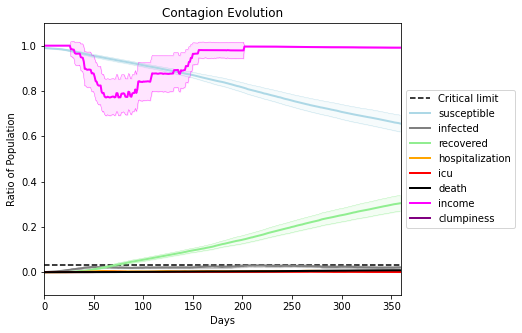

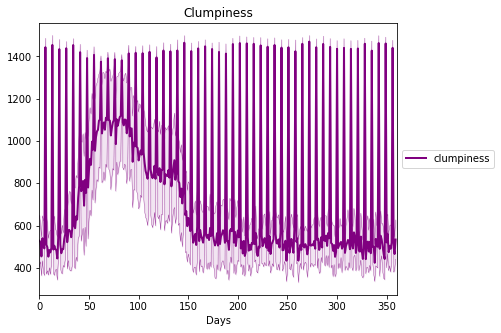

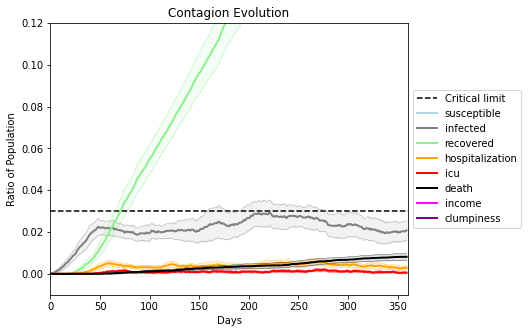

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4856, 29, 9306, 5399, 1179, 2373, 4630, 2940, 3671, 712, 3184, 3362, 8209, 386, 4743, 9047, 9642, 2562, 7585, 8611]
Average similarity between family members is 0.9409623878677411 at temperature -0.996
Average similarity between family and home is 0.9998587986786732 at temperature -1
Average similarity between students and their classroom is 0.9353404334810236 at temperature -0.996
Average classroom occupancy is 1.6171428571428572 and number classrooms is 175
Average similarity between workers is 0.9306697876005705 at temperature -0.996
Average office occupancy is 3.4329896907216493 and number offices is 194
Average friend similarity for adults: 0.8660416930496649 for kids: 0.7345541327243434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6557339523518371
avg restaurant similarity 0.659185096648638
avg restaurant similarity 0.6077449684090124
avg restaurant similarity 0.6206989160562736
avg restaurant similarity 0.6518740728675521
avg restaurant similarity 0.6481471905649915
avg restaurant similarity 0.6062190838765785
avg restaurant similarity 0.6038974321708267
avg restaurant similarity 0.6095516939507106
avg restaurant similarity 0.5938024689356339
avg restaurant similarity 0.6751961367813412
avg restaurant similarity 0.6025280165195064
avg restaurant similarity 0.612795834330658
avg restaurant similarity 0.6535446636584945
avg restaurant similarity 0.6352504367128202
avg restaurant similarity 0.6360981222411964
avg restaurant similarity 0.666364422611851
avg restaurant similarity 0.6578082835168604
avg restaurant similarity 0.6172407367517957
avg restaurant similarity 0.6123890449960414
avg restaurant similarity 0.638201576190638
avg restaurant similarity 0.6399976692118582
avg restaurant

avg restaurant similarity 0.6143356608729303
avg restaurant similarity 0.6039104341783171
avg restaurant similarity 0.5886029613527747
avg restaurant similarity 0.6532510942296561
avg restaurant similarity 0.63804207837119
avg restaurant similarity 0.6077942558239122
avg restaurant similarity 0.5997003408926693
avg restaurant similarity 0.6527081183300779
avg restaurant similarity 0.6344538117747803
avg restaurant similarity 0.6091805959545478
avg restaurant similarity 0.6238717614246073
avg restaurant similarity 0.6221207262080877
avg restaurant similarity 0.6056365701694719
avg restaurant similarity 0.6016889813346327
avg restaurant similarity 0.6017383737692963
avg restaurant similarity 0.6157487668049555
avg restaurant similarity 0.6187770745161747
avg restaurant similarity 0.5977094240468086
avg restaurant similarity 0.6916607075294497
avg restaurant similarity 0.5655076993999989
avg restaurant similarity 0.6447260702387171
avg restaurant similarity 0.6041261166945283
avg restaura

Average similarity between workers is 0.9137418641589723 at temperature -0.996
Average office occupancy is 3.4213197969543145 and number offices is 197
Average friend similarity for adults: 0.860741921822639 for kids: 0.7255509186036948
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6357870579575219
avg restaurant similarity 0.6785337366397944
avg restaurant similarity 0.588912103823045
avg restaurant similarity 0.5791724321196459
avg restaurant similarity 0.6435367165020911
avg restaurant similarity 0.5985220301262378
avg restaurant similarity 0.689102258502444
avg restaurant similarity 0.6578084489546604
avg restaurant similarity 0.6476021211079191
avg restaurant similarity 0.6824223956545784
avg restaurant similarity 0.6520598824349855
avg restaurant similarity 0.6076652112654316
avg restaurant similarity 0.6521335320885636
avg restaurant similarity 0.6708501877362532
avg restaurant similarity 0.6213827377347738
avg restaurant similarity 0.6492878854007863
avg restaurant similarity 0.5832107105826528
avg restaurant similarity 0.6009342270932773
avg restaurant similarity 0.5614280399182164
avg restaurant similarity 0.6222235199605668
avg restaurant similarity 0.5997438601353191
avg restaurant similarity 0.6316125664079224
avg restaura

avg restaurant similarity 0.6426167562013819
avg restaurant similarity 0.6155299792255442
avg restaurant similarity 0.5912071228048273
avg restaurant similarity 0.6261411977546977
avg restaurant similarity 0.6790339182434578
avg restaurant similarity 0.6512849120005368
avg restaurant similarity 0.657345483029241
avg restaurant similarity 0.6547545680297425
avg restaurant similarity 0.62103078693632
avg restaurant similarity 0.5405115036738338
avg restaurant similarity 0.5819382852369412
avg restaurant similarity 0.6322444806766508
avg restaurant similarity 0.5520588930084802
avg restaurant similarity 0.6265794541010163
avg restaurant similarity 0.6329896472839207
avg restaurant similarity 0.6225018337046035
avg restaurant similarity 0.6442895884888743
avg restaurant similarity 0.64208673705379
avg restaurant similarity 0.6019065396932542
avg restaurant similarity 0.6301515339368381
avg restaurant similarity 0.6679738606976998
avg restaurant similarity 0.6602697916072354
avg restaurant 

Average similarity between workers is 0.9354954795516979 at temperature -0.996
Average office occupancy is 3.4615384615384617 and number offices is 195
Average friend similarity for adults: 0.8643587361387628 for kids: 0.7317435032172576
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6079221470396329
avg restaurant similarity 0.6110824500355614
avg restaurant similarity 0.6260568464440612
avg restaurant similarity 0.6370087161703948
avg restaurant similarity 0.5929198061496929
avg restaurant similarity 0.6650900138415905
avg restaurant similarity 0.5988324303245711
avg restaurant similarity 0.6191131619611051
avg restaurant similarity 0.5965658307195159
avg restaurant similarity 0.6134480453581715
avg restaurant similarity 0.6371262722932699
avg restaurant similarity 0.655952718809551
avg restaurant similarity 0.6609377898902625
avg restaurant similarity 0.6114190120773842
avg restaurant similarity 0.619248108006102
avg restaurant similarity 0.6220349663738605
avg restaurant similarity 0.6282406918628309
avg restaurant similarity 0.6075799778035761
avg restaurant similarity 0.6225594163380828
avg restaurant similarity 0.5751837980520655
avg restaurant similarity 0.6358646152247535
avg restaurant similarity 0.5584447161675112
avg restaura

avg restaurant similarity 0.6398482886814669
avg restaurant similarity 0.6217716454038007
avg restaurant similarity 0.5803720374453656
avg restaurant similarity 0.5615449523163492
avg restaurant similarity 0.5932391897983152
avg restaurant similarity 0.6029507150686406
avg restaurant similarity 0.6117628810954222
avg restaurant similarity 0.6288835298746681
avg restaurant similarity 0.6211011627267832
avg restaurant similarity 0.6291041142613605
avg restaurant similarity 0.6044697332936276
avg restaurant similarity 0.6263146117309879
avg restaurant similarity 0.5932443489098561
avg restaurant similarity 0.6250141266842805
avg restaurant similarity 0.6017855404327648
avg restaurant similarity 0.5776854108139706
avg restaurant similarity 0.5920166257909166
avg restaurant similarity 0.6003176898087536
avg restaurant similarity 0.6660294069726045
avg restaurant similarity 0.6564695657936961
avg restaurant similarity 0.626452039380345
avg restaurant similarity 0.6255223286139332
avg restaur

Average similarity between workers is 0.9237358665927913 at temperature -0.996
Average office occupancy is 3.3947368421052633 and number offices is 190
Average friend similarity for adults: 0.8520342474024558 for kids: 0.7380644829498075
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.6128735830843784
avg restaurant similarity 0.609383008429616
avg restaurant similarity 0.6056397286440567
avg restaurant similarity 0.6680950832116126
avg restaurant similarity 0.6251530471160822
avg restaurant similarity 0.6744220769010627
avg restaurant similarity 0.56996654348887
avg restaurant similarity 0.5962758415072166
avg restaurant similarity 0.6878101522362673
avg restaurant similarity 0.6155897845195893
avg restaurant similarity 0.640533332492726
avg restaurant similarity 0.587568811258105
avg restaurant similarity 0.6385130135871663
avg restaurant similarity 0.6429762912759726
avg restaurant similarity 0.6313984454848409
avg restaurant similarity 0.6917252399954248
avg restaurant similarity 0.6301323614559448
avg restaurant similarity 0.6793642505513487
avg restaurant similarity 0.6771966501523125
avg restaurant similarity 0.6508993390484562
avg restaurant similarity 0.6533324218106583
avg restaurant similarity 0.636103170479016
avg restaurant s

avg restaurant similarity 0.6064508729068443
avg restaurant similarity 0.670124861402358
avg restaurant similarity 0.627601732871728
avg restaurant similarity 0.6168167008040325
avg restaurant similarity 0.6128604692142001
avg restaurant similarity 0.6191845551926444
avg restaurant similarity 0.5607017508255041
avg restaurant similarity 0.6519950811688343
avg restaurant similarity 0.628265076674729
avg restaurant similarity 0.6104802418401086
avg restaurant similarity 0.6108869698234463
avg restaurant similarity 0.655193401110772
avg restaurant similarity 0.6103361338161079
avg restaurant similarity 0.6101204028903153
avg restaurant similarity 0.6046874443697958
avg restaurant similarity 0.6597606879400525
avg restaurant similarity 0.5887874098496292
avg restaurant similarity 0.6195370858916616
avg restaurant similarity 0.5995973786716501
avg restaurant similarity 0.6290621803752673
avg restaurant similarity 0.6485424251226732
avg restaurant similarity 0.6136111938974571
avg restaurant

Average similarity between workers is 0.9149462635347909 at temperature -0.996
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8516350385061797 for kids: 0.734615265134407
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peop

avg restaurant similarity 0.5859812984448733
avg restaurant similarity 0.5761659692017486
avg restaurant similarity 0.6317196806101824
avg restaurant similarity 0.607659769591234
avg restaurant similarity 0.6077311660941732
avg restaurant similarity 0.5242616650254368
avg restaurant similarity 0.6928763898832905
avg restaurant similarity 0.6578174872101503
avg restaurant similarity 0.5877888054932059
avg restaurant similarity 0.617775044671557
avg restaurant similarity 0.6802658776856267
avg restaurant similarity 0.6052873820489708
avg restaurant similarity 0.6308319474849292
avg restaurant similarity 0.6333269196807367
avg restaurant similarity 0.6589979477487152
avg restaurant similarity 0.5682938939173602
avg restaurant similarity 0.6403196198506
avg restaurant similarity 0.660104525105659
avg restaurant similarity 0.5411335743530383
avg restaurant similarity 0.5780948221996933
avg restaurant similarity 0.6021323378094203
avg restaurant similarity 0.6041224372308072
avg restaurant s

avg restaurant similarity 0.6279668567164024
avg restaurant similarity 0.6347093090907
avg restaurant similarity 0.6228116922949214
avg restaurant similarity 0.6582379642692108
avg restaurant similarity 0.6041118711246338
avg restaurant similarity 0.6294672008871612
avg restaurant similarity 0.613528060016222
avg restaurant similarity 0.6844076801458767
avg restaurant similarity 0.6589106629096203
avg restaurant similarity 0.6311980386288397
avg restaurant similarity 0.5561154537408498
avg restaurant similarity 0.5735354371570104
avg restaurant similarity 0.5970110393895335
avg restaurant similarity 0.546241418086858
avg restaurant similarity 0.6104896517810012
avg restaurant similarity 0.6020094322726061
avg restaurant similarity 0.6416420982619816
avg restaurant similarity 0.5186529579929047
avg restaurant similarity 0.6085806763036481
avg restaurant similarity 0.6139283616619761
avg restaurant similarity 0.5969089515835061
avg restaurant similarity 0.5859762207450684
avg restaurant 

Average similarity between workers is 0.9206459752868948 at temperature -0.996
Average office occupancy is 3.424083769633508 and number offices is 191
Average friend similarity for adults: 0.8486000394057084 for kids: 0.7296368371240506
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5522260014921397
avg restaurant similarity 0.6057775995862379
avg restaurant similarity 0.552073381234895
avg restaurant similarity 0.5857710933545865
avg restaurant similarity 0.6335735081696453
avg restaurant similarity 0.5562302377688234
avg restaurant similarity 0.5309525198001488
avg restaurant similarity 0.5956406031757907
avg restaurant similarity 0.5986204488577817
avg restaurant similarity 0.6230434960828335
avg restaurant similarity 0.5536019064885467
avg restaurant similarity 0.5912963021693465
avg restaurant similarity 0.5999142319743378
avg restaurant similarity 0.602089903652769
avg restaurant similarity 0.5838893611538837
avg restaurant similarity 0.6935322909370316
avg restaurant similarity 0.5744909825996654
avg restaurant similarity 0.6244969297735362
avg restaurant similarity 0.556852790950113
avg restaurant similarity 0.6170284244524703
avg restaurant similarity 0.6580642604734649
avg restaurant similarity 0.5989462678058401
avg restauran

avg restaurant similarity 0.6377411572466526
avg restaurant similarity 0.5808978087297807
avg restaurant similarity 0.5776671058371655
avg restaurant similarity 0.6090379924276637
avg restaurant similarity 0.5910499458576869
avg restaurant similarity 0.5632753415935857
avg restaurant similarity 0.5987893365819524
avg restaurant similarity 0.5721981205247553
avg restaurant similarity 0.6114580581133842
avg restaurant similarity 0.6064592010998224
avg restaurant similarity 0.6028970985646913
avg restaurant similarity 0.6064347615466148
avg restaurant similarity 0.568389066463601
avg restaurant similarity 0.6150984685252567
avg restaurant similarity 0.5926172748031405
avg restaurant similarity 0.5822722011623505
avg restaurant similarity 0.5941253661154753
avg restaurant similarity 0.5901283419628772
avg restaurant similarity 0.6109976146148901
avg restaurant similarity 0.638538679260277
avg restaurant similarity 0.5901070430493913
avg restaurant similarity 0.6013861282662726
avg restaura

Average similarity between workers is 0.9361309539722747 at temperature -0.996
Average office occupancy is 3.451776649746193 and number offices is 197
Average friend similarity for adults: 0.857107127753212 for kids: 0.7178481590322492
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.669313189158096
avg restaurant similarity 0.62481964458923
avg restaurant similarity 0.6334286677661761
avg restaurant similarity 0.641111996424797
avg restaurant similarity 0.6981673734461324
avg restaurant similarity 0.6203236086863156
avg restaurant similarity 0.5793295008126689
avg restaurant similarity 0.6140385662652312
avg restaurant similarity 0.6169414674210586
avg restaurant similarity 0.6279031075599261
avg restaurant similarity 0.6731945427550057
avg restaurant similarity 0.637633651809523
avg restaurant similarity 0.6525604321244404
avg restaurant similarity 0.608111439735824
avg restaurant similarity 0.610326088265441
avg restaurant similarity 0.6299889401515917
avg restaurant similarity 0.6090677474278923
avg restaurant similarity 0.6196047092875997
avg restaurant similarity 0.6261552467244589
avg restaurant similarity 0.6198442808294202
avg restaurant similarity 0.5515479878410943
avg restaurant similarity 0.5992160807754418
avg restaurant si

avg restaurant similarity 0.6592011827494048
avg restaurant similarity 0.5842449628877878
avg restaurant similarity 0.6684112175744162
avg restaurant similarity 0.6038589040124376
avg restaurant similarity 0.641770309725639
avg restaurant similarity 0.6456722310534512
avg restaurant similarity 0.6048531681527868
avg restaurant similarity 0.6102351341172995
avg restaurant similarity 0.6175061933653916
avg restaurant similarity 0.6071549109202443
avg restaurant similarity 0.6010272143648133
avg restaurant similarity 0.6729861038297443
avg restaurant similarity 0.5636570967358046
avg restaurant similarity 0.5628299392238475
avg restaurant similarity 0.6283957738996766
avg restaurant similarity 0.6161329360170753
avg restaurant similarity 0.6248566016677054
avg restaurant similarity 0.6334804779109114
avg restaurant similarity 0.5917570214647498
avg restaurant similarity 0.5437060706034328
avg restaurant similarity 0.6512770483177837
avg restaurant similarity 0.6335698427050005
avg restaur

Average similarity between workers is 0.9365351053204252 at temperature -0.996
Average office occupancy is 3.4479166666666665 and number offices is 192
Average friend similarity for adults: 0.8658521133399305 for kids: 0.734462171601126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6334181378026598
avg restaurant similarity 0.6261485490144396
avg restaurant similarity 0.5986298623093448
avg restaurant similarity 0.614298972036269
avg restaurant similarity 0.6087654228844191
avg restaurant similarity 0.6478798701524395
avg restaurant similarity 0.5785471879538914
avg restaurant similarity 0.5562011667322722
avg restaurant similarity 0.5947058042764394
avg restaurant similarity 0.6063081528954558
avg restaurant similarity 0.6333574097669062
avg restaurant similarity 0.6282625961152125
avg restaurant similarity 0.6426656418871552
avg restaurant similarity 0.6412041151431337
avg restaurant similarity 0.6595967344532053
avg restaurant similarity 0.6329866105988019
avg restaurant similarity 0.6399989688589489
avg restaurant similarity 0.5983092230303052
avg restaurant similarity 0.6108728886075776
avg restaurant similarity 0.5882977899409796
avg restaurant similarity 0.6356211786648779
avg restaurant similarity 0.6540448381897713
avg restaur

avg restaurant similarity 0.628128129867732
avg restaurant similarity 0.6159078409490794
avg restaurant similarity 0.6483946425567374
avg restaurant similarity 0.5892075430405007
avg restaurant similarity 0.6372257334360774
avg restaurant similarity 0.6584327802272111
avg restaurant similarity 0.6810960436839313
avg restaurant similarity 0.6115074822439446
avg restaurant similarity 0.6547538321937345
avg restaurant similarity 0.6324307605297232
avg restaurant similarity 0.5986051968803651
avg restaurant similarity 0.6008519635040109
avg restaurant similarity 0.6266935099918035
avg restaurant similarity 0.5942066688378763
avg restaurant similarity 0.578335577119497
avg restaurant similarity 0.6466320834512163
avg restaurant similarity 0.6301238990429004
avg restaurant similarity 0.6316210783111141
avg restaurant similarity 0.5928819153483501
avg restaurant similarity 0.6298033305944782
avg restaurant similarity 0.6385427736714139
avg restaurant similarity 0.6701774711219876
avg restaura

Average similarity between workers is 0.9245605487261153 at temperature -0.996
Average office occupancy is 3.2944162436548226 and number offices is 197
Average friend similarity for adults: 0.8550623072571418 for kids: 0.7342510255614771
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6654892555946784
avg restaurant similarity 0.6419517827055798
avg restaurant similarity 0.6450850490071497
avg restaurant similarity 0.6545346720062909
avg restaurant similarity 0.5826340384115527
avg restaurant similarity 0.6551739028998119
avg restaurant similarity 0.661927405611618
avg restaurant similarity 0.6096612367454229
avg restaurant similarity 0.5783055324418178
avg restaurant similarity 0.6601363347909618
avg restaurant similarity 0.616401131877957
avg restaurant similarity 0.673378505033536
avg restaurant similarity 0.6547626827809029
avg restaurant similarity 0.6532668906077929
avg restaurant similarity 0.6402763363519548
avg restaurant similarity 0.6148111840365411
avg restaurant similarity 0.6245015060224078
avg restaurant similarity 0.6776646616239512
avg restaurant similarity 0.6090596892657212
avg restaurant similarity 0.6077058982149113
avg restaurant similarity 0.6719079264391944
avg restaurant similarity 0.638228293584572
avg restaurant

avg restaurant similarity 0.6208021189060936
avg restaurant similarity 0.6692243095126226
avg restaurant similarity 0.6608911946134495
avg restaurant similarity 0.6360182742717166
avg restaurant similarity 0.630888662416792
avg restaurant similarity 0.6661657309066812
avg restaurant similarity 0.6217495845841855
avg restaurant similarity 0.6579539530530469
avg restaurant similarity 0.617688920844016
avg restaurant similarity 0.6153969821008797
avg restaurant similarity 0.6417012393899781
avg restaurant similarity 0.6512435696682549
avg restaurant similarity 0.6409812189022157
avg restaurant similarity 0.6356263717268869
avg restaurant similarity 0.5816476142127799
avg restaurant similarity 0.6095867742903981
avg restaurant similarity 0.6499679838835962
avg restaurant similarity 0.631853702428977
avg restaurant similarity 0.6433136360211854
avg restaurant similarity 0.6778231840174092
avg restaurant similarity 0.6041901120338861
avg restaurant similarity 0.618277495000404
avg restaurant

Average similarity between workers is 0.9280689520040872 at temperature -0.996
Average office occupancy is 3.4210526315789473 and number offices is 190
Average friend similarity for adults: 0.8484065892069808 for kids: 0.7230511553549921
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5649610114501964
avg restaurant similarity 0.6842182663314184
avg restaurant similarity 0.6460828781474548
avg restaurant similarity 0.6210521000367831
avg restaurant similarity 0.6168832178071894
avg restaurant similarity 0.6490544736936541
avg restaurant similarity 0.6438325274561082
avg restaurant similarity 0.6308785782899028
avg restaurant similarity 0.5614766566201737
avg restaurant similarity 0.5799214942799188
avg restaurant similarity 0.6155261968473198
avg restaurant similarity 0.5274282659739201
avg restaurant similarity 0.5661595066624479
avg restaurant similarity 0.6436884045491885
avg restaurant similarity 0.6360607283778893
avg restaurant similarity 0.5631209918307001
avg restaurant similarity 0.6000721784360871
avg restaurant similarity 0.5872178127233771
avg restaurant similarity 0.588727639145357
avg restaurant similarity 0.5852429037746595
avg restaurant similarity 0.5453333083739842
avg restaurant similarity 0.5838596405422952
avg restaur

avg restaurant similarity 0.631478958497407
avg restaurant similarity 0.6656640993332068
avg restaurant similarity 0.6418751490984316
avg restaurant similarity 0.6033511480349851
avg restaurant similarity 0.5691390602444453
avg restaurant similarity 0.6162739024576944
avg restaurant similarity 0.6153590627136493
avg restaurant similarity 0.5676934734997667
avg restaurant similarity 0.58662146094734
avg restaurant similarity 0.5225431786606752
avg restaurant similarity 0.5667613393697212
avg restaurant similarity 0.5653923995455177
avg restaurant similarity 0.5633309208827861
avg restaurant similarity 0.5541802694798892
avg restaurant similarity 0.6247587524068805
avg restaurant similarity 0.6792319524189653
avg restaurant similarity 0.5771857663768217
avg restaurant similarity 0.5669469474563315
avg restaurant similarity 0.6111157044833749
avg restaurant similarity 0.6630786331033958
avg restaurant similarity 0.6321232581384028
avg restaurant similarity 0.6026446779014492
avg restauran

Average similarity between workers is 0.9241570498134635 at temperature -0.996
Average office occupancy is 3.3618090452261304 and number offices is 199
Average friend similarity for adults: 0.860529228556665 for kids: 0.7195685187678227
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.6262107321124087
avg restaurant similarity 0.6291475739666222
avg restaurant similarity 0.6331316386820922
avg restaurant similarity 0.6565605379193045
avg restaurant similarity 0.6044485633862189
avg restaurant similarity 0.670462266912678
avg restaurant similarity 0.6690835109104285
avg restaurant similarity 0.613392756665836
avg restaurant similarity 0.6023600656399476
avg restaurant similarity 0.6177625037173986
avg restaurant similarity 0.6603893742123323
avg restaurant similarity 0.6266774960004345
avg restaurant similarity 0.6244476800252212
avg restaurant similarity 0.643673165384832
avg restaurant similarity 0.6501213557617146
avg restaurant similarity 0.6264937255814734
avg restaurant similarity 0.6694419131633232
avg restaurant similarity 0.5947674157475732
avg restaurant similarity 0.6903091554461933
avg restaurant similarity 0.6117143888242573
avg restaurant similarity 0.6909835838679362
avg restaurant similarity 0.7206266144898085
avg restauran

avg restaurant similarity 0.6081748008718756
avg restaurant similarity 0.6771841656160767
avg restaurant similarity 0.6427594575239226
avg restaurant similarity 0.7085295993405659
avg restaurant similarity 0.6382169169389192
avg restaurant similarity 0.6248981217423693
avg restaurant similarity 0.6953787809666376
avg restaurant similarity 0.6447858902813038
avg restaurant similarity 0.6394160953295918
avg restaurant similarity 0.6618175073295468
avg restaurant similarity 0.6280502103389934
avg restaurant similarity 0.6893026708202422
avg restaurant similarity 0.7092259653723618
avg restaurant similarity 0.6389357041406577
avg restaurant similarity 0.6612802498863534
avg restaurant similarity 0.6371553508797801
avg restaurant similarity 0.6168181891786498
avg restaurant similarity 0.6742088032502075
avg restaurant similarity 0.6330866110224724
avg restaurant similarity 0.6976809967925794
avg restaurant similarity 0.7209744107351084
avg restaurant similarity 0.6201765480910352
avg restau

Average similarity between workers is 0.9271356944936495 at temperature -0.996
Average office occupancy is 3.4646464646464645 and number offices is 198
Average friend similarity for adults: 0.8700641819761652 for kids: 0.7368508970498364
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6554237341272416
avg restaurant similarity 0.6512150853192716
avg restaurant similarity 0.5961769822171477
avg restaurant similarity 0.6222156139113589
avg restaurant similarity 0.6906645040212561
avg restaurant similarity 0.6393594414114702
avg restaurant similarity 0.644691987245855
avg restaurant similarity 0.6749237391373808
avg restaurant similarity 0.7133071082043659
avg restaurant similarity 0.6796334787127717
avg restaurant similarity 0.6160297988407877
avg restaurant similarity 0.6466890471351241
avg restaurant similarity 0.6407011988830136
avg restaurant similarity 0.6794634651218806
avg restaurant similarity 0.6605851150998423
avg restaurant similarity 0.6121164222205319
avg restaurant similarity 0.6627232929436517
avg restaurant similarity 0.641999139673751
avg restaurant similarity 0.650638336581565
avg restaurant similarity 0.6482019149737012
avg restaurant similarity 0.6348978763548431
avg restaurant similarity 0.6781899782707584
avg restauran

avg restaurant similarity 0.6321936308987567
avg restaurant similarity 0.6541439094006128
avg restaurant similarity 0.606055022826486
avg restaurant similarity 0.6145437287233382
avg restaurant similarity 0.6397478279527995
avg restaurant similarity 0.6365042580050835
avg restaurant similarity 0.6688187500973851
avg restaurant similarity 0.6722712623197329
avg restaurant similarity 0.6287761797962981
avg restaurant similarity 0.6303381394257499
avg restaurant similarity 0.6040643045150955
avg restaurant similarity 0.613774739450824
avg restaurant similarity 0.6642686326029764
avg restaurant similarity 0.6701398982339352
avg restaurant similarity 0.6436106067056679
avg restaurant similarity 0.6457687635836832
avg restaurant similarity 0.6517578613742985
avg restaurant similarity 0.6462644775318958
avg restaurant similarity 0.6610738679313977
avg restaurant similarity 0.6539936333204104
avg restaurant similarity 0.6084214746389704
avg restaurant similarity 0.6712384673103814
avg restaura

Average similarity between workers is 0.9230022456769992 at temperature -0.996
Average office occupancy is 3.324607329842932 and number offices is 191
Average friend similarity for adults: 0.8505151838020178 for kids: 0.7371507597673045
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of

avg restaurant similarity 0.5769472719021547
avg restaurant similarity 0.6114699709059503
avg restaurant similarity 0.5819218728149196
avg restaurant similarity 0.6279189639321685
avg restaurant similarity 0.5976055063065712
avg restaurant similarity 0.598786386158376
avg restaurant similarity 0.5805075553125314
avg restaurant similarity 0.5792113767715011
avg restaurant similarity 0.5954508315646164
avg restaurant similarity 0.630744006533285
avg restaurant similarity 0.5940877893520973
avg restaurant similarity 0.5470205567285031
avg restaurant similarity 0.6007276391327846
avg restaurant similarity 0.6273057640221146
avg restaurant similarity 0.5955241216657717
avg restaurant similarity 0.6204622913131876
avg restaurant similarity 0.6500826026135418
avg restaurant similarity 0.6165521866029132
avg restaurant similarity 0.6408455489102812
avg restaurant similarity 0.6175424459023324
avg restaurant similarity 0.6054983124620865
avg restaurant similarity 0.5843829703594443
avg restaura

avg restaurant similarity 0.6215146531637412
avg restaurant similarity 0.6033448685262397
avg restaurant similarity 0.5830206961759304
avg restaurant similarity 0.5518996290487399
avg restaurant similarity 0.5570711411414191
avg restaurant similarity 0.6033552475453565
avg restaurant similarity 0.6194933609950297
avg restaurant similarity 0.6456173483468004
avg restaurant similarity 0.6139403665028572
avg restaurant similarity 0.613768351256164
avg restaurant similarity 0.5768835224461927
avg restaurant similarity 0.6363824281539352
avg restaurant similarity 0.6188167951198589
avg restaurant similarity 0.6054314846066621
avg restaurant similarity 0.6309174946922289
avg restaurant similarity 0.5776514284640555
avg restaurant similarity 0.611088651614233
avg restaurant similarity 0.6024027367680928
avg restaurant similarity 0.5985474792702665
avg restaurant similarity 0.5939637652316787
avg restaurant similarity 0.62419915643121
avg restaurant similarity 0.5970039705512675
avg restaurant

Average similarity between workers is 0.9192500232739675 at temperature -0.996
Average office occupancy is 3.4404145077720205 and number offices is 193
Average friend similarity for adults: 0.8505075800303941 for kids: 0.7166971459966802
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5781019458451137
avg restaurant similarity 0.5665652611403574
avg restaurant similarity 0.6231221476754412
avg restaurant similarity 0.5764181799733729
avg restaurant similarity 0.6279158037968396
avg restaurant similarity 0.5732726815505282
avg restaurant similarity 0.5768554453186733
avg restaurant similarity 0.6319271791415196
avg restaurant similarity 0.58367414224255
avg restaurant similarity 0.6140870757557512
avg restaurant similarity 0.5726851927546025
avg restaurant similarity 0.5746493386072102
avg restaurant similarity 0.5768505206652406
avg restaurant similarity 0.5621622813017704
avg restaurant similarity 0.5754547770878495
avg restaurant similarity 0.595373445398555
avg restaurant similarity 0.6000351538161575
avg restaurant similarity 0.5633870170733815
avg restaurant similarity 0.5854676665223306
avg restaurant similarity 0.588089012573501
avg restaurant similarity 0.557716701262284
avg restaurant similarity 0.6000549590465405
avg restaurant 

avg restaurant similarity 0.5521304013822406
avg restaurant similarity 0.5873281326117987
avg restaurant similarity 0.5731311522802416
avg restaurant similarity 0.6127834362848972
avg restaurant similarity 0.6036667594505244
avg restaurant similarity 0.5692222803159687
avg restaurant similarity 0.5805010885478669
avg restaurant similarity 0.6102935726694388
avg restaurant similarity 0.595731017982182
avg restaurant similarity 0.5614106288284302
avg restaurant similarity 0.58644011358941
avg restaurant similarity 0.5933859191208841
avg restaurant similarity 0.6021348161957327
avg restaurant similarity 0.595546830090899
avg restaurant similarity 0.5878974955826534
avg restaurant similarity 0.6421579811855295
avg restaurant similarity 0.5936191974650589
avg restaurant similarity 0.5406981021771488
avg restaurant similarity 0.6072617909411842
avg restaurant similarity 0.5709386353745703
avg restaurant similarity 0.5397058109096337
avg restaurant similarity 0.5803721749828499
avg restaurant

Average similarity between workers is 0.940812482495924 at temperature -0.996
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.8548449187343624 for kids: 0.7250884120356721
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.563197760848021
avg restaurant similarity 0.631857807483028
avg restaurant similarity 0.5649108697615061
avg restaurant similarity 0.5873442105740754
avg restaurant similarity 0.6070818556319264
avg restaurant similarity 0.6032623616611998
avg restaurant similarity 0.5749610057825867
avg restaurant similarity 0.5557252286392019
avg restaurant similarity 0.5690522258716885
avg restaurant similarity 0.6003214512702088
avg restaurant similarity 0.6450347105744876
avg restaurant similarity 0.6156359892966272
avg restaurant similarity 0.6230637035417549
avg restaurant similarity 0.5713515424228194
avg restaurant similarity 0.5724916171165384
avg restaurant similarity 0.6120669098661112
avg restaurant similarity 0.5748425432809825
avg restaurant similarity 0.5723025278463608
avg restaurant similarity 0.6119234790090955
avg restaurant similarity 0.5665458603472531
avg restaurant similarity 0.5996867635364218
avg restaurant similarity 0.6016817508636424
avg restaura

avg restaurant similarity 0.6394285633337558
avg restaurant similarity 0.6133073502147384
avg restaurant similarity 0.5315813441295507
avg restaurant similarity 0.6533550072416225
avg restaurant similarity 0.5690938342023817
avg restaurant similarity 0.5574309681347129
avg restaurant similarity 0.5857944652625531
avg restaurant similarity 0.6206909887151925
avg restaurant similarity 0.6000708716786198
avg restaurant similarity 0.6221561633483537
avg restaurant similarity 0.5775771876273047
avg restaurant similarity 0.5924920905253184
avg restaurant similarity 0.5873455408269546
avg restaurant similarity 0.5908526016049139
avg restaurant similarity 0.584146796673668
avg restaurant similarity 0.6211893898180953
avg restaurant similarity 0.584649780120883
avg restaurant similarity 0.6712243542036607
avg restaurant similarity 0.6496526543845386
avg restaurant similarity 0.6275508253718106
avg restaurant similarity 0.58969989794002
avg restaurant similarity 0.5840738161487957
avg restaurant

Average similarity between workers is 0.9257429356957261 at temperature -0.996
Average office occupancy is 3.3526315789473684 and number offices is 190
Average friend similarity for adults: 0.8479194842547901 for kids: 0.7441057785432567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5954088733675625
avg restaurant similarity 0.6346299103735705
avg restaurant similarity 0.5716035690866537
avg restaurant similarity 0.5559600150109916
avg restaurant similarity 0.5898488381155832
avg restaurant similarity 0.6335403324119753
avg restaurant similarity 0.5776591978162384
avg restaurant similarity 0.6231992801333824
avg restaurant similarity 0.6252756473822138
avg restaurant similarity 0.6020591434998683
avg restaurant similarity 0.571030528224554
avg restaurant similarity 0.582839845878918
avg restaurant similarity 0.5999889832939576
avg restaurant similarity 0.5600242196236549
avg restaurant similarity 0.5706352536275933
avg restaurant similarity 0.6181109774913512
avg restaurant similarity 0.5878618940339011
avg restaurant similarity 0.6218501801654545
avg restaurant similarity 0.6329889117434124
avg restaurant similarity 0.6251262241055235
avg restaurant similarity 0.6159816794407861
avg restaurant similarity 0.5685750734814586
avg restaura

avg restaurant similarity 0.5666451338853531
avg restaurant similarity 0.651243737095586
avg restaurant similarity 0.5970905833654306
avg restaurant similarity 0.5747282186759809
avg restaurant similarity 0.6126971670280723
avg restaurant similarity 0.6211492379424591
avg restaurant similarity 0.5768539237683051
avg restaurant similarity 0.6243871610873718
avg restaurant similarity 0.5963197363984699
avg restaurant similarity 0.6074740591359763
avg restaurant similarity 0.5850219045455272
avg restaurant similarity 0.646832214943354
avg restaurant similarity 0.5964017091830007
avg restaurant similarity 0.5826219231364936
avg restaurant similarity 0.6029786732119548
avg restaurant similarity 0.6361464887574704
avg restaurant similarity 0.585467969870111
avg restaurant similarity 0.5579828280640237
avg restaurant similarity 0.5696511563662224
avg restaurant similarity 0.5536595485851377
avg restaurant similarity 0.5986608210719937
avg restaurant similarity 0.5780662774633227
avg restauran

Average similarity between workers is 0.9390095742378552 at temperature -0.996
Average office occupancy is 3.3556701030927836 and number offices is 194
Average friend similarity for adults: 0.85504164071255 for kids: 0.7385716670400356
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5885895622461199
avg restaurant similarity 0.6378910946158202
avg restaurant similarity 0.626403616386559
avg restaurant similarity 0.6175423797607765
avg restaurant similarity 0.61774544021657
avg restaurant similarity 0.6059958147307641
avg restaurant similarity 0.6162220887323832
avg restaurant similarity 0.609337824897021
avg restaurant similarity 0.5856082530200113
avg restaurant similarity 0.5914629222945321
avg restaurant similarity 0.6430804950735429
avg restaurant similarity 0.6214017915025096
avg restaurant similarity 0.6496918551242316
avg restaurant similarity 0.6230979614408156
avg restaurant similarity 0.6481721434807607
avg restaurant similarity 0.5913837522265987
avg restaurant similarity 0.6510965593522964
avg restaurant similarity 0.6080588829718235
avg restaurant similarity 0.58660346236251
avg restaurant similarity 0.6406731805857945
avg restaurant similarity 0.5637639194875815
avg restaurant similarity 0.6276950327193693
avg restaurant s

avg restaurant similarity 0.630436201499256
avg restaurant similarity 0.5568231432533097
avg restaurant similarity 0.6436908939859007
avg restaurant similarity 0.5646897802862133
avg restaurant similarity 0.5872122581017185
avg restaurant similarity 0.6447879745912211
avg restaurant similarity 0.5924641972656064
avg restaurant similarity 0.6406714314139879
avg restaurant similarity 0.5915461273611489
avg restaurant similarity 0.6210388074483493
avg restaurant similarity 0.6085269641171149
avg restaurant similarity 0.6094648106866626
avg restaurant similarity 0.5928715468275482
avg restaurant similarity 0.5985599969572849
avg restaurant similarity 0.566482693582253
avg restaurant similarity 0.6372165549194339
avg restaurant similarity 0.6541571061944764
avg restaurant similarity 0.6340630587250196
avg restaurant similarity 0.6208579727892799
avg restaurant similarity 0.6426337946951118
avg restaurant similarity 0.6002346257055406
avg restaurant similarity 0.5505694427634055
avg restaura

Average similarity between workers is 0.9320693546902057 at temperature -0.996
Average office occupancy is 3.4263959390862944 and number offices is 197
Average friend similarity for adults: 0.8686838447453896 for kids: 0.7210828467725316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.6584767648421901
avg restaurant similarity 0.6266864666669589
avg restaurant similarity 0.6251639979627563
avg restaurant similarity 0.6306718778627719
avg restaurant similarity 0.674020596694044
avg restaurant similarity 0.6394611982602745
avg restaurant similarity 0.6535296443537663
avg restaurant similarity 0.6631269482772363
avg restaurant similarity 0.713784926897727
avg restaurant similarity 0.6528449543576778
avg restaurant similarity 0.684179059118144
avg restaurant similarity 0.6833784557614669
avg restaurant similarity 0.6518769137311483
avg restaurant similarity 0.6816969457113359
avg restaurant similarity 0.6705427063598913
avg restaurant similarity 0.6747004536115996
avg restaurant similarity 0.6478513218076565
avg restaurant similarity 0.5870752923183105
avg restaurant similarity 0.6330680732169924
avg restaurant similarity 0.6030525691181046
avg restaurant similarity 0.6136732920225945
avg restaurant similarity 0.6135306898641169
avg restauran

avg restaurant similarity 0.6381797536869613
avg restaurant similarity 0.6129761196514935
avg restaurant similarity 0.6325332205553652
avg restaurant similarity 0.6367111889414073
avg restaurant similarity 0.6044402551281384
avg restaurant similarity 0.6221741345219252
avg restaurant similarity 0.6086012334891727
avg restaurant similarity 0.5998619073783245
avg restaurant similarity 0.6510715132717353
avg restaurant similarity 0.611032658129693
avg restaurant similarity 0.629655525600498
avg restaurant similarity 0.6539000925075011
avg restaurant similarity 0.6065902393657591
avg restaurant similarity 0.6669646615301413
avg restaurant similarity 0.6074291550421311
avg restaurant similarity 0.6317919532336649
avg restaurant similarity 0.6729986896405327
avg restaurant similarity 0.713553960789916
avg restaurant similarity 0.6332561327024252
avg restaurant similarity 0.6501809698694583
avg restaurant similarity 0.6470046811704645
avg restaurant similarity 0.6158189393992775
avg restauran

Average similarity between workers is 0.9349269304101745 at temperature -0.996
Average office occupancy is 3.5851063829787235 and number offices is 188
Average friend similarity for adults: 0.8727874770209971 for kids: 0.7408227775800453
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6185646444517122
avg restaurant similarity 0.6585070790536132
avg restaurant similarity 0.6656305580885841
avg restaurant similarity 0.6282462719298204
avg restaurant similarity 0.6304944049345014
avg restaurant similarity 0.5987531694995493
avg restaurant similarity 0.6412564419486627
avg restaurant similarity 0.6432454102740126
avg restaurant similarity 0.6598822738100601
avg restaurant similarity 0.6821778089998487
avg restaurant similarity 0.6445562483861375
avg restaurant similarity 0.6687299252953314
avg restaurant similarity 0.6993988421563487
avg restaurant similarity 0.7136932391152045
avg restaurant similarity 0.6672169289894433
avg restaurant similarity 0.6648889611687561
avg restaurant similarity 0.6435251159810977
avg restaurant similarity 0.6249157451716773
avg restaurant similarity 0.6098871152047548
avg restaurant similarity 0.6561342927531781
avg restaurant similarity 0.6096910607951457
avg restaurant similarity 0.66381417488953
avg restaura

avg restaurant similarity 0.6013170112216023
avg restaurant similarity 0.659180086300688
avg restaurant similarity 0.6272615382594765
avg restaurant similarity 0.6381867138368569
avg restaurant similarity 0.6528879894900032
avg restaurant similarity 0.6157559421902884
avg restaurant similarity 0.6773015870034854
avg restaurant similarity 0.6455149636161446
avg restaurant similarity 0.605590872531578
avg restaurant similarity 0.6675218957781975
avg restaurant similarity 0.6620220741320856
avg restaurant similarity 0.651266944158918
avg restaurant similarity 0.6674661462386486
avg restaurant similarity 0.6356647834610935
avg restaurant similarity 0.6470538731903752
avg restaurant similarity 0.674040680652357
avg restaurant similarity 0.6172639179399843
avg restaurant similarity 0.6143063455531427
avg restaurant similarity 0.680336178228462
avg restaurant similarity 0.6784591003662249
avg restaurant similarity 0.6333025238539141
avg restaurant similarity 0.6775222806312039
avg restaurant 

Average similarity between workers is 0.9326954261430849 at temperature -0.996
Average office occupancy is 3.295918367346939 and number offices is 196
Average friend similarity for adults: 0.8573110673180085 for kids: 0.7374539501425265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.6639836986003802
avg restaurant similarity 0.6476117733349344
avg restaurant similarity 0.6269210297338041
avg restaurant similarity 0.6169913633122505
avg restaurant similarity 0.6435257391613135
avg restaurant similarity 0.637231361726292
avg restaurant similarity 0.6288326710532565
avg restaurant similarity 0.6226123931248355
avg restaurant similarity 0.6649694033441014
avg restaurant similarity 0.6220903045284889
avg restaurant similarity 0.6580937140310671
avg restaurant similarity 0.6249438366980536
avg restaurant similarity 0.6414916920636435
avg restaurant similarity 0.6803423635370272
avg restaurant similarity 0.6269604657129224
avg restaurant similarity 0.6605203575018969
avg restaurant similarity 0.6232977963687767
avg restaurant similarity 0.649751301132961
avg restaurant similarity 0.6780819253336429
avg restaurant similarity 0.6460069585853678
avg restaurant similarity 0.6315519971730504
avg restaurant similarity 0.6319463786282807
avg restaura

avg restaurant similarity 0.6619127632973058
avg restaurant similarity 0.6800891965696443
avg restaurant similarity 0.619709283000904
avg restaurant similarity 0.6476289254524489
avg restaurant similarity 0.6149326258104921
avg restaurant similarity 0.660823450715307
avg restaurant similarity 0.6467951230403977
avg restaurant similarity 0.6439623874518254
avg restaurant similarity 0.6449559962863256
avg restaurant similarity 0.6264442366823911
avg restaurant similarity 0.6405711065657633
avg restaurant similarity 0.6113441869875575
avg restaurant similarity 0.6738182236793386
avg restaurant similarity 0.5915642264945622
avg restaurant similarity 0.641853906128694
avg restaurant similarity 0.6470935829171932
avg restaurant similarity 0.6252925845937736
avg restaurant similarity 0.5997625340583514
avg restaurant similarity 0.6223837307858908
avg restaurant similarity 0.69435987147388
avg restaurant similarity 0.7186040994132009
avg restaurant similarity 0.6168704962328224
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

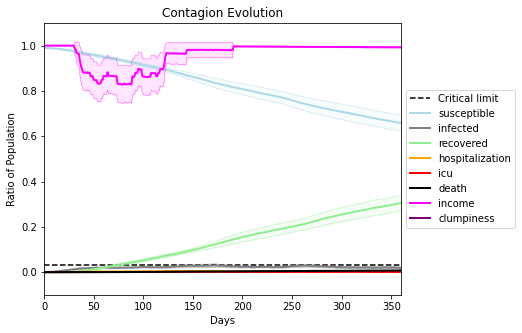

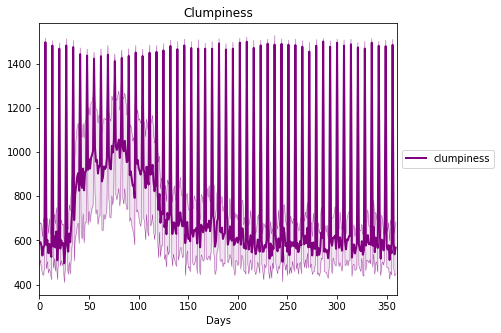

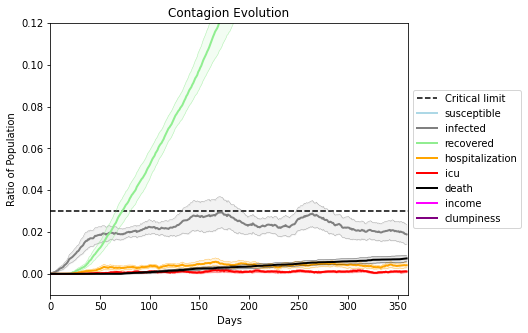

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4234, 4818, 9299, 1296, 8029, 9402, 5144, 2143, 8296, 2885, 3562, 9637, 3831, 9279, 3365, 6510, 338, 921, 2789, 6656]
Average similarity between family members is 0.9437739515783137 at temperature -0.995
Average similarity between family and home is 0.999848151557604 at temperature -1
Average similarity between students and their classroom is 0.8918000852474389 at temperature -0.995
Average classroom occupancy is 1.5771428571428572 and number classrooms is 175
Average similarity between workers is 0.8904096474840277 at temperature -0.995
Average office occupancy is 3.433673469387755 and number offices is 196
Average friend similarity for adults: 0.8509185118732918 for kids: 0.725223244662342
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5790519089398539
avg restaurant similarity 0.5669168168196785
avg restaurant similarity 0.5517693488655727
avg restaurant similarity 0.5248475584038254
avg restaurant similarity 0.5383252919859215
avg restaurant similarity 0.5355183889171129
avg restaurant similarity 0.4922652547861845
avg restaurant similarity 0.5492957996136799
avg restaurant similarity 0.5344181170440866
avg restaurant similarity 0.5507297809118583
avg restaurant similarity 0.5471043426990776
avg restaurant similarity 0.5901992793769203
avg restaurant similarity 0.5577675097944225
avg restaurant similarity 0.5408617311221153
avg restaurant similarity 0.49967731118118747
avg restaurant similarity 0.5459509603941085
avg restaurant similarity 0.5098697274243154
avg restaurant similarity 0.51927639122747
avg restaurant similarity 0.5906451215855092
avg restaurant similarity 0.577780651380219
avg restaurant similarity 0.5608181420495996
avg restaurant similarity 0.5383046198159267
avg restaura

avg restaurant similarity 0.5670180683805889
avg restaurant similarity 0.5580124147820735
avg restaurant similarity 0.638410153756977
avg restaurant similarity 0.5953344601878171
avg restaurant similarity 0.5262325825651192
avg restaurant similarity 0.5182682721172995
avg restaurant similarity 0.5494143847057511
avg restaurant similarity 0.5733191951626536
avg restaurant similarity 0.5261829453125462
avg restaurant similarity 0.5908143888722652
avg restaurant similarity 0.5853183353921032
avg restaurant similarity 0.5319944333531722
avg restaurant similarity 0.5738540901469437
avg restaurant similarity 0.5854118150306754
avg restaurant similarity 0.5847270207657931
avg restaurant similarity 0.5129350932037872
avg restaurant similarity 0.5387885308223074
avg restaurant similarity 0.5677821062373206
avg restaurant similarity 0.5875299333398204
avg restaurant similarity 0.4820727717049318
avg restaurant similarity 0.5445146949999159
avg restaurant similarity 0.5209319337735877
avg restaur

Average similarity between workers is 0.8827535955780822 at temperature -0.995
Average office occupancy is 3.3697916666666665 and number offices is 192
Average friend similarity for adults: 0.8445118395573333 for kids: 0.7307326302554809
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.5223141746242248
avg restaurant similarity 0.5610305027933679
avg restaurant similarity 0.5556919249879723
avg restaurant similarity 0.5529120968444902
avg restaurant similarity 0.5618772074755061
avg restaurant similarity 0.5709654035517512
avg restaurant similarity 0.5761091974291392
avg restaurant similarity 0.5813424602081918
avg restaurant similarity 0.5631004707463929
avg restaurant similarity 0.5809241533471803
avg restaurant similarity 0.5986963100161524
avg restaurant similarity 0.5650898611133163
avg restaurant similarity 0.6157472344662825
avg restaurant similarity 0.5457162172425307
avg restaurant similarity 0.5926961984272127
avg restaurant similarity 0.5533137066193531
avg restaurant similarity 0.5353861517104231
avg restaurant similarity 0.5220661198935149
avg restaurant similarity 0.5532341359516891
avg restaurant similarity 0.5211911699664558
avg restaurant similarity 0.5359718735747738
avg restaurant similarity 0.5433557612441589
avg restau

avg restaurant similarity 0.55915589921421
avg restaurant similarity 0.5366449639626012
avg restaurant similarity 0.5222255899738693
avg restaurant similarity 0.6057166725346173
avg restaurant similarity 0.5464043376853838
avg restaurant similarity 0.5798580114983942
avg restaurant similarity 0.5335467160417999
avg restaurant similarity 0.5534817798391578
avg restaurant similarity 0.5499499891405674
avg restaurant similarity 0.5866264604641414
avg restaurant similarity 0.5771668890824122
avg restaurant similarity 0.5741984726964617
avg restaurant similarity 0.5410468293254757
avg restaurant similarity 0.6031703476565143
avg restaurant similarity 0.6384850352483676
avg restaurant similarity 0.5489880883326398
avg restaurant similarity 0.6664610497469668
avg restaurant similarity 0.5545327435383893
avg restaurant similarity 0.5632737059695911
avg restaurant similarity 0.5517922141026842
avg restaurant similarity 0.5448094103381368
avg restaurant similarity 0.5689092886165019
avg restaura

Average similarity between workers is 0.8912108331834558 at temperature -0.995
Average office occupancy is 3.33502538071066 and number offices is 197
Average friend similarity for adults: 0.8501434518410527 for kids: 0.7241206653781385
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6181901436703582
avg restaurant similarity 0.6037385634870145
avg restaurant similarity 0.599747716803366
avg restaurant similarity 0.5731049522787502
avg restaurant similarity 0.5496904918829505
avg restaurant similarity 0.5796372155955868
avg restaurant similarity 0.5947296355319006
avg restaurant similarity 0.5809832521686389
avg restaurant similarity 0.5750961384039835
avg restaurant similarity 0.5964868239514584
avg restaurant similarity 0.5650165085712435
avg restaurant similarity 0.579634394174023
avg restaurant similarity 0.6309131934175862
avg restaurant similarity 0.5240303130808819
avg restaurant similarity 0.562936057966252
avg restaurant similarity 0.5841789856231685
avg restaurant similarity 0.5663140596097358
avg restaurant similarity 0.554705131866227
avg restaurant similarity 0.5698655523489197
avg restaurant similarity 0.5700622922881762
avg restaurant similarity 0.557989724973498
avg restaurant similarity 0.5812712442576943
avg restaurant 

avg restaurant similarity 0.549271454539774
avg restaurant similarity 0.5593616955737545
avg restaurant similarity 0.587546802218335
avg restaurant similarity 0.6229534132145513
avg restaurant similarity 0.5807328580853658
avg restaurant similarity 0.5404234274279699
avg restaurant similarity 0.5495512832779674
avg restaurant similarity 0.6135385445702455
avg restaurant similarity 0.6068848079984375
avg restaurant similarity 0.570027604020672
avg restaurant similarity 0.6518159320005104
avg restaurant similarity 0.5686427820434587
avg restaurant similarity 0.5653560050117667
avg restaurant similarity 0.562768022894932
avg restaurant similarity 0.5687646333371996
avg restaurant similarity 0.5559421519079595
avg restaurant similarity 0.6449907986419526
avg restaurant similarity 0.5906654792068708
avg restaurant similarity 0.6326857480783808
avg restaurant similarity 0.627948802006056
avg restaurant similarity 0.615681963278314
avg restaurant similarity 0.5899929713754255
avg restaurant s

Average similarity between workers is 0.9065361793469913 at temperature -0.995
Average office occupancy is 3.3025641025641024 and number offices is 195
Average friend similarity for adults: 0.8563722933308385 for kids: 0.7469690575613471
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5661362789223856
avg restaurant similarity 0.5856240961244317
avg restaurant similarity 0.6270451008704055
avg restaurant similarity 0.6021855048964005
avg restaurant similarity 0.5872496549389598
avg restaurant similarity 0.5715595637657447
avg restaurant similarity 0.5912727239359727
avg restaurant similarity 0.5359434003011226
avg restaurant similarity 0.5847347571001887
avg restaurant similarity 0.6306202256833315
avg restaurant similarity 0.5798469876990178
avg restaurant similarity 0.572343443306109
avg restaurant similarity 0.55976554953645
avg restaurant similarity 0.5908534829321834
avg restaurant similarity 0.6182516949909229
avg restaurant similarity 0.5683149336293077
avg restaurant similarity 0.5341779145636133
avg restaurant similarity 0.6656465399504523
avg restaurant similarity 0.6176623003604649
avg restaurant similarity 0.6706128558385479
avg restaurant similarity 0.49290697002710276
avg restaurant similarity 0.5796032093251994
avg restaura

avg restaurant similarity 0.6262093844978038
avg restaurant similarity 0.6073137518965778
avg restaurant similarity 0.5886968760052004
avg restaurant similarity 0.598784318501084
avg restaurant similarity 0.5899109304663678
avg restaurant similarity 0.6163183341778573
avg restaurant similarity 0.6073221699950676
avg restaurant similarity 0.5772508053188151
avg restaurant similarity 0.5860444595144788
avg restaurant similarity 0.6095426782438882
avg restaurant similarity 0.6016787257255594
avg restaurant similarity 0.6062126815863448
avg restaurant similarity 0.5926038623094103
avg restaurant similarity 0.5781785510625574
avg restaurant similarity 0.6311965877274623
avg restaurant similarity 0.6086821128372392
avg restaurant similarity 0.545297884491244
avg restaurant similarity 0.5183185170467334
avg restaurant similarity 0.575365085581581
avg restaurant similarity 0.5614269426293801
avg restaurant similarity 0.5900533308343766
avg restaurant similarity 0.5622250036471121
avg restauran

Average similarity between workers is 0.8968181718345933 at temperature -0.995
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.8455665393589508 for kids: 0.7315364030771664
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocat

avg restaurant similarity 0.5888192413492297
avg restaurant similarity 0.582451102893408
avg restaurant similarity 0.5661506822741739
avg restaurant similarity 0.5822983266495463
avg restaurant similarity 0.5804350564129355
avg restaurant similarity 0.5840802127024567
avg restaurant similarity 0.5557467949293684
avg restaurant similarity 0.6873857448172749
avg restaurant similarity 0.5716065105828276
avg restaurant similarity 0.578266388558259
avg restaurant similarity 0.5877727901987221
avg restaurant similarity 0.596389808199215
avg restaurant similarity 0.6000892291928855
avg restaurant similarity 0.520679897857416
avg restaurant similarity 0.6287895603698362
avg restaurant similarity 0.5946777692258258
avg restaurant similarity 0.5803896931866662
avg restaurant similarity 0.6003836810484887
avg restaurant similarity 0.6041677622566395
avg restaurant similarity 0.6001574503211295
avg restaurant similarity 0.5789442055150379
avg restaurant similarity 0.5754395817699647
avg restaurant

avg restaurant similarity 0.5860470211655444
avg restaurant similarity 0.6485447949086259
avg restaurant similarity 0.5848958998012164
avg restaurant similarity 0.5915888527703554
avg restaurant similarity 0.5942836408183374
avg restaurant similarity 0.5933548980595378
avg restaurant similarity 0.5945714719732302
avg restaurant similarity 0.6852986729786336
avg restaurant similarity 0.5886143545488808
avg restaurant similarity 0.5734155525171771
avg restaurant similarity 0.5614787213534971
avg restaurant similarity 0.6076921645399314
avg restaurant similarity 0.5620433127534873
avg restaurant similarity 0.6035588041745868
avg restaurant similarity 0.5964989061630651
avg restaurant similarity 0.5752179771902475
avg restaurant similarity 0.6099973354048365
avg restaurant similarity 0.5887744096423745
avg restaurant similarity 0.5875214136363037
avg restaurant similarity 0.6392317128616591
avg restaurant similarity 0.5548850886573501
avg restaurant similarity 0.5730553990793855
avg restau

Average similarity between workers is 0.8993017622786604 at temperature -0.995
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.8509467539188461 for kids: 0.7308228240079079
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total o

avg restaurant similarity 0.5550233421360685
avg restaurant similarity 0.5772443895140543
avg restaurant similarity 0.6047517299256129
avg restaurant similarity 0.5456562796922816
avg restaurant similarity 0.4923784374449164
avg restaurant similarity 0.5745322183115276
avg restaurant similarity 0.5940277370362134
avg restaurant similarity 0.6025640337709853
avg restaurant similarity 0.5964384547179978
avg restaurant similarity 0.5669842438434081
avg restaurant similarity 0.5848821841518227
avg restaurant similarity 0.5745257232577529
avg restaurant similarity 0.5418115627733635
avg restaurant similarity 0.5639198758464268
avg restaurant similarity 0.548452091221568
avg restaurant similarity 0.6090683959390996
avg restaurant similarity 0.6039843898610883
avg restaurant similarity 0.5743867214814071
avg restaurant similarity 0.6020072739168106
avg restaurant similarity 0.5658590505586163
avg restaurant similarity 0.5861624788527569
avg restaurant similarity 0.5938819133100642
avg restaur

avg restaurant similarity 0.5310397299833824
avg restaurant similarity 0.5760846632643921
avg restaurant similarity 0.560918261073263
avg restaurant similarity 0.5683366203714915
avg restaurant similarity 0.556318961923996
avg restaurant similarity 0.6039678926164437
avg restaurant similarity 0.5879978307020155
avg restaurant similarity 0.6012997267696369
avg restaurant similarity 0.6180806820264619
avg restaurant similarity 0.534093418453487
avg restaurant similarity 0.5527558056542328
avg restaurant similarity 0.5726517909208084
avg restaurant similarity 0.5796275715452184
avg restaurant similarity 0.555720577712522
avg restaurant similarity 0.5506327111593804
avg restaurant similarity 0.524109086291056
avg restaurant similarity 0.5542797948871598
avg restaurant similarity 0.5763470286899809
avg restaurant similarity 0.6172005046260072
avg restaurant similarity 0.6212823211977009
avg restaurant similarity 0.6001497830556264
avg restaurant similarity 0.5748329398549687
avg restaurant 

Average similarity between workers is 0.8950654554504553 at temperature -0.995
Average office occupancy is 3.3402061855670104 and number offices is 194
Average friend similarity for adults: 0.849726620675169 for kids: 0.7236139160857425
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 

avg restaurant similarity 0.562158835966714
avg restaurant similarity 0.5731084898756257
avg restaurant similarity 0.5787668055911585
avg restaurant similarity 0.60461745744006
avg restaurant similarity 0.6042273239299651
avg restaurant similarity 0.5648945581588587
avg restaurant similarity 0.5607304305200603
avg restaurant similarity 0.5808578903147591
avg restaurant similarity 0.6216966653855325
avg restaurant similarity 0.6233594848825703
avg restaurant similarity 0.5983292424952519
avg restaurant similarity 0.6046042970668831
avg restaurant similarity 0.5847920178340686
avg restaurant similarity 0.5907040002979876
avg restaurant similarity 0.6082569730791068
avg restaurant similarity 0.5877022647889912
avg restaurant similarity 0.6182270783404115
avg restaurant similarity 0.6025251722327688
avg restaurant similarity 0.57488157676375
avg restaurant similarity 0.5637524505048845
avg restaurant similarity 0.5180944724091945
avg restaurant similarity 0.5962096509502839
avg restaurant 

avg restaurant similarity 0.5758558580057784
avg restaurant similarity 0.5899094289118265
avg restaurant similarity 0.6004597916013371
avg restaurant similarity 0.6116333660256668
avg restaurant similarity 0.6311626590819395
avg restaurant similarity 0.591690123719955
avg restaurant similarity 0.5934947384388164
avg restaurant similarity 0.5542901938597636
avg restaurant similarity 0.5969433290998051
avg restaurant similarity 0.5829687113789644
avg restaurant similarity 0.5682533154356082
avg restaurant similarity 0.584893021970344
avg restaurant similarity 0.633860480640349
avg restaurant similarity 0.6406307362701864
avg restaurant similarity 0.59986254203769
avg restaurant similarity 0.6053694491257665
avg restaurant similarity 0.6385447802186878
avg restaurant similarity 0.5860726040803333
avg restaurant similarity 0.5741929223493041
avg restaurant similarity 0.59724726073647
avg restaurant similarity 0.633498026373913
avg restaurant similarity 0.5977140201521792
avg restaurant sim

Average similarity between workers is 0.8983036910364285 at temperature -0.995
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.8468570220554463 for kids: 0.7184460729608981
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5416837730274298
avg restaurant similarity 0.5771459216010559
avg restaurant similarity 0.5910185069230655
avg restaurant similarity 0.5559075033484672
avg restaurant similarity 0.5650768815094859
avg restaurant similarity 0.6126689599653182
avg restaurant similarity 0.5880739321207825
avg restaurant similarity 0.577137117941794
avg restaurant similarity 0.5766284122579116
avg restaurant similarity 0.5501823603518112
avg restaurant similarity 0.5727770929950862
avg restaurant similarity 0.5693366376282467
avg restaurant similarity 0.6116332033965051
avg restaurant similarity 0.5393899650743808
avg restaurant similarity 0.5977931669208959
avg restaurant similarity 0.5706164198517205
avg restaurant similarity 0.5944513111720736
avg restaurant similarity 0.5372392697942148
avg restaurant similarity 0.6006096935942953
avg restaurant similarity 0.6091942308142696
avg restaurant similarity 0.5761744726153386
avg restaurant similarity 0.575151834018506
avg restaura

avg restaurant similarity 0.5603085260978079
avg restaurant similarity 0.5414540081878989
avg restaurant similarity 0.5482103722068211
avg restaurant similarity 0.5899397235587459
avg restaurant similarity 0.5522991407918091
avg restaurant similarity 0.5784618715509112
avg restaurant similarity 0.5655369211963549
avg restaurant similarity 0.6080561313306659
avg restaurant similarity 0.49369109517579046
avg restaurant similarity 0.5972047357579197
avg restaurant similarity 0.6344602943901588
avg restaurant similarity 0.5850337949561862
avg restaurant similarity 0.5626153090814097
avg restaurant similarity 0.5898164947054096
avg restaurant similarity 0.5266162446214008
avg restaurant similarity 0.5577136440724398
avg restaurant similarity 0.565899452408052
avg restaurant similarity 0.5191965085389143
avg restaurant similarity 0.5442726516415864
avg restaurant similarity 0.487772543609903
avg restaurant similarity 0.548163353123517
avg restaurant similarity 0.5710129089814643
avg restaura

Average similarity between workers is 0.8850527233666406 at temperature -0.995
Average office occupancy is 3.407035175879397 and number offices is 199
Average friend similarity for adults: 0.8509835244281516 for kids: 0.7180130250829788
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5969724847636902
avg restaurant similarity 0.5557518427693166
avg restaurant similarity 0.5827282072596258
avg restaurant similarity 0.5965095376095189
avg restaurant similarity 0.5508934307346037
avg restaurant similarity 0.5784715374246995
avg restaurant similarity 0.5447263146388657
avg restaurant similarity 0.573811515600425
avg restaurant similarity 0.5578900286160855
avg restaurant similarity 0.5761211189043249
avg restaurant similarity 0.5328139071720606
avg restaurant similarity 0.6212008336044287
avg restaurant similarity 0.5522675314576316
avg restaurant similarity 0.6175515322769224
avg restaurant similarity 0.6113539015094955
avg restaurant similarity 0.6142335106847877
avg restaurant similarity 0.6000861121560007
avg restaurant similarity 0.6241231492789271
avg restaurant similarity 0.5947116586767831
avg restaurant similarity 0.5487891034356336
avg restaurant similarity 0.5436369671124567
avg restaurant similarity 0.6012724083300803
avg restaur

avg restaurant similarity 0.5808036207466277
avg restaurant similarity 0.5754106535731359
avg restaurant similarity 0.5833522214516879
avg restaurant similarity 0.5666245803759018
avg restaurant similarity 0.5556839125783423
avg restaurant similarity 0.6393213365016787
avg restaurant similarity 0.5769724922780285
avg restaurant similarity 0.5934244326267354
avg restaurant similarity 0.5605173532158692
avg restaurant similarity 0.5571091340054615
avg restaurant similarity 0.5369115718168588
avg restaurant similarity 0.5836316689099257
avg restaurant similarity 0.6262771398712085
avg restaurant similarity 0.6012081392927944
avg restaurant similarity 0.5846570768438303
avg restaurant similarity 0.5813429362616893
avg restaurant similarity 0.5648057407390181
avg restaurant similarity 0.5553469861774174
avg restaurant similarity 0.5791392937848948
avg restaurant similarity 0.5441386810702304
avg restaurant similarity 0.6301740166010349
avg restaurant similarity 0.5957640455505003
avg restau

Average similarity between workers is 0.8988781772785489 at temperature -0.995
Average office occupancy is 3.3979591836734695 and number offices is 196
Average friend similarity for adults: 0.8593337553631802 for kids: 0.723990770780988
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.607721970019178
avg restaurant similarity 0.5576578003021718
avg restaurant similarity 0.591561522113573
avg restaurant similarity 0.6131208454799623
avg restaurant similarity 0.5809296014691824
avg restaurant similarity 0.5519670608224929
avg restaurant similarity 0.5656691080745236
avg restaurant similarity 0.6106551623646109
avg restaurant similarity 0.5748907309333269
avg restaurant similarity 0.5462641411124984
avg restaurant similarity 0.6131447860223799
avg restaurant similarity 0.6057705865062758
avg restaurant similarity 0.6109629582236993
avg restaurant similarity 0.5660552935851384
avg restaurant similarity 0.5092387463371524
avg restaurant similarity 0.5605997471393174
avg restaurant similarity 0.5687897919501426
avg restaurant similarity 0.5528477381504224
avg restaurant similarity 0.5711907898062016
avg restaurant similarity 0.5553298790628792
avg restaurant similarity 0.584334232413168
avg restaurant similarity 0.5795782529996382
avg restauran

avg restaurant similarity 0.6023323783643761
avg restaurant similarity 0.6113442390969366
avg restaurant similarity 0.6212659202856629
avg restaurant similarity 0.5737050944876695
avg restaurant similarity 0.6222188450184188
avg restaurant similarity 0.5932958445814441
avg restaurant similarity 0.5900045144885194
avg restaurant similarity 0.5972016967530821
avg restaurant similarity 0.537320480755061
avg restaurant similarity 0.5874147577438055
avg restaurant similarity 0.556198839888593
avg restaurant similarity 0.5995655190092775
avg restaurant similarity 0.5255051237622836
avg restaurant similarity 0.575387005028495
avg restaurant similarity 0.6116680998929656
avg restaurant similarity 0.6071488836235278
avg restaurant similarity 0.6031081016732432
avg restaurant similarity 0.5435159234333851
avg restaurant similarity 0.5777388795736594
avg restaurant similarity 0.5949808131574339
avg restaurant similarity 0.5871541977289044
avg restaurant similarity 0.645941180021336
avg restaurant

Average similarity between workers is 0.8901024565608637 at temperature -0.995
Average office occupancy is 3.423469387755102 and number offices is 196
Average friend similarity for adults: 0.8471223640843142 for kids: 0.7099787003390523
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.568997596711697
avg restaurant similarity 0.5642895724642395
avg restaurant similarity 0.5470778498234642
avg restaurant similarity 0.5620195989175121
avg restaurant similarity 0.580956797072726
avg restaurant similarity 0.5476609800486196
avg restaurant similarity 0.5522533451621765
avg restaurant similarity 0.5503720796358731
avg restaurant similarity 0.5461724283654346
avg restaurant similarity 0.5644675647633345
avg restaurant similarity 0.5758757710170013
avg restaurant similarity 0.5196036278924174
avg restaurant similarity 0.5387523683074172
avg restaurant similarity 0.5629923264771002
avg restaurant similarity 0.5169059519824737
avg restaurant similarity 0.5907999297199545
avg restaurant similarity 0.6083709729782216
avg restaurant similarity 0.6143455038845044
avg restaurant similarity 0.5923128536477301
avg restaurant similarity 0.5190607026789059
avg restaurant similarity 0.5512530431719657
avg restaurant similarity 0.4901870440108863
avg restaura

avg restaurant similarity 0.5376348416797205
avg restaurant similarity 0.5248245114611615
avg restaurant similarity 0.5674037970208902
avg restaurant similarity 0.5611121410327404
avg restaurant similarity 0.4985633424629586
avg restaurant similarity 0.5483937679565516
avg restaurant similarity 0.5608192388943081
avg restaurant similarity 0.5133365402736445
avg restaurant similarity 0.5761171957027111
avg restaurant similarity 0.6012042411109393
avg restaurant similarity 0.5207155451023437
avg restaurant similarity 0.5400489595999298
avg restaurant similarity 0.5510493980453506
avg restaurant similarity 0.5311799343228493
avg restaurant similarity 0.5571317764045994
avg restaurant similarity 0.5748050783640614
avg restaurant similarity 0.5432461524014554
avg restaurant similarity 0.5873778123753308
avg restaurant similarity 0.56752101894713
avg restaurant similarity 0.5654600162767354
avg restaurant similarity 0.5651561536276416
avg restaurant similarity 0.5702974026138737
avg restaura

Average similarity between workers is 0.8821229210375694 at temperature -0.995
Average office occupancy is 3.4213197969543145 and number offices is 197
Average friend similarity for adults: 0.8507828941229418 for kids: 0.7182827961602968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5413935182183323
avg restaurant similarity 0.576306059725252
avg restaurant similarity 0.5669133884692837
avg restaurant similarity 0.5963420495072028
avg restaurant similarity 0.5667368260086979
avg restaurant similarity 0.5692177503970081
avg restaurant similarity 0.5772237807217543
avg restaurant similarity 0.5105290518569057
avg restaurant similarity 0.6030502515273012
avg restaurant similarity 0.574518433457058
avg restaurant similarity 0.5947227626995298
avg restaurant similarity 0.6021990144876597
avg restaurant similarity 0.6074184635932296
avg restaurant similarity 0.5479461439317658
avg restaurant similarity 0.5666663218036903
avg restaurant similarity 0.576335522418039
avg restaurant similarity 0.6033786919016704
avg restaurant similarity 0.5616725253930066
avg restaurant similarity 0.606780991721926
avg restaurant similarity 0.5776258360054906
avg restaurant similarity 0.5858110393596779
avg restaurant similarity 0.5353135856241007
avg restaurant

avg restaurant similarity 0.5922239143875261
avg restaurant similarity 0.5997772908055741
avg restaurant similarity 0.5083277506070752
avg restaurant similarity 0.5748408217692549
avg restaurant similarity 0.5589792739119619
avg restaurant similarity 0.5594120525567692
avg restaurant similarity 0.5590813451929838
avg restaurant similarity 0.5379026569468265
avg restaurant similarity 0.5322357597622526
avg restaurant similarity 0.5513126477040484
avg restaurant similarity 0.5805200970322426
avg restaurant similarity 0.5435674794086622
avg restaurant similarity 0.5543690137060586
avg restaurant similarity 0.5479647447714431
avg restaurant similarity 0.5702912594464773
avg restaurant similarity 0.564543592927272
avg restaurant similarity 0.5917168609366756
avg restaurant similarity 0.5534650021258136
avg restaurant similarity 0.5135426639553653
avg restaurant similarity 0.6069441423592054
avg restaurant similarity 0.5984440146708737
avg restaurant similarity 0.5665998144883088
avg restaur

Average similarity between workers is 0.8968869805987082 at temperature -0.995
Average office occupancy is 3.371859296482412 and number offices is 199
Average friend similarity for adults: 0.8498185108794646 for kids: 0.7170293170184439
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.633415834249244
avg restaurant similarity 0.5617420263961421
avg restaurant similarity 0.585297661728272
avg restaurant similarity 0.5649611271140909
avg restaurant similarity 0.6254307934114675
avg restaurant similarity 0.5204082025431749
avg restaurant similarity 0.5587690899484202
avg restaurant similarity 0.5871935158800039
avg restaurant similarity 0.5500015943199464
avg restaurant similarity 0.6309903501859822
avg restaurant similarity 0.5384376921442355
avg restaurant similarity 0.5750581025951613
avg restaurant similarity 0.616206060842157
avg restaurant similarity 0.5732706466642955
avg restaurant similarity 0.5898948183105491
avg restaurant similarity 0.6512842113074327
avg restaurant similarity 0.6137422397150545
avg restaurant similarity 0.5757224122915028
avg restaurant similarity 0.5716445678271067
avg restaurant similarity 0.5690343428619417
avg restaurant similarity 0.6586156586656006
avg restaurant similarity 0.5638467347134472
avg restauran

avg restaurant similarity 0.6292001137743359
avg restaurant similarity 0.667045466756146
avg restaurant similarity 0.583784806792577
avg restaurant similarity 0.5718258650704388
avg restaurant similarity 0.571349057861098
avg restaurant similarity 0.5515154545739356
avg restaurant similarity 0.6169966110615296
avg restaurant similarity 0.5627711789766517
avg restaurant similarity 0.5770257312566922
avg restaurant similarity 0.6042977059144549
avg restaurant similarity 0.5791470067925973
avg restaurant similarity 0.5709366980597717
avg restaurant similarity 0.5861030102071424
avg restaurant similarity 0.6115397067635372
avg restaurant similarity 0.5784359735534316
avg restaurant similarity 0.5833651696089512
avg restaurant similarity 0.6337061977607602
avg restaurant similarity 0.6056338068813061
avg restaurant similarity 0.571750171043686
avg restaurant similarity 0.593280403589995
avg restaurant similarity 0.5631704156203989
avg restaurant similarity 0.5946001067840618
avg restaurant 

Average similarity between workers is 0.9054898394830349 at temperature -0.995
Average office occupancy is 3.6084656084656084 and number offices is 189
Average friend similarity for adults: 0.8572786830010899 for kids: 0.7325700536569884
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5287267382147111
avg restaurant similarity 0.5703510475441896
avg restaurant similarity 0.5666473779266407
avg restaurant similarity 0.6123866229217994
avg restaurant similarity 0.5691180264070678
avg restaurant similarity 0.5281152677670473
avg restaurant similarity 0.5628450890911288
avg restaurant similarity 0.5886446444914925
avg restaurant similarity 0.5281617488474561
avg restaurant similarity 0.5490696098115039
avg restaurant similarity 0.5794794657282193
avg restaurant similarity 0.56109484810371
avg restaurant similarity 0.589277215239624
avg restaurant similarity 0.5914141691919428
avg restaurant similarity 0.5912815809468409
avg restaurant similarity 0.5683046988148572
avg restaurant similarity 0.5355088228192556
avg restaurant similarity 0.5403132096404907
avg restaurant similarity 0.632848901871285
avg restaurant similarity 0.5934794963196948
avg restaurant similarity 0.5969605975341246
avg restaurant similarity 0.5621828415630937
avg restaurant

avg restaurant similarity 0.5697099698514325
avg restaurant similarity 0.5433031055105418
avg restaurant similarity 0.5765287397792805
avg restaurant similarity 0.6021443058740182
avg restaurant similarity 0.5548292652348724
avg restaurant similarity 0.5914928314306152
avg restaurant similarity 0.5979003932666163
avg restaurant similarity 0.5860212457134264
avg restaurant similarity 0.5722861360054424
avg restaurant similarity 0.5950854762436971
avg restaurant similarity 0.5680262414359613
avg restaurant similarity 0.6045162166212287
avg restaurant similarity 0.5702075548746373
avg restaurant similarity 0.5902362824429565
avg restaurant similarity 0.5906365635910017
avg restaurant similarity 0.6193505711923927
avg restaurant similarity 0.5860564024283876
avg restaurant similarity 0.5528929065925612
avg restaurant similarity 0.617471706289524
avg restaurant similarity 0.5872738725240443
avg restaurant similarity 0.6318966316762735
avg restaurant similarity 0.6007019243967857
avg restaur

Average similarity between workers is 0.8951778352354075 at temperature -0.995
Average office occupancy is 3.4619289340101522 and number offices is 197
Average friend similarity for adults: 0.8557233922260918 for kids: 0.7396337186184274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.5632285982796167
avg restaurant similarity 0.6218524231247333
avg restaurant similarity 0.6734602657820722
avg restaurant similarity 0.5695452899871198
avg restaurant similarity 0.5858006994107414
avg restaurant similarity 0.5467570284824158
avg restaurant similarity 0.5752488014832412
avg restaurant similarity 0.6075753846271608
avg restaurant similarity 0.5804796148523292
avg restaurant similarity 0.6067014199534735
avg restaurant similarity 0.584785021484515
avg restaurant similarity 0.6707841209413297
avg restaurant similarity 0.5836075663312807
avg restaurant similarity 0.5990966125448611
avg restaurant similarity 0.6024718905419129
avg restaurant similarity 0.6207989971374464
avg restaurant similarity 0.6083864487320882
avg restaurant similarity 0.5466064373232556
avg restaurant similarity 0.5615576774506
avg restaurant similarity 0.5905913183200339
avg restaurant similarity 0.5927596683196599
avg restaurant similarity 0.5811305311651969
avg restaurant

avg restaurant similarity 0.6281451678389347
avg restaurant similarity 0.6184512809480365
avg restaurant similarity 0.5973479568478081
avg restaurant similarity 0.6098169721721993
avg restaurant similarity 0.6413851815398812
avg restaurant similarity 0.6215546343906773
avg restaurant similarity 0.5970119761738263
avg restaurant similarity 0.5792305854864592
avg restaurant similarity 0.6003168427324673
avg restaurant similarity 0.6110945023169774
avg restaurant similarity 0.6414489381410925
avg restaurant similarity 0.6432682403543707
avg restaurant similarity 0.6110033923492936
avg restaurant similarity 0.6153182005013967
avg restaurant similarity 0.5984031835923475
avg restaurant similarity 0.572837679848841
avg restaurant similarity 0.6474346812729329
avg restaurant similarity 0.6084852641109962
avg restaurant similarity 0.6231894048337537
avg restaurant similarity 0.5820970515614967
avg restaurant similarity 0.6161377003787181
avg restaurant similarity 0.5996477695304324
avg restaur

Average similarity between workers is 0.8895508741628952 at temperature -0.995
Average office occupancy is 3.387434554973822 and number offices is 191
Average friend similarity for adults: 0.8509291217868044 for kids: 0.7392612393483041
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5826577911927722
avg restaurant similarity 0.5431161425711624
avg restaurant similarity 0.5920457342396755
avg restaurant similarity 0.594342127558258
avg restaurant similarity 0.604871914529227
avg restaurant similarity 0.6136764135823081
avg restaurant similarity 0.5641611355443951
avg restaurant similarity 0.6059956976752918
avg restaurant similarity 0.5820088423372628
avg restaurant similarity 0.5268084891355588
avg restaurant similarity 0.6000748355819489
avg restaurant similarity 0.627823257667226
avg restaurant similarity 0.6031329158785045
avg restaurant similarity 0.5986581825632593
avg restaurant similarity 0.5512576606186111
avg restaurant similarity 0.5595262152271653
avg restaurant similarity 0.5742683459319398
avg restaurant similarity 0.5417756803878313
avg restaurant similarity 0.5413455969520846
avg restaurant similarity 0.5633740843851857
avg restaurant similarity 0.5801621594004338
avg restaurant similarity 0.5757105622159153
avg restauran

avg restaurant similarity 0.6072887466651264
avg restaurant similarity 0.5500976859261604
avg restaurant similarity 0.584054235574229
avg restaurant similarity 0.6064907170276379
avg restaurant similarity 0.5959147724522441
avg restaurant similarity 0.549053023149706
avg restaurant similarity 0.5629185758987961
avg restaurant similarity 0.5521543706055928
avg restaurant similarity 0.5688186564268853
avg restaurant similarity 0.5543937736791197
avg restaurant similarity 0.5880862082110823
avg restaurant similarity 0.5782518320489721
avg restaurant similarity 0.5561058784522419
avg restaurant similarity 0.6037020705698575
avg restaurant similarity 0.5801308915281856
avg restaurant similarity 0.5546398638205372
avg restaurant similarity 0.537977046004202
avg restaurant similarity 0.5563762003062191
avg restaurant similarity 0.5797506153514888
avg restaurant similarity 0.5482689198546477
avg restaurant similarity 0.5400737130230627
avg restaurant similarity 0.5357875370433097
avg restauran

Average similarity between workers is 0.8961304919888646 at temperature -0.995
Average office occupancy is 3.392857142857143 and number offices is 196
Average friend similarity for adults: 0.8510350268064968 for kids: 0.7211966524263598
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5227793915388002
avg restaurant similarity 0.580253978097619
avg restaurant similarity 0.5604904980796579
avg restaurant similarity 0.5640074843842479
avg restaurant similarity 0.5874755306409418
avg restaurant similarity 0.5902100134593862
avg restaurant similarity 0.5892279660943082
avg restaurant similarity 0.6442050762368157
avg restaurant similarity 0.5625392504398506
avg restaurant similarity 0.5183947562273638
avg restaurant similarity 0.5629243527967742
avg restaurant similarity 0.5592505974080892
avg restaurant similarity 0.5775050053343438
avg restaurant similarity 0.5212368729146484
avg restaurant similarity 0.5783510518849438
avg restaurant similarity 0.5688856862735643
avg restaurant similarity 0.5848171256979049
avg restaurant similarity 0.5199702175946592
avg restaurant similarity 0.6116770104868943
avg restaurant similarity 0.5830144470498859
avg restaurant similarity 0.5588680135483667
avg restaurant similarity 0.5467262950209811
avg restaur

avg restaurant similarity 0.587484871653171
avg restaurant similarity 0.5659405455374193
avg restaurant similarity 0.6022177197368056
avg restaurant similarity 0.5428884226018296
avg restaurant similarity 0.5844323530280546
avg restaurant similarity 0.5145878475356818
avg restaurant similarity 0.5763061661455081
avg restaurant similarity 0.595712441689543
avg restaurant similarity 0.5668904325513783
avg restaurant similarity 0.5630076420436773
avg restaurant similarity 0.5966806206644653
avg restaurant similarity 0.5852576675943614
avg restaurant similarity 0.5339097373061591
avg restaurant similarity 0.5390825159236103
avg restaurant similarity 0.5230915383838307
avg restaurant similarity 0.6280436251016321
avg restaurant similarity 0.5677440798226671
avg restaurant similarity 0.583004186961754
avg restaurant similarity 0.5501023455920707
avg restaurant similarity 0.5808299047273953
avg restaurant similarity 0.5470166715364511
avg restaurant similarity 0.5650770959107022
avg restauran

Average similarity between workers is 0.8959158254826344 at temperature -0.995
Average office occupancy is 3.372448979591837 and number offices is 196
Average friend similarity for adults: 0.8528639050224273 for kids: 0.7362545730459983
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.586301702664912
avg restaurant similarity 0.5870925538871418
avg restaurant similarity 0.6215800420252708
avg restaurant similarity 0.6265106037653877
avg restaurant similarity 0.5881351905413847
avg restaurant similarity 0.619952808306353
avg restaurant similarity 0.5717991716389934
avg restaurant similarity 0.6259611806092089
avg restaurant similarity 0.6269916728584081
avg restaurant similarity 0.6183348128054247
avg restaurant similarity 0.6364828063994683
avg restaurant similarity 0.629893928544908
avg restaurant similarity 0.5884017515821759
avg restaurant similarity 0.6350441897506894
avg restaurant similarity 0.6163907342096663
avg restaurant similarity 0.6477758036643604
avg restaurant similarity 0.6404669151595891
avg restaurant similarity 0.6014333649077752
avg restaurant similarity 0.5994301969275553
avg restaurant similarity 0.5979099281600817
avg restaurant similarity 0.6463318288287003
avg restaurant similarity 0.5669009050543552
avg restauran

avg restaurant similarity 0.5821965885775685
avg restaurant similarity 0.6023994847991443
avg restaurant similarity 0.59314328036368
avg restaurant similarity 0.5983359138749883
avg restaurant similarity 0.6264276410655841
avg restaurant similarity 0.5986070580629657
avg restaurant similarity 0.6092107267750154
avg restaurant similarity 0.5982819606918118
avg restaurant similarity 0.5453110035142511
avg restaurant similarity 0.6193552881976288
avg restaurant similarity 0.5715284823820336
avg restaurant similarity 0.5935452551899832
avg restaurant similarity 0.5717142802094558
avg restaurant similarity 0.6054958711352494
avg restaurant similarity 0.5635902477196264
avg restaurant similarity 0.6071673181982495
avg restaurant similarity 0.570564221484315
avg restaurant similarity 0.5711979200630468
avg restaurant similarity 0.5552162947828867
avg restaurant similarity 0.6201957143120299
avg restaurant similarity 0.5865522587212607
avg restaurant similarity 0.6255559158841368
avg restauran

Average similarity between workers is 0.9014999821646223 at temperature -0.995
Average office occupancy is 3.2731958762886597 and number offices is 194
Average friend similarity for adults: 0.8492543308775709 for kids: 0.7542469722048234
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5216575795749201
avg restaurant similarity 0.5193907938855569
avg restaurant similarity 0.5940847419797783
avg restaurant similarity 0.5534162426144763
avg restaurant similarity 0.5552139270471249
avg restaurant similarity 0.5554797160646691
avg restaurant similarity 0.5882587622478268
avg restaurant similarity 0.5606413002189979
avg restaurant similarity 0.5573834140770065
avg restaurant similarity 0.6082632393405972
avg restaurant similarity 0.5460571020339214
avg restaurant similarity 0.5792518561003571
avg restaurant similarity 0.5988278612256378
avg restaurant similarity 0.506850542100985
avg restaurant similarity 0.6150114451871105
avg restaurant similarity 0.5482323759618756
avg restaurant similarity 0.5578251852576495
avg restaurant similarity 0.5841422002825293
avg restaurant similarity 0.5640068937139538
avg restaurant similarity 0.5761454625122143
avg restaurant similarity 0.5331947929157749
avg restaurant similarity 0.5643576421311723
avg restaur

avg restaurant similarity 0.5268459713843667
avg restaurant similarity 0.5999710866939053
avg restaurant similarity 0.5442598953168363
avg restaurant similarity 0.5614981478483243
avg restaurant similarity 0.5911438724633068
avg restaurant similarity 0.6290633944128049
avg restaurant similarity 0.5888941692182905
avg restaurant similarity 0.5898625402830673
avg restaurant similarity 0.557953686058105
avg restaurant similarity 0.5896620682964665
avg restaurant similarity 0.5717932193599055
avg restaurant similarity 0.6170279411185229
avg restaurant similarity 0.535279365017908
avg restaurant similarity 0.5889315390153338
avg restaurant similarity 0.5542753375858173
avg restaurant similarity 0.5412657989712641
avg restaurant similarity 0.5619945961168774
avg restaurant similarity 0.570261356951506
avg restaurant similarity 0.5565476621944387
avg restaurant similarity 0.5671688198888117
avg restaurant similarity 0.6096451464308256
avg restaurant similarity 0.5715642705991033
avg restauran

Average similarity between workers is 0.8922363414475124 at temperature -0.995
Average office occupancy is 3.468421052631579 and number offices is 190
Average friend similarity for adults: 0.8500190294620537 for kids: 0.7182915017670015
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.5837352052271472
avg restaurant similarity 0.5600593353342077
avg restaurant similarity 0.6044374825259561
avg restaurant similarity 0.573302964697687
avg restaurant similarity 0.58838941401564
avg restaurant similarity 0.5997909936617601
avg restaurant similarity 0.6384504620887065
avg restaurant similarity 0.5366510579501614
avg restaurant similarity 0.6635972528367777
avg restaurant similarity 0.6114372530532498
avg restaurant similarity 0.6044642248660671
avg restaurant similarity 0.5827045926198358
avg restaurant similarity 0.6165280362280523
avg restaurant similarity 0.576888614223686
avg restaurant similarity 0.5723085511886211
avg restaurant similarity 0.5999858817313988
avg restaurant similarity 0.5899575932911193
avg restaurant similarity 0.5997000842784834
avg restaurant similarity 0.5596659487021387
avg restaurant similarity 0.621445202726952
avg restaurant similarity 0.643670787418949
avg restaurant similarity 0.632389812137706
avg restaurant si

avg restaurant similarity 0.6090467373353571
avg restaurant similarity 0.5833072557435826
avg restaurant similarity 0.5880899274176974
avg restaurant similarity 0.5186113396734506
avg restaurant similarity 0.6050292167091392
avg restaurant similarity 0.5231519641630424
avg restaurant similarity 0.5856916706343684
avg restaurant similarity 0.6093688864242185
avg restaurant similarity 0.5531721228311285
avg restaurant similarity 0.5731702378958078
avg restaurant similarity 0.6126474808783724
avg restaurant similarity 0.6063040191273936
avg restaurant similarity 0.5379062035934118
avg restaurant similarity 0.5390075496069257
avg restaurant similarity 0.5650169761593615
avg restaurant similarity 0.5691084937056723
avg restaurant similarity 0.5650227412024165
avg restaurant similarity 0.5378390170778047
avg restaurant similarity 0.5484361629868818
avg restaurant similarity 0.6012162868128589
avg restaurant similarity 0.5652098320989077
avg restaurant similarity 0.6018519537263861
avg restau

(<function dict.items>, <function dict.items>, <function dict.items>)

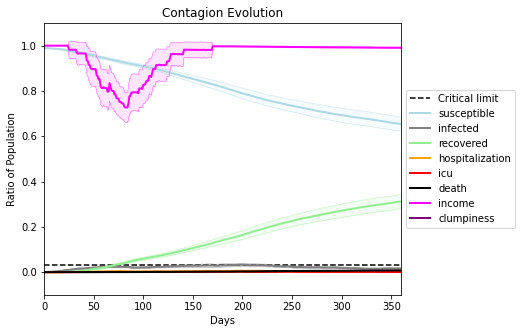

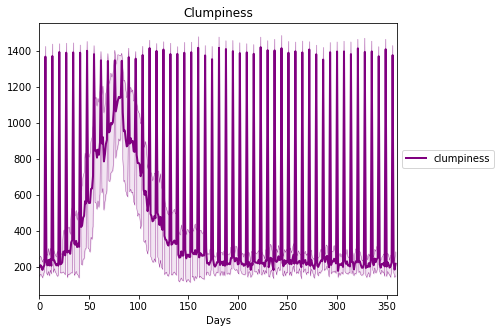

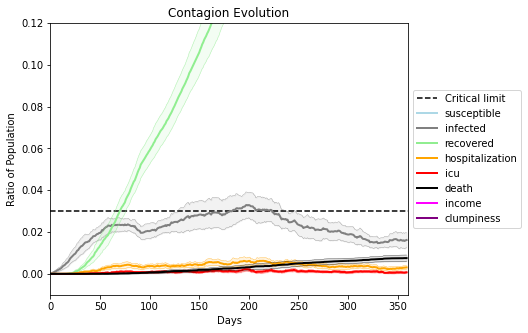

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5739, 4287, 8614, 4061, 5416, 9658, 5292, 6613, 546, 5301, 1955, 5211, 8850, 4532, 4248, 6020, 4848, 9776, 348, 9860]
Average similarity between family members is 0.9326511757763303 at temperature -0.994
Average similarity between family and home is 0.999851683339802 at temperature -1
Average similarity between students and their classroom is 0.8807928572496075 at temperature -0.994
Average classroom occupancy is 1.6666666666666667 and number classrooms is 174
Average similarity between workers is 0.8910997600566496 at temperature -0.994
Average office occupancy is 3.3045685279187818 and number offices is 197
Average friend similarity for adults: 0.8516857355325445 for kids: 0.7375558386655715
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.5730153810054168
avg restaurant similarity 0.5947985901423776
avg restaurant similarity 0.5239948283432672
avg restaurant similarity 0.5824687354893192
avg restaurant similarity 0.6158180203278268
avg restaurant similarity 0.5235075157635555
avg restaurant similarity 0.5649607248486396
avg restaurant similarity 0.5442632857034421
avg restaurant similarity 0.526853340139837
avg restaurant similarity 0.5891116518719606
avg restaurant similarity 0.6093620184744112
avg restaurant similarity 0.572534095474579
avg restaurant similarity 0.5457006935932415
avg restaurant similarity 0.5626647784652303
avg restaurant similarity 0.6148438637491009
avg restaurant similarity 0.5355977360050176
avg restaurant similarity 0.5497410037162597
avg restaurant similarity 0.5477021375137234
avg restaurant similarity 0.5618472114736898
avg restaurant similarity 0.6294967655820544
avg restaurant similarity 0.5633667461783757
avg restaurant similarity 0.5684177760648581
avg restaura

avg restaurant similarity 0.5631115068002096
avg restaurant similarity 0.6466177397944005
avg restaurant similarity 0.5604841288469238
avg restaurant similarity 0.6215720270677281
avg restaurant similarity 0.5972836283814162
avg restaurant similarity 0.6491573266671182
avg restaurant similarity 0.556073667149317
avg restaurant similarity 0.5471092422566886
avg restaurant similarity 0.5740352241095438
avg restaurant similarity 0.5965993074712636
avg restaurant similarity 0.553759460884032
avg restaurant similarity 0.5695198889992085
avg restaurant similarity 0.5532944874057899
avg restaurant similarity 0.596689944660151
avg restaurant similarity 0.5821658861282906
avg restaurant similarity 0.6032464268897021
avg restaurant similarity 0.5775186780554693
avg restaurant similarity 0.548787806417521
avg restaurant similarity 0.5453886845096116
avg restaurant similarity 0.5944709393477074
avg restaurant similarity 0.5932542663366163
avg restaurant similarity 0.5868714261326876
avg restaurant

Average similarity between workers is 0.8981729591766385 at temperature -0.994
Average office occupancy is 3.336683417085427 and number offices is 199
Average friend similarity for adults: 0.854438817271888 for kids: 0.7116528963693316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5963310502630681
avg restaurant similarity 0.5861833335878395
avg restaurant similarity 0.5939926700308906
avg restaurant similarity 0.5531665547890321
avg restaurant similarity 0.5852848689974953
avg restaurant similarity 0.5816529261017614
avg restaurant similarity 0.5314481098999975
avg restaurant similarity 0.5559489618791141
avg restaurant similarity 0.6079652544212082
avg restaurant similarity 0.6151713362781467
avg restaurant similarity 0.558319337505582
avg restaurant similarity 0.5656495876409341
avg restaurant similarity 0.6190395004802889
avg restaurant similarity 0.5646094034677701
avg restaurant similarity 0.5929228726084139
avg restaurant similarity 0.5533805347875946
avg restaurant similarity 0.6309547771889448
avg restaurant similarity 0.6016049710340936
avg restaurant similarity 0.6159346219163631
avg restaurant similarity 0.5747505383501503
avg restaurant similarity 0.6032802309974736
avg restaurant similarity 0.6134791262561656
avg restaur

avg restaurant similarity 0.6626850412899454
avg restaurant similarity 0.6157610978168547
avg restaurant similarity 0.5585490741718696
avg restaurant similarity 0.5771193726084638
avg restaurant similarity 0.6052645813210272
avg restaurant similarity 0.6079722009153731
avg restaurant similarity 0.5405673596522719
avg restaurant similarity 0.5594610523020247
avg restaurant similarity 0.6054791397204343
avg restaurant similarity 0.5638938447048557
avg restaurant similarity 0.645169391480172
avg restaurant similarity 0.580388906351615
avg restaurant similarity 0.539474500384546
avg restaurant similarity 0.5742273217114796
avg restaurant similarity 0.5713486278872498
avg restaurant similarity 0.6008730528652179
avg restaurant similarity 0.6285885465753491
avg restaurant similarity 0.5956998288689568
avg restaurant similarity 0.6249870031910845
avg restaurant similarity 0.5758079221427209
avg restaurant similarity 0.573434268554397
avg restaurant similarity 0.598478443338294
avg restaurant 

Average similarity between workers is 0.8819672719881707 at temperature -0.994
Average office occupancy is 3.4183673469387754 and number offices is 196
Average friend similarity for adults: 0.8534848753549511 for kids: 0.7265381298921043
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5924139021186866
avg restaurant similarity 0.6312203963401736
avg restaurant similarity 0.6157406497790416
avg restaurant similarity 0.5711970550493759
avg restaurant similarity 0.5392615866418771
avg restaurant similarity 0.602009439336807
avg restaurant similarity 0.6343185152083632
avg restaurant similarity 0.6229483394715195
avg restaurant similarity 0.6020435008498702
avg restaurant similarity 0.6095993793719956
avg restaurant similarity 0.5997782405138902
avg restaurant similarity 0.601293867787889
avg restaurant similarity 0.5926798537623107
avg restaurant similarity 0.5110789921784012
avg restaurant similarity 0.6413776684665708
avg restaurant similarity 0.5989570500440841
avg restaurant similarity 0.6021327270272079
avg restaurant similarity 0.5863319455148868
avg restaurant similarity 0.5611294930063763
avg restaurant similarity 0.5751605528710018
avg restaurant similarity 0.5703916789399898
avg restaurant similarity 0.5615931918113803
avg restaura

avg restaurant similarity 0.6379237851847595
avg restaurant similarity 0.6104634763258474
avg restaurant similarity 0.5834943543540827
avg restaurant similarity 0.6666581893115084
avg restaurant similarity 0.5741298288892923
avg restaurant similarity 0.6203823914569012
avg restaurant similarity 0.6243883930020093
avg restaurant similarity 0.5918650865020423
avg restaurant similarity 0.5977582939013438
avg restaurant similarity 0.5991201342012251
avg restaurant similarity 0.6251160688766442
avg restaurant similarity 0.5996040538348898
avg restaurant similarity 0.6161600971824176
avg restaurant similarity 0.6189283316231289
avg restaurant similarity 0.5854979471627055
avg restaurant similarity 0.6036146063618191
avg restaurant similarity 0.6083834144150035
avg restaurant similarity 0.6208411235212332
avg restaurant similarity 0.5875388202379662
avg restaurant similarity 0.5558460520341961
avg restaurant similarity 0.6056402159042046
avg restaurant similarity 0.5478030539464978
avg restau

Average similarity between workers is 0.8782247716518766 at temperature -0.994
Average office occupancy is 3.33160621761658 and number offices is 193
Average friend similarity for adults: 0.8435225434851569 for kids: 0.7364286396123728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.5895648335739325
avg restaurant similarity 0.5480746923694066
avg restaurant similarity 0.5816243750076245
avg restaurant similarity 0.5349164623260925
avg restaurant similarity 0.5863171639426643
avg restaurant similarity 0.6111615034550335
avg restaurant similarity 0.6056858639933752
avg restaurant similarity 0.5942267674584882
avg restaurant similarity 0.58358421691005
avg restaurant similarity 0.5653712903783445
avg restaurant similarity 0.5941236871937281
avg restaurant similarity 0.6209028308246586
avg restaurant similarity 0.6269836825822975
avg restaurant similarity 0.5443018868284627
avg restaurant similarity 0.6245711299495378
avg restaurant similarity 0.6158039521843389
avg restaurant similarity 0.5714046143910703
avg restaurant similarity 0.5978736542878476
avg restaurant similarity 0.5931051370635501
avg restaurant similarity 0.5892506390331017
avg restaurant similarity 0.5466843398863622
avg restaurant similarity 0.5845887486136425
avg restaura

avg restaurant similarity 0.5943843247935844
avg restaurant similarity 0.542758600418595
avg restaurant similarity 0.573901975383381
avg restaurant similarity 0.5889048501800987
avg restaurant similarity 0.5752535144693245
avg restaurant similarity 0.5844979013912597
avg restaurant similarity 0.5783131711952695
avg restaurant similarity 0.5690590405999941
avg restaurant similarity 0.5858119503901946
avg restaurant similarity 0.5731260644376798
avg restaurant similarity 0.6088776241402285
avg restaurant similarity 0.5954648481076612
avg restaurant similarity 0.6428058802685767
avg restaurant similarity 0.5618511576569886
avg restaurant similarity 0.641961689586782
avg restaurant similarity 0.5528958296284212
avg restaurant similarity 0.5760569459321615
avg restaurant similarity 0.5832929862442535
avg restaurant similarity 0.5811064076729393
avg restaurant similarity 0.5915680515497606
avg restaurant similarity 0.5882859836443229
avg restaurant similarity 0.5811388885508604
avg restauran

Average similarity between workers is 0.8776048516925127 at temperature -0.994
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8536887484507326 for kids: 0.7184996743772898
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.5859758684988374
avg restaurant similarity 0.5672423147253447
avg restaurant similarity 0.5453514653947419
avg restaurant similarity 0.5917680911875934
avg restaurant similarity 0.5754050397286458
avg restaurant similarity 0.5809131938177764
avg restaurant similarity 0.5864801960718797
avg restaurant similarity 0.5859506220595933
avg restaurant similarity 0.5910299008180447
avg restaurant similarity 0.5887495881069295
avg restaurant similarity 0.5930661657648262
avg restaurant similarity 0.6383204325981969
avg restaurant similarity 0.5611844817946886
avg restaurant similarity 0.5786154176678809
avg restaurant similarity 0.5991021730963589
avg restaurant similarity 0.5289028368532072
avg restaurant similarity 0.5882729306731725
avg restaurant similarity 0.58585208718089
avg restaurant similarity 0.604900689267624
avg restaurant similarity 0.5889429373202207
avg restaurant similarity 0.575425381594543
avg restaurant similarity 0.6136844228487341
avg restaurant

avg restaurant similarity 0.5353446094842995
avg restaurant similarity 0.5999106082288234
avg restaurant similarity 0.5467445704377158
avg restaurant similarity 0.6040485386994286
avg restaurant similarity 0.5590919459650776
avg restaurant similarity 0.6368550667601921
avg restaurant similarity 0.5822726343302473
avg restaurant similarity 0.6046160368869102
avg restaurant similarity 0.601222296247186
avg restaurant similarity 0.6087097407321996
avg restaurant similarity 0.5518913449643633
avg restaurant similarity 0.6037622169238513
avg restaurant similarity 0.6147694778743819
avg restaurant similarity 0.6049719067474911
avg restaurant similarity 0.6073738954696295
avg restaurant similarity 0.5916860668609742
avg restaurant similarity 0.5635895166963626
avg restaurant similarity 0.6043164706622082
avg restaurant similarity 0.604857812674527
avg restaurant similarity 0.5695552155337248
avg restaurant similarity 0.5848236812048307
avg restaurant similarity 0.5850535822058814
avg restaura

Average similarity between workers is 0.8714442093049405 at temperature -0.994
Average office occupancy is 3.4153846153846152 and number offices is 195
Average friend similarity for adults: 0.8394324522960984 for kids: 0.7197371393628803
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5365601214325487
avg restaurant similarity 0.5819451606828541
avg restaurant similarity 0.5110314169642021
avg restaurant similarity 0.482718196849037
avg restaurant similarity 0.5350695373157108
avg restaurant similarity 0.5623240572129137
avg restaurant similarity 0.5070555996158903
avg restaurant similarity 0.5415489921211128
avg restaurant similarity 0.5374326193340779
avg restaurant similarity 0.5481272438142469
avg restaurant similarity 0.5532258404177942
avg restaurant similarity 0.5088676370203374
avg restaurant similarity 0.5186364796154614
avg restaurant similarity 0.5453469930360852
avg restaurant similarity 0.5778340625566482
avg restaurant similarity 0.5098862864680764
avg restaurant similarity 0.5161347475970998
avg restaurant similarity 0.5198365891318492
avg restaurant similarity 0.5742358963720361
avg restaurant similarity 0.5450356311022555
avg restaurant similarity 0.5201097158656738
avg restaurant similarity 0.5529208658531527
avg restaur

avg restaurant similarity 0.5420780914459348
avg restaurant similarity 0.5396513913389095
avg restaurant similarity 0.5917962802454878
avg restaurant similarity 0.5564492490432553
avg restaurant similarity 0.5592543844306246
avg restaurant similarity 0.5442471594192095
avg restaurant similarity 0.559279352273109
avg restaurant similarity 0.5459001137874613
avg restaurant similarity 0.5816515948018902
avg restaurant similarity 0.5586451801551024
avg restaurant similarity 0.5470418798328569
avg restaurant similarity 0.5514433041308706
avg restaurant similarity 0.5191873826100112
avg restaurant similarity 0.544284739696416
avg restaurant similarity 0.5609326272386536
avg restaurant similarity 0.5796562549023296
avg restaurant similarity 0.5307735193724425
avg restaurant similarity 0.5376017664966459
avg restaurant similarity 0.5654278350353209
avg restaurant similarity 0.5935190530369003
avg restaurant similarity 0.5465273581919317
avg restaurant similarity 0.5465913669325215
avg restaura

Average similarity between workers is 0.885990138330716 at temperature -0.994
Average office occupancy is 3.385 and number offices is 200
Average friend similarity for adults: 0.8518911865646484 for kids: 0.7339819310445584
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocate

avg restaurant similarity 0.5941914111617044
avg restaurant similarity 0.5563911784379808
avg restaurant similarity 0.6177044430833253
avg restaurant similarity 0.541642326315847
avg restaurant similarity 0.560848922608178
avg restaurant similarity 0.5988358460418873
avg restaurant similarity 0.6119938556451991
avg restaurant similarity 0.5717036169948004
avg restaurant similarity 0.6008512560155742
avg restaurant similarity 0.638056326245485
avg restaurant similarity 0.6016597568222951
avg restaurant similarity 0.5737967971729689
avg restaurant similarity 0.5749316643688059
avg restaurant similarity 0.586709133847249
avg restaurant similarity 0.5580518978479946
avg restaurant similarity 0.6246032120104418
avg restaurant similarity 0.5834235628206649
avg restaurant similarity 0.5810964514659259
avg restaurant similarity 0.6095256207769676
avg restaurant similarity 0.6129282093083585
avg restaurant similarity 0.5973426802816032
avg restaurant similarity 0.5694524415446208
avg restaurant

avg restaurant similarity 0.5530177661445135
avg restaurant similarity 0.5612341541115354
avg restaurant similarity 0.53165358308427
avg restaurant similarity 0.5838714698921124
avg restaurant similarity 0.5393987379335705
avg restaurant similarity 0.5940488096903952
avg restaurant similarity 0.6129430324118791
avg restaurant similarity 0.5773221863577873
avg restaurant similarity 0.5931064863269246
avg restaurant similarity 0.5627543110427724
avg restaurant similarity 0.5892659515080301
avg restaurant similarity 0.5557350536309819
avg restaurant similarity 0.5851657727345481
avg restaurant similarity 0.5732013002262959
avg restaurant similarity 0.5689641104973411
avg restaurant similarity 0.5498993825204416
avg restaurant similarity 0.5771692679666653
avg restaurant similarity 0.5659793569094856
avg restaurant similarity 0.5928977678780452
avg restaurant similarity 0.5686942255714998
avg restaurant similarity 0.6216380550523694
avg restaurant similarity 0.6091983096868845
avg restaura

Average similarity between workers is 0.8683952032932655 at temperature -0.994
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.8470665361621404 for kids: 0.7123250569733878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.5819701087159211
avg restaurant similarity 0.5579400881175672
avg restaurant similarity 0.6073107776858461
avg restaurant similarity 0.5831786870678056
avg restaurant similarity 0.5642926602713595
avg restaurant similarity 0.6086396599933277
avg restaurant similarity 0.5899529574044367
avg restaurant similarity 0.5797586610091837
avg restaurant similarity 0.5888185376545418
avg restaurant similarity 0.5492611473061543
avg restaurant similarity 0.5566365647554086
avg restaurant similarity 0.6183097106342667
avg restaurant similarity 0.552435487668068
avg restaurant similarity 0.6080476667203444
avg restaurant similarity 0.5712510253690505
avg restaurant similarity 0.5824809692726431
avg restaurant similarity 0.5686648305741091
avg restaurant similarity 0.576456556257618
avg restaurant similarity 0.6304822434612108
avg restaurant similarity 0.5616612131824004
avg restaurant similarity 0.5758790114516908
avg restaurant similarity 0.5682555498417944
avg restaura

avg restaurant similarity 0.605729890509066
avg restaurant similarity 0.5759723175211447
avg restaurant similarity 0.5800556829020481
avg restaurant similarity 0.5954170206315058
avg restaurant similarity 0.5499210449574474
avg restaurant similarity 0.6373329267409307
avg restaurant similarity 0.6207640956365704
avg restaurant similarity 0.5901464751923278
avg restaurant similarity 0.5847153733238287
avg restaurant similarity 0.624806514965022
avg restaurant similarity 0.5681516211555455
avg restaurant similarity 0.5725990137552642
avg restaurant similarity 0.604557908966426
avg restaurant similarity 0.5481632085551756
avg restaurant similarity 0.6139645829246775
avg restaurant similarity 0.5429975794082977
avg restaurant similarity 0.5253012290809151
avg restaurant similarity 0.5909336509630022
avg restaurant similarity 0.5910976437860354
avg restaurant similarity 0.5731652926546812
avg restaurant similarity 0.5880463655114331
avg restaurant similarity 0.6086026371175592
avg restauran

Average similarity between workers is 0.87699796954862 at temperature -0.994
Average office occupancy is 3.4145077720207255 and number offices is 193
Average friend similarity for adults: 0.8522097710271234 for kids: 0.7441459295924766
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6231897797080639
avg restaurant similarity 0.5805116213211879
avg restaurant similarity 0.5581023258700515
avg restaurant similarity 0.5346883558625183
avg restaurant similarity 0.543929737403517
avg restaurant similarity 0.534214394598433
avg restaurant similarity 0.5926008386354086
avg restaurant similarity 0.5413208448637259
avg restaurant similarity 0.5874364554685487
avg restaurant similarity 0.5901838035682299
avg restaurant similarity 0.5783851643167981
avg restaurant similarity 0.5952206796182198
avg restaurant similarity 0.5560547005149383
avg restaurant similarity 0.5643905803452863
avg restaurant similarity 0.5894182016189964
avg restaurant similarity 0.5918807687285191
avg restaurant similarity 0.5886516773697505
avg restaurant similarity 0.5587015224777147
avg restaurant similarity 0.6016591578904034
avg restaurant similarity 0.5899042326721711
avg restaurant similarity 0.5847872427778511
avg restaurant similarity 0.5681528094701237
avg restaura

avg restaurant similarity 0.6163884313930011
avg restaurant similarity 0.5971513998341139
avg restaurant similarity 0.5752343669068785
avg restaurant similarity 0.5621056990393956
avg restaurant similarity 0.5720507806626032
avg restaurant similarity 0.5807273569212211
avg restaurant similarity 0.5717064923504701
avg restaurant similarity 0.5678564186181423
avg restaurant similarity 0.6186725815623675
avg restaurant similarity 0.576486450835928
avg restaurant similarity 0.5550404637365979
avg restaurant similarity 0.5423510097721572
avg restaurant similarity 0.6012485606310148
avg restaurant similarity 0.5798902934651453
avg restaurant similarity 0.5681308380752634
avg restaurant similarity 0.6042790917216151
avg restaurant similarity 0.577785532597997
avg restaurant similarity 0.5282070357380898
avg restaurant similarity 0.5573576903664031
avg restaurant similarity 0.543391174521552
avg restaurant similarity 0.5673877504744089
avg restaurant similarity 0.5947173476604483
avg restauran

Average similarity between workers is 0.8788354032175204 at temperature -0.994
Average office occupancy is 3.481865284974093 and number offices is 193
Average friend similarity for adults: 0.8497900319153459 for kids: 0.7355150916267098
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.539000028953325
avg restaurant similarity 0.5401975940574941
avg restaurant similarity 0.5494738729988742
avg restaurant similarity 0.5363977151396385
avg restaurant similarity 0.5747587123559167
avg restaurant similarity 0.4766477828971897
avg restaurant similarity 0.5238135411125578
avg restaurant similarity 0.5623961881153178
avg restaurant similarity 0.5126908319511485
avg restaurant similarity 0.5679147601133521
avg restaurant similarity 0.5396656117456605
avg restaurant similarity 0.5004703718573931
avg restaurant similarity 0.5196485506653803
avg restaurant similarity 0.5195240315090065
avg restaurant similarity 0.5302274285293177
avg restaurant similarity 0.479863378123373
avg restaurant similarity 0.5095437115604069
avg restaurant similarity 0.49836068626966945
avg restaurant similarity 0.5992497836973076
avg restaurant similarity 0.5642267667468102
avg restaurant similarity 0.5640157432408831
avg restaurant similarity 0.5042606908288657
avg restaur

avg restaurant similarity 0.5553200013891241
avg restaurant similarity 0.5528802570956883
avg restaurant similarity 0.5345659923518415
avg restaurant similarity 0.5261335123865415
avg restaurant similarity 0.5619002053848158
avg restaurant similarity 0.5056965203405556
avg restaurant similarity 0.5344856768589606
avg restaurant similarity 0.4597318789646642
avg restaurant similarity 0.5626404437763127
avg restaurant similarity 0.5522555737567932
avg restaurant similarity 0.5236272007391395
avg restaurant similarity 0.5206641348761253
avg restaurant similarity 0.5207789382459183
avg restaurant similarity 0.47157633536437116
avg restaurant similarity 0.49997234018571757
avg restaurant similarity 0.5180239079719763
avg restaurant similarity 0.5721566123755563
avg restaurant similarity 0.48301813784011105
avg restaurant similarity 0.512296632812514
avg restaurant similarity 0.5508695036646513
avg restaurant similarity 0.5731856040569021
avg restaurant similarity 0.5347220299277532
avg rest

Average similarity between workers is 0.8969651735519785 at temperature -0.994
Average office occupancy is 3.2613065326633164 and number offices is 199
Average friend similarity for adults: 0.8654425941341005 for kids: 0.7455958029223334
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.6399504530970116
avg restaurant similarity 0.5881961420910993
avg restaurant similarity 0.4748833678222828
avg restaurant similarity 0.5831878674564303
avg restaurant similarity 0.5374554362889459
avg restaurant similarity 0.6247900367403411
avg restaurant similarity 0.5985277119731905
avg restaurant similarity 0.5684782663998543
avg restaurant similarity 0.5452924569330883
avg restaurant similarity 0.6218444395588194
avg restaurant similarity 0.5581851001346938
avg restaurant similarity 0.6257461038313339
avg restaurant similarity 0.6057944322603933
avg restaurant similarity 0.5529417924145402
avg restaurant similarity 0.6120152592006195
avg restaurant similarity 0.5681425216787498
avg restaurant similarity 0.5954329749487772
avg restaurant similarity 0.6210692162488044
avg restaurant similarity 0.6223674960076496
avg restaurant similarity 0.5945250076259568
avg restaurant similarity 0.5908370665211924
avg restaurant similarity 0.5895156288151285
avg restau

avg restaurant similarity 0.5533844106054512
avg restaurant similarity 0.5746971247041123
avg restaurant similarity 0.5975813793210158
avg restaurant similarity 0.6230416902069569
avg restaurant similarity 0.5544796595646974
avg restaurant similarity 0.5993102591500364
avg restaurant similarity 0.58279907252317
avg restaurant similarity 0.6494960902093599
avg restaurant similarity 0.5581312904499249
avg restaurant similarity 0.5502982801986888
avg restaurant similarity 0.6055712927922475
avg restaurant similarity 0.528135246647345
avg restaurant similarity 0.5726500180525645
avg restaurant similarity 0.5651629180954651
avg restaurant similarity 0.6127951803839335
avg restaurant similarity 0.5660758163207185
avg restaurant similarity 0.6322448145044489
avg restaurant similarity 0.5927786417777366
avg restaurant similarity 0.5493243456396777
avg restaurant similarity 0.6282514654253359
avg restaurant similarity 0.6745309197573883
avg restaurant similarity 0.6274473286198299
avg restauran

Average similarity between workers is 0.8948690806933147 at temperature -0.994
Average office occupancy is 3.335 and number offices is 200
Average friend similarity for adults: 0.8625587640160899 for kids: 0.7261939612583459
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people all

avg restaurant similarity 0.6435056281805749
avg restaurant similarity 0.5601408254595468
avg restaurant similarity 0.5339589857949956
avg restaurant similarity 0.575349660745665
avg restaurant similarity 0.6207134253444725
avg restaurant similarity 0.6168786065939165
avg restaurant similarity 0.5782649068235718
avg restaurant similarity 0.5834861947432803
avg restaurant similarity 0.5695336348965002
avg restaurant similarity 0.5985333281823779
avg restaurant similarity 0.5921320513226994
avg restaurant similarity 0.6024989684673562
avg restaurant similarity 0.5626534858797517
avg restaurant similarity 0.5581255957946446
avg restaurant similarity 0.5699203795965148
avg restaurant similarity 0.5829558277262575
avg restaurant similarity 0.6537346337905316
avg restaurant similarity 0.6195583682461815
avg restaurant similarity 0.5652382783232728
avg restaurant similarity 0.5972998151912833
avg restaurant similarity 0.5498901015345553
avg restaurant similarity 0.6852123361627073
avg restaur

avg restaurant similarity 0.5962334896236396
avg restaurant similarity 0.5861318835909446
avg restaurant similarity 0.6180054110830473
avg restaurant similarity 0.5758139391155095
avg restaurant similarity 0.6172057084449621
avg restaurant similarity 0.5944558649325486
avg restaurant similarity 0.5479989422883508
avg restaurant similarity 0.5632684772406856
avg restaurant similarity 0.6011984395907368
avg restaurant similarity 0.5741171678949695
avg restaurant similarity 0.5723530724351815
avg restaurant similarity 0.5599717730266884
avg restaurant similarity 0.6266664897427168
avg restaurant similarity 0.514908070434005
avg restaurant similarity 0.6116595147706209
avg restaurant similarity 0.5820460133187326
avg restaurant similarity 0.6031800743546816
avg restaurant similarity 0.5682660842596103
avg restaurant similarity 0.5813945091299039
avg restaurant similarity 0.6170381054161027
avg restaurant similarity 0.6424919067152303
avg restaurant similarity 0.5804529870288057
avg restaur

Average similarity between workers is 0.8706123933533153 at temperature -0.994
Average office occupancy is 3.2938144329896906 and number offices is 194
Average friend similarity for adults: 0.8370148524370792 for kids: 0.7173249199050152
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5477462406273258
avg restaurant similarity 0.573789563465199
avg restaurant similarity 0.5007913631062475
avg restaurant similarity 0.4930110070491697
avg restaurant similarity 0.5454484624413398
avg restaurant similarity 0.5674498020848339
avg restaurant similarity 0.5219929179777019
avg restaurant similarity 0.5392831811884508
avg restaurant similarity 0.5650045162840568
avg restaurant similarity 0.5920698424120573
avg restaurant similarity 0.568614549724789
avg restaurant similarity 0.6033872978216324
avg restaurant similarity 0.5681677481404027
avg restaurant similarity 0.5532183326385128
avg restaurant similarity 0.5096124296057235
avg restaurant similarity 0.5866871500134052
avg restaurant similarity 0.5591884734050891
avg restaurant similarity 0.5614161745245897
avg restaurant similarity 0.5612509324899844
avg restaurant similarity 0.5297269814221217
avg restaurant similarity 0.5317779126465116
avg restaurant similarity 0.5555268415796079
avg restaura

avg restaurant similarity 0.5885270908532049
avg restaurant similarity 0.5798628534824564
avg restaurant similarity 0.5649002981174785
avg restaurant similarity 0.5521152751979234
avg restaurant similarity 0.5598790451174414
avg restaurant similarity 0.5064595406213539
avg restaurant similarity 0.5578946129535814
avg restaurant similarity 0.5703848509877685
avg restaurant similarity 0.562641538250217
avg restaurant similarity 0.5265032323249614
avg restaurant similarity 0.5171987575828146
avg restaurant similarity 0.5718438893007913
avg restaurant similarity 0.5452421863747545
avg restaurant similarity 0.5600466184357576
avg restaurant similarity 0.5629254715901788
avg restaurant similarity 0.5739183404890982
avg restaurant similarity 0.5507604113082358
avg restaurant similarity 0.5995746469229674
avg restaurant similarity 0.5842760277542054
avg restaurant similarity 0.5515841432458926
avg restaurant similarity 0.5511192712030607
avg restaurant similarity 0.533483800120787
avg restaura

Average similarity between workers is 0.9019880857226952 at temperature -0.994
Average office occupancy is 3.4635416666666665 and number offices is 192
Average friend similarity for adults: 0.8559004679891178 for kids: 0.7352806969686423
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 

avg restaurant similarity 0.5619458825620957
avg restaurant similarity 0.597870497426172
avg restaurant similarity 0.5943710000266486
avg restaurant similarity 0.5853522128995634
avg restaurant similarity 0.5592822685824478
avg restaurant similarity 0.5706107277156182
avg restaurant similarity 0.5749324263821946
avg restaurant similarity 0.5876103476646928
avg restaurant similarity 0.6314727064396805
avg restaurant similarity 0.6007502758695278
avg restaurant similarity 0.6056083164427712
avg restaurant similarity 0.5473411110623132
avg restaurant similarity 0.5403172734682296
avg restaurant similarity 0.5758684978201061
avg restaurant similarity 0.566431752368822
avg restaurant similarity 0.6608739276563653
avg restaurant similarity 0.5868330408188182
avg restaurant similarity 0.5949776766082429
avg restaurant similarity 0.6166588463091988
avg restaurant similarity 0.6136181050323342
avg restaurant similarity 0.5496942642074212
avg restaurant similarity 0.5884379689823636
avg restaura

avg restaurant similarity 0.6402013717552671
avg restaurant similarity 0.5972604762948474
avg restaurant similarity 0.5801058814412626
avg restaurant similarity 0.661972345373966
avg restaurant similarity 0.5775846828892881
avg restaurant similarity 0.5899039032433419
avg restaurant similarity 0.5517684683911768
avg restaurant similarity 0.5874930447346818
avg restaurant similarity 0.6072631205825237
avg restaurant similarity 0.6106559743067254
avg restaurant similarity 0.5964609100520136
avg restaurant similarity 0.5817208087595117
avg restaurant similarity 0.6134591382822863
avg restaurant similarity 0.5605924846041795
avg restaurant similarity 0.5694640491885369
avg restaurant similarity 0.5888812121924228
avg restaurant similarity 0.5868193361387233
avg restaurant similarity 0.6715848000661372
avg restaurant similarity 0.6163790689224736
avg restaurant similarity 0.5993717146451383
avg restaurant similarity 0.6094853776819527
avg restaurant similarity 0.5502524142399772
avg restaur

Average similarity between workers is 0.8969109889916554 at temperature -0.994
Average office occupancy is 3.3072916666666665 and number offices is 192
Average friend similarity for adults: 0.8452559296904507 for kids: 0.7483782963340553
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5937840841558069
avg restaurant similarity 0.5997067917726037
avg restaurant similarity 0.5835274508463955
avg restaurant similarity 0.5807521566057897
avg restaurant similarity 0.588118434029475
avg restaurant similarity 0.5975488451818285
avg restaurant similarity 0.5824708823271527
avg restaurant similarity 0.5609177704868108
avg restaurant similarity 0.5502180783162093
avg restaurant similarity 0.6286542921992165
avg restaurant similarity 0.571805056581386
avg restaurant similarity 0.5278385183546076
avg restaurant similarity 0.5913669028506433
avg restaurant similarity 0.5642942115130625
avg restaurant similarity 0.6414036934302354
avg restaurant similarity 0.6305241964470837
avg restaurant similarity 0.5259964759430875
avg restaurant similarity 0.558465005687721
avg restaurant similarity 0.6378740295792875
avg restaurant similarity 0.5512590239752075
avg restaurant similarity 0.5941783437037376
avg restaurant similarity 0.5494519623855433
avg restauran

avg restaurant similarity 0.628153690128351
avg restaurant similarity 0.5976055239969107
avg restaurant similarity 0.5680829029223878
avg restaurant similarity 0.6295541693416523
avg restaurant similarity 0.5713604461166653
avg restaurant similarity 0.6367968128772578
avg restaurant similarity 0.6325464199464685
avg restaurant similarity 0.5544780828223113
avg restaurant similarity 0.572038177638061
avg restaurant similarity 0.6058203182195795
avg restaurant similarity 0.5940482959865936
avg restaurant similarity 0.5907773956260097
avg restaurant similarity 0.5516486190655556
avg restaurant similarity 0.6338951653145897
avg restaurant similarity 0.6531085615356412
avg restaurant similarity 0.5550265776192516
avg restaurant similarity 0.578230920940334
avg restaurant similarity 0.6442775377072577
avg restaurant similarity 0.601933125289184
avg restaurant similarity 0.5952778143186439
avg restaurant similarity 0.5545436993470936
avg restaurant similarity 0.566323072721098
avg restaurant 

Average similarity between workers is 0.877126597000432 at temperature -0.994
Average office occupancy is 3.532967032967033 and number offices is 182
Average friend similarity for adults: 0.8472804836798529 for kids: 0.7353496558931084
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5485261335735881
avg restaurant similarity 0.527584921295997
avg restaurant similarity 0.6008562421193503
avg restaurant similarity 0.5318009681402961
avg restaurant similarity 0.5834865318084856
avg restaurant similarity 0.5587991220441584
avg restaurant similarity 0.6159029373938486
avg restaurant similarity 0.5555805959520449
avg restaurant similarity 0.5834128523625273
avg restaurant similarity 0.6015441872119329
avg restaurant similarity 0.5311917188991935
avg restaurant similarity 0.4897404062054796
avg restaurant similarity 0.5530324532129598
avg restaurant similarity 0.6148505677452955
avg restaurant similarity 0.5392603471642007
avg restaurant similarity 0.5906197798399734
avg restaurant similarity 0.5330821675289443
avg restaurant similarity 0.5335664612107077
avg restaurant similarity 0.5826303875305854
avg restaurant similarity 0.582044019745676
avg restaurant similarity 0.5999452117662805
avg restaurant similarity 0.5667920490245943
avg restaura

avg restaurant similarity 0.5470003081508334
avg restaurant similarity 0.5890981867312282
avg restaurant similarity 0.5841288208358465
avg restaurant similarity 0.5669144020720657
avg restaurant similarity 0.5753560811197956
avg restaurant similarity 0.5728160753184851
avg restaurant similarity 0.5539793808929572
avg restaurant similarity 0.6016110411966237
avg restaurant similarity 0.5697743013611403
avg restaurant similarity 0.6394592297466588
avg restaurant similarity 0.5723893125201909
avg restaurant similarity 0.5808452738506281
avg restaurant similarity 0.5805131162040628
avg restaurant similarity 0.5906210717612408
avg restaurant similarity 0.5495277318110836
avg restaurant similarity 0.6072427106930103
avg restaurant similarity 0.5749534490202108
avg restaurant similarity 0.5589612938109049
avg restaurant similarity 0.6266858863791772
avg restaurant similarity 0.5570840709872261
avg restaurant similarity 0.591887584954506
avg restaurant similarity 0.5985819414219247
avg restaur

Average similarity between workers is 0.8809902077901858 at temperature -0.994
Average office occupancy is 3.4153846153846152 and number offices is 195
Average friend similarity for adults: 0.8454002806087174 for kids: 0.7179365734935033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.546431123500891
avg restaurant similarity 0.5742070768475643
avg restaurant similarity 0.5411153865640056
avg restaurant similarity 0.541899270926223
avg restaurant similarity 0.5683126697510447
avg restaurant similarity 0.5748266313692899
avg restaurant similarity 0.5018044182306522
avg restaurant similarity 0.5450302705290357
avg restaurant similarity 0.5700986224306859
avg restaurant similarity 0.5636695971747085
avg restaurant similarity 0.5777692850940314
avg restaurant similarity 0.6219488736538413
avg restaurant similarity 0.5279769071891385
avg restaurant similarity 0.5646044670339759
avg restaurant similarity 0.5582312040209806
avg restaurant similarity 0.5759483640870142
avg restaurant similarity 0.5624058311971254
avg restaurant similarity 0.5859257512485514
avg restaurant similarity 0.5225257896559831
avg restaurant similarity 0.576199906415903
avg restaurant similarity 0.5008815967710671
avg restaurant similarity 0.5037647409497409
avg restauran

avg restaurant similarity 0.4931175401951491
avg restaurant similarity 0.5429384246565518
avg restaurant similarity 0.4590679987873349
avg restaurant similarity 0.5333586950519926
avg restaurant similarity 0.5259664042643465
avg restaurant similarity 0.5534777259724089
avg restaurant similarity 0.5086694038114595
avg restaurant similarity 0.5432262458324336
avg restaurant similarity 0.49811115932509104
avg restaurant similarity 0.5063866905562607
avg restaurant similarity 0.5473857496509448
avg restaurant similarity 0.5811909675486548
avg restaurant similarity 0.5535774872858734
avg restaurant similarity 0.5410065634056969
avg restaurant similarity 0.5222529878173291
avg restaurant similarity 0.5451803803690425
avg restaurant similarity 0.5462090409309445
avg restaurant similarity 0.5585859717606209
avg restaurant similarity 0.5067373888479026
avg restaurant similarity 0.5556534960934513
avg restaurant similarity 0.565535718061519
avg restaurant similarity 0.5913154581287725
avg restau

Average similarity between workers is 0.8851274207358644 at temperature -0.994
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8515345833718128 for kids: 0.7418267770648157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5918718976780379
avg restaurant similarity 0.6278700620147291
avg restaurant similarity 0.581081458455473
avg restaurant similarity 0.6009902483173664
avg restaurant similarity 0.5909048311918714
avg restaurant similarity 0.6229968035769626
avg restaurant similarity 0.6178952655615992
avg restaurant similarity 0.5909619341567255
avg restaurant similarity 0.595780214691476
avg restaurant similarity 0.5795059667629495
avg restaurant similarity 0.6240130416716491
avg restaurant similarity 0.5883228200594184
avg restaurant similarity 0.6137735766996767
avg restaurant similarity 0.5962465107178545
avg restaurant similarity 0.5982091240331899
avg restaurant similarity 0.5540537412154677
avg restaurant similarity 0.61330581252228
avg restaurant similarity 0.5871160532186194
avg restaurant similarity 0.5785165916763877
avg restaurant similarity 0.6103131597675753
avg restaurant similarity 0.6033520939446229
avg restaurant similarity 0.6077056462285678
avg restaurant

avg restaurant similarity 0.5209433391639885
avg restaurant similarity 0.5574881371768047
avg restaurant similarity 0.6181795689378287
avg restaurant similarity 0.5940212272335691
avg restaurant similarity 0.5439530970506409
avg restaurant similarity 0.5857267500457882
avg restaurant similarity 0.6329284744573839
avg restaurant similarity 0.6347517583551879
avg restaurant similarity 0.5463486835247716
avg restaurant similarity 0.6002318719470043
avg restaurant similarity 0.5786274238862091
avg restaurant similarity 0.5708567207797991
avg restaurant similarity 0.6194747352372508
avg restaurant similarity 0.6693148157219796
avg restaurant similarity 0.6000231791012216
avg restaurant similarity 0.5305510879924445
avg restaurant similarity 0.6185697631471299
avg restaurant similarity 0.5317974293373631
avg restaurant similarity 0.643947181453922
avg restaurant similarity 0.6071332083318403
avg restaurant similarity 0.6416924297260691
avg restaurant similarity 0.6335818711545765
avg restaur

Average similarity between workers is 0.8964874979735252 at temperature -0.994
Average office occupancy is 3.2676767676767677 and number offices is 198
Average friend similarity for adults: 0.8546953529373957 for kids: 0.7395968133955421
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.56719470880572
avg restaurant similarity 0.5838755301366731
avg restaurant similarity 0.6250793247470574
avg restaurant similarity 0.6258120486584415
avg restaurant similarity 0.5564419078984655
avg restaurant similarity 0.5927900774191843
avg restaurant similarity 0.5718293310583765
avg restaurant similarity 0.5948798818103885
avg restaurant similarity 0.5819862091699075
avg restaurant similarity 0.6052369034598978
avg restaurant similarity 0.5869842021604688
avg restaurant similarity 0.6030578926956842
avg restaurant similarity 0.5515770836173706
avg restaurant similarity 0.544058026422255
avg restaurant similarity 0.6056587367390297
avg restaurant similarity 0.6531353188140774
avg restaurant similarity 0.5797529192294062
avg restaurant similarity 0.6026651667781131
avg restaurant similarity 0.5649608321049474
avg restaurant similarity 0.6292051027675063
avg restaurant similarity 0.5853375510010852
avg restaurant similarity 0.5980911531402809
avg restauran

avg restaurant similarity 0.6091908989061693
avg restaurant similarity 0.6417482996816015
avg restaurant similarity 0.5784882603347486
avg restaurant similarity 0.6383048632337188
avg restaurant similarity 0.6118486338570649
avg restaurant similarity 0.5872094998354578
avg restaurant similarity 0.6080594763662331
avg restaurant similarity 0.68793907129333
avg restaurant similarity 0.6411158244007216
avg restaurant similarity 0.5755923770392202
avg restaurant similarity 0.5476254141933032
avg restaurant similarity 0.6037636718217965
avg restaurant similarity 0.6146970951019429
avg restaurant similarity 0.5945186066209363
avg restaurant similarity 0.6243707007565967
avg restaurant similarity 0.6198027230574675
avg restaurant similarity 0.62305157783434
avg restaurant similarity 0.5578822861134834
avg restaurant similarity 0.6063692819872458
avg restaurant similarity 0.6007967821057953
avg restaurant similarity 0.5319869303858754
avg restaurant similarity 0.5752692488754844
avg restaurant

Average similarity between workers is 0.8844301829411134 at temperature -0.994
Average office occupancy is 3.2613065326633164 and number offices is 199
Average friend similarity for adults: 0.8483836706878265 for kids: 0.7285675830581267
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5538931214313325
avg restaurant similarity 0.49821076158528227
avg restaurant similarity 0.5565493963431384
avg restaurant similarity 0.6104172855451317
avg restaurant similarity 0.6500342727196609
avg restaurant similarity 0.6208179926903541
avg restaurant similarity 0.5918587594480276
avg restaurant similarity 0.5731754164907891
avg restaurant similarity 0.5722245179823453
avg restaurant similarity 0.5772455189798513
avg restaurant similarity 0.5945685880452156
avg restaurant similarity 0.6009434902807798
avg restaurant similarity 0.561079162119962
avg restaurant similarity 0.5881705846558644
avg restaurant similarity 0.5823120329011927
avg restaurant similarity 0.5617339555938636
avg restaurant similarity 0.549766837792008
avg restaurant similarity 0.5995196975983069
avg restaurant similarity 0.5568968763933203
avg restaurant similarity 0.5821321102641255
avg restaurant similarity 0.5287939298994403
avg restaurant similarity 0.573688471609389
avg restaura

avg restaurant similarity 0.6335260223406399
avg restaurant similarity 0.5651091171266547
avg restaurant similarity 0.5628263826060861
avg restaurant similarity 0.5959975755736905
avg restaurant similarity 0.5695904226074173
avg restaurant similarity 0.5920458284247317
avg restaurant similarity 0.5495601303138072
avg restaurant similarity 0.5623079569897824
avg restaurant similarity 0.5963909388512614
avg restaurant similarity 0.5823985170042951
avg restaurant similarity 0.5669917760302617
avg restaurant similarity 0.5454548860909672
avg restaurant similarity 0.6216746586385323
avg restaurant similarity 0.5601426297589388
avg restaurant similarity 0.5748110940199148
avg restaurant similarity 0.552936536157009
avg restaurant similarity 0.5739005028981414
avg restaurant similarity 0.6192254588539795
avg restaurant similarity 0.5351084232604925
avg restaurant similarity 0.5262370359542197
avg restaurant similarity 0.6008651150704944
avg restaurant similarity 0.602258453581276
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

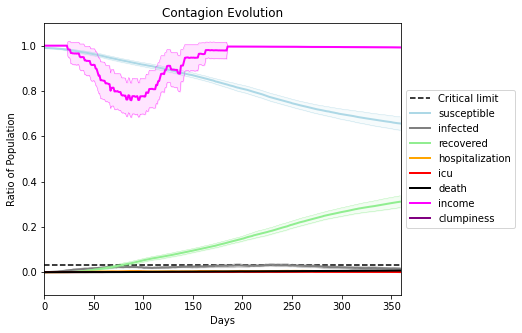

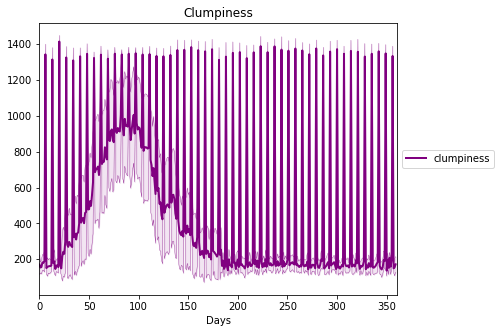

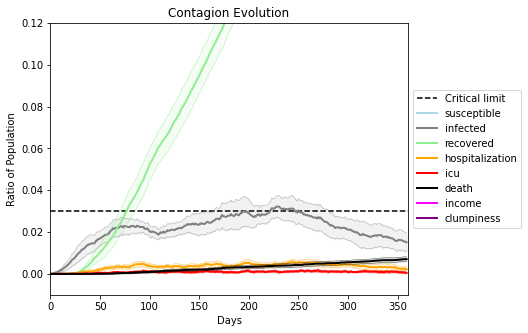

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7723, 1173, 2623, 2268, 1069, 8574, 5219, 8123, 6040, 8393, 4891, 1140, 1857, 6876, 8459, 1821, 9950, 606, 7952, 6760]
Average similarity between family members is 0.9305093786273058 at temperature -0.993
Average similarity between family and home is 0.9998594862635599 at temperature -1
Average similarity between students and their classroom is 0.8378877376519839 at temperature -0.993
Average classroom occupancy is 1.6358381502890174 and number classrooms is 173
Average similarity between workers is 0.8743992772404384 at temperature -0.993
Average office occupancy is 3.3520408163265305 and number offices is 196
Average friend similarity for adults: 0.8448114398481545 for kids: 0.7196806946599508
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.5383231024573896
avg restaurant similarity 0.5853769202224145
avg restaurant similarity 0.5605839480002857
avg restaurant similarity 0.5465037461472596
avg restaurant similarity 0.5593964091598254
avg restaurant similarity 0.5509764696158693
avg restaurant similarity 0.5459516282857675
avg restaurant similarity 0.48419789194289853
avg restaurant similarity 0.5689681227786274
avg restaurant similarity 0.5222056729660343
avg restaurant similarity 0.5412360326948907
avg restaurant similarity 0.5438828562735182
avg restaurant similarity 0.5846642166256224
avg restaurant similarity 0.48640496644171755
avg restaurant similarity 0.5400891810819253
avg restaurant similarity 0.48226362682642426
avg restaurant similarity 0.5237414973871788
avg restaurant similarity 0.5205213350595534
avg restaurant similarity 0.545428924539442
avg restaurant similarity 0.5548099897345771
avg restaurant similarity 0.5081826436993969
avg restaurant similarity 0.4954108474020941
avg rest

avg restaurant similarity 0.5575020232134401
avg restaurant similarity 0.5859508136041378
avg restaurant similarity 0.5406425642897187
avg restaurant similarity 0.5467593508883204
avg restaurant similarity 0.5476278271071495
avg restaurant similarity 0.494984228189856
avg restaurant similarity 0.594021903003353
avg restaurant similarity 0.5501334680287578
avg restaurant similarity 0.6036285050060775
avg restaurant similarity 0.5473736115487698
avg restaurant similarity 0.5570080386113677
avg restaurant similarity 0.5883991903590146
avg restaurant similarity 0.5174180946841882
avg restaurant similarity 0.5958785631077798
avg restaurant similarity 0.5574395544196606
avg restaurant similarity 0.5305225742696684
avg restaurant similarity 0.5715081722543748
avg restaurant similarity 0.5837743496181427
avg restaurant similarity 0.5665581757440898
avg restaurant similarity 0.5396859653391135
avg restaurant similarity 0.5673622069055714
avg restaurant similarity 0.5858877033539287
avg restaura

Average similarity between workers is 0.8711905633195259 at temperature -0.993
Average office occupancy is 3.4256410256410255 and number offices is 195
Average friend similarity for adults: 0.8463767795955535 for kids: 0.7274243359722125
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 

avg restaurant similarity 0.5273735104225495
avg restaurant similarity 0.5258857528998522
avg restaurant similarity 0.5014536244856587
avg restaurant similarity 0.5583209857050677
avg restaurant similarity 0.5293527158116191
avg restaurant similarity 0.49148328230890276
avg restaurant similarity 0.5423025533308448
avg restaurant similarity 0.529718387336823
avg restaurant similarity 0.5597661794861588
avg restaurant similarity 0.5627721029369124
avg restaurant similarity 0.6396944710735439
avg restaurant similarity 0.5194750506940041
avg restaurant similarity 0.6294754070872541
avg restaurant similarity 0.5547859724176245
avg restaurant similarity 0.48729627258267033
avg restaurant similarity 0.573974180532964
avg restaurant similarity 0.5368287901596395
avg restaurant similarity 0.5824029417906159
avg restaurant similarity 0.5636265194000057
avg restaurant similarity 0.5352830286631347
avg restaurant similarity 0.5412709703386259
avg restaurant similarity 0.5307230774533754
avg restau

avg restaurant similarity 0.5857477393526793
avg restaurant similarity 0.5669008896372056
avg restaurant similarity 0.5642148414485656
avg restaurant similarity 0.5649691753796058
avg restaurant similarity 0.4968894148523483
avg restaurant similarity 0.48602019619886155
avg restaurant similarity 0.5979297968607826
avg restaurant similarity 0.5683440317508125
avg restaurant similarity 0.5421425325571066
avg restaurant similarity 0.5374696042388882
avg restaurant similarity 0.532246440186266
avg restaurant similarity 0.5466666243904007
avg restaurant similarity 0.5674868694129565
avg restaurant similarity 0.531097689262216
avg restaurant similarity 0.5764108475793894
avg restaurant similarity 0.5359603753216351
avg restaurant similarity 0.5096677145395697
avg restaurant similarity 0.537991479401254
avg restaurant similarity 0.6186585616854683
avg restaurant similarity 0.5268107458802753
avg restaurant similarity 0.5787848662282312
avg restaurant similarity 0.48790572772818863
avg restaur

Average similarity between workers is 0.866824081902088 at temperature -0.993
Average office occupancy is 3.3762886597938144 and number offices is 194
Average friend similarity for adults: 0.8444020105638466 for kids: 0.7215698526582002
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.575977935099308
avg restaurant similarity 0.5348104757370239
avg restaurant similarity 0.5334571240851558
avg restaurant similarity 0.5481462770474369
avg restaurant similarity 0.514872137333004
avg restaurant similarity 0.5254697636625439
avg restaurant similarity 0.505424010115563
avg restaurant similarity 0.5689199267957303
avg restaurant similarity 0.5267339187553287
avg restaurant similarity 0.5414329952500672
avg restaurant similarity 0.537273647794616
avg restaurant similarity 0.5671815457023061
avg restaurant similarity 0.5484388472410854
avg restaurant similarity 0.575626326427432
avg restaurant similarity 0.5016504416634459
avg restaurant similarity 0.5458278743764317
avg restaurant similarity 0.5307064610365396
avg restaurant similarity 0.5071566862624021
avg restaurant similarity 0.5436725469740906
avg restaurant similarity 0.544263837845668
avg restaurant similarity 0.5457230991307288
avg restaurant similarity 0.5350367953147104
avg restaurant s

avg restaurant similarity 0.5219844448227624
avg restaurant similarity 0.4904410065726142
avg restaurant similarity 0.5115211345720615
avg restaurant similarity 0.5118769970345921
avg restaurant similarity 0.499440047940759
avg restaurant similarity 0.5620119385554533
avg restaurant similarity 0.5124095091202286
avg restaurant similarity 0.5678224109199174
avg restaurant similarity 0.4964306102496812
avg restaurant similarity 0.5579092422737215
avg restaurant similarity 0.4910345720630511
avg restaurant similarity 0.5080036993141983
avg restaurant similarity 0.5632041086568695
avg restaurant similarity 0.48806990724785915
avg restaurant similarity 0.5214566818536156
avg restaurant similarity 0.5409888648766957
avg restaurant similarity 0.5525585470168144
avg restaurant similarity 0.5568917562993606
avg restaurant similarity 0.5782956379419211
avg restaurant similarity 0.49543683543460987
avg restaurant similarity 0.5276788626086082
avg restaurant similarity 0.5590132116737616
avg resta

Average similarity between workers is 0.8682311234946195 at temperature -0.993
Average office occupancy is 3.446236559139785 and number offices is 186
Average friend similarity for adults: 0.8381521513925628 for kids: 0.7351293745314434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5784264606880768
avg restaurant similarity 0.5458624027365454
avg restaurant similarity 0.514969759769856
avg restaurant similarity 0.5648684989417181
avg restaurant similarity 0.5286304652736565
avg restaurant similarity 0.586477857636014
avg restaurant similarity 0.5680940843005325
avg restaurant similarity 0.6039812178974311
avg restaurant similarity 0.5398579833268197
avg restaurant similarity 0.5990243693172081
avg restaurant similarity 0.5741530683316562
avg restaurant similarity 0.5674340420980832
avg restaurant similarity 0.5459848160627212
avg restaurant similarity 0.5692029821929242
avg restaurant similarity 0.573653615526617
avg restaurant similarity 0.581199097760162
avg restaurant similarity 0.5812088544310502
avg restaurant similarity 0.5557878725836704
avg restaurant similarity 0.5596106443085368
avg restaurant similarity 0.5806642894731985
avg restaurant similarity 0.6458492477855499
avg restaurant similarity 0.6005281143935887
avg restaurant

avg restaurant similarity 0.6223300678739356
avg restaurant similarity 0.6021422174258485
avg restaurant similarity 0.5902361774933963
avg restaurant similarity 0.5622836869500601
avg restaurant similarity 0.6124837950260291
avg restaurant similarity 0.5496079476585306
avg restaurant similarity 0.5251824751130272
avg restaurant similarity 0.5796926427626484
avg restaurant similarity 0.5586672645200974
avg restaurant similarity 0.5630197267074649
avg restaurant similarity 0.5730522268614856
avg restaurant similarity 0.5966440518899581
avg restaurant similarity 0.5475063891264795
avg restaurant similarity 0.5501844375369476
avg restaurant similarity 0.6090306007747066
avg restaurant similarity 0.5659144002050787
avg restaurant similarity 0.5941490599501111
avg restaurant similarity 0.543226618903786
avg restaurant similarity 0.5332580202328031
avg restaurant similarity 0.4845369768015022
avg restaurant similarity 0.544566730989453
avg restaurant similarity 0.6097653105771933
avg restaura

Average similarity between workers is 0.8651969960099002 at temperature -0.993
Average office occupancy is 3.443877551020408 and number offices is 196
Average friend similarity for adults: 0.8496281645316731 for kids: 0.7180659677336118
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 peop

avg restaurant similarity 0.5404983788351765
avg restaurant similarity 0.5216350797021693
avg restaurant similarity 0.517098238167078
avg restaurant similarity 0.5703588376132738
avg restaurant similarity 0.5372375932436412
avg restaurant similarity 0.5180588332747975
avg restaurant similarity 0.5143046000982683
avg restaurant similarity 0.5801738955913598
avg restaurant similarity 0.5155288126141196
avg restaurant similarity 0.523973793543189
avg restaurant similarity 0.5107506989319932
avg restaurant similarity 0.4410087384814499
avg restaurant similarity 0.50439878852785
avg restaurant similarity 0.5350844763689636
avg restaurant similarity 0.5688551624621299
avg restaurant similarity 0.5356666297780245
avg restaurant similarity 0.5393598900298539
avg restaurant similarity 0.6070976736482385
avg restaurant similarity 0.5507607717003365
avg restaurant similarity 0.5600544191369725
avg restaurant similarity 0.5513708194425823
avg restaurant similarity 0.5625054016716908
avg restaurant

avg restaurant similarity 0.5786280834975105
avg restaurant similarity 0.5203307238017852
avg restaurant similarity 0.4964650361379815
avg restaurant similarity 0.4992266884568021
avg restaurant similarity 0.5262061899405854
avg restaurant similarity 0.5673021774159543
avg restaurant similarity 0.5416009472034913
avg restaurant similarity 0.5534312364177044
avg restaurant similarity 0.5875416928834938
avg restaurant similarity 0.550089845174201
avg restaurant similarity 0.5104078001421789
avg restaurant similarity 0.5685786770757468
avg restaurant similarity 0.5556152183327787
avg restaurant similarity 0.5033728534416608
avg restaurant similarity 0.5416894786579483
avg restaurant similarity 0.5360501498159299
avg restaurant similarity 0.5939981344105459
avg restaurant similarity 0.5623587804598191
avg restaurant similarity 0.6108924567298271
avg restaurant similarity 0.5480341976409675
avg restaurant similarity 0.5205148960953194
avg restaurant similarity 0.5496689977851894
avg restaur

Average similarity between workers is 0.867561466430438 at temperature -0.993
Average office occupancy is 3.4712041884816753 and number offices is 191
Average friend similarity for adults: 0.8505472589691788 for kids: 0.7290857953295049
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.5559770928039859
avg restaurant similarity 0.5677543461664145
avg restaurant similarity 0.5653105845744378
avg restaurant similarity 0.5402474881012448
avg restaurant similarity 0.5468165303348154
avg restaurant similarity 0.5676825955212684
avg restaurant similarity 0.5756680647337874
avg restaurant similarity 0.573599875968283
avg restaurant similarity 0.49640429734300184
avg restaurant similarity 0.5082062760005809
avg restaurant similarity 0.561831330528967
avg restaurant similarity 0.5299198696573566
avg restaurant similarity 0.5591967764890642
avg restaurant similarity 0.5242601070731125
avg restaurant similarity 0.5358880826803714
avg restaurant similarity 0.5430411668242063
avg restaurant similarity 0.5674262129017269
avg restaurant similarity 0.5707682542687779
avg restaurant similarity 0.5769051200643314
avg restaurant similarity 0.5832307065915876
avg restaurant similarity 0.5587906108411475
avg restaurant similarity 0.5687480203064426
avg restaur

avg restaurant similarity 0.5869346640344114
avg restaurant similarity 0.5440549683130107
avg restaurant similarity 0.5469921293487828
avg restaurant similarity 0.5672064707963114
avg restaurant similarity 0.5421149603109562
avg restaurant similarity 0.5352601736320372
avg restaurant similarity 0.5702428312468114
avg restaurant similarity 0.6004790526338999
avg restaurant similarity 0.542856848677575
avg restaurant similarity 0.5374290074128367
avg restaurant similarity 0.5824043621356481
avg restaurant similarity 0.5580829704593578
avg restaurant similarity 0.5642490854899944
avg restaurant similarity 0.5287760807893198
avg restaurant similarity 0.5741568901020955
avg restaurant similarity 0.5438450635412745
avg restaurant similarity 0.5698332109863251
avg restaurant similarity 0.521760845786573
avg restaurant similarity 0.5514766316498759
avg restaurant similarity 0.5728304900063683
avg restaurant similarity 0.5747865331019646
avg restaurant similarity 0.5569178461102452
avg restaura

Average similarity between workers is 0.8708988067474153 at temperature -0.993
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.84792733023009 for kids: 0.7091349854303364
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.5301236303406256
avg restaurant similarity 0.567408247768118
avg restaurant similarity 0.5939422837715301
avg restaurant similarity 0.544269738902259
avg restaurant similarity 0.5424933303537907
avg restaurant similarity 0.5707014222751039
avg restaurant similarity 0.6013579340278565
avg restaurant similarity 0.5574798152510079
avg restaurant similarity 0.6281567364554222
avg restaurant similarity 0.5885277084670417
avg restaurant similarity 0.5344647570084817
avg restaurant similarity 0.5439803453210479
avg restaurant similarity 0.5692270796014293
avg restaurant similarity 0.5424943876883571
avg restaurant similarity 0.5889087624569878
avg restaurant similarity 0.5917260695842173
avg restaurant similarity 0.5941695651744271
avg restaurant similarity 0.5458581343899827
avg restaurant similarity 0.5365969520451732
avg restaurant similarity 0.6052488046068571
avg restaurant similarity 0.5285566572423841
avg restaurant similarity 0.6212305063779046
avg restaura

avg restaurant similarity 0.5816950460869517
avg restaurant similarity 0.5566048934710128
avg restaurant similarity 0.5657372918779515
avg restaurant similarity 0.5742413451982308
avg restaurant similarity 0.5325438052422425
avg restaurant similarity 0.5685670399824522
avg restaurant similarity 0.5867019011464093
avg restaurant similarity 0.5674192812162153
avg restaurant similarity 0.5683140364103905
avg restaurant similarity 0.5927963562765302
avg restaurant similarity 0.5491958884730761
avg restaurant similarity 0.5464312443571284
avg restaurant similarity 0.5551500030700979
avg restaurant similarity 0.5481898216145149
avg restaurant similarity 0.549686674234072
avg restaurant similarity 0.6104250245251962
avg restaurant similarity 0.5469492603837565
avg restaurant similarity 0.6030775459286009
avg restaurant similarity 0.589022983907592
avg restaurant similarity 0.5921344710825576
avg restaurant similarity 0.5549600263206194
avg restaurant similarity 0.5702806539497133
avg restaura

Average similarity between workers is 0.859455606920094 at temperature -0.993
Average office occupancy is 3.4105263157894736 and number offices is 190
Average friend similarity for adults: 0.8389633775050632 for kids: 0.7356714720185136
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5522959806588488
avg restaurant similarity 0.5756000729985538
avg restaurant similarity 0.5309538381325988
avg restaurant similarity 0.5549337196949953
avg restaurant similarity 0.5493642011188777
avg restaurant similarity 0.5616823184513411
avg restaurant similarity 0.6145456007439165
avg restaurant similarity 0.5268133894655632
avg restaurant similarity 0.5508210171238853
avg restaurant similarity 0.5558790474947468
avg restaurant similarity 0.5703723658226602
avg restaurant similarity 0.5755198388649719
avg restaurant similarity 0.5621555213693661
avg restaurant similarity 0.5520683254313314
avg restaurant similarity 0.5257456968284913
avg restaurant similarity 0.5215624009707841
avg restaurant similarity 0.5425679251712076
avg restaurant similarity 0.5409881184556461
avg restaurant similarity 0.49990118968980324
avg restaurant similarity 0.5397134814903483
avg restaurant similarity 0.5586285845853978
avg restaurant similarity 0.5523539378828378
avg resta

avg restaurant similarity 0.5963312524041318
avg restaurant similarity 0.5117899646224945
avg restaurant similarity 0.52085723993266
avg restaurant similarity 0.5684744078694026
avg restaurant similarity 0.5437264283189996
avg restaurant similarity 0.5476682504502164
avg restaurant similarity 0.5073043540212963
avg restaurant similarity 0.5590824905208851
avg restaurant similarity 0.5786293913094315
avg restaurant similarity 0.5363659789883958
avg restaurant similarity 0.5465059996680052
avg restaurant similarity 0.5374298685927326
avg restaurant similarity 0.5213577934259227
avg restaurant similarity 0.5457877794256638
avg restaurant similarity 0.5324649661837093
avg restaurant similarity 0.5939352205422294
avg restaurant similarity 0.5570930593087559
avg restaurant similarity 0.5335004381748454
avg restaurant similarity 0.5605559330114459
avg restaurant similarity 0.5111273598078415
avg restaurant similarity 0.589425067279113
avg restaurant similarity 0.5266096936594084
avg restauran

Average similarity between workers is 0.8785288874813171 at temperature -0.993
Average office occupancy is 3.323232323232323 and number offices is 198
Average friend similarity for adults: 0.8428474319106114 for kids: 0.7253069065079566
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5347885388425713
avg restaurant similarity 0.5065652522673627
avg restaurant similarity 0.48994782574428586
avg restaurant similarity 0.47946046950179266
avg restaurant similarity 0.5785492375169315
avg restaurant similarity 0.46535103398648103
avg restaurant similarity 0.5299357360788192
avg restaurant similarity 0.5365681756448195
avg restaurant similarity 0.5323433613916522
avg restaurant similarity 0.5080301944976079
avg restaurant similarity 0.47428052776159413
avg restaurant similarity 0.4988061290272432
avg restaurant similarity 0.49711846495631634
avg restaurant similarity 0.5896748146174227
avg restaurant similarity 0.5268632165405753
avg restaurant similarity 0.5578086942874123
avg restaurant similarity 0.541137618766906
avg restaurant similarity 0.567443791644728
avg restaurant similarity 0.4875553216811455
avg restaurant similarity 0.46010216415467775
avg restaurant similarity 0.5109712380474586
avg restaurant similarity 0.5838752523769153
avg re

avg restaurant similarity 0.5472063819390698
avg restaurant similarity 0.5459733731052655
avg restaurant similarity 0.5316611108606167
avg restaurant similarity 0.46557813348835136
avg restaurant similarity 0.5006488211273685
avg restaurant similarity 0.5473079299366841
avg restaurant similarity 0.5306220512491998
avg restaurant similarity 0.5189108137884497
avg restaurant similarity 0.5073843067708705
avg restaurant similarity 0.5217797387710374
avg restaurant similarity 0.5483825300391059
avg restaurant similarity 0.5317344862570812
avg restaurant similarity 0.4802022272789701
avg restaurant similarity 0.500965729113033
avg restaurant similarity 0.5803166287607716
avg restaurant similarity 0.5435075855238513
avg restaurant similarity 0.5395437137084297
avg restaurant similarity 0.4587808634246617
avg restaurant similarity 0.4428190259686467
avg restaurant similarity 0.5195436018489585
avg restaurant similarity 0.5176310655732264
avg restaurant similarity 0.538767966089748
avg restaur

Average similarity between workers is 0.8537723131723078 at temperature -0.993
Average office occupancy is 3.4224598930481283 and number offices is 187
Average friend similarity for adults: 0.8410865287510744 for kids: 0.7333520186485994
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5425032856055362
avg restaurant similarity 0.5761688626617676
avg restaurant similarity 0.5488778865212468
avg restaurant similarity 0.592468670832126
avg restaurant similarity 0.5288295079904108
avg restaurant similarity 0.5542841763464612
avg restaurant similarity 0.5370498984674655
avg restaurant similarity 0.5186527488049345
avg restaurant similarity 0.5228864399339496
avg restaurant similarity 0.562440144083111
avg restaurant similarity 0.5153115857858765
avg restaurant similarity 0.5968956856313543
avg restaurant similarity 0.527239272304422
avg restaurant similarity 0.5537131643464112
avg restaurant similarity 0.5189562770456357
avg restaurant similarity 0.5710416875628415
avg restaurant similarity 0.5360684448587305
avg restaurant similarity 0.5699920132416905
avg restaurant similarity 0.5447856620213771
avg restaurant similarity 0.570967405777483
avg restaurant similarity 0.5872019923352386
avg restaurant similarity 0.5130229087160646
avg restaurant

avg restaurant similarity 0.545857308717303
avg restaurant similarity 0.5440423754374776
avg restaurant similarity 0.567313211621188
avg restaurant similarity 0.5247571601061413
avg restaurant similarity 0.5903665643361622
avg restaurant similarity 0.506960513075213
avg restaurant similarity 0.5396902156009742
avg restaurant similarity 0.5394049741054171
avg restaurant similarity 0.5520850798438279
avg restaurant similarity 0.5304556535753763
avg restaurant similarity 0.49433647674620246
avg restaurant similarity 0.5469066996240322
avg restaurant similarity 0.5314602701007451
avg restaurant similarity 0.5257548896851734
avg restaurant similarity 0.5126812672930495
avg restaurant similarity 0.5442776399002066
avg restaurant similarity 0.5366157735005784
avg restaurant similarity 0.4991044270279912
avg restaurant similarity 0.5331873503594816
avg restaurant similarity 0.5396467269256948
avg restaurant similarity 0.5148550665666536
avg restaurant similarity 0.5436455258257067
avg restaura

Average similarity between workers is 0.8711479698304414 at temperature -0.993
Average office occupancy is 3.478723404255319 and number offices is 188
Average friend similarity for adults: 0.8435605897562131 for kids: 0.7162444682192508
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.5351680438781179
avg restaurant similarity 0.5578409676474676
avg restaurant similarity 0.5654668282148515
avg restaurant similarity 0.6184052451971995
avg restaurant similarity 0.5437171721046076
avg restaurant similarity 0.5235683198272518
avg restaurant similarity 0.5714684157863287
avg restaurant similarity 0.5409614795274915
avg restaurant similarity 0.5554790976416382
avg restaurant similarity 0.5441207190305666
avg restaurant similarity 0.5203030160492519
avg restaurant similarity 0.5887596807954251
avg restaurant similarity 0.573616460564843
avg restaurant similarity 0.5351220127161215
avg restaurant similarity 0.5211806079321213
avg restaurant similarity 0.5917843242649234
avg restaurant similarity 0.5358986425270513
avg restaurant similarity 0.5713621018448798
avg restaurant similarity 0.5051493498885768
avg restaurant similarity 0.5200126742770325
avg restaurant similarity 0.5466813486751652
avg restaurant similarity 0.5411973781426155
avg restaur

avg restaurant similarity 0.5366190942232975
avg restaurant similarity 0.5549976754578057
avg restaurant similarity 0.5767038801285181
avg restaurant similarity 0.5825088644454373
avg restaurant similarity 0.5665539365210355
avg restaurant similarity 0.5929674565009848
avg restaurant similarity 0.5581173468452731
avg restaurant similarity 0.5523581135549428
avg restaurant similarity 0.5826062243867889
avg restaurant similarity 0.5361686938237288
avg restaurant similarity 0.5414872753806002
avg restaurant similarity 0.5632922736515715
avg restaurant similarity 0.5470545998230264
avg restaurant similarity 0.5271269300156636
avg restaurant similarity 0.5448667259207105
avg restaurant similarity 0.5492691361302053
avg restaurant similarity 0.5738608436269286
avg restaurant similarity 0.5625329751250971
avg restaurant similarity 0.6170742550597845
avg restaurant similarity 0.547409309623869
avg restaurant similarity 0.5963901092710834
avg restaurant similarity 0.5851707589420904
avg restaur

Average similarity between workers is 0.8842386287761858 at temperature -0.993
Average office occupancy is 3.316326530612245 and number offices is 196
Average friend similarity for adults: 0.8391252560979209 for kids: 0.721315599106192
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 peo

avg restaurant similarity 0.5787503904509491
avg restaurant similarity 0.5854446015082547
avg restaurant similarity 0.5952094738656806
avg restaurant similarity 0.5487638803197096
avg restaurant similarity 0.5787408858482181
avg restaurant similarity 0.5854825250336424
avg restaurant similarity 0.5539498397765354
avg restaurant similarity 0.5682150408458387
avg restaurant similarity 0.6012299358559181
avg restaurant similarity 0.5674078662171711
avg restaurant similarity 0.5952521256771803
avg restaurant similarity 0.5855644396590642
avg restaurant similarity 0.6207729037356087
avg restaurant similarity 0.5915594728195297
avg restaurant similarity 0.5621548135588526
avg restaurant similarity 0.5774420367429655
avg restaurant similarity 0.5789862806623831
avg restaurant similarity 0.5606924335067336
avg restaurant similarity 0.5498211180728552
avg restaurant similarity 0.5592489672027421
avg restaurant similarity 0.5458190241272092
avg restaurant similarity 0.5843245433674552
avg restau

avg restaurant similarity 0.5794575428156443
avg restaurant similarity 0.5460175491170635
avg restaurant similarity 0.6184637423900718
avg restaurant similarity 0.5924187380935817
avg restaurant similarity 0.5452455734317584
avg restaurant similarity 0.54164984094594
avg restaurant similarity 0.6005590339338805
avg restaurant similarity 0.5800860649694438
avg restaurant similarity 0.5778678332092085
avg restaurant similarity 0.5858357338591107
avg restaurant similarity 0.5679566137054005
avg restaurant similarity 0.5831936104758142
avg restaurant similarity 0.5583305523981997
avg restaurant similarity 0.5704791644773377
avg restaurant similarity 0.5927363809300525
avg restaurant similarity 0.5860238304979581
avg restaurant similarity 0.5741306166270113
avg restaurant similarity 0.5710955794718563
avg restaurant similarity 0.6084856453970351
avg restaurant similarity 0.6191388500858682
avg restaurant similarity 0.5912759824160875
avg restaurant similarity 0.6176479307161088
avg restaura

Average classroom occupancy is 1.6216216216216217 and number classrooms is 185
Average similarity between workers is 0.8559236002051708 at temperature -0.993
Average office occupancy is 3.402061855670103 and number offices is 194
Average friend similarity for adults: 0.8451854330091215 for kids: 0.7295574598299517
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with 

avg restaurant similarity 0.5531729704811804
avg restaurant similarity 0.5117030996590158
avg restaurant similarity 0.6055670971541793
avg restaurant similarity 0.4836816628047186
avg restaurant similarity 0.5821829237637896
avg restaurant similarity 0.5366269812140376
avg restaurant similarity 0.5498981536025848
avg restaurant similarity 0.5756715974168906
avg restaurant similarity 0.5589545589368521
avg restaurant similarity 0.4890793608776973
avg restaurant similarity 0.5716363556955295
avg restaurant similarity 0.5218458513975773
avg restaurant similarity 0.5664087570076891
avg restaurant similarity 0.5492247283809704
avg restaurant similarity 0.5519943068238229
avg restaurant similarity 0.609676744823781
avg restaurant similarity 0.5976382507329648
avg restaurant similarity 0.6179338681269162
avg restaurant similarity 0.5423866575963721
avg restaurant similarity 0.5894424855878087
avg restaurant similarity 0.5980591773300042
avg restaurant similarity 0.5461888991979225
avg restaur

avg restaurant similarity 0.604549111560279
avg restaurant similarity 0.6538048461506717
avg restaurant similarity 0.5912930901943811
avg restaurant similarity 0.5314173071659214
avg restaurant similarity 0.5706169896578698
avg restaurant similarity 0.5158025571304243
avg restaurant similarity 0.6028906476818661
avg restaurant similarity 0.5134256764230475
avg restaurant similarity 0.550858236578673
avg restaurant similarity 0.5699517439940925
avg restaurant similarity 0.5456101072982443
avg restaurant similarity 0.5456829168773685
avg restaurant similarity 0.5800086354861629
avg restaurant similarity 0.6211853586847342
avg restaurant similarity 0.5977243114535301
avg restaurant similarity 0.5614850732851919
avg restaurant similarity 0.5932843681222125
avg restaurant similarity 0.5772399845792381
avg restaurant similarity 0.6052955813032853
avg restaurant similarity 0.5914194512631555
avg restaurant similarity 0.5950024980365344
avg restaurant similarity 0.5475188914747041
avg restaura

Average similarity between workers is 0.8669870901786787 at temperature -0.993
Average office occupancy is 3.409090909090909 and number offices is 198
Average friend similarity for adults: 0.8438763703748045 for kids: 0.7264114569871447
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5941849646348286
avg restaurant similarity 0.5880171300108387
avg restaurant similarity 0.5291595693588477
avg restaurant similarity 0.5941558871822905
avg restaurant similarity 0.5370643748882129
avg restaurant similarity 0.5306320836032828
avg restaurant similarity 0.5449143760180651
avg restaurant similarity 0.5619271124834649
avg restaurant similarity 0.5207297861458966
avg restaurant similarity 0.5766530936975887
avg restaurant similarity 0.5564227215733552
avg restaurant similarity 0.5460966505051998
avg restaurant similarity 0.5308258298356033
avg restaurant similarity 0.5352010381039762
avg restaurant similarity 0.5233208032479378
avg restaurant similarity 0.5770293411562013
avg restaurant similarity 0.5784669070738374
avg restaurant similarity 0.5210349998604891
avg restaurant similarity 0.5132615048969369
avg restaurant similarity 0.5358601940606438
avg restaurant similarity 0.5330279689232149
avg restaurant similarity 0.5384268481798052
avg restau

avg restaurant similarity 0.5643639293918952
avg restaurant similarity 0.5584405831247011
avg restaurant similarity 0.5222689200211752
avg restaurant similarity 0.5902842437717005
avg restaurant similarity 0.5596686281319658
avg restaurant similarity 0.5692314557194311
avg restaurant similarity 0.5945440073779479
avg restaurant similarity 0.5304580950505708
avg restaurant similarity 0.536082075772609
avg restaurant similarity 0.5749797979831033
avg restaurant similarity 0.5309461783449095
avg restaurant similarity 0.547988347470218
avg restaurant similarity 0.537367466235157
avg restaurant similarity 0.5389910759767157
avg restaurant similarity 0.551315904630965
avg restaurant similarity 0.6025743115730557
avg restaurant similarity 0.5483766892306433
avg restaurant similarity 0.5474869657618548
avg restaurant similarity 0.5204224163824932
avg restaurant similarity 0.48355791397139497
avg restaurant similarity 0.5417627506752658
avg restaurant similarity 0.5300195778991647
avg restauran

Average similarity between workers is 0.8756043162456337 at temperature -0.993
Average office occupancy is 3.4105263157894736 and number offices is 190
Average friend similarity for adults: 0.8445644788669311 for kids: 0.7262069171405742
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.563523409886749
avg restaurant similarity 0.5346570556732833
avg restaurant similarity 0.5711291266080046
avg restaurant similarity 0.6090813435675492
avg restaurant similarity 0.5722165529118731
avg restaurant similarity 0.5498227541606544
avg restaurant similarity 0.5470795020262119
avg restaurant similarity 0.5176540507549161
avg restaurant similarity 0.5507288167372788
avg restaurant similarity 0.5730156163322796
avg restaurant similarity 0.5793492221692096
avg restaurant similarity 0.5545246369644554
avg restaurant similarity 0.5403687735259318
avg restaurant similarity 0.5684609643553715
avg restaurant similarity 0.5506223550716104
avg restaurant similarity 0.5412138130282197
avg restaurant similarity 0.5479179041442785
avg restaurant similarity 0.5573038808758279
avg restaurant similarity 0.5552831068716055
avg restaurant similarity 0.5980781225649093
avg restaurant similarity 0.5518176818119837
avg restaurant similarity 0.5668956091679793
avg restaur

avg restaurant similarity 0.5508939590477129
avg restaurant similarity 0.5480026381967975
avg restaurant similarity 0.4838641796243003
avg restaurant similarity 0.5459081080939132
avg restaurant similarity 0.5426536459464883
avg restaurant similarity 0.568224791377769
avg restaurant similarity 0.5921953954426215
avg restaurant similarity 0.5784077643227794
avg restaurant similarity 0.5518816536185884
avg restaurant similarity 0.5369340620227212
avg restaurant similarity 0.5815912342851515
avg restaurant similarity 0.5146462710042707
avg restaurant similarity 0.5533554183254912
avg restaurant similarity 0.5585989338978687
avg restaurant similarity 0.5563455636929973
avg restaurant similarity 0.5413219717962117
avg restaurant similarity 0.5609171522296873
avg restaurant similarity 0.5723341640208325
avg restaurant similarity 0.5515790201070441
avg restaurant similarity 0.542434472283592
avg restaurant similarity 0.5896782216282251
avg restaurant similarity 0.5947780111308204
avg restaura

Average similarity between workers is 0.8648403283221028 at temperature -0.993
Average office occupancy is 3.392857142857143 and number offices is 196
Average friend similarity for adults: 0.8422232529470192 for kids: 0.7101998877013148
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.510513905679361
avg restaurant similarity 0.5159058028162198
avg restaurant similarity 0.5819326429918461
avg restaurant similarity 0.5312413655696155
avg restaurant similarity 0.5836395772859999
avg restaurant similarity 0.5803073667510363
avg restaurant similarity 0.5130352127255174
avg restaurant similarity 0.5386085571665115
avg restaurant similarity 0.569283279462744
avg restaurant similarity 0.5401736416293169
avg restaurant similarity 0.5948063067693564
avg restaurant similarity 0.5799082773592987
avg restaurant similarity 0.5537471252189703
avg restaurant similarity 0.5106022810443137
avg restaurant similarity 0.5743205319698215
avg restaurant similarity 0.5434220192955712
avg restaurant similarity 0.50300318186868
avg restaurant similarity 0.5663010077847258
avg restaurant similarity 0.5493542616893622
avg restaurant similarity 0.5319358135069241
avg restaurant similarity 0.53705104300079
avg restaurant similarity 0.4905478423473018
avg restaurant s

avg restaurant similarity 0.5482073112861531
avg restaurant similarity 0.5250617388449601
avg restaurant similarity 0.5644248451546016
avg restaurant similarity 0.5678217934579814
avg restaurant similarity 0.5382421848290655
avg restaurant similarity 0.5394621242332999
avg restaurant similarity 0.5669909981103912
avg restaurant similarity 0.5593829919119053
avg restaurant similarity 0.5515128916540554
avg restaurant similarity 0.5595292866189563
avg restaurant similarity 0.5544298838839243
avg restaurant similarity 0.5697161022282528
avg restaurant similarity 0.5728133025557722
avg restaurant similarity 0.6070781962841174
avg restaurant similarity 0.5559479305748297
avg restaurant similarity 0.6074162215598451
avg restaurant similarity 0.5740649529432053
avg restaurant similarity 0.5675321107645417
avg restaurant similarity 0.552640641822515
avg restaurant similarity 0.5885831099093499
avg restaurant similarity 0.5647458066001325
avg restaurant similarity 0.5081689815433286
avg restaur

Average similarity between workers is 0.8723601025640035 at temperature -0.993
Average office occupancy is 3.4536082474226806 and number offices is 194
Average friend similarity for adults: 0.8544415576623917 for kids: 0.7314830577445864
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5111822131945447
avg restaurant similarity 0.543662431154972
avg restaurant similarity 0.5408023059519512
avg restaurant similarity 0.5040938727838732
avg restaurant similarity 0.5329925131329414
avg restaurant similarity 0.5491112925098449
avg restaurant similarity 0.5262866768238141
avg restaurant similarity 0.5325444044788582
avg restaurant similarity 0.5661084195702701
avg restaurant similarity 0.5382033600561172
avg restaurant similarity 0.5216683491104671
avg restaurant similarity 0.5053966069622327
avg restaurant similarity 0.536155616222069
avg restaurant similarity 0.4967632702947101
avg restaurant similarity 0.5326184404294163
avg restaurant similarity 0.5278149345974009
avg restaurant similarity 0.5243820287118929
avg restaurant similarity 0.5037120994576326
avg restaurant similarity 0.5174853304080466
avg restaurant similarity 0.5582654570601535
avg restaurant similarity 0.5100618923684013
avg restaurant similarity 0.5162717884804074
avg restaura

avg restaurant similarity 0.48620639475052024
avg restaurant similarity 0.5389532782419374
avg restaurant similarity 0.5265001716341579
avg restaurant similarity 0.4655361326196945
avg restaurant similarity 0.5332251966866124
avg restaurant similarity 0.5251256360182314
avg restaurant similarity 0.48484005284582954
avg restaurant similarity 0.4752315900441537
avg restaurant similarity 0.5301597324819578
avg restaurant similarity 0.529848479142297
avg restaurant similarity 0.541208617614767
avg restaurant similarity 0.524036398365268
avg restaurant similarity 0.5148808923604887
avg restaurant similarity 0.5506151992276561
avg restaurant similarity 0.5169868599294473
avg restaurant similarity 0.5567938641212977
avg restaurant similarity 0.45895431492995425
avg restaurant similarity 0.5261972154122482
avg restaurant similarity 0.44907207316857456
avg restaurant similarity 0.5308072535639671
avg restaurant similarity 0.491515055083593
avg restaurant similarity 0.53296243119217
avg restaura

Average similarity between workers is 0.8699968975684796 at temperature -0.993
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.8442472191762433 for kids: 0.7106867996917903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total o

avg restaurant similarity 0.5429656567993881
avg restaurant similarity 0.49596289077740935
avg restaurant similarity 0.533942083519755
avg restaurant similarity 0.4798290194972909
avg restaurant similarity 0.5690213088494347
avg restaurant similarity 0.5198434776903106
avg restaurant similarity 0.5532122303406688
avg restaurant similarity 0.5167518638333951
avg restaurant similarity 0.5241179553092717
avg restaurant similarity 0.5606205672297765
avg restaurant similarity 0.5535060105990752
avg restaurant similarity 0.5728092410222109
avg restaurant similarity 0.5823298146307808
avg restaurant similarity 0.5864069601783188
avg restaurant similarity 0.574028413288108
avg restaurant similarity 0.5896230631207705
avg restaurant similarity 0.5810773233705562
avg restaurant similarity 0.562459162444309
avg restaurant similarity 0.5582549109884715
avg restaurant similarity 0.5899180189699731
avg restaurant similarity 0.6195632237192666
avg restaurant similarity 0.5874552370727097
avg restaura

avg restaurant similarity 0.5764407654342972
avg restaurant similarity 0.5307004617146527
avg restaurant similarity 0.5776915738380811
avg restaurant similarity 0.5814659060530007
avg restaurant similarity 0.5819945810689998
avg restaurant similarity 0.6135656333541399
avg restaurant similarity 0.5938548062691776
avg restaurant similarity 0.5784573328504081
avg restaurant similarity 0.5670694441432255
avg restaurant similarity 0.5592349346768665
avg restaurant similarity 0.5283424448738786
avg restaurant similarity 0.5719709264809457
avg restaurant similarity 0.5809767625532666
avg restaurant similarity 0.5855145897642651
avg restaurant similarity 0.5955508949160826
avg restaurant similarity 0.5602777478666275
avg restaurant similarity 0.5544611349818236
avg restaurant similarity 0.5458499635363238
avg restaurant similarity 0.5096178090665971
avg restaurant similarity 0.5676553604817993
avg restaurant similarity 0.6064581578289443
avg restaurant similarity 0.5441048641740313
avg restau

Average similarity between workers is 0.8851315573486448 at temperature -0.993
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.8478309069082716 for kids: 0.7505499928437969
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.5180413175369558
avg restaurant similarity 0.5593538051339891
avg restaurant similarity 0.5635840443783838
avg restaurant similarity 0.5686840834508268
avg restaurant similarity 0.5131327688003047
avg restaurant similarity 0.5855736401468684
avg restaurant similarity 0.5381926252184176
avg restaurant similarity 0.5285475555722409
avg restaurant similarity 0.5271870272588628
avg restaurant similarity 0.5435511604436152
avg restaurant similarity 0.6172931875089283
avg restaurant similarity 0.5465544882998424
avg restaurant similarity 0.5376886148764288
avg restaurant similarity 0.5426931288596137
avg restaurant similarity 0.5431464639142355
avg restaurant similarity 0.5492409813827611
avg restaurant similarity 0.5832877985444392
avg restaurant similarity 0.600252226990417
avg restaurant similarity 0.5771885222127264
avg restaurant similarity 0.5838456363731487
avg restaurant similarity 0.542586494610633
avg restaurant similarity 0.5329869853878164
avg restaura

avg restaurant similarity 0.5575185040443881
avg restaurant similarity 0.6070789790499292
avg restaurant similarity 0.554170364625911
avg restaurant similarity 0.570655674043588
avg restaurant similarity 0.5499071659392539
avg restaurant similarity 0.5064054297460819
avg restaurant similarity 0.5559906554182618
avg restaurant similarity 0.5349751445961091
avg restaurant similarity 0.5586665492258918
avg restaurant similarity 0.5877508533412945
avg restaurant similarity 0.5386627398488141
avg restaurant similarity 0.630777527633855
avg restaurant similarity 0.5478717443190424
avg restaurant similarity 0.5697595736602679
avg restaurant similarity 0.5899046153027514
avg restaurant similarity 0.5626547133828183
avg restaurant similarity 0.5931061991718195
avg restaurant similarity 0.5433705870634713
avg restaurant similarity 0.5141836591943104
avg restaurant similarity 0.5498844717425644
avg restaurant similarity 0.5233604792479354
avg restaurant similarity 0.5415731083162475
avg restauran

Average similarity between workers is 0.8662208503047534 at temperature -0.993
Average office occupancy is 3.4947916666666665 and number offices is 192
Average friend similarity for adults: 0.8493763022222666 for kids: 0.7274074517453485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5901629843608219
avg restaurant similarity 0.5949289717884186
avg restaurant similarity 0.5869989067023144
avg restaurant similarity 0.5757121074947836
avg restaurant similarity 0.6216227807208272
avg restaurant similarity 0.5725848276196132
avg restaurant similarity 0.5942630859241415
avg restaurant similarity 0.6079775917400817
avg restaurant similarity 0.6558904712634988
avg restaurant similarity 0.5759417095411494
avg restaurant similarity 0.5990832005921234
avg restaurant similarity 0.5963269215574624
avg restaurant similarity 0.5640117175875371
avg restaurant similarity 0.5538719894628403
avg restaurant similarity 0.5454436424030208
avg restaurant similarity 0.5520608521584962
avg restaurant similarity 0.5710208938021947
avg restaurant similarity 0.6121155790432089
avg restaurant similarity 0.5931346804150729
avg restaurant similarity 0.6512780607873977
avg restaurant similarity 0.6026016304947076
avg restaurant similarity 0.5361745007929215
avg restau

avg restaurant similarity 0.5524745510289077
avg restaurant similarity 0.5790958259611261
avg restaurant similarity 0.5863634557475883
avg restaurant similarity 0.5816799898235384
avg restaurant similarity 0.5403861668574962
avg restaurant similarity 0.6452618781311302
avg restaurant similarity 0.5922116601948233
avg restaurant similarity 0.5773571756175925
avg restaurant similarity 0.5316233854371268
avg restaurant similarity 0.5895643994834526
avg restaurant similarity 0.5360613804522503
avg restaurant similarity 0.5395964262160908
avg restaurant similarity 0.5797146250185559
avg restaurant similarity 0.5802853760889067
avg restaurant similarity 0.4935501790939585
avg restaurant similarity 0.6071191140166886
avg restaurant similarity 0.5806899515424767
avg restaurant similarity 0.5933418435959638
avg restaurant similarity 0.5983799824135405
avg restaurant similarity 0.596541666563816
avg restaurant similarity 0.5376634106913319
avg restaurant similarity 0.5701486316640184
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

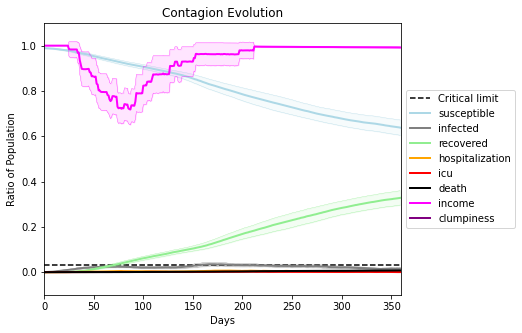

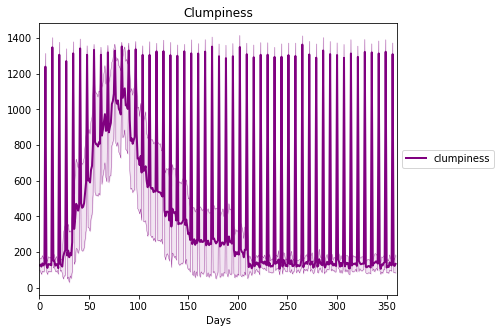

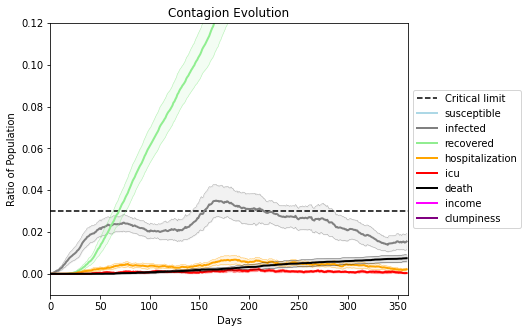

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4384, 3308, 3602, 6247, 5792, 9617, 9816, 8270, 3975, 8388, 5010, 8775, 2075, 4785, 6623, 1546, 6361, 9940, 3277, 2149]
Average similarity between family members is 0.9193687044942891 at temperature -0.992
Average similarity between family and home is 0.9998455767319443 at temperature -1
Average similarity between students and their classroom is 0.8450668912799599 at temperature -0.992
Average classroom occupancy is 1.6574585635359116 and number classrooms is 181
Average similarity between workers is 0.847177671146512 at temperature -0.992
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8378453960331526 for kids: 0.720787292295096
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.4751084995000695
avg restaurant similarity 0.5305082796199061
avg restaurant similarity 0.5488013534170247
avg restaurant similarity 0.5080048528956672
avg restaurant similarity 0.5520359078350976
avg restaurant similarity 0.5131634553219594
avg restaurant similarity 0.5376959042072252
avg restaurant similarity 0.4925518033695215
avg restaurant similarity 0.5307070196130067
avg restaurant similarity 0.5326628455160569
avg restaurant similarity 0.5289427923718658
avg restaurant similarity 0.5039501419608535
avg restaurant similarity 0.5335796367966537
avg restaurant similarity 0.5536110634749845
avg restaurant similarity 0.5665547195349978
avg restaurant similarity 0.521921359433436
avg restaurant similarity 0.558502497516853
avg restaurant similarity 0.5329658420698844
avg restaurant similarity 0.5604113945857293
avg restaurant similarity 0.5941608721643492
avg restaurant similarity 0.5061628472144273
avg restaurant similarity 0.56181691043424
avg restaurant

avg restaurant similarity 0.6014020514746627
avg restaurant similarity 0.5825054473525627
avg restaurant similarity 0.5649660378745893
avg restaurant similarity 0.5564257808458591
avg restaurant similarity 0.531637272338476
avg restaurant similarity 0.5098158038089159
avg restaurant similarity 0.5780278912530942
avg restaurant similarity 0.5230299482337177
avg restaurant similarity 0.5876429480356419
avg restaurant similarity 0.5870064044377652
avg restaurant similarity 0.49919419615599675
avg restaurant similarity 0.5340234381243912
avg restaurant similarity 0.5301591659945961
avg restaurant similarity 0.5690904314535948
avg restaurant similarity 0.5258029762174617
avg restaurant similarity 0.5673917147993245
avg restaurant similarity 0.5227022832074945
avg restaurant similarity 0.621099995100429
avg restaurant similarity 0.5378578744102458
avg restaurant similarity 0.5701214346531133
avg restaurant similarity 0.5543022500640197
avg restaurant similarity 0.5481900705895644
avg restaur

Average similarity between workers is 0.8379222341197168 at temperature -0.992
Average office occupancy is 3.283582089552239 and number offices is 201
Average friend similarity for adults: 0.8344491246781519 for kids: 0.7196546519512493
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.5101633558780146
avg restaurant similarity 0.5221410492232895
avg restaurant similarity 0.5279426169860062
avg restaurant similarity 0.5280557755792448
avg restaurant similarity 0.5117188249994833
avg restaurant similarity 0.5429229834567408
avg restaurant similarity 0.5178887527607638
avg restaurant similarity 0.5275594383784665
avg restaurant similarity 0.5220129877031648
avg restaurant similarity 0.5387542141889683
avg restaurant similarity 0.532290480791109
avg restaurant similarity 0.544311703398923
avg restaurant similarity 0.509514320902504
avg restaurant similarity 0.516090351212293
avg restaurant similarity 0.5269562529071563
avg restaurant similarity 0.5140049034148014
avg restaurant similarity 0.5400581388073673
avg restaurant similarity 0.4934289465138393
avg restaurant similarity 0.5327941183645761
avg restaurant similarity 0.5348038593766408
avg restaurant similarity 0.5031856599646929
avg restaurant similarity 0.4981814190247873
avg restaurant

avg restaurant similarity 0.5627341099471218
avg restaurant similarity 0.5835878835563124
avg restaurant similarity 0.5174436980488412
avg restaurant similarity 0.5955772550994218
avg restaurant similarity 0.4982487740575963
avg restaurant similarity 0.5132223473933498
avg restaurant similarity 0.5189877462248385
avg restaurant similarity 0.5193416762766606
avg restaurant similarity 0.555331777040219
avg restaurant similarity 0.48593720067076
avg restaurant similarity 0.5159965903765774
avg restaurant similarity 0.5241321793615362
avg restaurant similarity 0.49387937071728705
avg restaurant similarity 0.5303534659108137
avg restaurant similarity 0.5339250304909336
avg restaurant similarity 0.483442082469213
avg restaurant similarity 0.48932979489727674
avg restaurant similarity 0.497831479056683
avg restaurant similarity 0.5251317215272394
avg restaurant similarity 0.5164584888667338
avg restaurant similarity 0.49670594345628305
avg restaurant similarity 0.5358884324362959
avg restaura

Average similarity between workers is 0.844532110181548 at temperature -0.992
Average office occupancy is 3.3645833333333335 and number offices is 192
Average friend similarity for adults: 0.8353905791475361 for kids: 0.7270257365323753
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.5711597472738376
avg restaurant similarity 0.5549525428088595
avg restaurant similarity 0.5808111241159315
avg restaurant similarity 0.5121368565489223
avg restaurant similarity 0.5669568388465347
avg restaurant similarity 0.5030611859230678
avg restaurant similarity 0.5275579204367377
avg restaurant similarity 0.5830822870961301
avg restaurant similarity 0.5347883250944079
avg restaurant similarity 0.5933973870132413
avg restaurant similarity 0.5375609179021856
avg restaurant similarity 0.5438537073786612
avg restaurant similarity 0.6095508914630763
avg restaurant similarity 0.5694965347093687
avg restaurant similarity 0.5546467406465394
avg restaurant similarity 0.5763083495341179
avg restaurant similarity 0.5283578782008975
avg restaurant similarity 0.5522959643819382
avg restaurant similarity 0.5806018076235634
avg restaurant similarity 0.5334354639236591
avg restaurant similarity 0.5400976849586479
avg restaurant similarity 0.5675499897628723
avg restau

avg restaurant similarity 0.5629597373207862
avg restaurant similarity 0.49866045823841226
avg restaurant similarity 0.5703595491444793
avg restaurant similarity 0.5983503712998368
avg restaurant similarity 0.6119736146571165
avg restaurant similarity 0.5721510651502502
avg restaurant similarity 0.562447222851842
avg restaurant similarity 0.5356701320922272
avg restaurant similarity 0.5869000718759667
avg restaurant similarity 0.5574114218418054
avg restaurant similarity 0.588643634352896
avg restaurant similarity 0.5849129958667729
avg restaurant similarity 0.5091651320941406
avg restaurant similarity 0.5252306632254883
avg restaurant similarity 0.5291922671796103
avg restaurant similarity 0.5207834744513393
avg restaurant similarity 0.5389361562913593
avg restaurant similarity 0.589887791189416
avg restaurant similarity 0.5094515810902629
avg restaurant similarity 0.5634336653197353
avg restaurant similarity 0.6008651675333699
avg restaurant similarity 0.5803531452456945
avg restaura

Average similarity between workers is 0.8327965327683786 at temperature -0.992
Average office occupancy is 3.387434554973822 and number offices is 191
Average friend similarity for adults: 0.8280089834679196 for kids: 0.7309724829594567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5207469299706963
avg restaurant similarity 0.5811744134540355
avg restaurant similarity 0.5797584287803365
avg restaurant similarity 0.5057909287076012
avg restaurant similarity 0.5417660066003521
avg restaurant similarity 0.5301657231068442
avg restaurant similarity 0.5789799391945121
avg restaurant similarity 0.562683904431413
avg restaurant similarity 0.5299144103741528
avg restaurant similarity 0.5700510118097297
avg restaurant similarity 0.5397501776476888
avg restaurant similarity 0.5299703597182969
avg restaurant similarity 0.5120932890305845
avg restaurant similarity 0.5644778321921585
avg restaurant similarity 0.541832364396201
avg restaurant similarity 0.4865140413377884
avg restaurant similarity 0.563878075118593
avg restaurant similarity 0.5332767252417292
avg restaurant similarity 0.5155115976663425
avg restaurant similarity 0.46763542110677075
avg restaurant similarity 0.5468619516500359
avg restaurant similarity 0.5525984500539286
avg restaura

avg restaurant similarity 0.5039615533411829
avg restaurant similarity 0.5359099542532584
avg restaurant similarity 0.5445263086014418
avg restaurant similarity 0.5917182326675196
avg restaurant similarity 0.5307489866661951
avg restaurant similarity 0.5357005468839737
avg restaurant similarity 0.5688798401846933
avg restaurant similarity 0.5281569825901695
avg restaurant similarity 0.5475485967655598
avg restaurant similarity 0.48768057990300223
avg restaurant similarity 0.536326014064857
avg restaurant similarity 0.5357620266105146
avg restaurant similarity 0.5280585005612477
avg restaurant similarity 0.5186181711956703
avg restaurant similarity 0.5752528631528433
avg restaurant similarity 0.5740539157915509
avg restaurant similarity 0.5115815538604122
avg restaurant similarity 0.5407738046840811
avg restaurant similarity 0.5033193619256362
avg restaurant similarity 0.5209589808609898
avg restaurant similarity 0.5488174576155161
avg restaurant similarity 0.560161307544046
avg restaur

Average similarity between workers is 0.8422342621376566 at temperature -0.992
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8395560814581179 for kids: 0.719826523964053
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.4999655660798579
avg restaurant similarity 0.547950426291185
avg restaurant similarity 0.5809579182701288
avg restaurant similarity 0.5110506329990004
avg restaurant similarity 0.49828650482326875
avg restaurant similarity 0.5451546739087366
avg restaurant similarity 0.540051653361674
avg restaurant similarity 0.5501532158190394
avg restaurant similarity 0.5971914192962683
avg restaurant similarity 0.5311309839931632
avg restaurant similarity 0.4902956405481833
avg restaurant similarity 0.563157278773268
avg restaurant similarity 0.5279877229940801
avg restaurant similarity 0.5987722735108032
avg restaurant similarity 0.5683869751314695
avg restaurant similarity 0.5760410809435774
avg restaurant similarity 0.5719313521994587
avg restaurant similarity 0.5014720559173921
avg restaurant similarity 0.5766237686410113
avg restaurant similarity 0.5365174827088104
avg restaurant similarity 0.5507854603677169
avg restaurant similarity 0.5941805524532485
avg restaura

avg restaurant similarity 0.5641491431742314
avg restaurant similarity 0.5711233672124844
avg restaurant similarity 0.5445164036327848
avg restaurant similarity 0.5336521045885354
avg restaurant similarity 0.5596881711412747
avg restaurant similarity 0.5206548466079843
avg restaurant similarity 0.5741875106145456
avg restaurant similarity 0.595322067327009
avg restaurant similarity 0.5699224878578024
avg restaurant similarity 0.5702754982794114
avg restaurant similarity 0.560896270421977
avg restaurant similarity 0.5838284148754369
avg restaurant similarity 0.5571936520314255
avg restaurant similarity 0.5710575789527742
avg restaurant similarity 0.5677596896245942
avg restaurant similarity 0.58678729882833
avg restaurant similarity 0.6049044166336427
avg restaurant similarity 0.6012828917249365
avg restaurant similarity 0.5764795802375429
avg restaurant similarity 0.6032211309999748
avg restaurant similarity 0.5625454179953792
avg restaurant similarity 0.5787883042653692
avg restaurant

Average similarity between workers is 0.8420558503823857 at temperature -0.992
Average office occupancy is 3.395 and number offices is 200
Average friend similarity for adults: 0.8448697719864658 for kids: 0.7226370386386479
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people alloc

avg restaurant similarity 0.5598205650892907
avg restaurant similarity 0.5274524637944085
avg restaurant similarity 0.552605156294478
avg restaurant similarity 0.45984103584220365
avg restaurant similarity 0.5759541172699967
avg restaurant similarity 0.498089173059322
avg restaurant similarity 0.5607240952953432
avg restaurant similarity 0.5193789008924795
avg restaurant similarity 0.521931178673087
avg restaurant similarity 0.535296553985455
avg restaurant similarity 0.5627364815975758
avg restaurant similarity 0.4705581297328465
avg restaurant similarity 0.5917548438496163
avg restaurant similarity 0.5299572129158722
avg restaurant similarity 0.5447798144377537
avg restaurant similarity 0.5168653404638662
avg restaurant similarity 0.5087455308216949
avg restaurant similarity 0.5197885246007429
avg restaurant similarity 0.49196516782198807
avg restaurant similarity 0.48691301073482357
avg restaurant similarity 0.501892248465887
avg restaurant similarity 0.5055022470076236
avg restaura

avg restaurant similarity 0.5288302590425905
avg restaurant similarity 0.544825302984326
avg restaurant similarity 0.5034517209015128
avg restaurant similarity 0.5398487683405954
avg restaurant similarity 0.5691057464722304
avg restaurant similarity 0.5037310784698477
avg restaurant similarity 0.5323876334867665
avg restaurant similarity 0.5989995383617458
avg restaurant similarity 0.5525092292595034
avg restaurant similarity 0.533701872501197
avg restaurant similarity 0.5161676197954839
avg restaurant similarity 0.49460827013410175
avg restaurant similarity 0.5719264260799499
avg restaurant similarity 0.5396892315428632
avg restaurant similarity 0.5996843144879928
avg restaurant similarity 0.5161000404453067
avg restaurant similarity 0.4959359089653525
avg restaurant similarity 0.4967132437376915
avg restaurant similarity 0.4649554683323754
avg restaurant similarity 0.49465303057307114
avg restaurant similarity 0.45503976741235563
avg restaurant similarity 0.5075635566461774
avg resta

Average similarity between workers is 0.8549445615133894 at temperature -0.992
Average office occupancy is 3.287179487179487 and number offices is 195
Average friend similarity for adults: 0.8382338522607393 for kids: 0.730608956066986
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5100429170364238
avg restaurant similarity 0.5604002699662076
avg restaurant similarity 0.5031405460678389
avg restaurant similarity 0.524940583287292
avg restaurant similarity 0.5256232771896291
avg restaurant similarity 0.5494156749411697
avg restaurant similarity 0.4883869872322831
avg restaurant similarity 0.4621301780171316
avg restaurant similarity 0.49688567406985995
avg restaurant similarity 0.5042856627177523
avg restaurant similarity 0.5058837289357888
avg restaurant similarity 0.5260364258953595
avg restaurant similarity 0.5254377146005466
avg restaurant similarity 0.5181898167964658
avg restaurant similarity 0.5184373566790291
avg restaurant similarity 0.5038166811460958
avg restaurant similarity 0.5314711685462162
avg restaurant similarity 0.5631981867799889
avg restaurant similarity 0.5766565167304322
avg restaurant similarity 0.4852206518062553
avg restaurant similarity 0.5198374621301423
avg restaurant similarity 0.5685481628117336
avg restau

avg restaurant similarity 0.5162260878334066
avg restaurant similarity 0.56139231316427
avg restaurant similarity 0.5277774359256383
avg restaurant similarity 0.4988782253381791
avg restaurant similarity 0.5434132321477987
avg restaurant similarity 0.5438956539588995
avg restaurant similarity 0.5428207540886736
avg restaurant similarity 0.5031974916230817
avg restaurant similarity 0.48643338415143117
avg restaurant similarity 0.513465937496071
avg restaurant similarity 0.5061316779786291
avg restaurant similarity 0.48403670661486503
avg restaurant similarity 0.533691067373014
avg restaurant similarity 0.5064629237270326
avg restaurant similarity 0.5579175865662575
avg restaurant similarity 0.5218682475419859
avg restaurant similarity 0.476043756181834
avg restaurant similarity 0.5392967032942553
avg restaurant similarity 0.4958568140815703
avg restaurant similarity 0.5298002045086775
avg restaurant similarity 0.4956883761608347
avg restaurant similarity 0.5527472401336396
avg restauran

Average similarity between workers is 0.8443950549275799 at temperature -0.992
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.8295554138196406 for kids: 0.7144126044535772
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.49905484425769286
avg restaurant similarity 0.5179493364548656
avg restaurant similarity 0.5178596634523774
avg restaurant similarity 0.49593574496114834
avg restaurant similarity 0.5690333213703342
avg restaurant similarity 0.5579067042074856
avg restaurant similarity 0.4953877793260098
avg restaurant similarity 0.5006511050634435
avg restaurant similarity 0.5407281891317292
avg restaurant similarity 0.4861927450788745
avg restaurant similarity 0.49105976021333025
avg restaurant similarity 0.5202637549591471
avg restaurant similarity 0.4576432508440496
avg restaurant similarity 0.5173739066902766
avg restaurant similarity 0.5344673185978372
avg restaurant similarity 0.49864370978176914
avg restaurant similarity 0.5260279875195026
avg restaurant similarity 0.44186761847787326
avg restaurant similarity 0.48670028726720393
avg restaurant similarity 0.44702197897558377
avg restaurant similarity 0.48832854868671843
avg restaurant similarity 0.4801285115711424
av

avg restaurant similarity 0.4494656372543427
avg restaurant similarity 0.49224765763901385
avg restaurant similarity 0.5550613652891555
avg restaurant similarity 0.5157578069577803
avg restaurant similarity 0.45946022276219284
avg restaurant similarity 0.5075527226240357
avg restaurant similarity 0.476226572500686
avg restaurant similarity 0.4874114842056164
avg restaurant similarity 0.5144354932010164
avg restaurant similarity 0.5110536890551095
avg restaurant similarity 0.5547208848151188
avg restaurant similarity 0.4949720882374795
avg restaurant similarity 0.5147098326252442
avg restaurant similarity 0.5235204425906417
avg restaurant similarity 0.5033415957380045
avg restaurant similarity 0.5883213070866573
avg restaurant similarity 0.5456395869598983
avg restaurant similarity 0.47871554486256884
avg restaurant similarity 0.5383265329859387
avg restaurant similarity 0.5336291075004677
avg restaurant similarity 0.48465271520556963
avg restaurant similarity 0.4261799821657989
avg res

Average similarity between workers is 0.8514653433409705 at temperature -0.992
Average office occupancy is 3.4081632653061225 and number offices is 196
Average friend similarity for adults: 0.837936836785918 for kids: 0.7193975491382354
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.5013319253195857
avg restaurant similarity 0.48970059034243696
avg restaurant similarity 0.5149186751589065
avg restaurant similarity 0.4816285417810095
avg restaurant similarity 0.5222947490701082
avg restaurant similarity 0.5361296568651267
avg restaurant similarity 0.5173256955711895
avg restaurant similarity 0.5388952134939972
avg restaurant similarity 0.4822562033501168
avg restaurant similarity 0.48374383736255544
avg restaurant similarity 0.46707204280655845
avg restaurant similarity 0.5414095534288387
avg restaurant similarity 0.5225113699040945
avg restaurant similarity 0.5036077665441133
avg restaurant similarity 0.5170685371468253
avg restaurant similarity 0.5491151368813159
avg restaurant similarity 0.5306216955275793
avg restaurant similarity 0.565142932409351
avg restaurant similarity 0.48238276160397114
avg restaurant similarity 0.5196936591935546
avg restaurant similarity 0.5293667989451692
avg restaurant similarity 0.5048673349392572
avg res

avg restaurant similarity 0.5125972318144925
avg restaurant similarity 0.48480031500757126
avg restaurant similarity 0.49076618219301094
avg restaurant similarity 0.499380547871332
avg restaurant similarity 0.5194185670245071
avg restaurant similarity 0.5145239051217045
avg restaurant similarity 0.5427066949267534
avg restaurant similarity 0.5728234529904979
avg restaurant similarity 0.49642170354992093
avg restaurant similarity 0.5110173745818773
avg restaurant similarity 0.547573900836476
avg restaurant similarity 0.5180459565469315
avg restaurant similarity 0.5737460821222726
avg restaurant similarity 0.517913147305223
avg restaurant similarity 0.5157604057845725
avg restaurant similarity 0.5464821700668484
avg restaurant similarity 0.5414103377471451
avg restaurant similarity 0.5339273377818134
avg restaurant similarity 0.5353481841578525
avg restaurant similarity 0.5048918172657365
avg restaurant similarity 0.5428411750753579
avg restaurant similarity 0.5005447526676029
avg restau

Average similarity between workers is 0.8507661047017425 at temperature -0.992
Average office occupancy is 3.562162162162162 and number offices is 185
Average friend similarity for adults: 0.8477718354673193 for kids: 0.721127318923895
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.5437507732074578
avg restaurant similarity 0.5445988685212576
avg restaurant similarity 0.5440322441646102
avg restaurant similarity 0.46344488639057796
avg restaurant similarity 0.4952936314972613
avg restaurant similarity 0.536128705722279
avg restaurant similarity 0.4988750146687269
avg restaurant similarity 0.5479107010497295
avg restaurant similarity 0.4685923954594372
avg restaurant similarity 0.5341230297062927
avg restaurant similarity 0.5516424693075808
avg restaurant similarity 0.5082013644998801
avg restaurant similarity 0.5304789575404132
avg restaurant similarity 0.5676177832402098
avg restaurant similarity 0.4867003833527972
avg restaurant similarity 0.4981825441580298
avg restaurant similarity 0.5268129002957146
avg restaurant similarity 0.48194294069988974
avg restaurant similarity 0.4914224277144349
avg restaurant similarity 0.4358089853079346
avg restaurant similarity 0.45368242859885616
avg restaurant similarity 0.5132853699057037
avg rest

avg restaurant similarity 0.473454978573985
avg restaurant similarity 0.5149716010954879
avg restaurant similarity 0.5501791724595085
avg restaurant similarity 0.5003557352633226
avg restaurant similarity 0.489342842978442
avg restaurant similarity 0.5121039490765557
avg restaurant similarity 0.5405893164560052
avg restaurant similarity 0.4850778981883
avg restaurant similarity 0.4685888462378655
avg restaurant similarity 0.4931929103393125
avg restaurant similarity 0.4975693554353069
avg restaurant similarity 0.5419008473940922
avg restaurant similarity 0.4605735204552982
avg restaurant similarity 0.592810373642842
avg restaurant similarity 0.5336419349381779
avg restaurant similarity 0.5470493386325871
avg restaurant similarity 0.5207568795293642
avg restaurant similarity 0.566575676984518
avg restaurant similarity 0.48240146596207467
avg restaurant similarity 0.5388643136293978
avg restaurant similarity 0.5480722103440357
avg restaurant similarity 0.5275621427237854
avg restaurant s

Average similarity between workers is 0.8607206110247156 at temperature -0.992
Average office occupancy is 3.446700507614213 and number offices is 197
Average friend similarity for adults: 0.8481887375270344 for kids: 0.7209604125435218
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5447917904472399
avg restaurant similarity 0.5268350222458428
avg restaurant similarity 0.5669771491653213
avg restaurant similarity 0.5093325954079305
avg restaurant similarity 0.48368641973584786
avg restaurant similarity 0.574230257580872
avg restaurant similarity 0.4805313574054268
avg restaurant similarity 0.5593709861548865
avg restaurant similarity 0.5582535765684349
avg restaurant similarity 0.47220410432410925
avg restaurant similarity 0.5182098126955034
avg restaurant similarity 0.5679249543752523
avg restaurant similarity 0.48287888168325255
avg restaurant similarity 0.5108466033051986
avg restaurant similarity 0.47776556122078045
avg restaurant similarity 0.5304083507053898
avg restaurant similarity 0.4471998191928632
avg restaurant similarity 0.5203032049401238
avg restaurant similarity 0.5229219954048593
avg restaurant similarity 0.49210903949700485
avg restaurant similarity 0.5175476268566422
avg restaurant similarity 0.5185843462613343
avg re

avg restaurant similarity 0.52566487761728
avg restaurant similarity 0.5740348077312998
avg restaurant similarity 0.5236956745714177
avg restaurant similarity 0.5365196936053992
avg restaurant similarity 0.5400951879094336
avg restaurant similarity 0.4982788756448296
avg restaurant similarity 0.514688860032679
avg restaurant similarity 0.4989713514860763
avg restaurant similarity 0.5816317933465264
avg restaurant similarity 0.5470272426871801
avg restaurant similarity 0.5422065083484469
avg restaurant similarity 0.5918315527977925
avg restaurant similarity 0.586123376794648
avg restaurant similarity 0.4916062139405505
avg restaurant similarity 0.5283890341207166
avg restaurant similarity 0.5493363719809276
avg restaurant similarity 0.49461771095445783
avg restaurant similarity 0.5055395885760717
avg restaurant similarity 0.5579465311240177
avg restaurant similarity 0.5569136744704646
avg restaurant similarity 0.5234496387408368
avg restaurant similarity 0.4971486897600767
avg restauran

Average similarity between workers is 0.8358174613854232 at temperature -0.992
Average office occupancy is 3.350253807106599 and number offices is 197
Average friend similarity for adults: 0.8439930732099542 for kids: 0.7254250041317256
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.49027034566590466
avg restaurant similarity 0.5299274275436477
avg restaurant similarity 0.5118067243119322
avg restaurant similarity 0.5209426201137617
avg restaurant similarity 0.5273114877499508
avg restaurant similarity 0.4951432103650175
avg restaurant similarity 0.5471346546493494
avg restaurant similarity 0.503779851081853
avg restaurant similarity 0.5397606673795122
avg restaurant similarity 0.4926995975142542
avg restaurant similarity 0.53515933979302
avg restaurant similarity 0.5820344251058416
avg restaurant similarity 0.53446102846645
avg restaurant similarity 0.5471711156434033
avg restaurant similarity 0.4974186050708211
avg restaurant similarity 0.47694426496424075
avg restaurant similarity 0.4472830024612739
avg restaurant similarity 0.49603052273631926
avg restaurant similarity 0.48665282076634736
avg restaurant similarity 0.5527623520875272
avg restaurant similarity 0.5328977091905569
avg restaurant similarity 0.5186093132612916
avg restaur

avg restaurant similarity 0.5147736119549441
avg restaurant similarity 0.541669485377572
avg restaurant similarity 0.4955272399278292
avg restaurant similarity 0.5323609040856675
avg restaurant similarity 0.4561750866078281
avg restaurant similarity 0.5284333107767759
avg restaurant similarity 0.5095519274507065
avg restaurant similarity 0.49875453609293874
avg restaurant similarity 0.5050301486932799
avg restaurant similarity 0.5246209906962972
avg restaurant similarity 0.562237043392162
avg restaurant similarity 0.4747915511087786
avg restaurant similarity 0.5350725972597489
avg restaurant similarity 0.4998397293340748
avg restaurant similarity 0.5558461580098334
avg restaurant similarity 0.5283942734573677
avg restaurant similarity 0.5081726894800533
avg restaurant similarity 0.5182047167064191
avg restaurant similarity 0.5164593359247696
avg restaurant similarity 0.5428653737009778
avg restaurant similarity 0.519872453440785
avg restaurant similarity 0.49426150351596343
avg restaur

Average similarity between workers is 0.8457496980217022 at temperature -0.992
Average office occupancy is 3.5357142857142856 and number offices is 196
Average friend similarity for adults: 0.8500505551376896 for kids: 0.7091049393836686
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5464196219276006
avg restaurant similarity 0.5539884144662652
avg restaurant similarity 0.5234260026375732
avg restaurant similarity 0.49657581456691
avg restaurant similarity 0.5747729315228726
avg restaurant similarity 0.4907147734066058
avg restaurant similarity 0.5642603795558467
avg restaurant similarity 0.5226494187388642
avg restaurant similarity 0.5158304051877219
avg restaurant similarity 0.5590789105619375
avg restaurant similarity 0.5470601172449958
avg restaurant similarity 0.5107699645704193
avg restaurant similarity 0.5090535677049235
avg restaurant similarity 0.519114244653897
avg restaurant similarity 0.5253862457908177
avg restaurant similarity 0.5598757420633297
avg restaurant similarity 0.5930394622928045
avg restaurant similarity 0.5994287896474015
avg restaurant similarity 0.5617168444648264
avg restaurant similarity 0.5466096594537483
avg restaurant similarity 0.5830430029745749
avg restaurant similarity 0.5526078538409582
avg restauran

avg restaurant similarity 0.5053171730726088
avg restaurant similarity 0.5332143493173662
avg restaurant similarity 0.5003561107513153
avg restaurant similarity 0.5625791248640315
avg restaurant similarity 0.4850724324163909
avg restaurant similarity 0.555095647285539
avg restaurant similarity 0.5637801195544401
avg restaurant similarity 0.5381691242362213
avg restaurant similarity 0.5182144634549898
avg restaurant similarity 0.5243591208215329
avg restaurant similarity 0.5342919780911675
avg restaurant similarity 0.5366133367062076
avg restaurant similarity 0.5217777715574916
avg restaurant similarity 0.5297248027975818
avg restaurant similarity 0.5103191771977873
avg restaurant similarity 0.4989829668056111
avg restaurant similarity 0.49753247468360673
avg restaurant similarity 0.5254179845897268
avg restaurant similarity 0.5184469532045655
avg restaurant similarity 0.5684492940846003
avg restaurant similarity 0.556665596178088
avg restaurant similarity 0.5026951510063504
avg restaur

Average similarity between workers is 0.8482161652013869 at temperature -0.992
Average office occupancy is 3.4468085106382977 and number offices is 188
Average friend similarity for adults: 0.8364873090163462 for kids: 0.7182164638044704
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5578101506949856
avg restaurant similarity 0.5129578215236725
avg restaurant similarity 0.5097244246661288
avg restaurant similarity 0.5869045229426081
avg restaurant similarity 0.5883891985371815
avg restaurant similarity 0.5597789709237158
avg restaurant similarity 0.49604970412055915
avg restaurant similarity 0.5512474894307501
avg restaurant similarity 0.5692770512880464
avg restaurant similarity 0.5050345944170447
avg restaurant similarity 0.5655815847092355
avg restaurant similarity 0.5822749024078774
avg restaurant similarity 0.5408610899877669
avg restaurant similarity 0.5382399088168327
avg restaurant similarity 0.5255167672143007
avg restaurant similarity 0.5622191735700868
avg restaurant similarity 0.5315765923354463
avg restaurant similarity 0.54976779106337
avg restaurant similarity 0.5603247334910363
avg restaurant similarity 0.5461414523224638
avg restaurant similarity 0.6029747507802211
avg restaurant similarity 0.5424646189931575
avg restaur

avg restaurant similarity 0.49154386354335444
avg restaurant similarity 0.5280914236662272
avg restaurant similarity 0.521783262572852
avg restaurant similarity 0.5044394007353438
avg restaurant similarity 0.521334415997526
avg restaurant similarity 0.5268576403527601
avg restaurant similarity 0.5451016588828194
avg restaurant similarity 0.5065795789360688
avg restaurant similarity 0.5283243282070114
avg restaurant similarity 0.5100324152250089
avg restaurant similarity 0.5123288672486167
avg restaurant similarity 0.4852233198960884
avg restaurant similarity 0.56026571131163
avg restaurant similarity 0.5581653129071392
avg restaurant similarity 0.5320553124549504
avg restaurant similarity 0.55640555114164
avg restaurant similarity 0.5374644137153026
avg restaurant similarity 0.5076486605877252
avg restaurant similarity 0.5295081027591809
avg restaurant similarity 0.5065403116273602
avg restaurant similarity 0.5267600412172754
avg restaurant similarity 0.5064231045120379
avg restaurant 

Average similarity between workers is 0.8462555016926551 at temperature -0.992
Average office occupancy is 3.3612565445026177 and number offices is 191
Average friend similarity for adults: 0.8407796664943973 for kids: 0.744238718512205
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 

avg restaurant similarity 0.5165316059894969
avg restaurant similarity 0.5201624987357197
avg restaurant similarity 0.5155333056923614
avg restaurant similarity 0.5873197166400834
avg restaurant similarity 0.54776759765555
avg restaurant similarity 0.6043175248412629
avg restaurant similarity 0.5774337062936774
avg restaurant similarity 0.5797476818318413
avg restaurant similarity 0.5393431552424311
avg restaurant similarity 0.5622665063867915
avg restaurant similarity 0.5608360664497173
avg restaurant similarity 0.544999874897103
avg restaurant similarity 0.5075170273578176
avg restaurant similarity 0.5080077593261855
avg restaurant similarity 0.5511103060913355
avg restaurant similarity 0.5411007878444785
avg restaurant similarity 0.49467307209167705
avg restaurant similarity 0.4921215447716312
avg restaurant similarity 0.5705546605477972
avg restaurant similarity 0.5409764604314707
avg restaurant similarity 0.5772928789418648
avg restaurant similarity 0.5551204511413799
avg restaura

avg restaurant similarity 0.5677543037074466
avg restaurant similarity 0.5226891868866776
avg restaurant similarity 0.5580333880061891
avg restaurant similarity 0.5827440401425776
avg restaurant similarity 0.6171779547113742
avg restaurant similarity 0.5022686673541898
avg restaurant similarity 0.5437043317125603
avg restaurant similarity 0.536692151628276
avg restaurant similarity 0.5566705737502023
avg restaurant similarity 0.5549241415574606
avg restaurant similarity 0.5388439212732161
avg restaurant similarity 0.5490244177518419
avg restaurant similarity 0.5610528018528453
avg restaurant similarity 0.5270909061029276
avg restaurant similarity 0.5260186397266484
avg restaurant similarity 0.6031759697387237
avg restaurant similarity 0.5416467442375833
avg restaurant similarity 0.5686297967565733
avg restaurant similarity 0.5644790815858108
avg restaurant similarity 0.5338311788828456
avg restaurant similarity 0.5212694018872751
avg restaurant similarity 0.4889302225552934
avg restaur

Average similarity between workers is 0.8530405157329602 at temperature -0.992
Average office occupancy is 3.4307692307692306 and number offices is 195
Average friend similarity for adults: 0.8462541065495928 for kids: 0.7189885281141698
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5264849838013905
avg restaurant similarity 0.48068565259168744
avg restaurant similarity 0.5143801860392238
avg restaurant similarity 0.49137235405472296
avg restaurant similarity 0.5731146750510999
avg restaurant similarity 0.5089474465713859
avg restaurant similarity 0.5474881457881825
avg restaurant similarity 0.5456993055092781
avg restaurant similarity 0.5455827294010764
avg restaurant similarity 0.5417994466935651
avg restaurant similarity 0.5693087611342161
avg restaurant similarity 0.5435538839872881
avg restaurant similarity 0.49232350731357455
avg restaurant similarity 0.5014532201253686
avg restaurant similarity 0.5106238614154323
avg restaurant similarity 0.5198495713359066
avg restaurant similarity 0.5394077064070479
avg restaurant similarity 0.5315820904207677
avg restaurant similarity 0.5257086414763128
avg restaurant similarity 0.5633790898720126
avg restaurant similarity 0.5510098760524319
avg restaurant similarity 0.5043792719348534
avg res

avg restaurant similarity 0.565408853054111
avg restaurant similarity 0.5547616842235578
avg restaurant similarity 0.5302199402600071
avg restaurant similarity 0.5304131005687063
avg restaurant similarity 0.5783455923611897
avg restaurant similarity 0.4962998084319665
avg restaurant similarity 0.49104677391067575
avg restaurant similarity 0.544848810139599
avg restaurant similarity 0.5428784494635315
avg restaurant similarity 0.5677308601769837
avg restaurant similarity 0.524421305350066
avg restaurant similarity 0.5484171178055793
avg restaurant similarity 0.5320910969063634
avg restaurant similarity 0.5540591232553497
avg restaurant similarity 0.5434017162568354
avg restaurant similarity 0.5693817417496585
avg restaurant similarity 0.5214118819189466
avg restaurant similarity 0.5351654272857924
avg restaurant similarity 0.5587974884545917
avg restaurant similarity 0.5528600199330838
avg restaurant similarity 0.5390577628353458
avg restaurant similarity 0.5562428696070726
avg restaura

Average similarity between workers is 0.8528548273781857 at temperature -0.992
Average office occupancy is 3.463917525773196 and number offices is 194
Average friend similarity for adults: 0.8527645608454217 for kids: 0.73280196318264
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.5821541001355548
avg restaurant similarity 0.6139642032326376
avg restaurant similarity 0.5048492996721494
avg restaurant similarity 0.6127301239522371
avg restaurant similarity 0.5154232374191086
avg restaurant similarity 0.5795911389384125
avg restaurant similarity 0.55190701351039
avg restaurant similarity 0.6574654400242449
avg restaurant similarity 0.5454021238491155
avg restaurant similarity 0.5776103659628141
avg restaurant similarity 0.5815425138387194
avg restaurant similarity 0.5531970014060625
avg restaurant similarity 0.5501467672799364
avg restaurant similarity 0.5739852125575498
avg restaurant similarity 0.5061503685710694
avg restaurant similarity 0.5651125857814667
avg restaurant similarity 0.5199567372583634
avg restaurant similarity 0.5832687100630572
avg restaurant similarity 0.6078607568807534
avg restaurant similarity 0.5934770432296956
avg restaurant similarity 0.5624098839353309
avg restaurant similarity 0.5349029246126284
avg restaura

avg restaurant similarity 0.590439649141428
avg restaurant similarity 0.5475083653999809
avg restaurant similarity 0.5195633633732183
avg restaurant similarity 0.5668649913740064
avg restaurant similarity 0.5762982822311924
avg restaurant similarity 0.588361286614079
avg restaurant similarity 0.5948497877532849
avg restaurant similarity 0.5649685719480904
avg restaurant similarity 0.6213959048713827
avg restaurant similarity 0.5436938729106936
avg restaurant similarity 0.5423471340563054
avg restaurant similarity 0.5602334196023171
avg restaurant similarity 0.5315724111312404
avg restaurant similarity 0.6109550214940341
avg restaurant similarity 0.6460961714057087
avg restaurant similarity 0.6565605014633572
avg restaurant similarity 0.6182239170599689
avg restaurant similarity 0.5931499106764382
avg restaurant similarity 0.541645891441215
avg restaurant similarity 0.6189135479024811
avg restaurant similarity 0.5722824095955391
avg restaurant similarity 0.5671514960106623
avg restauran

Average similarity between workers is 0.8490525177360839 at temperature -0.992
Average office occupancy is 3.515463917525773 and number offices is 194
Average friend similarity for adults: 0.8442760747686998 for kids: 0.7094697821503797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5191544901417516
avg restaurant similarity 0.5809679509437907
avg restaurant similarity 0.5190833351742523
avg restaurant similarity 0.5641125888010621
avg restaurant similarity 0.5900672178987653
avg restaurant similarity 0.5465793134951874
avg restaurant similarity 0.5938900595260083
avg restaurant similarity 0.552889804974096
avg restaurant similarity 0.5336040726607397
avg restaurant similarity 0.5410843964891902
avg restaurant similarity 0.5209301861609872
avg restaurant similarity 0.5216998681188459
avg restaurant similarity 0.5553217986299509
avg restaurant similarity 0.5865534692501885
avg restaurant similarity 0.6012767795778061
avg restaurant similarity 0.553608725480838
avg restaurant similarity 0.555435891651408
avg restaurant similarity 0.5638276543701658
avg restaurant similarity 0.5027970698633032
avg restaurant similarity 0.5267288847576832
avg restaurant similarity 0.5048604348401028
avg restaurant similarity 0.5343104030714259
avg restauran

avg restaurant similarity 0.5355100099248832
avg restaurant similarity 0.5090171363315464
avg restaurant similarity 0.5652271616275107
avg restaurant similarity 0.5964381492021305
avg restaurant similarity 0.5288962125107375
avg restaurant similarity 0.5975718107335265
avg restaurant similarity 0.5160138541603426
avg restaurant similarity 0.5534217038025339
avg restaurant similarity 0.5653026260556931
avg restaurant similarity 0.5497709764717489
avg restaurant similarity 0.5403509646306115
avg restaurant similarity 0.5844738295846004
avg restaurant similarity 0.5141694136460649
avg restaurant similarity 0.5147914486744423
avg restaurant similarity 0.5260732644016524
avg restaurant similarity 0.5217183666995375
avg restaurant similarity 0.5632220432899991
avg restaurant similarity 0.5206406545317436
avg restaurant similarity 0.5069111748627593
avg restaurant similarity 0.5282732803024827
avg restaurant similarity 0.5392579301462067
avg restaurant similarity 0.5450803486289456
avg restau

Average similarity between workers is 0.8564506493553726 at temperature -0.992
Average office occupancy is 3.479591836734694 and number offices is 196
Average friend similarity for adults: 0.8378022848997958 for kids: 0.7095282689782052
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.538891563361751
avg restaurant similarity 0.5112125719335464
avg restaurant similarity 0.5533853469142458
avg restaurant similarity 0.5960518186851255
avg restaurant similarity 0.588014432930977
avg restaurant similarity 0.5299719153613919
avg restaurant similarity 0.5426844393768732
avg restaurant similarity 0.5071866550130489
avg restaurant similarity 0.6074446091883525
avg restaurant similarity 0.6725290834938897
avg restaurant similarity 0.5569159441485899
avg restaurant similarity 0.578123653333738
avg restaurant similarity 0.6565246005350929
avg restaurant similarity 0.5200578454610487
avg restaurant similarity 0.5024744339326657
avg restaurant similarity 0.5869396642992367
avg restaurant similarity 0.5145017933738816
avg restaurant similarity 0.5580869369038355
avg restaurant similarity 0.5234179091496732
avg restaurant similarity 0.5312881749094291
avg restaurant similarity 0.5935868529608193
avg restaurant similarity 0.5070409007826047
avg restauran

avg restaurant similarity 0.6134497994712064
avg restaurant similarity 0.5314224826448776
avg restaurant similarity 0.5897497303869441
avg restaurant similarity 0.5216714320685072
avg restaurant similarity 0.5363684222818436
avg restaurant similarity 0.6062845405095549
avg restaurant similarity 0.5841908308707809
avg restaurant similarity 0.529676810305614
avg restaurant similarity 0.546443527600973
avg restaurant similarity 0.5119540953597433
avg restaurant similarity 0.5575294627169747
avg restaurant similarity 0.5321029668515622
avg restaurant similarity 0.5413514837669396
avg restaurant similarity 0.5755900472580672
avg restaurant similarity 0.5415497417780694
avg restaurant similarity 0.5739905811251361
avg restaurant similarity 0.5416242830890747
avg restaurant similarity 0.578745135580978
avg restaurant similarity 0.5145969014048236
avg restaurant similarity 0.5541783011722854
avg restaurant similarity 0.5259537428039168
avg restaurant similarity 0.5955622478622689
avg restauran

Average similarity between workers is 0.8485794592347131 at temperature -0.992
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.83961882961837 for kids: 0.7173801098020963
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5394970148561538
avg restaurant similarity 0.5425728779799387
avg restaurant similarity 0.5309047593102837
avg restaurant similarity 0.5581395034371383
avg restaurant similarity 0.5356788748054102
avg restaurant similarity 0.5076027596717178
avg restaurant similarity 0.537279674200078
avg restaurant similarity 0.584908372434668
avg restaurant similarity 0.5338290001359502
avg restaurant similarity 0.4969574581086747
avg restaurant similarity 0.4671611427456558
avg restaurant similarity 0.5188269601865755
avg restaurant similarity 0.5164224226626758
avg restaurant similarity 0.5589959580751798
avg restaurant similarity 0.5781755113479743
avg restaurant similarity 0.5521901752258429
avg restaurant similarity 0.5280440645339244
avg restaurant similarity 0.5221626192399431
avg restaurant similarity 0.49086418463615045
avg restaurant similarity 0.5207503791200568
avg restaurant similarity 0.5077556332909348
avg restaurant similarity 0.5357988476042305
avg restaur

avg restaurant similarity 0.5025717932811907
avg restaurant similarity 0.5655923526877467
avg restaurant similarity 0.5263706567891149
avg restaurant similarity 0.587813519952006
avg restaurant similarity 0.5686098949819244
avg restaurant similarity 0.5514590460049003
avg restaurant similarity 0.580119221952377
avg restaurant similarity 0.4909132401933246
avg restaurant similarity 0.5333718734277453
avg restaurant similarity 0.5335072484944207
avg restaurant similarity 0.5240821973792689
avg restaurant similarity 0.5017814305308224
avg restaurant similarity 0.5098090179452737
avg restaurant similarity 0.47344076743357977
avg restaurant similarity 0.5671060059622158
avg restaurant similarity 0.5434647040494499
avg restaurant similarity 0.5371230599483715
avg restaurant similarity 0.5552267786403997
avg restaurant similarity 0.5377267486260395
avg restaurant similarity 0.5213072964748203
avg restaurant similarity 0.555803910947801
avg restaurant similarity 0.522790786686249
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

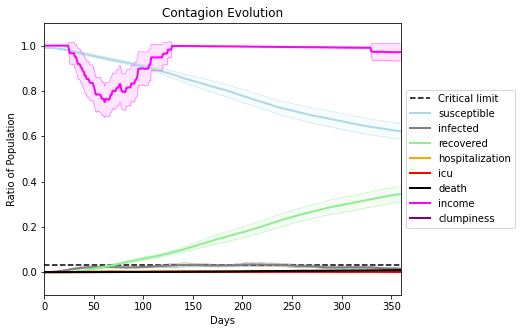

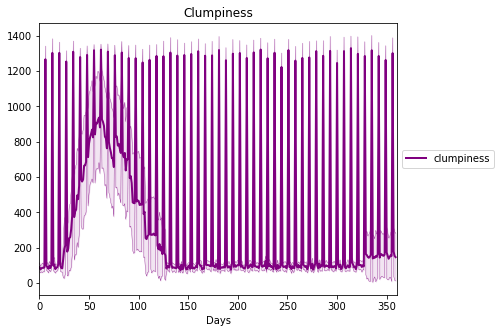

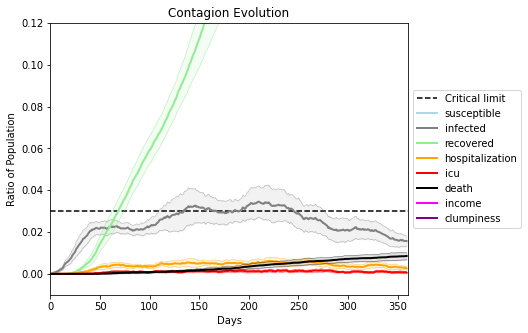

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5829, 1456, 5126, 7118, 8252, 9625, 7149, 4818, 5562, 4822, 1811, 6332, 9565, 5354, 6160, 3125, 4160, 7305, 161, 4669]
Average similarity between family members is 0.9208959439817509 at temperature -0.991
Average similarity between family and home is 0.9998554743872795 at temperature -1
Average similarity between students and their classroom is 0.8241222593548662 at temperature -0.991
Average classroom occupancy is 1.6197916666666667 and number classrooms is 192
Average similarity between workers is 0.8365330002133929 at temperature -0.991
Average office occupancy is 3.312820512820513 and number offices is 195
Average friend similarity for adults: 0.8406950405916852 for kids: 0.7399999468575723
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.5398231991219135
avg restaurant similarity 0.5469694874292662
avg restaurant similarity 0.508398845128034
avg restaurant similarity 0.5186244205410743
avg restaurant similarity 0.497846706973538
avg restaurant similarity 0.5491637731595892
avg restaurant similarity 0.5608238899155676
avg restaurant similarity 0.5580626486728151
avg restaurant similarity 0.5288452710721837
avg restaurant similarity 0.5601526567208687
avg restaurant similarity 0.5320852526789953
avg restaurant similarity 0.5359217325261741
avg restaurant similarity 0.5232896333258005
avg restaurant similarity 0.5305608213026014
avg restaurant similarity 0.5402956347699962
avg restaurant similarity 0.47450575563049785
avg restaurant similarity 0.5222732267484191
avg restaurant similarity 0.5321213927886637
avg restaurant similarity 0.5689488092190423
avg restaurant similarity 0.544265712512496
avg restaurant similarity 0.48198517634837523
avg restaurant similarity 0.5881504671740978
avg restaur

avg restaurant similarity 0.48318772212772365
avg restaurant similarity 0.5545488608348138
avg restaurant similarity 0.5062427088942801
avg restaurant similarity 0.4906096451073694
avg restaurant similarity 0.5359304508350617
avg restaurant similarity 0.5626637012571436
avg restaurant similarity 0.5489483061868342
avg restaurant similarity 0.5424789407688008
avg restaurant similarity 0.5418663769384684
avg restaurant similarity 0.5955443115992399
avg restaurant similarity 0.5521394805689103
avg restaurant similarity 0.5337453166860828
avg restaurant similarity 0.5226569661909479
avg restaurant similarity 0.5540524064961893
avg restaurant similarity 0.5178760243046165
avg restaurant similarity 0.539075650200007
avg restaurant similarity 0.525228345349998
avg restaurant similarity 0.5472458668426271
avg restaurant similarity 0.5753558625581483
avg restaurant similarity 0.5819769339675546
avg restaurant similarity 0.5403453244828413
avg restaurant similarity 0.5286685357700073
avg restaur

Average similarity between workers is 0.8299199629793798 at temperature -0.991
Average office occupancy is 3.36318407960199 and number offices is 201
Average friend similarity for adults: 0.8358587482965523 for kids: 0.7092150207967043
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 peo

avg restaurant similarity 0.5134592562784017
avg restaurant similarity 0.4853187792168311
avg restaurant similarity 0.5091426210304225
avg restaurant similarity 0.5850334797156015
avg restaurant similarity 0.5093607813395294
avg restaurant similarity 0.5399271299387985
avg restaurant similarity 0.5476778492255118
avg restaurant similarity 0.5925795347157604
avg restaurant similarity 0.5203786582489829
avg restaurant similarity 0.5332423003239866
avg restaurant similarity 0.5440609415237107
avg restaurant similarity 0.561099696442148
avg restaurant similarity 0.5222623706486327
avg restaurant similarity 0.5657561906778681
avg restaurant similarity 0.5600821884927752
avg restaurant similarity 0.5551393781026601
avg restaurant similarity 0.5651794152596453
avg restaurant similarity 0.5672492046613704
avg restaurant similarity 0.5377297731975326
avg restaurant similarity 0.5322638234710397
avg restaurant similarity 0.5368061463413223
avg restaurant similarity 0.5499152088327072
avg restaur

avg restaurant similarity 0.5366405741558571
avg restaurant similarity 0.575877567387222
avg restaurant similarity 0.5180434200972924
avg restaurant similarity 0.547303640737677
avg restaurant similarity 0.5614884009813894
avg restaurant similarity 0.5512714598967918
avg restaurant similarity 0.5337824644569259
avg restaurant similarity 0.4796549298643389
avg restaurant similarity 0.5262645757888385
avg restaurant similarity 0.51251831677284
avg restaurant similarity 0.5611941889038731
avg restaurant similarity 0.5274822559679886
avg restaurant similarity 0.5441060527414922
avg restaurant similarity 0.4644304487611807
avg restaurant similarity 0.5337462442060196
avg restaurant similarity 0.5594469241537652
avg restaurant similarity 0.5377243534885483
avg restaurant similarity 0.5276750795705346
avg restaurant similarity 0.5972203819360583
avg restaurant similarity 0.5431987590510219
avg restaurant similarity 0.5506476106323508
avg restaurant similarity 0.52907282430645
avg restaurant s

Average similarity between workers is 0.8383721238319388 at temperature -0.991
Average office occupancy is 3.3989637305699483 and number offices is 193
Average friend similarity for adults: 0.8401674721824721 for kids: 0.7227051198480675
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.4147978896653946
avg restaurant similarity 0.5383806976535856
avg restaurant similarity 0.5009093034269865
avg restaurant similarity 0.5418023652790104
avg restaurant similarity 0.4888220966200652
avg restaurant similarity 0.5692222442021514
avg restaurant similarity 0.5044700930833831
avg restaurant similarity 0.5328310896748715
avg restaurant similarity 0.42026846852179855
avg restaurant similarity 0.5148195719687738
avg restaurant similarity 0.5090568497571853
avg restaurant similarity 0.45188562773101204
avg restaurant similarity 0.4987200775009321
avg restaurant similarity 0.5876588623746201
avg restaurant similarity 0.4795693397656479
avg restaurant similarity 0.5602077110363664
avg restaurant similarity 0.5302578971332962
avg restaurant similarity 0.4599884313302431
avg restaurant similarity 0.48693810733439696
avg restaurant similarity 0.44160503246283483
avg restaurant similarity 0.5046303444164197
avg restaurant similarity 0.4300492619670164
avg re

avg restaurant similarity 0.5336397624420639
avg restaurant similarity 0.46049683989355394
avg restaurant similarity 0.5777144769487654
avg restaurant similarity 0.48764164046197594
avg restaurant similarity 0.4370272175414109
avg restaurant similarity 0.5461137275632072
avg restaurant similarity 0.49427823175253816
avg restaurant similarity 0.5393371022922527
avg restaurant similarity 0.5150982705482572
avg restaurant similarity 0.5069687511445481
avg restaurant similarity 0.5226119820081802
avg restaurant similarity 0.4679074036741851
avg restaurant similarity 0.5547267325704691
avg restaurant similarity 0.46836967545223046
avg restaurant similarity 0.5110256305107646
avg restaurant similarity 0.5276654383052485
avg restaurant similarity 0.5748379846112119
avg restaurant similarity 0.5477612169300522
avg restaurant similarity 0.514065957598008
avg restaurant similarity 0.46775199151647345
avg restaurant similarity 0.5382277126956183
avg restaurant similarity 0.49669071959345007
avg r

Average similarity between workers is 0.8405485188883453 at temperature -0.991
Average office occupancy is 3.3115577889447234 and number offices is 199
Average friend similarity for adults: 0.8375171566613789 for kids: 0.7399387441287578
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5245684875185797
avg restaurant similarity 0.4925864580381698
avg restaurant similarity 0.49178724549133207
avg restaurant similarity 0.5600201426555008
avg restaurant similarity 0.577115492181438
avg restaurant similarity 0.5479140246292766
avg restaurant similarity 0.45741792123440217
avg restaurant similarity 0.5792754200162746
avg restaurant similarity 0.513391465469658
avg restaurant similarity 0.5463308683368223
avg restaurant similarity 0.5418936423489084
avg restaurant similarity 0.4992254640676744
avg restaurant similarity 0.5415538510146515
avg restaurant similarity 0.5001821288196043
avg restaurant similarity 0.5140351994162294
avg restaurant similarity 0.5391204013327273
avg restaurant similarity 0.5134464236427445
avg restaurant similarity 0.5785617288677223
avg restaurant similarity 0.5474104558217086
avg restaurant similarity 0.5296455512653881
avg restaurant similarity 0.5103397602081906
avg restaurant similarity 0.5370278860314449
avg restau

avg restaurant similarity 0.5090019372960134
avg restaurant similarity 0.5179583364922277
avg restaurant similarity 0.5032861911613361
avg restaurant similarity 0.5072364459445979
avg restaurant similarity 0.5067540812618062
avg restaurant similarity 0.47755536595569104
avg restaurant similarity 0.5428577662773355
avg restaurant similarity 0.5236298746960784
avg restaurant similarity 0.4496238449348416
avg restaurant similarity 0.5469556773295825
avg restaurant similarity 0.5331411644518372
avg restaurant similarity 0.5695491998748524
avg restaurant similarity 0.516995395274424
avg restaurant similarity 0.5340362280907122
avg restaurant similarity 0.541478229598476
avg restaurant similarity 0.5028735063917223
avg restaurant similarity 0.5226413272875169
avg restaurant similarity 0.5265897884945835
avg restaurant similarity 0.5545590282049607
avg restaurant similarity 0.5247645562894651
avg restaurant similarity 0.5476111588161476
avg restaurant similarity 0.5094512190340352
avg restaur

Average similarity between workers is 0.8222594018455808 at temperature -0.991
Average office occupancy is 3.357142857142857 and number offices is 196
Average friend similarity for adults: 0.8335327454425937 for kids: 0.7199765380285489
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.49701282009642045
avg restaurant similarity 0.4917842967902789
avg restaurant similarity 0.44873356657531693
avg restaurant similarity 0.5071393839460908
avg restaurant similarity 0.44478831952577946
avg restaurant similarity 0.4751802778759766
avg restaurant similarity 0.5011057499308923
avg restaurant similarity 0.5034235180351496
avg restaurant similarity 0.4611610328473834
avg restaurant similarity 0.5218332277997327
avg restaurant similarity 0.48048226929414783
avg restaurant similarity 0.5101712894926486
avg restaurant similarity 0.5449469446813665
avg restaurant similarity 0.5105874787287467
avg restaurant similarity 0.512495909830072
avg restaurant similarity 0.5247739202336958
avg restaurant similarity 0.4733448283283616
avg restaurant similarity 0.4770082555801656
avg restaurant similarity 0.5013780785696137
avg restaurant similarity 0.4953678874117635
avg restaurant similarity 0.5492028286408308
avg restaurant similarity 0.5003892197075275
avg res

avg restaurant similarity 0.4833681719888788
avg restaurant similarity 0.46479972938071906
avg restaurant similarity 0.49399191001397214
avg restaurant similarity 0.5506239638164314
avg restaurant similarity 0.4639114358538504
avg restaurant similarity 0.5487740243267932
avg restaurant similarity 0.48022541168097294
avg restaurant similarity 0.5101140984253728
avg restaurant similarity 0.4688028931505098
avg restaurant similarity 0.48826463842604395
avg restaurant similarity 0.4809568181970844
avg restaurant similarity 0.49010648534158235
avg restaurant similarity 0.5510088722361539
avg restaurant similarity 0.5015563426461028
avg restaurant similarity 0.5087976300791842
avg restaurant similarity 0.5000777773572352
avg restaurant similarity 0.5497555544847887
avg restaurant similarity 0.5103538808355661
avg restaurant similarity 0.5247351911306756
avg restaurant similarity 0.4894034050181202
avg restaurant similarity 0.549328080911907
avg restaurant similarity 0.45482732901574985
avg r

Average similarity between workers is 0.8470799521121088 at temperature -0.991
Average office occupancy is 3.2786069651741294 and number offices is 201
Average friend similarity for adults: 0.8397992896115621 for kids: 0.7183527914621272
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.5220380827024841
avg restaurant similarity 0.4834833546251629
avg restaurant similarity 0.5588361012945604
avg restaurant similarity 0.5759393985157939
avg restaurant similarity 0.49256503057045237
avg restaurant similarity 0.5780468518031486
avg restaurant similarity 0.5590958956525617
avg restaurant similarity 0.4870467103704937
avg restaurant similarity 0.4533209110874782
avg restaurant similarity 0.5409815648386324
avg restaurant similarity 0.5137492704612202
avg restaurant similarity 0.517546996937305
avg restaurant similarity 0.5496001392149461
avg restaurant similarity 0.5651005060374175
avg restaurant similarity 0.5386871981961725
avg restaurant similarity 0.5468325638620856
avg restaurant similarity 0.5927740901465675
avg restaurant similarity 0.5423878515685346
avg restaurant similarity 0.5195972554073343
avg restaurant similarity 0.5419857801221611
avg restaurant similarity 0.4983975771088692
avg restaurant similarity 0.49433103258958727
avg resta

avg restaurant similarity 0.5557960253938183
avg restaurant similarity 0.5242874729257012
avg restaurant similarity 0.5055561760039714
avg restaurant similarity 0.5605750077192656
avg restaurant similarity 0.5258639297624184
avg restaurant similarity 0.5043515582004956
avg restaurant similarity 0.5275531439280239
avg restaurant similarity 0.5159694175779981
avg restaurant similarity 0.5111089505438109
avg restaurant similarity 0.522503363007462
avg restaurant similarity 0.5449756949630924
avg restaurant similarity 0.5024981726983967
avg restaurant similarity 0.5547666344614712
avg restaurant similarity 0.5248863625162901
avg restaurant similarity 0.5335705235694923
avg restaurant similarity 0.5520892503918177
avg restaurant similarity 0.5316197261209848
avg restaurant similarity 0.5979897120308499
avg restaurant similarity 0.5752629199294189
avg restaurant similarity 0.5648779950328815
avg restaurant similarity 0.6089239619679044
avg restaurant similarity 0.5308685322789657
avg restaur

Average similarity between workers is 0.8405404609796632 at temperature -0.991
Average office occupancy is 3.49468085106383 and number offices is 188
Average friend similarity for adults: 0.8389322314578973 for kids: 0.7216670627259837
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.5898277491687313
avg restaurant similarity 0.5207280010002322
avg restaurant similarity 0.5554581465182832
avg restaurant similarity 0.5349570820505263
avg restaurant similarity 0.5822551902412098
avg restaurant similarity 0.5422799954987907
avg restaurant similarity 0.5500441057184796
avg restaurant similarity 0.538232691324179
avg restaurant similarity 0.5039861716439552
avg restaurant similarity 0.5451451990694227
avg restaurant similarity 0.5511855269015029
avg restaurant similarity 0.5625244979180103
avg restaurant similarity 0.5993124778667231
avg restaurant similarity 0.5531821849465568
avg restaurant similarity 0.5635065903012555
avg restaurant similarity 0.5166740741186779
avg restaurant similarity 0.5278088662272163
avg restaurant similarity 0.5384364477858642
avg restaurant similarity 0.5383159548890423
avg restaurant similarity 0.5464809227419519
avg restaurant similarity 0.5317896714958937
avg restaurant similarity 0.5175610291847752
avg restaur

avg restaurant similarity 0.5356607462216126
avg restaurant similarity 0.5613492901757045
avg restaurant similarity 0.5619073759062961
avg restaurant similarity 0.49487415434442983
avg restaurant similarity 0.5297914800023956
avg restaurant similarity 0.5634037071222423
avg restaurant similarity 0.5323858775801181
avg restaurant similarity 0.56528425346318
avg restaurant similarity 0.5488721607330334
avg restaurant similarity 0.5289520248905698
avg restaurant similarity 0.5752234541848916
avg restaurant similarity 0.5494598681706587
avg restaurant similarity 0.5359149110253221
avg restaurant similarity 0.5198689883112089
avg restaurant similarity 0.542969641705848
avg restaurant similarity 0.5417262252305951
avg restaurant similarity 0.5198883779665958
avg restaurant similarity 0.553256509092061
avg restaurant similarity 0.5715912197929275
avg restaurant similarity 0.532493701008604
avg restaurant similarity 0.5518390715738162
avg restaurant similarity 0.5157286919998638
avg restaurant

Average similarity between workers is 0.83113882272296 at temperature -0.991
Average office occupancy is 3.317948717948718 and number offices is 195
Average friend similarity for adults: 0.8308418482355391 for kids: 0.7120498628234885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.4601115519199589
avg restaurant similarity 0.4556227429506493
avg restaurant similarity 0.562805839500517
avg restaurant similarity 0.47632878725594696
avg restaurant similarity 0.4896031359915361
avg restaurant similarity 0.46744129219284875
avg restaurant similarity 0.5122076402334014
avg restaurant similarity 0.49313063582574884
avg restaurant similarity 0.4659276580890092
avg restaurant similarity 0.4808679576444672
avg restaurant similarity 0.45930804120397895
avg restaurant similarity 0.5409374794052214
avg restaurant similarity 0.5209396677162303
avg restaurant similarity 0.5422960414389364
avg restaurant similarity 0.5312832339876192
avg restaurant similarity 0.504801277200262
avg restaurant similarity 0.4712185738552267
avg restaurant similarity 0.5211422818097031
avg restaurant similarity 0.48273680975455485
avg restaurant similarity 0.5239012758513344
avg restaurant similarity 0.49480907903695404
avg restaurant similarity 0.5293300472036915
avg re

avg restaurant similarity 0.5205986918031353
avg restaurant similarity 0.5083760006762247
avg restaurant similarity 0.5447924035016973
avg restaurant similarity 0.48985623949351653
avg restaurant similarity 0.4819468539111438
avg restaurant similarity 0.48675438695586926
avg restaurant similarity 0.5047574729575979
avg restaurant similarity 0.5038443656690241
avg restaurant similarity 0.46273789940142596
avg restaurant similarity 0.48347393140549105
avg restaurant similarity 0.4566526969887342
avg restaurant similarity 0.4691646853469702
avg restaurant similarity 0.4989604245192021
avg restaurant similarity 0.5055881619582332
avg restaurant similarity 0.48451619784289907
avg restaurant similarity 0.47608080899606064
avg restaurant similarity 0.4679166664302117
avg restaurant similarity 0.48491553353982664
avg restaurant similarity 0.45827711736770016
avg restaurant similarity 0.5203990939272126
avg restaurant similarity 0.4961668310892411
avg restaurant similarity 0.48512123337980234
a

Average similarity between workers is 0.8467482277498117 at temperature -0.991
Average office occupancy is 3.197969543147208 and number offices is 197
Average friend similarity for adults: 0.835051185263168 for kids: 0.7382104556496127
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.5601065115184858
avg restaurant similarity 0.5686162820782665
avg restaurant similarity 0.5798727251572807
avg restaurant similarity 0.5571524212505629
avg restaurant similarity 0.5320033406630389
avg restaurant similarity 0.5126838779532632
avg restaurant similarity 0.5957064460881281
avg restaurant similarity 0.5273574244387468
avg restaurant similarity 0.6197372485836494
avg restaurant similarity 0.5718658087190444
avg restaurant similarity 0.5480326689507524
avg restaurant similarity 0.5775602709999991
avg restaurant similarity 0.5511328659517997
avg restaurant similarity 0.511814756817141
avg restaurant similarity 0.6124286547144248
avg restaurant similarity 0.5596987181918568
avg restaurant similarity 0.5100940900927279
avg restaurant similarity 0.53821869562594
avg restaurant similarity 0.6022477426783281
avg restaurant similarity 0.502053819879288
avg restaurant similarity 0.5146404783767676
avg restaurant similarity 0.5288237823634963
avg restaurant

avg restaurant similarity 0.5362110458203201
avg restaurant similarity 0.583303458179487
avg restaurant similarity 0.4830192822660384
avg restaurant similarity 0.5004967965644935
avg restaurant similarity 0.48095781252403047
avg restaurant similarity 0.5463912336310903
avg restaurant similarity 0.5499628746533082
avg restaurant similarity 0.520894688882515
avg restaurant similarity 0.5081045521888908
avg restaurant similarity 0.5604444399164942
avg restaurant similarity 0.5275481960263494
avg restaurant similarity 0.5533942995417593
avg restaurant similarity 0.5795327134354119
avg restaurant similarity 0.5243453699128039
avg restaurant similarity 0.5553128426821499
avg restaurant similarity 0.5663722942223036
avg restaurant similarity 0.5329634270696766
avg restaurant similarity 0.5311926166218627
avg restaurant similarity 0.4753914239913923
avg restaurant similarity 0.5411241950347936
avg restaurant similarity 0.5349325154132357
avg restaurant similarity 0.5925912048117414
avg restaur

Average similarity between workers is 0.833502774917585 at temperature -0.991
Average office occupancy is 3.431578947368421 and number offices is 190
Average friend similarity for adults: 0.8330892728818414 for kids: 0.7236911262010485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.5594644502892251
avg restaurant similarity 0.5545430059138354
avg restaurant similarity 0.5402512186997408
avg restaurant similarity 0.5208637000106487
avg restaurant similarity 0.5647197630856838
avg restaurant similarity 0.5736043302353154
avg restaurant similarity 0.5367751683397419
avg restaurant similarity 0.547400696857878
avg restaurant similarity 0.5448798102676872
avg restaurant similarity 0.5678008538312179
avg restaurant similarity 0.5763228424849968
avg restaurant similarity 0.5752652269380941
avg restaurant similarity 0.5533567453783819
avg restaurant similarity 0.5823774189967009
avg restaurant similarity 0.4950551776192924
avg restaurant similarity 0.5778787435220823
avg restaurant similarity 0.534820491078907
avg restaurant similarity 0.5220289041145312
avg restaurant similarity 0.5726417694737101
avg restaurant similarity 0.5266442520645316
avg restaurant similarity 0.5936693829750481
avg restaurant similarity 0.5507409124892638
avg restaura

avg restaurant similarity 0.5240840232348651
avg restaurant similarity 0.49830893131489107
avg restaurant similarity 0.5233951724705616
avg restaurant similarity 0.5748993511551217
avg restaurant similarity 0.5140421970927295
avg restaurant similarity 0.5789058130015485
avg restaurant similarity 0.5110359613049533
avg restaurant similarity 0.5543710004119956
avg restaurant similarity 0.5734785242731021
avg restaurant similarity 0.5747224130824643
avg restaurant similarity 0.5161238340357782
avg restaurant similarity 0.537420479711997
avg restaurant similarity 0.5476204691803449
avg restaurant similarity 0.5750916488468224
avg restaurant similarity 0.5064576632285646
avg restaurant similarity 0.5307389403592633
avg restaurant similarity 0.5567826488280381
avg restaurant similarity 0.5944621676459162
avg restaurant similarity 0.5356368259387301
avg restaurant similarity 0.5368146966035904
avg restaurant similarity 0.5966107026605055
avg restaurant similarity 0.5473260510712401
avg restau

Average similarity between workers is 0.8093755339524649 at temperature -0.991
Average office occupancy is 3.4814814814814814 and number offices is 189
Average friend similarity for adults: 0.8269197426282695 for kids: 0.7225890865142003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5332092179752439
avg restaurant similarity 0.5181022228423507
avg restaurant similarity 0.509056966413367
avg restaurant similarity 0.48180347266102413
avg restaurant similarity 0.5332023832312455
avg restaurant similarity 0.54355310906014
avg restaurant similarity 0.48548885265794867
avg restaurant similarity 0.5130643784052615
avg restaurant similarity 0.5309088060273393
avg restaurant similarity 0.5160342229020856
avg restaurant similarity 0.5292894225689467
avg restaurant similarity 0.5600585323837461
avg restaurant similarity 0.4830418059344578
avg restaurant similarity 0.4885441134414626
avg restaurant similarity 0.5204611487025116
avg restaurant similarity 0.5058206782154717
avg restaurant similarity 0.49482685308551727
avg restaurant similarity 0.5306489338106674
avg restaurant similarity 0.5539633009542225
avg restaurant similarity 0.4899240844664857
avg restaurant similarity 0.4992782028535592
avg restaurant similarity 0.4519132110579416
avg restau

avg restaurant similarity 0.5179129915311333
avg restaurant similarity 0.49005280763886283
avg restaurant similarity 0.512695166381392
avg restaurant similarity 0.5443759028709311
avg restaurant similarity 0.508394831585465
avg restaurant similarity 0.5022204513674484
avg restaurant similarity 0.4798640750195606
avg restaurant similarity 0.4724176502700349
avg restaurant similarity 0.5238151162641528
avg restaurant similarity 0.48219958968151827
avg restaurant similarity 0.5071682182717561
avg restaurant similarity 0.5055233055710457
avg restaurant similarity 0.5037932100109126
avg restaurant similarity 0.5053956748558733
avg restaurant similarity 0.4738808703436751
avg restaurant similarity 0.5052636016922076
avg restaurant similarity 0.5229987201784921
avg restaurant similarity 0.5151437209375099
avg restaurant similarity 0.5472172670901169
avg restaurant similarity 0.5065456323894474
avg restaurant similarity 0.5458262764648221
avg restaurant similarity 0.5214569935612092
avg restau

Average similarity between workers is 0.8399270834983268 at temperature -0.991
Average office occupancy is 3.463917525773196 and number offices is 194
Average friend similarity for adults: 0.8430003601590952 for kids: 0.717009737371666
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.4792230624867553
avg restaurant similarity 0.4975425751671719
avg restaurant similarity 0.4776961879923232
avg restaurant similarity 0.48841600740661084
avg restaurant similarity 0.509748504058591
avg restaurant similarity 0.514707480884369
avg restaurant similarity 0.540723434927833
avg restaurant similarity 0.5394224524440464
avg restaurant similarity 0.4865191411145441
avg restaurant similarity 0.5135768053155723
avg restaurant similarity 0.5020884300467646
avg restaurant similarity 0.5213822683750547
avg restaurant similarity 0.5027811348669099
avg restaurant similarity 0.5066214943298124
avg restaurant similarity 0.4972324958033406
avg restaurant similarity 0.500867749872532
avg restaurant similarity 0.5175661580581271
avg restaurant similarity 0.5418393148870706
avg restaurant similarity 0.4631217788445101
avg restaurant similarity 0.49896846707131287
avg restaurant similarity 0.5450272082158093
avg restaurant similarity 0.5280649532106643
avg restaura

avg restaurant similarity 0.5253038224624756
avg restaurant similarity 0.5052966150539812
avg restaurant similarity 0.5119064223891943
avg restaurant similarity 0.5123422054525447
avg restaurant similarity 0.4942891876363287
avg restaurant similarity 0.5231868104849837
avg restaurant similarity 0.5380144395161456
avg restaurant similarity 0.5088560208233895
avg restaurant similarity 0.5475672641039336
avg restaurant similarity 0.5141315603855238
avg restaurant similarity 0.4891772915980707
avg restaurant similarity 0.49327478968264415
avg restaurant similarity 0.5438498919444749
avg restaurant similarity 0.5075707930172458
avg restaurant similarity 0.5086315620015384
avg restaurant similarity 0.541645419651574
avg restaurant similarity 0.5192917376623981
avg restaurant similarity 0.4871423557405837
avg restaurant similarity 0.48250800272431005
avg restaurant similarity 0.5129413386814702
avg restaurant similarity 0.5481923505563184
avg restaurant similarity 0.4840440398805385
avg resta

Average similarity between workers is 0.8249181954114914 at temperature -0.991
Average office occupancy is 3.3548387096774195 and number offices is 186
Average friend similarity for adults: 0.8297348655764414 for kids: 0.7440323123575195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5526295250857504
avg restaurant similarity 0.5650978083204199
avg restaurant similarity 0.5585957807206983
avg restaurant similarity 0.5601233893788456
avg restaurant similarity 0.5505467928199781
avg restaurant similarity 0.6002137278334951
avg restaurant similarity 0.5413331590072132
avg restaurant similarity 0.5234409582755755
avg restaurant similarity 0.5509174643749617
avg restaurant similarity 0.5048305041379695
avg restaurant similarity 0.5785241043003623
avg restaurant similarity 0.5528984313895844
avg restaurant similarity 0.5794705868806754
avg restaurant similarity 0.5659316194724896
avg restaurant similarity 0.5938252703984637
avg restaurant similarity 0.5623039332487758
avg restaurant similarity 0.5475551980375857
avg restaurant similarity 0.5866836047665871
avg restaurant similarity 0.542109542393617
avg restaurant similarity 0.5887426658682628
avg restaurant similarity 0.5406202299538787
avg restaurant similarity 0.5769411501367293
avg restaur

avg restaurant similarity 0.5960856688257672
avg restaurant similarity 0.5875486088924774
avg restaurant similarity 0.5723782382936332
avg restaurant similarity 0.6044236479454427
avg restaurant similarity 0.5468953569306922
avg restaurant similarity 0.5816927111312666
avg restaurant similarity 0.5652658449982249
avg restaurant similarity 0.5533868798467374
avg restaurant similarity 0.5808059083131812
avg restaurant similarity 0.575504876698699
avg restaurant similarity 0.5732962842201796
avg restaurant similarity 0.5929270893798151
avg restaurant similarity 0.5706156139512297
avg restaurant similarity 0.5654407803991351
avg restaurant similarity 0.5845716117867084
avg restaurant similarity 0.5475178167698302
avg restaurant similarity 0.5620387731223919
avg restaurant similarity 0.5524354989949591
avg restaurant similarity 0.5653338974397314
avg restaurant similarity 0.5585512973324718
avg restaurant similarity 0.5382075410836311
avg restaurant similarity 0.5450692407113982
avg restaur

Average similarity between workers is 0.8437483601921407 at temperature -0.991
Average office occupancy is 3.2422680412371134 and number offices is 194
Average friend similarity for adults: 0.8349323256425774 for kids: 0.7273364692536786
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.4980060264650118
avg restaurant similarity 0.5197787099967474
avg restaurant similarity 0.5353335036004332
avg restaurant similarity 0.4887842563228358
avg restaurant similarity 0.4899226928621591
avg restaurant similarity 0.5723121365980818
avg restaurant similarity 0.5253215547533997
avg restaurant similarity 0.508962895697727
avg restaurant similarity 0.5039815151617383
avg restaurant similarity 0.45415307094692264
avg restaurant similarity 0.5038758746205961
avg restaurant similarity 0.49462326312561306
avg restaurant similarity 0.526965335204697
avg restaurant similarity 0.5219126981871782
avg restaurant similarity 0.4983387979121817
avg restaurant similarity 0.45804848179672786
avg restaurant similarity 0.46957289731995755
avg restaurant similarity 0.48486042042292643
avg restaurant similarity 0.5118142877418987
avg restaurant similarity 0.5475432926606312
avg restaurant similarity 0.5045335348319193
avg restaurant similarity 0.5445863700448967
avg res

avg restaurant similarity 0.4863930169520723
avg restaurant similarity 0.5287822299095606
avg restaurant similarity 0.4889325121143338
avg restaurant similarity 0.4942735233893385
avg restaurant similarity 0.5345311765006341
avg restaurant similarity 0.5180433413389408
avg restaurant similarity 0.5007723856881054
avg restaurant similarity 0.4498447873140132
avg restaurant similarity 0.5582785134412827
avg restaurant similarity 0.5065509522967174
avg restaurant similarity 0.5261386911584264
avg restaurant similarity 0.5216656950933966
avg restaurant similarity 0.5212816711002781
avg restaurant similarity 0.5227821333370897
avg restaurant similarity 0.5197253369089871
avg restaurant similarity 0.5138820087342875
avg restaurant similarity 0.48114241488172144
avg restaurant similarity 0.4851801645828984
avg restaurant similarity 0.4939569657525319
avg restaurant similarity 0.523375078825232
avg restaurant similarity 0.49643435873324415
avg restaurant similarity 0.4886685923865319
avg resta

Average similarity between workers is 0.8379690703879713 at temperature -0.991
Average office occupancy is 3.479381443298969 and number offices is 194
Average friend similarity for adults: 0.839136119786802 for kids: 0.7138147018589682
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.513490042237152
avg restaurant similarity 0.48690648904200023
avg restaurant similarity 0.568402605952992
avg restaurant similarity 0.4724510471964871
avg restaurant similarity 0.4891405004892695
avg restaurant similarity 0.5403735579718902
avg restaurant similarity 0.4911593254120076
avg restaurant similarity 0.4923793410368451
avg restaurant similarity 0.4908870269245488
avg restaurant similarity 0.5444635455017294
avg restaurant similarity 0.525991884725769
avg restaurant similarity 0.5456318557723616
avg restaurant similarity 0.5349279048271288
avg restaurant similarity 0.5317037862413626
avg restaurant similarity 0.5256642666124768
avg restaurant similarity 0.5251133736537316
avg restaurant similarity 0.47866813245906076
avg restaurant similarity 0.5732507154157934
avg restaurant similarity 0.49414994757174224
avg restaurant similarity 0.506732469200889
avg restaurant similarity 0.5333994178924709
avg restaurant similarity 0.4823885199131655
avg restaur

avg restaurant similarity 0.5178503231274443
avg restaurant similarity 0.5213606217743186
avg restaurant similarity 0.4634745136359872
avg restaurant similarity 0.5499626055576669
avg restaurant similarity 0.5232831157652308
avg restaurant similarity 0.4731575708515999
avg restaurant similarity 0.4789051400095386
avg restaurant similarity 0.4752805010951819
avg restaurant similarity 0.47736591825130625
avg restaurant similarity 0.5087169876465503
avg restaurant similarity 0.5007473612298181
avg restaurant similarity 0.48863070149524784
avg restaurant similarity 0.5025338806847254
avg restaurant similarity 0.520229064614735
avg restaurant similarity 0.5008235956061791
avg restaurant similarity 0.5025599738682972
avg restaurant similarity 0.4674641832326818
avg restaurant similarity 0.517519663449571
avg restaurant similarity 0.47102670075913017
avg restaurant similarity 0.5068073946000726
avg restaurant similarity 0.46999467326917604
avg restaurant similarity 0.5460896140141345
avg rest

Average similarity between workers is 0.8253916589037231 at temperature -0.991
Average office occupancy is 3.314432989690722 and number offices is 194
Average friend similarity for adults: 0.8358700552970605 for kids: 0.7230031156659898
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5010882935951648
avg restaurant similarity 0.5538789618707519
avg restaurant similarity 0.5136813609050875
avg restaurant similarity 0.5251523733548376
avg restaurant similarity 0.511363139761936
avg restaurant similarity 0.5821161696587928
avg restaurant similarity 0.47186800363959946
avg restaurant similarity 0.5360600764055686
avg restaurant similarity 0.5171018103942069
avg restaurant similarity 0.5217416469703234
avg restaurant similarity 0.5405671544833144
avg restaurant similarity 0.5984751332482388
avg restaurant similarity 0.5114533921501281
avg restaurant similarity 0.5136522209599172
avg restaurant similarity 0.49334227060614505
avg restaurant similarity 0.5442545989565397
avg restaurant similarity 0.5632425068835302
avg restaurant similarity 0.4908426211722681
avg restaurant similarity 0.5857959819803915
avg restaurant similarity 0.5415949805676091
avg restaurant similarity 0.5322618222447321
avg restaurant similarity 0.5077206618156545
avg resta

avg restaurant similarity 0.5226829190458646
avg restaurant similarity 0.5000257378269808
avg restaurant similarity 0.5197599621466519
avg restaurant similarity 0.5136481460668282
avg restaurant similarity 0.49598933177255755
avg restaurant similarity 0.517888633728502
avg restaurant similarity 0.4719225865190617
avg restaurant similarity 0.560002445370976
avg restaurant similarity 0.5250758808856005
avg restaurant similarity 0.5214471565646948
avg restaurant similarity 0.515827800850666
avg restaurant similarity 0.5042176558478083
avg restaurant similarity 0.5306229152521276
avg restaurant similarity 0.5381843660061549
avg restaurant similarity 0.5468248110493719
avg restaurant similarity 0.5236594778362571
avg restaurant similarity 0.4785901782318518
avg restaurant similarity 0.49485473804940655
avg restaurant similarity 0.4733866302751278
avg restaurant similarity 0.5089380544200515
avg restaurant similarity 0.5128435546034291
avg restaurant similarity 0.5570390038888802
avg restaur

Average similarity between workers is 0.8432983470219829 at temperature -0.991
Average office occupancy is 3.405128205128205 and number offices is 195
Average friend similarity for adults: 0.8432411462969751 for kids: 0.7177556284309029
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.5093751695499135
avg restaurant similarity 0.5124027904779931
avg restaurant similarity 0.5279194382437131
avg restaurant similarity 0.4931099920345688
avg restaurant similarity 0.5223236623944368
avg restaurant similarity 0.4664152579079886
avg restaurant similarity 0.48170665929032974
avg restaurant similarity 0.48019829316375473
avg restaurant similarity 0.49189947816534946
avg restaurant similarity 0.5414650417812666
avg restaurant similarity 0.5272570027066895
avg restaurant similarity 0.4681665068474767
avg restaurant similarity 0.5500533040699717
avg restaurant similarity 0.4684509763306559
avg restaurant similarity 0.5035186664018179
avg restaurant similarity 0.510856814053492
avg restaurant similarity 0.5030368779872789
avg restaurant similarity 0.4658180250657042
avg restaurant similarity 0.49722313043637223
avg restaurant similarity 0.45050146006836145
avg restaurant similarity 0.5226993305936267
avg restaurant similarity 0.5136356585822748
avg re

avg restaurant similarity 0.4735252409572316
avg restaurant similarity 0.5148452198868446
avg restaurant similarity 0.5563618459473928
avg restaurant similarity 0.5245121000762105
avg restaurant similarity 0.5284450991654266
avg restaurant similarity 0.508203338723021
avg restaurant similarity 0.5238253113295783
avg restaurant similarity 0.5192999081223164
avg restaurant similarity 0.47770262520178425
avg restaurant similarity 0.49284082529037937
avg restaurant similarity 0.5324384132364912
avg restaurant similarity 0.49026696935041963
avg restaurant similarity 0.5373343960549338
avg restaurant similarity 0.4713647774534845
avg restaurant similarity 0.4980223050488768
avg restaurant similarity 0.544214036731514
avg restaurant similarity 0.5539486759063288
avg restaurant similarity 0.48377311709462906
avg restaurant similarity 0.4819305288849267
avg restaurant similarity 0.5466686163691352
avg restaurant similarity 0.5562163018415351
avg restaurant similarity 0.5704200730295024
avg rest

Average similarity between workers is 0.8330427601379268 at temperature -0.991
Average office occupancy is 3.377551020408163 and number offices is 196
Average friend similarity for adults: 0.8325173382677502 for kids: 0.7235182326071099
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5030054018804015
avg restaurant similarity 0.574654012230937
avg restaurant similarity 0.5300464397407416
avg restaurant similarity 0.5074056426928394
avg restaurant similarity 0.583703615916545
avg restaurant similarity 0.5534687640498384
avg restaurant similarity 0.5444880713970389
avg restaurant similarity 0.5724819034941192
avg restaurant similarity 0.5495663262289873
avg restaurant similarity 0.5232660287314329
avg restaurant similarity 0.49929052773883925
avg restaurant similarity 0.4958914272021516
avg restaurant similarity 0.5570454968672749
avg restaurant similarity 0.5625710294083074
avg restaurant similarity 0.5264925879915628
avg restaurant similarity 0.5811723766018082
avg restaurant similarity 0.5174219116351089
avg restaurant similarity 0.5677806594289317
avg restaurant similarity 0.4795418411867773
avg restaurant similarity 0.535431576698812
avg restaurant similarity 0.5467927832061737
avg restaurant similarity 0.5840376383683802
avg restaura

avg restaurant similarity 0.49952758110929396
avg restaurant similarity 0.5670771351304804
avg restaurant similarity 0.5324474589494692
avg restaurant similarity 0.5335818580607019
avg restaurant similarity 0.5549149730699564
avg restaurant similarity 0.5390449246903916
avg restaurant similarity 0.5317829822898849
avg restaurant similarity 0.5219726809008443
avg restaurant similarity 0.5227212967515461
avg restaurant similarity 0.5096725333453132
avg restaurant similarity 0.5332057880553683
avg restaurant similarity 0.5803466191697723
avg restaurant similarity 0.5047605982384474
avg restaurant similarity 0.48925789571829503
avg restaurant similarity 0.5900435701928228
avg restaurant similarity 0.4901242148559231
avg restaurant similarity 0.5367958998539915
avg restaurant similarity 0.5068612473088226
avg restaurant similarity 0.5030622751329211
avg restaurant similarity 0.5966723150702068
avg restaurant similarity 0.5325144388498033
avg restaurant similarity 0.5101024250114391
avg rest

Average similarity between workers is 0.8370057624214389 at temperature -0.991
Average office occupancy is 3.381443298969072 and number offices is 194
Average friend similarity for adults: 0.8400194009083022 for kids: 0.7105575963590492
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5005943379275328
avg restaurant similarity 0.5621753448767702
avg restaurant similarity 0.5001422155487527
avg restaurant similarity 0.497822178336608
avg restaurant similarity 0.48821851816304496
avg restaurant similarity 0.5703343880671763
avg restaurant similarity 0.483207887482239
avg restaurant similarity 0.4895483222736832
avg restaurant similarity 0.5730067065846909
avg restaurant similarity 0.5184505655672657
avg restaurant similarity 0.4778238252149353
avg restaurant similarity 0.502751078976753
avg restaurant similarity 0.5275695582210752
avg restaurant similarity 0.45813062971223906
avg restaurant similarity 0.514983625132938
avg restaurant similarity 0.5126125451610021
avg restaurant similarity 0.5245836577927845
avg restaurant similarity 0.4973961604542598
avg restaurant similarity 0.5327761175467562
avg restaurant similarity 0.4945371625908522
avg restaurant similarity 0.48162807903558075
avg restaurant similarity 0.5860285105153802
avg restaur

avg restaurant similarity 0.4342744190351465
avg restaurant similarity 0.5495712156955908
avg restaurant similarity 0.4895374488914343
avg restaurant similarity 0.535921217172536
avg restaurant similarity 0.5392879160047698
avg restaurant similarity 0.5635622885326605
avg restaurant similarity 0.5151297641457268
avg restaurant similarity 0.4918824024055893
avg restaurant similarity 0.4970465247435831
avg restaurant similarity 0.4982437278232623
avg restaurant similarity 0.5254528057869711
avg restaurant similarity 0.5511222587111128
avg restaurant similarity 0.5320115373137239
avg restaurant similarity 0.5165896685805208
avg restaurant similarity 0.5260620473040812
avg restaurant similarity 0.5612331473446425
avg restaurant similarity 0.509389265602022
avg restaurant similarity 0.47563357579553633
avg restaurant similarity 0.4502448738348455
avg restaurant similarity 0.4897194712111504
avg restaurant similarity 0.45013689556445263
avg restaurant similarity 0.5463780686026356
avg restau

Average similarity between workers is 0.8425964421468883 at temperature -0.991
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.8406071472083315 for kids: 0.7243830168038325
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocat

avg restaurant similarity 0.565153986755319
avg restaurant similarity 0.5676485019921879
avg restaurant similarity 0.509786464970903
avg restaurant similarity 0.5683499887538747
avg restaurant similarity 0.5132524142309961
avg restaurant similarity 0.570838373492294
avg restaurant similarity 0.5393623850543068
avg restaurant similarity 0.5354619837927238
avg restaurant similarity 0.5105615106011505
avg restaurant similarity 0.5464867102458603
avg restaurant similarity 0.5931335955017157
avg restaurant similarity 0.5494183882342722
avg restaurant similarity 0.5541489358807693
avg restaurant similarity 0.591194160465998
avg restaurant similarity 0.4970420804960363
avg restaurant similarity 0.549217329019335
avg restaurant similarity 0.5223951623957853
avg restaurant similarity 0.5121873005120438
avg restaurant similarity 0.5476696230288698
avg restaurant similarity 0.5498442129217882
avg restaurant similarity 0.5529641291012234
avg restaurant similarity 0.4974973806423735
avg restaurant 

avg restaurant similarity 0.5729978892046617
avg restaurant similarity 0.5355559584020535
avg restaurant similarity 0.54523907805083
avg restaurant similarity 0.522267147268269
avg restaurant similarity 0.5370057981335516
avg restaurant similarity 0.5744249951886502
avg restaurant similarity 0.5254732061729972
avg restaurant similarity 0.5060426937207116
avg restaurant similarity 0.6171991043469839
avg restaurant similarity 0.5624483853748382
avg restaurant similarity 0.5065765208581611
avg restaurant similarity 0.5545628915152369
avg restaurant similarity 0.5739852072422573
avg restaurant similarity 0.5516759699173399
avg restaurant similarity 0.5280110024872043
avg restaurant similarity 0.5138701977607244
avg restaurant similarity 0.5902968980626697
avg restaurant similarity 0.5425894199775921
avg restaurant similarity 0.6006049909359753
avg restaurant similarity 0.5285066608621383
avg restaurant similarity 0.5462922241684329
avg restaurant similarity 0.5499223983350782
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

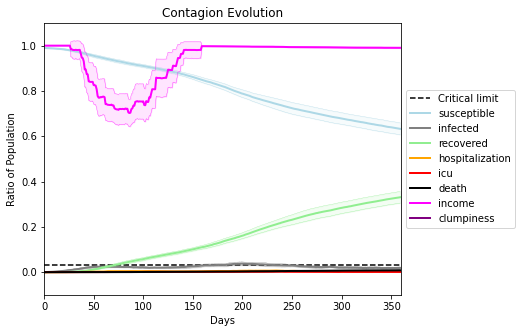

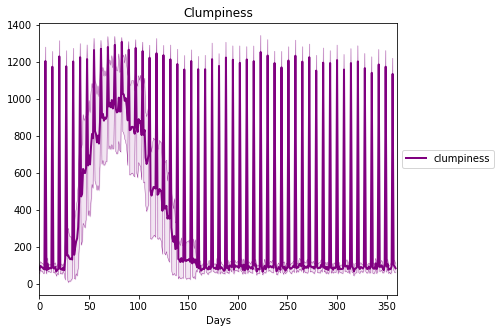

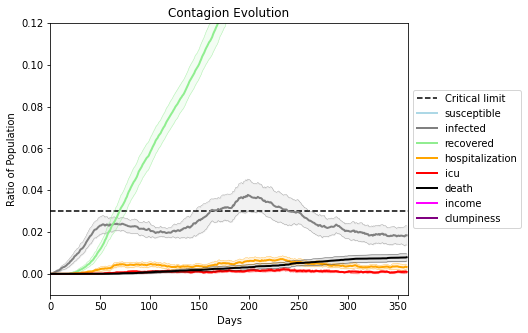

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[530, 7903, 4761, 7208, 4429, 7004, 1553, 2569, 4856, 1148, 5697, 884, 369, 8970, 533, 6629, 5294, 5994, 4147, 9768]
Average similarity between family members is 0.9102444644262916 at temperature -0.99
Average similarity between family and home is 0.9998649806450188 at temperature -1
Average similarity between students and their classroom is 0.8256608880683733 at temperature -0.99
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.8288797592956725 at temperature -0.99
Average office occupancy is 3.3692307692307693 and number offices is 195
Average friend similarity for adults: 0.8344017673351962 for kids: 0.7301251096801697
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.5336900679157673
avg restaurant similarity 0.5733976516193331
avg restaurant similarity 0.5140797705191882
avg restaurant similarity 0.4978163371156039
avg restaurant similarity 0.5282573970759934
avg restaurant similarity 0.5583277614662485
avg restaurant similarity 0.5076511376164075
avg restaurant similarity 0.5220968575836156
avg restaurant similarity 0.5132946175784554
avg restaurant similarity 0.4662662143609008
avg restaurant similarity 0.5897127199711892
avg restaurant similarity 0.5191119060074217
avg restaurant similarity 0.5538706615289465
avg restaurant similarity 0.5154722290422356
avg restaurant similarity 0.49724195415684663
avg restaurant similarity 0.5342196923468465
avg restaurant similarity 0.5137533304457641
avg restaurant similarity 0.5200026867023874
avg restaurant similarity 0.5425951984353405
avg restaurant similarity 0.5494428493818427
avg restaurant similarity 0.5237078688589426
avg restaurant similarity 0.47917426171384153
avg rest

avg restaurant similarity 0.5234551923505595
avg restaurant similarity 0.4895719966374942
avg restaurant similarity 0.4641780502831461
avg restaurant similarity 0.5177019472496652
avg restaurant similarity 0.4897362712995769
avg restaurant similarity 0.5311692922678288
avg restaurant similarity 0.523235843419555
avg restaurant similarity 0.484109213113482
avg restaurant similarity 0.4903911953611861
avg restaurant similarity 0.503359524795913
avg restaurant similarity 0.47324326872889433
avg restaurant similarity 0.5562445537764968
avg restaurant similarity 0.4816642366870503
avg restaurant similarity 0.4895581179555603
avg restaurant similarity 0.4955117442685846
avg restaurant similarity 0.44387611638241026
avg restaurant similarity 0.4989393663174107
avg restaurant similarity 0.5094182953628976
avg restaurant similarity 0.48974160577568643
avg restaurant similarity 0.5191128895374536
avg restaurant similarity 0.5082952904809973
avg restaurant similarity 0.5048537641089983
avg restau

Average similarity between workers is 0.8214135192071097 at temperature -0.99
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8318829083295041 for kids: 0.7222878815466399
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 p

avg restaurant similarity 0.5131317796607713
avg restaurant similarity 0.4798475019536328
avg restaurant similarity 0.4709497756284354
avg restaurant similarity 0.5037863987254112
avg restaurant similarity 0.49671012496096023
avg restaurant similarity 0.48365475176943845
avg restaurant similarity 0.5431425554101035
avg restaurant similarity 0.4879597158878316
avg restaurant similarity 0.524943232163911
avg restaurant similarity 0.535282615276589
avg restaurant similarity 0.5002674450819176
avg restaurant similarity 0.5380238115552246
avg restaurant similarity 0.49002011222934116
avg restaurant similarity 0.4586281954354425
avg restaurant similarity 0.5229996446044393
avg restaurant similarity 0.5618190203906125
avg restaurant similarity 0.5171871058092982
avg restaurant similarity 0.4803077955673172
avg restaurant similarity 0.5149422829553871
avg restaurant similarity 0.5005012735210995
avg restaurant similarity 0.4853944618216306
avg restaurant similarity 0.5256934488329195
avg resta

avg restaurant similarity 0.5169248308991956
avg restaurant similarity 0.5365761539548088
avg restaurant similarity 0.5673036587557524
avg restaurant similarity 0.5341125827701222
avg restaurant similarity 0.5316471888885205
avg restaurant similarity 0.5733001943712479
avg restaurant similarity 0.4984685714011448
avg restaurant similarity 0.5267971694502448
avg restaurant similarity 0.5225156733051558
avg restaurant similarity 0.5340034540441984
avg restaurant similarity 0.4863661996384511
avg restaurant similarity 0.5164668041537115
avg restaurant similarity 0.5313972778303733
avg restaurant similarity 0.5369699192960838
avg restaurant similarity 0.4879774608979098
avg restaurant similarity 0.5052244793504611
avg restaurant similarity 0.5679123821354635
avg restaurant similarity 0.5037319609897006
avg restaurant similarity 0.4909277799654367
avg restaurant similarity 0.5495056246068807
avg restaurant similarity 0.5703752687541642
avg restaurant similarity 0.5599497100987317
avg restau

Average similarity between workers is 0.8209345928573812 at temperature -0.99
Average office occupancy is 3.413793103448276 and number offices is 203
Average friend similarity for adults: 0.8434164496350272 for kids: 0.6968324875876785
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.4568816890187159
avg restaurant similarity 0.46246432623264555
avg restaurant similarity 0.4621558308153464
avg restaurant similarity 0.5190997074078425
avg restaurant similarity 0.5236555349676745
avg restaurant similarity 0.4908654976370368
avg restaurant similarity 0.5885657842738387
avg restaurant similarity 0.5409154011286228
avg restaurant similarity 0.45522589230450067
avg restaurant similarity 0.4400314522660909
avg restaurant similarity 0.5589329010035157
avg restaurant similarity 0.5271641161385334
avg restaurant similarity 0.47078740322455354
avg restaurant similarity 0.4834446009058234
avg restaurant similarity 0.4420151024168331
avg restaurant similarity 0.49327050850760396
avg restaurant similarity 0.4494736507182073
avg restaurant similarity 0.5192142640768521
avg restaurant similarity 0.4869867661879484
avg restaurant similarity 0.4755060258057244
avg restaurant similarity 0.5383552063251126
avg restaurant similarity 0.5455149427246353
avg re

avg restaurant similarity 0.46492177974062493
avg restaurant similarity 0.4992496803020513
avg restaurant similarity 0.4520376009330445
avg restaurant similarity 0.5023249008162934
avg restaurant similarity 0.49027886624008404
avg restaurant similarity 0.5215068627430495
avg restaurant similarity 0.4625434311233115
avg restaurant similarity 0.45577888081490536
avg restaurant similarity 0.44146026979205333
avg restaurant similarity 0.4409232602430619
avg restaurant similarity 0.4741090647997376
avg restaurant similarity 0.5093095661917956
avg restaurant similarity 0.459957094206271
avg restaurant similarity 0.5595376864056499
avg restaurant similarity 0.4916861977721793
avg restaurant similarity 0.4670099612272194
avg restaurant similarity 0.5348239952852408
avg restaurant similarity 0.485359069081919
avg restaurant similarity 0.457373917267972
avg restaurant similarity 0.469973320817077
avg restaurant similarity 0.4526464878462406
avg restaurant similarity 0.47477659089304775
avg resta

Average similarity between workers is 0.8084058972655673 at temperature -0.99
Average office occupancy is 3.4536082474226806 and number offices is 194
Average friend similarity for adults: 0.8205350059578633 for kids: 0.7021592966698043
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.4856857034146058
avg restaurant similarity 0.5073869573136655
avg restaurant similarity 0.454136204213235
avg restaurant similarity 0.4499666362474017
avg restaurant similarity 0.5082021192973785
avg restaurant similarity 0.4554774089805605
avg restaurant similarity 0.44037571580526624
avg restaurant similarity 0.5180533383316704
avg restaurant similarity 0.44870264540023636
avg restaurant similarity 0.48550321210135056
avg restaurant similarity 0.44731844393575915
avg restaurant similarity 0.4980170543582144
avg restaurant similarity 0.4811423543105367
avg restaurant similarity 0.5126612830502478
avg restaurant similarity 0.45311606438657787
avg restaurant similarity 0.49235724598565866
avg restaurant similarity 0.4420178280767028
avg restaurant similarity 0.46296427678447577
avg restaurant similarity 0.49314399892337324
avg restaurant similarity 0.48050346599892413
avg restaurant similarity 0.4468480787568026
avg restaurant similarity 0.46964168516406163
a

avg restaurant similarity 0.47330302876126856
avg restaurant similarity 0.5234583838501812
avg restaurant similarity 0.4786031272650808
avg restaurant similarity 0.46218716087646683
avg restaurant similarity 0.48542633830671195
avg restaurant similarity 0.4884384183236765
avg restaurant similarity 0.566041244245264
avg restaurant similarity 0.48076685486499254
avg restaurant similarity 0.5059627743464346
avg restaurant similarity 0.43303069831193686
avg restaurant similarity 0.5045946024384619
avg restaurant similarity 0.475246568959643
avg restaurant similarity 0.47547028950443837
avg restaurant similarity 0.4741604848572231
avg restaurant similarity 0.5258592082461164
avg restaurant similarity 0.5009689471074386
avg restaurant similarity 0.44805399845990646
avg restaurant similarity 0.44790705993124735
avg restaurant similarity 0.45227932682737937
avg restaurant similarity 0.5140526848583826
avg restaurant similarity 0.4706238012408384
avg restaurant similarity 0.45692504084355207
av

Average similarity between workers is 0.8262987046431542 at temperature -0.99
Average office occupancy is 3.3654822335025383 and number offices is 197
Average friend similarity for adults: 0.8391087199811337 for kids: 0.7124697466068288
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.5097932450920938
avg restaurant similarity 0.5316144306003395
avg restaurant similarity 0.5265118736988484
avg restaurant similarity 0.5421569562127655
avg restaurant similarity 0.5445373027129813
avg restaurant similarity 0.5617649540878767
avg restaurant similarity 0.4822109468281725
avg restaurant similarity 0.5184426461054721
avg restaurant similarity 0.4810099399966165
avg restaurant similarity 0.4675058980466617
avg restaurant similarity 0.5280638801703584
avg restaurant similarity 0.5254399943239714
avg restaurant similarity 0.524813610524229
avg restaurant similarity 0.5067168401052222
avg restaurant similarity 0.4738453446733369
avg restaurant similarity 0.5145018205339027
avg restaurant similarity 0.49947043391715423
avg restaurant similarity 0.5206634095319231
avg restaurant similarity 0.5193319258557639
avg restaurant similarity 0.45842762887218963
avg restaurant similarity 0.5031259236536821
avg restaurant similarity 0.49326456107340655
avg rest

avg restaurant similarity 0.5588273547759888
avg restaurant similarity 0.4957216330354786
avg restaurant similarity 0.5113510796854664
avg restaurant similarity 0.4702884615414742
avg restaurant similarity 0.48019200364651127
avg restaurant similarity 0.5001068514997906
avg restaurant similarity 0.5202594921186462
avg restaurant similarity 0.4519079472815277
avg restaurant similarity 0.5363051953719875
avg restaurant similarity 0.5023569622284113
avg restaurant similarity 0.4727811326340361
avg restaurant similarity 0.511852818813638
avg restaurant similarity 0.5043018831080126
avg restaurant similarity 0.5149114060959503
avg restaurant similarity 0.5011378565161012
avg restaurant similarity 0.4974669908578346
avg restaurant similarity 0.4827005605896524
avg restaurant similarity 0.5545205700951839
avg restaurant similarity 0.5214387149127726
avg restaurant similarity 0.54162205926805
avg restaurant similarity 0.5065700543086092
avg restaurant similarity 0.5043359119048157
avg restaura

Average similarity between workers is 0.8121484638112385 at temperature -0.99
Average office occupancy is 3.38860103626943 and number offices is 193
Average friend similarity for adults: 0.8288344708859741 for kids: 0.7149630110016445
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peop

avg restaurant similarity 0.5655767722003127
avg restaurant similarity 0.5122282016695705
avg restaurant similarity 0.5938897231610692
avg restaurant similarity 0.5139109667209215
avg restaurant similarity 0.53709182456226
avg restaurant similarity 0.4501696011419531
avg restaurant similarity 0.5019842267446278
avg restaurant similarity 0.4961076185482747
avg restaurant similarity 0.5019041227221546
avg restaurant similarity 0.47965482834231504
avg restaurant similarity 0.5114915666910681
avg restaurant similarity 0.5079225460717746
avg restaurant similarity 0.535173823472802
avg restaurant similarity 0.5204518720131717
avg restaurant similarity 0.48946755787423685
avg restaurant similarity 0.5224185588801735
avg restaurant similarity 0.4931071663130648
avg restaurant similarity 0.5158193358723807
avg restaurant similarity 0.5219488985585357
avg restaurant similarity 0.4591907675743675
avg restaurant similarity 0.5057758800013467
avg restaurant similarity 0.5408397382522591
avg restaur

avg restaurant similarity 0.5375421812773935
avg restaurant similarity 0.5248062249211377
avg restaurant similarity 0.5330541570210294
avg restaurant similarity 0.48954556841828484
avg restaurant similarity 0.47158399074033364
avg restaurant similarity 0.5380840839251485
avg restaurant similarity 0.5183812291207514
avg restaurant similarity 0.5422315024940987
avg restaurant similarity 0.563865728526287
avg restaurant similarity 0.5711347530287268
avg restaurant similarity 0.5434366236845959
avg restaurant similarity 0.5328326420750172
avg restaurant similarity 0.49806986458190056
avg restaurant similarity 0.48511912013392056
avg restaurant similarity 0.5101790543164588
avg restaurant similarity 0.5302876834771073
avg restaurant similarity 0.5257306190554285
avg restaurant similarity 0.5153092881247139
avg restaurant similarity 0.5346596212749548
avg restaurant similarity 0.48324346271408836
avg restaurant similarity 0.5544775387620774
avg restaurant similarity 0.5370945504118182
avg re

Average similarity between workers is 0.8301623165222886 at temperature -0.99
Average office occupancy is 3.2786069651741294 and number offices is 201
Average friend similarity for adults: 0.8304280803016079 for kids: 0.7093359537033249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.47242707646581694
avg restaurant similarity 0.5417242833558675
avg restaurant similarity 0.44516450679459546
avg restaurant similarity 0.4795309871505339
avg restaurant similarity 0.5030501221878955
avg restaurant similarity 0.4974702452447152
avg restaurant similarity 0.4885347978936548
avg restaurant similarity 0.45594048099316603
avg restaurant similarity 0.5276057404771031
avg restaurant similarity 0.5221669035998713
avg restaurant similarity 0.42470710757917635
avg restaurant similarity 0.5000037161098285
avg restaurant similarity 0.5250134347679369
avg restaurant similarity 0.5074397848110839
avg restaurant similarity 0.5154636311262207
avg restaurant similarity 0.5454377620703543
avg restaurant similarity 0.5068761747343706
avg restaurant similarity 0.5631569692237167
avg restaurant similarity 0.496321292386955
avg restaurant similarity 0.5315865989036627
avg restaurant similarity 0.5167908551240176
avg restaurant similarity 0.48765315913023544
avg re

avg restaurant similarity 0.5196378539170282
avg restaurant similarity 0.49904721094024684
avg restaurant similarity 0.47067004302815274
avg restaurant similarity 0.5014455408312749
avg restaurant similarity 0.45311469343638433
avg restaurant similarity 0.47245772293666705
avg restaurant similarity 0.514691637431631
avg restaurant similarity 0.5069854824098137
avg restaurant similarity 0.5093014447000795
avg restaurant similarity 0.4643963059600923
avg restaurant similarity 0.4040804599024468
avg restaurant similarity 0.4852105326575255
avg restaurant similarity 0.47299994485631225
avg restaurant similarity 0.46171892895388916
avg restaurant similarity 0.49368586087840177
avg restaurant similarity 0.46724296034371005
avg restaurant similarity 0.44342869598674184
avg restaurant similarity 0.4349582660055161
avg restaurant similarity 0.46769688105049656
avg restaurant similarity 0.4670234598278093
avg restaurant similarity 0.49938128644296637
avg restaurant similarity 0.47014315460949485

Average similarity between workers is 0.8219715903398214 at temperature -0.99
Average office occupancy is 3.326424870466321 and number offices is 193
Average friend similarity for adults: 0.826969023706976 for kids: 0.7128498679107954
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.5307965235117253
avg restaurant similarity 0.5048923079274346
avg restaurant similarity 0.5187201181219089
avg restaurant similarity 0.4974877779079381
avg restaurant similarity 0.486712566508403
avg restaurant similarity 0.4915097222796319
avg restaurant similarity 0.46991690007006903
avg restaurant similarity 0.5222589054617349
avg restaurant similarity 0.49477898990795555
avg restaurant similarity 0.5007066591774388
avg restaurant similarity 0.48456878494315575
avg restaurant similarity 0.5236029572300308
avg restaurant similarity 0.45657825982921946
avg restaurant similarity 0.4867697466710896
avg restaurant similarity 0.4765777233379247
avg restaurant similarity 0.4930690777727436
avg restaurant similarity 0.477236507495413
avg restaurant similarity 0.5332652278040363
avg restaurant similarity 0.5182544174342104
avg restaurant similarity 0.488779893914212
avg restaurant similarity 0.46984474878394206
avg restaurant similarity 0.49337612334587316
avg res

avg restaurant similarity 0.5459874577752712
avg restaurant similarity 0.44932980132761946
avg restaurant similarity 0.47420840472167025
avg restaurant similarity 0.4933515238812563
avg restaurant similarity 0.5057829505134643
avg restaurant similarity 0.5365889001098956
avg restaurant similarity 0.49431833736122943
avg restaurant similarity 0.519851979597904
avg restaurant similarity 0.457863441869033
avg restaurant similarity 0.5286730461766662
avg restaurant similarity 0.46031540013223443
avg restaurant similarity 0.4862959006569335
avg restaurant similarity 0.47740079254310824
avg restaurant similarity 0.544819739397132
avg restaurant similarity 0.5158812884075812
avg restaurant similarity 0.5511270873106828
avg restaurant similarity 0.5493126843335753
avg restaurant similarity 0.49173272514185534
avg restaurant similarity 0.485178686722398
avg restaurant similarity 0.5224643748132561
avg restaurant similarity 0.4874252234682679
avg restaurant similarity 0.5213803132264354
avg rest

Average similarity between workers is 0.8255900966200835 at temperature -0.99
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.84100672932706 for kids: 0.7311588883837336
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated

avg restaurant similarity 0.5188075316239047
avg restaurant similarity 0.4862288111772891
avg restaurant similarity 0.4789656562079018
avg restaurant similarity 0.46690705188474463
avg restaurant similarity 0.47962745441983035
avg restaurant similarity 0.5046740369945452
avg restaurant similarity 0.4785433478891632
avg restaurant similarity 0.505484094753977
avg restaurant similarity 0.44616476077202216
avg restaurant similarity 0.5126852496701462
avg restaurant similarity 0.46604592690127794
avg restaurant similarity 0.5013900823472427
avg restaurant similarity 0.4980530985798501
avg restaurant similarity 0.539396985196759
avg restaurant similarity 0.5100596799615058
avg restaurant similarity 0.48761236008499026
avg restaurant similarity 0.4996487025716769
avg restaurant similarity 0.5235116839692847
avg restaurant similarity 0.48875128315403066
avg restaurant similarity 0.4978762620487126
avg restaurant similarity 0.4458936843904188
avg restaurant similarity 0.5177757146649075
avg re

avg restaurant similarity 0.47539889070981795
avg restaurant similarity 0.5071510199513555
avg restaurant similarity 0.5185277720249144
avg restaurant similarity 0.5396478260474136
avg restaurant similarity 0.5084773980104955
avg restaurant similarity 0.5026536582810502
avg restaurant similarity 0.44241808380195946
avg restaurant similarity 0.49121082230224483
avg restaurant similarity 0.4918570307037182
avg restaurant similarity 0.5073937815283776
avg restaurant similarity 0.4917346630352267
avg restaurant similarity 0.4839604108736604
avg restaurant similarity 0.5254893312107488
avg restaurant similarity 0.48465836771884285
avg restaurant similarity 0.4932490520016852
avg restaurant similarity 0.4471729824340246
avg restaurant similarity 0.5229719760734008
avg restaurant similarity 0.467954572863655
avg restaurant similarity 0.46654598246676965
avg restaurant similarity 0.49244041371382735
avg restaurant similarity 0.4918505585221453
avg restaurant similarity 0.5240217892273528
avg r

Average similarity between workers is 0.8194903232297733 at temperature -0.99
Average office occupancy is 3.463917525773196 and number offices is 194
Average friend similarity for adults: 0.8285983602406332 for kids: 0.696834536902866
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 peop

avg restaurant similarity 0.4842732370533226
avg restaurant similarity 0.5376719758490452
avg restaurant similarity 0.5011222181192375
avg restaurant similarity 0.5247191820109088
avg restaurant similarity 0.4815138093847135
avg restaurant similarity 0.4975641787265495
avg restaurant similarity 0.535511605444744
avg restaurant similarity 0.49954986608687635
avg restaurant similarity 0.45119238743666595
avg restaurant similarity 0.5112029008391101
avg restaurant similarity 0.5119074299819361
avg restaurant similarity 0.5168974369042002
avg restaurant similarity 0.4915174344828823
avg restaurant similarity 0.5449080616429272
avg restaurant similarity 0.5403453008888506
avg restaurant similarity 0.5165516474900378
avg restaurant similarity 0.5129420334550255
avg restaurant similarity 0.49148829946277006
avg restaurant similarity 0.49554915838394886
avg restaurant similarity 0.48192197386468505
avg restaurant similarity 0.5000685712843946
avg restaurant similarity 0.4874595158436375
avg re

avg restaurant similarity 0.5002369655456744
avg restaurant similarity 0.5560712649505407
avg restaurant similarity 0.4911119842725987
avg restaurant similarity 0.47955179588478025
avg restaurant similarity 0.5534579525533113
avg restaurant similarity 0.550905466706405
avg restaurant similarity 0.5128567827176239
avg restaurant similarity 0.5052946034866411
avg restaurant similarity 0.4349617983356088
avg restaurant similarity 0.49759184591385075
avg restaurant similarity 0.455630590241013
avg restaurant similarity 0.5249955579621535
avg restaurant similarity 0.5017327170875232
avg restaurant similarity 0.47659428565898126
avg restaurant similarity 0.47478154756793073
avg restaurant similarity 0.5333456885364144
avg restaurant similarity 0.49008874418452864
avg restaurant similarity 0.5217350766482297
avg restaurant similarity 0.49965150739472936
avg restaurant similarity 0.48301479949263476
avg restaurant similarity 0.49808498493919834
avg restaurant similarity 0.5113285353875022
avg 

Average similarity between workers is 0.8248190326301456 at temperature -0.99
Average office occupancy is 3.2628865979381443 and number offices is 194
Average friend similarity for adults: 0.8336485062691338 for kids: 0.7314443922962797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.46834412907368717
avg restaurant similarity 0.522360535976956
avg restaurant similarity 0.4857508927601014
avg restaurant similarity 0.5362267733623342
avg restaurant similarity 0.4594472774798969
avg restaurant similarity 0.5296975952678559
avg restaurant similarity 0.4766845055366188
avg restaurant similarity 0.4687150114433651
avg restaurant similarity 0.4263493638921574
avg restaurant similarity 0.46758391384227543
avg restaurant similarity 0.47123121447280664
avg restaurant similarity 0.4392609050032176
avg restaurant similarity 0.47612396401361623
avg restaurant similarity 0.4827006972531633
avg restaurant similarity 0.43458395165214153
avg restaurant similarity 0.510622097586408
avg restaurant similarity 0.45262025304010406
avg restaurant similarity 0.48826895844865326
avg restaurant similarity 0.5000236222169129
avg restaurant similarity 0.474172183489402
avg restaurant similarity 0.4987357118916263
avg restaurant similarity 0.4867092438484482
avg re

avg restaurant similarity 0.5015112024121218
avg restaurant similarity 0.5039360975293422
avg restaurant similarity 0.5012982613374654
avg restaurant similarity 0.4460299580861236
avg restaurant similarity 0.5025091809078283
avg restaurant similarity 0.5110895397193526
avg restaurant similarity 0.47959431792547114
avg restaurant similarity 0.5686918475575994
avg restaurant similarity 0.49508439085006145
avg restaurant similarity 0.5007240275530128
avg restaurant similarity 0.46102423300985546
avg restaurant similarity 0.5083359316150134
avg restaurant similarity 0.4750044495747797
avg restaurant similarity 0.5145808936783088
avg restaurant similarity 0.43220721166765774
avg restaurant similarity 0.5010201623476835
avg restaurant similarity 0.4883969206303559
avg restaurant similarity 0.5179118731085006
avg restaurant similarity 0.5209834241969643
avg restaurant similarity 0.506844191530359
avg restaurant similarity 0.4523617275270869
avg restaurant similarity 0.47519560930581556
avg re

Average similarity between workers is 0.8300926135770966 at temperature -0.99
Average office occupancy is 3.515957446808511 and number offices is 188
Average friend similarity for adults: 0.8331339064723466 for kids: 0.7093664460431455
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.528983013302081
avg restaurant similarity 0.49083648247505834
avg restaurant similarity 0.523108164613084
avg restaurant similarity 0.5258591529275766
avg restaurant similarity 0.5108209173627545
avg restaurant similarity 0.5645530607281097
avg restaurant similarity 0.5941814102946676
avg restaurant similarity 0.5283998253165809
avg restaurant similarity 0.6062910959945405
avg restaurant similarity 0.5304581701220075
avg restaurant similarity 0.5432534788966513
avg restaurant similarity 0.4607838802315646
avg restaurant similarity 0.526774089173955
avg restaurant similarity 0.4456728856870786
avg restaurant similarity 0.5707682883521327
avg restaurant similarity 0.4750339345244484
avg restaurant similarity 0.5677329529089561
avg restaurant similarity 0.46674194744662273
avg restaurant similarity 0.5548553103172283
avg restaurant similarity 0.5723924359318636
avg restaurant similarity 0.5782781193808194
avg restaurant similarity 0.5771920631030609
avg restaur

avg restaurant similarity 0.5099482869903782
avg restaurant similarity 0.5792500926285917
avg restaurant similarity 0.5237036244203609
avg restaurant similarity 0.5700854285666159
avg restaurant similarity 0.5572881362213321
avg restaurant similarity 0.5053597455040691
avg restaurant similarity 0.5089615833363268
avg restaurant similarity 0.5332821837762343
avg restaurant similarity 0.4753226950329572
avg restaurant similarity 0.555067137747993
avg restaurant similarity 0.45207377988063707
avg restaurant similarity 0.5708174953431672
avg restaurant similarity 0.5557618726594584
avg restaurant similarity 0.48155431967814133
avg restaurant similarity 0.4909867405484176
avg restaurant similarity 0.48390467628488076
avg restaurant similarity 0.5282325334155222
avg restaurant similarity 0.5639328563223079
avg restaurant similarity 0.5040192312717757
avg restaurant similarity 0.5185410032537233
avg restaurant similarity 0.5164931625127803
avg restaurant similarity 0.5650831755559498
avg rest

Average similarity between workers is 0.8279789770108273 at temperature -0.99
Average office occupancy is 3.3367875647668392 and number offices is 193
Average friend similarity for adults: 0.8376476382797541 for kids: 0.7312890580682297
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.4799417344479393
avg restaurant similarity 0.4443176147836956
avg restaurant similarity 0.4712271623129169
avg restaurant similarity 0.5964391796787804
avg restaurant similarity 0.4713180008099119
avg restaurant similarity 0.49771073883651124
avg restaurant similarity 0.4921266326361947
avg restaurant similarity 0.48180857363166546
avg restaurant similarity 0.49211697702777096
avg restaurant similarity 0.4599593482626392
avg restaurant similarity 0.4880502933711095
avg restaurant similarity 0.4929470534004757
avg restaurant similarity 0.49873226639946494
avg restaurant similarity 0.5196369501708714
avg restaurant similarity 0.511216385786138
avg restaurant similarity 0.47511527188645286
avg restaurant similarity 0.436472922008575
avg restaurant similarity 0.5308042082466191
avg restaurant similarity 0.5077980538477155
avg restaurant similarity 0.5415281349858638
avg restaurant similarity 0.5042817260312621
avg restaurant similarity 0.4894892424611738
avg res

avg restaurant similarity 0.5234714208236586
avg restaurant similarity 0.4597074402707609
avg restaurant similarity 0.5055127127460937
avg restaurant similarity 0.5522184092279143
avg restaurant similarity 0.5479983669861478
avg restaurant similarity 0.4647420911744329
avg restaurant similarity 0.4945322836375404
avg restaurant similarity 0.47280280055609375
avg restaurant similarity 0.5023600462763935
avg restaurant similarity 0.4463499419501375
avg restaurant similarity 0.5331361659928718
avg restaurant similarity 0.5258424823932479
avg restaurant similarity 0.4891948670637815
avg restaurant similarity 0.4981471090837884
avg restaurant similarity 0.5217963902091828
avg restaurant similarity 0.5187337578810022
avg restaurant similarity 0.4915080138888545
avg restaurant similarity 0.5277853351663628
avg restaurant similarity 0.5589729185608674
avg restaurant similarity 0.4951120611459493
avg restaurant similarity 0.4915359591422109
avg restaurant similarity 0.4618793506980656
avg resta

Average similarity between workers is 0.8149357743010751 at temperature -0.99
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.8316044789289074 for kids: 0.7087119404228786
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.5547054341969048
avg restaurant similarity 0.5529571513088354
avg restaurant similarity 0.533880153280518
avg restaurant similarity 0.5101138021802248
avg restaurant similarity 0.4739086395431296
avg restaurant similarity 0.5403417977896621
avg restaurant similarity 0.5143810678111206
avg restaurant similarity 0.4924669748460984
avg restaurant similarity 0.5621737053446195
avg restaurant similarity 0.5766151031226988
avg restaurant similarity 0.5243230423474186
avg restaurant similarity 0.5374091348231753
avg restaurant similarity 0.5390872563016043
avg restaurant similarity 0.46197327123979054
avg restaurant similarity 0.492637713402226
avg restaurant similarity 0.49722234051920655
avg restaurant similarity 0.5653699907716765
avg restaurant similarity 0.4718910934233818
avg restaurant similarity 0.4889956891513877
avg restaurant similarity 0.5218352105220688
avg restaurant similarity 0.5319682720537457
avg restaurant similarity 0.5469371310839983
avg restau

avg restaurant similarity 0.5143039591786854
avg restaurant similarity 0.49855145997218914
avg restaurant similarity 0.4697439615115339
avg restaurant similarity 0.484430849512816
avg restaurant similarity 0.5040764014457138
avg restaurant similarity 0.44664884517744907
avg restaurant similarity 0.489285206504808
avg restaurant similarity 0.4842875815629593
avg restaurant similarity 0.4898095197965133
avg restaurant similarity 0.506776439232902
avg restaurant similarity 0.4820696072601914
avg restaurant similarity 0.5136766502390729
avg restaurant similarity 0.5238131789793987
avg restaurant similarity 0.5380025083681997
avg restaurant similarity 0.48047589280882275
avg restaurant similarity 0.48179859641965045
avg restaurant similarity 0.4866373371514615
avg restaurant similarity 0.47900417575859566
avg restaurant similarity 0.4770241029680452
avg restaurant similarity 0.5009404139041084
avg restaurant similarity 0.507310648604199
avg restaurant similarity 0.4807683084731448
avg resta

Average similarity between workers is 0.8190720322065955 at temperature -0.99
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.8362150158797718 for kids: 0.7214433711218035
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.47586668802312204
avg restaurant similarity 0.426709931878355
avg restaurant similarity 0.45740287407569014
avg restaurant similarity 0.5381424694570324
avg restaurant similarity 0.44598538244294084
avg restaurant similarity 0.5351733455725991
avg restaurant similarity 0.4771938990849556
avg restaurant similarity 0.48611869139104447
avg restaurant similarity 0.502519038489337
avg restaurant similarity 0.4980895279444717
avg restaurant similarity 0.4826227188818956
avg restaurant similarity 0.49644022918100855
avg restaurant similarity 0.42730212040471394
avg restaurant similarity 0.45097518913317
avg restaurant similarity 0.5160769505968023
avg restaurant similarity 0.5449332709840697
avg restaurant similarity 0.432724142325839
avg restaurant similarity 0.465483458501785
avg restaurant similarity 0.5458415776493843
avg restaurant similarity 0.49839717565423836
avg restaurant similarity 0.5355274165343897
avg restaurant similarity 0.5053342887276628
avg resta

avg restaurant similarity 0.4645312182705912
avg restaurant similarity 0.5048661978985427
avg restaurant similarity 0.514713130775763
avg restaurant similarity 0.4493973476760589
avg restaurant similarity 0.506870899451866
avg restaurant similarity 0.4731273951603453
avg restaurant similarity 0.4763773514480154
avg restaurant similarity 0.4770492876491341
avg restaurant similarity 0.5251144989449938
avg restaurant similarity 0.5028225725301629
avg restaurant similarity 0.5270752091036967
avg restaurant similarity 0.5009501039462858
avg restaurant similarity 0.5078690036929696
avg restaurant similarity 0.5079854931056701
avg restaurant similarity 0.5240108211255369
avg restaurant similarity 0.5319537843330346
avg restaurant similarity 0.5503107037197846
avg restaurant similarity 0.4943916290358011
avg restaurant similarity 0.49188853737246563
avg restaurant similarity 0.4595094914616246
avg restaurant similarity 0.5102876922555385
avg restaurant similarity 0.48739588954123836
avg restau

Average similarity between workers is 0.8230685901712962 at temperature -0.99
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.8342234366561015 for kids: 0.7069218738846881
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allo

avg restaurant similarity 0.45608131799572404
avg restaurant similarity 0.48243773561141157
avg restaurant similarity 0.47425714961441345
avg restaurant similarity 0.4983595645354433
avg restaurant similarity 0.48395648057082796
avg restaurant similarity 0.4342524839076918
avg restaurant similarity 0.453360954113239
avg restaurant similarity 0.45906240387791514
avg restaurant similarity 0.478713214093452
avg restaurant similarity 0.41238975501279423
avg restaurant similarity 0.47062126273734795
avg restaurant similarity 0.477757026735545
avg restaurant similarity 0.5335625587952055
avg restaurant similarity 0.48910027287327734
avg restaurant similarity 0.45625729166540785
avg restaurant similarity 0.45881451601960277
avg restaurant similarity 0.4493721172561078
avg restaurant similarity 0.47320448073860955
avg restaurant similarity 0.470271260853533
avg restaurant similarity 0.4742954065903459
avg restaurant similarity 0.44655622216379365
avg restaurant similarity 0.4562034047739967
av

avg restaurant similarity 0.48869388702605626
avg restaurant similarity 0.4995951877120343
avg restaurant similarity 0.4967054004946787
avg restaurant similarity 0.42811215861118834
avg restaurant similarity 0.4685032957223226
avg restaurant similarity 0.4634422414117818
avg restaurant similarity 0.5157095386412369
avg restaurant similarity 0.49431070211830525
avg restaurant similarity 0.48448293480016735
avg restaurant similarity 0.4457837241924631
avg restaurant similarity 0.4745910022216377
avg restaurant similarity 0.4825483319374409
avg restaurant similarity 0.450085724511758
avg restaurant similarity 0.4627305001527634
avg restaurant similarity 0.461097720414638
avg restaurant similarity 0.4572686744638786
avg restaurant similarity 0.44434859353417994
avg restaurant similarity 0.4634832803824143
avg restaurant similarity 0.45960753794563447
avg restaurant similarity 0.4743203361841108
avg restaurant similarity 0.4847718263576859
avg restaurant similarity 0.497137257752911
avg res

Average similarity between workers is 0.8352545525717207 at temperature -0.99
Average office occupancy is 3.33502538071066 and number offices is 197
Average friend similarity for adults: 0.8341283263406867 for kids: 0.7160179629587188
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.49325405246000326
avg restaurant similarity 0.5278170119494293
avg restaurant similarity 0.49395679490847
avg restaurant similarity 0.5061155760490659
avg restaurant similarity 0.5446514793890108
avg restaurant similarity 0.4983884058673891
avg restaurant similarity 0.5134760394718008
avg restaurant similarity 0.4992677628600354
avg restaurant similarity 0.5162261358524286
avg restaurant similarity 0.5125588034085667
avg restaurant similarity 0.5445861540400563
avg restaurant similarity 0.520415328113788
avg restaurant similarity 0.4930770821612146
avg restaurant similarity 0.4985756385493356
avg restaurant similarity 0.5184780130982051
avg restaurant similarity 0.5216308613932853
avg restaurant similarity 0.5265520312527567
avg restaurant similarity 0.5160696488413546
avg restaurant similarity 0.48792489880677986
avg restaurant similarity 0.5312241363655534
avg restaurant similarity 0.4887034782075036
avg restaurant similarity 0.5193510975657245
avg restaur

avg restaurant similarity 0.47918729283700684
avg restaurant similarity 0.5130917419307899
avg restaurant similarity 0.48258546002497243
avg restaurant similarity 0.5047588352322282
avg restaurant similarity 0.481263299029575
avg restaurant similarity 0.5153918839127509
avg restaurant similarity 0.540229232399264
avg restaurant similarity 0.5367735805589273
avg restaurant similarity 0.5363418696527316
avg restaurant similarity 0.5366628515130344
avg restaurant similarity 0.5418609257003605
avg restaurant similarity 0.5185066259853127
avg restaurant similarity 0.5277867941440709
avg restaurant similarity 0.477365989542827
avg restaurant similarity 0.4922033149977413
avg restaurant similarity 0.4977069289684458
avg restaurant similarity 0.5015529265234843
avg restaurant similarity 0.5090265560508521
avg restaurant similarity 0.47484759391734
avg restaurant similarity 0.5246078381312167
avg restaurant similarity 0.5298741251539361
avg restaurant similarity 0.5270932490503683
avg restauran

Average similarity between workers is 0.823875308117504 at temperature -0.99
Average office occupancy is 3.5210526315789474 and number offices is 190
Average friend similarity for adults: 0.8327485106190492 for kids: 0.7107408654142872
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 peopl

avg restaurant similarity 0.5021924694473557
avg restaurant similarity 0.4687013071050072
avg restaurant similarity 0.4634380873491922
avg restaurant similarity 0.4876561918188009
avg restaurant similarity 0.5012773942872782
avg restaurant similarity 0.5174191441300607
avg restaurant similarity 0.5084189742186496
avg restaurant similarity 0.44893953489477373
avg restaurant similarity 0.465052787480164
avg restaurant similarity 0.47526142426987533
avg restaurant similarity 0.4702383474393261
avg restaurant similarity 0.48906057667954295
avg restaurant similarity 0.5127765389573637
avg restaurant similarity 0.48461400822449646
avg restaurant similarity 0.5335126593970174
avg restaurant similarity 0.4977274448786667
avg restaurant similarity 0.5351409453650178
avg restaurant similarity 0.47965409309129464
avg restaurant similarity 0.5092291206901786
avg restaurant similarity 0.49048595470860684
avg restaurant similarity 0.4569041683096554
avg restaurant similarity 0.4930765620647479
avg r

avg restaurant similarity 0.5141020096470595
avg restaurant similarity 0.5289068709196676
avg restaurant similarity 0.5101158661415385
avg restaurant similarity 0.5501929597303706
avg restaurant similarity 0.517021311479786
avg restaurant similarity 0.4727718185561562
avg restaurant similarity 0.443825234170948
avg restaurant similarity 0.4702301191634838
avg restaurant similarity 0.47761036231100495
avg restaurant similarity 0.457603641559673
avg restaurant similarity 0.4334557007038837
avg restaurant similarity 0.49218307873970024
avg restaurant similarity 0.4995145360932182
avg restaurant similarity 0.4679752011769873
avg restaurant similarity 0.5302856466724142
avg restaurant similarity 0.4804484133215733
avg restaurant similarity 0.5351675782494125
avg restaurant similarity 0.4882341469292874
avg restaurant similarity 0.5688958456502067
avg restaurant similarity 0.507476078157266
avg restaurant similarity 0.5194065261572399
avg restaurant similarity 0.4945154546326717
avg restaura

Average similarity between workers is 0.8390329856879009 at temperature -0.99
Average office occupancy is 3.292929292929293 and number offices is 198
Average friend similarity for adults: 0.8399248596475484 for kids: 0.7280892225012109
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5338583916632245
avg restaurant similarity 0.5146401036962427
avg restaurant similarity 0.5253698541490018
avg restaurant similarity 0.5026240586984465
avg restaurant similarity 0.5449750635818172
avg restaurant similarity 0.5178923043170178
avg restaurant similarity 0.5571825389148195
avg restaurant similarity 0.4989069021951221
avg restaurant similarity 0.49902212011633357
avg restaurant similarity 0.5474232131607165
avg restaurant similarity 0.4906121860042922
avg restaurant similarity 0.4808750484505001
avg restaurant similarity 0.5187379690835965
avg restaurant similarity 0.5267549696963937
avg restaurant similarity 0.5001842071610316
avg restaurant similarity 0.47941918015038415
avg restaurant similarity 0.5184951060230741
avg restaurant similarity 0.5549727693745913
avg restaurant similarity 0.4663800918965043
avg restaurant similarity 0.5388770692613121
avg restaurant similarity 0.5117168589131098
avg restaurant similarity 0.5025755110519026
avg rest

avg restaurant similarity 0.5173510403159066
avg restaurant similarity 0.5405983749470521
avg restaurant similarity 0.5679404180341039
avg restaurant similarity 0.5292736424809248
avg restaurant similarity 0.5074533232531435
avg restaurant similarity 0.517508737045736
avg restaurant similarity 0.518862046390345
avg restaurant similarity 0.5511830318426706
avg restaurant similarity 0.477960766066677
avg restaurant similarity 0.4841433709134872
avg restaurant similarity 0.5275927108952956
avg restaurant similarity 0.5827739735577497
avg restaurant similarity 0.5640999728394924
avg restaurant similarity 0.6069003123084559
avg restaurant similarity 0.5400219704098246
avg restaurant similarity 0.4912619719421127
avg restaurant similarity 0.5006981181059014
avg restaurant similarity 0.5517527770015558
avg restaurant similarity 0.48981449778859354
avg restaurant similarity 0.45932818307251905
avg restaurant similarity 0.5283863741405654
avg restaurant similarity 0.4815871776816804
avg restaur

Average similarity between workers is 0.796047975300175 at temperature -0.99
Average office occupancy is 3.4322916666666665 and number offices is 192
Average friend similarity for adults: 0.8182873867917827 for kids: 0.7081636199667936
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.46064420784386373
avg restaurant similarity 0.47422842081437205
avg restaurant similarity 0.5003319430107254
avg restaurant similarity 0.5029446044630469
avg restaurant similarity 0.4899696819884014
avg restaurant similarity 0.44903930670910625
avg restaurant similarity 0.4919511134125631
avg restaurant similarity 0.4723507980656228
avg restaurant similarity 0.4900760226154449
avg restaurant similarity 0.4459872675999963
avg restaurant similarity 0.4965748147770163
avg restaurant similarity 0.4581748601502741
avg restaurant similarity 0.4560981644251821
avg restaurant similarity 0.5387439081382651
avg restaurant similarity 0.48021883036375607
avg restaurant similarity 0.46388734577745744
avg restaurant similarity 0.4481142000317179
avg restaurant similarity 0.4880051550913676
avg restaurant similarity 0.5040611276756918
avg restaurant similarity 0.4907373986343746
avg restaurant similarity 0.5280466037976161
avg restaurant similarity 0.4280714292600924
avg r

avg restaurant similarity 0.5002895878206838
avg restaurant similarity 0.48087189186630125
avg restaurant similarity 0.49433344224254155
avg restaurant similarity 0.4852486899179877
avg restaurant similarity 0.4820140011085399
avg restaurant similarity 0.4579510840494128
avg restaurant similarity 0.5166891459439196
avg restaurant similarity 0.4569227861121654
avg restaurant similarity 0.4579081704096956
avg restaurant similarity 0.5147386037718011
avg restaurant similarity 0.5322767615868251
avg restaurant similarity 0.4554665214348106
avg restaurant similarity 0.43691210516974593
avg restaurant similarity 0.5398595649279013
avg restaurant similarity 0.48224655622096135
avg restaurant similarity 0.4731633836863814
avg restaurant similarity 0.5165605027368111
avg restaurant similarity 0.4569009423155464
avg restaurant similarity 0.4678066096267249
avg restaurant similarity 0.475662989074111
avg restaurant similarity 0.4839253555148832
avg restaurant similarity 0.5500669002784199
avg res

(<function dict.items>, <function dict.items>, <function dict.items>)

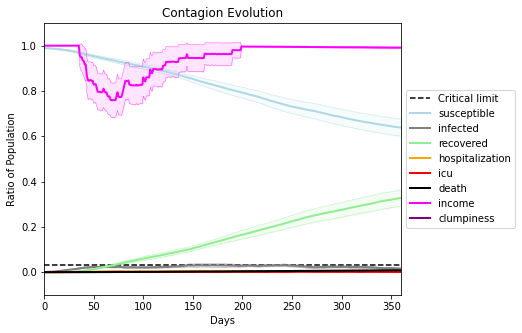

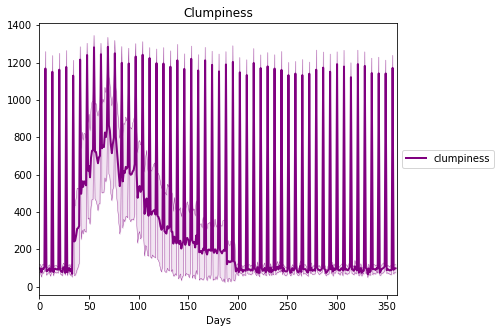

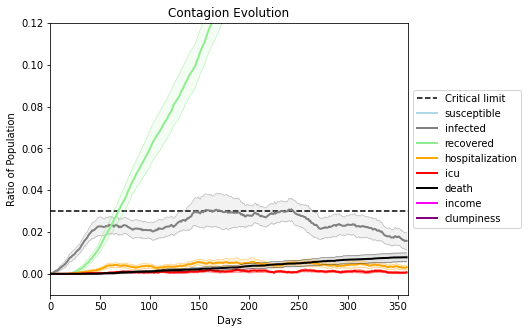

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[597, 2285, 7958, 1236, 3764, 1449, 7822, 9426, 2676, 7108, 1341, 6466, 536, 736, 7063, 1078, 7774, 9911, 816, 1054]
Average similarity between family members is 0.5579317278589161 at temperature -0.9
Average similarity between family and home is 0.9998522267185466 at temperature -1
Average similarity between students and their classroom is 0.2678128648633571 at temperature -0.9
Average classroom occupancy is 1.6201117318435754 and number classrooms is 179
Average similarity between workers is 0.46338993929923056 at temperature -0.9
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults: 0.6184318876248873 for kids: 0.5127562302245217
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.04396339835912198
avg restaurant similarity 0.10203895096683736
avg restaurant similarity 0.14889975095833366
avg restaurant similarity 0.09985577456975152
avg restaurant similarity 0.10696816283088828
avg restaurant similarity 0.07098747237281931
avg restaurant similarity 0.14255929910422982
avg restaurant similarity 0.04449496053742986
avg restaurant similarity 0.03142110826703583
avg restaurant similarity 0.12934850532080158
avg restaurant similarity 0.12353215162444
avg restaurant similarity 0.09513667328569299
avg restaurant similarity 0.07583176142581549
avg restaurant similarity 0.12382091046599931
avg restaurant similarity 0.0820710044361808
avg restaurant similarity 0.0865034247383261
avg restaurant similarity 0.11388031084514197
avg restaurant similarity 0.1109368516018022
avg restaurant similarity 0.07295421765129105
avg restaurant similarity 0.047758228668880076
avg restaurant similarity 0.0484192610273692
avg restaurant similarity 0.128760491291

avg restaurant similarity 0.0922791626643715
avg restaurant similarity 0.09024893589380557
avg restaurant similarity 0.03586381611362954
avg restaurant similarity 0.07388973684325495
avg restaurant similarity 0.08487596384067321
avg restaurant similarity 0.10381286845469602
avg restaurant similarity 0.09051552512489312
avg restaurant similarity 0.07970745710960034
avg restaurant similarity 0.0440216073830801
avg restaurant similarity 0.08743618617052265
avg restaurant similarity 0.11818746632801842
avg restaurant similarity 0.10929734905293893
avg restaurant similarity 0.06616643191646136
avg restaurant similarity 0.0922780452820582
avg restaurant similarity 0.09260529968232822
avg restaurant similarity 0.07658211717857809
avg restaurant similarity 0.046418653679572854
avg restaurant similarity 0.051746989259743005
avg restaurant similarity 0.1413976561655139
avg restaurant similarity 0.13205072960749858
avg restaurant similarity 0.09778533551566737
avg restaurant similarity 0.05952995

avg restaurant similarity 0.0664697664811911
avg restaurant similarity 0.06413575819269203
Average similarity between family members is 0.5446727280324452 at temperature -0.9
Average similarity between family and home is 0.9998571787319004 at temperature -1
Average similarity between students and their classroom is 0.22497870431874784 at temperature -0.9
Average classroom occupancy is 1.58125 and number classrooms is 160
Average similarity between workers is 0.45407031034701484 at temperature -0.9
Average office occupancy is 3.485 and number offices is 200
Average friend similarity for adults: 0.610339639690254 for kids: 0.48123230550746277
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 1

avg restaurant similarity 0.132302741384763
avg restaurant similarity 0.14243457480843602
avg restaurant similarity 0.1578603411700864
avg restaurant similarity 0.11112693533045385
avg restaurant similarity 0.1557878284866642
avg restaurant similarity 0.11929177210893284
avg restaurant similarity 0.10523258175123947
avg restaurant similarity 0.18365573338498545
avg restaurant similarity 0.15223641771597177
avg restaurant similarity 0.11832722847286253
avg restaurant similarity 0.13243792179617295
avg restaurant similarity 0.13588175038600064
avg restaurant similarity 0.11051094074946823
avg restaurant similarity 0.19185436790045676
avg restaurant similarity 0.15666682260496329
avg restaurant similarity 0.18088441230921293
avg restaurant similarity 0.1363537007429598
avg restaurant similarity 0.1525536220040861
avg restaurant similarity 0.17769413321546648
avg restaurant similarity 0.08794312725635373
avg restaurant similarity 0.11451143374635361
avg restaurant similarity 0.161309668062

avg restaurant similarity 0.11363935139781507
avg restaurant similarity 0.11363454890687051
avg restaurant similarity 0.16774422505167833
avg restaurant similarity 0.07915848783211533
avg restaurant similarity 0.11979364210999807
avg restaurant similarity 0.12972604692530876
avg restaurant similarity 0.155417097542598
avg restaurant similarity 0.10376469483582383
avg restaurant similarity 0.17421744202400802
avg restaurant similarity 0.1260644895895921
avg restaurant similarity 0.13395333910586896
avg restaurant similarity 0.17373954496035876
avg restaurant similarity 0.15090233910497233
avg restaurant similarity 0.12817088335606203
avg restaurant similarity 0.1947189505631492
avg restaurant similarity 0.1474805448601764
avg restaurant similarity 0.15161447679011372
avg restaurant similarity 0.1199897682482575
avg restaurant similarity 0.15306515925994538
avg restaurant similarity 0.06295466257675378
avg restaurant similarity 0.10000641728042133
avg restaurant similarity 0.165265995423

avg restaurant similarity 0.18732763260784432
Average similarity between family members is 0.5515465244260032 at temperature -0.9
Average similarity between family and home is 0.9998613699638577 at temperature -1
Average similarity between students and their classroom is 0.24443000933583434 at temperature -0.9
Average classroom occupancy is 1.5590062111801242 and number classrooms is 161
Average similarity between workers is 0.44493370618419736 at temperature -0.9
Average office occupancy is 3.4527363184079602 and number offices is 201
Average friend similarity for adults: 0.6042214265380783 for kids: 0.4776597114515343
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 p

avg restaurant similarity 0.08911290185774585
avg restaurant similarity 0.11750290555097972
avg restaurant similarity 0.11907776674835506
avg restaurant similarity 0.020963272212336098
avg restaurant similarity 0.10239411451350502
avg restaurant similarity 0.14055392921813925
avg restaurant similarity 0.128838373645315
avg restaurant similarity 0.04723760673760167
avg restaurant similarity 0.096014083575397
avg restaurant similarity 0.1048660788857387
avg restaurant similarity 0.07244552479746917
avg restaurant similarity 0.16036276600499288
avg restaurant similarity 0.1446688275954015
avg restaurant similarity 0.06636509974370934
avg restaurant similarity 0.0827863648793152
avg restaurant similarity 0.014079479828228351
avg restaurant similarity 0.12352147196062895
avg restaurant similarity 0.19353269582449056
avg restaurant similarity 0.09813831400777812
avg restaurant similarity 0.13389728985164703
avg restaurant similarity 0.09326197423909487
avg restaurant similarity 0.13330773258

avg restaurant similarity 0.08122104761268208
avg restaurant similarity 0.10920973515200516
avg restaurant similarity 0.04800359198709186
avg restaurant similarity 0.18989134159342227
avg restaurant similarity 0.11103909166244119
avg restaurant similarity 0.18331649012426543
avg restaurant similarity 0.10901472096029532
avg restaurant similarity 0.11068295895960709
avg restaurant similarity 0.08820158189339636
avg restaurant similarity 0.1380042509208091
avg restaurant similarity 0.07840786850214423
avg restaurant similarity 0.11198010565696213
avg restaurant similarity 0.10547587922952352
avg restaurant similarity 0.11839187673018235
avg restaurant similarity 0.05669336720551895
avg restaurant similarity 0.097128041625296
avg restaurant similarity 0.11168659614458375
avg restaurant similarity 0.047898079476477125
avg restaurant similarity 0.1248834366670165
avg restaurant similarity 0.20100558811585606
avg restaurant similarity 0.09726899932307921
avg restaurant similarity 0.157995969

avg restaurant similarity 0.11309414313472475
avg restaurant similarity 0.03935107579175427
Average similarity between family members is 0.5572053466424204 at temperature -0.9
Average similarity between family and home is 0.9998393007638485 at temperature -1
Average similarity between students and their classroom is 0.2388026290328144 at temperature -0.9
Average classroom occupancy is 1.6722222222222223 and number classrooms is 180
Average similarity between workers is 0.43385226626893286 at temperature -0.9
Average office occupancy is 3.2233502538071064 and number offices is 197
Average friend similarity for adults: 0.5934016226037373 for kids: 0.5000421938880532
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.12696275150928965
avg restaurant similarity 0.0731851425366878
avg restaurant similarity 0.10424945404829222
avg restaurant similarity 0.08010742113133928
avg restaurant similarity 0.11113986259814247
avg restaurant similarity 0.10906622659860718
avg restaurant similarity 0.1544991481171123
avg restaurant similarity 0.07573598742822209
avg restaurant similarity 0.11293665774883431
avg restaurant similarity 0.13768327324590954
avg restaurant similarity 0.1320512964321659
avg restaurant similarity 0.0668760045460653
avg restaurant similarity 0.033653905890399564
avg restaurant similarity 0.09692797511668978
avg restaurant similarity 0.08807867089637246
avg restaurant similarity 0.07903493635255081
avg restaurant similarity 0.09362121521880111
avg restaurant similarity 0.04532209104238634
avg restaurant similarity 0.12060517996292802
avg restaurant similarity 0.16498190596583165
avg restaurant similarity 0.09545619158741099
avg restaurant similarity 0.082179034

avg restaurant similarity 0.08961152576395011
avg restaurant similarity 0.06950219389547131
avg restaurant similarity 0.09592630327571999
avg restaurant similarity 0.10461306223517072
avg restaurant similarity 0.10554995166662434
avg restaurant similarity 0.07957354797753848
avg restaurant similarity 0.0896667655176714
avg restaurant similarity 0.12052224344327786
avg restaurant similarity 0.12031340446465463
avg restaurant similarity 0.10671094672426945
avg restaurant similarity 0.1404427239063338
avg restaurant similarity 0.09089701151699656
avg restaurant similarity 0.11289685021180858
avg restaurant similarity 0.05169198034684924
avg restaurant similarity 0.014559880847641054
avg restaurant similarity 0.09462960113229284
avg restaurant similarity 0.14510383518127226
avg restaurant similarity 0.1200897296637801
avg restaurant similarity 0.038420607936675975
avg restaurant similarity 0.06220862817410537
avg restaurant similarity 0.13155209386594172
avg restaurant similarity 0.1190445

avg restaurant similarity 0.06291296157217838
avg restaurant similarity 0.1420781093961513
Average similarity between family members is 0.5541955660833905 at temperature -0.9
Average similarity between family and home is 0.9998445358850817 at temperature -1
Average similarity between students and their classroom is 0.23367983657970726 at temperature -0.9
Average classroom occupancy is 1.6198830409356726 and number classrooms is 171
Average similarity between workers is 0.4471268052227874 at temperature -0.9
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.6013600887581168 for kids: 0.49982917916966574
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated un

avg restaurant similarity 0.09301686466034524
avg restaurant similarity 0.09913577323538948
avg restaurant similarity 0.14883164676684724
avg restaurant similarity 0.11778604659200301
avg restaurant similarity 0.1356777495299851
avg restaurant similarity 0.1791132904774467
avg restaurant similarity 0.0944395887063154
avg restaurant similarity 0.1372377080188988
avg restaurant similarity 0.058396123545599234
avg restaurant similarity 0.061394618167384396
avg restaurant similarity 0.0994214810443126
avg restaurant similarity 0.06144074161295998
avg restaurant similarity 0.1122363685893145
avg restaurant similarity 0.15783245466139906
avg restaurant similarity 0.06707202983550911
avg restaurant similarity 0.08147841481399842
avg restaurant similarity 0.14764773494096864
avg restaurant similarity 0.15663721735272815
avg restaurant similarity 0.06220892301055453
avg restaurant similarity 0.12987170328873276
avg restaurant similarity 0.047324975316705535
avg restaurant similarity 0.085060224

avg restaurant similarity 0.07331494298651522
avg restaurant similarity 0.06481253400846049
avg restaurant similarity 0.08780849049900032
avg restaurant similarity 0.13308090141388965
avg restaurant similarity 0.08562977628362574
avg restaurant similarity 0.07182960691336313
avg restaurant similarity 0.13622081365145153
avg restaurant similarity 0.13523499333682018
avg restaurant similarity 0.129570973969174
avg restaurant similarity 0.12123261193820278
avg restaurant similarity 0.07168616327395122
avg restaurant similarity 0.16750180993158836
avg restaurant similarity 0.1273550192939789
avg restaurant similarity 0.11258763094490838
avg restaurant similarity 0.047075082562547894
avg restaurant similarity 0.1554087560138511
avg restaurant similarity 0.1010907323815666
avg restaurant similarity 0.13205863715596308
avg restaurant similarity 0.09834033320673528
avg restaurant similarity 0.08091653784903552
avg restaurant similarity 0.0930920544220106
avg restaurant similarity 0.13581044343

avg restaurant similarity 0.08537145145830957
Average similarity between family members is 0.5572520473987486 at temperature -0.9
Average similarity between family and home is 0.9998591957539271 at temperature -1
Average similarity between students and their classroom is 0.24436789373965326 at temperature -0.9
Average classroom occupancy is 1.5837837837837838 and number classrooms is 185
Average similarity between workers is 0.459314970146688 at temperature -0.9
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.6016768259198497 for kids: 0.5052891363026751
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people

avg restaurant similarity 0.14086158252397002
avg restaurant similarity 0.09568639471741136
avg restaurant similarity 0.09040701483518167
avg restaurant similarity 0.052784189309462576
avg restaurant similarity 0.06234135520452973
avg restaurant similarity 0.057060541471305466
avg restaurant similarity 0.15444560415897882
avg restaurant similarity 0.15455030658915003
avg restaurant similarity 0.04152360817495087
avg restaurant similarity 0.09254376015033806
avg restaurant similarity 0.08020549531196952
avg restaurant similarity 0.07067520790536246
avg restaurant similarity 0.10166480202417645
avg restaurant similarity 0.12089452954168177
avg restaurant similarity 0.03445877579040231
avg restaurant similarity 0.14647588543595882
avg restaurant similarity 0.13739456772597028
avg restaurant similarity 0.10940148645857946
avg restaurant similarity 0.12111802716351076
avg restaurant similarity 0.08822104343969572
avg restaurant similarity 0.20836089027634946
avg restaurant similarity 0.0633

avg restaurant similarity 0.09310382997433214
avg restaurant similarity 0.11036698165353108
avg restaurant similarity 0.1207514955217675
avg restaurant similarity 0.11642147002417659
avg restaurant similarity 0.12289601872807969
avg restaurant similarity 0.09141258554049302
avg restaurant similarity 0.0368939109381979
avg restaurant similarity 0.10570352064615054
avg restaurant similarity 0.10174673728917467
avg restaurant similarity 0.03281636079712868
avg restaurant similarity 0.06771902343943619
avg restaurant similarity 0.09352666402462308
avg restaurant similarity 0.0737583672565763
avg restaurant similarity 0.13867034272362389
avg restaurant similarity 0.10779203388611412
avg restaurant similarity 0.09641354146849365
avg restaurant similarity 0.025591075674529815
avg restaurant similarity 0.05813368269451555
avg restaurant similarity 0.09458490415116767
avg restaurant similarity 0.04716129295110779
avg restaurant similarity 0.09243157187046809
avg restaurant similarity 0.06275919

avg restaurant similarity 0.10045134301402167
avg restaurant similarity 0.11675809266177209
Average similarity between family members is 0.537553745429299 at temperature -0.9
Average similarity between family and home is 0.9998490676576743 at temperature -1
Average similarity between students and their classroom is 0.27434886727173236 at temperature -0.9
Average classroom occupancy is 1.5625 and number classrooms is 176
Average similarity between workers is 0.4582138540887737 at temperature -0.9
Average office occupancy is 3.3535353535353534 and number offices is 198
Average friend similarity for adults: 0.5932141501195676 for kids: 0.48956258398521285
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with 

avg restaurant similarity 0.09808517379067787
avg restaurant similarity 0.027389753588934335
avg restaurant similarity 0.0758233762820614
avg restaurant similarity 0.06745979030427143
avg restaurant similarity 0.08998662834179671
avg restaurant similarity 0.09430812911902453
avg restaurant similarity 0.07816860445719566
avg restaurant similarity 0.11828497615123458
avg restaurant similarity 0.074616875299815
avg restaurant similarity 0.06830558762544557
avg restaurant similarity 0.08926059849835413
avg restaurant similarity 0.07262133535384462
avg restaurant similarity 0.10834593743030344
avg restaurant similarity 0.09544777350425872
avg restaurant similarity 0.11688051335255548
avg restaurant similarity 0.11142144523631833
avg restaurant similarity 0.12339483265059693
avg restaurant similarity 0.029535079876903327
avg restaurant similarity 0.07225583126501041
avg restaurant similarity 0.055708678714418446
avg restaurant similarity 0.07132980240469153
avg restaurant similarity 0.099134

avg restaurant similarity 0.08136042347050089
avg restaurant similarity 0.08967281849253468
avg restaurant similarity 0.10915163039488879
avg restaurant similarity 0.06343999900628988
avg restaurant similarity 0.09807093817712827
avg restaurant similarity 0.07425432257885789
avg restaurant similarity 0.07716530363339524
avg restaurant similarity 0.12627629645183527
avg restaurant similarity 0.06614576542533994
avg restaurant similarity 0.0630242743796569
avg restaurant similarity 0.03769695254479793
avg restaurant similarity 0.10853748525724002
avg restaurant similarity 0.08379784865289142
avg restaurant similarity 0.054975596814514596
avg restaurant similarity 0.014224699553515194
avg restaurant similarity 0.13278018150513754
avg restaurant similarity 0.06896638707331394
avg restaurant similarity 0.020336183391249568
avg restaurant similarity 0.07529167058284585
avg restaurant similarity 0.0936533623664918
avg restaurant similarity 0.015591284847825855
avg restaurant similarity 0.0711

avg restaurant similarity 0.08463179772499897
avg restaurant similarity 0.12891519010571464
Average similarity between family members is 0.5383117809711144 at temperature -0.9
Average similarity between family and home is 0.9998622005529401 at temperature -1
Average similarity between students and their classroom is 0.2395823400961907 at temperature -0.9
Average classroom occupancy is 1.6407185628742516 and number classrooms is 167
Average similarity between workers is 0.44815273947539197 at temperature -0.9
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.6032629913595465 for kids: 0.49265753137932894
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.13462652248481408
avg restaurant similarity 0.06520721425361169
avg restaurant similarity 0.06424420467081111
avg restaurant similarity 0.05779349457930931
avg restaurant similarity 0.06756836484747888
avg restaurant similarity 0.05395185598034189
avg restaurant similarity 0.08117286492746095
avg restaurant similarity 0.11689795580349902
avg restaurant similarity 0.12269486612284061
avg restaurant similarity 0.09447743045658477
avg restaurant similarity 0.07664787921093275
avg restaurant similarity 0.06952165874563834
avg restaurant similarity 0.11779708224184524
avg restaurant similarity 0.04668375290241198
avg restaurant similarity 0.07798254692341401
avg restaurant similarity 0.09088379829044575
avg restaurant similarity 0.10898658572869836
avg restaurant similarity 0.1404089731895011
avg restaurant similarity 0.09844714644374417
avg restaurant similarity 0.08134797967821102
avg restaurant similarity 0.10394339697973119
avg restaurant similarity 0.1407280

avg restaurant similarity 0.12089841586433751
avg restaurant similarity 0.10994549692483645
avg restaurant similarity 0.11740446574807152
avg restaurant similarity 0.06671226036464047
avg restaurant similarity 0.09285366012535806
avg restaurant similarity 0.07357611574650046
avg restaurant similarity 0.14204511131798314
avg restaurant similarity 0.09630837166803606
avg restaurant similarity 0.12855164922143295
avg restaurant similarity 0.11269149137644943
avg restaurant similarity 0.10306778351069046
avg restaurant similarity 0.07663845047304464
avg restaurant similarity 0.1563923844324117
avg restaurant similarity 0.13597498820681425
avg restaurant similarity 0.10671511164223889
avg restaurant similarity 0.11766000241438081
avg restaurant similarity 0.12340566755204493
avg restaurant similarity 0.10350078576342936
avg restaurant similarity 0.13715259288865655
avg restaurant similarity 0.09296681014085689
avg restaurant similarity 0.20897063240181288
avg restaurant similarity 0.0420525

avg restaurant similarity 0.10911711602434475
avg restaurant similarity 0.10054647757069018
Average similarity between family members is 0.5531523572772584 at temperature -0.9
Average similarity between family and home is 0.999854848769899 at temperature -1
Average similarity between students and their classroom is 0.267103144518006 at temperature -0.9
Average classroom occupancy is 1.5952380952380953 and number classrooms is 168
Average similarity between workers is 0.4529912427519182 at temperature -0.9
Average office occupancy is 3.3137254901960786 and number offices is 204
Average friend similarity for adults: 0.6096260262115766 for kids: 0.4993603598502075
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated unit

avg restaurant similarity 0.10591563458196668
avg restaurant similarity 0.15240183925196196
avg restaurant similarity 0.0656179929207548
avg restaurant similarity 0.12482511105778585
avg restaurant similarity 0.15723558081605044
avg restaurant similarity 0.09586691634881132
avg restaurant similarity 0.0786281834783011
avg restaurant similarity 0.14588845622751767
avg restaurant similarity 0.05107324572983431
avg restaurant similarity 0.08438983472333235
avg restaurant similarity 0.0731163576752925
avg restaurant similarity 0.14646218927647156
avg restaurant similarity 0.1189516721032375
avg restaurant similarity 0.10177092437820151
avg restaurant similarity 0.04176235974673638
avg restaurant similarity 0.16344650080182507
avg restaurant similarity 0.11458690177929691
avg restaurant similarity 0.10953189696232861
avg restaurant similarity 0.10859622572965646
avg restaurant similarity 0.11588094584053822
avg restaurant similarity 0.0940330310460343
avg restaurant similarity 0.09459100566

avg restaurant similarity 0.07745849203757284
avg restaurant similarity 0.08060115686639696
avg restaurant similarity 0.10355941349041178
avg restaurant similarity 0.08051551245168868
avg restaurant similarity 0.10280146118899505
avg restaurant similarity 0.06832213639118498
avg restaurant similarity 0.16970385428078888
avg restaurant similarity 0.07596956739360988
avg restaurant similarity 0.0663070981617603
avg restaurant similarity 0.09049910167984523
avg restaurant similarity 0.04132971688336644
avg restaurant similarity 0.17181781461637666
avg restaurant similarity 0.07163366998027199
avg restaurant similarity 0.04694227538121202
avg restaurant similarity 0.0820935473228046
avg restaurant similarity 0.12272507516804583
avg restaurant similarity 0.09798051696522113
avg restaurant similarity 0.029151317802876612
avg restaurant similarity 0.08413498650320697
avg restaurant similarity 0.07317302799489157
avg restaurant similarity 0.11901076979092957
avg restaurant similarity 0.1276368

avg restaurant similarity 0.10650896260748191
avg restaurant similarity 0.1318812321561509
Average similarity between family members is 0.5533356945953614 at temperature -0.9
Average similarity between family and home is 0.9998624792342007 at temperature -1
Average similarity between students and their classroom is 0.23531447819374798 at temperature -0.9
Average classroom occupancy is 1.6557377049180328 and number classrooms is 183
Average similarity between workers is 0.45717115597551183 at temperature -0.9
Average office occupancy is 3.2311557788944723 and number offices is 199
Average friend similarity for adults: 0.5982952217912365 for kids: 0.5097607644528325
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.08530280749432807
avg restaurant similarity 0.06503105475525571
avg restaurant similarity 0.09783298609682507
avg restaurant similarity 0.03470017245467529
avg restaurant similarity 0.11185854197564354
avg restaurant similarity 0.09698498221672076
avg restaurant similarity 0.053471477867311296
avg restaurant similarity 0.034630223812048874
avg restaurant similarity 0.07816985993286127
avg restaurant similarity 0.05673229556007329
avg restaurant similarity 0.057977848788376696
avg restaurant similarity 0.15092746058914264
avg restaurant similarity 0.06691738075158651
avg restaurant similarity 0.10213114548695756
avg restaurant similarity 0.05840005288025467
avg restaurant similarity 0.06372757629246732
avg restaurant similarity 0.08817227101530838
avg restaurant similarity 0.06319997176464513
avg restaurant similarity 0.08086306788709523
avg restaurant similarity 0.04917136359733362
avg restaurant similarity 0.12629456722898894
avg restaurant similarity 0.068

avg restaurant similarity 0.14000923486280806
avg restaurant similarity 0.05855403082927644
avg restaurant similarity 0.12395512048832039
avg restaurant similarity 0.0735709947093895
avg restaurant similarity 0.04815123468817803
avg restaurant similarity 0.0936657314986948
avg restaurant similarity -0.006764390009482971
avg restaurant similarity 0.014512889857751768
avg restaurant similarity 0.12798069846590576
avg restaurant similarity 0.13843781887203557
avg restaurant similarity 0.06773725618442161
avg restaurant similarity 0.050617231009578635
avg restaurant similarity 0.02405699369169645
avg restaurant similarity 0.11470967213356817
avg restaurant similarity 0.11044229496545101
avg restaurant similarity 0.04595289059028721
avg restaurant similarity 0.027456558904612512
avg restaurant similarity 0.08176656771755933
avg restaurant similarity 0.12964251247549957
avg restaurant similarity 0.012431486796130669
avg restaurant similarity 0.033471598609861715
avg restaurant similarity 0.1

avg restaurant similarity 0.04506222711119774
avg restaurant similarity 0.10605939405302031
avg restaurant similarity 0.06297920516711455
avg restaurant similarity 0.12257669116131356
Average similarity between family members is 0.5596489702790789 at temperature -0.9
Average similarity between family and home is 0.9998683010805535 at temperature -1
Average similarity between students and their classroom is 0.2439974540940238 at temperature -0.9
Average classroom occupancy is 1.5706214689265536 and number classrooms is 177
Average similarity between workers is 0.47782620440168366 at temperature -0.9
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.618036986370152 for kids: 0.5091749880078167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.15473919425352306
avg restaurant similarity 0.12160505128375232
avg restaurant similarity 0.17971754589261024
avg restaurant similarity 0.14568342906551693
avg restaurant similarity 0.12865080278512708
avg restaurant similarity 0.06264720187509071
avg restaurant similarity 0.14593812810583612
avg restaurant similarity 0.19301118222362082
avg restaurant similarity 0.11272755795748954
avg restaurant similarity 0.16952932277440097
avg restaurant similarity 0.03370281144218242
avg restaurant similarity 0.16364246119975742
avg restaurant similarity 0.11443216924394327
avg restaurant similarity 0.11992558708501226
avg restaurant similarity 0.09920585759223667
avg restaurant similarity 0.15215779937124924
avg restaurant similarity 0.13211146100791668
avg restaurant similarity 0.11521481545565077
avg restaurant similarity 0.1380112774346822
avg restaurant similarity 0.10893617751287023
avg restaurant similarity 0.14260083252369002
avg restaurant similarity 0.1852766

avg restaurant similarity 0.11047907190894181
avg restaurant similarity 0.16256577499597266
avg restaurant similarity 0.08633074216175819
avg restaurant similarity 0.20765250394358126
avg restaurant similarity 0.06408385530912468
avg restaurant similarity 0.16157680077954842
avg restaurant similarity 0.12931284760206427
avg restaurant similarity 0.13368076593751704
avg restaurant similarity 0.16694736358811926
avg restaurant similarity 0.10543400996398374
avg restaurant similarity 0.1130841758656864
avg restaurant similarity 0.18909099289354736
avg restaurant similarity 0.0867986297476922
avg restaurant similarity 0.14271830261912652
avg restaurant similarity 0.11443400413976514
avg restaurant similarity 0.10481870383534862
avg restaurant similarity 0.2505494161682472
avg restaurant similarity 0.17531930283122643
avg restaurant similarity 0.06303296059319102
avg restaurant similarity 0.1639961753066984
avg restaurant similarity 0.1600623685142351
avg restaurant similarity 0.11813485993

Average similarity between family members is 0.5581787148238814 at temperature -0.9
Average similarity between family and home is 0.9998582333997773 at temperature -1
Average similarity between students and their classroom is 0.24037708639071656 at temperature -0.9
Average classroom occupancy is 1.6878980891719746 and number classrooms is 157
Average similarity between workers is 0.4573687752787564 at temperature -0.9
Average office occupancy is 3.2364532019704435 and number offices is 203
Average friend similarity for adults: 0.6000941778589438 for kids: 0.4910242729163818
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.10553856063411404
avg restaurant similarity 0.12666881697830898
avg restaurant similarity 0.11235867912692143
avg restaurant similarity 0.10928871270010443
avg restaurant similarity 0.08235975385755095
avg restaurant similarity 0.15197092345875468
avg restaurant similarity 0.10444668781587968
avg restaurant similarity 0.04856763853731146
avg restaurant similarity 0.09004173685731906
avg restaurant similarity 0.1494797582162182
avg restaurant similarity 0.16378864296179174
avg restaurant similarity 0.11936260189945759
avg restaurant similarity 0.10040071697538298
avg restaurant similarity 0.1760994234274962
avg restaurant similarity 0.0943351633177949
avg restaurant similarity 0.12014987977385765
avg restaurant similarity 0.10197394910115413
avg restaurant similarity 0.1278028366889816
avg restaurant similarity 0.05285706626539308
avg restaurant similarity 0.1355465151505167
avg restaurant similarity 0.04966244980840562
avg restaurant similarity 0.12976773356

avg restaurant similarity 0.10290696572210283
avg restaurant similarity 0.10573737967494358
avg restaurant similarity 0.006681861384943461
avg restaurant similarity 0.11701905995988805
avg restaurant similarity 0.11529461585565054
avg restaurant similarity 0.03361117886648072
avg restaurant similarity 0.03072893286734872
avg restaurant similarity 0.021777852998977592
avg restaurant similarity 0.13315466635525913
avg restaurant similarity 0.1960190908615686
avg restaurant similarity 0.15811891419284302
avg restaurant similarity 0.05511914783513262
avg restaurant similarity 0.11576941965150303
avg restaurant similarity 0.03602599086211686
avg restaurant similarity 0.04896018230335275
avg restaurant similarity 0.1485797137998237
avg restaurant similarity 0.1363519215539473
avg restaurant similarity 0.12680196218841977
avg restaurant similarity 0.072543009120003
avg restaurant similarity 0.11069318627395631
avg restaurant similarity 0.12303841522436956
avg restaurant similarity 0.087667630

avg restaurant similarity 0.16787670693756235
avg restaurant similarity 0.02664937642133242
Average similarity between family members is 0.5491954005916376 at temperature -0.9
Average similarity between family and home is 0.9998577597218016 at temperature -1
Average similarity between students and their classroom is 0.23900955178925432 at temperature -0.9
Average classroom occupancy is 1.5054945054945055 and number classrooms is 182
Average similarity between workers is 0.4428731853757426 at temperature -0.9
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.5979528289993316 for kids: 0.4969704106126673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a 

avg restaurant similarity 0.09928339659703476
avg restaurant similarity 0.15205025856773668
avg restaurant similarity 0.12916965972252148
avg restaurant similarity 0.05477711949444919
avg restaurant similarity 0.03851790612222066
avg restaurant similarity 0.07950580054815028
avg restaurant similarity 0.09442019672613058
avg restaurant similarity 0.07160530539853847
avg restaurant similarity 0.13290405046418302
avg restaurant similarity 0.11912053661788803
avg restaurant similarity 0.07223342145313028
avg restaurant similarity 0.05579253691660928
avg restaurant similarity 0.10586061570880262
avg restaurant similarity 0.08143455566861107
avg restaurant similarity 0.05654413684203022
avg restaurant similarity 0.033309912578814466
avg restaurant similarity 0.07946600816421381
avg restaurant similarity 0.018544599746963517
avg restaurant similarity 0.05138232908009935
avg restaurant similarity 0.0702185242536581
avg restaurant similarity 0.12483307141921864
avg restaurant similarity 0.10071

avg restaurant similarity 0.059024874031989256
avg restaurant similarity 0.10198247375883414
avg restaurant similarity 0.08807127372298586
avg restaurant similarity 0.08033536408159954
avg restaurant similarity 0.06544737732606057
avg restaurant similarity 0.08786974833536355
avg restaurant similarity 0.07873330475377094
avg restaurant similarity 0.11493271058639092
avg restaurant similarity 0.02460211906110843
avg restaurant similarity 0.0949438632813885
avg restaurant similarity 0.018544074519087354
avg restaurant similarity 0.07657638074654756
avg restaurant similarity 0.0764684495588872
avg restaurant similarity 0.04992903464306146
avg restaurant similarity 0.09923292349158686
avg restaurant similarity 0.1418333979441665
avg restaurant similarity 0.06760285581089713
avg restaurant similarity 0.03858252252816187
avg restaurant similarity 0.09889815460750538
avg restaurant similarity 0.15041535921760563
avg restaurant similarity 0.12458640776747748
avg restaurant similarity 0.0737433

avg restaurant similarity 0.10059743645453761
avg restaurant similarity 0.07248099872143225
avg restaurant similarity 0.09752619870935862
Average similarity between family members is 0.5515335281992656 at temperature -0.9
Average similarity between family and home is 0.9998702624888427 at temperature -1
Average similarity between students and their classroom is 0.258659039566902 at temperature -0.9
Average classroom occupancy is 1.6353591160220995 and number classrooms is 181
Average similarity between workers is 0.462855481419098 at temperature -0.9
Average office occupancy is 3.2107843137254903 and number offices is 204
Average friend similarity for adults: 0.6068407982601299 for kids: 0.5043933978382885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.029301422821334373
avg restaurant similarity 0.1384380178035709
avg restaurant similarity 0.14057907449511076
avg restaurant similarity 0.10406650218884374
avg restaurant similarity 0.11054328433717465
avg restaurant similarity 0.08647698531094822
avg restaurant similarity 0.08415122821287004
avg restaurant similarity 0.177748809165596
avg restaurant similarity 0.13678726245258435
avg restaurant similarity 0.03401588160391119
avg restaurant similarity 0.12238449625262406
avg restaurant similarity 0.23030104495376222
avg restaurant similarity 0.1571319509591553
avg restaurant similarity 0.11128242299081612
avg restaurant similarity 0.15060389728887696
avg restaurant similarity 0.04970816905943317
avg restaurant similarity 0.11062951576414193
avg restaurant similarity 0.1834314061735174
avg restaurant similarity 0.13482824480840147
avg restaurant similarity 0.058188860964041425
avg restaurant similarity 0.1624684694927423
avg restaurant similarity 0.0590338362

avg restaurant similarity 0.10428332407890505
avg restaurant similarity 0.12612815501047553
avg restaurant similarity 0.06916371686997339
avg restaurant similarity 0.15118606754624297
avg restaurant similarity 0.0367512756875599
avg restaurant similarity 0.10387058153071176
avg restaurant similarity 0.17604880320385646
avg restaurant similarity 0.10396051763868495
avg restaurant similarity 0.1638847765463667
avg restaurant similarity 0.08891385424376749
avg restaurant similarity 0.1374498230461003
avg restaurant similarity 0.0626593766472994
avg restaurant similarity 0.07316194195714311
avg restaurant similarity 0.08778766431875205
avg restaurant similarity 0.12339992724182447
avg restaurant similarity 0.12963369300571126
avg restaurant similarity 0.08323313836197882
avg restaurant similarity 0.1537606736026094
avg restaurant similarity 0.1432065331630638
avg restaurant similarity 0.20104481020667828
avg restaurant similarity 0.17200670547988375
avg restaurant similarity 0.217839530638

avg restaurant similarity 0.1416761118918415
avg restaurant similarity 0.14079560480917494
Average similarity between family members is 0.5596608073665655 at temperature -0.9
Average similarity between family and home is 0.9998548968249933 at temperature -1
Average similarity between students and their classroom is 0.2407873516812273 at temperature -0.9
Average classroom occupancy is 1.6214689265536724 and number classrooms is 177
Average similarity between workers is 0.44808626628303183 at temperature -0.9
Average office occupancy is 3.253731343283582 and number offices is 201
Average friend similarity for adults: 0.5925093363098548 for kids: 0.5038851585020335
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated uni

avg restaurant similarity 0.05342932162054044
avg restaurant similarity 0.12784897405290796
avg restaurant similarity 0.054944884616595996
avg restaurant similarity 0.09289725326633702
avg restaurant similarity 0.12101908388863997
avg restaurant similarity 0.05381771560562974
avg restaurant similarity 0.11617553448117064
avg restaurant similarity 0.052844302160960685
avg restaurant similarity 0.04664392193831732
avg restaurant similarity 0.12215252758314825
avg restaurant similarity 0.14083090102439583
avg restaurant similarity 0.07105993290944071
avg restaurant similarity 0.1507554161014241
avg restaurant similarity 0.07295849550396337
avg restaurant similarity 0.09572914794670588
avg restaurant similarity 0.09343019954823654
avg restaurant similarity 0.10120580633853113
avg restaurant similarity 0.048081235312700116
avg restaurant similarity 0.0032152754319023156
avg restaurant similarity 0.08925690663688585
avg restaurant similarity 0.09709710735077418
avg restaurant similarity 0.09

avg restaurant similarity 0.07499300240974108
avg restaurant similarity 0.018696994451451215
avg restaurant similarity 0.058533602690185496
avg restaurant similarity 0.006270396984999842
avg restaurant similarity 0.06682341910569646
avg restaurant similarity 0.08095242006106368
avg restaurant similarity 0.06227844287290701
avg restaurant similarity 0.20308713249447394
avg restaurant similarity 0.05596869607872531
avg restaurant similarity 0.018623427591874103
avg restaurant similarity 0.11734596969771
avg restaurant similarity 0.027649178132684093
avg restaurant similarity 0.10986198492075168
avg restaurant similarity 0.10359171426459264
avg restaurant similarity 0.07925805170007305
avg restaurant similarity 0.14465742355938174
avg restaurant similarity 0.010609750988839803
avg restaurant similarity 0.07231387942934131
avg restaurant similarity 0.15478431804629042
avg restaurant similarity 0.07310145490459147
avg restaurant similarity 0.04254542288132942
avg restaurant similarity 0.099

avg restaurant similarity 0.0852210047963962
avg restaurant similarity 0.1277466661231179
avg restaurant similarity 0.11752622678413727
Average similarity between family members is 0.5470372931201993 at temperature -0.9
Average similarity between family and home is 0.9998575254558383 at temperature -1
Average similarity between students and their classroom is 0.25153909927485363 at temperature -0.9
Average classroom occupancy is 1.6514285714285715 and number classrooms is 175
Average similarity between workers is 0.4567502984398065 at temperature -0.9
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.596635227281563 for kids: 0.49456178329939954
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capac

avg restaurant similarity 0.06522326699920424
avg restaurant similarity 0.09445469503981774
avg restaurant similarity 0.05175974234959155
avg restaurant similarity 0.08954364739018468
avg restaurant similarity 0.089199296817435
avg restaurant similarity 0.11924332991433548
avg restaurant similarity 0.09669318299224436
avg restaurant similarity 0.059061995222835825
avg restaurant similarity 0.11390161072584984
avg restaurant similarity 0.1600158949193424
avg restaurant similarity 0.05704623012822273
avg restaurant similarity 0.03957886368743362
avg restaurant similarity 0.11892567919076197
avg restaurant similarity 0.10541210712103727
avg restaurant similarity 0.08494171169590001
avg restaurant similarity 0.10004840794193368
avg restaurant similarity 0.07421168743924665
avg restaurant similarity 0.07859058592229279
avg restaurant similarity 0.0718783794790517
avg restaurant similarity 0.11154376719150415
avg restaurant similarity 0.06201107125051332
avg restaurant similarity 0.034760550

avg restaurant similarity 0.10665007848852437
avg restaurant similarity -0.022027704985149256
avg restaurant similarity 0.04766956357898441
avg restaurant similarity 0.05828518437071064
avg restaurant similarity 0.05310686762702458
avg restaurant similarity 0.1159213361326568
avg restaurant similarity 0.06322905834809849
avg restaurant similarity 0.012511764459757203
avg restaurant similarity 0.11031371568442155
avg restaurant similarity 0.09627659492549265
avg restaurant similarity 0.04908284393341047
avg restaurant similarity 0.09976710303603224
avg restaurant similarity 0.04497913675139584
avg restaurant similarity 0.05822194801845475
avg restaurant similarity 0.06600559141855346
avg restaurant similarity 0.08916665990950101
avg restaurant similarity 0.10619395528147535
avg restaurant similarity 0.09081182472112614
avg restaurant similarity 0.04899233506350111
avg restaurant similarity 0.09805394763599001
avg restaurant similarity 0.06381830236104245
avg restaurant similarity 0.0959

avg restaurant similarity 0.07714027368340454
avg restaurant similarity 0.13450191269592582
Average similarity between family members is 0.5560499848836775 at temperature -0.9
Average similarity between family and home is 0.9998522488290852 at temperature -1
Average similarity between students and their classroom is 0.21195730869248072 at temperature -0.9
Average classroom occupancy is 1.541237113402062 and number classrooms is 194
Average similarity between workers is 0.43555564835736266 at temperature -0.9
Average office occupancy is 3.3096446700507616 and number offices is 197
Average friend similarity for adults: 0.5952278531572014 for kids: 0.500972072306359
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.06818146336798327
avg restaurant similarity 0.10492576659372638
avg restaurant similarity 0.0916278362045194
avg restaurant similarity 0.12533525088788192
avg restaurant similarity 0.11748463119274236
avg restaurant similarity 0.044591274374217525
avg restaurant similarity 0.11361664918958389
avg restaurant similarity 0.11932999472249153
avg restaurant similarity 0.09328149369779894
avg restaurant similarity 0.07895115567190043
avg restaurant similarity 0.1392951997665909
avg restaurant similarity 0.03154146795463228
avg restaurant similarity 0.039064838772315424
avg restaurant similarity 0.13165199040903566
avg restaurant similarity 0.09242623124605048
avg restaurant similarity 0.0931283359797939
avg restaurant similarity 0.13315753561264282
avg restaurant similarity 0.08722173939314055
avg restaurant similarity 0.12547708454080395
avg restaurant similarity 0.10627742042253797
avg restaurant similarity 0.06512910291184985
avg restaurant similarity 0.1007828

avg restaurant similarity 0.061625570315238444
avg restaurant similarity 0.12737623492497324
avg restaurant similarity 0.1274313124785016
avg restaurant similarity 0.11818946811538421
avg restaurant similarity 0.060246588244527166
avg restaurant similarity 0.08303273777587057
avg restaurant similarity 0.1160980620087155
avg restaurant similarity 0.10329118954273178
avg restaurant similarity 0.06966082298311219
avg restaurant similarity 0.07241041565948121
avg restaurant similarity 0.05344994870137887
avg restaurant similarity 0.10428217464658797
avg restaurant similarity 0.0704916157888947
avg restaurant similarity 0.12380951869125872
avg restaurant similarity 0.09399093333965977
avg restaurant similarity 0.13464268832248882
avg restaurant similarity 0.048106198628661154
avg restaurant similarity 0.07970616150544736
avg restaurant similarity 0.1176846240262693
avg restaurant similarity 0.08522795479181564
avg restaurant similarity 0.11196441269812714
avg restaurant similarity 0.0504689

avg restaurant similarity 0.12337659828089674
avg restaurant similarity 0.13365782321380543
Average similarity between family members is 0.5587641716924102 at temperature -0.9
Average similarity between family and home is 0.9998496573991209 at temperature -1
Average similarity between students and their classroom is 0.21687469936339004 at temperature -0.9
Average classroom occupancy is 1.4736842105263157 and number classrooms is 190
Average similarity between workers is 0.4509251476701096 at temperature -0.9
Average office occupancy is 3.398989898989899 and number offices is 198
Average friend similarity for adults: 0.5957841375675867 for kids: 0.49098430509031665
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.17240426229153447
avg restaurant similarity 0.15606167497713264
avg restaurant similarity 0.15948611188291123
avg restaurant similarity 0.12293321354218605
avg restaurant similarity 0.12251039459991751
avg restaurant similarity 0.14649952881078873
avg restaurant similarity 0.18942848144708319
avg restaurant similarity 0.12451162597682466
avg restaurant similarity 0.11598130067174862
avg restaurant similarity 0.1484562807448512
avg restaurant similarity 0.11192330439764422
avg restaurant similarity 0.05656508648666491
avg restaurant similarity 0.0997040998096415
avg restaurant similarity 0.15578153889301624
avg restaurant similarity 0.06816616406476592
avg restaurant similarity 0.15551580543339008
avg restaurant similarity 0.08414985193956087
avg restaurant similarity 0.1396004002056277
avg restaurant similarity 0.13744504887279996
avg restaurant similarity 0.08970368474460963
avg restaurant similarity 0.1397915199077024
avg restaurant similarity 0.2148030963

avg restaurant similarity 0.1278177823988782
avg restaurant similarity 0.09639386179344539
avg restaurant similarity 0.08641888886383112
avg restaurant similarity 0.12056431638466138
avg restaurant similarity 0.1312909867423241
avg restaurant similarity 0.12890840386807673
avg restaurant similarity 0.14049517843193846
avg restaurant similarity 0.12627159193616536
avg restaurant similarity 0.03865099456578532
avg restaurant similarity 0.1488741173646116
avg restaurant similarity 0.08964230030445028
avg restaurant similarity 0.10309003502848156
avg restaurant similarity 0.09729909334076893
avg restaurant similarity 0.09909724920444078
avg restaurant similarity 0.12039873216471553
avg restaurant similarity 0.09465660913907684
avg restaurant similarity 0.1253090704254327
avg restaurant similarity 0.16738222007834175
avg restaurant similarity 0.10903740209624828
avg restaurant similarity 0.02590564951174201
avg restaurant similarity 0.15183992147328762
avg restaurant similarity 0.2180610622

avg restaurant similarity 0.09957816049380576
Average similarity between family members is 0.5550441150867275 at temperature -0.9
Average similarity between family and home is 0.9998603465909212 at temperature -1
Average similarity between students and their classroom is 0.2335656057268697 at temperature -0.9
Average classroom occupancy is 1.616580310880829 and number classrooms is 193
Average similarity between workers is 0.4426754382009918 at temperature -0.9
Average office occupancy is 3.1015228426395938 and number offices is 197
Average friend similarity for adults: 0.591240287240614 for kids: 0.5127922243555121
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 peopl

avg restaurant similarity 0.08840034750477119
avg restaurant similarity 0.11202051741302166
avg restaurant similarity 0.01685724790606848
avg restaurant similarity 0.12052418294938294
avg restaurant similarity 0.09086777019602499
avg restaurant similarity 0.14432058376183093
avg restaurant similarity 0.0764625895729293
avg restaurant similarity 0.11001322332907269
avg restaurant similarity 0.08104107093707094
avg restaurant similarity 0.09392025279396886
avg restaurant similarity 0.10099463000791381
avg restaurant similarity 0.017118823494932368
avg restaurant similarity 0.11359450888017113
avg restaurant similarity 0.06624285019595892
avg restaurant similarity 0.08870309209996524
avg restaurant similarity 0.10319882414683278
avg restaurant similarity 0.15011111327922816
avg restaurant similarity 0.09821669594543102
avg restaurant similarity 0.0678557108851533
avg restaurant similarity 0.19990652782265714
avg restaurant similarity 0.12245072891876564
avg restaurant similarity 0.1258948

avg restaurant similarity 0.11556734204450528
avg restaurant similarity 0.09367616355561897
avg restaurant similarity 0.18776204614655123
avg restaurant similarity 0.13370975883139544
avg restaurant similarity 0.11647073414037293
avg restaurant similarity 0.09415859507930914
avg restaurant similarity 0.14715931960366005
avg restaurant similarity 0.1324246308628219
avg restaurant similarity 0.125399326961307
avg restaurant similarity 0.144891636216874
avg restaurant similarity 0.048850961154336923
avg restaurant similarity 0.08601355141920941
avg restaurant similarity 0.1898211359232876
avg restaurant similarity 0.08696987462921653
avg restaurant similarity 0.09437852268769208
avg restaurant similarity 0.220239324142692
avg restaurant similarity 0.1657414191182333
avg restaurant similarity 0.1261186852402994
avg restaurant similarity 0.20002225022389086
avg restaurant similarity 0.07745820679019165
avg restaurant similarity 0.05230215936750525
avg restaurant similarity 0.079473419566482

avg restaurant similarity 0.12271661191051471
avg restaurant similarity 0.055804012851947034
Average similarity between family members is 0.5644212979548214 at temperature -0.9
Average similarity between family and home is 0.9998504952767063 at temperature -1
Average similarity between students and their classroom is 0.22688905835768858 at temperature -0.9
Average classroom occupancy is 1.6329787234042554 and number classrooms is 188
Average similarity between workers is 0.4555085815261198 at temperature -0.9
Average office occupancy is 3.2448979591836733 and number offices is 196
Average friend similarity for adults: 0.6025116476031769 for kids: 0.5011346685159277
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated 

avg restaurant similarity 0.1547526151509912
avg restaurant similarity 0.15493470080368135
avg restaurant similarity 0.07061808000001285
avg restaurant similarity 0.1493179414213212
avg restaurant similarity 0.06515561829584571
avg restaurant similarity 0.12428384574232565
avg restaurant similarity 0.1263306166075599
avg restaurant similarity 0.11717979427301389
avg restaurant similarity 0.17169428455732744
avg restaurant similarity 0.13139365143341308
avg restaurant similarity 0.23678847663551497
avg restaurant similarity 0.15961600870528822
avg restaurant similarity 0.04080102254760434
avg restaurant similarity 0.057677399531863696
avg restaurant similarity 0.003958649600684427
avg restaurant similarity 0.1316703751124936
avg restaurant similarity 0.14143158087788066
avg restaurant similarity 0.04193078246862251
avg restaurant similarity 0.06669938317107386
avg restaurant similarity 0.14518710928474288
avg restaurant similarity 0.11210391643980457
avg restaurant similarity 0.15637350

avg restaurant similarity 0.05254739659359653
avg restaurant similarity 0.09218845299354342
avg restaurant similarity 0.028963058695210934
avg restaurant similarity 0.11070418149658043
avg restaurant similarity 0.14930902905510685
avg restaurant similarity 0.08961055211171447
avg restaurant similarity 0.07907056480849943
avg restaurant similarity 0.19185214956203295
avg restaurant similarity 0.08598134784191679
avg restaurant similarity 0.09280735332899014
avg restaurant similarity 0.16709412545893948
avg restaurant similarity 0.04016614068728237
avg restaurant similarity 0.0768325527613266
avg restaurant similarity 0.11783489744570494
avg restaurant similarity 0.13193476873539467
avg restaurant similarity 0.037307615044762536
avg restaurant similarity 0.09715262456683113
avg restaurant similarity 0.06257557415335221
avg restaurant similarity 0.11388244974654237
avg restaurant similarity 0.171699045975724
avg restaurant similarity 0.04792068633307379
avg restaurant similarity 0.0740455

avg restaurant similarity 0.15904651359075034
avg restaurant similarity 0.05760407677169251
using average of time series:
stats on susceptible:
data: [0.8537924151696606, 0.8263527777777777, 0.8348083333333334, 0.8298944444444445, 0.8597694444444443, 0.78475, 0.8401194444444444, 0.8457527777777778, 0.8031750000000001, 0.7406972222222221, 0.7538444444444445, 0.7335472222222222, 0.8273861111111113, 0.7801805555555555, 0.7612694444444444, 0.8450138888888888, 0.7945944444444444, 0.7086385836385836, 0.8661944444444446, 0.7615218115218114]
min:
0.7086385836385836
max:
0.8661944444444446
std:
0.045853218978663
mean:
0.8025651405165026
median:
0.8147638888888888
95% confidence interval for the mean:
(0.7805476788736698,0.8245826021593354)
using average of time series:
stats on infected:
data: [0.01781991572410734, 0.02305555555555555, 0.021302777777777778, 0.019530555555555558, 0.015305555555555555, 0.024600000000000004, 0.022391666666666667, 0.02231666666666667, 0.02472222222222222, 0.0314194

(<function dict.items>, <function dict.items>, <function dict.items>)

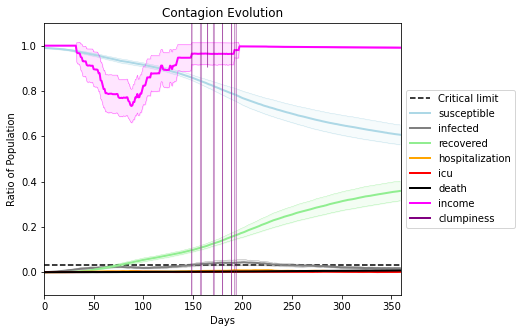

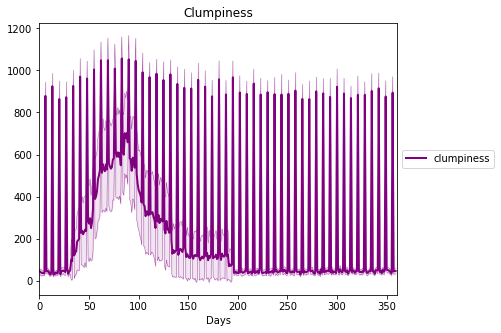

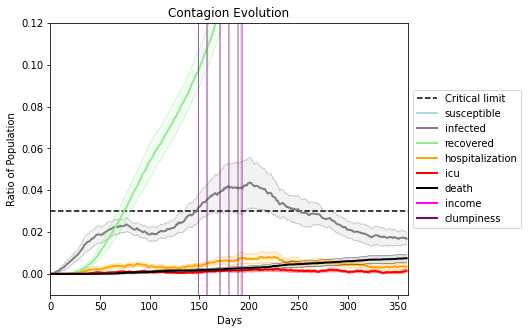

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6915, 5687, 2500, 5384, 2308, 1811, 911, 6199, 4243, 3680, 3259, 1842, 9265, 2998, 6020, 9889, 2220, 7715, 4922, 199]
Average similarity between family members is 0.4343935902803374 at temperature -0.8
Average similarity between family and home is 0.9998516280256232 at temperature -1
Average similarity between students and their classroom is 0.1528534683968921 at temperature -0.8
Average classroom occupancy is 1.6271186440677967 and number classrooms is 177
Average similarity between workers is 0.2900527659909374 at temperature -0.8
Average office occupancy is 3.282828282828283 and number offices is 198
Average friend similarity for adults: 0.4909218332515818 for kids: 0.38322965218457355
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.1584781504231811
avg restaurant similarity 0.04879637239941463
avg restaurant similarity 0.08888277182928372
avg restaurant similarity 0.09411034492651174
avg restaurant similarity 0.16525501552906516
avg restaurant similarity 0.059655103830883634
avg restaurant similarity 0.07475137589969146
avg restaurant similarity 0.12015546023313164
avg restaurant similarity 0.11934941860518805
avg restaurant similarity 0.06152512635950627
avg restaurant similarity 0.18268942755174336
avg restaurant similarity 0.13532530962903108
avg restaurant similarity 0.0987368394173735
avg restaurant similarity 0.11491695835445992
avg restaurant similarity 0.13707803825223847
avg restaurant similarity 0.10051117759911081
avg restaurant similarity 0.00945766863616425
avg restaurant similarity 0.09300577742872754
avg restaurant similarity 0.1498395923769952
avg restaurant similarity 0.09982347268225904
avg restaurant similarity 0.1287282265175134
avg restaurant similarity 0.075260847

avg restaurant similarity 0.07637950964815252
avg restaurant similarity 0.0733245094880233
avg restaurant similarity 0.08706701641449682
avg restaurant similarity 0.1314279612889442
avg restaurant similarity 0.0952821063082064
avg restaurant similarity 0.08039824102368791
avg restaurant similarity 0.1529400922066758
avg restaurant similarity 0.06160529779338254
avg restaurant similarity 0.08717652386736306
avg restaurant similarity 0.04370688433489829
avg restaurant similarity 0.10625336918472207
avg restaurant similarity 0.08412627095978283
avg restaurant similarity 0.09602854293376989
avg restaurant similarity 0.12240805103074223
avg restaurant similarity 0.05562726843567741
avg restaurant similarity 0.05366287207147617
avg restaurant similarity 0.035066960916354056
avg restaurant similarity 0.1398653697318641
avg restaurant similarity 0.12548414404059519
avg restaurant similarity 0.0689154464385653
avg restaurant similarity 0.05249471391714681
avg restaurant similarity 0.19353287028

avg restaurant similarity 0.09509865401384274
avg restaurant similarity 0.18776546823462367
Average similarity between family members is 0.44554778297635356 at temperature -0.8
Average similarity between family and home is 0.9998557482301711 at temperature -1
Average similarity between students and their classroom is 0.206885537879751 at temperature -0.8
Average classroom occupancy is 1.5944444444444446 and number classrooms is 180
Average similarity between workers is 0.3078295237143489 at temperature -0.8
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.5034266360794437 for kids: 0.3917622131986449
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity -0.013096221501442278
avg restaurant similarity 0.006040296015167506
avg restaurant similarity 0.07074717404921688
avg restaurant similarity 0.04981278599674471
avg restaurant similarity 0.038557827588316704
avg restaurant similarity 0.021886499881044488
avg restaurant similarity 0.0033594632263793506
avg restaurant similarity 0.08856656735626896
avg restaurant similarity 0.09306136026145857
avg restaurant similarity 0.07894548851056334
avg restaurant similarity -7.486532917005739e-05
avg restaurant similarity 0.08314476432333397
avg restaurant similarity 0.0769140210554933
avg restaurant similarity 0.05220582701045243
avg restaurant similarity 0.06750277086599844
avg restaurant similarity 0.13870170801492088
avg restaurant similarity 0.08986747083799652
avg restaurant similarity 0.10807954565843136
avg restaurant similarity 0.07902384065887712
avg restaurant similarity 0.09365970020219094
avg restaurant similarity 0.0674399088670083
avg restaurant similarity 

avg restaurant similarity 0.10153595597927242
avg restaurant similarity 0.09904613268798192
avg restaurant similarity 0.12786617968978023
avg restaurant similarity 0.05500030829024067
avg restaurant similarity 0.10369322416555782
avg restaurant similarity 0.12070896903991557
avg restaurant similarity -0.015437014931604527
avg restaurant similarity 0.049173723818299056
avg restaurant similarity 0.036494945051899076
avg restaurant similarity 0.08572289504836625
avg restaurant similarity 0.12139941480904892
avg restaurant similarity 0.09727193851096551
avg restaurant similarity 0.05546364148630875
avg restaurant similarity 0.05869409001054584
avg restaurant similarity 0.10212801482370178
avg restaurant similarity 0.11389075960548461
avg restaurant similarity 0.08933020912658714
avg restaurant similarity 0.09960038898146639
avg restaurant similarity 0.07217033449817076
avg restaurant similarity 0.07815391357427272
avg restaurant similarity 0.10327863729354626
avg restaurant similarity 0.06

avg restaurant similarity 0.039409127777120384
avg restaurant similarity 0.11759580902250066
avg restaurant similarity 0.09670930249907304
avg restaurant similarity 0.09299184456791379
Average similarity between family members is 0.4257069848084526 at temperature -0.8
Average similarity between family and home is 0.9998595962659395 at temperature -1
Average similarity between students and their classroom is 0.15232520740912925 at temperature -0.8
Average classroom occupancy is 1.625 and number classrooms is 176
Average similarity between workers is 0.2994257149664665 at temperature -0.8
Average office occupancy is 3.3333333333333335 and number offices is 198
Average friend similarity for adults: 0.4929910833151619 for kids: 0.37859585504544435
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.0840494681211954
avg restaurant similarity 0.07399670470857385
avg restaurant similarity 0.11443603543968145
avg restaurant similarity 0.10770689270403011
avg restaurant similarity 0.10893714852179298
avg restaurant similarity 0.04881615660631399
avg restaurant similarity 0.08272243617672626
avg restaurant similarity 0.0363008726705956
avg restaurant similarity 0.075182532230701
avg restaurant similarity 0.08273738614430395
avg restaurant similarity 0.10377209602794614
avg restaurant similarity 0.04176242925258832
avg restaurant similarity 0.08288652076217005
avg restaurant similarity 0.08377849746143137
avg restaurant similarity 0.0952225271337475
avg restaurant similarity 0.12313489562395526
avg restaurant similarity 0.10237562465396863
avg restaurant similarity 0.11886154054289866
avg restaurant similarity 0.11430279595428171
avg restaurant similarity 0.09791709392845452
avg restaurant similarity 0.03868191295851761
avg restaurant similarity 0.04418210662

avg restaurant similarity 0.09957755256940724
avg restaurant similarity 0.03706570216509907
avg restaurant similarity 0.005760676814785975
avg restaurant similarity 0.12101335034087264
avg restaurant similarity 0.05723222037695652
avg restaurant similarity 0.13606928533064652
avg restaurant similarity 0.06404437686325881
avg restaurant similarity 0.09141504703436419
avg restaurant similarity 0.11890444944988053
avg restaurant similarity 0.1277300165691568
avg restaurant similarity 0.08226841619578007
avg restaurant similarity 0.04585232301597047
avg restaurant similarity 0.09122920013228271
avg restaurant similarity 0.12744697831064394
avg restaurant similarity 0.11855422670208772
avg restaurant similarity 0.10196957044970403
avg restaurant similarity 0.08059774396965988
avg restaurant similarity 0.012855727617692186
avg restaurant similarity 0.07826552145387089
avg restaurant similarity 0.0656302124726602
avg restaurant similarity 0.07720475656731851
avg restaurant similarity 0.054966

avg restaurant similarity 0.11374103961707611
avg restaurant similarity 0.05554764814931485
avg restaurant similarity 0.13243266566606846
Average similarity between family members is 0.4328106100483383 at temperature -0.8
Average similarity between family and home is 0.9998526888722853 at temperature -1
Average similarity between students and their classroom is 0.18976548143960725 at temperature -0.8
Average classroom occupancy is 1.6519337016574585 and number classrooms is 181
Average similarity between workers is 0.3006165527085158 at temperature -0.8
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.49729932164846335 for kids: 0.3804794283470916
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.11003863818600672
avg restaurant similarity 0.10208013583230384
avg restaurant similarity 0.1495008256135877
avg restaurant similarity 0.08851389766767968
avg restaurant similarity 0.1171354603500318
avg restaurant similarity 0.06707834504131094
avg restaurant similarity 0.0711067804090034
avg restaurant similarity 0.08949421084274158
avg restaurant similarity 0.07482313099210917
avg restaurant similarity 0.09647828021913618
avg restaurant similarity 0.1548194744003922
avg restaurant similarity 0.1390376618829752
avg restaurant similarity 0.09452460685836431
avg restaurant similarity 0.11180467040953664
avg restaurant similarity 0.06738328211819854
avg restaurant similarity 0.09209253840697265
avg restaurant similarity 0.15095977878970074
avg restaurant similarity 0.12083335759142087
avg restaurant similarity 0.03146558156826828
avg restaurant similarity 0.05952077022157533
avg restaurant similarity 0.056256792237115966
avg restaurant similarity 0.0645820746

avg restaurant similarity 0.07789391906540857
avg restaurant similarity 0.06348098080208142
avg restaurant similarity 0.0959796381620689
avg restaurant similarity 0.0938931901169675
avg restaurant similarity 0.16958422318836383
avg restaurant similarity 0.09431990307492852
avg restaurant similarity 0.07376625372882287
avg restaurant similarity 0.07274286722060598
avg restaurant similarity 0.07727677888515583
avg restaurant similarity 0.03068963344293072
avg restaurant similarity 0.10666888288340076
avg restaurant similarity 0.1250029321306852
avg restaurant similarity 0.05920168412882962
avg restaurant similarity 0.05132114096514
avg restaurant similarity 0.09814362683905081
avg restaurant similarity 0.12223187770343769
avg restaurant similarity 0.17033059607352674
avg restaurant similarity 0.11394539503175333
avg restaurant similarity 0.04532925032014211
avg restaurant similarity 0.14597848609881853
avg restaurant similarity 0.1357585584913631
avg restaurant similarity 0.0124225424507

avg restaurant similarity 0.03015091328940932
avg restaurant similarity 0.12424145266066117
Average similarity between family members is 0.4195505540502804 at temperature -0.8
Average similarity between family and home is 0.9998589574969705 at temperature -1
Average similarity between students and their classroom is 0.12635547470691919 at temperature -0.8
Average classroom occupancy is 1.6171428571428572 and number classrooms is 175
Average similarity between workers is 0.2831319076603606 at temperature -0.8
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.487718788111084 for kids: 0.3663968087368121
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated uni

avg restaurant similarity 0.08314556279774271
avg restaurant similarity 0.08614015608304756
avg restaurant similarity 0.021054460776777965
avg restaurant similarity 0.05227945151300868
avg restaurant similarity 0.025374145350221648
avg restaurant similarity 0.0290916990302136
avg restaurant similarity 0.07289148133940099
avg restaurant similarity 0.05879261600448378
avg restaurant similarity 0.08487687270249653
avg restaurant similarity 0.1595528995574329
avg restaurant similarity 0.014188468736257195
avg restaurant similarity 0.12111555883375376
avg restaurant similarity -0.0032047566126255683
avg restaurant similarity 0.08363580103664611
avg restaurant similarity 0.07736639030896549
avg restaurant similarity 0.1018576687150961
avg restaurant similarity 0.13842556038017256
avg restaurant similarity 0.1225224943443604
avg restaurant similarity 0.10604006574578988
avg restaurant similarity 0.08292635971064172
avg restaurant similarity 0.1041046058599082
avg restaurant similarity 0.11050

avg restaurant similarity 0.09543435062996812
avg restaurant similarity 0.07053306488430891
avg restaurant similarity 0.050571888121486025
avg restaurant similarity 0.08956084966299097
avg restaurant similarity 0.08263903924909345
avg restaurant similarity 0.0717769181468919
avg restaurant similarity 0.07462946622920655
avg restaurant similarity 0.04681488859190251
avg restaurant similarity 0.04920554059783461
avg restaurant similarity 0.04421581335764358
avg restaurant similarity 0.129362405989151
avg restaurant similarity 0.009203398945077235
avg restaurant similarity 0.06980591328625253
avg restaurant similarity 0.07052106871448038
avg restaurant similarity 0.04614910097845461
avg restaurant similarity 0.06199166500395419
avg restaurant similarity 0.07402374903472371
avg restaurant similarity 0.04898177121086957
avg restaurant similarity 0.053610608193930785
avg restaurant similarity 0.09793091873194752
avg restaurant similarity 0.09446421779163416
avg restaurant similarity 0.100615

avg restaurant similarity 0.06774691108724
avg restaurant similarity 0.09220229046163511
avg restaurant similarity 0.11746809687485103
avg restaurant similarity 0.07862831356328898
Average similarity between family members is 0.4139223755675534 at temperature -0.8
Average similarity between family and home is 0.9998548026393197 at temperature -1
Average similarity between students and their classroom is 0.1755097028196111 at temperature -0.8
Average classroom occupancy is 1.6983240223463687 and number classrooms is 179
Average similarity between workers is 0.2598122880514444 at temperature -0.8
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.490560683353941 for kids: 0.3751814569652335
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1

avg restaurant similarity 0.06384318141506878
avg restaurant similarity 0.06733905078134059
avg restaurant similarity 0.041378621143635094
avg restaurant similarity 0.09418549635043505
avg restaurant similarity 0.0750483901641691
avg restaurant similarity 0.09564799508608852
avg restaurant similarity 0.08827769476599927
avg restaurant similarity 0.11957353427437986
avg restaurant similarity 0.08122273377458777
avg restaurant similarity 0.09258999260105755
avg restaurant similarity 0.1138451135993484
avg restaurant similarity 0.06537177123681207
avg restaurant similarity 0.12128274838851927
avg restaurant similarity 0.09503149540082582
avg restaurant similarity 0.09914700711969068
avg restaurant similarity 0.10967926560992045
avg restaurant similarity 0.07294825476935521
avg restaurant similarity 0.15973300507451382
avg restaurant similarity 0.05534371047449708
avg restaurant similarity 0.09801609261069816
avg restaurant similarity 0.0772320507892678
avg restaurant similarity 0.06749022

avg restaurant similarity 0.11231487078123374
avg restaurant similarity 0.07548990114383111
avg restaurant similarity 0.10026615557057689
avg restaurant similarity 0.05455114857678554
avg restaurant similarity 0.0887765524974589
avg restaurant similarity 0.08437950669989185
avg restaurant similarity 0.10746239034997568
avg restaurant similarity 0.09187099785223109
avg restaurant similarity 0.05805300313133522
avg restaurant similarity 0.04555448062423534
avg restaurant similarity 0.05232363706054904
avg restaurant similarity 0.09780910876722226
avg restaurant similarity 0.07598153830862688
avg restaurant similarity 0.10234710417134545
avg restaurant similarity 0.07033111416059647
avg restaurant similarity 0.09766864427593365
avg restaurant similarity 0.13778520510898026
avg restaurant similarity 0.06925535279741829
avg restaurant similarity 0.08651814302541164
avg restaurant similarity 0.11199266802831685
avg restaurant similarity 0.07713754939247747
avg restaurant similarity 0.0459692

avg restaurant similarity 0.08220718694210924
avg restaurant similarity 0.12125617780009385
Average similarity between family members is 0.429873323408928 at temperature -0.8
Average similarity between family and home is 0.9998548532243607 at temperature -1
Average similarity between students and their classroom is 0.16931864415157286 at temperature -0.8
Average classroom occupancy is 1.6173469387755102 and number classrooms is 196
Average similarity between workers is 0.30004380706663164 at temperature -0.8
Average office occupancy is 3.186868686868687 and number offices is 198
Average friend similarity for adults: 0.4935510437668533 for kids: 0.4011716383862133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated un

avg restaurant similarity 0.04672567353299891
avg restaurant similarity 0.0204825941208636
avg restaurant similarity 0.03840703006765842
avg restaurant similarity 0.05901469219104945
avg restaurant similarity 0.08417368521381387
avg restaurant similarity 0.10204442025803177
avg restaurant similarity 0.02162937508514775
avg restaurant similarity 0.08475286833790364
avg restaurant similarity 0.06940669679229676
avg restaurant similarity 0.08745934997060822
avg restaurant similarity 0.11119660849842235
avg restaurant similarity 0.026637930775950697
avg restaurant similarity 0.08312076267605548
avg restaurant similarity 0.06827036359933102
avg restaurant similarity 0.06895743405812618
avg restaurant similarity 0.062389800947833494
avg restaurant similarity 0.10623244735765833
avg restaurant similarity 0.1006487976440993
avg restaurant similarity 0.04202416812967292
avg restaurant similarity 0.07524929056544542
avg restaurant similarity 0.08094600202134612
avg restaurant similarity 0.079729

avg restaurant similarity 0.05558178197518489
avg restaurant similarity 0.06846064760503318
avg restaurant similarity 0.08323243751493002
avg restaurant similarity 0.04763145417627493
avg restaurant similarity 0.07625313202918675
avg restaurant similarity 0.05133545112882955
avg restaurant similarity 0.042631800425586
avg restaurant similarity 0.07242247903906844
avg restaurant similarity 0.07627444244311653
avg restaurant similarity -0.017572922458419914
avg restaurant similarity 0.03409941129217749
avg restaurant similarity -0.04401073679820179
avg restaurant similarity 0.09413372404827261
avg restaurant similarity 0.04581708989453703
avg restaurant similarity 0.10574589417786334
avg restaurant similarity 0.10188594839240592
avg restaurant similarity 0.04389687204676098
avg restaurant similarity 0.03594313749763555
avg restaurant similarity 0.07095478103505946
avg restaurant similarity 0.04920802149846108
avg restaurant similarity 0.10057524233577203
avg restaurant similarity 0.09655

avg restaurant similarity 0.079477047704491
avg restaurant similarity 0.05315825582842017
avg restaurant similarity 0.04257767804590786
avg restaurant similarity 0.05385096121909929
Average similarity between family members is 0.4303473383935466 at temperature -0.8
Average similarity between family and home is 0.9998526625032166 at temperature -1
Average similarity between students and their classroom is 0.1670577913827324 at temperature -0.8
Average classroom occupancy is 1.6497175141242937 and number classrooms is 177
Average similarity between workers is 0.30803758892008104 at temperature -0.8
Average office occupancy is 3.3451776649746194 and number offices is 197
Average friend similarity for adults: 0.49640593944679623 for kids: 0.38759226954749587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.0506568884257099
avg restaurant similarity 0.08476376011402247
avg restaurant similarity 0.1166985570838409
avg restaurant similarity 0.05340745677150154
avg restaurant similarity 0.07785086333549704
avg restaurant similarity 0.10263789609295307
avg restaurant similarity 0.07710843425467519
avg restaurant similarity 0.1079247792398096
avg restaurant similarity 0.11947918661208203
avg restaurant similarity 0.06632776245951724
avg restaurant similarity 0.09020473222813166
avg restaurant similarity 0.10050586366963299
avg restaurant similarity 0.04830086850701166
avg restaurant similarity 0.0443254140315182
avg restaurant similarity 0.09846490319122635
avg restaurant similarity 0.09987098765708742
avg restaurant similarity 0.16382957084146282
avg restaurant similarity 0.04064579474865234
avg restaurant similarity 0.11366742216933924
avg restaurant similarity 0.04942589516451419
avg restaurant similarity 0.10797677902235828
avg restaurant similarity 0.0650535924

avg restaurant similarity 0.053292506274278104
avg restaurant similarity 0.10329305427191247
avg restaurant similarity 0.08339484329516984
avg restaurant similarity 0.0823981794385242
avg restaurant similarity 0.13070436177479594
avg restaurant similarity 0.08174551335997926
avg restaurant similarity 0.08978712930801817
avg restaurant similarity 0.07916156810736455
avg restaurant similarity 0.08477259362104828
avg restaurant similarity 0.0763225640291981
avg restaurant similarity 0.05110053325973592
avg restaurant similarity 0.10174341776778922
avg restaurant similarity 0.09396207412375873
avg restaurant similarity 0.08925801954825908
avg restaurant similarity 0.09733634717213221
avg restaurant similarity 0.07139502312897936
avg restaurant similarity 0.09612831927147737
avg restaurant similarity 0.08450600474326743
avg restaurant similarity 0.07188577195728134
avg restaurant similarity 0.03799214577819925
avg restaurant similarity 0.09907772221371793
avg restaurant similarity 0.0700421

avg restaurant similarity 0.07463502014855333
avg restaurant similarity 0.14132391091068927
Average similarity between family members is 0.4203465564985275 at temperature -0.8
Average similarity between family and home is 0.999852848998161 at temperature -1
Average similarity between students and their classroom is 0.21296141109369615 at temperature -0.8
Average classroom occupancy is 1.7257142857142858 and number classrooms is 175
Average similarity between workers is 0.28107501761366444 at temperature -0.8
Average office occupancy is 3.185929648241206 and number offices is 199
Average friend similarity for adults: 0.48685323465270575 for kids: 0.38453925918694476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.06442853044064066
avg restaurant similarity 0.09215135516137345
avg restaurant similarity 0.0614264516583217
avg restaurant similarity 0.08586301550410369
avg restaurant similarity 0.05660042706631188
avg restaurant similarity 0.12217724077924624
avg restaurant similarity 0.06043781075079958
avg restaurant similarity 0.12976899088009533
avg restaurant similarity 0.13074022322844883
avg restaurant similarity 0.12094966767055532
avg restaurant similarity 0.04563961231538615
avg restaurant similarity 0.09539323691807995
avg restaurant similarity 0.06644256238391785
avg restaurant similarity 0.0380259343547554
avg restaurant similarity 0.05601449264542149
avg restaurant similarity 0.06066529515526836
avg restaurant similarity 0.11639429708453346
avg restaurant similarity 0.04454832225406395
avg restaurant similarity 0.12423598972721375
avg restaurant similarity 0.027134042677106136
avg restaurant similarity 0.07043937180366526
avg restaurant similarity 0.1298952

avg restaurant similarity 0.07911073301212576
avg restaurant similarity 0.040145920128537585
avg restaurant similarity 0.07374730314782876
avg restaurant similarity 0.10946310675131588
avg restaurant similarity 0.07722878806351789
avg restaurant similarity 0.07755855272889876
avg restaurant similarity 0.07391900903580609
avg restaurant similarity 0.08611641208089188
avg restaurant similarity 0.07214144568169481
avg restaurant similarity 0.11525859625378063
avg restaurant similarity 0.06509833128202801
avg restaurant similarity 0.10525254404797617
avg restaurant similarity 0.033381036080740153
avg restaurant similarity 0.07062564893937631
avg restaurant similarity 0.0919390743920151
avg restaurant similarity 0.10298091929581563
avg restaurant similarity 0.07800368818804412
avg restaurant similarity 0.0662893394604463
avg restaurant similarity 0.02837702881112127
avg restaurant similarity 0.12137389347217674
avg restaurant similarity 0.08317196715087856
avg restaurant similarity 0.092427

avg restaurant similarity 0.07077348123374305
avg restaurant similarity 0.12461474236242803
Average similarity between family members is 0.43124057191659504 at temperature -0.8
Average similarity between family and home is 0.9998508749710423 at temperature -1
Average similarity between students and their classroom is 0.14341728912295434 at temperature -0.8
Average classroom occupancy is 1.6685714285714286 and number classrooms is 175
Average similarity between workers is 0.28366509712384663 at temperature -0.8
Average office occupancy is 3.3197969543147208 and number offices is 197
Average friend similarity for adults: 0.4946981718480227 for kids: 0.38606851445260154
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.1253939386709334
avg restaurant similarity 0.05101288167034941
avg restaurant similarity 0.07030651392183697
avg restaurant similarity 0.12403742100078984
avg restaurant similarity 0.03442506774764122
avg restaurant similarity 0.0863564739669255
avg restaurant similarity -0.030088087509348282
avg restaurant similarity 0.10217177655611309
avg restaurant similarity 0.0798775965130667
avg restaurant similarity 0.10060876704057697
avg restaurant similarity 0.03209908788132115
avg restaurant similarity 0.07101539533261456
avg restaurant similarity 0.15864389780457533
avg restaurant similarity 0.1026565024701955
avg restaurant similarity -0.00772256182958116
avg restaurant similarity 0.02564383806692075
avg restaurant similarity 0.044136755825573165
avg restaurant similarity 0.06943706885571105
avg restaurant similarity 0.0375416019525872
avg restaurant similarity 0.02773079894388818
avg restaurant similarity 0.12567607992157143
avg restaurant similarity 0.1631941

avg restaurant similarity 0.10048196822756221
avg restaurant similarity 0.06114272396467015
avg restaurant similarity 0.11796704642645497
avg restaurant similarity 0.06816672088708829
avg restaurant similarity 0.10325333452539812
avg restaurant similarity 0.08376979906932075
avg restaurant similarity 0.0639775981653265
avg restaurant similarity 0.0337250914604133
avg restaurant similarity 0.1316931246414683
avg restaurant similarity 0.10226497648815162
avg restaurant similarity 0.11839882919332542
avg restaurant similarity 0.09440578020726036
avg restaurant similarity 0.06620902957008543
avg restaurant similarity 0.06891465221660723
avg restaurant similarity 0.024966056637806707
avg restaurant similarity 0.08249733310732874
avg restaurant similarity 0.16083256911409965
avg restaurant similarity 0.0854408949543096
avg restaurant similarity 0.011750863755075475
avg restaurant similarity 0.045819701861071246
avg restaurant similarity 0.05963236797467106
avg restaurant similarity 0.0516701

avg restaurant similarity 0.07176836794772432
avg restaurant similarity 0.08391330899150858
avg restaurant similarity 0.10446187144930529
Average similarity between family members is 0.42706870660688756 at temperature -0.8
Average similarity between family and home is 0.9998608156781571 at temperature -1
Average similarity between students and their classroom is 0.1735159677569319 at temperature -0.8
Average classroom occupancy is 1.61139896373057 and number classrooms is 193
Average similarity between workers is 0.2941836892676608 at temperature -0.8
Average office occupancy is 3.292307692307692 and number offices is 195
Average friend similarity for adults: 0.5000220689184951 for kids: 0.39975617073882164
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.14590357824233585
avg restaurant similarity 0.0963380981073066
avg restaurant similarity 0.13317915717117715
avg restaurant similarity 0.12960834143662883
avg restaurant similarity 0.08019341712455622
avg restaurant similarity 0.10501254245844703
avg restaurant similarity 0.07221236231537011
avg restaurant similarity 0.0790228673307893
avg restaurant similarity 0.12169126659803145
avg restaurant similarity 0.12484370468969987
avg restaurant similarity 0.1286894775547467
avg restaurant similarity 0.08875917403330842
avg restaurant similarity 0.15514300320223529
avg restaurant similarity 0.1374210813201195
avg restaurant similarity 0.11371667073960282
avg restaurant similarity 0.1262499779834498
avg restaurant similarity 0.10302491016559613
avg restaurant similarity 0.09520121367628409
avg restaurant similarity 0.10566249760816791
avg restaurant similarity 0.11972369185521843
avg restaurant similarity 0.12830442085933655
avg restaurant similarity 0.13467935371

avg restaurant similarity 0.06919680173737953
avg restaurant similarity 0.08533794075281217
avg restaurant similarity 0.10921057623661766
avg restaurant similarity 0.07112703365542092
avg restaurant similarity 0.11229348986251148
avg restaurant similarity 0.110290116053295
avg restaurant similarity 0.1047882583530667
avg restaurant similarity 0.01115167932498855
avg restaurant similarity 0.093583881920741
avg restaurant similarity 0.05613701713929091
avg restaurant similarity 0.06582581581573924
avg restaurant similarity 0.16804485499235353
avg restaurant similarity 0.1784968810894078
avg restaurant similarity 0.1440003287407459
avg restaurant similarity 0.16025883525766318
avg restaurant similarity 0.11959628483957023
avg restaurant similarity 0.07803226484545939
avg restaurant similarity 0.10380362807929618
avg restaurant similarity 0.10793884870118409
avg restaurant similarity 0.09811024975971601
avg restaurant similarity 0.11985685242380838
avg restaurant similarity 0.1046040218283

avg restaurant similarity 0.09210810546568621
avg restaurant similarity 0.14837572787215275
Average similarity between family members is 0.399321108288757 at temperature -0.8
Average similarity between family and home is 0.9998639935731622 at temperature -1
Average similarity between students and their classroom is 0.14639562816421522 at temperature -0.8
Average classroom occupancy is 1.7180851063829787 and number classrooms is 188
Average similarity between workers is 0.29370782910238197 at temperature -0.8
Average office occupancy is 3.07 and number offices is 200
Average friend similarity for adults: 0.4834327444788414 for kids: 0.39448376757546444
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a

avg restaurant similarity 0.050444904108854854
avg restaurant similarity 0.053947411953166026
avg restaurant similarity 0.06635989570126198
avg restaurant similarity 0.09600761289440833
avg restaurant similarity 0.060475601109913346
avg restaurant similarity 0.10772312262727214
avg restaurant similarity 0.044437128242092894
avg restaurant similarity 0.051945365786231525
avg restaurant similarity 0.030237877619306814
avg restaurant similarity 0.1042321468358291
avg restaurant similarity 0.06584327980815731
avg restaurant similarity 0.0943512965416835
avg restaurant similarity 0.08265119224037051
avg restaurant similarity 0.06769868331769308
avg restaurant similarity 0.08865574924527943
avg restaurant similarity 0.08405875400321577
avg restaurant similarity 0.08991822583261769
avg restaurant similarity 0.02269644994066411
avg restaurant similarity 0.0196762635814652
avg restaurant similarity 0.022824081833845707
avg restaurant similarity 0.06090993283090719
avg restaurant similarity 0.05

avg restaurant similarity 0.05090139123803127
avg restaurant similarity 0.08102128904383266
avg restaurant similarity 0.057462417047847915
avg restaurant similarity 0.05228122813307642
avg restaurant similarity 0.027669048426711144
avg restaurant similarity 0.044811102516905746
avg restaurant similarity 0.08520602639296053
avg restaurant similarity 0.033568487629569446
avg restaurant similarity 0.07327861764519458
avg restaurant similarity 0.018791398430114344
avg restaurant similarity 0.0650804614615606
avg restaurant similarity 0.11881134343158394
avg restaurant similarity 0.07471078083104514
avg restaurant similarity 0.024501266574453714
avg restaurant similarity 0.0670116057527965
avg restaurant similarity 0.05258389380799264
avg restaurant similarity 0.0739787483434507
avg restaurant similarity 0.05210517404323238
avg restaurant similarity 0.0712278193810511
avg restaurant similarity 0.03469731366382679
avg restaurant similarity 0.11374580789239293
avg restaurant similarity 0.0837

avg restaurant similarity 0.019224626653665883
avg restaurant similarity 0.057820982127547056
avg restaurant similarity 0.05078038645125557
avg restaurant similarity 0.060992883304574703
Average similarity between family members is 0.4216937871955608 at temperature -0.8
Average similarity between family and home is 0.9998536138856426 at temperature -1
Average similarity between students and their classroom is 0.1766395412219109 at temperature -0.8
Average classroom occupancy is 1.5842105263157895 and number classrooms is 190
Average similarity between workers is 0.2999373407365719 at temperature -0.8
Average office occupancy is 3.1029411764705883 and number offices is 204
Average friend similarity for adults: 0.497932154816523 for kids: 0.3891421453917183
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.05614762570392144
avg restaurant similarity 0.14088049461873878
avg restaurant similarity 0.05581296278724361
avg restaurant similarity 0.09766725661775355
avg restaurant similarity 0.07264017398090561
avg restaurant similarity 0.10007023609377742
avg restaurant similarity 0.056212487478944494
avg restaurant similarity 0.14820245242234
avg restaurant similarity 0.08712441548864423
avg restaurant similarity 0.040841618120319674
avg restaurant similarity 0.029937474794998958
avg restaurant similarity 0.09104502456767684
avg restaurant similarity 0.05488799745956529
avg restaurant similarity 0.10784943799450628
avg restaurant similarity 0.037992880547344315
avg restaurant similarity 0.01203262147995722
avg restaurant similarity 0.10015873426010422
avg restaurant similarity 0.1053428768653378
avg restaurant similarity 0.08118387988588852
avg restaurant similarity 0.12584762473069747
avg restaurant similarity 0.06908321342503103
avg restaurant similarity 0.126450

avg restaurant similarity 0.1189140338991709
avg restaurant similarity 0.09674231957386534
avg restaurant similarity 0.08348625876672272
avg restaurant similarity 0.05981284767104932
avg restaurant similarity 0.08598375501040988
avg restaurant similarity 0.08771978467466517
avg restaurant similarity 0.10592078865557382
avg restaurant similarity 0.08414814111605735
avg restaurant similarity 0.10004292220236918
avg restaurant similarity 0.05418057957918346
avg restaurant similarity 0.12860333535125817
avg restaurant similarity 0.13453952873101224
avg restaurant similarity 0.11560515761355632
avg restaurant similarity 0.07210638629665692
avg restaurant similarity 0.094906898134165
avg restaurant similarity 0.14165695097657569
avg restaurant similarity 0.08145077415405617
avg restaurant similarity 0.07864014509482063
avg restaurant similarity 0.15526595272099106
avg restaurant similarity 0.057745837243428313
avg restaurant similarity 0.08642507581212293
avg restaurant similarity 0.13327489

avg restaurant similarity 0.08039208628291901
avg restaurant similarity 0.10621158621596889
Average similarity between family members is 0.43392101572786596 at temperature -0.8
Average similarity between family and home is 0.9998580255967509 at temperature -1
Average similarity between students and their classroom is 0.1900238283935021 at temperature -0.8
Average classroom occupancy is 1.532258064516129 and number classrooms is 186
Average similarity between workers is 0.3100945646469944 at temperature -0.8
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.493554819329243 for kids: 0.39203404245210294
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.0847136702996187
avg restaurant similarity 0.07270772913753468
avg restaurant similarity 0.09281068181257593
avg restaurant similarity 0.04448458767655831
avg restaurant similarity 0.08957846454726912
avg restaurant similarity 0.07218995662059328
avg restaurant similarity 0.07015286254466155
avg restaurant similarity 0.07494313203399847
avg restaurant similarity 0.0913611060616597
avg restaurant similarity 0.06102719405327883
avg restaurant similarity 0.06088406934706205
avg restaurant similarity 0.14574144374690495
avg restaurant similarity 0.06876779397930805
avg restaurant similarity 0.07378688113862926
avg restaurant similarity 0.1141150162528946
avg restaurant similarity 0.11640083047476754
avg restaurant similarity 0.013860117415988952
avg restaurant similarity 0.061787548846158176
avg restaurant similarity 0.06515173742360324
avg restaurant similarity 0.07763598227841392
avg restaurant similarity 0.15797177005114613
avg restaurant similarity 0.0620362

avg restaurant similarity 0.07666239699924246
avg restaurant similarity 0.05652492372605757
avg restaurant similarity 0.1112054705535316
avg restaurant similarity 0.09594365497755716
avg restaurant similarity 0.12056898792149719
avg restaurant similarity 0.07288497457756477
avg restaurant similarity 0.09300566857577729
avg restaurant similarity 0.07279614448033736
avg restaurant similarity 0.002027241048212767
avg restaurant similarity 0.014339394247506665
avg restaurant similarity 0.10388977923791456
avg restaurant similarity 0.024280033045087863
avg restaurant similarity 0.04327002219165298
avg restaurant similarity 0.057476422290426384
avg restaurant similarity 0.08207831372445934
avg restaurant similarity 0.07360902063986306
avg restaurant similarity 0.11606548296134232
avg restaurant similarity 0.12934088723503256
avg restaurant similarity 0.08049771238395272
avg restaurant similarity 0.06388589123301577
avg restaurant similarity 0.09030502181306536
avg restaurant similarity 0.075

avg restaurant similarity 0.05574226434370739
avg restaurant similarity 0.07495543413691942
avg restaurant similarity 0.08459849720470448
Average similarity between family members is 0.431584837796257 at temperature -0.8
Average similarity between family and home is 0.9998690274569061 at temperature -1
Average similarity between students and their classroom is 0.1627218846510846 at temperature -0.8
Average classroom occupancy is 1.6703296703296704 and number classrooms is 182
Average similarity between workers is 0.2762958661830792 at temperature -0.8
Average office occupancy is 3.167487684729064 and number offices is 203
Average friend similarity for adults: 0.4890602893280886 for kids: 0.3893195490138871
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.10191150309531657
avg restaurant similarity 0.060002992482706866
avg restaurant similarity 0.0548719634798908
avg restaurant similarity 0.12391324410208844
avg restaurant similarity 0.06601836587153241
avg restaurant similarity 0.034415841543327254
avg restaurant similarity -0.0008936992760891319
avg restaurant similarity 0.1322929977669436
avg restaurant similarity 0.07121348459534009
avg restaurant similarity 0.07196406738798639
avg restaurant similarity 0.03522550861753009
avg restaurant similarity 0.07790002343135938
avg restaurant similarity -0.00880037771013543
avg restaurant similarity 0.04772184065332548
avg restaurant similarity 0.13097370263248087
avg restaurant similarity 0.12043808792576095
avg restaurant similarity 0.0677527064834685
avg restaurant similarity 0.08782285806941413
avg restaurant similarity 0.08843414704715562
avg restaurant similarity 0.1286142983275588
avg restaurant similarity 0.043668546850817086
avg restaurant similarity 0.046

avg restaurant similarity 0.059492799947710395
avg restaurant similarity 0.08459593779549125
avg restaurant similarity 0.08646747899525177
avg restaurant similarity 0.03471114362810265
avg restaurant similarity 0.08135533591811266
avg restaurant similarity 0.113946771814463
avg restaurant similarity 0.09807681033150319
avg restaurant similarity -0.004239634720697636
avg restaurant similarity 0.09731996825447098
avg restaurant similarity 0.0913808268154352
avg restaurant similarity 0.13855797698691993
avg restaurant similarity 0.06769198531434471
avg restaurant similarity 0.0692581976839087
avg restaurant similarity 0.0707779102696045
avg restaurant similarity 0.0693594257797568
avg restaurant similarity 0.0628114732147126
avg restaurant similarity 0.020978604568609876
avg restaurant similarity 0.0723356199306933
avg restaurant similarity 0.03978493596180858
avg restaurant similarity -0.006300610932512466
avg restaurant similarity 0.036548742791873826
avg restaurant similarity 0.0073826

avg restaurant similarity 0.023434355073859263
avg restaurant similarity 0.09057125732017501
avg restaurant similarity 0.093779650464907
avg restaurant similarity 0.031244914096118247
Average similarity between family members is 0.41614290351819966 at temperature -0.8
Average similarity between family and home is 0.9998605136569209 at temperature -1
Average similarity between students and their classroom is 0.1639029876049624 at temperature -0.8
Average classroom occupancy is 1.6687116564417177 and number classrooms is 163
Average similarity between workers is 0.28989802409981197 at temperature -0.8
Average office occupancy is 3.3069306930693068 and number offices is 202
Average friend similarity for adults: 0.49277181068212705 for kids: 0.3838705006726657
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.12859149659336566
avg restaurant similarity 0.047284468303195576
avg restaurant similarity 0.08295044129887341
avg restaurant similarity 0.11725623030029793
avg restaurant similarity 0.056346961173648215
avg restaurant similarity 0.09254456354228953
avg restaurant similarity 0.030980071151943057
avg restaurant similarity 0.12222785814672649
avg restaurant similarity 0.05631521564424561
avg restaurant similarity 0.11325706656151542
avg restaurant similarity 0.06533240218049373
avg restaurant similarity 0.09009935036495725
avg restaurant similarity 0.050884553371101524
avg restaurant similarity 0.08726032514038354
avg restaurant similarity 0.04084058107219423
avg restaurant similarity 0.07127450765083126
avg restaurant similarity 0.030944457715133857
avg restaurant similarity 0.11047341472348526
avg restaurant similarity 0.09213032992858182
avg restaurant similarity 0.10975730618816179
avg restaurant similarity 0.071497211498816
avg restaurant similarity 0.060

avg restaurant similarity 0.1099818592082818
avg restaurant similarity 0.10381318776139
avg restaurant similarity 0.0838256173777889
avg restaurant similarity 0.04427377934616192
avg restaurant similarity 0.10526704603910876
avg restaurant similarity 0.06533460564497119
avg restaurant similarity 0.04315989696292
avg restaurant similarity 0.07175649291594036
avg restaurant similarity 0.09030898092226809
avg restaurant similarity 0.033327496374946176
avg restaurant similarity 0.09809537520943423
avg restaurant similarity 0.10389842741293678
avg restaurant similarity 0.05007016043774804
avg restaurant similarity 0.03993418809438203
avg restaurant similarity 0.014828815329184699
avg restaurant similarity 0.09654044393852619
avg restaurant similarity 0.07303931665054281
avg restaurant similarity 0.09152424538004965
avg restaurant similarity 0.05587904976489179
avg restaurant similarity 0.09404393382318399
avg restaurant similarity 0.07784778738752386
avg restaurant similarity 0.079357156545

avg restaurant similarity 0.10161726011482726
avg restaurant similarity 0.027455199906474114
avg restaurant similarity 0.008547824257914957
Average similarity between family members is 0.40075897111186265 at temperature -0.8
Average similarity between family and home is 0.9998591869398538 at temperature -1
Average similarity between students and their classroom is 0.1846846748771213 at temperature -0.8
Average classroom occupancy is 1.5548780487804879 and number classrooms is 164
Average similarity between workers is 0.27819675299536795 at temperature -0.8
Average office occupancy is 3.371287128712871 and number offices is 202
Average friend similarity for adults: 0.49340671048742357 for kids: 0.35211372363255145
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.06609058774054657
avg restaurant similarity 0.011993660589184597
avg restaurant similarity 0.07252691492513895
avg restaurant similarity 0.0779898119300151
avg restaurant similarity 0.06595006358216683
avg restaurant similarity 0.12194024009775345
avg restaurant similarity 0.10155964097499738
avg restaurant similarity 0.07869596092965667
avg restaurant similarity 0.10827476648964866
avg restaurant similarity 0.08129190082376185
avg restaurant similarity 0.038037905863059586
avg restaurant similarity 0.10772987599395828
avg restaurant similarity 0.09812697936142543
avg restaurant similarity 0.07365142003806215
avg restaurant similarity 0.05783168681170331
avg restaurant similarity 0.060146456761303556
avg restaurant similarity 0.05963351793714844
avg restaurant similarity 0.0189125770708591
avg restaurant similarity 0.07961989748471887
avg restaurant similarity 0.08296828740162417
avg restaurant similarity 0.09541735035171288
avg restaurant similarity 0.09964

avg restaurant similarity 0.05230672784341716
avg restaurant similarity 0.07394968762891484
avg restaurant similarity 0.10319883152863407
avg restaurant similarity 0.08316735846731027
avg restaurant similarity 0.08672707003159522
avg restaurant similarity 0.09797017290171955
avg restaurant similarity 0.06335940089795265
avg restaurant similarity 0.078203955232627
avg restaurant similarity 0.11001387732628415
avg restaurant similarity 0.0485170224054606
avg restaurant similarity 0.10833449662670626
avg restaurant similarity 0.08198405159935925
avg restaurant similarity 0.05047156619402681
avg restaurant similarity 0.03312669239437629
avg restaurant similarity 0.029753468610619855
avg restaurant similarity 0.05859208000911718
avg restaurant similarity 0.06397685614355349
avg restaurant similarity 0.09269569268676886
avg restaurant similarity 0.07146128680259546
avg restaurant similarity 0.06226974296925723
avg restaurant similarity 0.09107976606949103
avg restaurant similarity 0.09191635

avg restaurant similarity 0.05994538580491306
avg restaurant similarity 0.03264566807455319
avg restaurant similarity 0.13216465540342368
avg restaurant similarity 0.10549869317637948
Average similarity between family members is 0.43481241772940366 at temperature -0.8
Average similarity between family and home is 0.9998469595401045 at temperature -1
Average similarity between students and their classroom is 0.1901701377466066 at temperature -0.8
Average classroom occupancy is 1.5705882352941176 and number classrooms is 170
Average similarity between workers is 0.2942084159775819 at temperature -0.8
Average office occupancy is 3.4974093264248705 and number offices is 193
Average friend similarity for adults: 0.5027187523209995 for kids: 0.38573503623795163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.10684623749732006
avg restaurant similarity 0.051819217139605876
avg restaurant similarity 0.024035586727799516
avg restaurant similarity 0.10882805545778511
avg restaurant similarity 0.10683877577136167
avg restaurant similarity 0.0864205930063225
avg restaurant similarity 0.11701836912335006
avg restaurant similarity 0.14720888517827027
avg restaurant similarity 0.16441698400618834
avg restaurant similarity 0.08744591994427693
avg restaurant similarity 0.08914714215280461
avg restaurant similarity 0.09933989237222439
avg restaurant similarity 0.09235885058305267
avg restaurant similarity 0.06451153374572624
avg restaurant similarity 0.13642663208606892
avg restaurant similarity 0.10701894801885227
avg restaurant similarity 0.1172785869943832
avg restaurant similarity 0.10019596041390366
avg restaurant similarity 0.11543608293924454
avg restaurant similarity 0.13040025576794378
avg restaurant similarity 0.13228224172591166
avg restaurant similarity 0.105001

avg restaurant similarity 0.07133918395167979
avg restaurant similarity 0.09928063943457922
avg restaurant similarity 0.18369050776649584
avg restaurant similarity 0.12523983537128283
avg restaurant similarity 0.025535644006059663
avg restaurant similarity 0.06601670119977177
avg restaurant similarity 0.08042721235637718
avg restaurant similarity 0.07568450661256404
avg restaurant similarity 0.10461551921302178
avg restaurant similarity 0.13557783684775615
avg restaurant similarity 0.11077937786580054
avg restaurant similarity 0.07069982332727665
avg restaurant similarity 0.08857417699448024
avg restaurant similarity 0.12037780694614703
avg restaurant similarity 0.09732255069433152
avg restaurant similarity 0.06701895860532785
avg restaurant similarity 0.1419208981249884
avg restaurant similarity 0.1740130533808065
avg restaurant similarity 0.09060713199927692
avg restaurant similarity 0.06517764049446104
avg restaurant similarity 0.06819388059375127
avg restaurant similarity 0.1335134

avg restaurant similarity 0.0672813713552526
avg restaurant similarity 0.015136945787314518
Average similarity between family members is 0.4407393830458375 at temperature -0.8
Average similarity between family and home is 0.9998568972838919 at temperature -1
Average similarity between students and their classroom is 0.17030308378516806 at temperature -0.8
Average classroom occupancy is 1.618279569892473 and number classrooms is 186
Average similarity between workers is 0.3011755990481769 at temperature -0.8
Average office occupancy is 3.196078431372549 and number offices is 204
Average friend similarity for adults: 0.48815680501574626 for kids: 0.3879828140516819
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.0852225568427033
avg restaurant similarity 0.09694400300773452
avg restaurant similarity 0.07511530339622136
avg restaurant similarity 0.02906011324165193
avg restaurant similarity 0.13808206041977245
avg restaurant similarity 0.08981513503777869
avg restaurant similarity 0.06115336273899144
avg restaurant similarity 0.03283390756535668
avg restaurant similarity 0.1016043092181815
avg restaurant similarity 0.10927137105193732
avg restaurant similarity 0.06435898821361573
avg restaurant similarity 0.0708719124104016
avg restaurant similarity 0.12796522430567986
avg restaurant similarity 0.15376492650681864
avg restaurant similarity 0.034047546145213714
avg restaurant similarity 0.1047040258407185
avg restaurant similarity 0.09309729489903677
avg restaurant similarity 0.1192770623306519
avg restaurant similarity 0.1347700488849528
avg restaurant similarity 0.027947935553938985
avg restaurant similarity 0.07250884254853915
avg restaurant similarity 0.1372763662

avg restaurant similarity 0.11487636676542806
avg restaurant similarity 0.07711003858039452
avg restaurant similarity 0.10175773502861943
avg restaurant similarity 0.07679055710330972
avg restaurant similarity 0.0588628115435633
avg restaurant similarity 0.12251962651352584
avg restaurant similarity 0.14784111955888452
avg restaurant similarity 0.06589248065923704
avg restaurant similarity 0.1076376114032905
avg restaurant similarity -0.007872412932497666
avg restaurant similarity 0.041354091997313054
avg restaurant similarity 0.09653391469052074
avg restaurant similarity 0.10871357926153227
avg restaurant similarity 0.1105749633755115
avg restaurant similarity 0.05979295287376139
avg restaurant similarity 0.08024690405619851
avg restaurant similarity 0.09029293878315048
avg restaurant similarity 0.12110056658465751
avg restaurant similarity 0.1459777667663446
avg restaurant similarity 0.0744708539616121
avg restaurant similarity 0.16270249029634914
avg restaurant similarity 0.09531354

avg restaurant similarity 0.052269672907049904
avg restaurant similarity 0.06237895109036781
Average similarity between family members is 0.42298187798997816 at temperature -0.8
Average similarity between family and home is 0.9998523874192013 at temperature -1
Average similarity between students and their classroom is 0.18323569344934545 at temperature -0.8
Average classroom occupancy is 1.6120218579234973 and number classrooms is 183
Average similarity between workers is 0.2929662836175465 at temperature -0.8
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.48989576882131836 for kids: 0.3829070879262113
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloca

avg restaurant similarity 0.1273258474346239
avg restaurant similarity 0.0643774455913324
avg restaurant similarity 0.1159100739628906
avg restaurant similarity 0.09464405737061282
avg restaurant similarity 0.17546722838867776
avg restaurant similarity 0.1315104690024407
avg restaurant similarity 0.1639914935762739
avg restaurant similarity 0.0911427708257636
avg restaurant similarity 0.06520826219046255
avg restaurant similarity 0.13244562049274147
avg restaurant similarity 0.11067954712108957
avg restaurant similarity 0.08610599856339944
avg restaurant similarity 0.12685410557470592
avg restaurant similarity 0.141210759527885
avg restaurant similarity 0.09270706114061558
avg restaurant similarity 0.09865880449633664
avg restaurant similarity 0.10479548693458073
avg restaurant similarity 0.15344123076716562
avg restaurant similarity 0.11845785712363062
avg restaurant similarity 0.0367997607054326
avg restaurant similarity 0.05579689497717371
avg restaurant similarity 0.108965589500949

avg restaurant similarity 0.11504436915677621
avg restaurant similarity 0.10819396660464033
avg restaurant similarity 0.14160492226277047
avg restaurant similarity 0.06244376061807312
avg restaurant similarity 0.12654319347585846
avg restaurant similarity 0.14049718266551534
avg restaurant similarity 0.10179140745180668
avg restaurant similarity 0.14950656884674354
avg restaurant similarity 0.05395633416373305
avg restaurant similarity 0.08143873227647011
avg restaurant similarity 0.0857583420549326
avg restaurant similarity 0.15645756555247206
avg restaurant similarity 0.14511935269128198
avg restaurant similarity 0.10330614343895814
avg restaurant similarity 0.10388004066454132
avg restaurant similarity 0.13956286035751742
avg restaurant similarity 0.08220967565803464
avg restaurant similarity 0.07020862399737764
avg restaurant similarity 0.16805017439524372
avg restaurant similarity 0.10680911290072548
avg restaurant similarity 0.10552704944236144
avg restaurant similarity 0.1068748

avg restaurant similarity 0.10848565338192945
avg restaurant similarity 0.09529383048797149
using average of time series:
stats on susceptible:
data: [0.8505583333333332, 0.904175, 0.760025, 0.7811055555555555, 0.8470555555555556, 0.8302305555555555, 0.7790916666666667, 0.8244777777777779, 0.8228138888888888, 0.8492396492396491, 0.8746750000000001, 0.7782, 0.8298305555555556, 0.7753777777777777, 0.8211916666666668, 0.7302694444444444, 0.8244, 0.8024222222222221, 0.7438590678153302, 0.7490861111111109]
min:
0.7302694444444444
max:
0.904175
std:
0.04477260242500649
mean:
0.8089042414083046
median:
0.8220027777777779
95% confidence interval for the mean:
(0.7874056622790815,0.8304028205375278)
using average of time series:
stats on infected:
data: [0.01768611111111111, 0.012119444444444443, 0.024861111111111115, 0.026000000000000002, 0.019266666666666668, 0.018775, 0.02611666666666667, 0.022355555555555556, 0.02353611111111111, 0.01827061827061827, 0.013780555555555556, 0.0267722222222222

(<function dict.items>, <function dict.items>, <function dict.items>)

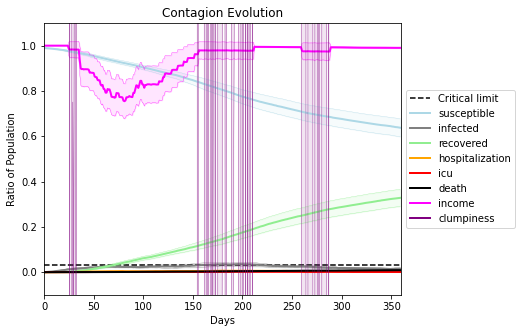

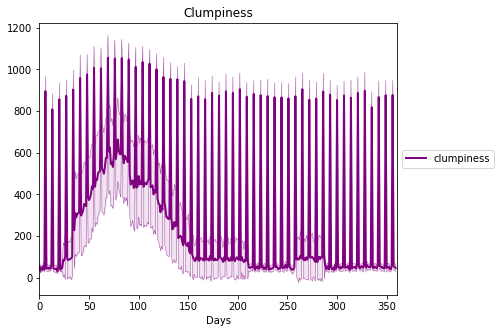

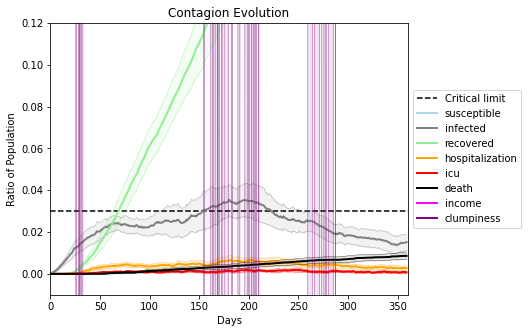

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7361, 8177, 8134, 548, 2547, 5151, 3639, 7551, 8627, 2767, 1692, 5860, 3947, 4436, 7402, 2190, 1617, 4856, 5804, 4774]
Average similarity between family members is 0.343389238113896 at temperature -0.7
Average similarity between family and home is 0.999859923913615 at temperature -1
Average similarity between students and their classroom is 0.16972051606172095 at temperature -0.7
Average classroom occupancy is 1.641711229946524 and number classrooms is 187
Average similarity between workers is 0.19505523841307268 at temperature -0.7
Average office occupancy is 3.18407960199005 and number offices is 201
Average friend similarity for adults: 0.4292294194314005 for kids: 0.3014499982821218
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.08458968079136804
avg restaurant similarity 0.059050678845850656
avg restaurant similarity 0.12240020386182723
avg restaurant similarity 0.07060645870869868
avg restaurant similarity 0.052500040566934685
avg restaurant similarity 0.09060164952750245
avg restaurant similarity 0.10021078437803654
avg restaurant similarity 0.09873609429531556
avg restaurant similarity 0.05669848044672687
avg restaurant similarity 0.10475702301185202
avg restaurant similarity 0.1411969827021268
avg restaurant similarity 0.09169101016557586
avg restaurant similarity 0.0775973715579334
avg restaurant similarity 0.07310212960255186
avg restaurant similarity 0.09843582214767664
avg restaurant similarity 0.13999011206216463
avg restaurant similarity 0.1299030086922676
avg restaurant similarity 0.05195070632020607
avg restaurant similarity 0.04286505151360254
avg restaurant similarity 0.07670918957679304
avg restaurant similarity 0.08929480158313471
avg restaurant similarity 0.1060389

avg restaurant similarity 0.17480727785426958
avg restaurant similarity 0.09696993755389
avg restaurant similarity 0.05874493877401031
avg restaurant similarity 0.06229845688496949
avg restaurant similarity 0.05076289960387181
avg restaurant similarity 0.11228497506232406
avg restaurant similarity 0.1200193257374044
avg restaurant similarity 0.07411340923263417
avg restaurant similarity 0.1268520012470887
avg restaurant similarity 0.04585764213782262
avg restaurant similarity 0.11171315548328516
avg restaurant similarity 0.09295932488843688
avg restaurant similarity 0.11404708109734706
avg restaurant similarity 0.03753894494902701
avg restaurant similarity 0.09207938858684714
avg restaurant similarity 0.0789091942595511
avg restaurant similarity 0.05753151642119817
avg restaurant similarity 0.036273365060857654
avg restaurant similarity 0.07877651051899542
avg restaurant similarity 0.0502940287547436
avg restaurant similarity 0.09418762143489848
avg restaurant similarity 0.097094315598

avg restaurant similarity 0.08600684055771095
avg restaurant similarity 0.08320192048525961
Average similarity between family members is 0.35684641081025603 at temperature -0.7
Average similarity between family and home is 0.9998511451247762 at temperature -1
Average similarity between students and their classroom is 0.1671513383757314 at temperature -0.7
Average classroom occupancy is 1.5739644970414202 and number classrooms is 169
Average similarity between workers is 0.1734154056399355 at temperature -0.7
Average office occupancy is 3.417910447761194 and number offices is 201
Average friend similarity for adults: 0.4298641794297922 for kids: 0.27075699704898665
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.09793841019192082
avg restaurant similarity 0.07255527185941031
avg restaurant similarity 0.06110810386568262
avg restaurant similarity 0.03261719723397286
avg restaurant similarity 0.052520001078022634
avg restaurant similarity 0.13843451769122628
avg restaurant similarity 0.09373981921770268
avg restaurant similarity 0.06692035698899126
avg restaurant similarity 0.10995628637523289
avg restaurant similarity 0.02034424449860299
avg restaurant similarity 0.10661061616492848
avg restaurant similarity 0.11396047211858885
avg restaurant similarity 0.11945805237471027
avg restaurant similarity 0.08771416789342548
avg restaurant similarity 0.04525194942838868
avg restaurant similarity 0.02784377101767704
avg restaurant similarity 0.06039315814777865
avg restaurant similarity 0.09143186236046083
avg restaurant similarity 0.02632858755079655
avg restaurant similarity 0.0693919885809653
avg restaurant similarity 0.07247214621870439
avg restaurant similarity 0.075202

avg restaurant similarity 0.05228811844531709
avg restaurant similarity 0.09608282543857154
avg restaurant similarity 0.07904939565078326
avg restaurant similarity 0.09037406689227857
avg restaurant similarity 0.030515628050273833
avg restaurant similarity 0.09672222028057907
avg restaurant similarity 0.07602826108359095
avg restaurant similarity 0.038693833139918254
avg restaurant similarity 0.10501639055627945
avg restaurant similarity 0.12827999935423579
avg restaurant similarity 0.08183649758945537
avg restaurant similarity 0.051942039959826596
avg restaurant similarity 0.06206328193487259
avg restaurant similarity 0.08763668198207825
avg restaurant similarity 0.03551090143054203
avg restaurant similarity 0.02090469906314611
avg restaurant similarity 0.07867292785361471
avg restaurant similarity 0.07705543971671652
avg restaurant similarity 0.07400046569657523
avg restaurant similarity 0.04323933275063831
avg restaurant similarity 0.07265073385564262
avg restaurant similarity 0.112

avg restaurant similarity 0.07690465163429946
avg restaurant similarity 0.07470886944950621
avg restaurant similarity 0.06378374449770624
avg restaurant similarity 0.029238080029782735
Average similarity between family members is 0.3362906418071617 at temperature -0.7
Average similarity between family and home is 0.999852860570752 at temperature -1
Average similarity between students and their classroom is 0.14706961947592745 at temperature -0.7
Average classroom occupancy is 1.6451612903225807 and number classrooms is 186
Average similarity between workers is 0.15804488861026728 at temperature -0.7
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.4224397763197074 for kids: 0.3088035825677003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.08235396470978919
avg restaurant similarity 0.09925740259758986
avg restaurant similarity 0.0012887651720427645
avg restaurant similarity 0.07306830241572326
avg restaurant similarity 0.05504938707549081
avg restaurant similarity 0.058378586453288216
avg restaurant similarity 0.09855622822527724
avg restaurant similarity 0.07074420219188661
avg restaurant similarity 0.09865273875382244
avg restaurant similarity 0.10311637013308053
avg restaurant similarity 0.08014045539335429
avg restaurant similarity 0.08340801816142172
avg restaurant similarity 0.09546003143212319
avg restaurant similarity 0.13043184869940244
avg restaurant similarity 0.07289749904932619
avg restaurant similarity 0.07450674934882734
avg restaurant similarity 0.09278359472554848
avg restaurant similarity 0.09899098945963747
avg restaurant similarity 0.10467022426503572
avg restaurant similarity 0.03682591742711971
avg restaurant similarity 0.047205542438127676
avg restaurant similarity 0.07

avg restaurant similarity 0.023237756098638155
avg restaurant similarity 0.05782789647569417
avg restaurant similarity 0.06397650686259174
avg restaurant similarity 0.07709845566605653
avg restaurant similarity 0.054676229953256744
avg restaurant similarity 0.04117096735155832
avg restaurant similarity 0.08957980134546296
avg restaurant similarity 0.07715454736393212
avg restaurant similarity 0.04060679154218152
avg restaurant similarity 0.06295674029608393
avg restaurant similarity 0.07467589484162615
avg restaurant similarity 0.14447213103638676
avg restaurant similarity 0.07473390736483419
avg restaurant similarity 0.12163355924594635
avg restaurant similarity 0.05760584111182755
avg restaurant similarity 0.11004710657312543
avg restaurant similarity 0.07254906465536816
avg restaurant similarity 0.0728274213245688
avg restaurant similarity 0.05368508980037944
avg restaurant similarity 0.11057373335917364
avg restaurant similarity 0.0874916064645718
avg restaurant similarity 0.054766

avg restaurant similarity 0.0934752945621351
avg restaurant similarity 0.0500759626421081
Average similarity between family members is 0.3543700076326879 at temperature -0.7
Average similarity between family and home is 0.999853045430033 at temperature -1
Average similarity between students and their classroom is 0.19558037487624566 at temperature -0.7
Average classroom occupancy is 1.634517766497462 and number classrooms is 197
Average similarity between workers is 0.15566013249077887 at temperature -0.7
Average office occupancy is 3.125 and number offices is 200
Average friend similarity for adults: 0.41040725429298 for kids: 0.3061333904457198
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a tota

avg restaurant similarity 0.09049347294082796
avg restaurant similarity 0.12870362369468624
avg restaurant similarity 0.04634513965217932
avg restaurant similarity 0.056391890700740695
avg restaurant similarity 0.06547070340193155
avg restaurant similarity 0.04207564225385704
avg restaurant similarity 0.09478631247121624
avg restaurant similarity 0.09555549043771251
avg restaurant similarity 0.09783929872670274
avg restaurant similarity 0.04026606285839384
avg restaurant similarity 0.12410250252611957
avg restaurant similarity 0.0688865475885649
avg restaurant similarity 0.09599660729675519
avg restaurant similarity 0.02320779048615344
avg restaurant similarity 0.07418538373819988
avg restaurant similarity 0.08849499155030265
avg restaurant similarity 0.0729694973737381
avg restaurant similarity 0.10629000187230064
avg restaurant similarity 0.1158148158698569
avg restaurant similarity 0.08924858026469538
avg restaurant similarity 0.041674552002404615
avg restaurant similarity 0.0302400

avg restaurant similarity 0.06644275474860634
avg restaurant similarity 0.08945594497905299
avg restaurant similarity 0.13753363444660863
avg restaurant similarity 0.018468809755767188
avg restaurant similarity 0.07189747821864548
avg restaurant similarity 0.1211127287191221
avg restaurant similarity 0.08864882732066996
avg restaurant similarity 0.07956388692266442
avg restaurant similarity 0.08347609719169684
avg restaurant similarity 0.13746804664354714
avg restaurant similarity 0.07094005535144948
avg restaurant similarity 0.1041045197293522
avg restaurant similarity 0.16928856082421323
avg restaurant similarity 0.03268537751250784
avg restaurant similarity 0.07746443039612028
avg restaurant similarity 0.08481803380946237
avg restaurant similarity 0.0995336708595939
avg restaurant similarity 0.05423775949829539
avg restaurant similarity 0.08814437975906389
avg restaurant similarity 0.09552727649691589
avg restaurant similarity 0.023606037190831087
avg restaurant similarity 0.1046622

avg restaurant similarity 0.0825707361441966
avg restaurant similarity 0.15041814292021147
Average similarity between family members is 0.33741913147269015 at temperature -0.7
Average similarity between family and home is 0.9998527547604874 at temperature -1
Average similarity between students and their classroom is 0.18718024833419353 at temperature -0.7
Average classroom occupancy is 1.5932203389830508 and number classrooms is 177
Average similarity between workers is 0.16137998675296392 at temperature -0.7
Average office occupancy is 3.3877551020408165 and number offices is 196
Average friend similarity for adults: 0.42151300764028893 for kids: 0.3020091069363784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.023086480000662293
avg restaurant similarity 0.12431630239941652
avg restaurant similarity 0.08821190274674505
avg restaurant similarity 0.05319840348948645
avg restaurant similarity 0.04567280222968159
avg restaurant similarity 0.06814997086514189
avg restaurant similarity 0.028634691817469266
avg restaurant similarity 0.0679255550629314
avg restaurant similarity 0.05522590896267017
avg restaurant similarity 0.05198318660793067
avg restaurant similarity 0.06932453265304483
avg restaurant similarity 0.08395114350980597
avg restaurant similarity 0.02525862384944444
avg restaurant similarity 0.08331113396931325
avg restaurant similarity 0.05359627836989961
avg restaurant similarity 0.10260605700590736
avg restaurant similarity 0.08624389411005082
avg restaurant similarity 0.1236352096194547
avg restaurant similarity 0.11780232674500776
avg restaurant similarity 0.047185102215505766
avg restaurant similarity 0.08218526649631652
avg restaurant similarity 0.04222

avg restaurant similarity 0.09529985339658208
avg restaurant similarity 0.07250591911317901
avg restaurant similarity 0.06510279258023664
avg restaurant similarity 0.04746360458228436
avg restaurant similarity 0.107528261964009
avg restaurant similarity 0.08815516521533003
avg restaurant similarity 0.06759436720268865
avg restaurant similarity 0.06557319229214757
avg restaurant similarity 0.04607345567718876
avg restaurant similarity 0.0672899008620842
avg restaurant similarity 0.05070205027232456
avg restaurant similarity 0.08807666576773872
avg restaurant similarity 0.09665749808462312
avg restaurant similarity 0.04210438298810026
avg restaurant similarity 0.0381525783889848
avg restaurant similarity 0.10158692810166134
avg restaurant similarity 0.08711243285957238
avg restaurant similarity 0.015566299950834445
avg restaurant similarity 0.07447859640581159
avg restaurant similarity 0.10008495874775619
avg restaurant similarity 0.08516961485997589
avg restaurant similarity 0.085300786

avg restaurant similarity 0.11655926814220272
avg restaurant similarity 0.10929846892384262
Average similarity between family members is 0.3514790046962346 at temperature -0.7
Average similarity between family and home is 0.9998560034642292 at temperature -1
Average similarity between students and their classroom is 0.19296771249892566 at temperature -0.7
Average classroom occupancy is 1.553191489361702 and number classrooms is 188
Average similarity between workers is 0.18018944618799695 at temperature -0.7
Average office occupancy is 3.1666666666666665 and number offices is 204
Average friend similarity for adults: 0.41971856087421183 for kids: 0.29913369796143835
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.07399204240569623
avg restaurant similarity 0.019430551910386964
avg restaurant similarity 0.07767917593014353
avg restaurant similarity 0.0656567282093291
avg restaurant similarity 0.03526382079349405
avg restaurant similarity 0.07112983878150238
avg restaurant similarity 0.07650409842922716
avg restaurant similarity 0.033704139179166384
avg restaurant similarity 0.08861272494859895
avg restaurant similarity 0.04622354506476112
avg restaurant similarity 0.13687612524905024
avg restaurant similarity 0.05377213883932597
avg restaurant similarity 0.03180236742171459
avg restaurant similarity 0.06766969623662272
avg restaurant similarity 0.0908552549581914
avg restaurant similarity 0.02503234057979892
avg restaurant similarity 0.03804376005360287
avg restaurant similarity 0.07053427150031717
avg restaurant similarity 0.07377425629944545
avg restaurant similarity 0.15765942571773645
avg restaurant similarity 0.04563345835541729
avg restaurant similarity 0.071888

avg restaurant similarity 0.082013100257693
avg restaurant similarity 0.05671759369714572
avg restaurant similarity 0.028607794735076703
avg restaurant similarity 0.059877122046750525
avg restaurant similarity 0.09195968127358581
avg restaurant similarity 0.03621854150029787
avg restaurant similarity 0.06225076957064173
avg restaurant similarity 0.05759659888004133
avg restaurant similarity 0.052038321129913585
avg restaurant similarity 0.05453866777349035
avg restaurant similarity 0.0801275630770726
avg restaurant similarity 0.08603224825973262
avg restaurant similarity 0.0056005458566767774
avg restaurant similarity 0.06432676388090111
avg restaurant similarity 0.07794327503655833
avg restaurant similarity 0.07013324508960621
avg restaurant similarity 0.08018751342295885
avg restaurant similarity 0.060039275665615836
avg restaurant similarity 0.020513243476044114
avg restaurant similarity 0.010288576318662949
avg restaurant similarity 0.015568537977632546
avg restaurant similarity 0.

avg restaurant similarity 0.0789954052707853
avg restaurant similarity 0.06153214122118267
avg restaurant similarity 0.1488618611012124
avg restaurant similarity 0.05174106963003068
Average similarity between family members is 0.36148895330287933 at temperature -0.7
Average similarity between family and home is 0.9998601131357943 at temperature -1
Average similarity between students and their classroom is 0.17327493296725677 at temperature -0.7
Average classroom occupancy is 1.6277777777777778 and number classrooms is 180
Average similarity between workers is 0.17675769756973264 at temperature -0.7
Average office occupancy is 3.1666666666666665 and number offices is 204
Average friend similarity for adults: 0.4400271011328611 for kids: 0.30291910033815267
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.020551877679213966
avg restaurant similarity 0.07727633380185976
avg restaurant similarity 0.07125184362525382
avg restaurant similarity 0.07811313263845637
avg restaurant similarity 0.0866929701675221
avg restaurant similarity 0.10688186445526211
avg restaurant similarity 0.023487664226031008
avg restaurant similarity 0.062351249400543894
avg restaurant similarity 0.010572329771856532
avg restaurant similarity 0.05422981866109535
avg restaurant similarity 0.04543911439607918
avg restaurant similarity 0.07214115843667131
avg restaurant similarity 0.13052203751905073
avg restaurant similarity 0.08355094286577093
avg restaurant similarity 0.09979774944890522
avg restaurant similarity 0.05536081346399456
avg restaurant similarity 0.08976167666315094
avg restaurant similarity 0.07223906627327745
avg restaurant similarity 0.07599613881854514
avg restaurant similarity 0.1141488857099318
avg restaurant similarity 0.11466866271566502
avg restaurant similarity 0.0786

avg restaurant similarity 0.08025651490770203
avg restaurant similarity 0.0919771528456078
avg restaurant similarity 0.07424638285476597
avg restaurant similarity 0.08573883737462384
avg restaurant similarity 0.12388231069915677
avg restaurant similarity 0.07699268599519318
avg restaurant similarity 0.07678672459334834
avg restaurant similarity 0.08220976296346694
avg restaurant similarity 0.11692203036910692
avg restaurant similarity 0.08214036580592372
avg restaurant similarity 0.1355461809557666
avg restaurant similarity 0.08932231892324784
avg restaurant similarity 0.05557123467419474
avg restaurant similarity 0.06886513016000133
avg restaurant similarity 0.08485952884977874
avg restaurant similarity 0.11257911502724585
avg restaurant similarity 0.07720628534902853
avg restaurant similarity 0.17254437301005038
avg restaurant similarity 0.10775776354232747
avg restaurant similarity 0.049010154681231904
avg restaurant similarity 0.08358488298929227
avg restaurant similarity 0.0760239

avg restaurant similarity 0.08714623177175938
avg restaurant similarity 0.10048509450425606
Average similarity between family members is 0.3466459610098518 at temperature -0.7
Average similarity between family and home is 0.9998414177956011 at temperature -1
Average similarity between students and their classroom is 0.2046161881867079 at temperature -0.7
Average classroom occupancy is 1.603448275862069 and number classrooms is 174
Average similarity between workers is 0.19152550540402716 at temperature -0.7
Average office occupancy is 3.262376237623762 and number offices is 202
Average friend similarity for adults: 0.4263311570628198 for kids: 0.2912845780309086
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated uni

avg restaurant similarity 0.065999516589334
avg restaurant similarity 0.07006096070685872
avg restaurant similarity 0.11985765280149813
avg restaurant similarity 0.05369184738087224
avg restaurant similarity 0.10761631222486566
avg restaurant similarity 0.07567811767969966
avg restaurant similarity 0.07536349503930835
avg restaurant similarity 0.027732160039309346
avg restaurant similarity 0.07236934533235831
avg restaurant similarity 0.01133666111205345
avg restaurant similarity 0.06717574038651636
avg restaurant similarity 0.11108940789097387
avg restaurant similarity 0.11079308944771667
avg restaurant similarity 0.08411339630429435
avg restaurant similarity 0.062228478410122766
avg restaurant similarity 0.0680654609188776
avg restaurant similarity 0.07178475021316992
avg restaurant similarity 0.0657498313413445
avg restaurant similarity 0.024369236417330797
avg restaurant similarity 0.028205406067880738
avg restaurant similarity 0.06152379955137561
avg restaurant similarity 0.036180

avg restaurant similarity 0.08684521663379066
avg restaurant similarity 0.09709218252630848
avg restaurant similarity 0.06346547434894524
avg restaurant similarity 0.0738955900967578
avg restaurant similarity 0.032808678930815884
avg restaurant similarity 0.03928681265247036
avg restaurant similarity 0.021568419183030152
avg restaurant similarity 0.0750034072015671
avg restaurant similarity 0.0621253428850811
avg restaurant similarity 0.11544020936705889
avg restaurant similarity 0.1370178227669368
avg restaurant similarity 0.11795424208790868
avg restaurant similarity 0.10537921322265847
avg restaurant similarity 0.06860794981054784
avg restaurant similarity 0.035271345357609306
avg restaurant similarity 0.043937300579105845
avg restaurant similarity 0.08841813527848925
avg restaurant similarity 0.10664760330639769
avg restaurant similarity 0.03545336623407102
avg restaurant similarity 0.06806072860853452
avg restaurant similarity 0.0647345709585907
avg restaurant similarity 0.0158675

avg restaurant similarity 0.09595383305588016
avg restaurant similarity 0.13241406096883326
Average similarity between family members is 0.35181164838361856 at temperature -0.7
Average similarity between family and home is 0.9998519637084694 at temperature -1
Average similarity between students and their classroom is 0.15959922238056146 at temperature -0.7
Average classroom occupancy is 1.548913043478261 and number classrooms is 184
Average similarity between workers is 0.1756704468908305 at temperature -0.7
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.42213688308590036 for kids: 0.29092047555585926
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with 

avg restaurant similarity 0.08921647727312162
avg restaurant similarity 0.14947680555134865
avg restaurant similarity 0.11874363732226094
avg restaurant similarity 0.03352508946243959
avg restaurant similarity 0.027785691119389402
avg restaurant similarity 0.10144140011923583
avg restaurant similarity 0.07519040633943992
avg restaurant similarity 0.06907232548175107
avg restaurant similarity 0.08141819687601017
avg restaurant similarity 0.07309936781634868
avg restaurant similarity 0.15121113551920443
avg restaurant similarity 0.09122437571389161
avg restaurant similarity 0.058669202212684485
avg restaurant similarity 0.08164994150448711
avg restaurant similarity 0.06964672168361417
avg restaurant similarity 0.07008663172582898
avg restaurant similarity 0.0649663828388845
avg restaurant similarity 0.13417639655431746
avg restaurant similarity 0.08526417626571353
avg restaurant similarity 0.11216669968563085
avg restaurant similarity 0.05586243212818691
avg restaurant similarity 0.03082

avg restaurant similarity 0.05423760134597489
avg restaurant similarity 0.10613101029142577
avg restaurant similarity 0.10040825557040915
avg restaurant similarity 0.1341947778367514
avg restaurant similarity 0.06841647597363935
avg restaurant similarity 0.12309034663996658
avg restaurant similarity 0.08000214418553056
avg restaurant similarity 0.08296024902866757
avg restaurant similarity 0.11331057419306882
avg restaurant similarity 0.04488636662129778
avg restaurant similarity 0.11774926961036586
avg restaurant similarity 0.09970605447105543
avg restaurant similarity 0.08219745966177677
avg restaurant similarity 0.08997623420378559
avg restaurant similarity 0.02426702514888827
avg restaurant similarity 0.11368050490626008
avg restaurant similarity 0.06674988508167853
avg restaurant similarity 0.10351934383797624
avg restaurant similarity 0.10879179058958825
avg restaurant similarity 0.08405800741469281
avg restaurant similarity 0.06811649543084664
avg restaurant similarity 0.0789623

avg restaurant similarity 0.07444746511682301
avg restaurant similarity 0.12273813781760935
Average similarity between family members is 0.36165979848037405 at temperature -0.7
Average similarity between family and home is 0.9998623388318789 at temperature -1
Average similarity between students and their classroom is 0.18869491130557026 at temperature -0.7
Average classroom occupancy is 1.6021505376344085 and number classrooms is 186
Average similarity between workers is 0.19110627260609403 at temperature -0.7
Average office occupancy is 3.1707317073170733 and number offices is 205
Average friend similarity for adults: 0.43372227176538947 for kids: 0.30790132156936006
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity 0.08921015677001097
avg restaurant similarity 0.1373166534686906
avg restaurant similarity 0.14120703448761454
avg restaurant similarity 0.06784004033725195
avg restaurant similarity 0.09456520971476641
avg restaurant similarity 0.02055087440097899
avg restaurant similarity 0.10142953038996777
avg restaurant similarity 0.11496437584151054
avg restaurant similarity 0.071870944362611
avg restaurant similarity 0.08488342610324094
avg restaurant similarity 0.08914202718377039
avg restaurant similarity 0.06335562348015335
avg restaurant similarity 0.10362474814869803
avg restaurant similarity 0.056332245237203725
avg restaurant similarity 0.1393601536484409
avg restaurant similarity 0.0686627310977884
avg restaurant similarity 0.12213077952333512
avg restaurant similarity 0.07108804150775007
avg restaurant similarity 0.12058498815735282
avg restaurant similarity 0.09867371774104172
avg restaurant similarity 0.046831501795821844
avg restaurant similarity 0.121898944

avg restaurant similarity 0.06212150725767465
avg restaurant similarity 0.06131911698697129
avg restaurant similarity 0.13683480395615746
avg restaurant similarity 0.13656007124366146
avg restaurant similarity 0.0931744217103392
avg restaurant similarity 0.09145986616084441
avg restaurant similarity 0.0898082471148284
avg restaurant similarity 0.09948693339964833
avg restaurant similarity 0.10463071189381172
avg restaurant similarity 0.0742496576949496
avg restaurant similarity 0.11556816219061124
avg restaurant similarity 0.10018482082298116
avg restaurant similarity 0.10155354175064261
avg restaurant similarity 0.04917125839946752
avg restaurant similarity 0.06962962915623248
avg restaurant similarity 0.06191948052967378
avg restaurant similarity 0.06568895987653567
avg restaurant similarity 0.11422464314289636
avg restaurant similarity 0.09025548047144151
avg restaurant similarity 0.09910274024478492
avg restaurant similarity 0.1364608052933672
avg restaurant similarity 0.1070385085

avg restaurant similarity 0.04654727624064857
avg restaurant similarity 0.11440963426934421
Average similarity between family members is 0.3432789137711306 at temperature -0.7
Average similarity between family and home is 0.9998604170891523 at temperature -1
Average similarity between students and their classroom is 0.15913365048254294 at temperature -0.7
Average classroom occupancy is 1.6358381502890174 and number classrooms is 173
Average similarity between workers is 0.18173719885440576 at temperature -0.7
Average office occupancy is 3.2745098039215685 and number offices is 204
Average friend similarity for adults: 0.4273467746701836 for kids: 0.29157667395118353
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.09201486307581327
avg restaurant similarity 0.0748991095163077
avg restaurant similarity 0.11400322013131194
avg restaurant similarity 0.017877897491092726
avg restaurant similarity 0.07909624279334951
avg restaurant similarity 0.08999048544333561
avg restaurant similarity 0.0971261724198521
avg restaurant similarity 0.06592975326983257
avg restaurant similarity 0.03748676489826298
avg restaurant similarity 0.09690996384345227
avg restaurant similarity 0.08735809196486857
avg restaurant similarity 0.0490638802071462
avg restaurant similarity 0.054966480353143755
avg restaurant similarity 0.109344513228419
avg restaurant similarity 0.074763089678091
avg restaurant similarity 0.09274755682670348
avg restaurant similarity 0.12221011472317295
avg restaurant similarity 0.07131558930208637
avg restaurant similarity 0.10121559303719828
avg restaurant similarity 0.035981374709015745
avg restaurant similarity 0.05792406350729209
avg restaurant similarity 0.1018005881

avg restaurant similarity 0.0933151519027749
avg restaurant similarity 0.03722594683458867
avg restaurant similarity 0.08285208095036589
avg restaurant similarity 0.027633363420176856
avg restaurant similarity 0.07574591090467601
avg restaurant similarity 0.12069888689832121
avg restaurant similarity 0.05247723171102044
avg restaurant similarity 0.09595836772007281
avg restaurant similarity 0.07060900651704807
avg restaurant similarity 0.06663707933123271
avg restaurant similarity 0.06404828375561786
avg restaurant similarity 0.10671431483794368
avg restaurant similarity 0.07273011967223023
avg restaurant similarity 0.09779706793970433
avg restaurant similarity 0.09605406730936353
avg restaurant similarity 0.09860551436165316
avg restaurant similarity 0.07114971034732669
avg restaurant similarity 0.045645464794476225
avg restaurant similarity 0.06670758023037836
avg restaurant similarity 0.08964515381018552
avg restaurant similarity 0.08490732658735986
avg restaurant similarity 0.10187

avg restaurant similarity 0.10902726121805699
avg restaurant similarity 0.03326925367489568
avg restaurant similarity 0.08090883883012003
Average similarity between family members is 0.3491549008633084 at temperature -0.7
Average similarity between family and home is 0.9998454831088305 at temperature -1
Average similarity between students and their classroom is 0.18410033842028964 at temperature -0.7
Average classroom occupancy is 1.6287425149700598 and number classrooms is 167
Average similarity between workers is 0.16169352026908776 at temperature -0.7
Average office occupancy is 3.36 and number offices is 200
Average friend similarity for adults: 0.4297176638282286 for kids: 0.28340862890985047
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with c

avg restaurant similarity 0.09972307579710188
avg restaurant similarity 0.037069898194805204
avg restaurant similarity 0.08008751218557013
avg restaurant similarity 0.09795565548310568
avg restaurant similarity 0.09190855017537496
avg restaurant similarity 0.05248920550377352
avg restaurant similarity 0.08368596638554507
avg restaurant similarity 0.0729239290888292
avg restaurant similarity 0.062461320126216836
avg restaurant similarity 0.09472643791017603
avg restaurant similarity 0.061258828312070114
avg restaurant similarity 0.08378727989215734
avg restaurant similarity 0.048024685366056565
avg restaurant similarity 0.05616236689244225
avg restaurant similarity 0.08442308751706168
avg restaurant similarity 0.06469792483264086
avg restaurant similarity 0.07533305381029397
avg restaurant similarity 0.07005579404346604
avg restaurant similarity 0.0919040775043168
avg restaurant similarity 0.0498448494187584
avg restaurant similarity 0.004087381861065333
avg restaurant similarity 0.1013

avg restaurant similarity 0.09567393401567748
avg restaurant similarity 0.07223112053954348
avg restaurant similarity 0.10225402214753782
avg restaurant similarity 0.061341953175122206
avg restaurant similarity 0.04573345795434307
avg restaurant similarity 0.039053871164273585
avg restaurant similarity 0.040724793089929476
avg restaurant similarity 0.04438219838528644
avg restaurant similarity 0.05627099206424127
avg restaurant similarity 0.04398259569959372
avg restaurant similarity 0.07273184429032217
avg restaurant similarity 0.05513921856807265
avg restaurant similarity 0.06514479468824258
avg restaurant similarity 0.0802712178958678
avg restaurant similarity 0.06989915793761152
avg restaurant similarity 0.06079339094983793
avg restaurant similarity 0.07094538885067975
avg restaurant similarity 0.07393027329298517
avg restaurant similarity 0.10194236527014484
avg restaurant similarity 0.028782900929836697
avg restaurant similarity 0.058677241659969945
avg restaurant similarity 0.06

avg restaurant similarity 0.017672499149164852
avg restaurant similarity 0.05644299567185335
avg restaurant similarity 0.06603455178219039
avg restaurant similarity 0.07027895326968829
Average similarity between family members is 0.33915350154173374 at temperature -0.7
Average similarity between family and home is 0.9998565231653489 at temperature -1
Average similarity between students and their classroom is 0.18109764243308665 at temperature -0.7
Average classroom occupancy is 1.618279569892473 and number classrooms is 186
Average similarity between workers is 0.18289186776910327 at temperature -0.7
Average office occupancy is 3.228426395939086 and number offices is 197
Average friend similarity for adults: 0.4239957815492321 for kids: 0.30679606966504297
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.11931927546786915
avg restaurant similarity 0.01992007951695279
avg restaurant similarity 0.05512655067161865
avg restaurant similarity 0.05673763617301512
avg restaurant similarity 0.0807013622096203
avg restaurant similarity 0.06301404287911518
avg restaurant similarity 0.027566172808262145
avg restaurant similarity 0.05762204998253886
avg restaurant similarity 0.03726974821936169
avg restaurant similarity 0.048582134900453725
avg restaurant similarity 0.04629560866840812
avg restaurant similarity 0.06854389598182481
avg restaurant similarity 0.023763226011343088
avg restaurant similarity 0.07609641690370647
avg restaurant similarity 0.09720913837090102
avg restaurant similarity 0.12849393248815655
avg restaurant similarity 0.0443819845526439
avg restaurant similarity 0.10614259385157539
avg restaurant similarity 0.029759674109176973
avg restaurant similarity 0.054272965988266586
avg restaurant similarity 0.08183993750672452
avg restaurant similarity 0.060

avg restaurant similarity 0.02477891625536738
avg restaurant similarity 0.1321102509175317
avg restaurant similarity 0.007977860367971887
avg restaurant similarity 0.05320021249323853
avg restaurant similarity 0.1205469193792939
avg restaurant similarity 0.05865964549104021
avg restaurant similarity 0.11493585873104951
avg restaurant similarity 0.10058197533645628
avg restaurant similarity 0.09690950516712141
avg restaurant similarity 0.10038668909544472
avg restaurant similarity 0.01424361852968033
avg restaurant similarity 0.0733059551444189
avg restaurant similarity 0.025337643368306052
avg restaurant similarity 0.06927383893379194
avg restaurant similarity 0.1276520726199288
avg restaurant similarity 0.0629724913735173
avg restaurant similarity 0.0390734545313154
avg restaurant similarity 0.09546932355682673
avg restaurant similarity 0.1009912109318376
avg restaurant similarity 0.10842661540698165
avg restaurant similarity 0.09983691961984391
avg restaurant similarity 0.02764259420

avg restaurant similarity 0.053401824352807055
avg restaurant similarity 0.11601440208844147
Average similarity between family members is 0.34676682763254363 at temperature -0.7
Average similarity between family and home is 0.9998543299168267 at temperature -1
Average similarity between students and their classroom is 0.14638966583863972 at temperature -0.7
Average classroom occupancy is 1.5 and number classrooms is 176
Average similarity between workers is 0.17496098609272667 at temperature -0.7
Average office occupancy is 3.323529411764706 and number offices is 204
Average friend similarity for adults: 0.43403062112158436 for kids: 0.2761719237528854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a 

avg restaurant similarity 0.07068505785008614
avg restaurant similarity 0.0647914231392435
avg restaurant similarity 0.06297122908577919
avg restaurant similarity 0.12217115613110342
avg restaurant similarity 0.08573794757332566
avg restaurant similarity 0.09366035431038156
avg restaurant similarity 0.10862051306489175
avg restaurant similarity 0.08323848560747377
avg restaurant similarity 0.09259822894420666
avg restaurant similarity 0.07786034128415971
avg restaurant similarity 0.06775196538427904
avg restaurant similarity 0.06718750907364995
avg restaurant similarity 0.0769845118765646
avg restaurant similarity 0.11451188834029068
avg restaurant similarity 0.07858259321995771
avg restaurant similarity 0.10325548506126503
avg restaurant similarity 0.06023988309764296
avg restaurant similarity 0.04971342377702962
avg restaurant similarity 0.05765968758517017
avg restaurant similarity 0.1257364893275916
avg restaurant similarity 0.07919618486090552
avg restaurant similarity 0.053621768

avg restaurant similarity 0.0882621172575371
avg restaurant similarity 0.09266342193816436
avg restaurant similarity 0.08211686317365245
avg restaurant similarity 0.12123282292606519
avg restaurant similarity 0.08407251553436208
avg restaurant similarity 0.07188313451804225
avg restaurant similarity 0.07742631835627416
avg restaurant similarity 0.07648457529111456
avg restaurant similarity 0.059619359031793426
avg restaurant similarity 0.07724102101264778
avg restaurant similarity 0.12680550522892015
avg restaurant similarity 0.044884774327795196
avg restaurant similarity 0.10406846472764308
avg restaurant similarity 0.13754788025913578
avg restaurant similarity 0.08719423554875415
avg restaurant similarity 0.02715707452695085
avg restaurant similarity 0.11045527531168882
avg restaurant similarity 0.06023738583540687
avg restaurant similarity 0.058512835972443084
avg restaurant similarity 0.1227416940936908
avg restaurant similarity 0.048124676104653825
avg restaurant similarity 0.0389

avg restaurant similarity 0.08238234416623172
avg restaurant similarity 0.07316354856057963
Average similarity between family members is 0.3439312534208585 at temperature -0.7
Average similarity between family and home is 0.9998647495783924 at temperature -1
Average similarity between students and their classroom is 0.19836742551001896 at temperature -0.7
Average classroom occupancy is 1.6898395721925135 and number classrooms is 187
Average similarity between workers is 0.16780401820005292 at temperature -0.7
Average office occupancy is 3.123762376237624 and number offices is 202
Average friend similarity for adults: 0.4216654993291142 for kids: 0.3166822815583008
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.07729555706155004
avg restaurant similarity 0.09377737574295873
avg restaurant similarity 0.1025910928341152
avg restaurant similarity 0.09076777794347678
avg restaurant similarity 0.09739285451663318
avg restaurant similarity 0.09054519344835577
avg restaurant similarity 0.0750555522569265
avg restaurant similarity 0.06978981922573851
avg restaurant similarity 0.0893500181871201
avg restaurant similarity 0.08997534629466117
avg restaurant similarity 0.03915899579407039
avg restaurant similarity 0.08651558992653965
avg restaurant similarity 0.12056588271800996
avg restaurant similarity 0.09216033657269633
avg restaurant similarity 0.07152564517323
avg restaurant similarity 0.0953716107327091
avg restaurant similarity 0.08803408004592043
avg restaurant similarity 0.11826662206651502
avg restaurant similarity 0.0839869806354112
avg restaurant similarity 0.043936037749588604
avg restaurant similarity 0.06683399926743962
avg restaurant similarity 0.0400027692996

avg restaurant similarity 0.07504237949840438
avg restaurant similarity 0.1256795705628445
avg restaurant similarity 0.10103002448687386
avg restaurant similarity 0.08998930468378039
avg restaurant similarity 0.08620367938617159
avg restaurant similarity 0.11938604366659238
avg restaurant similarity 0.034048505555317944
avg restaurant similarity 0.10068416548513355
avg restaurant similarity 0.07380560073319607
avg restaurant similarity 0.07007761766938002
avg restaurant similarity 0.06074094290971514
avg restaurant similarity 0.0917898746174635
avg restaurant similarity 0.0721671553104944
avg restaurant similarity 0.11747236595477056
avg restaurant similarity 0.1562780075837222
avg restaurant similarity 0.12992262049538122
avg restaurant similarity 0.07052147800443143
avg restaurant similarity 0.15755592686653055
avg restaurant similarity 0.11955431566541071
avg restaurant similarity 0.07777513995834158
avg restaurant similarity 0.06547507888809226
avg restaurant similarity 0.091242121

avg restaurant similarity 0.06896377521275814
avg restaurant similarity 0.09599189784787317
Average similarity between family members is 0.35147252061888395 at temperature -0.7
Average similarity between family and home is 0.9998500171408433 at temperature -1
Average similarity between students and their classroom is 0.15706958046809946 at temperature -0.7
Average classroom occupancy is 1.6242774566473988 and number classrooms is 173
Average similarity between workers is 0.17250996502097057 at temperature -0.7
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.41920124636873757 for kids: 0.28324217981654864
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.1364328317607643
avg restaurant similarity 0.0946105073313117
avg restaurant similarity 0.029755487015773345
avg restaurant similarity 0.05979961983035364
avg restaurant similarity 0.07331922643949491
avg restaurant similarity 0.10026115854865406
avg restaurant similarity 0.05351366803770002
avg restaurant similarity 0.09797575080108797
avg restaurant similarity 0.0413108101656513
avg restaurant similarity 0.09111921519389721
avg restaurant similarity 0.0995152352546064
avg restaurant similarity 0.0842598378953848
avg restaurant similarity 0.0907523153707606
avg restaurant similarity 0.09236265730485985
avg restaurant similarity 0.08806988393385493
avg restaurant similarity 0.07498470673588314
avg restaurant similarity 0.08660216683677742
avg restaurant similarity 0.10694435435700823
avg restaurant similarity 0.058925956234556515
avg restaurant similarity 0.0775035246379465
avg restaurant similarity 0.05004439117290832
avg restaurant similarity 0.10223901999

avg restaurant similarity 0.06764061312497192
avg restaurant similarity 0.050995760220389354
avg restaurant similarity 0.01652621271265288
avg restaurant similarity 0.0711129085808039
avg restaurant similarity 0.05235177052649476
avg restaurant similarity 0.0691356131212293
avg restaurant similarity 0.11075478572739543
avg restaurant similarity 0.11055650574438684
avg restaurant similarity 0.03208371129257846
avg restaurant similarity 0.07218884563196366
avg restaurant similarity 0.07587060915587236
avg restaurant similarity 0.049813867840462094
avg restaurant similarity 0.07404126928599196
avg restaurant similarity 0.047718372538106735
avg restaurant similarity 0.0370790460705503
avg restaurant similarity 0.07052051405821921
avg restaurant similarity 0.08183677030786106
avg restaurant similarity 0.11003762214702538
avg restaurant similarity 0.0722997730064056
avg restaurant similarity 0.0952620895239041
avg restaurant similarity 0.0699537345337882
avg restaurant similarity 0.101685933

avg restaurant similarity 0.06660123194318777
avg restaurant similarity 0.06656313073326821
Average similarity between family members is 0.35378347165490615 at temperature -0.7
Average similarity between family and home is 0.9998500747297433 at temperature -1
Average similarity between students and their classroom is 0.15095949698833824 at temperature -0.7
Average classroom occupancy is 1.6569767441860466 and number classrooms is 172
Average similarity between workers is 0.18633472957057273 at temperature -0.7
Average office occupancy is 3.2401960784313726 and number offices is 204
Average friend similarity for adults: 0.4314071789069747 for kids: 0.2872282203876047
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.0937902085747502
avg restaurant similarity 0.057320742260749916
avg restaurant similarity 0.08513942778933038
avg restaurant similarity 0.06884855806203581
avg restaurant similarity 0.04650660300040745
avg restaurant similarity 0.07761236299986962
avg restaurant similarity 0.0624477641927046
avg restaurant similarity 0.05741278845094651
avg restaurant similarity 0.06396114150648961
avg restaurant similarity 0.08089102163453858
avg restaurant similarity 0.08564204324849116
avg restaurant similarity 0.09151333871956441
avg restaurant similarity 0.08293306435925778
avg restaurant similarity 0.09241431482098998
avg restaurant similarity 0.08424227486591637
avg restaurant similarity 0.09783429541111276
avg restaurant similarity 0.07768613448896555
avg restaurant similarity 0.12074385347809406
avg restaurant similarity 0.12477080696773428
avg restaurant similarity 0.11452257593871595
avg restaurant similarity 0.061685783188055135
avg restaurant similarity 0.073360

avg restaurant similarity 0.09077052852073166
avg restaurant similarity 0.10445982269042199
avg restaurant similarity 0.1440798745262947
avg restaurant similarity 0.12547674769070188
avg restaurant similarity 0.10971895420022201
avg restaurant similarity 0.11977976909631355
avg restaurant similarity 0.0728231341464234
avg restaurant similarity 0.10487662260506232
avg restaurant similarity 0.11675318168047463
avg restaurant similarity 0.08811435483952201
avg restaurant similarity 0.07588239532777895
avg restaurant similarity 0.08461942546595394
avg restaurant similarity 0.0941958554875043
avg restaurant similarity 0.03239722895487591
avg restaurant similarity 0.07776174989871004
avg restaurant similarity 0.10727283328357709
avg restaurant similarity 0.1134278644324622
avg restaurant similarity 0.10372925856762517
avg restaurant similarity 0.052395758785157814
avg restaurant similarity 0.07013927903035903
avg restaurant similarity 0.09380448978443603
avg restaurant similarity 0.058704515

avg restaurant similarity 0.10262289845700642
avg restaurant similarity 0.05699349617334173
Average similarity between family members is 0.33497051659664245 at temperature -0.7
Average similarity between family and home is 0.9998518553883569 at temperature -1
Average similarity between students and their classroom is 0.1647757559722931 at temperature -0.7
Average classroom occupancy is 1.6453488372093024 and number classrooms is 172
Average similarity between workers is 0.1764549587596626 at temperature -0.7
Average office occupancy is 3.3467336683417086 and number offices is 199
Average friend similarity for adults: 0.43246898182223253 for kids: 0.2889516627589967
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocate

avg restaurant similarity 0.0892327606869671
avg restaurant similarity 0.03005607572819221
avg restaurant similarity 0.04964997447644532
avg restaurant similarity 0.06455453187574131
avg restaurant similarity 0.04276372423836164
avg restaurant similarity 0.07938903386571798
avg restaurant similarity 0.001233477798676967
avg restaurant similarity 0.08804686302791338
avg restaurant similarity 0.044709693418163866
avg restaurant similarity 0.04258208112494787
avg restaurant similarity 0.10199744752167474
avg restaurant similarity 0.056674562074777925
avg restaurant similarity 0.10711417219852085
avg restaurant similarity 0.04672629158536862
avg restaurant similarity 0.08150708653149988
avg restaurant similarity 0.03018249784301092
avg restaurant similarity 0.04994681926906657
avg restaurant similarity 0.06767282327013444
avg restaurant similarity 0.04990731913554666
avg restaurant similarity 0.06348189047283498
avg restaurant similarity 0.04663000069214555
avg restaurant similarity 0.0338

avg restaurant similarity 0.08664285613138638
avg restaurant similarity 0.06624471504666915
avg restaurant similarity 0.10115521326950405
avg restaurant similarity 0.07698195358421003
avg restaurant similarity 0.025927129478193922
avg restaurant similarity 0.04085019844720936
avg restaurant similarity 0.08369455939703874
avg restaurant similarity 0.030597716829549076
avg restaurant similarity 0.06957121579114606
avg restaurant similarity 0.057707246280773485
avg restaurant similarity 0.05426276741165821
avg restaurant similarity 0.0890992425552262
avg restaurant similarity 0.0888745997900701
avg restaurant similarity 0.07559021706467171
avg restaurant similarity 0.05472461329070924
avg restaurant similarity 0.06938317873350122
avg restaurant similarity 0.049989803586060484
avg restaurant similarity 0.08856679715984303
avg restaurant similarity 0.04776958317862848
avg restaurant similarity 0.06969551783130797
avg restaurant similarity 0.07969965342842598
avg restaurant similarity 0.0542

avg restaurant similarity 0.11933023031718894
avg restaurant similarity 0.10763013507511164
avg restaurant similarity 0.026039963753423906
avg restaurant similarity 0.07289102036274205
Average similarity between family members is 0.36099788560297075 at temperature -0.7
Average similarity between family and home is 0.9998540230283007 at temperature -1
Average similarity between students and their classroom is 0.14414202390613778 at temperature -0.7
Average classroom occupancy is 1.6153846153846154 and number classrooms is 169
Average similarity between workers is 0.1391266796357046 at temperature -0.7
Average office occupancy is 3.3300492610837438 and number offices is 203
Average friend similarity for adults: 0.42199416223191205 for kids: 0.2782170793124163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.10358956355703298
avg restaurant similarity 0.115548818475386
avg restaurant similarity 0.08553961673143519
avg restaurant similarity 0.1180141129238787
avg restaurant similarity 0.09142623174329366
avg restaurant similarity 0.04037578999884088
avg restaurant similarity 0.07835971624002405
avg restaurant similarity 0.0885906824480981
avg restaurant similarity 0.09442995441718689
avg restaurant similarity 0.05861207674344236
avg restaurant similarity 0.13744310839623133
avg restaurant similarity 0.0913919700692119
avg restaurant similarity 0.06413267533218886
avg restaurant similarity 0.06988334880455939
avg restaurant similarity 0.155330959838301
avg restaurant similarity 0.06661951697643463
avg restaurant similarity 0.077855266832968
avg restaurant similarity 0.1027070531170281
avg restaurant similarity 0.08699243573321196
avg restaurant similarity 0.03046738592305674
avg restaurant similarity 0.1002689915159635
avg restaurant similarity 0.0986372730275001


avg restaurant similarity 0.12116357496502138
avg restaurant similarity 0.06251920376914345
avg restaurant similarity 0.06101339593342994
avg restaurant similarity 0.052558395313448435
avg restaurant similarity 0.08071996142989608
avg restaurant similarity 0.06382034817635411
avg restaurant similarity 0.05417813173107462
avg restaurant similarity 0.0430141198581888
avg restaurant similarity 0.09489453155034067
avg restaurant similarity 0.10302420913640624
avg restaurant similarity 0.07702598623283498
avg restaurant similarity 0.08718768455617683
avg restaurant similarity 0.049861924127019217
avg restaurant similarity 0.05325887628146274
avg restaurant similarity 0.09416372737861564
avg restaurant similarity 0.09094961554937325
avg restaurant similarity 0.051678082580100045
avg restaurant similarity 0.08947799971910546
avg restaurant similarity 0.07785949408182903
avg restaurant similarity 0.05258580985305079
avg restaurant similarity 0.09756262530525368
avg restaurant similarity 0.0433

avg restaurant similarity 0.11464134617070616
avg restaurant similarity 0.12967832425876613
Average similarity between family members is 0.3539298843650343 at temperature -0.7
Average similarity between family and home is 0.9998597605292553 at temperature -1
Average similarity between students and their classroom is 0.1805281849982538 at temperature -0.7
Average classroom occupancy is 1.518716577540107 and number classrooms is 187
Average similarity between workers is 0.17864019721710797 at temperature -0.7
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.43076419376752073 for kids: 0.3014614335865656
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated 

avg restaurant similarity 0.14702908266587242
avg restaurant similarity 0.07007003604178619
avg restaurant similarity 0.025034074469385645
avg restaurant similarity 0.07246013660612953
avg restaurant similarity 0.0950890199929312
avg restaurant similarity 0.0546828661655325
avg restaurant similarity 0.04280604841693852
avg restaurant similarity 0.06126515880873951
avg restaurant similarity 0.07451229424259108
avg restaurant similarity 0.10779000507090532
avg restaurant similarity 0.056124999028303264
avg restaurant similarity 0.11066512398610506
avg restaurant similarity 0.06281810678993027
avg restaurant similarity 0.08428253155149514
avg restaurant similarity 0.04646434224994394
avg restaurant similarity 0.0827619110893444
avg restaurant similarity 0.016043160553321733
avg restaurant similarity 0.03624555893649656
avg restaurant similarity 0.08480127356847227
avg restaurant similarity 0.036922717311719984
avg restaurant similarity 0.11349299513506743
avg restaurant similarity 0.04389

avg restaurant similarity 0.009688767470387827
avg restaurant similarity 0.08562723888750659
avg restaurant similarity 0.05487999998333458
avg restaurant similarity 0.10967685869821923
avg restaurant similarity 0.07657838909079538
avg restaurant similarity 0.09575691385651477
avg restaurant similarity 0.08339906046337972
avg restaurant similarity 0.06774502681256993
avg restaurant similarity 0.05112024896630805
avg restaurant similarity 0.09653179286462002
avg restaurant similarity 0.14553208180385668
avg restaurant similarity 0.08575725701826088
avg restaurant similarity 0.03894377289660068
avg restaurant similarity 0.08047855384962486
avg restaurant similarity 0.05190047770631418
avg restaurant similarity 0.059751595762942714
avg restaurant similarity 0.12906034089396762
avg restaurant similarity 0.0555356094372171
avg restaurant similarity 0.052594634087399325
avg restaurant similarity 0.12064112348261599
avg restaurant similarity 0.06285180186380013
avg restaurant similarity 0.0224

avg restaurant similarity 0.015364102492174462
avg restaurant similarity 0.09348844563242878
avg restaurant similarity 0.08938848869536803
avg restaurant similarity 0.07641580634875253
using average of time series:
stats on susceptible:
data: [0.7844194444444443, 0.866863888888889, 0.8733027777777778, 0.8128833333333333, 0.8616416666666668, 0.8260249999999999, 0.8443027777777778, 0.7733027777777778, 0.768031968031968, 0.8454600954600955, 0.7794355732978488, 0.7665583333333333, 0.8301333333333332, 0.8928666666666667, 0.7556693306693306, 0.7835916666666666, 0.8303805555555556, 0.86509879009879, 0.8963944444444445, 0.840361111111111]
min:
0.7556693306693306
max:
0.8963944444444445
std:
0.04332828344061115
mean:
0.8248361767667906
median:
0.8302569444444443
95% confidence interval for the mean:
(0.8040311201109567,0.8456412334226244)
using average of time series:
stats on infected:
data: [0.022805555555555555, 0.016886111111111112, 0.016305555555555552, 0.021438888888888893, 0.015552777777

(<function dict.items>, <function dict.items>, <function dict.items>)

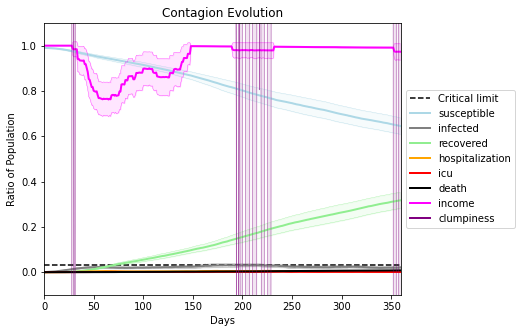

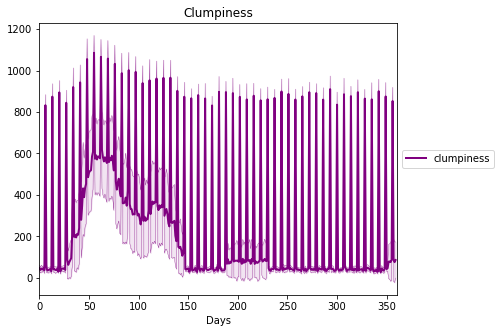

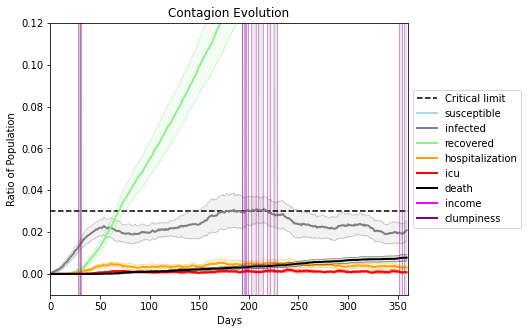

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[2261, 614, 2744, 5879, 9331, 1676, 2404, 1987, 8800, 1210, 9983, 3675, 2639, 271, 1036, 467, 1826, 6854, 5037, 3067]
Average similarity between family members is 0.29935244636424263 at temperature -0.6
Average similarity between family and home is 0.9998511016265672 at temperature -1
Average similarity between students and their classroom is 0.13242588755847537 at temperature -0.6
Average classroom occupancy is 1.6457142857142857 and number classrooms is 175
Average similarity between workers is 0.14960003890419019 at temperature -0.6
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.36573539959626583 for kids: 0.2268218926446147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.07818489457627414
avg restaurant similarity 0.0531471204311238
avg restaurant similarity 0.0707873539573128
avg restaurant similarity 0.051045846220859656
avg restaurant similarity 0.01749437684599816
avg restaurant similarity 0.023028460268306798
avg restaurant similarity 0.050298787572625445
avg restaurant similarity 0.02863783217411067
avg restaurant similarity 0.02351658697897636
avg restaurant similarity 0.08912876019700959
avg restaurant similarity 0.08143649085605031
avg restaurant similarity 0.04472570221162356
avg restaurant similarity 0.0789415655109929
avg restaurant similarity 0.08262897467956086
avg restaurant similarity 0.06718669107230761
avg restaurant similarity 0.037777244269908694
avg restaurant similarity 0.07633181093739295
avg restaurant similarity 0.08268714573608632
avg restaurant similarity 0.036522860445098296
avg restaurant similarity 0.041212911043116994
avg restaurant similarity 0.03641076991725512
avg restaurant similarity 0.096

avg restaurant similarity 0.0228889994002716
avg restaurant similarity 0.017216732887005072
avg restaurant similarity 0.05016567945619128
avg restaurant similarity 0.06375618214306539
avg restaurant similarity 0.02950041790145708
avg restaurant similarity 0.04537163564502967
avg restaurant similarity 0.07447172533827379
avg restaurant similarity 0.09441589030831227
avg restaurant similarity 0.020382416990879317
avg restaurant similarity 0.07214239273213577
avg restaurant similarity 0.05844877899474235
avg restaurant similarity 0.030412821215442174
avg restaurant similarity 0.026306038713107247
avg restaurant similarity 0.05160246002252598
avg restaurant similarity 0.035758803121293946
avg restaurant similarity 0.040077578574888015
avg restaurant similarity 0.031246251283011776
avg restaurant similarity 0.06827574017300918
avg restaurant similarity 0.09477438754591014
avg restaurant similarity 0.03770363092766949
avg restaurant similarity 0.05274691364852997
avg restaurant similarity 0.

avg restaurant similarity 0.021228827043292035
avg restaurant similarity 0.12208652480633327
avg restaurant similarity 0.059027736163337195
avg restaurant similarity 0.08759867272786456
Average similarity between family members is 0.3034876287004576 at temperature -0.6
Average similarity between family and home is 0.9998502064191509 at temperature -1
Average similarity between students and their classroom is 0.14791368624437096 at temperature -0.6
Average classroom occupancy is 1.6348314606741574 and number classrooms is 178
Average similarity between workers is 0.13113987761234938 at temperature -0.6
Average office occupancy is 3.2944162436548226 and number offices is 197
Average friend similarity for adults: 0.3719400053231513 for kids: 0.23473560099711147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.11033633677183324
avg restaurant similarity 0.06717864407159048
avg restaurant similarity 0.11229279942972685
avg restaurant similarity 0.10665762695470803
avg restaurant similarity 0.09947941353088888
avg restaurant similarity 0.03575995444753592
avg restaurant similarity 0.03430960437225205
avg restaurant similarity 0.09812146695146687
avg restaurant similarity 0.06953080339428999
avg restaurant similarity 0.06008447019930782
avg restaurant similarity 0.07091731279973498
avg restaurant similarity 0.06816184890800464
avg restaurant similarity 0.06814747914398991
avg restaurant similarity 0.06490080959365321
avg restaurant similarity 0.029259201435192866
avg restaurant similarity 0.03637633980188722
avg restaurant similarity 0.062268633241935545
avg restaurant similarity 0.05207012736337322
avg restaurant similarity 0.12634657756524467
avg restaurant similarity 0.08585944038293827
avg restaurant similarity 0.0033198528444060003
avg restaurant similarity 0.04

avg restaurant similarity 0.07774659291036787
avg restaurant similarity 0.0086985953206475
avg restaurant similarity 0.10943904646351645
avg restaurant similarity 0.07386831174354627
avg restaurant similarity 0.11088110685010373
avg restaurant similarity 0.11671566344291175
avg restaurant similarity 0.03297765948546679
avg restaurant similarity 0.08171602072626638
avg restaurant similarity 0.11838940183826001
avg restaurant similarity 0.07257917118562847
avg restaurant similarity 0.08953319939371115
avg restaurant similarity 0.04391507117816201
avg restaurant similarity 0.0598449540693019
avg restaurant similarity 0.10321124644144286
avg restaurant similarity 0.07541520072288503
avg restaurant similarity 0.06264361905730165
avg restaurant similarity -0.00038627113192542413
avg restaurant similarity 0.08402668117067094
avg restaurant similarity 0.11436723133601323
avg restaurant similarity 0.09352571964831888
avg restaurant similarity 0.05986307419608164
avg restaurant similarity 0.0349

avg restaurant similarity 0.06114472862014657
avg restaurant similarity 0.05065430298295833
avg restaurant similarity 0.11132711024370237
avg restaurant similarity 0.05990482270746685
Average similarity between family members is 0.29232061368211526 at temperature -0.6
Average similarity between family and home is 0.9998674056146362 at temperature -1
Average similarity between students and their classroom is 0.16058896290105046 at temperature -0.6
Average classroom occupancy is 1.6850828729281768 and number classrooms is 181
Average similarity between workers is 0.16855891278969343 at temperature -0.6
Average office occupancy is 3.218905472636816 and number offices is 201
Average friend similarity for adults: 0.3662043006063717 for kids: 0.22262889406186984
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.07400571687781173
avg restaurant similarity 0.06701736145881274
avg restaurant similarity 0.05707344530595549
avg restaurant similarity 0.03954518459971424
avg restaurant similarity 0.0872358084566195
avg restaurant similarity 0.11195595956162455
avg restaurant similarity 0.04922757443948325
avg restaurant similarity 0.03862095765506445
avg restaurant similarity 0.05484251457994744
avg restaurant similarity 0.04519440348592603
avg restaurant similarity 0.07733644343980646
avg restaurant similarity 0.04849622361866134
avg restaurant similarity 0.07442748158825811
avg restaurant similarity 0.03520501664597418
avg restaurant similarity 0.11589438470240832
avg restaurant similarity 0.04768254992799225
avg restaurant similarity 0.05872073733625093
avg restaurant similarity 0.03474310311294281
avg restaurant similarity 0.09229021282371987
avg restaurant similarity 0.05753406047841729
avg restaurant similarity 0.04752246012219743
avg restaurant similarity 0.0459913

avg restaurant similarity 0.0367569709171405
avg restaurant similarity 0.1025847490412572
avg restaurant similarity 0.08278363945887791
avg restaurant similarity 0.069633522884318
avg restaurant similarity 0.07355434862664582
avg restaurant similarity 0.048885793920338635
avg restaurant similarity 0.0697009939191424
avg restaurant similarity 0.059056966307853447
avg restaurant similarity 0.04151891487258049
avg restaurant similarity 0.06491472840264927
avg restaurant similarity 0.06789459944873016
avg restaurant similarity 0.020454207144030585
avg restaurant similarity -0.010510486625746248
avg restaurant similarity 0.007496769356922167
avg restaurant similarity 0.01581441768695443
avg restaurant similarity 0.006105553243216764
avg restaurant similarity 0.06304496675910769
avg restaurant similarity 0.050161965166462326
avg restaurant similarity 0.07196805416015478
avg restaurant similarity 0.03288773166759223
avg restaurant similarity 0.07140155601695733
avg restaurant similarity 0.049

avg restaurant similarity 0.0269443725358364
avg restaurant similarity 0.06248560476208256
avg restaurant similarity 0.053757778798025395
avg restaurant similarity 0.08486658456580824
Average similarity between family members is 0.2762160186742981 at temperature -0.6
Average similarity between family and home is 0.9998456251882967 at temperature -1
Average similarity between students and their classroom is 0.16385640378299499 at temperature -0.6
Average classroom occupancy is 1.6532663316582914 and number classrooms is 199
Average similarity between workers is 0.13599278775123413 at temperature -0.6
Average office occupancy is 3.1161616161616164 and number offices is 198
Average friend similarity for adults: 0.3588588992036817 for kids: 0.24823223981587295
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.042418083605571116
avg restaurant similarity 0.06696499457976146
avg restaurant similarity 0.08390265710471344
avg restaurant similarity 0.05336468804732023
avg restaurant similarity -0.0003186899988530366
avg restaurant similarity 0.03834593252235906
avg restaurant similarity 0.031516643381740844
avg restaurant similarity 0.060309902506102075
avg restaurant similarity 0.0607661183607935
avg restaurant similarity 0.07604460059252491
avg restaurant similarity 0.0433682522153808
avg restaurant similarity 0.02261970366937251
avg restaurant similarity 0.015688034971762143
avg restaurant similarity 0.05720170067142753
avg restaurant similarity 0.025432947652926155
avg restaurant similarity 0.03213891743586727
avg restaurant similarity -0.01809824368367238
avg restaurant similarity 0.08457657019032114
avg restaurant similarity 0.06562818373581385
avg restaurant similarity 0.024251160696164707
avg restaurant similarity 0.04382387178458065
avg restaurant similarity 

avg restaurant similarity 0.09356994710549077
avg restaurant similarity 0.04333620060466126
avg restaurant similarity 0.04096916604126475
avg restaurant similarity 0.058820734730655216
avg restaurant similarity 0.05921660849979247
avg restaurant similarity 0.05726523436853158
avg restaurant similarity 0.033888154951642456
avg restaurant similarity 0.06574100590970906
avg restaurant similarity 0.0648260042198898
avg restaurant similarity 0.028884696897298324
avg restaurant similarity 0.03577841107714676
avg restaurant similarity 0.02297721810843005
avg restaurant similarity 0.03606281981073771
avg restaurant similarity 0.031441656608659045
avg restaurant similarity 0.08068030897105559
avg restaurant similarity 0.052890414773403664
avg restaurant similarity 0.02189653662772934
avg restaurant similarity 0.04181483880209433
avg restaurant similarity 0.020399540315697826
avg restaurant similarity 0.07078184925670886
avg restaurant similarity 0.05125718705443428
avg restaurant similarity 0.0

avg restaurant similarity 0.015495222482985712
avg restaurant similarity 0.048774438603410686
avg restaurant similarity 0.10729586161051577
avg restaurant similarity 0.05931308258651137
Average similarity between family members is 0.30540302145244974 at temperature -0.6
Average similarity between family and home is 0.9998650177973942 at temperature -1
Average similarity between students and their classroom is 0.20003214784781267 at temperature -0.6
Average classroom occupancy is 1.7052023121387283 and number classrooms is 173
Average similarity between workers is 0.1612150142835191 at temperature -0.6
Average office occupancy is 3.37 and number offices is 200
Average friend similarity for adults: 0.3765464766825103 for kids: 0.233343532979169
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.06887755375011795
avg restaurant similarity 0.030735071126097666
avg restaurant similarity 0.028053527459474033
avg restaurant similarity 0.044536644624795334
avg restaurant similarity 0.14002513351906828
avg restaurant similarity 0.11654993907147645
avg restaurant similarity 0.10086624677998805
avg restaurant similarity 0.06272999466416167
avg restaurant similarity -0.0031126599918937193
avg restaurant similarity 0.09785207212375992
avg restaurant similarity 0.05523351871670767
avg restaurant similarity 0.05954201368547031
avg restaurant similarity 0.07791970262129305
avg restaurant similarity 0.007598265630219513
avg restaurant similarity 0.05662337092323335
avg restaurant similarity -0.00537485995808528
avg restaurant similarity 0.03890420998745276
avg restaurant similarity -0.009778627595246487
avg restaurant similarity 0.11394516397962026
avg restaurant similarity 0.032291342120920274
avg restaurant similarity 0.055483926389524936
avg restaurant similar

avg restaurant similarity 0.030580876503888584
avg restaurant similarity 0.011391943911709241
avg restaurant similarity 0.05843929459632345
avg restaurant similarity 0.09837036600979765
avg restaurant similarity 0.12255759739453774
avg restaurant similarity 0.050956169170351014
avg restaurant similarity 0.05276139567888617
avg restaurant similarity 0.08832927075395133
avg restaurant similarity 0.051105965616677615
avg restaurant similarity 0.10695533097141577
avg restaurant similarity 0.020890655778175164
avg restaurant similarity 0.05897399623124579
avg restaurant similarity 0.04582268742920632
avg restaurant similarity 0.07914005565094423
avg restaurant similarity 0.08746916566139525
avg restaurant similarity 0.12834486433509434
avg restaurant similarity 0.049785125178384244
avg restaurant similarity 0.06368258432935701
avg restaurant similarity 0.03265059503273673
avg restaurant similarity 0.0582397907107568
avg restaurant similarity 0.023122834070449426
avg restaurant similarity 0.

avg restaurant similarity 0.06903128543749029
avg restaurant similarity 0.04096845146674667
avg restaurant similarity -0.0124861283471892
avg restaurant similarity 0.07971845040245489
Average similarity between family members is 0.2774765720856498 at temperature -0.6
Average similarity between family and home is 0.9998645340813751 at temperature -1
Average similarity between students and their classroom is 0.17030042775730475 at temperature -0.6
Average classroom occupancy is 1.445054945054945 and number classrooms is 182
Average similarity between workers is 0.1576650806119269 at temperature -0.6
Average office occupancy is 3.377450980392157 and number offices is 204
Average friend similarity for adults: 0.38008880085704705 for kids: 0.20614506399433166
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.091815375951562
avg restaurant similarity 0.1182332432030535
avg restaurant similarity 0.06411214840640045
avg restaurant similarity 0.09941851953852679
avg restaurant similarity 0.08142636773087975
avg restaurant similarity 0.07677143829323903
avg restaurant similarity 0.0817157135330007
avg restaurant similarity 0.06678503640640114
avg restaurant similarity 0.10303037223311456
avg restaurant similarity 0.02724736929530936
avg restaurant similarity 0.07618011632636609
avg restaurant similarity 0.04638318763992458
avg restaurant similarity 0.060774308161136485
avg restaurant similarity 0.021992742606807256
avg restaurant similarity 0.05981315571003095
avg restaurant similarity -0.0020777045350400033
avg restaurant similarity 0.05291284608163035
avg restaurant similarity 0.0347231013290315
avg restaurant similarity 0.04205187909202282
avg restaurant similarity 0.05875356735101724
avg restaurant similarity 0.06976739463250119
avg restaurant similarity 0.102469

avg restaurant similarity 0.05911419304387428
avg restaurant similarity 0.0777653526812884
avg restaurant similarity 0.08509825098466585
avg restaurant similarity 0.09202961783421833
avg restaurant similarity 0.04090008313838695
avg restaurant similarity 0.05765148000801729
avg restaurant similarity 0.02383861912482398
avg restaurant similarity 0.09855210465547654
avg restaurant similarity 0.09449226132570814
avg restaurant similarity 0.03808922603864772
avg restaurant similarity 0.08369464754064265
avg restaurant similarity 0.07011504131702091
avg restaurant similarity 0.04607809909107094
avg restaurant similarity 0.027828067820947454
avg restaurant similarity 0.08673441411710624
avg restaurant similarity 0.07406665780226691
avg restaurant similarity 0.08117160407842747
avg restaurant similarity 0.07650238716192838
avg restaurant similarity 0.10241933543793055
avg restaurant similarity 0.1104765241430922
avg restaurant similarity 0.03976473446334078
avg restaurant similarity 0.0390313

avg restaurant similarity 0.10767146206796849
avg restaurant similarity 0.055096611785171425
avg restaurant similarity 0.07343596086707596
avg restaurant similarity 0.09402209905008295
Average similarity between family members is 0.2907354950756199 at temperature -0.6
Average similarity between family and home is 0.9998544538349625 at temperature -1
Average similarity between students and their classroom is 0.20356143390419085 at temperature -0.6
Average classroom occupancy is 1.6043956043956045 and number classrooms is 182
Average similarity between workers is 0.16342280255326003 at temperature -0.6
Average office occupancy is 3.2058823529411766 and number offices is 204
Average friend similarity for adults: 0.3750805961726278 for kids: 0.23228457962136534
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.11161869852894363
avg restaurant similarity 0.08220679975997176
avg restaurant similarity 0.05358033365156903
avg restaurant similarity 0.12656857369241412
avg restaurant similarity 0.05395756498816516
avg restaurant similarity 0.07196213744602323
avg restaurant similarity 0.07436945297446902
avg restaurant similarity 0.058266010275888284
avg restaurant similarity 0.08821144012296343
avg restaurant similarity 0.06364075412032563
avg restaurant similarity 0.04363137236032095
avg restaurant similarity 0.15348888249309384
avg restaurant similarity 0.1072955689504445
avg restaurant similarity 0.06586764797519686
avg restaurant similarity 0.06664912318592027
avg restaurant similarity 0.054651333691885504
avg restaurant similarity 0.07754203013527011
avg restaurant similarity 0.1153982729280506
avg restaurant similarity 0.07108315171141212
avg restaurant similarity 0.10316270629535598
avg restaurant similarity 0.05403725853590216
avg restaurant similarity 0.104114

avg restaurant similarity 0.056862343268266134
avg restaurant similarity 0.09319919040717614
avg restaurant similarity 0.10626130687232593
avg restaurant similarity 0.04030334535769515
avg restaurant similarity 0.04765599312325393
avg restaurant similarity 0.10099975504388294
avg restaurant similarity 0.09184536383291643
avg restaurant similarity 0.08986601515150051
avg restaurant similarity 0.11260520685626813
avg restaurant similarity 0.08969574671715108
avg restaurant similarity 0.06760138651782754
avg restaurant similarity 0.10303769495668998
avg restaurant similarity 0.11275140759811159
avg restaurant similarity 0.11808130401813904
avg restaurant similarity 0.11319759596034729
avg restaurant similarity 0.1113987765114911
avg restaurant similarity 0.11265020758133878
avg restaurant similarity 0.08522170246673358
avg restaurant similarity 0.06085636921430018
avg restaurant similarity 0.0722117065772343
avg restaurant similarity 0.09010891055727752
avg restaurant similarity 0.0995696

avg restaurant similarity 0.10787660290539952
avg restaurant similarity 0.08559240217589623
Average similarity between family members is 0.30455836404318715 at temperature -0.6
Average similarity between family and home is 0.9998599806830849 at temperature -1
Average similarity between students and their classroom is 0.1735241065605677 at temperature -0.6
Average classroom occupancy is 1.7267441860465116 and number classrooms is 172
Average similarity between workers is 0.17114046167136615 at temperature -0.6
Average office occupancy is 3.150485436893204 and number offices is 206
Average friend similarity for adults: 0.3668696942266291 for kids: 0.22991488716335687
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.08022884006710333
avg restaurant similarity 0.07648386705017018
avg restaurant similarity 0.05688920304355733
avg restaurant similarity 0.040820746186547775
avg restaurant similarity 0.03983364762407956
avg restaurant similarity 0.07976739947835267
avg restaurant similarity 0.07188036353378338
avg restaurant similarity 0.0973166902341698
avg restaurant similarity 0.03485293563650645
avg restaurant similarity 0.06418104322670538
avg restaurant similarity 0.07086949495213127
avg restaurant similarity 0.07054200326374171
avg restaurant similarity 0.05692696380575949
avg restaurant similarity 0.06946195273676689
avg restaurant similarity 0.044362328233883384
avg restaurant similarity 0.10538029871368357
avg restaurant similarity 0.1097416119356516
avg restaurant similarity 0.07441008565158051
avg restaurant similarity 0.0861876079624579
avg restaurant similarity 0.06558967395095851
avg restaurant similarity 0.03735816580555983
avg restaurant similarity 0.0599251

avg restaurant similarity 0.0925807670254807
avg restaurant similarity 0.10696478434776792
avg restaurant similarity 0.07727446862718605
avg restaurant similarity 0.10992313718952051
avg restaurant similarity 0.06978383909327923
avg restaurant similarity 0.06910136775891963
avg restaurant similarity 0.07500727055359244
avg restaurant similarity 0.08617218033841005
avg restaurant similarity 0.08698114671286936
avg restaurant similarity 0.07710068781366228
avg restaurant similarity 0.09637734175532202
avg restaurant similarity 0.0781561658470034
avg restaurant similarity 0.08025826266067046
avg restaurant similarity 0.05906947358167477
avg restaurant similarity 0.033742957462396674
avg restaurant similarity 0.07221155013448338
avg restaurant similarity 0.07005276753101707
avg restaurant similarity 0.0687219513479441
avg restaurant similarity 0.0441814899561155
avg restaurant similarity 0.0761590885076614
avg restaurant similarity 0.10519084901370092
avg restaurant similarity 0.0592518149

avg restaurant similarity 0.11462388413151779
avg restaurant similarity 0.08915460129951593
Average similarity between family members is 0.28923684977083386 at temperature -0.6
Average similarity between family and home is 0.9998532872973852 at temperature -1
Average similarity between students and their classroom is 0.17159244356163392 at temperature -0.6
Average classroom occupancy is 1.6436170212765957 and number classrooms is 188
Average similarity between workers is 0.1643909203615796 at temperature -0.6
Average office occupancy is 3.1691542288557213 and number offices is 201
Average friend similarity for adults: 0.36946383771233954 for kids: 0.22801618788057576
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.10170441365867162
avg restaurant similarity 0.03129317722566012
avg restaurant similarity 0.11187076043026674
avg restaurant similarity 0.08159313263992926
avg restaurant similarity -0.0040645123848561966
avg restaurant similarity 0.07176151378635862
avg restaurant similarity 0.09484017058346399
avg restaurant similarity 0.0924165729014594
avg restaurant similarity 0.08219952594019711
avg restaurant similarity 0.1076802587270427
avg restaurant similarity 0.019916462658688645
avg restaurant similarity 0.0785386050336151
avg restaurant similarity 0.04676060043118022
avg restaurant similarity 0.08433201674064855
avg restaurant similarity 0.06957251437006652
avg restaurant similarity 0.0698389708172663
avg restaurant similarity 0.07240825254435906
avg restaurant similarity 0.1241754421740168
avg restaurant similarity 0.07019519239664444
avg restaurant similarity 0.0594877670722117
avg restaurant similarity 0.09423743695409477
avg restaurant similarity 0.07862974

avg restaurant similarity 0.02826766507363856
avg restaurant similarity 0.06945954432890436
avg restaurant similarity 0.0652015520416045
avg restaurant similarity 0.05436434641825938
avg restaurant similarity 0.065350008345191
avg restaurant similarity 0.05312055650411203
avg restaurant similarity 0.09986912983673168
avg restaurant similarity 0.04683370946927732
avg restaurant similarity 0.049484614661938674
avg restaurant similarity 0.07370468734035161
avg restaurant similarity 0.061514313811189145
avg restaurant similarity 0.10243229352778414
avg restaurant similarity 0.039169565222562
avg restaurant similarity 0.04491829580262907
avg restaurant similarity 0.029926252631001522
avg restaurant similarity 0.09506924872118479
avg restaurant similarity 0.07290471145289051
avg restaurant similarity 0.0760241989608543
avg restaurant similarity 0.06279257520219032
avg restaurant similarity 0.0963914707801841
avg restaurant similarity 0.10028291308057612
avg restaurant similarity 0.1021102607

avg restaurant similarity 0.079370132075407
avg restaurant similarity 0.10492757297507357
avg restaurant similarity 0.05269723981829256
avg restaurant similarity 0.06895055943778883
Average similarity between family members is 0.28000428715353115 at temperature -0.6
Average similarity between family and home is 0.9998362520269828 at temperature -1
Average similarity between students and their classroom is 0.13565128921428857 at temperature -0.6
Average classroom occupancy is 1.6939890710382515 and number classrooms is 183
Average similarity between workers is 0.1598113852796027 at temperature -0.6
Average office occupancy is 3.1365853658536587 and number offices is 205
Average friend similarity for adults: 0.38070992708070667 for kids: 0.23667759902386903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.10479278495333413
avg restaurant similarity 0.09112441649269774
avg restaurant similarity 0.08473048682315548
avg restaurant similarity 0.055880170805424866
avg restaurant similarity 0.05216730518967986
avg restaurant similarity 0.051689289437814236
avg restaurant similarity 0.09363443250057167
avg restaurant similarity 0.043119454392483506
avg restaurant similarity 0.07513085601962635
avg restaurant similarity 0.03692747988569726
avg restaurant similarity 0.09285755902416908
avg restaurant similarity 0.06611585042004939
avg restaurant similarity 0.09067154699756982
avg restaurant similarity 0.044644377510540796
avg restaurant similarity 0.07314515685016162
avg restaurant similarity 0.09876150524447323
avg restaurant similarity 0.0700983195840911
avg restaurant similarity 0.06703915711277654
avg restaurant similarity 0.07324070425487135
avg restaurant similarity 0.08654984930421315
avg restaurant similarity 0.07862561843887922
avg restaurant similarity 0.034

avg restaurant similarity 0.04162127180851295
avg restaurant similarity 0.05154679564149319
avg restaurant similarity 0.058189058505699665
avg restaurant similarity 0.04161722245223778
avg restaurant similarity 0.08092936857315818
avg restaurant similarity 0.07964522313880738
avg restaurant similarity 0.06938828274827813
avg restaurant similarity 0.06909481994515983
avg restaurant similarity 0.028342594611101054
avg restaurant similarity 0.08269525197329526
avg restaurant similarity 0.07470910712435908
avg restaurant similarity 0.004402080829877157
avg restaurant similarity 0.07357944069883479
avg restaurant similarity 0.06512796749115066
avg restaurant similarity 0.06051230466424526
avg restaurant similarity 0.07821034238642392
avg restaurant similarity 0.10389907429752578
avg restaurant similarity 0.05408835421337683
avg restaurant similarity 0.0638097980553894
avg restaurant similarity 0.10185294585588955
avg restaurant similarity 0.053543463007556386
avg restaurant similarity 0.042

avg restaurant similarity 0.06156965724952194
avg restaurant similarity 0.03181104531148088
avg restaurant similarity 0.07624336357548325
avg restaurant similarity 0.08694053487139539
Average similarity between family members is 0.289561066154209 at temperature -0.6
Average similarity between family and home is 0.9998557538763279 at temperature -1
Average similarity between students and their classroom is 0.17931367576611337 at temperature -0.6
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.15503016561109328 at temperature -0.6
Average office occupancy is 3.443877551020408 and number offices is 196
Average friend similarity for adults: 0.37221798447406224 for kids: 0.22346702471050345
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.012313243582882591
avg restaurant similarity 0.09364229703649153
avg restaurant similarity 0.07816543091181347
avg restaurant similarity 0.06834099876613993
avg restaurant similarity 0.06997880178257188
avg restaurant similarity 0.056689443268069975
avg restaurant similarity 0.0164343541981322
avg restaurant similarity 0.0715430722850684
avg restaurant similarity 0.08070803306258752
avg restaurant similarity 0.07515522719881898
avg restaurant similarity 0.05749704264285186
avg restaurant similarity 0.056519389077312715
avg restaurant similarity 0.04192278881329079
avg restaurant similarity 0.10013492222344542
avg restaurant similarity 0.02500662602671507
avg restaurant similarity 0.02784173679521527
avg restaurant similarity 0.08492504658419064
avg restaurant similarity 0.07158089067664242
avg restaurant similarity 0.04344948167783189
avg restaurant similarity 0.028153837281465904
avg restaurant similarity 0.0774826844886199
avg restaurant similarity 0.05093

avg restaurant similarity 0.06510986396082055
avg restaurant similarity 0.0610531677033851
avg restaurant similarity 0.1242722189662988
avg restaurant similarity 0.047595484714893624
avg restaurant similarity 0.09635471846439012
avg restaurant similarity 0.052853345293691456
avg restaurant similarity 0.06763936773683188
avg restaurant similarity 0.07934945044454288
avg restaurant similarity 0.039564131059110115
avg restaurant similarity 0.06367926978271204
avg restaurant similarity 0.07430325590552574
avg restaurant similarity 0.12905911176722473
avg restaurant similarity 0.03599386894342666
avg restaurant similarity 0.019446285392708977
avg restaurant similarity 0.029529306024008932
avg restaurant similarity 0.0976007580801421
avg restaurant similarity 0.052375617255788806
avg restaurant similarity 0.08663659777220546
avg restaurant similarity 0.05145748207025642
avg restaurant similarity 0.1005094712131439
avg restaurant similarity 0.05468657670942557
avg restaurant similarity 0.0418

avg restaurant similarity 0.04109777500647958
avg restaurant similarity 0.033933317920317736
avg restaurant similarity 0.07267243652230158
avg restaurant similarity 0.05665215822844463
Average similarity between family members is 0.31348555528405436 at temperature -0.6
Average similarity between family and home is 0.9998451427129172 at temperature -1
Average similarity between students and their classroom is 0.19488778239060284 at temperature -0.6
Average classroom occupancy is 1.5956284153005464 and number classrooms is 183
Average similarity between workers is 0.1552807816336743 at temperature -0.6
Average office occupancy is 3.253731343283582 and number offices is 201
Average friend similarity for adults: 0.37903863450075126 for kids: 0.23219031472988005
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.03772566985990494
avg restaurant similarity 0.07324132502217641
avg restaurant similarity 0.0642418283543089
avg restaurant similarity 0.013485546709514361
avg restaurant similarity 0.05205701179800094
avg restaurant similarity 0.003323516580927772
avg restaurant similarity 0.09700801654309396
avg restaurant similarity 0.05508805871040231
avg restaurant similarity 0.0292622121311056
avg restaurant similarity 0.11005800154845144
avg restaurant similarity 0.02435640992975761
avg restaurant similarity 0.07931516291415726
avg restaurant similarity 0.046361055573296034
avg restaurant similarity 0.03239158631480953
avg restaurant similarity 0.06379447536084709
avg restaurant similarity 0.07315104422905917
avg restaurant similarity 0.07186185785097449
avg restaurant similarity 0.04031579824410709
avg restaurant similarity 0.010231452359211265
avg restaurant similarity 0.045317408260097586
avg restaurant similarity -0.014012273851195817
avg restaurant similarity 0.0

avg restaurant similarity 0.04354911993967951
avg restaurant similarity 0.07211848230127638
avg restaurant similarity 0.05477619087364561
avg restaurant similarity 0.026463819078947893
avg restaurant similarity 0.0922411587624161
avg restaurant similarity 0.04403065364595909
avg restaurant similarity 0.07664335599492572
avg restaurant similarity 0.11993570162556447
avg restaurant similarity 0.011379074329935611
avg restaurant similarity 0.10196991274127098
avg restaurant similarity 0.04461803759409181
avg restaurant similarity 0.04068921683436325
avg restaurant similarity 0.030883496837849266
avg restaurant similarity 0.058240708951503746
avg restaurant similarity 0.0815902708462474
avg restaurant similarity 0.03892038068932519
avg restaurant similarity 0.06449502924837333
avg restaurant similarity 0.023037073710365414
avg restaurant similarity 0.005352466282939719
avg restaurant similarity 0.07832249904596156
avg restaurant similarity 0.026097995845754014
avg restaurant similarity 0.0

avg restaurant similarity 0.0803063785879493
avg restaurant similarity 0.04528397183548511
avg restaurant similarity 0.03010396074912284
avg restaurant similarity 0.04390794035701351
Average similarity between family members is 0.28594581458893864 at temperature -0.6
Average similarity between family and home is 0.9998604598417244 at temperature -1
Average similarity between students and their classroom is 0.194801057528841 at temperature -0.6
Average classroom occupancy is 1.6140350877192982 and number classrooms is 171
Average similarity between workers is 0.13823917331395066 at temperature -0.6
Average office occupancy is 3.341708542713568 and number offices is 199
Average friend similarity for adults: 0.3777066316509629 for kids: 0.23220350055726208
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.09405529237967689
avg restaurant similarity 0.021742313343660703
avg restaurant similarity 0.03542512058870637
avg restaurant similarity 0.10054779530237849
avg restaurant similarity 0.08436637849134408
avg restaurant similarity 0.04048025983322617
avg restaurant similarity 0.06424682006233591
avg restaurant similarity 0.05186326643541655
avg restaurant similarity 0.009917996349702186
avg restaurant similarity 0.10907045293889737
avg restaurant similarity 0.06999252359146327
avg restaurant similarity 0.07584227438902522
avg restaurant similarity 0.13509874507074238
avg restaurant similarity 0.0829752996691348
avg restaurant similarity 0.06147248504873385
avg restaurant similarity 0.06023765624300454
avg restaurant similarity 0.08324694997836046
avg restaurant similarity 0.10342052148302203
avg restaurant similarity 0.12375306234569443
avg restaurant similarity 0.06005735988463854
avg restaurant similarity 0.10517710193591365
avg restaurant similarity 0.06598

avg restaurant similarity 0.09725490765890867
avg restaurant similarity 0.057467773652939744
avg restaurant similarity 0.08423191909890689
avg restaurant similarity 0.0714029811222471
avg restaurant similarity 0.060752037127384084
avg restaurant similarity 0.06953958859531066
avg restaurant similarity 0.05357403890815202
avg restaurant similarity 0.04665112481959733
avg restaurant similarity 0.07890323991411902
avg restaurant similarity 0.06859822029802252
avg restaurant similarity 0.0822740090014817
avg restaurant similarity 0.015080194006426828
avg restaurant similarity 0.07463406523201581
avg restaurant similarity 0.09056965368769607
avg restaurant similarity 0.04081310476992548
avg restaurant similarity 0.05758925780992682
avg restaurant similarity 0.0736198849593685
avg restaurant similarity 0.01641637221953041
avg restaurant similarity 0.1083038000311154
avg restaurant similarity 0.11303167283529693
avg restaurant similarity 0.055970426616609115
avg restaurant similarity 0.048646

avg restaurant similarity 0.07087227647636124
avg restaurant similarity 0.11714664667141444
avg restaurant similarity 0.06289777082246424
Average similarity between family members is 0.3156610945928074 at temperature -0.6
Average similarity between family and home is 0.9998567399963416 at temperature -1
Average similarity between students and their classroom is 0.1796170826918163 at temperature -0.6
Average classroom occupancy is 1.56 and number classrooms is 175
Average similarity between workers is 0.1613542586684699 at temperature -0.6
Average office occupancy is 3.3024390243902437 and number offices is 205
Average friend similarity for adults: 0.3762751617814197 for kids: 0.22231642494573717
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capac

avg restaurant similarity 0.036540462027784715
avg restaurant similarity 0.03152679842292798
avg restaurant similarity 0.05422912515209132
avg restaurant similarity 0.07924301571720416
avg restaurant similarity 0.10938038258920788
avg restaurant similarity -0.017336912542180286
avg restaurant similarity 0.02843198696762281
avg restaurant similarity 0.10835051473024801
avg restaurant similarity 0.07227642438019473
avg restaurant similarity 0.029819034771712997
avg restaurant similarity 0.06757732730115601
avg restaurant similarity 0.08891193755298392
avg restaurant similarity 0.05564876890476674
avg restaurant similarity 0.14936679782437057
avg restaurant similarity 0.11869260251824006
avg restaurant similarity 0.10209966136080408
avg restaurant similarity 0.04909190845135024
avg restaurant similarity 0.0372005502391623
avg restaurant similarity 0.09101523653860384
avg restaurant similarity 0.09375925127609312
avg restaurant similarity -0.0010674890840616262
avg restaurant similarity 0.

avg restaurant similarity 0.16575068138112717
avg restaurant similarity 0.042483248083172456
avg restaurant similarity 0.08672834513933478
avg restaurant similarity 0.08738298815564931
avg restaurant similarity 0.07713551191572292
avg restaurant similarity 0.06803134038991075
avg restaurant similarity 0.08078710085202306
avg restaurant similarity 0.06723864471172733
avg restaurant similarity 0.07135616314797816
avg restaurant similarity 0.08324384187887295
avg restaurant similarity 0.06870700722512874
avg restaurant similarity 0.03618315855307691
avg restaurant similarity 0.10692395852956467
avg restaurant similarity 0.07258140687042235
avg restaurant similarity 0.10216745742612413
avg restaurant similarity 0.047146369119175
avg restaurant similarity 0.020482914669468923
avg restaurant similarity 0.10282525708618426
avg restaurant similarity 0.13388115735837627
avg restaurant similarity 0.12563022529383
avg restaurant similarity 0.038818325892400765
avg restaurant similarity 0.05419559

avg restaurant similarity 0.07401914476943977
avg restaurant similarity 0.06534699195451127
Average similarity between family members is 0.29443902086275575 at temperature -0.6
Average similarity between family and home is 0.9998476963694001 at temperature -1
Average similarity between students and their classroom is 0.15701796952989455 at temperature -0.6
Average classroom occupancy is 1.7272727272727273 and number classrooms is 176
Average similarity between workers is 0.154375285878791 at temperature -0.6
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.3694320300141439 for kids: 0.22688833674349385
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.01171025025283543
avg restaurant similarity 0.07199322827075161
avg restaurant similarity 0.09536008180882122
avg restaurant similarity -0.007817589134288662
avg restaurant similarity 0.03237447631068228
avg restaurant similarity 0.13816177076176697
avg restaurant similarity 0.04686886969925417
avg restaurant similarity 0.049637468242625264
avg restaurant similarity 0.09556979390184185
avg restaurant similarity 0.04123740991534236
avg restaurant similarity 0.09371976072534817
avg restaurant similarity 0.11539884041513959
avg restaurant similarity 0.09383595987253643
avg restaurant similarity 0.09977048720815174
avg restaurant similarity 0.04070234903441616
avg restaurant similarity 0.08662557960621063
avg restaurant similarity 0.04557112884630757
avg restaurant similarity 0.03595322924847103
avg restaurant similarity 0.042506143491376595
avg restaurant similarity 0.04280147211784049
avg restaurant similarity 0.08499488817218456
avg restaurant similarity 0.02

avg restaurant similarity 0.06181994078335109
avg restaurant similarity 0.04992804653143512
avg restaurant similarity 0.06405210261881474
avg restaurant similarity 0.0739264973858138
avg restaurant similarity 0.004606661925375775
avg restaurant similarity -0.00985996740004738
avg restaurant similarity 0.09591076631158287
avg restaurant similarity 0.07218167867712708
avg restaurant similarity 0.08498928322412602
avg restaurant similarity 0.07233095932225908
avg restaurant similarity 0.006852171896592661
avg restaurant similarity 0.03573672847129871
avg restaurant similarity 0.042354127547035214
avg restaurant similarity 0.03884826727742332
avg restaurant similarity 0.0063479100280330785
avg restaurant similarity 0.04734095788406348
avg restaurant similarity 0.0658225628879128
avg restaurant similarity 0.06545398098375965
avg restaurant similarity 0.10516547289391366
avg restaurant similarity 0.0987336606838865
avg restaurant similarity 0.04759287853253896
avg restaurant similarity 0.027

avg restaurant similarity 0.02983893010484432
avg restaurant similarity 0.028203079433159323
avg restaurant similarity 0.07962581005558735
avg restaurant similarity 0.0488530184806234
Average similarity between family members is 0.28948516957713055 at temperature -0.6
Average similarity between family and home is 0.9998707205147802 at temperature -1
Average similarity between students and their classroom is 0.163516658489877 at temperature -0.6
Average classroom occupancy is 1.5359116022099448 and number classrooms is 181
Average similarity between workers is 0.15133153647956352 at temperature -0.6
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.37042137784234597 for kids: 0.22694240653550155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.12749126301778108
avg restaurant similarity 0.09107421894950396
avg restaurant similarity 0.1316851153834571
avg restaurant similarity 0.12249415466898707
avg restaurant similarity 0.12057543612270606
avg restaurant similarity 0.08733800653027576
avg restaurant similarity 0.07756365915441357
avg restaurant similarity 0.1416882903051832
avg restaurant similarity 0.06873540297919095
avg restaurant similarity 0.09995676029533318
avg restaurant similarity 0.04768156863536041
avg restaurant similarity 0.1453192875884386
avg restaurant similarity 0.09080248066978867
avg restaurant similarity 0.08726117732509046
avg restaurant similarity 0.0962380097036585
avg restaurant similarity 0.15513393935898825
avg restaurant similarity 0.07094575567237968
avg restaurant similarity 0.07134398554992588
avg restaurant similarity 0.13671428306208516
avg restaurant similarity 0.15060477138318737
avg restaurant similarity 0.06524260589318416
avg restaurant similarity 0.1106738436

avg restaurant similarity 0.12176440525021799
avg restaurant similarity 0.10988679329672069
avg restaurant similarity 0.09236236201404563
avg restaurant similarity 0.09524864087432108
avg restaurant similarity 0.16522482432890126
avg restaurant similarity 0.12660918427306803
avg restaurant similarity 0.1017207152376444
avg restaurant similarity 0.009618173802074479
avg restaurant similarity 0.057335554303942056
avg restaurant similarity 0.10399477168316314
avg restaurant similarity 0.11596173719933808
avg restaurant similarity 0.061927137605350825
avg restaurant similarity 0.1813183694716766
avg restaurant similarity 0.08866915416921602
avg restaurant similarity 0.14465660263382674
avg restaurant similarity 0.07847594159465422
avg restaurant similarity 0.09255637153723587
avg restaurant similarity 0.07623243000558129
avg restaurant similarity 0.10906860012924426
avg restaurant similarity 0.1285579907022483
avg restaurant similarity 0.09770077509543622
avg restaurant similarity 0.063335

avg restaurant similarity 0.09512851611458643
avg restaurant similarity 0.0643259891330818
Average similarity between family members is 0.281743047810281 at temperature -0.6
Average similarity between family and home is 0.999864674147507 at temperature -1
Average similarity between students and their classroom is 0.17440806749873036 at temperature -0.6
Average classroom occupancy is 1.5174418604651163 and number classrooms is 172
Average similarity between workers is 0.14782270157452126 at temperature -0.6
Average office occupancy is 3.388059701492537 and number offices is 201
Average friend similarity for adults: 0.3806157351864415 for kids: 0.21018861073270773
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.08577579484648724
avg restaurant similarity 0.10332379845383555
avg restaurant similarity 0.11421617097468255
avg restaurant similarity 0.07224358177564415
avg restaurant similarity 0.09260209997713374
avg restaurant similarity 0.09314955203548021
avg restaurant similarity 0.08859679370557146
avg restaurant similarity 0.06997435841650623
avg restaurant similarity 0.11250536098424034
avg restaurant similarity 0.05855073267646622
avg restaurant similarity 0.03829103074313685
avg restaurant similarity 0.10495766706282776
avg restaurant similarity 0.05187602486981829
avg restaurant similarity 0.07791793969421988
avg restaurant similarity 0.08718317697507601
avg restaurant similarity 0.05385705000974845
avg restaurant similarity 0.07728177465142212
avg restaurant similarity 0.06210248470447967
avg restaurant similarity 0.08222336609635549
avg restaurant similarity 0.11652066247501261
avg restaurant similarity 0.1293138262395625
avg restaurant similarity 0.0639762

avg restaurant similarity 0.05373804311161509
avg restaurant similarity 0.08063333029133102
avg restaurant similarity 0.034785414790553346
avg restaurant similarity 0.08877463539549105
avg restaurant similarity 0.08027558742687574
avg restaurant similarity 0.08397933293241462
avg restaurant similarity 0.08922817210241778
avg restaurant similarity 0.09727280723609547
avg restaurant similarity 0.05988959026334321
avg restaurant similarity 0.06032056470444342
avg restaurant similarity 0.035779749888299676
avg restaurant similarity 0.09895643229008573
avg restaurant similarity 0.12094031932790698
avg restaurant similarity 0.12518216202323434
avg restaurant similarity 0.10566241554778227
avg restaurant similarity 0.08412565089100955
avg restaurant similarity 0.10715766846398991
avg restaurant similarity 0.11138731953282772
avg restaurant similarity 0.09216335018215917
avg restaurant similarity 0.07659194182051549
avg restaurant similarity 0.06598944381421899
avg restaurant similarity 0.0697

avg restaurant similarity 0.08927190626182466
avg restaurant similarity 0.11136307843021447
Average similarity between family members is 0.30778944980012035 at temperature -0.6
Average similarity between family and home is 0.9998501674689109 at temperature -1
Average similarity between students and their classroom is 0.17756128683845843 at temperature -0.6
Average classroom occupancy is 1.7740112994350283 and number classrooms is 177
Average similarity between workers is 0.15155055398640885 at temperature -0.6
Average office occupancy is 3.1683168316831685 and number offices is 202
Average friend similarity for adults: 0.36640223000990424 for kids: 0.24294656835010214
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.12019850642457901
avg restaurant similarity 0.1014396904389734
avg restaurant similarity 0.07518611329617293
avg restaurant similarity 0.07129384536630642
avg restaurant similarity 0.12296399285048654
avg restaurant similarity 0.06937170064882806
avg restaurant similarity 0.020153091189673462
avg restaurant similarity 0.040609293770295415
avg restaurant similarity 0.06764991951831023
avg restaurant similarity 0.09499673313664644
avg restaurant similarity 0.13895232540393554
avg restaurant similarity 0.06803972631877346
avg restaurant similarity 0.07889436994991728
avg restaurant similarity 0.05585675649811391
avg restaurant similarity 0.09928041217227121
avg restaurant similarity 0.07450920327806906
avg restaurant similarity 0.08763548493548459
avg restaurant similarity 0.07507596778579685
avg restaurant similarity 0.12113484346191865
avg restaurant similarity 0.052603679413630595
avg restaurant similarity 0.10550530656282223
avg restaurant similarity 0.1089

avg restaurant similarity 0.09560756543192174
avg restaurant similarity 0.027322854452769187
avg restaurant similarity 0.0933821494860392
avg restaurant similarity 0.04233589004666464
avg restaurant similarity 0.10214403381887478
avg restaurant similarity 0.05269657100536196
avg restaurant similarity 0.1322769392856239
avg restaurant similarity 0.07087564326813763
avg restaurant similarity 0.0771952683161735
avg restaurant similarity 0.12217584611524165
avg restaurant similarity 0.10959654528552992
avg restaurant similarity 0.055728862717324724
avg restaurant similarity 0.10339468955660967
avg restaurant similarity 0.07022679507224126
avg restaurant similarity 0.008516038195455862
avg restaurant similarity 0.06303136825642362
avg restaurant similarity 0.10788973590487572
avg restaurant similarity 0.055213222678506854
avg restaurant similarity 0.08448357317669238
avg restaurant similarity 0.07759383422810517
avg restaurant similarity 0.07568050938026122
avg restaurant similarity 0.06386

avg restaurant similarity 0.03929261219813792
avg restaurant similarity 0.0703698943791015
Average similarity between family members is 0.30403262669099834 at temperature -0.6
Average similarity between family and home is 0.999850686417511 at temperature -1
Average similarity between students and their classroom is 0.17866649709272311 at temperature -0.6
Average classroom occupancy is 1.5578947368421052 and number classrooms is 190
Average similarity between workers is 0.14470474138944447 at temperature -0.6
Average office occupancy is 3.235 and number offices is 200
Average friend similarity for adults: 0.3756955080748533 for kids: 0.2298553110312843
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a

avg restaurant similarity 0.11890659988141015
avg restaurant similarity 0.08566366142503191
avg restaurant similarity 0.10191200982898682
avg restaurant similarity 0.1108226001422336
avg restaurant similarity 0.020801437409866935
avg restaurant similarity 0.032647611869112504
avg restaurant similarity 0.0646245495322137
avg restaurant similarity 0.009295108470778204
avg restaurant similarity 0.12405410631316002
avg restaurant similarity 0.07786126951296174
avg restaurant similarity 0.04119521411250288
avg restaurant similarity 0.06624428114696383
avg restaurant similarity 0.13846071539058724
avg restaurant similarity 0.08242432427929183
avg restaurant similarity 0.050450463532177095
avg restaurant similarity 0.03228721627918378
avg restaurant similarity 0.07551148927249424
avg restaurant similarity 0.07122877567378502
avg restaurant similarity 0.053833319901125325
avg restaurant similarity 0.10392329163344707
avg restaurant similarity 0.017725175742248737
avg restaurant similarity 0.14

avg restaurant similarity 0.07146242044486859
avg restaurant similarity 0.037846083070989224
avg restaurant similarity 0.061099694601852605
avg restaurant similarity 0.13276717749918204
avg restaurant similarity 0.05681226555893653
avg restaurant similarity 0.0777596915584799
avg restaurant similarity 0.0684240374781067
avg restaurant similarity 0.0886932967080022
avg restaurant similarity 0.09186195359190237
avg restaurant similarity -0.02453893222676158
avg restaurant similarity 0.036783574923945794
avg restaurant similarity 0.19558115083524405
avg restaurant similarity 0.12936337867950506
avg restaurant similarity 0.11827220735476872
avg restaurant similarity 0.024080700074064047
avg restaurant similarity 0.012382203488177364
avg restaurant similarity 0.09416289032127019
avg restaurant similarity 0.11696753166461292
avg restaurant similarity 0.12915897522664188
avg restaurant similarity 0.05775096738229236
avg restaurant similarity 0.0782496749641429
avg restaurant similarity 0.0753

avg restaurant similarity 0.09476748933817392
avg restaurant similarity 0.08654781806040591
avg restaurant similarity 0.09606286116338214
avg restaurant similarity 0.026197863003144323
Average similarity between family members is 0.31464437296424924 at temperature -0.6
Average similarity between family and home is 0.9998577766916286 at temperature -1
Average similarity between students and their classroom is 0.1473362125179238 at temperature -0.6
Average classroom occupancy is 1.5585106382978724 and number classrooms is 188
Average similarity between workers is 0.14682548425292286 at temperature -0.6
Average office occupancy is 3.3299492385786804 and number offices is 197
Average friend similarity for adults: 0.37146071775733275 for kids: 0.23671418916011266
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.06390022765519064
avg restaurant similarity 0.0600401004943013
avg restaurant similarity 0.07611396751389135
avg restaurant similarity 0.0789984562881837
avg restaurant similarity 0.10948419305290148
avg restaurant similarity 0.03021092755123539
avg restaurant similarity 0.057402123225239174
avg restaurant similarity 0.09593684812710448
avg restaurant similarity 0.064246799641457
avg restaurant similarity 0.09940532353558588
avg restaurant similarity 0.05485081096614874
avg restaurant similarity 0.08614957107958689
avg restaurant similarity 0.08319678462798583
avg restaurant similarity 0.050900435137795685
avg restaurant similarity 0.10739104139972586
avg restaurant similarity 0.06319882860950608
avg restaurant similarity 0.058285687124673455
avg restaurant similarity 0.06486833474755688
avg restaurant similarity 0.053152724209989524
avg restaurant similarity 0.07942382059713542
avg restaurant similarity 0.06731351749777201
avg restaurant similarity 0.101227

avg restaurant similarity 0.09998220609271871
avg restaurant similarity 0.0962079668750399
avg restaurant similarity 0.08788712051586736
avg restaurant similarity 0.09197920015045553
avg restaurant similarity 0.07357466720621247
avg restaurant similarity 0.06027272897447159
avg restaurant similarity 0.054691657998121965
avg restaurant similarity 0.11153686737709695
avg restaurant similarity 0.07382988351104261
avg restaurant similarity 0.14873423513285963
avg restaurant similarity 0.05970686104671878
avg restaurant similarity 0.10870165053201487
avg restaurant similarity 0.07905429701330706
avg restaurant similarity 0.1618610898568421
avg restaurant similarity 0.05388956425913684
avg restaurant similarity 0.07037105843135615
avg restaurant similarity 0.07072456763545655
avg restaurant similarity 0.07884711466721059
avg restaurant similarity 0.09262895405707673
avg restaurant similarity 0.010435267587410554
avg restaurant similarity 0.06010693904569233
avg restaurant similarity 0.070061

avg restaurant similarity 0.0692783568749842
avg restaurant similarity 0.09079439154622163
using average of time series:
stats on susceptible:
data: [0.8131083333333333, 0.8441361111111111, 0.8691722222222222, 0.8647291321171918, 0.8189482146817476, 0.8506305555555554, 0.8340437340437341, 0.833089133089133, 0.755475, 0.8010933510933512, 0.7518861111111111, 0.7759666666666666, 0.7323444444444445, 0.7644027777777778, 0.7994111111111112, 0.8215666666666667, 0.8139972222222221, 0.8887361111111113, 0.8541305555555555, 0.7563805555555555]
min:
0.7323444444444445
max:
0.8887361111111113
std:
0.04324423188915908
mean:
0.81216240047348
median:
0.8164727184519849
95% confidence interval for the mean:
(0.7913977030737973,0.8329270978731627)
using average of time series:
stats on infected:
data: [0.026438888888888897, 0.025963888888888894, 0.019302777777777776, 0.018225538971807627, 0.02409347970725216, 0.01824444444444445, 0.01756021756021756, 0.019758019758019756, 0.030341666666666666, 0.0287934

(<function dict.items>, <function dict.items>, <function dict.items>)

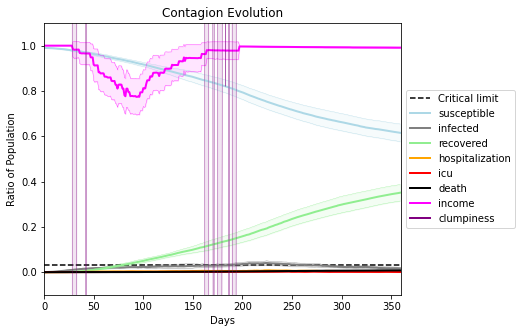

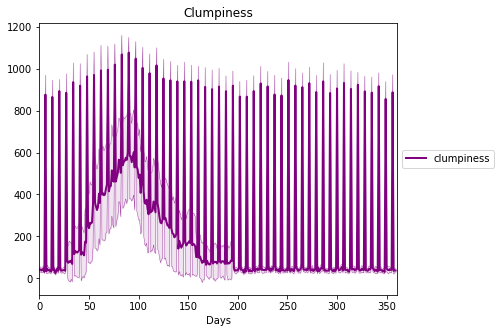

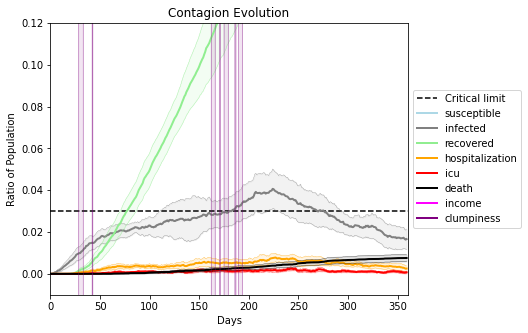

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9808, 3055, 3650, 4637, 3788, 1924, 2348, 2332, 9933, 5301, 317, 3386, 1066, 3559, 4650, 3334, 5307, 5798, 9493, 5824]
Average similarity between family members is 0.25652938225994154 at temperature -0.5
Average similarity between family and home is 0.9998531737884963 at temperature -1
Average similarity between students and their classroom is 0.16703276321762928 at temperature -0.5
Average classroom occupancy is 1.6051282051282052 and number classrooms is 195
Average similarity between workers is 0.15175742479343687 at temperature -0.5
Average office occupancy is 3.129353233830846 and number offices is 201
Average friend similarity for adults: 0.3184456663672663 for kids: 0.2182965727320697
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.05105607230054184
avg restaurant similarity 0.05521402619906207
avg restaurant similarity 0.04536709206394972
avg restaurant similarity 0.09092048074943998
avg restaurant similarity 0.03519510759733822
avg restaurant similarity 0.1091908651988667
avg restaurant similarity 0.05234586592822858
avg restaurant similarity 0.07951819289725184
avg restaurant similarity 0.09335612785784073
avg restaurant similarity 0.034648900573020655
avg restaurant similarity 0.060794740418330474
avg restaurant similarity -0.005033845170378741
avg restaurant similarity 0.10359885445908876
avg restaurant similarity 0.05414606295322583
avg restaurant similarity 0.043475829742331114
avg restaurant similarity 0.07504882982021972
avg restaurant similarity 0.0785556357583199
avg restaurant similarity 0.07747523257760733
avg restaurant similarity 0.09777572126912909
avg restaurant similarity 0.0013650288817316707
avg restaurant similarity 0.05100664603589058
avg restaurant similarity 0.0

avg restaurant similarity 0.09736619562870172
avg restaurant similarity 0.029734204152750285
avg restaurant similarity 0.044558995602601396
avg restaurant similarity 0.06161707839430644
avg restaurant similarity 0.009077684313079249
avg restaurant similarity 0.0042907267840559095
avg restaurant similarity 0.08139011511401821
avg restaurant similarity 0.019635948881894787
avg restaurant similarity 0.04149863175770494
avg restaurant similarity 0.06907608803879028
avg restaurant similarity 0.027682977364656906
avg restaurant similarity 0.05013343571361066
avg restaurant similarity 0.063421865163494
avg restaurant similarity 0.17760046529523335
avg restaurant similarity 0.08298604171446451
avg restaurant similarity 0.10165804449423985
avg restaurant similarity 0.037768805923213744
avg restaurant similarity 0.1324080853378134
avg restaurant similarity 0.020637294262393538
avg restaurant similarity 0.08530494437705816
avg restaurant similarity 0.06260333181722363
avg restaurant similarity 0.

avg restaurant similarity 0.1411933443451032
avg restaurant similarity 0.0364228336990593
avg restaurant similarity 0.05590803721713232
avg restaurant similarity 0.06731718787628115
Average similarity between family members is 0.26650603088687197 at temperature -0.5
Average similarity between family and home is 0.9998635190234163 at temperature -1
Average similarity between students and their classroom is 0.16873562087521418 at temperature -0.5
Average classroom occupancy is 1.572972972972973 and number classrooms is 185
Average similarity between workers is 0.1603876909810146 at temperature -0.5
Average office occupancy is 3.3626943005181347 and number offices is 193
Average friend similarity for adults: 0.32294706725098654 for kids: 0.22056418653139642
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.02578372425816219
avg restaurant similarity 0.08776397644065606
avg restaurant similarity 0.043095050582074
avg restaurant similarity 0.06844071398805765
avg restaurant similarity 0.004467936426728613
avg restaurant similarity 0.06005345991911735
avg restaurant similarity 0.023941338594665594
avg restaurant similarity 0.046613834111624494
avg restaurant similarity 0.04618687752674347
avg restaurant similarity 0.12826252201625368
avg restaurant similarity 0.029355824326601165
avg restaurant similarity 0.03681150688108462
avg restaurant similarity 0.03642278640659908
avg restaurant similarity 0.08716773173748674
avg restaurant similarity 0.08880597502664904
avg restaurant similarity 0.05312990725536952
avg restaurant similarity 0.06838738630964096
avg restaurant similarity 0.08000408185162045
avg restaurant similarity 0.10722810854519256
avg restaurant similarity 0.021075683076674675
avg restaurant similarity 0.044305327717435665
avg restaurant similarity 0.09

avg restaurant similarity 0.0968998093016305
avg restaurant similarity 0.03873402869694305
avg restaurant similarity 0.07403931057235029
avg restaurant similarity 0.04430679930061157
avg restaurant similarity 0.07493414774154698
avg restaurant similarity 0.07185696140983437
avg restaurant similarity 0.028476018835356907
avg restaurant similarity 0.07792630960971389
avg restaurant similarity 0.11069436899224508
avg restaurant similarity 0.09082060291722109
avg restaurant similarity 0.07569447246214893
avg restaurant similarity 0.06320214504580705
avg restaurant similarity 0.03872169254136943
avg restaurant similarity 0.12292243564668688
avg restaurant similarity 0.024568824943223364
avg restaurant similarity 0.01217469358525092
avg restaurant similarity 0.06218951469249682
avg restaurant similarity 0.012285240754767095
avg restaurant similarity 0.02987636274879587
avg restaurant similarity 0.07312161747085148
avg restaurant similarity 0.08256395037824346
avg restaurant similarity 0.0837

avg restaurant similarity 0.06599262936862585
avg restaurant similarity 0.06461504722149895
avg restaurant similarity 0.06307993510026268
avg restaurant similarity 0.05926679802650212
Average similarity between family members is 0.2583256791861121 at temperature -0.5
Average similarity between family and home is 0.9998623501143701 at temperature -1
Average similarity between students and their classroom is 0.1800186067686428 at temperature -0.5
Average classroom occupancy is 1.6035502958579881 and number classrooms is 169
Average similarity between workers is 0.16154398929902208 at temperature -0.5
Average office occupancy is 3.315 and number offices is 200
Average friend similarity for adults: 0.3373976143185109 for kids: 0.2233863759412629
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.09095275601055999
avg restaurant similarity 0.09075578283106427
avg restaurant similarity 0.1378481342747618
avg restaurant similarity 0.047430345340762056
avg restaurant similarity 0.13756673333075248
avg restaurant similarity 0.1200480300941825
avg restaurant similarity 0.1090802962697124
avg restaurant similarity 0.09061171230235684
avg restaurant similarity 0.11754441033441974
avg restaurant similarity 0.09602230899482478
avg restaurant similarity 0.10394015912645767
avg restaurant similarity 0.08322238264546243
avg restaurant similarity 0.04884852695073037
avg restaurant similarity 0.11203438681763594
avg restaurant similarity 0.06509883180843323
avg restaurant similarity 0.1362441454724209
avg restaurant similarity 0.10790257366253761
avg restaurant similarity 0.08783228488888542
avg restaurant similarity 0.1343307262569842
avg restaurant similarity 0.12274728746148725
avg restaurant similarity 0.1510747563276437
avg restaurant similarity 0.10384237506

avg restaurant similarity 0.12740273034443572
avg restaurant similarity 0.11842853681359683
avg restaurant similarity 0.13189925526903823
avg restaurant similarity 0.04020655823856249
avg restaurant similarity 0.11314500931510656
avg restaurant similarity 0.06784717731345064
avg restaurant similarity 0.10135244818294874
avg restaurant similarity 0.08971193858050228
avg restaurant similarity 0.06763053994229574
avg restaurant similarity 0.15296404848228276
avg restaurant similarity 0.09157713477175901
avg restaurant similarity 0.06718939794849249
avg restaurant similarity 0.053666562206584424
avg restaurant similarity 0.12985858912141493
avg restaurant similarity 0.0825352390032345
avg restaurant similarity 0.06993245282372691
avg restaurant similarity 0.11412020760898041
avg restaurant similarity 0.10370862935369941
avg restaurant similarity 0.1109466228634236
avg restaurant similarity 0.05694273930233049
avg restaurant similarity 0.15663454126038479
avg restaurant similarity 0.1197140

avg restaurant similarity 0.15481388438030955
avg restaurant similarity 0.102418840518961
Average similarity between family members is 0.26189599578509803 at temperature -0.5
Average similarity between family and home is 0.9998524919304285 at temperature -1
Average similarity between students and their classroom is 0.12624907288459578 at temperature -0.5
Average classroom occupancy is 1.6136363636363635 and number classrooms is 176
Average similarity between workers is 0.15943868938471167 at temperature -0.5
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.3314250460428847 for kids: 0.22460847985969484
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated u

avg restaurant similarity 0.06336621350254942
avg restaurant similarity 0.06203374265908089
avg restaurant similarity 0.11293264230062358
avg restaurant similarity 0.15285502732850811
avg restaurant similarity 0.1451267323352543
avg restaurant similarity 0.07411797528399117
avg restaurant similarity 0.1113661379666942
avg restaurant similarity 0.13049460223329284
avg restaurant similarity 0.16779954608917494
avg restaurant similarity 0.08684373282776364
avg restaurant similarity 0.14032231268979928
avg restaurant similarity 0.05399514479687682
avg restaurant similarity 0.06996110406594364
avg restaurant similarity 0.030691807949859547
avg restaurant similarity 0.1363930982556911
avg restaurant similarity 0.09690746757158306
avg restaurant similarity 0.11149967395468896
avg restaurant similarity 0.15079713142321352
avg restaurant similarity 0.10708249968859405
avg restaurant similarity 0.10412163306791504
avg restaurant similarity 0.08042746226974912
avg restaurant similarity 0.12036530

avg restaurant similarity 0.12934378936347232
avg restaurant similarity 0.04711838673898018
avg restaurant similarity 0.08087034055295489
avg restaurant similarity 0.17379168223188057
avg restaurant similarity 0.0673327669668076
avg restaurant similarity 0.11224646112617225
avg restaurant similarity 0.137378936294348
avg restaurant similarity -0.003388826390000486
avg restaurant similarity 0.07941856498783913
avg restaurant similarity 0.085080406211302
avg restaurant similarity 0.11421696712372312
avg restaurant similarity 0.048454091272201585
avg restaurant similarity 0.13445718998397083
avg restaurant similarity 0.1582604191661384
avg restaurant similarity 0.09746627804454386
avg restaurant similarity 0.11311699896795509
avg restaurant similarity 0.05171784002256034
avg restaurant similarity 0.07538538129352458
avg restaurant similarity 0.11139432093955759
avg restaurant similarity 0.10566989358964932
avg restaurant similarity 0.13513614074985028
avg restaurant similarity 0.072870470

avg restaurant similarity 0.1460844489182913
avg restaurant similarity 0.04464751697447654
avg restaurant similarity 0.02180647177638638
Average similarity between family members is 0.2553370063308903 at temperature -0.5
Average similarity between family and home is 0.9998609253142424 at temperature -1
Average similarity between students and their classroom is 0.1727997697253539 at temperature -0.5
Average classroom occupancy is 1.6120218579234973 and number classrooms is 183
Average similarity between workers is 0.14478736089558908 at temperature -0.5
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.31849519490426975 for kids: 0.219675677367703
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity 0.06281328805435644
avg restaurant similarity 0.07413516794741622
avg restaurant similarity 0.08113492345624845
avg restaurant similarity 0.05912084651020854
avg restaurant similarity 0.040732243123035625
avg restaurant similarity 0.1151548732865412
avg restaurant similarity 0.07612885335564504
avg restaurant similarity 0.08991019590977342
avg restaurant similarity 0.05641388242656634
avg restaurant similarity 0.06533269805222684
avg restaurant similarity 0.07072966695036911
avg restaurant similarity 0.06609586117783901
avg restaurant similarity 0.10831741305844399
avg restaurant similarity 0.06495502764990703
avg restaurant similarity 0.06369640250427099
avg restaurant similarity 0.08815470438744066
avg restaurant similarity 0.07768885596589821
avg restaurant similarity 0.03755008672656643
avg restaurant similarity 0.08939519347818896
avg restaurant similarity 0.08923530244535838
avg restaurant similarity 0.09958696013833804
avg restaurant similarity 0.082925

avg restaurant similarity 0.067947921442303
avg restaurant similarity 0.05793584522580779
avg restaurant similarity 0.10278213478729183
avg restaurant similarity 0.09144711744031331
avg restaurant similarity 0.06061945892070168
avg restaurant similarity 0.07573257060378212
avg restaurant similarity 0.011446187908637113
avg restaurant similarity 0.0777903045596141
avg restaurant similarity 0.10493541008257112
avg restaurant similarity 0.08423139508021174
avg restaurant similarity 0.09645762801825039
avg restaurant similarity 0.06464913973535384
avg restaurant similarity 0.09580247937193845
avg restaurant similarity 0.08269656020496548
avg restaurant similarity 0.054380167762800705
avg restaurant similarity 0.10343091487097292
avg restaurant similarity 0.06915228564225888
avg restaurant similarity 0.10685069050908953
avg restaurant similarity 0.07488564345442537
avg restaurant similarity 0.04694349024602818
avg restaurant similarity 0.07779780754806441
avg restaurant similarity 0.0773998

avg restaurant similarity 0.051270509990494706
avg restaurant similarity 0.09216542753789765
Average similarity between family members is 0.2645575273820213 at temperature -0.5
Average similarity between family and home is 0.9998445578465437 at temperature -1
Average similarity between students and their classroom is 0.18248230440735155 at temperature -0.5
Average classroom occupancy is 1.6242774566473988 and number classrooms is 173
Average similarity between workers is 0.14403313440705554 at temperature -0.5
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.32767814700632414 for kids: 0.20495449252600748
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocat

avg restaurant similarity 0.055884511721653034
avg restaurant similarity 0.05396486067634123
avg restaurant similarity 0.09263180617626496
avg restaurant similarity 0.08911769037210368
avg restaurant similarity 0.03265825637242024
avg restaurant similarity 0.09543618648213333
avg restaurant similarity 0.06405911225997742
avg restaurant similarity 0.1096936080505458
avg restaurant similarity 0.08712825063392501
avg restaurant similarity 0.11000524590692304
avg restaurant similarity 0.08083289789524425
avg restaurant similarity 0.1234586884801767
avg restaurant similarity 0.061775531422260395
avg restaurant similarity 0.10593977455095084
avg restaurant similarity 0.08873389077859306
avg restaurant similarity 0.05526052795550206
avg restaurant similarity 0.13760211693853075
avg restaurant similarity 0.048295704557984036
avg restaurant similarity 0.10656073497467539
avg restaurant similarity 0.07042953548800396
avg restaurant similarity 0.13542765027351666
avg restaurant similarity 0.04095

avg restaurant similarity 0.0778954409475797
avg restaurant similarity 0.07300887593732348
avg restaurant similarity 0.06378362990883531
avg restaurant similarity 0.05231389883876463
avg restaurant similarity 0.052884641836798425
avg restaurant similarity 0.09029224672468082
avg restaurant similarity 0.11911169938428535
avg restaurant similarity 0.06928799780235638
avg restaurant similarity 0.06521518835006913
avg restaurant similarity 0.10974732083795101
avg restaurant similarity 0.12357711680792206
avg restaurant similarity 0.08615936312381943
avg restaurant similarity 0.08556724359335421
avg restaurant similarity 0.0913804399199936
avg restaurant similarity 0.09911300589919615
avg restaurant similarity 0.06538330459254076
avg restaurant similarity 0.10351568154044204
avg restaurant similarity 0.09906765239881732
avg restaurant similarity 0.05099231514316067
avg restaurant similarity 0.058887638538569986
avg restaurant similarity 0.10305638734636426
avg restaurant similarity 0.055721

avg restaurant similarity 0.07252421406327259
avg restaurant similarity 0.07867911224271999
Average similarity between family members is 0.2514993357212921 at temperature -0.5
Average similarity between family and home is 0.9998553455523984 at temperature -1
Average similarity between students and their classroom is 0.20488153329701733 at temperature -0.5
Average classroom occupancy is 1.5480225988700564 and number classrooms is 177
Average similarity between workers is 0.16322755486365098 at temperature -0.5
Average office occupancy is 3.3069306930693068 and number offices is 202
Average friend similarity for adults: 0.33080795817369196 for kids: 0.21419345949762536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloca

avg restaurant similarity 0.05764286397662591
avg restaurant similarity 0.059602634757589125
avg restaurant similarity 0.08346383170094716
avg restaurant similarity 0.056241686599673824
avg restaurant similarity 0.0498063295010229
avg restaurant similarity 0.06613653520337372
avg restaurant similarity 0.028947717956784393
avg restaurant similarity 0.09759898429574332
avg restaurant similarity 0.016255823424459616
avg restaurant similarity 0.06281914576870123
avg restaurant similarity 0.08484939708551438
avg restaurant similarity 0.06278566329631427
avg restaurant similarity 0.03242863982482372
avg restaurant similarity 0.05602914627676116
avg restaurant similarity 0.054832163481493744
avg restaurant similarity 0.08156383984668904
avg restaurant similarity 0.08562078144616891
avg restaurant similarity 0.05122276455866153
avg restaurant similarity 0.09541532066622838
avg restaurant similarity 0.03445683750517862
avg restaurant similarity 0.070835597818699
avg restaurant similarity 0.0514

avg restaurant similarity 0.02770230277757939
avg restaurant similarity 0.0556758372345443
avg restaurant similarity 0.042252048569399306
avg restaurant similarity 0.0978216887322832
avg restaurant similarity 0.06560401802977252
avg restaurant similarity 0.056178539348094345
avg restaurant similarity 0.03677093328932613
avg restaurant similarity 0.12542355062341393
avg restaurant similarity 0.09555886109553233
avg restaurant similarity 0.1129914037140365
avg restaurant similarity 0.07611166698218376
avg restaurant similarity 0.07629533997248786
avg restaurant similarity 0.03342017723101384
avg restaurant similarity 0.019725399772869877
avg restaurant similarity 0.07118891553762713
avg restaurant similarity 0.1037157851158519
avg restaurant similarity 0.02860497492615308
avg restaurant similarity 0.10397188505824123
avg restaurant similarity 0.045738298200739186
avg restaurant similarity 0.06683496460291402
avg restaurant similarity 0.05702429878681355
avg restaurant similarity 0.055187

avg restaurant similarity 0.05262688000853833
avg restaurant similarity 0.04096385362149282
avg restaurant similarity 0.09164571245761877
avg restaurant similarity 0.06282705833005825
Average similarity between family members is 0.2530413047283561 at temperature -0.5
Average similarity between family and home is 0.9998509557899086 at temperature -1
Average similarity between students and their classroom is 0.1549657959769161 at temperature -0.5
Average classroom occupancy is 1.6 and number classrooms is 175
Average similarity between workers is 0.1614210148770485 at temperature -0.5
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.33242083243606046 for kids: 0.22514739779127826
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.0716093130483845
avg restaurant similarity 0.054724408672715226
avg restaurant similarity 0.08311556057437856
avg restaurant similarity 0.10663952146082632
avg restaurant similarity 0.08144973810558014
avg restaurant similarity 0.06030456944754767
avg restaurant similarity 0.07370884625409856
avg restaurant similarity 0.05552378673270149
avg restaurant similarity 0.09060037007305945
avg restaurant similarity 0.06270658678051862
avg restaurant similarity 0.013084790072519292
avg restaurant similarity 0.09136200941787997
avg restaurant similarity 0.06781243446549017
avg restaurant similarity 0.0519032580791854
avg restaurant similarity 0.10082913597505662
avg restaurant similarity 0.11704203372255541
avg restaurant similarity 0.0614514830101318
avg restaurant similarity 0.11361301881685598
avg restaurant similarity 0.08598677568189697
avg restaurant similarity 0.09029499885123057
avg restaurant similarity 0.06185175651815116
avg restaurant similarity 0.0655124

avg restaurant similarity 0.08558302599627025
avg restaurant similarity 0.07058452690024193
avg restaurant similarity 0.10303135270461161
avg restaurant similarity 0.10078547979411151
avg restaurant similarity 0.046839614226799824
avg restaurant similarity 0.08891614819563749
avg restaurant similarity 0.08919885790739689
avg restaurant similarity 0.05424193960738772
avg restaurant similarity 0.10127261236817162
avg restaurant similarity 0.08876882317321473
avg restaurant similarity 0.060585945779676145
avg restaurant similarity 0.06936362182573287
avg restaurant similarity 0.07981501140217817
avg restaurant similarity 0.04948006451707586
avg restaurant similarity 0.08694277728564127
avg restaurant similarity 0.037948927329878375
avg restaurant similarity 0.08114020889839556
avg restaurant similarity 0.05800097492100068
avg restaurant similarity 0.09976386947599318
avg restaurant similarity 0.08002466962087282
avg restaurant similarity 0.051188123541206214
avg restaurant similarity 0.04

avg restaurant similarity 0.08629069537934037
avg restaurant similarity 0.09937178847574081
Average similarity between family members is 0.2296102288552888 at temperature -0.5
Average similarity between family and home is 0.9998613033248842 at temperature -1
Average similarity between students and their classroom is 0.16583739324768423 at temperature -0.5
Average classroom occupancy is 1.6590909090909092 and number classrooms is 176
Average similarity between workers is 0.16422207291186067 at temperature -0.5
Average office occupancy is 3.2908163265306123 and number offices is 196
Average friend similarity for adults: 0.32600439582712504 for kids: 0.2164670047346885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.0728501444772009
avg restaurant similarity 0.05087649878158735
avg restaurant similarity 0.07401567377060098
avg restaurant similarity 0.0929426688780515
avg restaurant similarity 0.10854079073490377
avg restaurant similarity 0.061555843400763414
avg restaurant similarity 0.071207626156808
avg restaurant similarity 0.02678079828800187
avg restaurant similarity 0.0730518445756555
avg restaurant similarity 0.049047819038056155
avg restaurant similarity 0.09359092131917154
avg restaurant similarity 0.0795060058397258
avg restaurant similarity 0.09021386333572703
avg restaurant similarity 0.06268155127003439
avg restaurant similarity 0.0689581332843044
avg restaurant similarity 0.03088518911291183
avg restaurant similarity 0.11559521092674752
avg restaurant similarity 0.04510598409308098
avg restaurant similarity 0.07639420515507431
avg restaurant similarity 0.07283113564667905
avg restaurant similarity 0.044654087306271364
avg restaurant similarity 0.0904233346

avg restaurant similarity 0.04126391361885184
avg restaurant similarity 0.0629238650437763
avg restaurant similarity 0.1126906093067131
avg restaurant similarity 0.03911341741012322
avg restaurant similarity 0.07379485249139935
avg restaurant similarity 0.0595990026321962
avg restaurant similarity 0.06805964165421138
avg restaurant similarity 0.04328397446740636
avg restaurant similarity 0.041402103122429305
avg restaurant similarity 0.06690698947269387
avg restaurant similarity 0.04939516796765503
avg restaurant similarity 0.05554962878692649
avg restaurant similarity 0.07140388989361815
avg restaurant similarity 0.06513801171256216
avg restaurant similarity 0.0784812245276791
avg restaurant similarity 0.07841355410391856
avg restaurant similarity 0.07955766824896751
avg restaurant similarity 0.044753348598925116
avg restaurant similarity 0.07105659633278628
avg restaurant similarity 0.06808948540249021
avg restaurant similarity 0.08257078242062882
avg restaurant similarity 0.08387986

avg restaurant similarity 0.12950400188528222
avg restaurant similarity 0.046396058318767155
avg restaurant similarity 0.06940958573927543
avg restaurant similarity 0.09729338864130826
Average similarity between family members is 0.25958462480711164 at temperature -0.5
Average similarity between family and home is 0.9998577122294561 at temperature -1
Average similarity between students and their classroom is 0.17971210595328108 at temperature -0.5
Average classroom occupancy is 1.5363128491620113 and number classrooms is 179
Average similarity between workers is 0.16593011454471204 at temperature -0.5
Average office occupancy is 3.36 and number offices is 200
Average friend similarity for adults: 0.3298628602075663 for kids: 0.2160694509320282
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.018235250243720302
avg restaurant similarity 0.07991344033709129
avg restaurant similarity 0.05164845971088437
avg restaurant similarity 0.09256268628923027
avg restaurant similarity 0.07151421169829345
avg restaurant similarity 0.06392560259988998
avg restaurant similarity -0.005653245817951706
avg restaurant similarity 0.047739160331674704
avg restaurant similarity 0.04917334044960099
avg restaurant similarity 0.022589243076147385
avg restaurant similarity 0.06945988538276839
avg restaurant similarity 0.02622577249005756
avg restaurant similarity 0.019110970994516606
avg restaurant similarity 0.09172995877774161
avg restaurant similarity -0.004437716215342277
avg restaurant similarity 0.07681272143276911
avg restaurant similarity 0.07401093123400608
avg restaurant similarity 0.027290587130383757
avg restaurant similarity 0.08253675213470733
avg restaurant similarity 0.05911517869136423
avg restaurant similarity 0.06587856939886182
avg restaurant similarity

avg restaurant similarity 0.08095767357251189
avg restaurant similarity 0.09805162574680627
avg restaurant similarity 0.06287829474562094
avg restaurant similarity 0.07353434447505981
avg restaurant similarity 0.09646801310109417
avg restaurant similarity 0.08223916590165095
avg restaurant similarity 0.07017593892943007
avg restaurant similarity 0.054100375473475744
avg restaurant similarity 0.06845924392014481
avg restaurant similarity 0.046367893046513356
avg restaurant similarity 0.04638908384217347
avg restaurant similarity 0.07522495228246699
avg restaurant similarity 0.061910890629509246
avg restaurant similarity 0.09890412098798979
avg restaurant similarity 0.0779734953186878
avg restaurant similarity 0.027261661523009958
avg restaurant similarity 0.08190994568686166
avg restaurant similarity 0.016398774762636043
avg restaurant similarity 0.007128619026067267
avg restaurant similarity 0.07678481371710463
avg restaurant similarity 0.07663821382483953
avg restaurant similarity 0.0

avg restaurant similarity 0.06345310693955156
avg restaurant similarity -0.006255649431193179
avg restaurant similarity 0.08103585060545902
avg restaurant similarity 0.06170281311415364
Average similarity between family members is 0.26391099195788176 at temperature -0.5
Average similarity between family and home is 0.9998597715710257 at temperature -1
Average similarity between students and their classroom is 0.17769328395519254 at temperature -0.5
Average classroom occupancy is 1.622093023255814 and number classrooms is 172
Average similarity between workers is 0.1400274900862939 at temperature -0.5
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.32152117228995697 for kids: 0.2131022475154128
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.07585865619043174
avg restaurant similarity 0.09314573952353976
avg restaurant similarity 0.0638304846946877
avg restaurant similarity 0.0625166655921941
avg restaurant similarity 0.03199115662528623
avg restaurant similarity 0.07352237240904594
avg restaurant similarity 0.06245468234476248
avg restaurant similarity 0.07034395171046712
avg restaurant similarity 0.04527488568861214
avg restaurant similarity 0.07002883019881138
avg restaurant similarity 0.09203730152688679
avg restaurant similarity 0.09549426842705161
avg restaurant similarity 0.027658953469727243
avg restaurant similarity 0.07651179744717275
avg restaurant similarity 0.07096920853339822
avg restaurant similarity 0.041553058468456514
avg restaurant similarity 0.004810238127989055
avg restaurant similarity 0.05304099739651375
avg restaurant similarity 0.07496502179023364
avg restaurant similarity 0.009529619086893678
avg restaurant similarity 0.07395196098869758
avg restaurant similarity 0.0433

avg restaurant similarity 0.020883932199410683
avg restaurant similarity 0.09107718367327924
avg restaurant similarity 0.01200887562861876
avg restaurant similarity 0.04692400659986286
avg restaurant similarity 0.020265932962493415
avg restaurant similarity 0.01187530066534957
avg restaurant similarity 0.015750834892455667
avg restaurant similarity 0.046518760311322536
avg restaurant similarity 0.08104445925899235
avg restaurant similarity 0.08460252754967806
avg restaurant similarity 0.011849582261395056
avg restaurant similarity 0.04391812101163615
avg restaurant similarity 0.038632630700475006
avg restaurant similarity 0.08873386053947743
avg restaurant similarity -0.016465681036244337
avg restaurant similarity 0.09511068738983439
avg restaurant similarity 0.05352582632405198
avg restaurant similarity 0.037739029519324604
avg restaurant similarity 0.06545966312766706
avg restaurant similarity 0.08801983802076581
avg restaurant similarity 0.04182693187727333
avg restaurant similarity

avg restaurant similarity 0.0558175321236176
avg restaurant similarity 0.0730847829926368
avg restaurant similarity 0.052020112099390184
avg restaurant similarity 0.047470290600151455
avg restaurant similarity 0.06815732031579572
Average similarity between family members is 0.2560126370453219 at temperature -0.5
Average similarity between family and home is 0.9998513483660707 at temperature -1
Average similarity between students and their classroom is 0.1823506915844357 at temperature -0.5
Average classroom occupancy is 1.4857142857142858 and number classrooms is 175
Average similarity between workers is 0.1605764412405151 at temperature -0.5
Average office occupancy is 3.4020100502512562 and number offices is 199
Average friend similarity for adults: 0.32937737182121934 for kids: 0.22591502676810055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people alloc

avg restaurant similarity 0.08319308380242776
avg restaurant similarity 0.05298966197968037
avg restaurant similarity 0.07307517994944025
avg restaurant similarity 0.04236975851626575
avg restaurant similarity 0.05202854034873451
avg restaurant similarity 0.03487763058982562
avg restaurant similarity 0.0769933916946515
avg restaurant similarity 0.08420966206166515
avg restaurant similarity 0.07630216082066517
avg restaurant similarity 0.062211175519332966
avg restaurant similarity 0.08664700233815614
avg restaurant similarity 0.07765721736798706
avg restaurant similarity 0.0607483567753308
avg restaurant similarity 0.04926169545328004
avg restaurant similarity 0.07106823941457026
avg restaurant similarity 0.03297393988427239
avg restaurant similarity 0.0800605029984509
avg restaurant similarity 0.0768353398276918
avg restaurant similarity 0.03511520399801089
avg restaurant similarity 0.03774136522270289
avg restaurant similarity 0.03697825165900444
avg restaurant similarity 0.098299299

avg restaurant similarity 0.021483879241515097
avg restaurant similarity 0.07910887544894976
avg restaurant similarity 0.1021871474315178
avg restaurant similarity 0.07942152055119457
avg restaurant similarity 0.08965888806029215
avg restaurant similarity 0.05091203621861823
avg restaurant similarity 0.06313820114049577
avg restaurant similarity 0.08118007735418706
avg restaurant similarity 0.06098062154949509
avg restaurant similarity 0.08793457940406701
avg restaurant similarity 0.044162467528688854
avg restaurant similarity 0.08116906258074219
avg restaurant similarity 0.09510695073248567
avg restaurant similarity 0.06415383333330789
avg restaurant similarity 0.050497877533431094
avg restaurant similarity 0.033617728695656116
avg restaurant similarity 0.06270240189627237
avg restaurant similarity 0.12433213364294776
avg restaurant similarity 0.0517176851211186
avg restaurant similarity 0.04088966326375993
avg restaurant similarity 0.07363785641418152
avg restaurant similarity 0.0278

avg restaurant similarity 0.09736392135328938
avg restaurant similarity 0.09214751207995042
avg restaurant similarity 0.10063166361260467
avg restaurant similarity 0.09364765230307882
Average similarity between family members is 0.24515611163989628 at temperature -0.5
Average similarity between family and home is 0.9998509071190308 at temperature -1
Average similarity between students and their classroom is 0.15997873223444387 at temperature -0.5
Average classroom occupancy is 1.6878980891719746 and number classrooms is 157
Average similarity between workers is 0.16458541691636944 at temperature -0.5
Average office occupancy is 3.3399014778325125 and number offices is 203
Average friend similarity for adults: 0.33042793163762724 for kids: 0.20566737875256333
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.017089661160848788
avg restaurant similarity 0.041472270672634155
avg restaurant similarity 0.04340348466186958
avg restaurant similarity 0.06385411716628019
avg restaurant similarity 0.0314725461326287
avg restaurant similarity 0.052595225536293005
avg restaurant similarity 0.04710122624519418
avg restaurant similarity 0.049829673061137544
avg restaurant similarity 0.02711970829985575
avg restaurant similarity 0.06666514180495085
avg restaurant similarity 0.012651521111742286
avg restaurant similarity 0.04342422572744043
avg restaurant similarity 0.0706905445919361
avg restaurant similarity 0.05903792356830097
avg restaurant similarity 0.06924182075496339
avg restaurant similarity 0.03129882605708625
avg restaurant similarity 0.0816403341118236
avg restaurant similarity 0.08874900503088176
avg restaurant similarity 0.028498085222012616
avg restaurant similarity 0.056581285529065495
avg restaurant similarity 0.0963119266789981
avg restaurant similarity 0.021

avg restaurant similarity 0.025569815247680098
avg restaurant similarity 0.08440191487689411
avg restaurant similarity 0.05914240801835478
avg restaurant similarity 0.026335170350473714
avg restaurant similarity 0.06543279754283216
avg restaurant similarity 0.05923056050341989
avg restaurant similarity 0.04286934044927037
avg restaurant similarity 0.04918255075317745
avg restaurant similarity 0.06432409790464738
avg restaurant similarity 0.05627724673655652
avg restaurant similarity 0.07215651726943763
avg restaurant similarity 0.09121095325611334
avg restaurant similarity 0.10089966359264682
avg restaurant similarity 0.028237561660075954
avg restaurant similarity 0.037403052685393505
avg restaurant similarity 0.10241033458136972
avg restaurant similarity 0.05849326848955455
avg restaurant similarity 0.047671497780654826
avg restaurant similarity 0.07219558899104071
avg restaurant similarity -0.009128934836591497
avg restaurant similarity 0.058351249477293164
avg restaurant similarity 

avg restaurant similarity 0.022985018217063752
avg restaurant similarity 0.06135161019180342
avg restaurant similarity 0.07304527099515698
avg restaurant similarity 0.04751451702167982
Average similarity between family members is 0.24662957538878494 at temperature -0.5
Average similarity between family and home is 0.9998646944837104 at temperature -1
Average similarity between students and their classroom is 0.18207371232295314 at temperature -0.5
Average classroom occupancy is 1.6176470588235294 and number classrooms is 170
Average similarity between workers is 0.13486746896511534 at temperature -0.5
Average office occupancy is 3.3284313725490198 and number offices is 204
Average friend similarity for adults: 0.3194613582893312 for kids: 0.20056805838875685
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.0997264181190678
avg restaurant similarity 0.08337210600089298
avg restaurant similarity 0.07553243907320846
avg restaurant similarity 0.06407562832838057
avg restaurant similarity 0.05120374140030527
avg restaurant similarity 0.0947842341254521
avg restaurant similarity 0.07522940140932326
avg restaurant similarity 0.038809188857353155
avg restaurant similarity 0.09190934905265472
avg restaurant similarity 0.08129628650582002
avg restaurant similarity 0.04041973203534586
avg restaurant similarity 0.04906368311805127
avg restaurant similarity 0.02406930363475921
avg restaurant similarity 0.07880884755966615
avg restaurant similarity 0.11629030716076694
avg restaurant similarity 0.09020885990695168
avg restaurant similarity 0.08256464078541624
avg restaurant similarity 0.07689814572679711
avg restaurant similarity 0.06563952746896706
avg restaurant similarity 0.0962898937809861
avg restaurant similarity 0.0944022298265127
avg restaurant similarity 0.088019225

avg restaurant similarity 0.06057222273269351
avg restaurant similarity 0.02354315860021693
avg restaurant similarity 0.07515122744726914
avg restaurant similarity 0.05906907981948648
avg restaurant similarity 0.021429664782917225
avg restaurant similarity 0.11210377252299956
avg restaurant similarity 0.1104164614570812
avg restaurant similarity 0.06686073673213021
avg restaurant similarity 0.042596884434251345
avg restaurant similarity 0.12708426034652165
avg restaurant similarity 0.03458259099833555
avg restaurant similarity 0.06113601129526254
avg restaurant similarity 0.024039402110046317
avg restaurant similarity 0.0964577094366378
avg restaurant similarity 0.09108732857307585
avg restaurant similarity 0.04883123852994836
avg restaurant similarity 0.09425343499467274
avg restaurant similarity 0.05299542318471312
avg restaurant similarity 0.0891319214488729
avg restaurant similarity 0.06699088008129082
avg restaurant similarity 0.06715854251614996
avg restaurant similarity 0.077879

avg restaurant similarity 0.09690145799573321
avg restaurant similarity 0.06681292266496333
Average similarity between family members is 0.23775721133605124 at temperature -0.5
Average similarity between family and home is 0.9998503180668612 at temperature -1
Average similarity between students and their classroom is 0.16056079347048527 at temperature -0.5
Average classroom occupancy is 1.554945054945055 and number classrooms is 182
Average similarity between workers is 0.12836136149275112 at temperature -0.5
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.32030177745608585 for kids: 0.21010917730724288
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with

avg restaurant similarity 0.06898380725035495
avg restaurant similarity 0.08643475219481377
avg restaurant similarity 0.08325977656104196
avg restaurant similarity 0.033825596658889165
avg restaurant similarity 0.057560723545585474
avg restaurant similarity 0.0880848513847844
avg restaurant similarity 0.0545675407824508
avg restaurant similarity 0.02566836275872073
avg restaurant similarity 0.04837045766087233
avg restaurant similarity 0.04690119736169693
avg restaurant similarity 0.03647544701121623
avg restaurant similarity 0.06281552404164314
avg restaurant similarity 0.10280342922213091
avg restaurant similarity 0.07275059112073988
avg restaurant similarity 0.05180210574403003
avg restaurant similarity 0.07540233490329108
avg restaurant similarity 0.08455894652341404
avg restaurant similarity 0.0728620002269306
avg restaurant similarity 0.09989046078925538
avg restaurant similarity 0.029885480408584887
avg restaurant similarity 0.023478756212642497
avg restaurant similarity 0.10505

avg restaurant similarity 0.08181397101876337
avg restaurant similarity 0.05032527336639342
avg restaurant similarity 0.06098473311644047
avg restaurant similarity 0.0881393943904184
avg restaurant similarity 0.03644288452933301
avg restaurant similarity 0.08058504057854854
avg restaurant similarity 0.017682307486284708
avg restaurant similarity 0.06883780472756378
avg restaurant similarity 0.09714421161462032
avg restaurant similarity 0.028834502999612953
avg restaurant similarity 0.015127931443266707
avg restaurant similarity 0.08181281602645461
avg restaurant similarity 0.07377631328711318
avg restaurant similarity 0.03678416834231988
avg restaurant similarity 0.08316248447860078
avg restaurant similarity 0.034519235730818464
avg restaurant similarity 0.010258755003700284
avg restaurant similarity 0.09889963681771301
avg restaurant similarity 0.013642334859294386
avg restaurant similarity 0.055905875702467675
avg restaurant similarity 0.07249149385795814
avg restaurant similarity 0.

avg restaurant similarity 0.04963425075939237
avg restaurant similarity 0.05770689621506887
avg restaurant similarity 0.12353126151749133
avg restaurant similarity 0.06287610432941024
Average similarity between family members is 0.2298407921417929 at temperature -0.5
Average similarity between family and home is 0.9998703164150811 at temperature -1
Average similarity between students and their classroom is 0.17320855280856756 at temperature -0.5
Average classroom occupancy is 1.6306818181818181 and number classrooms is 176
Average similarity between workers is 0.1647990880600332 at temperature -0.5
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.3341831650221494 for kids: 0.22173249858342464
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.07671934586131832
avg restaurant similarity 0.05062087577811526
avg restaurant similarity 0.06082270247542045
avg restaurant similarity 0.08228043922073386
avg restaurant similarity 0.08855131443478467
avg restaurant similarity 0.057007511493954555
avg restaurant similarity 0.11314237708907142
avg restaurant similarity 0.09591155327918721
avg restaurant similarity 0.09072926829581858
avg restaurant similarity 0.057428998470973054
avg restaurant similarity 0.06621877882169053
avg restaurant similarity 0.042947647981836826
avg restaurant similarity 0.06529367924542143
avg restaurant similarity 0.10024577874381803
avg restaurant similarity 0.10365366954736378
avg restaurant similarity 0.07809104203276203
avg restaurant similarity 0.09290252255099772
avg restaurant similarity 0.06303014213835269
avg restaurant similarity 0.04167740297981023
avg restaurant similarity 0.04405855892949731
avg restaurant similarity 0.08324714265590985
avg restaurant similarity 0.119

avg restaurant similarity 0.11120536226553106
avg restaurant similarity 0.12937276146344534
avg restaurant similarity 0.06445515546044524
avg restaurant similarity 0.08722451538921008
avg restaurant similarity 0.07864087783854579
avg restaurant similarity 0.07391441307780303
avg restaurant similarity 0.07476432570271249
avg restaurant similarity 0.1463979023900556
avg restaurant similarity 0.11343868780550959
avg restaurant similarity 0.07788017925749391
avg restaurant similarity 0.08888788443865807
avg restaurant similarity 0.09344578277853327
avg restaurant similarity 0.10752607374824168
avg restaurant similarity 0.022713485697718486
avg restaurant similarity 0.10609145715714333
avg restaurant similarity 0.08939113545133916
avg restaurant similarity 0.0771968573989218
avg restaurant similarity 0.0741848425375021
avg restaurant similarity 0.06385824672087459
avg restaurant similarity 0.07392673386991473
avg restaurant similarity 0.07065077738762608
avg restaurant similarity 0.05343942

avg restaurant similarity 0.08921584189646181
avg restaurant similarity 0.1006169797382657
Average similarity between family members is 0.24405066367875763 at temperature -0.5
Average similarity between family and home is 0.999865737883424 at temperature -1
Average similarity between students and their classroom is 0.1989182124440314 at temperature -0.5
Average classroom occupancy is 1.5224719101123596 and number classrooms is 178
Average similarity between workers is 0.18612323353358987 at temperature -0.5
Average office occupancy is 3.3681592039800994 and number offices is 201
Average friend similarity for adults: 0.34281880705159534 for kids: 0.22719121008637824
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated 

avg restaurant similarity 0.15916530866389364
avg restaurant similarity 0.05262418972952677
avg restaurant similarity 0.07204621727994778
avg restaurant similarity 0.05432366723118951
avg restaurant similarity 0.0824285463294791
avg restaurant similarity 0.12140091552069962
avg restaurant similarity 0.04439551570560811
avg restaurant similarity 0.08605628515068876
avg restaurant similarity 0.11477119954426104
avg restaurant similarity 0.07387888788583168
avg restaurant similarity 0.11373947913993046
avg restaurant similarity 0.08754456389945896
avg restaurant similarity 0.05346810527374883
avg restaurant similarity 0.06615729375640593
avg restaurant similarity 0.10127879302775052
avg restaurant similarity 0.11173957205504441
avg restaurant similarity 0.11580944702599563
avg restaurant similarity 0.08345625371329235
avg restaurant similarity 0.06490982100337966
avg restaurant similarity 0.04504605358309424
avg restaurant similarity 0.06160327177324432
avg restaurant similarity 0.0917888

avg restaurant similarity 0.04572644768647069
avg restaurant similarity 0.023716664705004463
avg restaurant similarity 0.11810565009571285
avg restaurant similarity 0.1263673694033353
avg restaurant similarity 0.12249731922465061
avg restaurant similarity 0.062495849701696964
avg restaurant similarity 0.1040767663469356
avg restaurant similarity 0.09555208487971162
avg restaurant similarity 0.077944299723657
avg restaurant similarity 0.07070261201465895
avg restaurant similarity 0.059858118077805465
avg restaurant similarity 0.06578076834863805
avg restaurant similarity 0.08035283795040483
avg restaurant similarity 0.1002705350946186
avg restaurant similarity 0.15836593337396995
avg restaurant similarity 0.05270509222645674
avg restaurant similarity 0.09480961069308369
avg restaurant similarity 0.07805696066615683
avg restaurant similarity 0.07978822399322613
avg restaurant similarity 0.054762372388467984
avg restaurant similarity 0.08930065198396761
avg restaurant similarity 0.0866709

avg restaurant similarity 0.05910568640759935
avg restaurant similarity 0.11891028115265463
Average similarity between family members is 0.2473319959675691 at temperature -0.5
Average similarity between family and home is 0.9998615611601928 at temperature -1
Average similarity between students and their classroom is 0.1525890691453112 at temperature -0.5
Average classroom occupancy is 1.6779661016949152 and number classrooms is 177
Average similarity between workers is 0.15039113417001654 at temperature -0.5
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.3145081610190728 for kids: 0.2054767791746003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.05051451811514101
avg restaurant similarity 0.019533753111042707
avg restaurant similarity 0.08711270243068288
avg restaurant similarity 0.04912713506561221
avg restaurant similarity 0.03439105812845066
avg restaurant similarity 0.06102941063863643
avg restaurant similarity -0.01163053374445353
avg restaurant similarity 0.05221971662070837
avg restaurant similarity 0.05310039744673572
avg restaurant similarity 0.019815604604055428
avg restaurant similarity 0.04202120125589795
avg restaurant similarity 0.05968273456627935
avg restaurant similarity 0.09407160797436671
avg restaurant similarity 0.0546108154119918
avg restaurant similarity 0.03443611594039422
avg restaurant similarity 0.003981737553612511
avg restaurant similarity 0.03624345398746775
avg restaurant similarity 0.05235684823119028
avg restaurant similarity 0.04626180869291707
avg restaurant similarity 0.033087894700098326
avg restaurant similarity 0.0812534904754841
avg restaurant similarity 0.092

avg restaurant similarity 0.029897748810095198
avg restaurant similarity 0.06133455082112838
avg restaurant similarity 0.022435795641844305
avg restaurant similarity 0.057126257954963296
avg restaurant similarity 0.08456582540253392
avg restaurant similarity 0.05967305795388862
avg restaurant similarity 0.01892599115397371
avg restaurant similarity 0.06848393242758968
avg restaurant similarity 0.06383280112534596
avg restaurant similarity 0.03471963181745092
avg restaurant similarity 0.0584213858837038
avg restaurant similarity 0.07178101212539618
avg restaurant similarity 0.05671662702218092
avg restaurant similarity 0.09074438770803286
avg restaurant similarity 0.0809830843673699
avg restaurant similarity 0.03308923911191176
avg restaurant similarity 0.049288304352966286
avg restaurant similarity 0.09651442873165339
avg restaurant similarity 0.022139459189827362
avg restaurant similarity 0.08906245695084967
avg restaurant similarity 0.05400809699373307
avg restaurant similarity 0.077

avg restaurant similarity 0.03833026071174447
avg restaurant similarity 0.051683328990802975
avg restaurant similarity 0.005698733235789124
avg restaurant similarity 0.05668099204172463
Average similarity between family members is 0.2543566503258784 at temperature -0.5
Average similarity between family and home is 0.9998423223919505 at temperature -1
Average similarity between students and their classroom is 0.19891583511082878 at temperature -0.5
Average classroom occupancy is 1.5680473372781065 and number classrooms is 169
Average similarity between workers is 0.1533121562443549 at temperature -0.5
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.3326352207231014 for kids: 0.2081511128400024
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.051859598615761233
avg restaurant similarity 0.05037755564159824
avg restaurant similarity 0.1052617927848594
avg restaurant similarity 0.0467179599635883
avg restaurant similarity 0.08820576193549054
avg restaurant similarity 0.07013786293678254
avg restaurant similarity 0.09833778766566391
avg restaurant similarity 0.10545847370006103
avg restaurant similarity 0.0923459770369298
avg restaurant similarity 0.042119957130991176
avg restaurant similarity 0.14861604801729958
avg restaurant similarity 0.11404921684475339
avg restaurant similarity 0.10022893253825663
avg restaurant similarity 0.026182677731421532
avg restaurant similarity 0.07342719729611713
avg restaurant similarity 0.09494265109119789
avg restaurant similarity 0.06398772768401681
avg restaurant similarity 0.08399392515936044
avg restaurant similarity 0.043377049555621314
avg restaurant similarity 0.07715315445931915
avg restaurant similarity 0.0642206399298017
avg restaurant similarity 0.062072

avg restaurant similarity 0.06995267443865529
avg restaurant similarity 0.05351472976760634
avg restaurant similarity 0.10801475714865551
avg restaurant similarity 0.005645713454740484
avg restaurant similarity 0.11011268364365094
avg restaurant similarity 0.05675484100746224
avg restaurant similarity 0.024577652031147014
avg restaurant similarity 0.06479937793948837
avg restaurant similarity 0.043688356323469485
avg restaurant similarity 0.0754017391997787
avg restaurant similarity 0.13314619529742464
avg restaurant similarity 0.09253680623833503
avg restaurant similarity 0.08872631763691835
avg restaurant similarity 0.12459085424420271
avg restaurant similarity 0.0504724909419866
avg restaurant similarity 0.05254402389248178
avg restaurant similarity 0.06155628321961696
avg restaurant similarity 0.06238518268476298
avg restaurant similarity 0.08699995738495256
avg restaurant similarity 0.0647204662280472
avg restaurant similarity 0.04822889647221137
avg restaurant similarity 0.088463

avg restaurant similarity 0.08967196719894753
avg restaurant similarity 0.07215078992964481
avg restaurant similarity 0.07094431783692319
Average similarity between family members is 0.2414914521869087 at temperature -0.5
Average similarity between family and home is 0.9998518490613164 at temperature -1
Average similarity between students and their classroom is 0.13504095338529795 at temperature -0.5
Average classroom occupancy is 1.5397727272727273 and number classrooms is 176
Average similarity between workers is 0.14510191373412076 at temperature -0.5
Average office occupancy is 3.388888888888889 and number offices is 198
Average friend similarity for adults: 0.322062920035498 for kids: 0.21539940062045224
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.09208875331710745
avg restaurant similarity 0.11077235517554679
avg restaurant similarity 0.07504422726174728
avg restaurant similarity 0.08032816654859086
avg restaurant similarity 0.09837836848854489
avg restaurant similarity 0.09574338800844845
avg restaurant similarity 0.07089124884831845
avg restaurant similarity 0.0850145487866989
avg restaurant similarity 0.05397773114910909
avg restaurant similarity 0.12773091329080516
avg restaurant similarity 0.08713709290327588
avg restaurant similarity 0.129234667828374
avg restaurant similarity 0.05625954947979365
avg restaurant similarity 0.1132079847146017
avg restaurant similarity 0.0814087080335
avg restaurant similarity 0.10964944565552215
avg restaurant similarity 0.11701893043406489
avg restaurant similarity 0.0756273028330081
avg restaurant similarity 0.07087861927964992
avg restaurant similarity 0.07824310724881163
avg restaurant similarity 0.022702527279246657
avg restaurant similarity 0.06225195680183

avg restaurant similarity 0.0817777518797582
avg restaurant similarity 0.08601803341185993
avg restaurant similarity 0.12814376399939348
avg restaurant similarity 0.08004450349046056
avg restaurant similarity 0.08141450952171306
avg restaurant similarity 0.06289451465362968
avg restaurant similarity 0.13860396026227942
avg restaurant similarity 0.09405443683135871
avg restaurant similarity 0.1384320702003499
avg restaurant similarity 0.05202302824367512
avg restaurant similarity 0.08847969302245538
avg restaurant similarity 0.1542003756985628
avg restaurant similarity 0.10247320142019088
avg restaurant similarity 0.09023714418701713
avg restaurant similarity 0.07361389002651923
avg restaurant similarity 0.12245265675269734
avg restaurant similarity 0.04736432921226778
avg restaurant similarity 0.07961283701116868
avg restaurant similarity 0.06271333233181538
avg restaurant similarity 0.09291819417881426
avg restaurant similarity 0.12886837873810875
avg restaurant similarity 0.113746777

avg restaurant similarity 0.07211445668902579
avg restaurant similarity 0.11044269847525505
using average of time series:
stats on susceptible:
data: [0.822913888888889, 0.8640611111111112, 0.7755916666666667, 0.7605111111111111, 0.776475, 0.728963888888889, 0.8825155245065426, 0.835488888888889, 0.864013888888889, 0.8543305555555555, 0.7715922965922968, 0.833636111111111, 0.7772521027003099, 0.8415611111111111, 0.872925, 0.8160373697050343, 0.8682361111111111, 0.8444333665669657, 0.8303500000000001, 0.7326583333333332]
min:
0.728963888888889
max:
0.8825155245065426
std:
0.046420138631574036
mean:
0.8176773663368907
median:
0.8319930555555556
95% confidence interval for the mean:
(0.7953876853822939,0.8399670472914875)
using average of time series:
stats on infected:
data: [0.019605555555555557, 0.015172222222222222, 0.02412777777777778, 0.034183333333333336, 0.027138888888888893, 0.03265833333333333, 0.01470115324905744, 0.019052777777777776, 0.017866666666666666, 0.022363888888888885

(<function dict.items>, <function dict.items>, <function dict.items>)

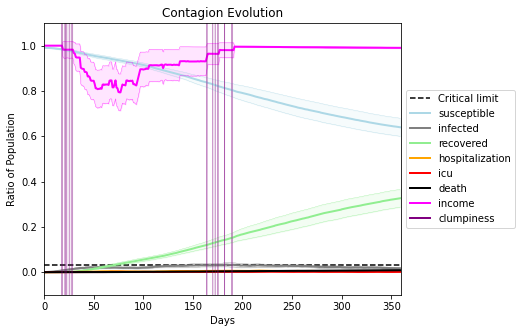

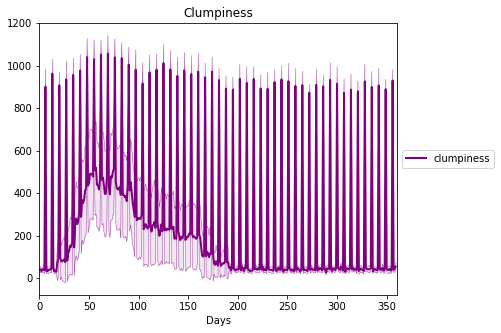

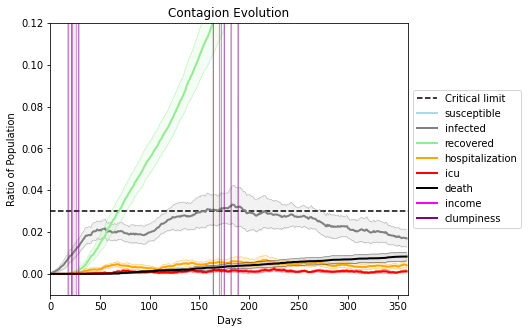

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1102, 7067, 4869, 5592, 742, 6517, 7181, 1201, 3340, 6151, 8513, 5176, 1380, 2412, 8659, 3749, 2495, 587, 2030, 3710]
Average similarity between family members is 0.21406537695926775 at temperature -0.4
Average similarity between family and home is 0.9998516180696416 at temperature -1
Average similarity between students and their classroom is 0.15350355293102352 at temperature -0.4
Average classroom occupancy is 1.6132596685082874 and number classrooms is 181
Average similarity between workers is 0.1366794955259265 at temperature -0.4
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.2742254771454588 for kids: 0.19227495775076803
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity -0.025381614317110696
avg restaurant similarity 0.0031766813000928735
avg restaurant similarity 0.021798248292307164
avg restaurant similarity -0.009229914153852468
avg restaurant similarity 0.050239981022626966
avg restaurant similarity -0.025955834422390533
avg restaurant similarity 0.05122467729429266
avg restaurant similarity -0.014470267379285865
avg restaurant similarity 0.09069298054626995
avg restaurant similarity 0.07021700653978467
avg restaurant similarity 0.029218778753939696
avg restaurant similarity 0.02499133908192183
avg restaurant similarity 0.05480040787785936
avg restaurant similarity 0.03215844698174172
avg restaurant similarity -0.010224746161651505
avg restaurant similarity 0.08928973464138483
avg restaurant similarity 0.004419831293497563
avg restaurant similarity 0.0382882505999128
avg restaurant similarity 0.1242485007213088
avg restaurant similarity 0.06323432743461316
avg restaurant similarity 0.06963638239981577
avg restaurant simil

avg restaurant similarity 0.08183690921392846
avg restaurant similarity 0.039728971331019526
avg restaurant similarity 0.01000319222458328
avg restaurant similarity -0.012698834871240301
avg restaurant similarity 0.0063109323340715655
avg restaurant similarity 0.05833663026933875
avg restaurant similarity -0.010353206412428961
avg restaurant similarity -0.0027760704539467594
avg restaurant similarity 0.020361112926415795
avg restaurant similarity 0.07698343070197237
avg restaurant similarity 0.04683600825489353
avg restaurant similarity 0.08477532397477502
avg restaurant similarity 0.03912981387997191
avg restaurant similarity 0.07071608592528648
avg restaurant similarity 0.06729342401980175
avg restaurant similarity 0.03560971304127744
avg restaurant similarity 0.0494600526003522
avg restaurant similarity -0.011784875865239552
avg restaurant similarity 0.06078754663478908
avg restaurant similarity 0.05121341687304071
avg restaurant similarity 0.07926799276579738
avg restaurant similar

avg restaurant similarity 0.07061272756394801
avg restaurant similarity 0.03186267232701388
avg restaurant similarity 0.013711841012078695
avg restaurant similarity 0.03214063511172095
avg restaurant similarity -0.014959770235157193
avg restaurant similarity 0.02617265797498657
avg restaurant similarity -0.009878843653988625
Average similarity between family members is 0.20770045093197145 at temperature -0.4
Average similarity between family and home is 0.9998501759978193 at temperature -1
Average similarity between students and their classroom is 0.16499949729650185 at temperature -0.4
Average classroom occupancy is 1.5769230769230769 and number classrooms is 182
Average similarity between workers is 0.17854150405073402 at temperature -0.4
Average office occupancy is 3.3197969543147208 and number offices is 197
Average friend similarity for adults: 0.2862505202844456 for kids: 0.21130352971221422
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.07260719630799899
avg restaurant similarity 0.053994237112243784
avg restaurant similarity -0.006551175153175324
avg restaurant similarity 0.03673906064001719
avg restaurant similarity 0.04748093985298049
avg restaurant similarity 0.04617332900673426
avg restaurant similarity 0.0730066761530879
avg restaurant similarity 0.09329814578533374
avg restaurant similarity 0.023740649570795015
avg restaurant similarity 0.06956927979022286
avg restaurant similarity 0.0593887747063049
avg restaurant similarity 0.014553415375201252
avg restaurant similarity 0.055402166341122105
avg restaurant similarity 0.031857697214164725
avg restaurant similarity 0.019590608942319128
avg restaurant similarity 0.07068692460457442
avg restaurant similarity 0.045722137934859824
avg restaurant similarity 0.045661655058544255
avg restaurant similarity 0.05784878674435002
avg restaurant similarity 0.04608406806882391
avg restaurant similarity 0.04584680650355717
avg restaurant similarity 

avg restaurant similarity 0.11200971761547653
avg restaurant similarity 0.10123187439859054
avg restaurant similarity 0.0755560338726939
avg restaurant similarity 0.042460236676188604
avg restaurant similarity 0.02124849294266637
avg restaurant similarity 0.06234796159724234
avg restaurant similarity 0.07751120510010293
avg restaurant similarity 0.015034191272406608
avg restaurant similarity 0.056175035355540595
avg restaurant similarity 0.06276653637783766
avg restaurant similarity 0.04827181292086953
avg restaurant similarity 0.07179109526941839
avg restaurant similarity 0.058831059922062195
avg restaurant similarity 0.07625192606177707
avg restaurant similarity 0.0712230523590422
avg restaurant similarity 0.04608714100964617
avg restaurant similarity 0.03480823665885629
avg restaurant similarity 0.06560590253852779
avg restaurant similarity 0.030524425792147755
avg restaurant similarity 0.07037951459217548
avg restaurant similarity 0.04316808753702774
avg restaurant similarity 0.068

avg restaurant similarity 0.07272489993769678
avg restaurant similarity 0.03440564049985363
avg restaurant similarity 0.03606124374166068
avg restaurant similarity 0.041286496652308935
Average similarity between family members is 0.24787711784099534 at temperature -0.4
Average similarity between family and home is 0.9998635735992533 at temperature -1
Average similarity between students and their classroom is 0.15385576199644213 at temperature -0.4
Average classroom occupancy is 1.5168539325842696 and number classrooms is 178
Average similarity between workers is 0.17342167225711644 at temperature -0.4
Average office occupancy is 3.4207920792079207 and number offices is 202
Average friend similarity for adults: 0.3000459238341031 for kids: 0.22209891026067624
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.06992142496926719
avg restaurant similarity 0.0707053120046652
avg restaurant similarity 0.0414680967552227
avg restaurant similarity 0.07339230828771724
avg restaurant similarity 0.07835702779476851
avg restaurant similarity 0.05026170924384645
avg restaurant similarity 0.05135577789039603
avg restaurant similarity 0.09436567035354243
avg restaurant similarity 0.0777704146234226
avg restaurant similarity 0.08780567195331099
avg restaurant similarity 0.03752087256294171
avg restaurant similarity 0.06756848677859983
avg restaurant similarity 0.07768076078477296
avg restaurant similarity 0.09008746352046991
avg restaurant similarity 0.07951591720352069
avg restaurant similarity 0.12039074886809491
avg restaurant similarity 0.07857349760303231
avg restaurant similarity 0.09163574237853869
avg restaurant similarity 0.09030913389306765
avg restaurant similarity 0.06097717357259079
avg restaurant similarity 0.08831285591565931
avg restaurant similarity 0.046017596

avg restaurant similarity 0.015195765010715704
avg restaurant similarity 0.05740921711497309
avg restaurant similarity 0.11345182684665218
avg restaurant similarity 0.041435210532106415
avg restaurant similarity 0.05111372331666207
avg restaurant similarity 0.058459626314326475
avg restaurant similarity 0.12376243569271392
avg restaurant similarity 0.0590543622661134
avg restaurant similarity 0.019439632351121422
avg restaurant similarity 0.0871388037937207
avg restaurant similarity 0.009509022096505695
avg restaurant similarity -0.0018464459435665356
avg restaurant similarity 0.03047107248545865
avg restaurant similarity 0.0654313931065853
avg restaurant similarity 0.025166989476080818
avg restaurant similarity 0.05102210042172744
avg restaurant similarity 0.0313068621754781
avg restaurant similarity 0.05725617333422035
avg restaurant similarity 0.08215710635907618
avg restaurant similarity 0.041677587042307083
avg restaurant similarity 0.04881390799044939
avg restaurant similarity 0.

avg restaurant similarity 0.11333566975650368
avg restaurant similarity 0.0942870895726293
avg restaurant similarity 0.04941370023243455
Average similarity between family members is 0.24965572510360234 at temperature -0.4
Average similarity between family and home is 0.9998454439089035 at temperature -1
Average similarity between students and their classroom is 0.19473567503804975 at temperature -0.4
Average classroom occupancy is 1.5609756097560976 and number classrooms is 164
Average similarity between workers is 0.1554993338140086 at temperature -0.4
Average office occupancy is 3.4088669950738915 and number offices is 203
Average friend similarity for adults: 0.2945898262373252 for kids: 0.21527797006633337
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.0684859595594572
avg restaurant similarity 0.06856189965983932
avg restaurant similarity 0.06775389112041182
avg restaurant similarity 0.05763505652092625
avg restaurant similarity 0.02442616154896531
avg restaurant similarity 0.01004733226042756
avg restaurant similarity 0.07010858210041238
avg restaurant similarity 0.08751219267793327
avg restaurant similarity 0.06552848471391136
avg restaurant similarity 0.09841131697088955
avg restaurant similarity 0.03538653960135951
avg restaurant similarity 0.041343709379986854
avg restaurant similarity 0.0383436707361529
avg restaurant similarity 0.07135811629901911
avg restaurant similarity 0.04096009256120586
avg restaurant similarity 0.039285439458094894
avg restaurant similarity 0.07448418335370638
avg restaurant similarity 0.09913318198620946
avg restaurant similarity 0.08810055537252592
avg restaurant similarity 0.09941899408722699
avg restaurant similarity 0.06042406071253649
avg restaurant similarity 0.073042

avg restaurant similarity 0.06096902354257414
avg restaurant similarity 0.07888502845442111
avg restaurant similarity 0.06466513115556202
avg restaurant similarity 0.06824215323518412
avg restaurant similarity 0.03998816105700987
avg restaurant similarity 0.07233418599021277
avg restaurant similarity 0.017616061072363087
avg restaurant similarity 0.08647377278984261
avg restaurant similarity 0.028988078118080227
avg restaurant similarity 0.05535078463263817
avg restaurant similarity 0.029112728265991546
avg restaurant similarity 0.08291921232835059
avg restaurant similarity 0.05147977569732012
avg restaurant similarity 0.08685072747050657
avg restaurant similarity 0.06165921419214909
avg restaurant similarity 0.1058695779094583
avg restaurant similarity 0.0624086424209711
avg restaurant similarity 0.03056214858345205
avg restaurant similarity 0.023555933081023328
avg restaurant similarity 0.09003230480909451
avg restaurant similarity 0.03227067590618916
avg restaurant similarity 0.1111

avg restaurant similarity 0.04155637055326644
avg restaurant similarity 0.0664862548850892
avg restaurant similarity 0.10403495621265568
avg restaurant similarity 0.06623664025673864
Average similarity between family members is 0.21518145695882984 at temperature -0.4
Average similarity between family and home is 0.999842834425342 at temperature -1
Average similarity between students and their classroom is 0.17615730592668424 at temperature -0.4
Average classroom occupancy is 1.7076023391812865 and number classrooms is 171
Average similarity between workers is 0.13260997435827332 at temperature -0.4
Average office occupancy is 3.26 and number offices is 200
Average friend similarity for adults: 0.2701294286747675 for kids: 0.20202962455344897
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.03723132915177308
avg restaurant similarity 0.13399642833183273
avg restaurant similarity 0.03194813363625638
avg restaurant similarity 0.08794616703784515
avg restaurant similarity 0.09794432188737139
avg restaurant similarity 0.07466154352858462
avg restaurant similarity 0.09143364329515687
avg restaurant similarity 0.01625177824881601
avg restaurant similarity 0.06104847562859901
avg restaurant similarity 0.04325145330437174
avg restaurant similarity 0.06065164964919402
avg restaurant similarity 0.10982699630663514
avg restaurant similarity 0.020442633707116256
avg restaurant similarity 0.029280160006862805
avg restaurant similarity 0.04308362855859167
avg restaurant similarity 0.09379285528993986
avg restaurant similarity 0.10820111203755133
avg restaurant similarity 0.04302396729040204
avg restaurant similarity 0.04109367852342107
avg restaurant similarity 0.09684151793864915
avg restaurant similarity 0.06798843481965865
avg restaurant similarity 0.0459

avg restaurant similarity 0.03713694719429745
avg restaurant similarity 0.059486213862458885
avg restaurant similarity 0.045947894483244746
avg restaurant similarity 0.06606828281002741
avg restaurant similarity 0.056227898132581486
avg restaurant similarity 0.07986327271764361
avg restaurant similarity 0.11140949284936567
avg restaurant similarity 0.112228319876476
avg restaurant similarity 0.015648978084936323
avg restaurant similarity 0.12665848586107165
avg restaurant similarity 0.0770387816175902
avg restaurant similarity 0.0028901604958531447
avg restaurant similarity 0.0822625719188163
avg restaurant similarity 0.031892308952773986
avg restaurant similarity 0.12546250124036665
avg restaurant similarity 0.06712277046328798
avg restaurant similarity 0.034968619565283625
avg restaurant similarity 0.04468651053289459
avg restaurant similarity 0.07619536976469281
avg restaurant similarity 0.09414163381208512
avg restaurant similarity 0.023353655922930212
avg restaurant similarity 0.0

avg restaurant similarity 0.0781998468371941
avg restaurant similarity 0.07174342075205765
avg restaurant similarity 0.03639766850371403
avg restaurant similarity 0.034585211971447344
Average similarity between family members is 0.23708512039241275 at temperature -0.4
Average similarity between family and home is 0.9998672409523712 at temperature -1
Average similarity between students and their classroom is 0.17256815898263786 at temperature -0.4
Average classroom occupancy is 1.5360824742268042 and number classrooms is 194
Average similarity between workers is 0.15958596534650513 at temperature -0.4
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.28802147265233813 for kids: 0.21678408200433036
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.046832628366391064
avg restaurant similarity 0.08815397555471846
avg restaurant similarity 0.08010301558989928
avg restaurant similarity 0.011782693849689234
avg restaurant similarity 0.052946091085242696
avg restaurant similarity 0.0447462555683879
avg restaurant similarity 0.0503203181893954
avg restaurant similarity 0.10190483419361725
avg restaurant similarity 0.03578642603801808
avg restaurant similarity 0.1247828131021406
avg restaurant similarity 0.08880340191257799
avg restaurant similarity 0.082263167043457
avg restaurant similarity 0.072329606121781
avg restaurant similarity 0.0467216984677474
avg restaurant similarity 0.04644227440945401
avg restaurant similarity 0.045541432247313295
avg restaurant similarity 0.06848821599644708
avg restaurant similarity 0.049770034479449984
avg restaurant similarity 0.04411186118894749
avg restaurant similarity 0.06904166128630243
avg restaurant similarity 0.08730665862195924
avg restaurant similarity 0.060444503

avg restaurant similarity 0.04593090290808492
avg restaurant similarity 0.06901139135833562
avg restaurant similarity 0.08872813947932266
avg restaurant similarity 0.027934599931910404
avg restaurant similarity 0.05643464679074213
avg restaurant similarity 0.031180982532805705
avg restaurant similarity 0.04680861507676321
avg restaurant similarity 0.05750287391175838
avg restaurant similarity 0.09612695717154827
avg restaurant similarity 0.05498849096487557
avg restaurant similarity 0.0832814474484254
avg restaurant similarity 0.061567586277544266
avg restaurant similarity 0.048574509305442916
avg restaurant similarity 0.0631554914441379
avg restaurant similarity 0.06294648257352782
avg restaurant similarity 0.05341492999887001
avg restaurant similarity 0.09795844077056956
avg restaurant similarity 0.07033911501634905
avg restaurant similarity 0.11597944362409521
avg restaurant similarity 0.07200174016631931
avg restaurant similarity 0.0606955901662499
avg restaurant similarity 0.10867

avg restaurant similarity 0.046342342034636594
avg restaurant similarity 0.06588577164093866
avg restaurant similarity 0.06667920363232965
avg restaurant similarity 0.03208669263390496
Average similarity between family members is 0.2285969158408579 at temperature -0.4
Average similarity between family and home is 0.9998515101886828 at temperature -1
Average similarity between students and their classroom is 0.1712205383292538 at temperature -0.4
Average classroom occupancy is 1.706896551724138 and number classrooms is 174
Average similarity between workers is 0.1610804478162533 at temperature -0.4
Average office occupancy is 3.235 and number offices is 200
Average friend similarity for adults: 0.283314673316757 for kids: 0.2142785164039497
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.06247189405015952
avg restaurant similarity 0.03166868955980612
avg restaurant similarity 0.019050584173680173
avg restaurant similarity 0.022658556630670533
avg restaurant similarity 0.024896513373001444
avg restaurant similarity 0.043929716601717864
avg restaurant similarity 0.06830144529440013
avg restaurant similarity 0.04558751311373917
avg restaurant similarity 0.03799267494216276
avg restaurant similarity 0.03021950242675861
avg restaurant similarity 0.0052806065549519
avg restaurant similarity 0.1142487285719667
avg restaurant similarity 0.0597375459311865
avg restaurant similarity 0.028362628670038754
avg restaurant similarity 0.07424565045691998
avg restaurant similarity 0.046803241693204066
avg restaurant similarity 0.06113793366249992
avg restaurant similarity 0.06434412615481913
avg restaurant similarity -0.0021595546388936365
avg restaurant similarity 0.046174289785772454
avg restaurant similarity 0.026778708068160306
avg restaurant similarity 

avg restaurant similarity 0.032742294446699655
avg restaurant similarity 0.061252141098958386
avg restaurant similarity 0.08123349898838299
avg restaurant similarity 0.0694487774051216
avg restaurant similarity 0.0747307451131862
avg restaurant similarity 0.0777792635804276
avg restaurant similarity 0.04683298625240283
avg restaurant similarity 0.044764810624394344
avg restaurant similarity 0.10992727119248633
avg restaurant similarity 0.029252034301660134
avg restaurant similarity 0.019056246764011
avg restaurant similarity 0.05507176352636527
avg restaurant similarity 0.055123632867732156
avg restaurant similarity 0.05533114957625994
avg restaurant similarity 0.04818213009186852
avg restaurant similarity 0.04914473643626808
avg restaurant similarity 0.013526557575471313
avg restaurant similarity 0.05341314799485697
avg restaurant similarity 0.04892394265653533
avg restaurant similarity 0.04277090761736159
avg restaurant similarity 0.08047189443097533
avg restaurant similarity -0.0310

avg restaurant similarity 0.05592700280052724
avg restaurant similarity 0.07386904370492216
avg restaurant similarity 0.06416725429490713
avg restaurant similarity 0.013658658351451584
avg restaurant similarity 0.029996181523951747
avg restaurant similarity 0.02062760069149001
Average similarity between family members is 0.21569471499728532 at temperature -0.4
Average similarity between family and home is 0.9998482621497676 at temperature -1
Average similarity between students and their classroom is 0.15157516227482581 at temperature -0.4
Average classroom occupancy is 1.5491329479768785 and number classrooms is 173
Average similarity between workers is 0.15321879320331522 at temperature -0.4
Average office occupancy is 3.4444444444444446 and number offices is 198
Average friend similarity for adults: 0.29278633768192847 for kids: 0.21071802768826842
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units 

avg restaurant similarity 0.015394138207817137
avg restaurant similarity 0.11845687921339458
avg restaurant similarity 0.027512406320524364
avg restaurant similarity 0.06868655525169277
avg restaurant similarity 0.09302521664219379
avg restaurant similarity 0.07451987372304451
avg restaurant similarity 0.13409164369136112
avg restaurant similarity 0.04955012213401119
avg restaurant similarity 0.014061208678843142
avg restaurant similarity 0.019691750597618487
avg restaurant similarity 0.07509108544318721
avg restaurant similarity 0.03158109560065697
avg restaurant similarity 0.10762269154574688
avg restaurant similarity 0.09669618222529082
avg restaurant similarity 0.06086879717409872
avg restaurant similarity 0.029570922006368173
avg restaurant similarity 0.07616884750190613
avg restaurant similarity 0.02977660363117797
avg restaurant similarity 0.053168686253196595
avg restaurant similarity 0.05143898409721205
avg restaurant similarity 0.055616999037453554
avg restaurant similarity 0

avg restaurant similarity 0.15512590666074616
avg restaurant similarity 0.07899656743796146
avg restaurant similarity 0.10307921242691685
avg restaurant similarity 0.05436224913718021
avg restaurant similarity 0.050463209462570054
avg restaurant similarity 0.05209261797395568
avg restaurant similarity 0.08318866990066436
avg restaurant similarity 0.04918219348785011
avg restaurant similarity 0.059287273110958986
avg restaurant similarity 0.08192630628097602
avg restaurant similarity 0.08776734749110522
avg restaurant similarity 0.06144110379184946
avg restaurant similarity 0.041934488398807285
avg restaurant similarity 0.08113643224888348
avg restaurant similarity 0.023408439298058917
avg restaurant similarity 0.0374823867030033
avg restaurant similarity 0.06426055761571599
avg restaurant similarity 0.0824020901139726
avg restaurant similarity 0.07760299587222269
avg restaurant similarity 0.08762717893085792
avg restaurant similarity 0.03958991572368592
avg restaurant similarity 0.0717

avg restaurant similarity 0.15100434710227068
avg restaurant similarity 0.06242039359751284
avg restaurant similarity 0.0802659538661085
Average similarity between family members is 0.22561480491194066 at temperature -0.4
Average similarity between family and home is 0.9998489713382852 at temperature -1
Average similarity between students and their classroom is 0.17582312795675842 at temperature -0.4
Average classroom occupancy is 1.5 and number classrooms is 178
Average similarity between workers is 0.15303492799027274 at temperature -0.4
Average office occupancy is 3.457286432160804 and number offices is 199
Average friend similarity for adults: 0.2934388633279167 for kids: 0.21167567981496901
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity 0.11747877706486858
avg restaurant similarity 0.07292655946986497
avg restaurant similarity 0.02487622854741627
avg restaurant similarity 0.02915856376526975
avg restaurant similarity 0.05388951640031464
avg restaurant similarity 0.06881603863070837
avg restaurant similarity 0.031233130083262655
avg restaurant similarity 0.08394736552922448
avg restaurant similarity 0.028861407891398693
avg restaurant similarity 0.0708808064278351
avg restaurant similarity 0.040028212758143375
avg restaurant similarity 0.04041240172595245
avg restaurant similarity 0.023813847063397613
avg restaurant similarity 0.03714772848147402
avg restaurant similarity 0.04811655388544047
avg restaurant similarity 0.04674601709857261
avg restaurant similarity 0.07439537459857262
avg restaurant similarity 0.08689538262012764
avg restaurant similarity 0.06158829999031702
avg restaurant similarity 0.01563835166373326
avg restaurant similarity 0.08828632608580189
avg restaurant similarity -0.01

avg restaurant similarity 0.038379029226616374
avg restaurant similarity 0.02816947870192621
avg restaurant similarity 0.049477883330300995
avg restaurant similarity 0.11889278468736049
avg restaurant similarity -0.008451429702527173
avg restaurant similarity -0.00811960252216564
avg restaurant similarity 0.064544689645742
avg restaurant similarity -0.020179136969944788
avg restaurant similarity 0.06977310863022532
avg restaurant similarity 0.004533184955447864
avg restaurant similarity 0.01882046632028651
avg restaurant similarity 0.013798831373244376
avg restaurant similarity 0.05798022751892608
avg restaurant similarity 0.06010100449923747
avg restaurant similarity 0.08809413296904113
avg restaurant similarity 0.06733124168949012
avg restaurant similarity 0.06321228411676087
avg restaurant similarity 0.06053939207402061
avg restaurant similarity 0.10800601862655546
avg restaurant similarity 0.0518007788958264
avg restaurant similarity 0.02187402735563278
avg restaurant similarity 0.

avg restaurant similarity 0.01067115699575722
avg restaurant similarity -0.0014286164198290556
avg restaurant similarity 0.05173631025970487
avg restaurant similarity 0.019008615126932346
avg restaurant similarity 0.04761723990190141
avg restaurant similarity 0.059874122030522656
Average similarity between family members is 0.21804428750396782 at temperature -0.4
Average similarity between family and home is 0.9998529844920111 at temperature -1
Average similarity between students and their classroom is 0.1574910318062318 at temperature -0.4
Average classroom occupancy is 1.618279569892473 and number classrooms is 186
Average similarity between workers is 0.16125546673960406 at temperature -0.4
Average office occupancy is 3.180487804878049 and number offices is 205
Average friend similarity for adults: 0.2747326959518405 for kids: 0.22146652760153338
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units w

avg restaurant similarity 0.015279802773176726
avg restaurant similarity 0.09757745806108624
avg restaurant similarity 0.07939810455220243
avg restaurant similarity 0.06022778768504359
avg restaurant similarity 0.00952043355032931
avg restaurant similarity 0.10376060218088713
avg restaurant similarity 0.021884371345399
avg restaurant similarity 0.13018731631401834
avg restaurant similarity 0.07266566656057855
avg restaurant similarity 0.09724692648350998
avg restaurant similarity 0.06961347079141564
avg restaurant similarity 0.07707407672283849
avg restaurant similarity 0.1129860962833994
avg restaurant similarity 0.07002959467214079
avg restaurant similarity 0.022806814768044376
avg restaurant similarity 0.04251569437964132
avg restaurant similarity 0.02490634500201941
avg restaurant similarity 0.06618479541079088
avg restaurant similarity 0.0755370508579424
avg restaurant similarity 0.060516318952468236
avg restaurant similarity 0.09772673957778535
avg restaurant similarity 0.0620514

avg restaurant similarity 0.08851130273743932
avg restaurant similarity 0.026765559882972495
avg restaurant similarity 0.03056415897195189
avg restaurant similarity 0.05353963972511744
avg restaurant similarity 0.13952627665041298
avg restaurant similarity 0.040869668455725434
avg restaurant similarity 0.07428006016796004
avg restaurant similarity 0.02049558428837197
avg restaurant similarity 0.08053257669117848
avg restaurant similarity 0.06625852767061363
avg restaurant similarity 0.04781866086768405
avg restaurant similarity 0.03656110465899885
avg restaurant similarity 0.09130103893477708
avg restaurant similarity 0.08160023610594794
avg restaurant similarity 0.03695137998347493
avg restaurant similarity 0.09124364584753362
avg restaurant similarity 0.0579291532993128
avg restaurant similarity 0.04110672984019584
avg restaurant similarity 0.0569906642276621
avg restaurant similarity 0.04168859791447091
avg restaurant similarity 0.09353694631321907
avg restaurant similarity 0.047718

avg restaurant similarity 0.10507734758275966
avg restaurant similarity 0.10537611461211102
avg restaurant similarity 0.09125619158214651
Average similarity between family members is 0.2310884390235721 at temperature -0.4
Average similarity between family and home is 0.9998440565352947 at temperature -1
Average similarity between students and their classroom is 0.14709693394935805 at temperature -0.4
Average classroom occupancy is 1.605263157894737 and number classrooms is 190
Average similarity between workers is 0.16882875715532308 at temperature -0.4
Average office occupancy is 3.253807106598985 and number offices is 197
Average friend similarity for adults: 0.270894633748827 for kids: 0.21438029329862296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.07644630922314188
avg restaurant similarity 0.06979921681170852
avg restaurant similarity 0.03771053017757673
avg restaurant similarity 0.045429222824955616
avg restaurant similarity 0.05150954782639783
avg restaurant similarity 0.0786008210215916
avg restaurant similarity 0.07871091298163102
avg restaurant similarity 0.06817832203049874
avg restaurant similarity 0.08194918707782961
avg restaurant similarity 0.05898564292208448
avg restaurant similarity 0.0107936054072956
avg restaurant similarity 0.04602817551856522
avg restaurant similarity 0.026634372740122418
avg restaurant similarity 0.04223465429107439
avg restaurant similarity 0.0497018107288242
avg restaurant similarity 0.04352323592733746
avg restaurant similarity 0.06300947756027982
avg restaurant similarity 0.08034624471406104
avg restaurant similarity 0.06374570987481672
avg restaurant similarity 0.07075623079926564
avg restaurant similarity 0.08001005913044337
avg restaurant similarity 0.0462497

avg restaurant similarity 0.07702679473925647
avg restaurant similarity 0.07955111154607154
avg restaurant similarity 0.027336059574759528
avg restaurant similarity 0.09390214966031342
avg restaurant similarity 0.04740610083343092
avg restaurant similarity 0.0862927906182438
avg restaurant similarity 0.06062259131350013
avg restaurant similarity 0.04394220570720178
avg restaurant similarity 0.05475085560694463
avg restaurant similarity 0.04533302618885078
avg restaurant similarity 0.0909835052215309
avg restaurant similarity 0.0674022762666312
avg restaurant similarity 0.054968277251312224
avg restaurant similarity 0.10165044613928313
avg restaurant similarity 0.067784889617208
avg restaurant similarity 0.05504053748116705
avg restaurant similarity 0.07599406898333826
avg restaurant similarity 0.04102553233593151
avg restaurant similarity 0.07271586152177067
avg restaurant similarity 0.07426035911471429
avg restaurant similarity 0.05883488376874923
avg restaurant similarity 0.066736354

avg restaurant similarity 0.044281896912624796
avg restaurant similarity 0.061900709919078103
avg restaurant similarity 0.041695399355392904
avg restaurant similarity 0.052497504224997736
Average similarity between family members is 0.223111299481487 at temperature -0.4
Average similarity between family and home is 0.9998476428512065 at temperature -1
Average similarity between students and their classroom is 0.15620663374266264 at temperature -0.4
Average classroom occupancy is 1.6229508196721312 and number classrooms is 183
Average similarity between workers is 0.15686313043435848 at temperature -0.4
Average office occupancy is 3.215686274509804 and number offices is 204
Average friend similarity for adults: 0.2918160408371086 for kids: 0.21725284433576456
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.039234285157347726
avg restaurant similarity 0.06140653267906821
avg restaurant similarity 0.03565762396091559
avg restaurant similarity 0.09352799585256502
avg restaurant similarity 0.0680832688636057
avg restaurant similarity 0.040776862438082616
avg restaurant similarity 0.04709539105819019
avg restaurant similarity 0.06404656046653968
avg restaurant similarity 0.07520127465047827
avg restaurant similarity 0.05512636482265658
avg restaurant similarity 0.07562791510356928
avg restaurant similarity 0.07664562902045235
avg restaurant similarity 0.07145131787011784
avg restaurant similarity 0.020059783772798438
avg restaurant similarity 0.08563821198362671
avg restaurant similarity 0.040270016122571396
avg restaurant similarity 0.053260007347987116
avg restaurant similarity 0.0786184814712777
avg restaurant similarity 0.05267933351423949
avg restaurant similarity 0.033541837173945925
avg restaurant similarity 0.05054313049816793
avg restaurant similarity 0.07

avg restaurant similarity 0.0876705879876689
avg restaurant similarity 0.059604672902437046
avg restaurant similarity 0.09230247984820436
avg restaurant similarity 0.06080314875515758
avg restaurant similarity 0.038945342906898356
avg restaurant similarity 0.04009105876167168
avg restaurant similarity 0.050803289970946325
avg restaurant similarity 0.05917970480853058
avg restaurant similarity 0.04063068241879185
avg restaurant similarity 0.04812966050689252
avg restaurant similarity 0.05264412332064253
avg restaurant similarity 0.09304826589279525
avg restaurant similarity 0.03246183920449126
avg restaurant similarity 0.11124994463637335
avg restaurant similarity 0.07345269651424613
avg restaurant similarity 0.06404232750859487
avg restaurant similarity 0.0959562290660676
avg restaurant similarity 0.0512305494204684
avg restaurant similarity 0.03689913903089847
avg restaurant similarity 0.08581397817614049
avg restaurant similarity 0.10907712280571628
avg restaurant similarity 0.075908

avg restaurant similarity 0.04730614652112264
avg restaurant similarity 0.05342266606378787
avg restaurant similarity 0.03586580634212565
avg restaurant similarity 0.07288689053327292
Average similarity between family members is 0.2360393203705147 at temperature -0.4
Average similarity between family and home is 0.9998637405151576 at temperature -1
Average similarity between students and their classroom is 0.20202198647742992 at temperature -0.4
Average classroom occupancy is 1.5 and number classrooms is 170
Average similarity between workers is 0.14468588292714912 at temperature -0.4
Average office occupancy is 3.49009900990099 and number offices is 202
Average friend similarity for adults: 0.2986123264073856 for kids: 0.21403532331702563
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.10899410513408643
avg restaurant similarity 0.04329453619628374
avg restaurant similarity 0.0606553363938734
avg restaurant similarity 0.03223476110552119
avg restaurant similarity 0.09894601413358471
avg restaurant similarity 0.037750248483755515
avg restaurant similarity 0.08307002940921715
avg restaurant similarity 0.07377342397088232
avg restaurant similarity 0.06044286755239436
avg restaurant similarity 0.09305634552730603
avg restaurant similarity 0.06714291482696877
avg restaurant similarity 0.05827089753099467
avg restaurant similarity 0.014789816835972601
avg restaurant similarity 0.053539131217196195
avg restaurant similarity 0.05407957051631371
avg restaurant similarity 0.10031636138695252
avg restaurant similarity 0.04837993186216547
avg restaurant similarity 0.07746409817398749
avg restaurant similarity 0.07228459265112701
avg restaurant similarity 0.08662900341435288
avg restaurant similarity 0.07264415781853031
avg restaurant similarity 0.0655

avg restaurant similarity 0.06037751371782056
avg restaurant similarity 0.059267623322759304
avg restaurant similarity 0.07193766327622692
avg restaurant similarity 0.10534864965919793
avg restaurant similarity 0.06894167265369981
avg restaurant similarity 0.037426779823644805
avg restaurant similarity 0.08217009284301179
avg restaurant similarity 0.05419736443747298
avg restaurant similarity 0.06925798808601255
avg restaurant similarity 0.07831986223940168
avg restaurant similarity 0.10735455383573057
avg restaurant similarity 0.05056857438646691
avg restaurant similarity 0.03734683826188462
avg restaurant similarity 0.08166791434414936
avg restaurant similarity 0.06919837708231592
avg restaurant similarity 0.041958121755430726
avg restaurant similarity 0.07114732923781227
avg restaurant similarity 0.05109320858829012
avg restaurant similarity 0.07761123480416057
avg restaurant similarity 0.08365366307495473
avg restaurant similarity 0.06756433432575704
avg restaurant similarity 0.072

avg restaurant similarity 0.09383458804717476
avg restaurant similarity 0.059001946797924254
avg restaurant similarity 0.10331412301221002
avg restaurant similarity 0.05128573889054888
Average similarity between family members is 0.2245850101090095 at temperature -0.4
Average similarity between family and home is 0.9998534141498692 at temperature -1
Average similarity between students and their classroom is 0.19568803109770735 at temperature -0.4
Average classroom occupancy is 1.5947368421052632 and number classrooms is 190
Average similarity between workers is 0.16725016685235278 at temperature -0.4
Average office occupancy is 3.0833333333333335 and number offices is 204
Average friend similarity for adults: 0.28626474107963507 for kids: 0.23263761102403452
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.13217053465201486
avg restaurant similarity 0.08826799910254511
avg restaurant similarity 0.09000628295053537
avg restaurant similarity 0.06891862433161354
avg restaurant similarity 0.09201763189324416
avg restaurant similarity 0.05810465595799101
avg restaurant similarity 0.08037687536566937
avg restaurant similarity 0.04272413556417553
avg restaurant similarity 0.04450708433470691
avg restaurant similarity 0.07153797629661467
avg restaurant similarity 0.11206352870104669
avg restaurant similarity 0.01634326794132659
avg restaurant similarity 0.0661684791477196
avg restaurant similarity 0.0832229335720476
avg restaurant similarity 0.0007373412583205699
avg restaurant similarity 0.0785789327050494
avg restaurant similarity 0.06083107996313675
avg restaurant similarity 0.1132539158434516
avg restaurant similarity 0.06461113620099428
avg restaurant similarity 0.058214811076450386
avg restaurant similarity 0.07456169457748993
avg restaurant similarity 0.1137132

avg restaurant similarity 0.07823266015215613
avg restaurant similarity 0.05174884827787497
avg restaurant similarity 0.05791840234086042
avg restaurant similarity 0.04408096397179527
avg restaurant similarity 0.0815815933498686
avg restaurant similarity 0.10987927622631888
avg restaurant similarity 0.09357979401309993
avg restaurant similarity 0.0959613659972321
avg restaurant similarity 0.07561606622227794
avg restaurant similarity 0.06562506877836573
avg restaurant similarity 0.07461993121814071
avg restaurant similarity 0.07675794188204525
avg restaurant similarity 0.10752924364933547
avg restaurant similarity 0.0008733113198624517
avg restaurant similarity 0.06951543219169451
avg restaurant similarity 0.04329538945613507
avg restaurant similarity 0.09601836337363019
avg restaurant similarity -0.017820544154644503
avg restaurant similarity 0.09868452035644573
avg restaurant similarity 0.07180479449263152
avg restaurant similarity 0.05155777151103644
avg restaurant similarity 0.0897

avg restaurant similarity 0.055937208392681424
avg restaurant similarity 0.12824572025745312
avg restaurant similarity 0.06888572789370206
Average similarity between family members is 0.22376905129782165 at temperature -0.4
Average similarity between family and home is 0.9998518571576739 at temperature -1
Average similarity between students and their classroom is 0.18864709404419944 at temperature -0.4
Average classroom occupancy is 1.4915254237288136 and number classrooms is 177
Average similarity between workers is 0.16419660795106059 at temperature -0.4
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.28615448027010854 for kids: 0.2236482038190238
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with

avg restaurant similarity 0.11567337099336719
avg restaurant similarity 0.09616557915732643
avg restaurant similarity 0.06233356576850725
avg restaurant similarity 0.02250529656062395
avg restaurant similarity 0.0569269774279766
avg restaurant similarity 0.05517355727266223
avg restaurant similarity 0.06896556160208955
avg restaurant similarity 0.07186250692807049
avg restaurant similarity 0.09594497227664082
avg restaurant similarity 0.04780433467184994
avg restaurant similarity 0.02442735582715177
avg restaurant similarity 0.06104567703091201
avg restaurant similarity 0.038613919557347644
avg restaurant similarity 0.02565335901847678
avg restaurant similarity 0.08182635068592753
avg restaurant similarity 0.029884724825118083
avg restaurant similarity 0.041170312032245734
avg restaurant similarity 0.051007363958160135
avg restaurant similarity 0.09445540710234969
avg restaurant similarity 0.040323521950686884
avg restaurant similarity 0.06035006243852847
avg restaurant similarity -0.0

avg restaurant similarity 0.04293753117853986
avg restaurant similarity 0.10788392770894316
avg restaurant similarity 0.07035839557592735
avg restaurant similarity 0.05931656300437941
avg restaurant similarity 0.061439313596241336
avg restaurant similarity 0.05564975266461271
avg restaurant similarity 0.0999901974035483
avg restaurant similarity 0.08570197821276605
avg restaurant similarity 0.05114268683667851
avg restaurant similarity 0.07411572608903011
avg restaurant similarity 0.061888721130115024
avg restaurant similarity 0.031376363750355164
avg restaurant similarity 0.04452417912524094
avg restaurant similarity 0.08560714149213715
avg restaurant similarity 0.06157112201253039
avg restaurant similarity 0.05385564818359499
avg restaurant similarity 0.06673421392972893
avg restaurant similarity 0.0720832234188852
avg restaurant similarity 0.06990155372383808
avg restaurant similarity 0.00029335018767339495
avg restaurant similarity 0.03248956260565447
avg restaurant similarity 0.06

avg restaurant similarity 0.07537315889423332
avg restaurant similarity 0.04859440679060516
avg restaurant similarity 0.07039622924755565
avg restaurant similarity 0.06385838906851773
Average similarity between family members is 0.22211601360884073 at temperature -0.4
Average similarity between family and home is 0.9998548293320006 at temperature -1
Average similarity between students and their classroom is 0.1710974944437198 at temperature -0.4
Average classroom occupancy is 1.5846994535519126 and number classrooms is 183
Average similarity between workers is 0.1383865359284479 at temperature -0.4
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.2779867178112822 for kids: 0.199245273203632
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.05898523390952798
avg restaurant similarity 0.09952552351386638
avg restaurant similarity 0.046948762795455894
avg restaurant similarity 0.06446923790204998
avg restaurant similarity 0.05975158023795251
avg restaurant similarity 0.0452050996580172
avg restaurant similarity 0.04928961822509765
avg restaurant similarity 0.09045680826606724
avg restaurant similarity 0.04197317919612563
avg restaurant similarity 0.06353884990133368
avg restaurant similarity 0.0505774304668805
avg restaurant similarity 0.10328928543765555
avg restaurant similarity 0.09905806228151308
avg restaurant similarity 0.09261542293666745
avg restaurant similarity 0.06461811758590418
avg restaurant similarity 0.08110725543433406
avg restaurant similarity 0.05002928860917998
avg restaurant similarity 0.04886810011125259
avg restaurant similarity 0.07577505853918698
avg restaurant similarity 0.08564586179178853
avg restaurant similarity 0.057488279096707
avg restaurant similarity 0.042222395

avg restaurant similarity -0.023164117714767892
avg restaurant similarity 0.051984927070975726
avg restaurant similarity 0.08258443044577238
avg restaurant similarity 0.014958379741113095
avg restaurant similarity 0.08200910053753342
avg restaurant similarity 0.09372387951315325
avg restaurant similarity 0.029369458189528668
avg restaurant similarity 0.02921823516976226
avg restaurant similarity 0.09289510667612987
avg restaurant similarity 0.058833158717129914
avg restaurant similarity 0.06275862061160714
avg restaurant similarity 0.06150093124861859
avg restaurant similarity 0.08835567131784271
avg restaurant similarity 0.044973986075227276
avg restaurant similarity 0.07936403724933466
avg restaurant similarity 0.040264601526996714
avg restaurant similarity 0.061693293331735254
avg restaurant similarity 0.07557676448583862
avg restaurant similarity 0.03593111381990628
avg restaurant similarity 0.10107029673490528
avg restaurant similarity 0.028685678163770465
avg restaurant similarit

avg restaurant similarity 0.08167077452249552
avg restaurant similarity 0.06145375550018606
avg restaurant similarity 0.07422116113566557
avg restaurant similarity 0.08059110845041234
Average similarity between family members is 0.22510439896828613 at temperature -0.4
Average similarity between family and home is 0.9998529714469457 at temperature -1
Average similarity between students and their classroom is 0.18653696635054648 at temperature -0.4
Average classroom occupancy is 1.4692737430167597 and number classrooms is 179
Average similarity between workers is 0.15254969214567787 at temperature -0.4
Average office occupancy is 3.375 and number offices is 200
Average friend similarity for adults: 0.29712121378560374 for kids: 0.22325244817109138
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.06578268174703354
avg restaurant similarity 0.11230131308365356
avg restaurant similarity 0.10384615531523976
avg restaurant similarity 0.09472490810955801
avg restaurant similarity 0.07235051316231716
avg restaurant similarity 0.07490356789769735
avg restaurant similarity 0.037796579283272035
avg restaurant similarity 0.08654894675432986
avg restaurant similarity 0.08753015686769482
avg restaurant similarity 0.04208724220065959
avg restaurant similarity -0.005975584678077667
avg restaurant similarity 0.07330038229003036
avg restaurant similarity 0.07737858003781323
avg restaurant similarity 0.06976485120537491
avg restaurant similarity 0.08791594081067239
avg restaurant similarity 0.10985758236189798
avg restaurant similarity 0.08627438662386742
avg restaurant similarity 0.0964454156193187
avg restaurant similarity 0.06859656003450669
avg restaurant similarity 0.0593119599861312
avg restaurant similarity 0.05309411101936078
avg restaurant similarity 0.10906

avg restaurant similarity 0.09451706656777045
avg restaurant similarity 0.07002900441530617
avg restaurant similarity 0.029652958906438008
avg restaurant similarity 0.09236467221152642
avg restaurant similarity 0.08276654756962669
avg restaurant similarity 0.07427420325581327
avg restaurant similarity 0.05854528094119454
avg restaurant similarity 0.06716604266118406
avg restaurant similarity 0.05024661668467623
avg restaurant similarity 0.11733946961965655
avg restaurant similarity 0.0033918110579508245
avg restaurant similarity 0.10479048589854609
avg restaurant similarity 0.06396326788539208
avg restaurant similarity 0.07109749623147912
avg restaurant similarity 0.025551409865850788
avg restaurant similarity 0.041120573063639095
avg restaurant similarity 0.06643362618652017
avg restaurant similarity 0.07380406093016025
avg restaurant similarity 0.09278719114532716
avg restaurant similarity 0.0673010743772336
avg restaurant similarity 0.10357944400444667
avg restaurant similarity 0.12

avg restaurant similarity 0.030797978467364488
avg restaurant similarity 0.018518888957525317
avg restaurant similarity 0.062039971589992235
avg restaurant similarity 0.06220027002894072
Average similarity between family members is 0.2196730255644287 at temperature -0.4
Average similarity between family and home is 0.9998515103661078 at temperature -1
Average similarity between students and their classroom is 0.1708865654659679 at temperature -0.4
Average classroom occupancy is 1.6042780748663101 and number classrooms is 187
Average similarity between workers is 0.168847519175885 at temperature -0.4
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.27598843183184124 for kids: 0.2087690639430268
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.030331902170520744
avg restaurant similarity 0.05313203936641473
avg restaurant similarity 0.0623613719987599
avg restaurant similarity 0.04210800406759113
avg restaurant similarity 0.06628095100588226
avg restaurant similarity 0.058501431699586194
avg restaurant similarity -0.020787586783169457
avg restaurant similarity 0.0568180282344775
avg restaurant similarity 0.030426150895969728
avg restaurant similarity 0.03795740346016989
avg restaurant similarity 0.06602448559683316
avg restaurant similarity 0.07074227186591406
avg restaurant similarity 0.0339140261595874
avg restaurant similarity 0.0446218988294597
avg restaurant similarity 0.027060598433861945
avg restaurant similarity 0.06765999712502069
avg restaurant similarity 0.09586974330078103
avg restaurant similarity 0.025295300166142818
avg restaurant similarity 0.06467116212190865
avg restaurant similarity 0.07421280449454969
avg restaurant similarity 0.020661573849810995
avg restaurant similarity 0.03

avg restaurant similarity 0.033665841691369755
avg restaurant similarity 0.019885460240013902
avg restaurant similarity 0.028456466139778067
avg restaurant similarity 0.07192658692792522
avg restaurant similarity 0.07710554650351695
avg restaurant similarity 0.06170759575887905
avg restaurant similarity 0.04474542303009945
avg restaurant similarity 0.02811600953653187
avg restaurant similarity 0.07012494949325487
avg restaurant similarity 0.042558913996745544
avg restaurant similarity 0.05052289031706878
avg restaurant similarity 0.06941863089765375
avg restaurant similarity 0.09432033851861162
avg restaurant similarity 0.05806180854859461
avg restaurant similarity 0.047503213874394705
avg restaurant similarity 0.028278493582543824
avg restaurant similarity 0.058570720715173184
avg restaurant similarity 0.07701343864701111
avg restaurant similarity 0.05107211373059438
avg restaurant similarity 0.08450758710082781
avg restaurant similarity 0.052866530204539575
avg restaurant similarity 

avg restaurant similarity 0.028440873573765395
avg restaurant similarity 0.08257235005183365
avg restaurant similarity 0.0442330333156389
avg restaurant similarity 0.07206525119479251
avg restaurant similarity 0.041706907785838715
Average similarity between family members is 0.2165248208061051 at temperature -0.4
Average similarity between family and home is 0.999853301167772 at temperature -1
Average similarity between students and their classroom is 0.16917386617109872 at temperature -0.4
Average classroom occupancy is 1.5511363636363635 and number classrooms is 176
Average similarity between workers is 0.1602060413780993 at temperature -0.4
Average office occupancy is 3.3365853658536584 and number offices is 205
Average friend similarity for adults: 0.30025095060005375 for kids: 0.21229977337805941
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people alloca

avg restaurant similarity 0.08281042629722943
avg restaurant similarity 0.11710579213915047
avg restaurant similarity 0.07549924989039365
avg restaurant similarity 0.0473384230209578
avg restaurant similarity 0.04273867037100711
avg restaurant similarity 0.07510767293354592
avg restaurant similarity 0.038331936767586096
avg restaurant similarity 0.051358432844690015
avg restaurant similarity 0.05016484936650725
avg restaurant similarity 0.050133590965934
avg restaurant similarity 0.06112591631167642
avg restaurant similarity 0.07095060229602082
avg restaurant similarity 0.0968234721115539
avg restaurant similarity 0.07928661071428333
avg restaurant similarity 0.08897704270384749
avg restaurant similarity 0.044179892229040306
avg restaurant similarity 0.08058012651348952
avg restaurant similarity 0.10433489816740554
avg restaurant similarity 0.07676873964976713
avg restaurant similarity 0.0748092917598907
avg restaurant similarity 0.07326282382844158
avg restaurant similarity 0.05385091

avg restaurant similarity 0.0694074179525831
avg restaurant similarity 0.08193250818179372
avg restaurant similarity 0.12058255827533622
avg restaurant similarity 0.07693680659410233
avg restaurant similarity 0.044899853081768824
avg restaurant similarity 0.025313698340540508
avg restaurant similarity 0.039990008415571925
avg restaurant similarity 0.05974276314070007
avg restaurant similarity 0.08037543118965038
avg restaurant similarity 0.08607772590807058
avg restaurant similarity 0.1112229553021623
avg restaurant similarity 0.11634342180247642
avg restaurant similarity 0.09452810522059743
avg restaurant similarity 0.05161258640672872
avg restaurant similarity 0.05738980924253923
avg restaurant similarity 0.09457998940544546
avg restaurant similarity 0.07706087059985103
avg restaurant similarity 0.08792115428591572
avg restaurant similarity 0.0964506131501843
avg restaurant similarity 0.06141063719022156
avg restaurant similarity 0.07310092399516739
avg restaurant similarity 0.080973

avg restaurant similarity 0.08662944693132309
avg restaurant similarity 0.04756164677542261
Average similarity between family members is 0.20757339135108333 at temperature -0.4
Average similarity between family and home is 0.9998440790787406 at temperature -1
Average similarity between students and their classroom is 0.19514060835088073 at temperature -0.4
Average classroom occupancy is 1.5635359116022098 and number classrooms is 181
Average similarity between workers is 0.15325397787177614 at temperature -0.4
Average office occupancy is 3.2807881773399017 and number offices is 203
Average friend similarity for adults: 0.28588368213293963 for kids: 0.207869024243296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.07563218816282527
avg restaurant similarity 0.08102289371912859
avg restaurant similarity 0.0566946172802075
avg restaurant similarity 0.07673985409002204
avg restaurant similarity 0.015586319083908014
avg restaurant similarity 0.034412779627250194
avg restaurant similarity 0.08783144860762408
avg restaurant similarity 0.01763888985689095
avg restaurant similarity 0.060569734496419364
avg restaurant similarity 0.052329497967673215
avg restaurant similarity 0.03660798647257888
avg restaurant similarity 0.04910619758088444
avg restaurant similarity 0.03751896428981222
avg restaurant similarity 0.034807513804875345
avg restaurant similarity 0.00721901348979446
avg restaurant similarity 0.04448459540462946
avg restaurant similarity 0.06567733243559475
avg restaurant similarity -0.0029733873620501985
avg restaurant similarity 0.038808410591572355
avg restaurant similarity 0.03467523512472321
avg restaurant similarity 0.037913006704227925
avg restaurant similarity

avg restaurant similarity 0.02426423022449622
avg restaurant similarity -0.01357418050520455
avg restaurant similarity 0.07065354866214756
avg restaurant similarity 0.08638415830118348
avg restaurant similarity 0.03328638620426937
avg restaurant similarity 0.07400759862806351
avg restaurant similarity 0.03411386860605103
avg restaurant similarity -0.0030726635566761637
avg restaurant similarity 0.043517654438784865
avg restaurant similarity 0.03411536126531106
avg restaurant similarity 0.04145615318476149
avg restaurant similarity 0.060070435376863844
avg restaurant similarity 0.024801895929020584
avg restaurant similarity 0.10017121897582487
avg restaurant similarity -0.015397858909090786
avg restaurant similarity 0.04225581814882087
avg restaurant similarity 0.009725709664470582
avg restaurant similarity 0.046719682831215484
avg restaurant similarity 0.021608427502214457
avg restaurant similarity 0.05695906004750963
avg restaurant similarity 0.08325347710780547
avg restaurant similar

avg restaurant similarity 0.06781381983997914
avg restaurant similarity 0.02785022871107937
avg restaurant similarity 0.05115040432579072
avg restaurant similarity 0.01302002742987272
avg restaurant similarity 0.08453538910002292
avg restaurant similarity 0.02717625970807462
using average of time series:
stats on susceptible:
data: [0.8440749999999999, 0.79347609561753, 0.7469777777777779, 0.842211111111111, 0.8464848081614548, 0.7558833333333335, 0.7575571080062098, 0.7623, 0.8393944444444444, 0.7978777777777779, 0.7801827921360724, 0.8581166666666667, 0.802188888888889, 0.8133027777777777, 0.8578305555555554, 0.8580666666666666, 0.8286777777777776, 0.8105816145486805, 0.8226833333333334, 0.8740388888888889]
min:
0.7469777777777779
max:
0.8740388888888889
std:
0.03794920790034362
mean:
0.8145953709234973
median:
0.8179930555555556
95% confidence interval for the mean:
(0.7963731992214297,0.832817542625565)
using average of time series:
stats on infected:
data: [0.019749999999999997, 0

(<function dict.items>, <function dict.items>, <function dict.items>)

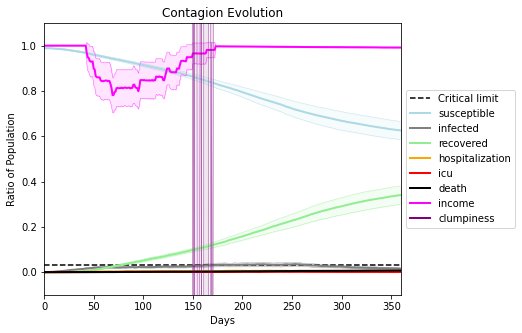

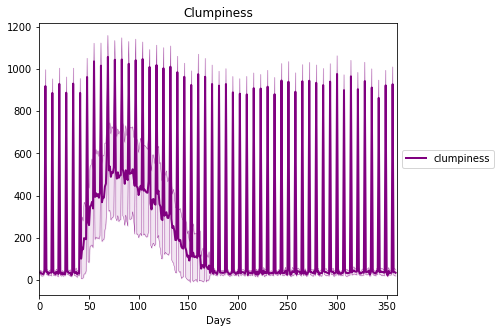

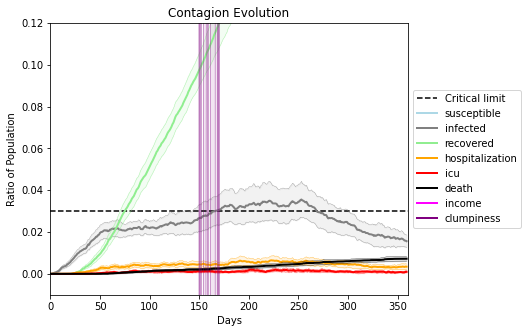

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5308, 7368, 1547, 4072, 8795, 4142, 9252, 9420, 8525, 1967, 8596, 7944, 8392, 9165, 8007, 4735, 4235, 6970, 566, 8846]
Average similarity between family members is 0.19389157379152264 at temperature -0.3
Average similarity between family and home is 0.9998523159164903 at temperature -1
Average similarity between students and their classroom is 0.20889165582851166 at temperature -0.3
Average classroom occupancy is 1.64 and number classrooms is 175
Average similarity between workers is 0.15382428158187525 at temperature -0.3
Average office occupancy is 3.2195121951219514 and number offices is 205
Average friend similarity for adults: 0.24794315396520197 for kids: 0.2206283650194202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.056695374729085965
avg restaurant similarity 0.047304958675309865
avg restaurant similarity 0.07659239023047659
avg restaurant similarity 0.06319981930505805
avg restaurant similarity 0.07853237535542318
avg restaurant similarity 0.061356064812664056
avg restaurant similarity 0.04367316769027096
avg restaurant similarity 0.045094748014680504
avg restaurant similarity 0.06472660708999159
avg restaurant similarity -0.0010665020681584053
avg restaurant similarity 0.0609843900857112
avg restaurant similarity 0.04541147923134445
avg restaurant similarity 0.06267879247887954
avg restaurant similarity 0.07464836661400939
avg restaurant similarity 0.05781610551804869
avg restaurant similarity 0.03329210944736922
avg restaurant similarity 0.02563644158858655
avg restaurant similarity 0.05325980764275554
avg restaurant similarity 0.05962104911737344
avg restaurant similarity 0.07077354647335289
avg restaurant similarity 0.06820922191371731
avg restaurant similarity 0.

avg restaurant similarity 0.030586677174293232
avg restaurant similarity 0.02249561339379579
avg restaurant similarity 0.05418654367510429
avg restaurant similarity 0.05281090817690905
avg restaurant similarity 0.054900771696826056
avg restaurant similarity 0.050833302504680794
avg restaurant similarity 0.008676446283630889
avg restaurant similarity 0.03748960277001609
avg restaurant similarity 0.054833767397015974
avg restaurant similarity 0.022237093637364667
avg restaurant similarity 0.1193404235377513
avg restaurant similarity 0.10754233275408913
avg restaurant similarity 0.04733377358431074
avg restaurant similarity 0.00115545262557699
avg restaurant similarity 0.08147934761081084
avg restaurant similarity 0.02264060021179529
avg restaurant similarity 0.016999198047859182
avg restaurant similarity 0.07310604623927748
avg restaurant similarity -0.0037014668852308652
avg restaurant similarity 0.015733208803900323
avg restaurant similarity 0.05624056491592373
avg restaurant similarit

avg restaurant similarity 0.08070682032001038
avg restaurant similarity 0.055591690789324806
avg restaurant similarity 0.03825631281628381
avg restaurant similarity 0.08347251531569838
Average similarity between family members is 0.19020552455633477 at temperature -0.3
Average similarity between family and home is 0.9998539696738462 at temperature -1
Average similarity between students and their classroom is 0.14725483341721218 at temperature -0.3
Average classroom occupancy is 1.5771428571428572 and number classrooms is 175
Average similarity between workers is 0.17584408318054823 at temperature -0.3
Average office occupancy is 3.242574257425743 and number offices is 202
Average friend similarity for adults: 0.24060411666822468 for kids: 0.20777712580021854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.0900820306842966
avg restaurant similarity 0.03286241870699591
avg restaurant similarity 0.06431890016238542
avg restaurant similarity 0.07031836035700254
avg restaurant similarity 0.052533136749896216
avg restaurant similarity 0.03177634250311429
avg restaurant similarity 0.07082362918894529
avg restaurant similarity 0.07289724746989867
avg restaurant similarity 0.16506626441526626
avg restaurant similarity 0.06880850967791763
avg restaurant similarity 0.07877523078332191
avg restaurant similarity 0.08180165547414421
avg restaurant similarity 0.10378759724741082
avg restaurant similarity 0.02758018991649337
avg restaurant similarity 0.008171410467036646
avg restaurant similarity 0.05316889126791183
avg restaurant similarity 0.00956693996916114
avg restaurant similarity 0.03826894317355241
avg restaurant similarity 0.039045779670727976
avg restaurant similarity 0.07370138276292786
avg restaurant similarity 0.07670909679197985
avg restaurant similarity 0.0995

avg restaurant similarity 0.07655715057441718
avg restaurant similarity 0.06468618419774166
avg restaurant similarity -0.03776026075735166
avg restaurant similarity 0.04392536365230668
avg restaurant similarity 0.06126498932011583
avg restaurant similarity -0.011014255733101285
avg restaurant similarity 0.07640521598131408
avg restaurant similarity 0.03624874852378085
avg restaurant similarity 0.020600918346638433
avg restaurant similarity 0.10508451538594597
avg restaurant similarity 0.04497099452680027
avg restaurant similarity 0.058323178816393005
avg restaurant similarity 0.0384146646253876
avg restaurant similarity 0.07717579801756445
avg restaurant similarity 0.10679241603431745
avg restaurant similarity 0.11526889489664702
avg restaurant similarity 0.08162747117423823
avg restaurant similarity 0.073159991056794
avg restaurant similarity 0.0545052375153633
avg restaurant similarity 0.07969598884973288
avg restaurant similarity 0.0011001165939284621
avg restaurant similarity 0.016

avg restaurant similarity 0.069846363079122
avg restaurant similarity 0.06928157519238919
avg restaurant similarity 0.09035386497099036
avg restaurant similarity 0.002288493376552801
Average similarity between family members is 0.1908050221052786 at temperature -0.3
Average similarity between family and home is 0.9998480691080974 at temperature -1
Average similarity between students and their classroom is 0.15207842873898647 at temperature -0.3
Average classroom occupancy is 1.5743589743589743 and number classrooms is 195
Average similarity between workers is 0.14122707502828638 at temperature -0.3
Average office occupancy is 3.1323529411764706 and number offices is 204
Average friend similarity for adults: 0.22920805709184605 for kids: 0.21130367531604588
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.04905895345825286
avg restaurant similarity -0.009216995988346601
avg restaurant similarity 0.06816447004557181
avg restaurant similarity 0.031592958714379796
avg restaurant similarity 0.035871322833489365
avg restaurant similarity 0.04128440340454895
avg restaurant similarity 0.04211744455034004
avg restaurant similarity 0.02431153080678485
avg restaurant similarity 0.04079696676670176
avg restaurant similarity 0.04196192859428765
avg restaurant similarity 0.025469060132548824
avg restaurant similarity -0.030800323175618413
avg restaurant similarity 0.052274019073439114
avg restaurant similarity 0.0784719031126329
avg restaurant similarity 0.05012783770820893
avg restaurant similarity 0.06521192290837062
avg restaurant similarity 0.028911727712847078
avg restaurant similarity 0.04181298806999272
avg restaurant similarity -0.002117738972704126
avg restaurant similarity -0.0055372930959216434
avg restaurant similarity 0.01830758396279225
avg restaurant simila

avg restaurant similarity 0.023767255735235016
avg restaurant similarity 0.0005524217691317235
avg restaurant similarity 0.03369016679428367
avg restaurant similarity 0.01572967715938601
avg restaurant similarity 0.018441489861763142
avg restaurant similarity 0.014336908230597642
avg restaurant similarity 0.007654197528548584
avg restaurant similarity 0.016127536843306305
avg restaurant similarity 0.006427672727811683
avg restaurant similarity 0.04798164252079106
avg restaurant similarity 0.07770785308269776
avg restaurant similarity 0.024012368833880412
avg restaurant similarity 0.017904998367263825
avg restaurant similarity 0.039733816062830114
avg restaurant similarity 0.05223453312788584
avg restaurant similarity 0.005513767304702234
avg restaurant similarity 0.014659502935033764
avg restaurant similarity 0.05278957127657187
avg restaurant similarity 0.012215046047574783
avg restaurant similarity 0.027448940358743446
avg restaurant similarity 0.0450658260835837
avg restaurant simil

avg restaurant similarity 0.021017479203981667
avg restaurant similarity 0.010811503231592726
avg restaurant similarity 0.06942898396384736
avg restaurant similarity 0.026046821129469325
avg restaurant similarity 0.051020620026619404
avg restaurant similarity 0.028845241019596155
Average similarity between family members is 0.22349484843066378 at temperature -0.3
Average similarity between family and home is 0.999856416193257 at temperature -1
Average similarity between students and their classroom is 0.13781049135553042 at temperature -0.3
Average classroom occupancy is 1.574585635359116 and number classrooms is 181
Average similarity between workers is 0.1348098951275093 at temperature -0.3
Average office occupancy is 3.2413793103448274 and number offices is 203
Average friend similarity for adults: 0.2421954497596611 for kids: 0.21075372265479425
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units w

avg restaurant similarity 0.07815873111839111
avg restaurant similarity 0.09362111646594681
avg restaurant similarity 0.05256916665248309
avg restaurant similarity 0.05231412324880739
avg restaurant similarity 0.06143118728051897
avg restaurant similarity 0.05787522506046362
avg restaurant similarity 0.09971179022047537
avg restaurant similarity 0.055891895828459916
avg restaurant similarity 0.13580956145861606
avg restaurant similarity 0.0373621510883106
avg restaurant similarity 0.07620113054026229
avg restaurant similarity 0.0830063047036624
avg restaurant similarity 0.020241832833513843
avg restaurant similarity 0.03232966695039619
avg restaurant similarity 0.008999711229953238
avg restaurant similarity 0.08962550866560252
avg restaurant similarity 0.04803428095592323
avg restaurant similarity 0.03269832086767682
avg restaurant similarity 0.07649930497661737
avg restaurant similarity 0.059076753231940636
avg restaurant similarity 0.03363893854836601
avg restaurant similarity 0.0402

avg restaurant similarity 0.04518346382422082
avg restaurant similarity 0.04119904966985944
avg restaurant similarity 0.06894037078511578
avg restaurant similarity 0.03605177580829543
avg restaurant similarity 0.0218467159611901
avg restaurant similarity 0.08712691306095813
avg restaurant similarity 0.10227362758372648
avg restaurant similarity 0.04747332179332399
avg restaurant similarity 0.10735595888083937
avg restaurant similarity 0.06825409482180234
avg restaurant similarity 0.04585403295877205
avg restaurant similarity 0.05710496749613417
avg restaurant similarity 0.07006384123028506
avg restaurant similarity 0.05740911759708979
avg restaurant similarity 0.0611799567618106
avg restaurant similarity 0.0013480394309701748
avg restaurant similarity 0.03694512634235137
avg restaurant similarity 0.09657770143187608
avg restaurant similarity 0.04993718117748106
avg restaurant similarity 0.0399165205904825
avg restaurant similarity 0.009831890871631813
avg restaurant similarity 0.101615

avg restaurant similarity 0.061813274006554
avg restaurant similarity 0.037531731022026296
avg restaurant similarity 0.05149157781211179
avg restaurant similarity 0.11032627505742633
Average similarity between family members is 0.19619438786027163 at temperature -0.3
Average similarity between family and home is 0.9998552659766359 at temperature -1
Average similarity between students and their classroom is 0.19481839306966955 at temperature -0.3
Average classroom occupancy is 1.6375 and number classrooms is 160
Average similarity between workers is 0.1555131559132415 at temperature -0.3
Average office occupancy is 3.4455445544554455 and number offices is 202
Average friend similarity for adults: 0.2542619925702867 for kids: 0.21862861533937883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.07271794994640401
avg restaurant similarity 0.10479037655066568
avg restaurant similarity 0.08596136268611936
avg restaurant similarity 0.07144917397047329
avg restaurant similarity 0.09538158370679012
avg restaurant similarity 0.06328052079168628
avg restaurant similarity 0.08329284176455651
avg restaurant similarity 0.05921087754094801
avg restaurant similarity 0.04417758121759317
avg restaurant similarity 0.07529542974127329
avg restaurant similarity 0.07342061498915743
avg restaurant similarity 0.04614941069728799
avg restaurant similarity 0.06150122309333124
avg restaurant similarity 0.06642207464431579
avg restaurant similarity 0.07553892294487602
avg restaurant similarity 0.0798788852066812
avg restaurant similarity 0.06826421390917019
avg restaurant similarity 0.05652156200765714
avg restaurant similarity 0.04654477277197896
avg restaurant similarity 0.09048551016300166
avg restaurant similarity 0.11391192204703467
avg restaurant similarity 0.0651980

avg restaurant similarity 0.09869223451514839
avg restaurant similarity 0.09215387852044202
avg restaurant similarity 0.029526650343290797
avg restaurant similarity 0.03457595205698068
avg restaurant similarity 0.04967760797242076
avg restaurant similarity 0.04522651859905051
avg restaurant similarity 0.047115659761134895
avg restaurant similarity 0.08932887152382643
avg restaurant similarity 0.09955998191483684
avg restaurant similarity 0.08034106216590761
avg restaurant similarity 0.0743833050981337
avg restaurant similarity 0.07184661378950609
avg restaurant similarity 0.06389468001517026
avg restaurant similarity 0.08444927412562978
avg restaurant similarity 0.06794819045342537
avg restaurant similarity 0.08047298107675782
avg restaurant similarity 0.06650524502804409
avg restaurant similarity 0.0637118568594307
avg restaurant similarity 0.0757710059293322
avg restaurant similarity 0.08306779296332426
avg restaurant similarity 0.07003886515247974
avg restaurant similarity 0.1045412

avg restaurant similarity 0.04134288509782114
avg restaurant similarity 0.0652694653214065
Average similarity between family members is 0.22290706466874488 at temperature -0.3
Average similarity between family and home is 0.9998547788953359 at temperature -1
Average similarity between students and their classroom is 0.21018710644038996 at temperature -0.3
Average classroom occupancy is 1.5923913043478262 and number classrooms is 184
Average similarity between workers is 0.18360971609414842 at temperature -0.3
Average office occupancy is 3.2598039215686274 and number offices is 204
Average friend similarity for adults: 0.24989894248349376 for kids: 0.22960156139339435
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 alloca

avg restaurant similarity 0.05828076361831375
avg restaurant similarity 0.04115415860029976
avg restaurant similarity 0.07197578986914499
avg restaurant similarity 0.030517826299345796
avg restaurant similarity 0.0805899763186579
avg restaurant similarity 0.08605271553453654
avg restaurant similarity 0.06792182869072841
avg restaurant similarity 0.032853711609145936
avg restaurant similarity 0.035682295438308496
avg restaurant similarity 0.05068438449566495
avg restaurant similarity 0.05581575639264138
avg restaurant similarity 0.04447766967155256
avg restaurant similarity 0.08140904477407017
avg restaurant similarity 0.04764543763510226
avg restaurant similarity 0.06827100831859793
avg restaurant similarity 0.09430270465775599
avg restaurant similarity 0.06829751773165336
avg restaurant similarity 0.07102119505415042
avg restaurant similarity 0.05784467821592261
avg restaurant similarity 0.0441253908097164
avg restaurant similarity 0.05464290372771062
avg restaurant similarity 0.04620

avg restaurant similarity 0.07811461303493257
avg restaurant similarity 0.0649262335452793
avg restaurant similarity 0.07807632855806002
avg restaurant similarity 0.08098790878692191
avg restaurant similarity 0.06550508217631101
avg restaurant similarity 0.04403547617419156
avg restaurant similarity 0.022356274331792634
avg restaurant similarity 0.06585651389172618
avg restaurant similarity 0.1062625003809329
avg restaurant similarity 0.07673081010363386
avg restaurant similarity 0.05120910198294385
avg restaurant similarity 0.07812705781620459
avg restaurant similarity 0.06308684967324917
avg restaurant similarity 0.06525805378998237
avg restaurant similarity 0.09914501035664952
avg restaurant similarity 0.03959134245630837
avg restaurant similarity 0.007283040387828018
avg restaurant similarity 0.08817242261734357
avg restaurant similarity 0.05638241859723165
avg restaurant similarity 0.046323184529628275
avg restaurant similarity 0.08642408288810245
avg restaurant similarity 0.04440

avg restaurant similarity 0.053671914848725556
avg restaurant similarity 0.049509503393650504
avg restaurant similarity 0.054958857754457476
avg restaurant similarity 0.05533035754696448
Average similarity between family members is 0.1847791241088015 at temperature -0.3
Average similarity between family and home is 0.9998349508348676 at temperature -1
Average similarity between students and their classroom is 0.23233678292386414 at temperature -0.3
Average classroom occupancy is 1.558139534883721 and number classrooms is 172
Average similarity between workers is 0.16401567503883746 at temperature -0.3
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.24720552638635623 for kids: 0.21681208619908454
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distr

avg restaurant similarity 0.04750662653878163
avg restaurant similarity 0.06408984522669305
avg restaurant similarity 0.08506110156240027
avg restaurant similarity 0.08559716317434235
avg restaurant similarity 0.045507888478765905
avg restaurant similarity 0.07860416151309464
avg restaurant similarity 0.09029469088276021
avg restaurant similarity 0.03213847626366269
avg restaurant similarity 0.044914021066193854
avg restaurant similarity 0.058087986947093856
avg restaurant similarity 0.03540382087878783
avg restaurant similarity 0.01737601803041651
avg restaurant similarity 0.09848928373543528
avg restaurant similarity 0.058351492293616525
avg restaurant similarity 0.04294655773692102
avg restaurant similarity 0.06549317469493687
avg restaurant similarity 0.10388741236988605
avg restaurant similarity 0.026758447039592678
avg restaurant similarity 0.04429670932699614
avg restaurant similarity 0.06275929382786603
avg restaurant similarity 0.005974533629643685
avg restaurant similarity 0.

avg restaurant similarity 0.09325801335676612
avg restaurant similarity 0.09137689912471658
avg restaurant similarity 0.055723095927978125
avg restaurant similarity 0.06763781425906489
avg restaurant similarity 0.06559324405743847
avg restaurant similarity 0.06859343508513409
avg restaurant similarity 0.05473822169678826
avg restaurant similarity 0.02797210215629538
avg restaurant similarity 0.002641115633955915
avg restaurant similarity 0.08254320514594898
avg restaurant similarity 0.07811665818747028
avg restaurant similarity 0.06943970578576897
avg restaurant similarity 0.07344638555637145
avg restaurant similarity 0.07946982403940961
avg restaurant similarity 0.05133830741649136
avg restaurant similarity 0.07716821716704458
avg restaurant similarity 0.074091703424968
avg restaurant similarity 0.09344336806855759
avg restaurant similarity 0.07243270987933166
avg restaurant similarity 0.07509902609106192
avg restaurant similarity 0.06601925701017315
avg restaurant similarity 0.006070

avg restaurant similarity 0.03752850541278985
avg restaurant similarity 0.021778991373727696
avg restaurant similarity 0.03826728078263154
avg restaurant similarity 0.05875391751993297
Average similarity between family members is 0.19449134033636528 at temperature -0.3
Average similarity between family and home is 0.9998560773814871 at temperature -1
Average similarity between students and their classroom is 0.18992889757266568 at temperature -0.3
Average classroom occupancy is 1.6127167630057804 and number classrooms is 173
Average similarity between workers is 0.1700592768201043 at temperature -0.3
Average office occupancy is 3.2794117647058822 and number offices is 204
Average friend similarity for adults: 0.2474005956922252 for kids: 0.21199458831045878
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.05658380991247566
avg restaurant similarity 0.10699687545677687
avg restaurant similarity 0.08583548309246507
avg restaurant similarity 0.02767593680272097
avg restaurant similarity 0.07353438104533376
avg restaurant similarity 0.00018945205226976724
avg restaurant similarity 0.04691656443175307
avg restaurant similarity 0.07232832459179359
avg restaurant similarity 0.031512971262193754
avg restaurant similarity 0.10636746644874885
avg restaurant similarity 0.07280584136164144
avg restaurant similarity 0.009578111883218873
avg restaurant similarity 0.07148227400008002
avg restaurant similarity 0.01731502369867544
avg restaurant similarity 0.07507410571189635
avg restaurant similarity 0.09799074119051991
avg restaurant similarity 0.05358182100277227
avg restaurant similarity 0.05367703397975781
avg restaurant similarity 0.07786332685179054
avg restaurant similarity 0.10360061993417367
avg restaurant similarity 0.026266230684697616
avg restaurant similarity 0.

avg restaurant similarity 0.0774077735679908
avg restaurant similarity 0.055222120046477356
avg restaurant similarity 0.020808540647433538
avg restaurant similarity 0.040359652237565456
avg restaurant similarity 0.04886058440252383
avg restaurant similarity 0.05207901795368937
avg restaurant similarity 0.04514498170705558
avg restaurant similarity 0.01582956761919797
avg restaurant similarity 0.11380570020839181
avg restaurant similarity 0.03678854881450293
avg restaurant similarity 0.06448174600793642
avg restaurant similarity 0.010497240853318223
avg restaurant similarity 0.04398488687766258
avg restaurant similarity 0.016692032462244096
avg restaurant similarity 0.002147527639968043
avg restaurant similarity 0.04478248856225948
avg restaurant similarity 0.08098417556018916
avg restaurant similarity 0.09295993284187193
avg restaurant similarity 0.03708335875737011
avg restaurant similarity 0.06505406015038322
avg restaurant similarity 0.010742649311344324
avg restaurant similarity 0.

avg restaurant similarity 0.06722371935900505
avg restaurant similarity 0.05270229992271789
avg restaurant similarity 0.06982391806528367
avg restaurant similarity 0.0747844114058967
Average similarity between family members is 0.17374380322597213 at temperature -0.3
Average similarity between family and home is 0.9998646875360893 at temperature -1
Average similarity between students and their classroom is 0.1540102062427148 at temperature -0.3
Average classroom occupancy is 1.5105263157894737 and number classrooms is 190
Average similarity between workers is 0.13207020787461854 at temperature -0.3
Average office occupancy is 3.1527093596059115 and number offices is 203
Average friend similarity for adults: 0.23215005076102366 for kids: 0.21892685131781275
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.06420808150717497
avg restaurant similarity 0.09996638647345232
avg restaurant similarity 0.09212378357112659
avg restaurant similarity 0.039059455899725905
avg restaurant similarity 0.0418880064084163
avg restaurant similarity 0.059083386628071714
avg restaurant similarity 0.04149825104277749
avg restaurant similarity 0.12548070035268857
avg restaurant similarity 0.06776503477499086
avg restaurant similarity 0.07173583386969028
avg restaurant similarity 0.08311055960401229
avg restaurant similarity 0.08398514131707906
avg restaurant similarity 0.07871470922782627
avg restaurant similarity 0.03730274548505066
avg restaurant similarity 0.10886285416047432
avg restaurant similarity 0.058606050034753346
avg restaurant similarity 0.07482769447081425
avg restaurant similarity 0.06642054069407478
avg restaurant similarity 0.038072948409894065
avg restaurant similarity 0.024906390476561138
avg restaurant similarity 0.04864001392033754
avg restaurant similarity 0.09

avg restaurant similarity 0.06316067888928581
avg restaurant similarity 0.08882195700261813
avg restaurant similarity 0.11113372305012321
avg restaurant similarity 0.10573786768994109
avg restaurant similarity 0.0610999003015357
avg restaurant similarity 0.07033253733745269
avg restaurant similarity 0.08029167884518794
avg restaurant similarity 0.06769594142495651
avg restaurant similarity 0.08037166230825846
avg restaurant similarity 0.03473677769547424
avg restaurant similarity 0.036457206218677665
avg restaurant similarity 0.11336000205751946
avg restaurant similarity 0.07248332134269554
avg restaurant similarity 0.09031049578350454
avg restaurant similarity 0.06959582954744122
avg restaurant similarity 0.0808042323047194
avg restaurant similarity 0.055350126917083894
avg restaurant similarity 0.08196653166611675
avg restaurant similarity 0.08589925282518941
avg restaurant similarity 0.08223907100306117
avg restaurant similarity 0.10039961558953307
avg restaurant similarity 0.089376

avg restaurant similarity 0.1037717179064344
avg restaurant similarity 0.05479829015208172
avg restaurant similarity 0.08625460251256387
avg restaurant similarity 0.09404879565219432
Average similarity between family members is 0.19269401738853653 at temperature -0.3
Average similarity between family and home is 0.9998600000928516 at temperature -1
Average similarity between students and their classroom is 0.14856212404770847 at temperature -0.3
Average classroom occupancy is 1.5966850828729282 and number classrooms is 181
Average similarity between workers is 0.15173945619528995 at temperature -0.3
Average office occupancy is 3.232673267326733 and number offices is 202
Average friend similarity for adults: 0.23999510387887127 for kids: 0.2149219931679056
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.0812675205836797
avg restaurant similarity 0.1179926313853966
avg restaurant similarity 0.07546057920340965
avg restaurant similarity 0.0989391977666139
avg restaurant similarity 0.06622242818270388
avg restaurant similarity 0.10623781991674015
avg restaurant similarity 0.04157398440086852
avg restaurant similarity 0.06874531038857702
avg restaurant similarity 0.10085629552363687
avg restaurant similarity 0.06138078909234188
avg restaurant similarity 0.08099527822375986
avg restaurant similarity 0.04560461080579951
avg restaurant similarity 0.055975737892440466
avg restaurant similarity 0.040026276058286424
avg restaurant similarity 0.09134882458021612
avg restaurant similarity 0.09094378702814726
avg restaurant similarity 0.1002471702468531
avg restaurant similarity 0.06504633469786657
avg restaurant similarity 0.10568814238225113
avg restaurant similarity 0.11293561321545388
avg restaurant similarity 0.09595814256529554
avg restaurant similarity 0.07571802

avg restaurant similarity 0.0729978490542983
avg restaurant similarity 0.030070781116409307
avg restaurant similarity 0.07983335275932218
avg restaurant similarity 0.05085713892565901
avg restaurant similarity 0.08130234139192882
avg restaurant similarity 0.06837581085056875
avg restaurant similarity 0.10862031255215891
avg restaurant similarity 0.10035515172899827
avg restaurant similarity 0.06877915877345481
avg restaurant similarity 0.1247538003111753
avg restaurant similarity 0.029986013214755216
avg restaurant similarity 0.09558957742811233
avg restaurant similarity 0.023919696978054794
avg restaurant similarity 0.04080913518454999
avg restaurant similarity 0.09428350876875989
avg restaurant similarity 0.10341906160452613
avg restaurant similarity 0.06703716261875141
avg restaurant similarity 0.058866937811749426
avg restaurant similarity 0.07360712226928377
avg restaurant similarity 0.0800396554430812
avg restaurant similarity 0.0874992391424999
avg restaurant similarity 0.093528

avg restaurant similarity 0.08097854008043151
avg restaurant similarity 0.1240811341631599
Average similarity between family members is 0.18015220189809986 at temperature -0.3
Average similarity between family and home is 0.9998623111559872 at temperature -1
Average similarity between students and their classroom is 0.15679630227403946 at temperature -0.3
Average classroom occupancy is 1.5698924731182795 and number classrooms is 186
Average similarity between workers is 0.1494587527607478 at temperature -0.3
Average office occupancy is 3.4213197969543145 and number offices is 197
Average friend similarity for adults: 0.24897742575643347 for kids: 0.21198323488609003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.09786050422756853
avg restaurant similarity 0.12434016454868188
avg restaurant similarity 0.049663409306611415
avg restaurant similarity 0.04966775500169665
avg restaurant similarity 0.09302822854725508
avg restaurant similarity 0.10731126537191846
avg restaurant similarity 0.07360977987937953
avg restaurant similarity 0.03134808378549104
avg restaurant similarity 0.07007398586378148
avg restaurant similarity 0.08403915947958855
avg restaurant similarity 0.024413971268157305
avg restaurant similarity 0.08898100613813523
avg restaurant similarity 0.04168393838308734
avg restaurant similarity 0.06754852987602046
avg restaurant similarity 0.06946125379425823
avg restaurant similarity 0.04543684557010664
avg restaurant similarity 0.017880711547442616
avg restaurant similarity 0.06218444393783522
avg restaurant similarity 0.07458563091995818
avg restaurant similarity 0.10320995770603532
avg restaurant similarity 0.01705480962329126
avg restaurant similarity 0.059

avg restaurant similarity 0.07487405901824788
avg restaurant similarity 0.08298757370219047
avg restaurant similarity 0.04037444650790956
avg restaurant similarity 0.06739308762683673
avg restaurant similarity 0.10149103173734385
avg restaurant similarity 0.03442029402800742
avg restaurant similarity 0.07397565216859024
avg restaurant similarity 0.061854009183176274
avg restaurant similarity 0.10741987194540714
avg restaurant similarity 0.01668183460512845
avg restaurant similarity 0.1259688762771498
avg restaurant similarity 0.06844409704494875
avg restaurant similarity 0.0642772989790379
avg restaurant similarity 0.03667660461915628
avg restaurant similarity 0.07655657510253917
avg restaurant similarity 0.047381579774150445
avg restaurant similarity 0.0585526162016776
avg restaurant similarity 0.07553247038330016
avg restaurant similarity 0.07634420391750056
avg restaurant similarity 0.07588593495226241
avg restaurant similarity 0.039389064684269955
avg restaurant similarity 0.055078

avg restaurant similarity 0.06678998175683613
avg restaurant similarity 0.04606774129338548
avg restaurant similarity 0.06713974341603426
avg restaurant similarity 0.057545974606414356
Average similarity between family members is 0.2001029387241008 at temperature -0.3
Average similarity between family and home is 0.9998527071836636 at temperature -1
Average similarity between students and their classroom is 0.17102844707562567 at temperature -0.3
Average classroom occupancy is 1.5909090909090908 and number classrooms is 176
Average similarity between workers is 0.16099072018735258 at temperature -0.3
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.2502014830931628 for kids: 0.22297071179701525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.16231143062781173
avg restaurant similarity 0.05004364280032559
avg restaurant similarity 0.041574595920599824
avg restaurant similarity 0.07343294475309471
avg restaurant similarity 0.04084251336504379
avg restaurant similarity 0.09231225954091973
avg restaurant similarity 0.07890909268696698
avg restaurant similarity 0.08343064927543359
avg restaurant similarity 0.05973385084133297
avg restaurant similarity 0.11097897843478675
avg restaurant similarity 0.037891632889801026
avg restaurant similarity 0.08966350594054112
avg restaurant similarity 0.0317713403893061
avg restaurant similarity 0.08614980196115476
avg restaurant similarity 0.039130898574919505
avg restaurant similarity 0.07545326807708412
avg restaurant similarity 0.09312843687335101
avg restaurant similarity 0.07645038337273719
avg restaurant similarity 0.02742779540628434
avg restaurant similarity -0.0011475135258049195
avg restaurant similarity 0.07717636720484106
avg restaurant similarity 0.0

avg restaurant similarity 0.026938018953858566
avg restaurant similarity 0.09111910756396106
avg restaurant similarity 0.08231811933632883
avg restaurant similarity 0.09289139380134784
avg restaurant similarity 0.0809208616968952
avg restaurant similarity 0.1210110164814554
avg restaurant similarity 0.08204881955503775
avg restaurant similarity 0.09059932122819385
avg restaurant similarity 0.06543373795970162
avg restaurant similarity 0.10105985942174515
avg restaurant similarity 0.09420272656920518
avg restaurant similarity 0.031204187251276626
avg restaurant similarity 0.07567733814994973
avg restaurant similarity 0.0666332718494134
avg restaurant similarity 0.07808494737020673
avg restaurant similarity 0.05047272409361409
avg restaurant similarity 0.10425627618089468
avg restaurant similarity 0.08764758115790476
avg restaurant similarity 0.07754593094565554
avg restaurant similarity 0.10437621196639688
avg restaurant similarity 0.06174016019607923
avg restaurant similarity 0.0690328

avg restaurant similarity 0.0882405366531082
avg restaurant similarity 0.04032077044499938
avg restaurant similarity 0.035548452013888426
Average similarity between family members is 0.1957391570975721 at temperature -0.3
Average similarity between family and home is 0.9998518084606415 at temperature -1
Average similarity between students and their classroom is 0.17689451903703562 at temperature -0.3
Average classroom occupancy is 1.5930232558139534 and number classrooms is 172
Average similarity between workers is 0.15051115701178056 at temperature -0.3
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.24485852956376428 for kids: 0.20856363169476078
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.0899515746439022
avg restaurant similarity 0.038653383388246254
avg restaurant similarity 0.11811010965227628
avg restaurant similarity 0.05923986327875441
avg restaurant similarity -0.008726262157197079
avg restaurant similarity 0.006395077922940351
avg restaurant similarity 0.071755948052097
avg restaurant similarity 0.056152266053919445
avg restaurant similarity 0.06301052405638409
avg restaurant similarity -0.0264010424642161
avg restaurant similarity 0.08680758690586815
avg restaurant similarity -0.0073716583506280116
avg restaurant similarity 0.06541127325798611
avg restaurant similarity 0.07621994399714314
avg restaurant similarity 0.03541158252799738
avg restaurant similarity 0.028612508531316506
avg restaurant similarity 0.053580028101101664
avg restaurant similarity 0.07903387461837051
avg restaurant similarity -0.02130322928617756
avg restaurant similarity 0.04354419339110039
avg restaurant similarity 0.08662895955397346
avg restaurant similarity 

avg restaurant similarity 0.07565255569431868
avg restaurant similarity 0.08097145129769705
avg restaurant similarity 0.08511953775393058
avg restaurant similarity 0.03272418300360025
avg restaurant similarity 0.07982059278175267
avg restaurant similarity 0.08377561159084053
avg restaurant similarity 0.061859521626392064
avg restaurant similarity 0.11887807340585789
avg restaurant similarity 0.048975514174771015
avg restaurant similarity 0.03236483475078728
avg restaurant similarity 0.01819680333667146
avg restaurant similarity 0.11093115637555577
avg restaurant similarity 0.09546745910891648
avg restaurant similarity 0.02001450707409394
avg restaurant similarity 0.04087314970672048
avg restaurant similarity 0.10724751552305523
avg restaurant similarity 0.08206629953125714
avg restaurant similarity 0.09472468402782347
avg restaurant similarity 0.04952409900149794
avg restaurant similarity 0.07582498953522887
avg restaurant similarity 0.09280581984118814
avg restaurant similarity 0.0736

avg restaurant similarity 0.050827969791258004
avg restaurant similarity 0.06762637894101409
avg restaurant similarity 0.006893242445989042
avg restaurant similarity 0.032729890174147416
Average similarity between family members is 0.17605874438675279 at temperature -0.3
Average similarity between family and home is 0.9998573663534186 at temperature -1
Average similarity between students and their classroom is 0.19119998674970867 at temperature -0.3
Average classroom occupancy is 1.619047619047619 and number classrooms is 189
Average similarity between workers is 0.15978505120138925 at temperature -0.3
Average office occupancy is 3.2653061224489797 and number offices is 196
Average friend similarity for adults: 0.23122171970087835 for kids: 0.20493689420577502
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.06309462181244935
avg restaurant similarity 0.07995898451393381
avg restaurant similarity 0.06155689554367819
avg restaurant similarity 0.05355926389933698
avg restaurant similarity 0.06009728218344373
avg restaurant similarity 0.055371905271718765
avg restaurant similarity 0.05537592591986128
avg restaurant similarity 0.061668671064346404
avg restaurant similarity 0.05450476824299829
avg restaurant similarity 0.06902878106861021
avg restaurant similarity 0.03023635573674172
avg restaurant similarity 0.053646165570466565
avg restaurant similarity 0.08311308689401598
avg restaurant similarity 0.05663604658391103
avg restaurant similarity 0.049626821173796465
avg restaurant similarity 0.08660368107324361
avg restaurant similarity 0.09685469047360382
avg restaurant similarity 0.062151394895947086
avg restaurant similarity 0.03811976676434455
avg restaurant similarity 0.05387666328179521
avg restaurant similarity 0.0518482456621886
avg restaurant similarity 0.00

avg restaurant similarity 0.03737743703631955
avg restaurant similarity 0.054754843057436824
avg restaurant similarity 0.047452938677543195
avg restaurant similarity 0.08507948779335706
avg restaurant similarity 0.030185113344302145
avg restaurant similarity 0.021700685479496842
avg restaurant similarity 0.029244053291694053
avg restaurant similarity 0.04079648098579101
avg restaurant similarity 0.05155681820042813
avg restaurant similarity 0.09958995323990529
avg restaurant similarity 0.019473592092633177
avg restaurant similarity 0.08445974180178131
avg restaurant similarity 0.0491846989125591
avg restaurant similarity 0.0909703130018964
avg restaurant similarity 0.09521066393740323
avg restaurant similarity 0.03059919568533243
avg restaurant similarity 0.05957982313080051
avg restaurant similarity 0.055667319275848025
avg restaurant similarity 0.06201942012723627
avg restaurant similarity 0.09135642853512567
avg restaurant similarity 0.05519596232226322
avg restaurant similarity 0.0

avg restaurant similarity 0.0971056712472235
avg restaurant similarity 0.07752385703165238
avg restaurant similarity 0.06568036796710339
avg restaurant similarity 0.08132600159599451
Average similarity between family members is 0.2068414948513378 at temperature -0.3
Average similarity between family and home is 0.9998551361619967 at temperature -1
Average similarity between students and their classroom is 0.19280354709198805 at temperature -0.3
Average classroom occupancy is 1.672514619883041 and number classrooms is 171
Average similarity between workers is 0.15647304816582744 at temperature -0.3
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.25102504355040894 for kids: 0.21123354684995524
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.03908786244568422
avg restaurant similarity 0.06818066945947457
avg restaurant similarity 0.05716158112169848
avg restaurant similarity 0.0785735111106577
avg restaurant similarity 0.03970241579888693
avg restaurant similarity 0.05979276958074709
avg restaurant similarity 0.08760147483100213
avg restaurant similarity 0.04381052954656794
avg restaurant similarity 0.0821218755758998
avg restaurant similarity 0.0703116435060452
avg restaurant similarity 0.09338776162448226
avg restaurant similarity 0.07731935323623218
avg restaurant similarity 0.08515771810311612
avg restaurant similarity 0.06584603994812005
avg restaurant similarity 0.09723936080389534
avg restaurant similarity 0.02880098573866164
avg restaurant similarity 0.07186751079080123
avg restaurant similarity 0.11808008400864868
avg restaurant similarity 0.06600131583786557
avg restaurant similarity 0.05230428619230185
avg restaurant similarity 0.046526094054240734
avg restaurant similarity 0.08838529

avg restaurant similarity 0.03328791499838372
avg restaurant similarity 0.03461029850803338
avg restaurant similarity 0.05219925484431581
avg restaurant similarity 0.06768574451618532
avg restaurant similarity 0.07650143426199914
avg restaurant similarity 0.07028754714732446
avg restaurant similarity 0.06055767056392699
avg restaurant similarity 0.05247400101272322
avg restaurant similarity 0.0318147441236093
avg restaurant similarity 0.0763588329820054
avg restaurant similarity 0.04354809879078614
avg restaurant similarity 0.07808472357104618
avg restaurant similarity 0.03619118112134509
avg restaurant similarity 0.08168454510474119
avg restaurant similarity 0.07218983423920124
avg restaurant similarity 0.07162355939078598
avg restaurant similarity 0.06483880822715334
avg restaurant similarity 0.09878387420046665
avg restaurant similarity 0.04720482241120504
avg restaurant similarity 0.08872728897161772
avg restaurant similarity 0.08180968303646091
avg restaurant similarity 0.01836719

avg restaurant similarity 0.05725251956911927
avg restaurant similarity 0.08000548872755535
avg restaurant similarity 0.10472479821638153
avg restaurant similarity 0.0758548299293268
Average similarity between family members is 0.20293485283379684 at temperature -0.3
Average similarity between family and home is 0.9998529007269057 at temperature -1
Average similarity between students and their classroom is 0.1354847939635386 at temperature -0.3
Average classroom occupancy is 1.675977653631285 and number classrooms is 179
Average similarity between workers is 0.15565815299572167 at temperature -0.3
Average office occupancy is 3.1386138613861387 and number offices is 202
Average friend similarity for adults: 0.23086221065472112 for kids: 0.20645550339014326
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.09688275954051218
avg restaurant similarity 0.13873030622072866
avg restaurant similarity 0.12552571493820538
avg restaurant similarity 0.08075499617386658
avg restaurant similarity 0.10626060039763136
avg restaurant similarity 0.11320088777076193
avg restaurant similarity 0.12001691635982618
avg restaurant similarity 0.008814796212847512
avg restaurant similarity 0.11334002952189033
avg restaurant similarity 0.06619348236380529
avg restaurant similarity 0.10493223401097233
avg restaurant similarity 0.08801235563989679
avg restaurant similarity 0.06566969538355315
avg restaurant similarity 0.07057191946921712
avg restaurant similarity 0.08027463154283916
avg restaurant similarity 0.08213518520714597
avg restaurant similarity 0.08696550041056018
avg restaurant similarity 0.013875950677661657
avg restaurant similarity 0.14220416574493427
avg restaurant similarity 0.11207545327661954
avg restaurant similarity 0.05204703288421799
avg restaurant similarity 0.0734

avg restaurant similarity 0.08682549038966392
avg restaurant similarity 0.06119442083113071
avg restaurant similarity 0.11575568897796572
avg restaurant similarity 0.09985141305041237
avg restaurant similarity 0.07130437273617286
avg restaurant similarity 0.128205188007537
avg restaurant similarity 0.05706927979500226
avg restaurant similarity 0.06428041034140478
avg restaurant similarity 0.08429622966964719
avg restaurant similarity 0.10774925891322285
avg restaurant similarity 0.11964251838655127
avg restaurant similarity 0.09917542446636408
avg restaurant similarity 0.13637888825064493
avg restaurant similarity 0.10363194816134215
avg restaurant similarity 0.07600864369626753
avg restaurant similarity 0.07772909081390006
avg restaurant similarity 0.07660853774669804
avg restaurant similarity 0.09820453722550403
avg restaurant similarity 0.09184164632245362
avg restaurant similarity 0.06497224026764145
avg restaurant similarity 0.0582410061427947
avg restaurant similarity 0.055069441

avg restaurant similarity 0.07845668423492992
avg restaurant similarity 0.07200124032538742
Average similarity between family members is 0.1952220336373892 at temperature -0.3
Average similarity between family and home is 0.9998524816370612 at temperature -1
Average similarity between students and their classroom is 0.16877822307190707 at temperature -0.3
Average classroom occupancy is 1.4913294797687862 and number classrooms is 173
Average similarity between workers is 0.16953417913313654 at temperature -0.3
Average office occupancy is 3.422110552763819 and number offices is 199
Average friend similarity for adults: 0.2526129323960014 for kids: 0.22132045703197903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated 

avg restaurant similarity 0.04593737430297036
avg restaurant similarity 0.05820874893559647
avg restaurant similarity 0.05988016034617465
avg restaurant similarity 0.11942299683733339
avg restaurant similarity 0.06075760437785522
avg restaurant similarity 0.09380377402668896
avg restaurant similarity 0.11361488922083816
avg restaurant similarity 0.08925276462603234
avg restaurant similarity 0.10174435300272441
avg restaurant similarity 0.09522704462011987
avg restaurant similarity 0.11621667459321884
avg restaurant similarity 0.09481972720199262
avg restaurant similarity 0.05349319661054061
avg restaurant similarity 0.06207432529244725
avg restaurant similarity 0.07696665459933642
avg restaurant similarity 0.024291442727296046
avg restaurant similarity 0.04439730021748193
avg restaurant similarity 0.06569993420069163
avg restaurant similarity 0.1083085334348528
avg restaurant similarity 0.10102317504212811
avg restaurant similarity 0.08634869197566115
avg restaurant similarity 0.046697

avg restaurant similarity 0.0944311872594342
avg restaurant similarity 0.09093200576851729
avg restaurant similarity 0.03613133261413333
avg restaurant similarity 0.04986808396580173
avg restaurant similarity 0.04504431066998324
avg restaurant similarity 0.009826518850986102
avg restaurant similarity 0.06258042026209878
avg restaurant similarity 0.036835957196500124
avg restaurant similarity 0.0985336231656767
avg restaurant similarity 0.03677576315949727
avg restaurant similarity 0.029271392526240107
avg restaurant similarity 0.07019971015553288
avg restaurant similarity 0.07963976317441826
avg restaurant similarity 0.04289394023398056
avg restaurant similarity 0.084066457316089
avg restaurant similarity 0.09842652995581226
avg restaurant similarity 0.07033746434599018
avg restaurant similarity 0.028249152220274725
avg restaurant similarity 0.10398608545753693
avg restaurant similarity 0.1267299472310517
avg restaurant similarity 0.09478209753450899
avg restaurant similarity 0.0880550

avg restaurant similarity 0.10177571652095509
avg restaurant similarity 0.059838957283492894
avg restaurant similarity 0.06704955036415755
Average similarity between family members is 0.2077506979447385 at temperature -0.3
Average similarity between family and home is 0.9998619202948131 at temperature -1
Average similarity between students and their classroom is 0.14702868556904855 at temperature -0.3
Average classroom occupancy is 1.5425531914893618 and number classrooms is 188
Average similarity between workers is 0.16047851600453086 at temperature -0.3
Average office occupancy is 3.282828282828283 and number offices is 198
Average friend similarity for adults: 0.2501395004703009 for kids: 0.2120392828836951
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.039562343025814316
avg restaurant similarity 0.051982486340211
avg restaurant similarity 0.03751425789454028
avg restaurant similarity -0.005941289729135684
avg restaurant similarity 0.06955819678643102
avg restaurant similarity 0.023718639692684725
avg restaurant similarity 0.07660278039175204
avg restaurant similarity 0.07741491462791375
avg restaurant similarity 0.027023168559370724
avg restaurant similarity 0.054361076336047066
avg restaurant similarity 0.034457598510550386
avg restaurant similarity 0.04335798549420111
avg restaurant similarity 0.05973670206214218
avg restaurant similarity 0.06217103691712828
avg restaurant similarity 0.10977234875625969
avg restaurant similarity 0.05573108102698175
avg restaurant similarity 0.06223787966181796
avg restaurant similarity 0.1024620486210872
avg restaurant similarity 0.08656592367159711
avg restaurant similarity 0.019074361715468887
avg restaurant similarity 0.02046487245741769
avg restaurant similarity 0.0

avg restaurant similarity 0.06640248559066558
avg restaurant similarity 0.024498206444605784
avg restaurant similarity 0.07101149592146648
avg restaurant similarity 0.06372172044930609
avg restaurant similarity 0.022372309174464956
avg restaurant similarity -0.013561849225769577
avg restaurant similarity 0.06255996880412286
avg restaurant similarity 0.08657041956255956
avg restaurant similarity 0.03173410088395772
avg restaurant similarity 0.03961053982356509
avg restaurant similarity 0.04188046746515607
avg restaurant similarity 0.05661152012069103
avg restaurant similarity 0.06659432241208929
avg restaurant similarity 0.04607764118520146
avg restaurant similarity 0.009411567491947805
avg restaurant similarity 0.06961892676375458
avg restaurant similarity 0.05846013274107198
avg restaurant similarity 0.01385566969803627
avg restaurant similarity 0.06701307386382326
avg restaurant similarity 0.11184675798352703
avg restaurant similarity 0.08777015331002415
avg restaurant similarity 0.0

avg restaurant similarity 0.0688100925747976
avg restaurant similarity 0.04894932211344935
avg restaurant similarity 0.0942639516364428
avg restaurant similarity 0.03312854442386573
Average similarity between family members is 0.20245979649554893 at temperature -0.3
Average similarity between family and home is 0.9998466223531574 at temperature -1
Average similarity between students and their classroom is 0.20305115609944652 at temperature -0.3
Average classroom occupancy is 1.5736842105263158 and number classrooms is 190
Average similarity between workers is 0.16486113668765429 at temperature -0.3
Average office occupancy is 3.1330049261083746 and number offices is 203
Average friend similarity for adults: 0.24086293577488907 for kids: 0.21701799894956242
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.10530700920716371
avg restaurant similarity 0.0680391495141751
avg restaurant similarity 0.05651296692909261
avg restaurant similarity 0.09734504904350773
avg restaurant similarity 0.030455601897210565
avg restaurant similarity 0.0720793824783803
avg restaurant similarity 0.046155624053535
avg restaurant similarity 0.07800368815090339
avg restaurant similarity 0.051806504400252806
avg restaurant similarity 0.0507229279034126
avg restaurant similarity 0.03596072966587782
avg restaurant similarity 0.010550428202889118
avg restaurant similarity 0.010880056750610875
avg restaurant similarity 0.07350311088313728
avg restaurant similarity 0.0753955686111448
avg restaurant similarity 0.035574192522036835
avg restaurant similarity 0.03920637833412987
avg restaurant similarity 0.008761395967729646
avg restaurant similarity 0.04947701924648644
avg restaurant similarity 0.07260963972304307
avg restaurant similarity 0.12388567487685415
avg restaurant similarity 0.004679

avg restaurant similarity 0.0385905088146375
avg restaurant similarity 0.05441431840619877
avg restaurant similarity 0.05507750420439143
avg restaurant similarity 0.02515028056798699
avg restaurant similarity 0.032150031132345776
avg restaurant similarity 0.09504627793798344
avg restaurant similarity 0.02179040302027665
avg restaurant similarity 0.06957447628481715
avg restaurant similarity 0.03854168535251077
avg restaurant similarity 0.03706257974884836
avg restaurant similarity 0.0641167025804774
avg restaurant similarity 0.06863947462331181
avg restaurant similarity 0.06325344966629234
avg restaurant similarity 0.06353699747222377
avg restaurant similarity 0.07281419287762508
avg restaurant similarity 0.06054984996565297
avg restaurant similarity 0.08338568931278682
avg restaurant similarity 0.10222653111553247
avg restaurant similarity 0.058064986674310315
avg restaurant similarity 0.09084773980287489
avg restaurant similarity 0.05758929791790327
avg restaurant similarity 0.059995

avg restaurant similarity 0.04204902343739389
avg restaurant similarity 0.061744711051489924
avg restaurant similarity 0.08422660427388165
avg restaurant similarity 0.07703498420026951
Average similarity between family members is 0.1865798701291227 at temperature -0.3
Average similarity between family and home is 0.999853017374809 at temperature -1
Average similarity between students and their classroom is 0.17551864863768377 at temperature -0.3
Average classroom occupancy is 1.5664739884393064 and number classrooms is 173
Average similarity between workers is 0.17709945141000777 at temperature -0.3
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.24450870527454382 for kids: 0.21462932801970155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.0347665013635498
avg restaurant similarity 0.08294869968354526
avg restaurant similarity 0.02016303805104943
avg restaurant similarity 0.06649569939750907
avg restaurant similarity 0.08342986936345992
avg restaurant similarity 0.03552918595136029
avg restaurant similarity 0.07685973339567426
avg restaurant similarity 0.03480166745390125
avg restaurant similarity 0.0854678646699266
avg restaurant similarity 0.07078829099812813
avg restaurant similarity 0.03838506353063394
avg restaurant similarity 0.054483081529377
avg restaurant similarity 0.12624608509417154
avg restaurant similarity -0.0007138797947656788
avg restaurant similarity 0.0734493835377597
avg restaurant similarity 0.048547874230525416
avg restaurant similarity 0.020576054018836717
avg restaurant similarity 0.09761939397266549
avg restaurant similarity 0.05483936111015799
avg restaurant similarity 0.12205834040394382
avg restaurant similarity 0.06689494910400204
avg restaurant similarity 0.136431

avg restaurant similarity 0.00933368089318006
avg restaurant similarity 0.029619375544529775
avg restaurant similarity 0.06783209258035398
avg restaurant similarity 0.08136054951193111
avg restaurant similarity 0.09774635283081513
avg restaurant similarity 0.009072104003415828
avg restaurant similarity 0.08580469088584229
avg restaurant similarity 0.029769487596131298
avg restaurant similarity 0.08220033388732893
avg restaurant similarity 0.13001927705627858
avg restaurant similarity 0.045433717973403336
avg restaurant similarity 0.08389417403158413
avg restaurant similarity 0.11473529543858037
avg restaurant similarity 0.0122190398903268
avg restaurant similarity 0.076369282254005
avg restaurant similarity 0.08713109288655897
avg restaurant similarity 0.04834211225630591
avg restaurant similarity 0.0607418210158417
avg restaurant similarity 0.06389116569945426
avg restaurant similarity 0.020838299934441765
avg restaurant similarity 0.07829939614361363
avg restaurant similarity -0.0119

avg restaurant similarity 0.020469668951288815
avg restaurant similarity 0.010835338819518276
avg restaurant similarity 0.041630165209078675
avg restaurant similarity -0.015370934412895342
using average of time series:
stats on susceptible:
data: [0.7794861111111111, 0.8846666666666667, 0.8558993124861388, 0.8412388888888889, 0.7361277777777777, 0.7637614932978841, 0.8147277777777777, 0.8210722222222222, 0.8191444444444446, 0.8115972222222221, 0.881926406926407, 0.8017972222222222, 0.8304138888888889, 0.8180694444444444, 0.7651861111111112, 0.8525194444444446, 0.7397888888888889, 0.7457722222222224, 0.8141888888888889, 0.8294666666666667]
min:
0.7361277777777777
max:
0.8846666666666667
std:
0.042663057219952207
mean:
0.8103425550799658
median:
0.816398611111111
95% confidence interval for the mean:
(0.7898569218609898,0.8308281882989418)
using average of time series:
stats on infected:
data: [0.02828611111111111, 0.013761111111111111, 0.019838101574628522, 0.01918888888888889, 0.033488

(<function dict.items>, <function dict.items>, <function dict.items>)

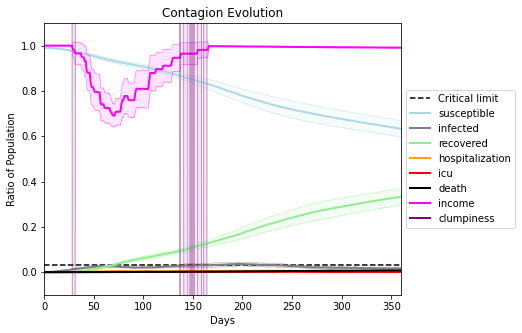

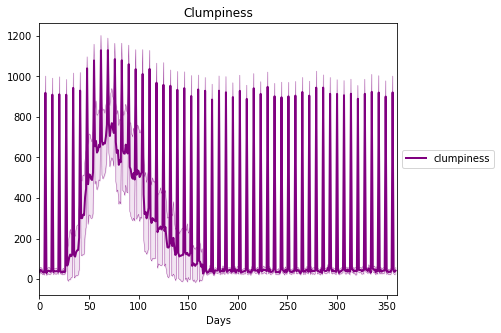

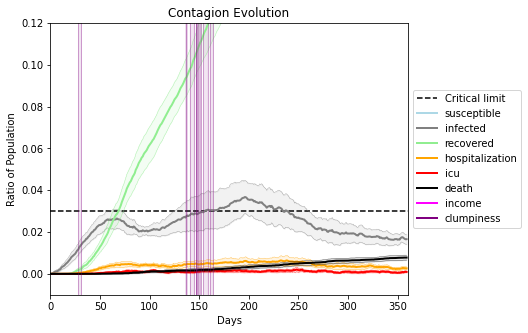

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4489, 838, 4385, 1188, 4863, 8366, 4266, 5994, 7636, 3415, 2714, 5468, 4712, 7444, 2854, 3672, 5003, 6088, 3983, 5919]
Average similarity between family members is 0.1939790591516462 at temperature -0.2
Average similarity between family and home is 0.9998609614232408 at temperature -1
Average similarity between students and their classroom is 0.2129853521651768 at temperature -0.2
Average classroom occupancy is 1.689265536723164 and number classrooms is 177
Average similarity between workers is 0.17554467224110248 at temperature -0.2
Average office occupancy is 3.139423076923077 and number offices is 208
Average friend similarity for adults: 0.226929059103427 for kids: 0.2311290838776163
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.06577762432474733
avg restaurant similarity 0.09849039398743686
avg restaurant similarity 0.10962965301500227
avg restaurant similarity 0.07057503635217731
avg restaurant similarity 0.07105070514245748
avg restaurant similarity 0.0918557374313677
avg restaurant similarity 0.08787714615207397
avg restaurant similarity 0.038822604150622234
avg restaurant similarity 0.07712049287526748
avg restaurant similarity 0.07725441425418035
avg restaurant similarity 0.0785613187576122
avg restaurant similarity 0.069431191466352
avg restaurant similarity 0.10104331371609433
avg restaurant similarity 0.1221392752104446
avg restaurant similarity 0.06804150265246724
avg restaurant similarity 0.10413717668363746
avg restaurant similarity 0.07597414494096418
avg restaurant similarity 0.14801868367788745
avg restaurant similarity 0.06969681874176975
avg restaurant similarity 0.1080087661934988
avg restaurant similarity 0.05176790815904102
avg restaurant similarity 0.10312512062

avg restaurant similarity 0.08800131071267794
avg restaurant similarity 0.08356824798841744
avg restaurant similarity 0.0915463804965857
avg restaurant similarity 0.08489008004709168
avg restaurant similarity 0.08154909962436739
avg restaurant similarity 0.07843792600285693
avg restaurant similarity 0.08229093330605701
avg restaurant similarity 0.12505680712298087
avg restaurant similarity 0.07107434366400188
avg restaurant similarity 0.09358542725033996
avg restaurant similarity 0.08179280229184814
avg restaurant similarity 0.10224843557883984
avg restaurant similarity 0.0636417232211464
avg restaurant similarity 0.08140969752445616
avg restaurant similarity 0.060900990891457035
avg restaurant similarity 0.09675058820893102
avg restaurant similarity 0.07538672172192468
avg restaurant similarity 0.13740572148200159
avg restaurant similarity 0.0506615545834038
avg restaurant similarity 0.10183314683454177
avg restaurant similarity 0.07655951080673092
avg restaurant similarity 0.10354075

avg restaurant similarity 0.114901001850525
avg restaurant similarity 0.08484926406978881
Average similarity between family members is 0.15030033608453208 at temperature -0.2
Average similarity between family and home is 0.9998602581234609 at temperature -1
Average similarity between students and their classroom is 0.19948151654625693 at temperature -0.2
Average classroom occupancy is 1.6349206349206349 and number classrooms is 189
Average similarity between workers is 0.14674483354293857 at temperature -0.2
Average office occupancy is 3.174129353233831 and number offices is 201
Average friend similarity for adults: 0.208047411015816 for kids: 0.21128591700385263
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.05523964829128393
avg restaurant similarity 0.017300667008216506
avg restaurant similarity 0.061433546868233435
avg restaurant similarity 0.0525196103376646
avg restaurant similarity 0.047106628019977774
avg restaurant similarity 0.05829046809159261
avg restaurant similarity 0.006058314771284283
avg restaurant similarity 0.029518149935399546
avg restaurant similarity 0.02055906813657417
avg restaurant similarity 0.051805879904386995
avg restaurant similarity 0.04818992891535787
avg restaurant similarity 0.0488321755401069
avg restaurant similarity 0.03478123554520098
avg restaurant similarity 0.008950331400230578
avg restaurant similarity 0.08349511296635426
avg restaurant similarity 0.023227435186198797
avg restaurant similarity 0.04670516908446014
avg restaurant similarity 0.07287877002105882
avg restaurant similarity 0.03203477250553464
avg restaurant similarity 0.07874074629115596
avg restaurant similarity 0.007872327950449929
avg restaurant similarity 0

avg restaurant similarity 0.07389982227608956
avg restaurant similarity 0.05680957041810471
avg restaurant similarity 0.027335810696831834
avg restaurant similarity 0.06575065574431839
avg restaurant similarity 0.08070031986642492
avg restaurant similarity 0.07303205126238675
avg restaurant similarity 0.06633709882435151
avg restaurant similarity 0.03856108502016922
avg restaurant similarity 0.009031077017971616
avg restaurant similarity 0.05020691211939927
avg restaurant similarity 0.04671548429941592
avg restaurant similarity 0.03673164791617726
avg restaurant similarity 0.07615534520219829
avg restaurant similarity 0.05960494994861426
avg restaurant similarity 0.04698755546282607
avg restaurant similarity 0.045029070215068016
avg restaurant similarity 0.0568320119367825
avg restaurant similarity 0.09695729630181284
avg restaurant similarity 0.06656544178122117
avg restaurant similarity 0.06572665287513153
avg restaurant similarity 0.08894317496863832
avg restaurant similarity 0.0284

avg restaurant similarity 0.0808644714018348
avg restaurant similarity 0.06451736119952028
avg restaurant similarity 0.034162894563232765
avg restaurant similarity 0.05769210417498059
Average similarity between family members is 0.16244462869183357 at temperature -0.2
Average similarity between family and home is 0.9998499184467194 at temperature -1
Average similarity between students and their classroom is 0.1478776314720953 at temperature -0.2
Average classroom occupancy is 1.5263157894736843 and number classrooms is 190
Average similarity between workers is 0.15484929859166005 at temperature -0.2
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for adults: 0.21943289672817162 for kids: 0.21738189572800587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.09263978487516278
avg restaurant similarity 0.08215912215622559
avg restaurant similarity 0.1147628808471303
avg restaurant similarity 0.05958610895333836
avg restaurant similarity 0.07500189020024593
avg restaurant similarity 0.06133944847273236
avg restaurant similarity 0.08894454723940125
avg restaurant similarity 0.03677490238849582
avg restaurant similarity 0.10907512832823738
avg restaurant similarity 0.09771801443531779
avg restaurant similarity 0.04848599312007325
avg restaurant similarity 0.06173975901701201
avg restaurant similarity 0.0956715357325359
avg restaurant similarity 0.021875816905009574
avg restaurant similarity 0.08844292299464322
avg restaurant similarity 0.05768567374359542
avg restaurant similarity 0.08606153395779065
avg restaurant similarity 0.08635704219645594
avg restaurant similarity 0.07561077295799123
avg restaurant similarity 0.11156661943677326
avg restaurant similarity 0.04312354666162932
avg restaurant similarity 0.0782773

avg restaurant similarity 0.101217845354941
avg restaurant similarity 0.0761489989373154
avg restaurant similarity 0.07998982553301874
avg restaurant similarity 0.0800387227335567
avg restaurant similarity 0.037357631341062694
avg restaurant similarity 0.06679291055406397
avg restaurant similarity 0.05906228771638475
avg restaurant similarity 0.12968695591052148
avg restaurant similarity 0.05533753429945353
avg restaurant similarity 0.04808281357450457
avg restaurant similarity 0.11065273369598087
avg restaurant similarity 0.07009545320084667
avg restaurant similarity 0.06010308058202837
avg restaurant similarity 0.05004620011079129
avg restaurant similarity 0.028173169208896617
avg restaurant similarity 0.06833579222223744
avg restaurant similarity 0.0794264165612337
avg restaurant similarity 0.06704381892436469
avg restaurant similarity 0.10472651828663312
avg restaurant similarity 0.10163404889943968
avg restaurant similarity 0.1126458731604085
avg restaurant similarity 0.0570246915

avg restaurant similarity 0.08529475727747621
avg restaurant similarity 0.06294832070951684
Average similarity between family members is 0.17826357148046715 at temperature -0.2
Average similarity between family and home is 0.999857703106709 at temperature -1
Average similarity between students and their classroom is 0.1702078502033689 at temperature -0.2
Average classroom occupancy is 1.6578947368421053 and number classrooms is 190
Average similarity between workers is 0.1326937784998833 at temperature -0.2
Average office occupancy is 3.1182266009852215 and number offices is 203
Average friend similarity for adults: 0.20648305736802425 for kids: 0.2134132137312835
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.03888688038709908
avg restaurant similarity 0.042440878177415285
avg restaurant similarity 0.07930808452541042
avg restaurant similarity 0.0800001627764583
avg restaurant similarity 0.051586057337448
avg restaurant similarity 0.0811729032227082
avg restaurant similarity 0.039084842335340826
avg restaurant similarity 0.020890041716316594
avg restaurant similarity 0.08493343194337644
avg restaurant similarity 0.0600910422001079
avg restaurant similarity 0.0652857737334087
avg restaurant similarity 0.11282013497940921
avg restaurant similarity 0.06526989217054965
avg restaurant similarity 0.10474539612616747
avg restaurant similarity 0.012333057160326196
avg restaurant similarity 0.04940594269422873
avg restaurant similarity 0.05177152158826851
avg restaurant similarity 0.08081387192392055
avg restaurant similarity 0.05049615781416612
avg restaurant similarity 0.0880446334328794
avg restaurant similarity 0.10720964039828082
avg restaurant similarity 0.031475128

avg restaurant similarity 0.14250956907270326
avg restaurant similarity 0.11391750707110605
avg restaurant similarity 0.05576999194743592
avg restaurant similarity 0.03322105712487924
avg restaurant similarity 0.05419964544022745
avg restaurant similarity 0.054925699509173996
avg restaurant similarity 0.06297659621599323
avg restaurant similarity 0.043928894920918206
avg restaurant similarity 0.05717416233734709
avg restaurant similarity 0.08918535817254927
avg restaurant similarity 0.03007613039763704
avg restaurant similarity 0.0491277193444563
avg restaurant similarity 0.07459800605894076
avg restaurant similarity 0.031818579826394966
avg restaurant similarity 0.09326258288251604
avg restaurant similarity 0.07115699792479473
avg restaurant similarity 0.0547120884512097
avg restaurant similarity 0.0573513565868668
avg restaurant similarity 0.05431784959543325
avg restaurant similarity 0.06490523570696265
avg restaurant similarity 0.026247900286401414
avg restaurant similarity 0.09140

avg restaurant similarity 0.06765420250940732
avg restaurant similarity 0.14112267546023335
avg restaurant similarity 0.08018807558143769
avg restaurant similarity 0.07903447145762944
Average similarity between family members is 0.1837013949946149 at temperature -0.2
Average similarity between family and home is 0.9998540373519911 at temperature -1
Average similarity between students and their classroom is 0.1870316168311622 at temperature -0.2
Average classroom occupancy is 1.6045197740112995 and number classrooms is 177
Average similarity between workers is 0.1834899112554408 at temperature -0.2
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.20999306510155114 for kids: 0.21723162049343522
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.0433270875139816
avg restaurant similarity 0.05539118597661741
avg restaurant similarity 0.051933049040351294
avg restaurant similarity 0.05997655830611848
avg restaurant similarity 0.08329816096627658
avg restaurant similarity 0.059310332731944845
avg restaurant similarity 0.08098792878615334
avg restaurant similarity 0.07576996413770294
avg restaurant similarity 0.07853012973398546
avg restaurant similarity 0.07482146450911925
avg restaurant similarity 0.05813073574182264
avg restaurant similarity 0.05937225463717879
avg restaurant similarity 0.02633431282725487
avg restaurant similarity 0.060884686934373135
avg restaurant similarity 0.019161804262398954
avg restaurant similarity 0.01845212580711774
avg restaurant similarity 0.047606261078002046
avg restaurant similarity 0.045724604362931465
avg restaurant similarity 0.059455675174192486
avg restaurant similarity 0.06215778007606851
avg restaurant similarity 0.08224769152004995
avg restaurant similarity 0.

avg restaurant similarity 0.04351483009147485
avg restaurant similarity 0.07716601985854925
avg restaurant similarity 0.06147363321339352
avg restaurant similarity 0.060601155981162884
avg restaurant similarity 0.02147211030604801
avg restaurant similarity 0.06283858859914913
avg restaurant similarity 0.06801341154724737
avg restaurant similarity 0.01761725291387222
avg restaurant similarity 0.07475360979673196
avg restaurant similarity 0.06521821585076361
avg restaurant similarity 0.048740521268961855
avg restaurant similarity 0.06038955233286755
avg restaurant similarity 0.048113249701447924
avg restaurant similarity 0.021533381629349244
avg restaurant similarity 0.03201689857848483
avg restaurant similarity 0.02744356574888056
avg restaurant similarity 0.046483711468634996
avg restaurant similarity 0.04723514762725104
avg restaurant similarity 0.032599925141854676
avg restaurant similarity 0.06670328350878951
avg restaurant similarity 0.03775064968401851
avg restaurant similarity 0.

avg restaurant similarity 0.06891678904022534
avg restaurant similarity 0.029573053104062465
avg restaurant similarity 0.05961885106163305
avg restaurant similarity 0.029612903970968944
Average similarity between family members is 0.17837448914314083 at temperature -0.2
Average similarity between family and home is 0.9998585395322773 at temperature -1
Average similarity between students and their classroom is 0.17675815179594515 at temperature -0.2
Average classroom occupancy is 1.6368715083798884 and number classrooms is 179
Average similarity between workers is 0.16164984134233118 at temperature -0.2
Average office occupancy is 3.242574257425743 and number offices is 202
Average friend similarity for adults: 0.2136523736653756 for kids: 0.2084105817135548
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.04297448426789345
avg restaurant similarity 0.05307960861736519
avg restaurant similarity 0.029264418464758225
avg restaurant similarity 0.03895759669820961
avg restaurant similarity 0.02959811816579863
avg restaurant similarity 0.03385573895031171
avg restaurant similarity 0.025385171595780673
avg restaurant similarity 0.0442180376765058
avg restaurant similarity 0.1167674195251601
avg restaurant similarity 0.046935607271556753
avg restaurant similarity 0.06651200749199672
avg restaurant similarity 0.05266949527003338
avg restaurant similarity 0.018874188726642448
avg restaurant similarity 0.07164735307108265
avg restaurant similarity 0.01712034781627721
avg restaurant similarity 0.00930984908847428
avg restaurant similarity 0.05794699020657031
avg restaurant similarity 0.06404896323940333
avg restaurant similarity 0.0861727634678298
avg restaurant similarity 0.06043759069191414
avg restaurant similarity 0.05005313725082465
avg restaurant similarity 0.05335

avg restaurant similarity 0.08632235460174784
avg restaurant similarity 0.056673343776842744
avg restaurant similarity 0.04832948237307235
avg restaurant similarity 0.03182113338599937
avg restaurant similarity 0.03368428849840641
avg restaurant similarity 0.06858263260950324
avg restaurant similarity 0.061035940384528344
avg restaurant similarity 0.07324246502952324
avg restaurant similarity 0.06595173456461757
avg restaurant similarity 0.037335591056506384
avg restaurant similarity 0.018110678748132835
avg restaurant similarity 0.057403394762732866
avg restaurant similarity 0.11067666565025248
avg restaurant similarity -0.003157286927440178
avg restaurant similarity 0.025591678526630527
avg restaurant similarity 0.10558455131542675
avg restaurant similarity 0.051623932389622346
avg restaurant similarity 0.03711149611737339
avg restaurant similarity 0.0028502368496202486
avg restaurant similarity 0.0030501610875880956
avg restaurant similarity 0.05392441602559414
avg restaurant simila

avg restaurant similarity 0.043838663089585825
avg restaurant similarity 0.049204170303774185
avg restaurant similarity 0.06079908408904467
avg restaurant similarity 0.06766780574196954
avg restaurant similarity 0.019883287683066866
Average similarity between family members is 0.16180438921639964 at temperature -0.2
Average similarity between family and home is 0.9998609269175873 at temperature -1
Average similarity between students and their classroom is 0.17180703659786972 at temperature -0.2
Average classroom occupancy is 1.6033519553072626 and number classrooms is 179
Average similarity between workers is 0.15544519647711233 at temperature -0.2
Average office occupancy is 3.2524752475247523 and number offices is 202
Average friend similarity for adults: 0.21355624794489939 for kids: 0.2092928408387656
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people 

avg restaurant similarity 0.07600443764475838
avg restaurant similarity 0.06854138826201701
avg restaurant similarity 0.09455990508720126
avg restaurant similarity 0.021747411410002453
avg restaurant similarity 0.08241049900270178
avg restaurant similarity 0.10288774162847182
avg restaurant similarity 0.10756668990217855
avg restaurant similarity 0.06565802049455786
avg restaurant similarity 0.04254889193990535
avg restaurant similarity 0.12841777064016283
avg restaurant similarity 0.06361683358931221
avg restaurant similarity 0.09274628619678005
avg restaurant similarity 0.06367956689175057
avg restaurant similarity 0.0851502490172806
avg restaurant similarity 0.07268645357072911
avg restaurant similarity 0.07672997578941781
avg restaurant similarity 0.058398804373791385
avg restaurant similarity 0.08500912237241313
avg restaurant similarity 0.06749578021601929
avg restaurant similarity 0.064695368295091
avg restaurant similarity 0.10591947796217858
avg restaurant similarity 0.0768610

avg restaurant similarity 0.10975135438516342
avg restaurant similarity 0.07312352455459167
avg restaurant similarity 0.11313861182999888
avg restaurant similarity 0.1038677677147191
avg restaurant similarity 0.0977853051810747
avg restaurant similarity 0.07818915223262797
avg restaurant similarity 0.0811210231605543
avg restaurant similarity 0.07227319134642979
avg restaurant similarity 0.09302053505302002
avg restaurant similarity 0.08576289328150974
avg restaurant similarity 0.13799993849092895
avg restaurant similarity 0.10468023441616303
avg restaurant similarity 0.11184196678161942
avg restaurant similarity 0.05198363233396352
avg restaurant similarity 0.03377898719382962
avg restaurant similarity 0.07233609179080172
avg restaurant similarity 0.0910456210129685
avg restaurant similarity 0.0904654311875098
avg restaurant similarity 0.09534259106159665
avg restaurant similarity 0.0070186097717861795
avg restaurant similarity 0.1457444324361795
avg restaurant similarity 0.1021285912

avg restaurant similarity 0.0947506194818952
avg restaurant similarity 0.06882418840125615
Average similarity between family members is 0.1612639984264569 at temperature -0.2
Average similarity between family and home is 0.9998481369440672 at temperature -1
Average similarity between students and their classroom is 0.15522133737113136 at temperature -0.2
Average classroom occupancy is 1.5224719101123596 and number classrooms is 178
Average similarity between workers is 0.16098960673670024 at temperature -0.2
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.20772700148144105 for kids: 0.21355046149031376
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.08367483297031576
avg restaurant similarity 0.03954994352556105
avg restaurant similarity 0.071461199523414
avg restaurant similarity 0.09675332318586988
avg restaurant similarity 0.058741450173170826
avg restaurant similarity 0.07155278958985703
avg restaurant similarity 0.07558694814856312
avg restaurant similarity 0.047847901803297274
avg restaurant similarity 0.08115941261743807
avg restaurant similarity 0.08877015039177874
avg restaurant similarity 0.0328262854696759
avg restaurant similarity 0.062168687689768
avg restaurant similarity 0.05853270118358813
avg restaurant similarity 0.05589989625817831
avg restaurant similarity 0.08153686311913505
avg restaurant similarity 0.03167731133361972
avg restaurant similarity 0.06856302810838233
avg restaurant similarity 0.04754194024570672
avg restaurant similarity 0.07674202314812142
avg restaurant similarity 0.0406878614660593
avg restaurant similarity 0.06691042627772721
avg restaurant similarity 0.1188114769

avg restaurant similarity 0.02909514505583675
avg restaurant similarity 0.0803928913130231
avg restaurant similarity 0.03318385013238424
avg restaurant similarity 0.04151490627671455
avg restaurant similarity 0.08726760526592052
avg restaurant similarity 0.040863884031814485
avg restaurant similarity 0.08951958042657096
avg restaurant similarity 0.09784574228907196
avg restaurant similarity 0.047228364156757345
avg restaurant similarity 0.10053009575071327
avg restaurant similarity 0.10687843276518277
avg restaurant similarity 0.08203354986034973
avg restaurant similarity 0.07652516694410193
avg restaurant similarity 0.069014605137354
avg restaurant similarity 0.030842434530204875
avg restaurant similarity 0.07919433021957326
avg restaurant similarity 0.05780646162421444
avg restaurant similarity 0.048630301559012074
avg restaurant similarity 0.08228237541628135
avg restaurant similarity 0.07758190691114165
avg restaurant similarity 0.08928565292893285
avg restaurant similarity 0.07052

avg restaurant similarity 0.023181776067029453
avg restaurant similarity 0.03323678288377295
avg restaurant similarity 0.03405072837705742
Average similarity between family members is 0.17190305006935241 at temperature -0.2
Average similarity between family and home is 0.999854552433224 at temperature -1
Average similarity between students and their classroom is 0.20227001211958276 at temperature -0.2
Average classroom occupancy is 1.5195530726256983 and number classrooms is 179
Average similarity between workers is 0.1571496117027427 at temperature -0.2
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults: 0.20918000171222204 for kids: 0.2230805244054417
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.034199057737243375
avg restaurant similarity 0.02945510727644331
avg restaurant similarity 0.05131247464956764
avg restaurant similarity 0.06884393180513379
avg restaurant similarity -0.00705754384012098
avg restaurant similarity 0.04245434564397237
avg restaurant similarity 0.05496760354110892
avg restaurant similarity 0.07529597475839997
avg restaurant similarity 0.08042896435100268
avg restaurant similarity 0.043898465100371466
avg restaurant similarity 0.025617174277503624
avg restaurant similarity 0.06986145054920231
avg restaurant similarity 0.043739926643202844
avg restaurant similarity 0.0772989130004534
avg restaurant similarity 0.06593390670009315
avg restaurant similarity 0.072777874814307
avg restaurant similarity 0.05068397640267758
avg restaurant similarity 0.06046542807002881
avg restaurant similarity 0.03240553716855464
avg restaurant similarity 0.06686781669783536
avg restaurant similarity 0.046011728408217704
avg restaurant similarity 0.048

avg restaurant similarity 0.03491685188637938
avg restaurant similarity 0.07190637805592275
avg restaurant similarity 0.0512909337286637
avg restaurant similarity 0.02181669274753509
avg restaurant similarity 0.06120454301142729
avg restaurant similarity 0.09144723949757577
avg restaurant similarity 0.055529986110943175
avg restaurant similarity 0.0658196465284132
avg restaurant similarity 0.06812274098865397
avg restaurant similarity 0.0618737757940074
avg restaurant similarity 0.04341997438595737
avg restaurant similarity 0.07522299626677521
avg restaurant similarity 0.057424705835795724
avg restaurant similarity 0.049595703458942354
avg restaurant similarity 0.0072461346876642385
avg restaurant similarity 0.062152024278408664
avg restaurant similarity 0.0570246222007954
avg restaurant similarity 0.035654732997341496
avg restaurant similarity 0.07061546315292122
avg restaurant similarity 0.08243765955370856
avg restaurant similarity 0.07775120617445169
avg restaurant similarity 0.034

avg restaurant similarity 0.009768444898792637
avg restaurant similarity 0.053871270158449794
avg restaurant similarity 0.0855350145046977
avg restaurant similarity 0.06656612716581506
Average similarity between family members is 0.18652515511821843 at temperature -0.2
Average similarity between family and home is 0.9998528554517921 at temperature -1
Average similarity between students and their classroom is 0.15580849074555592 at temperature -0.2
Average classroom occupancy is 1.5681818181818181 and number classrooms is 176
Average similarity between workers is 0.18852532425748952 at temperature -0.2
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.21708442959503038 for kids: 0.22153643204831286
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.06905837448366306
avg restaurant similarity 0.0467043600499609
avg restaurant similarity 0.09656548998979049
avg restaurant similarity 0.02851067360670742
avg restaurant similarity 0.05070569349997213
avg restaurant similarity 0.0675408720537787
avg restaurant similarity 0.03377788931374829
avg restaurant similarity 0.055994275338329035
avg restaurant similarity 0.05070069252428751
avg restaurant similarity 0.07851727926645734
avg restaurant similarity 0.06286375517149016
avg restaurant similarity 0.053321591279387716
avg restaurant similarity 0.05089620525218783
avg restaurant similarity 0.0177324950772733
avg restaurant similarity 0.04258832682905612
avg restaurant similarity 0.05648776246637703
avg restaurant similarity 0.040491528815636196
avg restaurant similarity 0.05422278197609547
avg restaurant similarity 0.05285249770716642
avg restaurant similarity 0.04942427673766446
avg restaurant similarity 0.060690272634730175
avg restaurant similarity 0.04344

avg restaurant similarity 0.038601871558407906
avg restaurant similarity 0.03483017340382792
avg restaurant similarity 0.009770933426094409
avg restaurant similarity 0.06200406092441201
avg restaurant similarity 0.04783216089324616
avg restaurant similarity 0.037348018126392775
avg restaurant similarity 0.06691431910353278
avg restaurant similarity 0.07485525267038814
avg restaurant similarity 0.08104372720152997
avg restaurant similarity 0.023610838870813788
avg restaurant similarity 0.06513950011578969
avg restaurant similarity 0.07658948338900629
avg restaurant similarity 0.06703981412951261
avg restaurant similarity 0.010782578670813616
avg restaurant similarity 0.021229278436409895
avg restaurant similarity 0.04405453303293886
avg restaurant similarity 0.08392627967053512
avg restaurant similarity 0.0531590449042615
avg restaurant similarity 0.03776390767024686
avg restaurant similarity 0.012799922602981071
avg restaurant similarity 0.0749411545545161
avg restaurant similarity 0.0

avg restaurant similarity 0.061717560265848424
avg restaurant similarity 0.05351490752026718
avg restaurant similarity 0.029146103491014156
avg restaurant similarity 0.04430148246378109
Average similarity between family members is 0.15994515446660823 at temperature -0.2
Average similarity between family and home is 0.9998633511674483 at temperature -1
Average similarity between students and their classroom is 0.17910098817639689 at temperature -0.2
Average classroom occupancy is 1.532258064516129 and number classrooms is 186
Average similarity between workers is 0.14428902657077194 at temperature -0.2
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.2070709286532691 for kids: 0.2010323231872741
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.04343125329716225
avg restaurant similarity 0.017343888408966366
avg restaurant similarity 0.0364067300835055
avg restaurant similarity 0.03534801231863146
avg restaurant similarity 0.04506342571970349
avg restaurant similarity 0.06035024919140756
avg restaurant similarity 0.06475885837226812
avg restaurant similarity 0.014906560399360638
avg restaurant similarity 0.07220431372929022
avg restaurant similarity 0.04911974292497638
avg restaurant similarity 0.0381264569628207
avg restaurant similarity 0.05295460791167668
avg restaurant similarity 0.03344136635813801
avg restaurant similarity 0.06795332510300005
avg restaurant similarity 0.08129843234539393
avg restaurant similarity 0.07741508753666318
avg restaurant similarity 0.03922343381449
avg restaurant similarity 0.11776710224346744
avg restaurant similarity 0.04598124758448689
avg restaurant similarity 0.04150841184551844
avg restaurant similarity 0.04913775773811776
avg restaurant similarity 0.051617023

avg restaurant similarity 0.060130843497261374
avg restaurant similarity 0.03525333528142295
avg restaurant similarity 0.003258042969569099
avg restaurant similarity 0.03186666901388568
avg restaurant similarity 0.08230570880518974
avg restaurant similarity 0.01508859409637674
avg restaurant similarity 0.013138253170099933
avg restaurant similarity 0.046658529362088155
avg restaurant similarity 0.0348887676379666
avg restaurant similarity 0.0516931776957969
avg restaurant similarity 0.032784483111475714
avg restaurant similarity 0.04514339092020414
avg restaurant similarity 0.08010178581096418
avg restaurant similarity 0.05109079261984282
avg restaurant similarity 0.0413522697415031
avg restaurant similarity 0.06930620140805187
avg restaurant similarity 0.025604344420555977
avg restaurant similarity 0.08077322567623858
avg restaurant similarity 0.017211357774623067
avg restaurant similarity 0.01486347266667689
avg restaurant similarity 0.05474728594393463
avg restaurant similarity 0.04

avg restaurant similarity 0.09227562854908528
avg restaurant similarity 0.018403516396123757
avg restaurant similarity 0.001061042173318654
avg restaurant similarity 0.006867166272509297
avg restaurant similarity 0.07869402126275067
Average similarity between family members is 0.1850948688033911 at temperature -0.2
Average similarity between family and home is 0.9998602399422798 at temperature -1
Average similarity between students and their classroom is 0.1741817823191488 at temperature -0.2
Average classroom occupancy is 1.5621301775147929 and number classrooms is 169
Average similarity between workers is 0.14496594963176496 at temperature -0.2
Average office occupancy is 3.4 and number offices is 200
Average friend similarity for adults: 0.20962770711967837 for kids: 0.21066007000038395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in thi

avg restaurant similarity 0.11715156899841078
avg restaurant similarity 0.041734692501815024
avg restaurant similarity 0.06346700019766935
avg restaurant similarity 0.03277352057940827
avg restaurant similarity 0.027385440157896755
avg restaurant similarity 0.061229881923057713
avg restaurant similarity 0.0672263405558769
avg restaurant similarity 0.0551698160544998
avg restaurant similarity -0.011942804741982177
avg restaurant similarity 0.06214278457861488
avg restaurant similarity 0.016385713047161465
avg restaurant similarity 0.07432886985641561
avg restaurant similarity 0.05412264730570539
avg restaurant similarity 0.05363722655183878
avg restaurant similarity 0.06393159847088169
avg restaurant similarity -0.0004226027249744187
avg restaurant similarity 0.05404345932663246
avg restaurant similarity 0.03241704243140483
avg restaurant similarity 0.005600028044476288
avg restaurant similarity 0.04518410790001491
avg restaurant similarity 0.05104681356773929
avg restaurant similarity 

avg restaurant similarity 0.03270771264364948
avg restaurant similarity 0.03431787670595026
avg restaurant similarity 0.005754398824354311
avg restaurant similarity 0.029258086214727284
avg restaurant similarity 0.018321300760503163
avg restaurant similarity 0.03003424163892688
avg restaurant similarity 0.07485161465045047
avg restaurant similarity 0.018873702633533072
avg restaurant similarity 0.05586145571387366
avg restaurant similarity 0.09615808214171606
avg restaurant similarity 0.05129376682035106
avg restaurant similarity 0.08998531835356242
avg restaurant similarity 0.026970547060086864
avg restaurant similarity 0.015608391984953524
avg restaurant similarity 0.03550427947948991
avg restaurant similarity 0.045939653820837166
avg restaurant similarity 0.04382009370770164
avg restaurant similarity 0.03365926522853207
avg restaurant similarity 0.049766582763378385
avg restaurant similarity 0.03943221003502459
avg restaurant similarity 0.043003306750664216
avg restaurant similarity

avg restaurant similarity 0.031953204356757275
avg restaurant similarity 0.010333954182237974
avg restaurant similarity 0.04189686066877734
avg restaurant similarity 0.04396654471335216
avg restaurant similarity 0.050331400147295854
avg restaurant similarity 0.06957924838250183
Average similarity between family members is 0.18921149075776367 at temperature -0.2
Average similarity between family and home is 0.9998575312543808 at temperature -1
Average similarity between students and their classroom is 0.1892211618199917 at temperature -0.2
Average classroom occupancy is 1.6187845303867403 and number classrooms is 181
Average similarity between workers is 0.15499321121607473 at temperature -0.2
Average office occupancy is 3.1822660098522166 and number offices is 203
Average friend similarity for adults: 0.21503835897792606 for kids: 0.21084523829032847
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units 

avg restaurant similarity 0.0950334335815991
avg restaurant similarity 0.05925451168676931
avg restaurant similarity 0.10243693154513486
avg restaurant similarity 0.11652503182113726
avg restaurant similarity 0.03658660973851118
avg restaurant similarity 0.07688345964125928
avg restaurant similarity 0.04273158071001443
avg restaurant similarity 0.060692142978556476
avg restaurant similarity 0.07428333991556102
avg restaurant similarity 0.08445687544208146
avg restaurant similarity 0.09137391943918417
avg restaurant similarity 0.07181387605362746
avg restaurant similarity 0.08419701830246056
avg restaurant similarity 0.1211487354552566
avg restaurant similarity 0.11499301951078957
avg restaurant similarity 0.08327920376615759
avg restaurant similarity 0.04098869841490325
avg restaurant similarity 0.08626418656066713
avg restaurant similarity 0.07869987950557185
avg restaurant similarity 0.05945058292918406
avg restaurant similarity 0.058072449042032896
avg restaurant similarity 0.078995

avg restaurant similarity 0.016321088153087342
avg restaurant similarity 0.07423104363863868
avg restaurant similarity 0.0698942931861091
avg restaurant similarity 0.04668539240894995
avg restaurant similarity 0.08592673976075929
avg restaurant similarity 0.08737132398811456
avg restaurant similarity 0.0134399422224001
avg restaurant similarity 0.08196837959004832
avg restaurant similarity 0.08246183369337601
avg restaurant similarity 0.07765418423857853
avg restaurant similarity 0.06911997081821186
avg restaurant similarity 0.06578938862129656
avg restaurant similarity 0.03702945495582649
avg restaurant similarity 0.1108192759774666
avg restaurant similarity 0.04000694059654074
avg restaurant similarity 0.07220672297105474
avg restaurant similarity 0.0746703613908893
avg restaurant similarity 0.09710307457599557
avg restaurant similarity 0.08714336317571851
avg restaurant similarity 0.06671305469722423
avg restaurant similarity 0.06119017381361004
avg restaurant similarity 0.140173662

avg restaurant similarity 0.06123877384240254
avg restaurant similarity 0.10482930241323278
Average similarity between family members is 0.1833511381566519 at temperature -0.2
Average similarity between family and home is 0.9998602211848721 at temperature -1
Average similarity between students and their classroom is 0.16204127541478044 at temperature -0.2
Average classroom occupancy is 1.622093023255814 and number classrooms is 172
Average similarity between workers is 0.15960935848253321 at temperature -0.2
Average office occupancy is 3.350253807106599 and number offices is 197
Average friend similarity for adults: 0.21454902951599114 for kids: 0.21717944765868125
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.022555218842231318
avg restaurant similarity 0.060309204930577356
avg restaurant similarity 0.03154352713251177
avg restaurant similarity -0.017942062581068088
avg restaurant similarity -0.011077887352274026
avg restaurant similarity 0.05676821798799207
avg restaurant similarity 0.03346640723939172
avg restaurant similarity -0.008185560891919408
avg restaurant similarity 0.04856587144199678
avg restaurant similarity 0.057942159886183425
avg restaurant similarity 0.015678471832721173
avg restaurant similarity 0.01833340095901974
avg restaurant similarity 0.03250850888876496
avg restaurant similarity 0.014667021242111455
avg restaurant similarity 0.09108825945753868
avg restaurant similarity 0.050761118930324936
avg restaurant similarity 0.01156280183850507
avg restaurant similarity 0.03357374587971234
avg restaurant similarity 0.03541716710354309
avg restaurant similarity 0.004959503516945613
avg restaurant similarity 0.07653734652622067
avg restaurant simila

avg restaurant similarity 0.026432481667181613
avg restaurant similarity 0.05663876493487981
avg restaurant similarity 0.03523804613224319
avg restaurant similarity 0.006156443999735565
avg restaurant similarity 0.04679888996661611
avg restaurant similarity 0.040941688634480965
avg restaurant similarity 0.025692735922974722
avg restaurant similarity 0.004494633430903558
avg restaurant similarity 0.003993963233331566
avg restaurant similarity 0.07192854245527878
avg restaurant similarity 0.006588923766191769
avg restaurant similarity 0.07689779350763613
avg restaurant similarity 0.032038967533985135
avg restaurant similarity 0.02438278111456339
avg restaurant similarity 0.04780394105031222
avg restaurant similarity 0.05411680562802025
avg restaurant similarity 0.06745167561819505
avg restaurant similarity 0.03790688745202641
avg restaurant similarity -0.008691739883050316
avg restaurant similarity 0.030599296190986038
avg restaurant similarity 0.02412103095406712
avg restaurant similari

avg restaurant similarity 0.043522939873062105
avg restaurant similarity 0.05303684802772424
avg restaurant similarity 0.052136018494854844
avg restaurant similarity 0.05021152565053281
avg restaurant similarity 0.025868937090891317
avg restaurant similarity 0.03181656513912582
Average similarity between family members is 0.15501296630572572 at temperature -0.2
Average similarity between family and home is 0.99984666162854 at temperature -1
Average similarity between students and their classroom is 0.1818662739936751 at temperature -0.2
Average classroom occupancy is 1.651685393258427 and number classrooms is 178
Average similarity between workers is 0.12855185776264622 at temperature -0.2
Average office occupancy is 3.208955223880597 and number offices is 201
Average friend similarity for adults: 0.19795778077188794 for kids: 0.21833677301959395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with

avg restaurant similarity 0.07639816695673818
avg restaurant similarity 0.0523762218522249
avg restaurant similarity 0.05003138821288119
avg restaurant similarity 0.07682165314569651
avg restaurant similarity 0.07192693946190844
avg restaurant similarity 0.06077233818994573
avg restaurant similarity 0.025616262699247824
avg restaurant similarity 0.05267483567811743
avg restaurant similarity 0.05784355634309891
avg restaurant similarity 0.0719386817121612
avg restaurant similarity 0.06275274904360084
avg restaurant similarity 0.023236922991187833
avg restaurant similarity 0.038593513308077414
avg restaurant similarity 0.02993771681448832
avg restaurant similarity 0.1030920576051761
avg restaurant similarity 0.06240666057750661
avg restaurant similarity 0.11078278332154536
avg restaurant similarity 0.03521611020257191
avg restaurant similarity 0.07317895576026362
avg restaurant similarity 0.06151819426674364
avg restaurant similarity 0.06572634515100365
avg restaurant similarity 0.043095

avg restaurant similarity 0.04301786041293539
avg restaurant similarity 0.03519763489247302
avg restaurant similarity 0.07585874638626428
avg restaurant similarity 0.08801859971493434
avg restaurant similarity 0.04532769799238414
avg restaurant similarity 0.08764258118590114
avg restaurant similarity 0.06804452634360572
avg restaurant similarity 0.09092412270079571
avg restaurant similarity 0.08705516413961262
avg restaurant similarity 0.047095475672152845
avg restaurant similarity 0.04965003490159924
avg restaurant similarity 0.10966059009336705
avg restaurant similarity 0.05130551651209847
avg restaurant similarity 0.0925354862523982
avg restaurant similarity 0.042076234852019334
avg restaurant similarity 0.05634207438382665
avg restaurant similarity 0.0859185157874279
avg restaurant similarity 0.05766984493076466
avg restaurant similarity 0.12123738480902721
avg restaurant similarity 0.0742079788165086
avg restaurant similarity 0.07015096954986673
avg restaurant similarity 0.0564534

avg restaurant similarity 0.05533064794321382
avg restaurant similarity 0.06562486392814236
avg restaurant similarity 0.06692703944231253
avg restaurant similarity 0.0785405019188302
Average similarity between family members is 0.18091026592644696 at temperature -0.2
Average similarity between family and home is 0.9998532881106599 at temperature -1
Average similarity between students and their classroom is 0.1240496135380139 at temperature -0.2
Average classroom occupancy is 1.5856353591160222 and number classrooms is 181
Average similarity between workers is 0.15610015337271305 at temperature -0.2
Average office occupancy is 3.3737373737373737 and number offices is 198
Average friend similarity for adults: 0.21773732517528732 for kids: 0.22499570626759377
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.06191187968127222
avg restaurant similarity 0.0339872150926605
avg restaurant similarity 0.06022594107556213
avg restaurant similarity 0.029367811871435
avg restaurant similarity 0.05349063219614085
avg restaurant similarity 0.03587176112114848
avg restaurant similarity 0.09244797776185432
avg restaurant similarity 0.04470899693030515
avg restaurant similarity 0.038561394003274414
avg restaurant similarity 0.04877036318190322
avg restaurant similarity 0.07506532159857912
avg restaurant similarity 0.04598942018364203
avg restaurant similarity 0.042868118354316975
avg restaurant similarity 0.06903479691912792
avg restaurant similarity 0.06913218233095887
avg restaurant similarity 0.04170020027909628
avg restaurant similarity 0.06577356695103635
avg restaurant similarity 0.057432991218166675
avg restaurant similarity 0.021620008546330467
avg restaurant similarity 0.07016037626936668
avg restaurant similarity 0.07128627663825002
avg restaurant similarity 0.06491

avg restaurant similarity 0.04817903939282095
avg restaurant similarity 0.03704721853369858
avg restaurant similarity 0.0684094776830438
avg restaurant similarity 0.029012473521464213
avg restaurant similarity 0.03912359481323923
avg restaurant similarity 0.027462766431047208
avg restaurant similarity 0.0249413924921212
avg restaurant similarity 0.08995536339551362
avg restaurant similarity 0.08176059895749835
avg restaurant similarity 0.08035591472289491
avg restaurant similarity 0.00771792705679124
avg restaurant similarity 0.06956014040340767
avg restaurant similarity 0.053844559825398
avg restaurant similarity 0.024431357910426683
avg restaurant similarity 0.06657005619033568
avg restaurant similarity 0.06435526708562235
avg restaurant similarity 0.06952957963968869
avg restaurant similarity 0.04998311743317342
avg restaurant similarity 0.04856712246143785
avg restaurant similarity 0.06782302379666691
avg restaurant similarity 0.025195263748080406
avg restaurant similarity 0.094803

avg restaurant similarity 0.07154652060831415
avg restaurant similarity 0.08475523315261137
avg restaurant similarity 0.05184943998043438
avg restaurant similarity 0.05871137243216766
Average similarity between family members is 0.16424430946903126 at temperature -0.2
Average similarity between family and home is 0.9998585252773942 at temperature -1
Average similarity between students and their classroom is 0.13542930595070057 at temperature -0.2
Average classroom occupancy is 1.5628415300546448 and number classrooms is 183
Average similarity between workers is 0.14517039341207535 at temperature -0.2
Average office occupancy is 3.3467336683417086 and number offices is 199
Average friend similarity for adults: 0.21199618104684154 for kids: 0.20835399361807794
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.026589671228414668
avg restaurant similarity 0.0240257200484675
avg restaurant similarity 0.03280869425457968
avg restaurant similarity 0.02243848433751616
avg restaurant similarity 0.05257636753066149
avg restaurant similarity 0.03126821323916006
avg restaurant similarity 0.03939207442403727
avg restaurant similarity 0.06255095705296357
avg restaurant similarity 0.05285769009194754
avg restaurant similarity 0.03348117409254625
avg restaurant similarity 0.031232208470406652
avg restaurant similarity 0.01461689915921264
avg restaurant similarity 0.02869837692210023
avg restaurant similarity 0.043318647943244803
avg restaurant similarity 0.03358396140196401
avg restaurant similarity 0.01400906470097417
avg restaurant similarity 0.03965148449491894
avg restaurant similarity 0.032923549390712216
avg restaurant similarity 0.04536711499682132
avg restaurant similarity 0.032595909269108214
avg restaurant similarity 0.08939480564860897
avg restaurant similarity -0.0

avg restaurant similarity 0.03156454265220635
avg restaurant similarity 0.04989782927980059
avg restaurant similarity 0.008601573164087079
avg restaurant similarity 0.0422922412891485
avg restaurant similarity 0.07473090258011446
avg restaurant similarity 0.025728517791224096
avg restaurant similarity 0.03205319500997456
avg restaurant similarity 0.03727326177127697
avg restaurant similarity 0.010168006565073766
avg restaurant similarity 0.007770270857964212
avg restaurant similarity 0.050167306243339746
avg restaurant similarity 0.05242509349927211
avg restaurant similarity 0.07214883026495955
avg restaurant similarity 0.0767992641482446
avg restaurant similarity 0.018309838450197208
avg restaurant similarity 0.030717026114669522
avg restaurant similarity 0.04816819044248394
avg restaurant similarity 0.02403362170405866
avg restaurant similarity -0.0034642354457958273
avg restaurant similarity 0.06400656183168109
avg restaurant similarity 0.06875556303082621
avg restaurant similarity 

avg restaurant similarity 0.035550874132450866
avg restaurant similarity 0.04734717613728615
avg restaurant similarity 0.08545197489912074
avg restaurant similarity 0.06490107070581774
avg restaurant similarity 0.04393558291802768
avg restaurant similarity 0.04602407906123756
Average similarity between family members is 0.19246465177208655 at temperature -0.2
Average similarity between family and home is 0.999855041551363 at temperature -1
Average similarity between students and their classroom is 0.17330545520740376 at temperature -0.2
Average classroom occupancy is 1.6228571428571428 and number classrooms is 175
Average similarity between workers is 0.1320188449208764 at temperature -0.2
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.2153213818422772 for kids: 0.20348485999051363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.04858230674436525
avg restaurant similarity 0.04848965986562101
avg restaurant similarity 0.07627475132686634
avg restaurant similarity 0.050651409000499026
avg restaurant similarity 0.07018464709235561
avg restaurant similarity 0.05974612122978807
avg restaurant similarity 0.052843228418652397
avg restaurant similarity 0.05349269614608039
avg restaurant similarity 0.09817479345256246
avg restaurant similarity 0.052819509140999546
avg restaurant similarity 0.1001894811473639
avg restaurant similarity 0.07136881033205603
avg restaurant similarity 0.03291970965454272
avg restaurant similarity 0.10259288940119723
avg restaurant similarity 0.06385315712197451
avg restaurant similarity 0.07368860903676792
avg restaurant similarity 0.0844917150087581
avg restaurant similarity 0.06146635234890863
avg restaurant similarity 0.08875828437151725
avg restaurant similarity 0.10914778707504087
avg restaurant similarity 0.08320900006487496
avg restaurant similarity 0.06892

avg restaurant similarity 0.06389721349271671
avg restaurant similarity 0.04695951943194214
avg restaurant similarity 0.04249193016217208
avg restaurant similarity 0.037806079531229636
avg restaurant similarity 0.0691856595939941
avg restaurant similarity 0.06758914845754928
avg restaurant similarity 0.07382795580569243
avg restaurant similarity 0.06302608394191811
avg restaurant similarity 0.08403148633720209
avg restaurant similarity 0.010512839506622948
avg restaurant similarity 0.1027241610781426
avg restaurant similarity 0.04450623781729376
avg restaurant similarity 0.06508773100131969
avg restaurant similarity 0.06426562893510769
avg restaurant similarity 0.043278734116745855
avg restaurant similarity 0.03500466630714575
avg restaurant similarity 0.03844795571438699
avg restaurant similarity 0.07256264010425709
avg restaurant similarity 0.09255972257265141
avg restaurant similarity 0.014063404632763576
avg restaurant similarity 0.10006833335777143
avg restaurant similarity 0.0496

avg restaurant similarity 0.04453338907855718
avg restaurant similarity 0.043071095327536446
avg restaurant similarity 0.08218317561892932
avg restaurant similarity 0.06150467226941646
Average similarity between family members is 0.17717146480796286 at temperature -0.2
Average similarity between family and home is 0.9998452178957785 at temperature -1
Average similarity between students and their classroom is 0.14483449589371117 at temperature -0.2
Average classroom occupancy is 1.5852272727272727 and number classrooms is 176
Average similarity between workers is 0.15420731422834516 at temperature -0.2
Average office occupancy is 3.28 and number offices is 200
Average friend similarity for adults: 0.20440375423101875 for kids: 0.21521228087025518
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.046071064624455045
avg restaurant similarity 0.04548686522377502
avg restaurant similarity 0.09694738631931021
avg restaurant similarity 0.03506618845360968
avg restaurant similarity 0.01944313860256781
avg restaurant similarity 0.04673597648896493
avg restaurant similarity 0.0642586486425105
avg restaurant similarity 0.03251046520797994
avg restaurant similarity 0.08747830205641038
avg restaurant similarity 0.06553531390511994
avg restaurant similarity 0.03874844223856241
avg restaurant similarity 0.03221128889228108
avg restaurant similarity 0.09440888194615604
avg restaurant similarity 0.06182719586292904
avg restaurant similarity 0.09199465671282243
avg restaurant similarity 0.09985909559243172
avg restaurant similarity 0.080001974326768
avg restaurant similarity 0.08664727805561089
avg restaurant similarity 0.005160183450787727
avg restaurant similarity 0.04349842035313796
avg restaurant similarity 0.052769857503421114
avg restaurant similarity 0.064362

avg restaurant similarity 0.08314718223561139
avg restaurant similarity 0.08936167535858287
avg restaurant similarity 0.0606799258700562
avg restaurant similarity 0.0890774267569701
avg restaurant similarity 0.09493296530614359
avg restaurant similarity 0.06927813052721486
avg restaurant similarity 0.025735888218250163
avg restaurant similarity 0.02342550427002659
avg restaurant similarity 0.053021034950902934
avg restaurant similarity 0.011590773623651091
avg restaurant similarity 0.012201598584064869
avg restaurant similarity 0.04072618139759671
avg restaurant similarity 0.0388405430552689
avg restaurant similarity -0.0019147824653998058
avg restaurant similarity 0.07375980847242894
avg restaurant similarity 0.02737045109085751
avg restaurant similarity 0.08289861836680835
avg restaurant similarity 0.027083157389106816
avg restaurant similarity 0.04727328578421034
avg restaurant similarity 0.07631898884860543
avg restaurant similarity 0.07523076470673593
avg restaurant similarity 0.0

avg restaurant similarity 0.038133688078764404
avg restaurant similarity 0.08645567586974266
avg restaurant similarity 0.05499621321080697
avg restaurant similarity 0.05745997084308959
avg restaurant similarity 0.015476885827639857
avg restaurant similarity 0.007280534198878687
Average similarity between family members is 0.17216067985077307 at temperature -0.2
Average similarity between family and home is 0.9998599656167823 at temperature -1
Average similarity between students and their classroom is 0.13477374473784204 at temperature -0.2
Average classroom occupancy is 1.652694610778443 and number classrooms is 167
Average similarity between workers is 0.15575255168432636 at temperature -0.2
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.2202075206240127 for kids: 0.2174376660840645
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.02842702072912994
avg restaurant similarity 0.07029299558567906
avg restaurant similarity 0.10158591645083916
avg restaurant similarity 0.03289832851384406
avg restaurant similarity 0.09225585127029433
avg restaurant similarity 0.04155236032470932
avg restaurant similarity 0.051216051357419974
avg restaurant similarity 0.09284461652408008
avg restaurant similarity 0.024027410980605894
avg restaurant similarity 0.04548563079222474
avg restaurant similarity 0.11953837170988175
avg restaurant similarity 0.07817720155332394
avg restaurant similarity 0.0784605729603409
avg restaurant similarity 0.09952161713583026
avg restaurant similarity 0.10124707685609331
avg restaurant similarity 0.03566882651248748
avg restaurant similarity 0.08007087485004719
avg restaurant similarity 0.04549804117999677
avg restaurant similarity 0.050480551466260744
avg restaurant similarity 0.08466237214506075
avg restaurant similarity 0.032198763963716424
avg restaurant similarity 0.023

avg restaurant similarity 0.07668246442506937
avg restaurant similarity 0.05806538708125673
avg restaurant similarity 0.05779292001560943
avg restaurant similarity 0.015652347301943398
avg restaurant similarity 0.09006544355087831
avg restaurant similarity 0.0899070586604723
avg restaurant similarity 0.055416374271436544
avg restaurant similarity 0.09143195662703536
avg restaurant similarity 0.07262079375352659
avg restaurant similarity 0.04525974720369525
avg restaurant similarity 0.06092035111411359
avg restaurant similarity 0.055498887928268154
avg restaurant similarity 0.06893890975295963
avg restaurant similarity 0.08538953333819338
avg restaurant similarity 0.04257361336612438
avg restaurant similarity 0.06056194267226947
avg restaurant similarity 0.08236643536934882
avg restaurant similarity 0.06604267971719599
avg restaurant similarity 0.07524902635720652
avg restaurant similarity 0.033513252294835504
avg restaurant similarity 0.08641354175200787
avg restaurant similarity 0.050

avg restaurant similarity 0.05463743195377222
avg restaurant similarity 0.05397275880173298
avg restaurant similarity 0.09428641375216586
avg restaurant similarity 0.07539781348114988
using average of time series:
stats on susceptible:
data: [0.7974192474192474, 0.8290268084634985, 0.8145694444444445, 0.7961864406779662, 0.720125, 0.8105472222222223, 0.7952138888888889, 0.7611277777777777, 0.7798055555555556, 0.7145, 0.7524472222222222, 0.773275, 0.794413888888889, 0.8396472222222223, 0.7369194444444446, 0.7959207459207459, 0.6872333333333334, 0.7579972222222223, 0.8725722222222222, 0.794888888888889]
min:
0.6872333333333334
max:
0.8725722222222222
std:
0.043641817503319566
mean:
0.7811918287907396
median:
0.794651388888889
95% confidence interval for the mean:
(0.7602362216533218,0.8021474359281573)
using average of time series:
stats on infected:
data: [0.02714230214230214, 0.023138916583582587, 0.021972222222222223, 0.025797607178464608, 0.033230555555555555, 0.02325277777777778, 0.

(<function dict.items>, <function dict.items>, <function dict.items>)

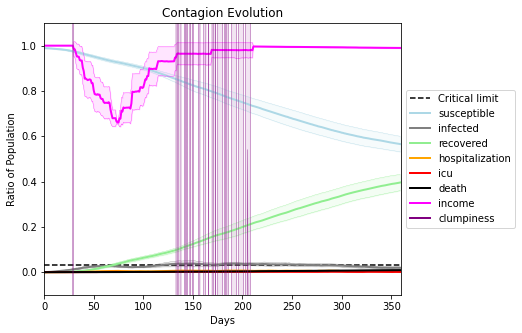

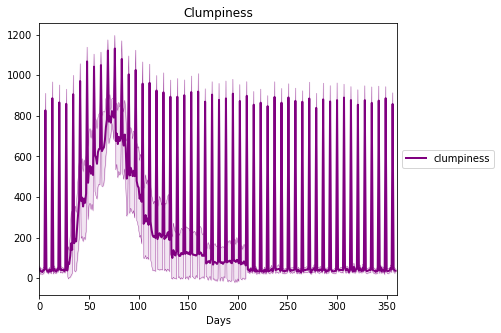

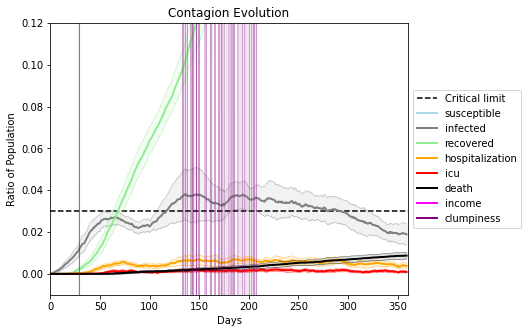

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7376, 2775, 1814, 9593, 9072, 9306, 2521, 5559, 6024, 2231, 3768, 1695, 1502, 9269, 6585, 5492, 6786, 9796, 5834, 1034]
Average similarity between family members is 0.1620958278237351 at temperature -0.1
Average similarity between family and home is 0.9998592919140988 at temperature -1
Average similarity between students and their classroom is 0.19213257766664865 at temperature -0.1
Average classroom occupancy is 1.6235294117647059 and number classrooms is 170
Average similarity between workers is 0.1391938469131801 at temperature -0.1
Average office occupancy is 3.365 and number offices is 200
Average friend similarity for adults: 0.20612410724410746 for kids: 0.218299009814261
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBu

avg restaurant similarity 0.07371029974549832
avg restaurant similarity 0.04983182429438818
avg restaurant similarity 0.06766325017821674
avg restaurant similarity 0.052598897382660985
avg restaurant similarity 0.05339158353702081
avg restaurant similarity 0.04038395292190587
avg restaurant similarity 0.05660406826677076
avg restaurant similarity 0.07413930209001478
avg restaurant similarity 0.09037272047932882
avg restaurant similarity 0.0329362554014609
avg restaurant similarity 0.05041116641702793
avg restaurant similarity 0.05648784429721161
avg restaurant similarity 0.014169396088829807
avg restaurant similarity 0.04037324237339348
avg restaurant similarity 0.01450170980810348
avg restaurant similarity 0.06585211628495684
avg restaurant similarity 0.06241650372544716
avg restaurant similarity 0.046780627370502606
avg restaurant similarity 0.058040594183801295
avg restaurant similarity 0.09069950548516804
avg restaurant similarity 0.0449608560336958
avg restaurant similarity 0.0560

avg restaurant similarity 0.041468280464275566
avg restaurant similarity 0.04344498107575262
avg restaurant similarity 0.09357798339130968
avg restaurant similarity 0.09243310132820905
avg restaurant similarity 0.08497130478097992
avg restaurant similarity 0.06241298253559099
avg restaurant similarity 0.03040813772738457
avg restaurant similarity 0.05272977075071321
avg restaurant similarity 0.07079930822366948
avg restaurant similarity 0.08313982772768942
avg restaurant similarity -0.00910873385496486
avg restaurant similarity 0.08286251857592716
avg restaurant similarity -0.011792295462329657
avg restaurant similarity 0.030348917180821944
avg restaurant similarity 0.04085343918998737
avg restaurant similarity 0.06412171833043821
avg restaurant similarity 0.04781356922939127
avg restaurant similarity 0.07475492424474615
avg restaurant similarity 0.06635487444188233
avg restaurant similarity 0.07376810657596378
avg restaurant similarity 0.009920582797326254
avg restaurant similarity 0.

avg restaurant similarity 0.058990319915332885
avg restaurant similarity 0.06753611401144746
avg restaurant similarity 0.04355409085100124
avg restaurant similarity 0.0773529007176901
Average similarity between family members is 0.18074387741445655 at temperature -0.1
Average similarity between family and home is 0.9998440134623893 at temperature -1
Average similarity between students and their classroom is 0.178231995679536 at temperature -0.1
Average classroom occupancy is 1.6084656084656084 and number classrooms is 189
Average similarity between workers is 0.15259776642827372 at temperature -0.1
Average office occupancy is 3.19 and number offices is 200
Average friend similarity for adults: 0.21955566999531828 for kids: 0.21685384055857115
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.006009648067717133
avg restaurant similarity 0.10165346821926045
avg restaurant similarity 0.08400294548015545
avg restaurant similarity 0.06692937989190377
avg restaurant similarity 0.1347076449160676
avg restaurant similarity 0.05527689579237868
avg restaurant similarity 0.0719055299419151
avg restaurant similarity 0.04421785556183021
avg restaurant similarity 0.05226351213687801
avg restaurant similarity 0.013837692013670428
avg restaurant similarity 0.06234228461008438
avg restaurant similarity 0.015241793579633815
avg restaurant similarity 0.03843041898984397
avg restaurant similarity 0.08457299854257837
avg restaurant similarity 0.041454117319874945
avg restaurant similarity 0.07466345651224408
avg restaurant similarity 0.0775495180626153
avg restaurant similarity 0.06684247214078044
avg restaurant similarity 0.019714809453404238
avg restaurant similarity 0.018752904780004572
avg restaurant similarity 0.060599140314826015
avg restaurant similarity 0.08

avg restaurant similarity 0.09605386071612962
avg restaurant similarity 0.1022683629551074
avg restaurant similarity 0.1175576844690741
avg restaurant similarity 0.007203714537818444
avg restaurant similarity 0.04630355554030909
avg restaurant similarity 0.07629941754351004
avg restaurant similarity 0.054338676338866285
avg restaurant similarity 0.04835500616003363
avg restaurant similarity 0.058176224592281355
avg restaurant similarity 0.12112933993414136
avg restaurant similarity 0.06417275832255835
avg restaurant similarity 0.12036371552587934
avg restaurant similarity 0.0768060539174053
avg restaurant similarity 0.08521951015126647
avg restaurant similarity 0.08950316010274795
avg restaurant similarity 0.03449337437328797
avg restaurant similarity 0.0716790256456763
avg restaurant similarity 0.0538699995846413
avg restaurant similarity 0.08781131528081533
avg restaurant similarity 0.10541477032571583
avg restaurant similarity 0.010777995129948273
avg restaurant similarity 0.0967234

avg restaurant similarity 0.074411786850149
avg restaurant similarity 0.05738566262683036
avg restaurant similarity 0.04630221907109237
avg restaurant similarity 0.035045235394062985
Average similarity between family members is 0.1633060012224626 at temperature -0.1
Average similarity between family and home is 0.9998589900187475 at temperature -1
Average similarity between students and their classroom is 0.19371423267327256 at temperature -0.1
Average classroom occupancy is 1.5380116959064327 and number classrooms is 171
Average similarity between workers is 0.1720347115524624 at temperature -0.1
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.20939102278170993 for kids: 0.22173581997272174
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.0660152510093142
avg restaurant similarity 0.10808150178004887
avg restaurant similarity 0.04881420254969287
avg restaurant similarity 0.028119233513688224
avg restaurant similarity 0.054301261941539065
avg restaurant similarity 0.0359987302520856
avg restaurant similarity 0.0890705934541658
avg restaurant similarity 0.10814091852600809
avg restaurant similarity 0.033871588415980806
avg restaurant similarity 0.08760808460905624
avg restaurant similarity 0.026530056328436972
avg restaurant similarity 0.06960065070647797
avg restaurant similarity 0.08663183033815168
avg restaurant similarity 0.0795793125757836
avg restaurant similarity 0.08157741794619108
avg restaurant similarity 0.07544257229856355
avg restaurant similarity 0.06874758672071238
avg restaurant similarity 0.0761260439655309
avg restaurant similarity 0.03888395944667908
avg restaurant similarity 0.08754596414251484
avg restaurant similarity 0.06588348627905091
avg restaurant similarity 0.0554753

avg restaurant similarity 0.04641531144699148
avg restaurant similarity 0.05203757230701544
avg restaurant similarity 0.09500465677489549
avg restaurant similarity -0.0014250012660230811
avg restaurant similarity 0.05161365992982882
avg restaurant similarity 0.05511808625381325
avg restaurant similarity 0.056321712694438426
avg restaurant similarity 0.07350086868427469
avg restaurant similarity 0.05078848701103407
avg restaurant similarity 0.09526545987108122
avg restaurant similarity 0.037325211384901635
avg restaurant similarity 0.0791003053358006
avg restaurant similarity 0.05594982232566463
avg restaurant similarity 0.07464192409060325
avg restaurant similarity 0.06828770932386423
avg restaurant similarity 0.0799439100165054
avg restaurant similarity 0.05900146990947078
avg restaurant similarity 0.0678507565907
avg restaurant similarity 0.05271010353874237
avg restaurant similarity 0.0637584800625713
avg restaurant similarity 0.04597620073296845
avg restaurant similarity 0.07559289

avg restaurant similarity 0.07423685084422495
avg restaurant similarity 0.09398579436558452
Average similarity between family members is 0.15417353633189507 at temperature -0.1
Average similarity between family and home is 0.9998516309150519 at temperature -1
Average similarity between students and their classroom is 0.14437968247013877 at temperature -0.1
Average classroom occupancy is 1.6610169491525424 and number classrooms is 177
Average similarity between workers is 0.13060162946835843 at temperature -0.1
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.20330283353694656 for kids: 0.20354492899945537
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.03460492194562305
avg restaurant similarity 0.06373840999514792
avg restaurant similarity 0.05861692126890837
avg restaurant similarity 0.008288497191926925
avg restaurant similarity 0.12175606907305786
avg restaurant similarity 0.0840280150357731
avg restaurant similarity 0.0801623363521933
avg restaurant similarity 0.044079992433535845
avg restaurant similarity 0.04826510180486694
avg restaurant similarity 0.08972485564795328
avg restaurant similarity 0.022975727009614835
avg restaurant similarity 0.03430191493050556
avg restaurant similarity 0.021697606841281553
avg restaurant similarity 0.030103300377466325
avg restaurant similarity 0.04119744386086261
avg restaurant similarity 0.07387879794748055
avg restaurant similarity 0.03286171977302181
avg restaurant similarity 0.029177626053020454
avg restaurant similarity 0.058783705683644855
avg restaurant similarity 0.05668300809753943
avg restaurant similarity 0.012030960612905492
avg restaurant similarity 0.

avg restaurant similarity 0.07479231108888104
avg restaurant similarity 0.059149207777368464
avg restaurant similarity 0.050253614330146384
avg restaurant similarity 0.07781368395100494
avg restaurant similarity 0.018862811798875695
avg restaurant similarity 0.035499639812668474
avg restaurant similarity 0.09294210278705048
avg restaurant similarity 0.03625699770471226
avg restaurant similarity 0.08312411782130974
avg restaurant similarity 0.018978554688526
avg restaurant similarity 0.043061904496431234
avg restaurant similarity 0.04354700375987164
avg restaurant similarity 0.10587048300576593
avg restaurant similarity 0.08714016016657643
avg restaurant similarity 0.046179536248986984
avg restaurant similarity 0.05888019028088
avg restaurant similarity 0.016545394142226992
avg restaurant similarity -0.0012657032760718732
avg restaurant similarity 0.030157366591010575
avg restaurant similarity 0.028194383639962288
avg restaurant similarity 0.05611149857616058
avg restaurant similarity 0

avg restaurant similarity 0.0576097662387514
avg restaurant similarity 0.05371694180185383
avg restaurant similarity 0.020059057151988878
avg restaurant similarity 0.07288654103437045
avg restaurant similarity 0.028977196749488024
Average similarity between family members is 0.1588432563660609 at temperature -0.1
Average similarity between family and home is 0.999867569092135 at temperature -1
Average similarity between students and their classroom is 0.19251744278097405 at temperature -0.1
Average classroom occupancy is 1.5988700564971752 and number classrooms is 177
Average similarity between workers is 0.16122913239955247 at temperature -0.1
Average office occupancy is 3.311224489795918 and number offices is 196
Average friend similarity for adults: 0.2036528050656876 for kids: 0.2147796753841339
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocate

avg restaurant similarity 0.03643741231379222
avg restaurant similarity 0.07127832881270339
avg restaurant similarity 0.06746150284434933
avg restaurant similarity 0.05188142101883766
avg restaurant similarity 0.033974407687979415
avg restaurant similarity 0.029504008268936125
avg restaurant similarity 0.07465587640644542
avg restaurant similarity 0.07354408566337314
avg restaurant similarity 0.05880407600854137
avg restaurant similarity 0.09404515739284211
avg restaurant similarity 0.04726129917799507
avg restaurant similarity 0.04310079417995518
avg restaurant similarity 0.08042270882195665
avg restaurant similarity 0.05523236124939771
avg restaurant similarity 0.04261464717533264
avg restaurant similarity 0.029005707177327925
avg restaurant similarity 0.10210020004830969
avg restaurant similarity 0.12400761800747252
avg restaurant similarity 0.058492193456220226
avg restaurant similarity 0.015056499530848722
avg restaurant similarity 0.050552423138693264
avg restaurant similarity 0.

avg restaurant similarity 0.016617134063595385
avg restaurant similarity 0.07137287874590531
avg restaurant similarity 0.06516498487299006
avg restaurant similarity 0.03214599352877709
avg restaurant similarity 0.06065202540505521
avg restaurant similarity 0.07070569663250398
avg restaurant similarity 0.05796451604216816
avg restaurant similarity 0.016038556465272878
avg restaurant similarity 0.05257166607234665
avg restaurant similarity 0.05509907796677142
avg restaurant similarity 0.07309431571995036
avg restaurant similarity 0.03498779041221365
avg restaurant similarity 0.0878273025372737
avg restaurant similarity 0.0752809659413506
avg restaurant similarity 0.04338130687184142
avg restaurant similarity 0.06317791570504658
avg restaurant similarity 0.035909478884383006
avg restaurant similarity 0.053877267988772376
avg restaurant similarity 0.044220902525174174
avg restaurant similarity 0.0654248355021626
avg restaurant similarity 0.06581444787870412
avg restaurant similarity -0.025

avg restaurant similarity 0.0991247200925894
avg restaurant similarity 0.06879085759504587
avg restaurant similarity 0.009980249722914971
avg restaurant similarity 0.0723736740263965
Average similarity between family members is 0.1504127219918333 at temperature -0.1
Average similarity between family and home is 0.9998609439184365 at temperature -1
Average similarity between students and their classroom is 0.15966092822370134 at temperature -0.1
Average classroom occupancy is 1.687116564417178 and number classrooms is 163
Average similarity between workers is 0.1436329279976291 at temperature -0.1
Average office occupancy is 3.3582089552238807 and number offices is 201
Average friend similarity for adults: 0.20673830225746365 for kids: 0.21518851572020525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.07898153950394632
avg restaurant similarity 0.006248326316207675
avg restaurant similarity 0.0041765936507616105
avg restaurant similarity 0.016639689138810455
avg restaurant similarity 0.03747802780987935
avg restaurant similarity 0.045320193559414905
avg restaurant similarity 0.05944476165376821
avg restaurant similarity 0.03524472210785794
avg restaurant similarity 0.010902245045908756
avg restaurant similarity 0.01100099047457571
avg restaurant similarity 0.052498045340224744
avg restaurant similarity 0.05230618811908359
avg restaurant similarity 0.04149177448782262
avg restaurant similarity -0.004771322879080515
avg restaurant similarity 0.07100641946858609
avg restaurant similarity 0.05681493362877149
avg restaurant similarity 0.06806849529369316
avg restaurant similarity 0.048922640928414016
avg restaurant similarity 0.0682974662849
avg restaurant similarity 0.06276489719764966
avg restaurant similarity 0.081907658329064
avg restaurant similarity 0.05

avg restaurant similarity 0.05813676360850616
avg restaurant similarity 0.03332303591784955
avg restaurant similarity 0.05615403202985875
avg restaurant similarity 0.06726368113237392
avg restaurant similarity -0.00500591296103518
avg restaurant similarity 0.08002430263919268
avg restaurant similarity 0.0321117101720158
avg restaurant similarity 0.07303203759896242
avg restaurant similarity 0.09632447876558502
avg restaurant similarity 0.08317819265241043
avg restaurant similarity 0.014812434622734792
avg restaurant similarity 0.06557168098175879
avg restaurant similarity 0.08070292017740374
avg restaurant similarity 0.028135277628971306
avg restaurant similarity 0.0029481132753437413
avg restaurant similarity 0.015029306821186118
avg restaurant similarity 0.03854388475300634
avg restaurant similarity 0.03289968986468695
avg restaurant similarity 0.0559241746751779
avg restaurant similarity 0.014477595610323342
avg restaurant similarity 0.06678750584278656
avg restaurant similarity 0.0

avg restaurant similarity 0.02508802540218046
avg restaurant similarity 0.026326856918772956
avg restaurant similarity 0.04742195213085046
avg restaurant similarity 0.014559513758524698
Average similarity between family members is 0.1691102625295572 at temperature -0.1
Average similarity between family and home is 0.9998553926668207 at temperature -1
Average similarity between students and their classroom is 0.18808938248478835 at temperature -0.1
Average classroom occupancy is 1.5647668393782384 and number classrooms is 193
Average similarity between workers is 0.1318210064797989 at temperature -0.1
Average office occupancy is 3.238578680203046 and number offices is 197
Average friend similarity for adults: 0.20434673166635806 for kids: 0.20771332280858518
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.0710335335238079
avg restaurant similarity 0.05418057698573082
avg restaurant similarity 0.05057497612086171
avg restaurant similarity 8.522597314960417e-05
avg restaurant similarity 0.021133669501907374
avg restaurant similarity 0.057294076125609265
avg restaurant similarity 0.060036612358218125
avg restaurant similarity 0.06654685155977907
avg restaurant similarity 0.046010440323361636
avg restaurant similarity 0.011264538227524028
avg restaurant similarity 0.11217055038252116
avg restaurant similarity 0.03912472712547225
avg restaurant similarity 0.04728726601257534
avg restaurant similarity 0.04515913247960565
avg restaurant similarity 0.03428406233413125
avg restaurant similarity 0.033458023235954246
avg restaurant similarity 0.03836286249013012
avg restaurant similarity 0.047541138991375485
avg restaurant similarity 0.06598029959666186
avg restaurant similarity 0.04363038961374181
avg restaurant similarity 0.05348583777635708
avg restaurant similarity 

avg restaurant similarity 0.05653396186100392
avg restaurant similarity 0.040495596771734796
avg restaurant similarity 0.06171010466891752
avg restaurant similarity 0.03763457493977246
avg restaurant similarity 0.04770435337132539
avg restaurant similarity 0.06853816574709572
avg restaurant similarity 0.05940673130257886
avg restaurant similarity 0.0475215483663612
avg restaurant similarity 0.03951035435703806
avg restaurant similarity 0.05018915016476338
avg restaurant similarity 0.03270655243858137
avg restaurant similarity 0.07795266771898954
avg restaurant similarity 0.0759914994852939
avg restaurant similarity 0.07291821221763298
avg restaurant similarity 0.050753358747601576
avg restaurant similarity 0.05174897554473249
avg restaurant similarity 0.07393223179585015
avg restaurant similarity 0.03915335003768217
avg restaurant similarity 0.027860656227531123
avg restaurant similarity 0.05450566754251949
avg restaurant similarity 0.06919321082922472
avg restaurant similarity 0.05894

avg restaurant similarity 0.02618623265768753
avg restaurant similarity 0.04125927025278489
avg restaurant similarity 0.10233423993215551
avg restaurant similarity 0.09614266218901808
Average similarity between family members is 0.14627861692755326 at temperature -0.1
Average similarity between family and home is 0.9998665293434129 at temperature -1
Average similarity between students and their classroom is 0.14428228097697487 at temperature -0.1
Average classroom occupancy is 1.5797872340425532 and number classrooms is 188
Average similarity between workers is 0.15268677546754109 at temperature -0.1
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.20548232987222922 for kids: 0.21653900517819155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity -0.012782369552293947
avg restaurant similarity 0.038990465912816415
avg restaurant similarity 0.058372279997168305
avg restaurant similarity 0.036040189438792995
avg restaurant similarity 0.02978833169867632
avg restaurant similarity 0.04290220002382603
avg restaurant similarity 0.06057185010951997
avg restaurant similarity 0.09643036070115547
avg restaurant similarity 0.013617951251189876
avg restaurant similarity 0.04746810839461602
avg restaurant similarity 0.06673577773756122
avg restaurant similarity 0.06552350407555886
avg restaurant similarity 0.059492225027329974
avg restaurant similarity 0.0421888971294233
avg restaurant similarity 0.07585903714249959
avg restaurant similarity 0.060050221128545404
avg restaurant similarity 0.06201623497406355
avg restaurant similarity 0.020916865244892627
avg restaurant similarity 0.026386241922129145
avg restaurant similarity 0.0401521303487298
avg restaurant similarity 0.03404433963712245
avg restaurant similarity 

avg restaurant similarity 0.02942262626419491
avg restaurant similarity 0.03883316346398066
avg restaurant similarity 0.033660436345819764
avg restaurant similarity 0.07267345379199171
avg restaurant similarity 0.08632060513856653
avg restaurant similarity 0.06365659030715141
avg restaurant similarity 0.06444912694074807
avg restaurant similarity 0.08436011021874855
avg restaurant similarity 0.05658213161007994
avg restaurant similarity 0.05094186567212324
avg restaurant similarity 0.03741868148711366
avg restaurant similarity 0.05700875358989368
avg restaurant similarity 0.028076360051287306
avg restaurant similarity 0.03805571262362248
avg restaurant similarity 0.11190020213035584
avg restaurant similarity 0.04468254804089638
avg restaurant similarity 0.06034566484186829
avg restaurant similarity 0.06894984979897645
avg restaurant similarity 0.08400746668481471
avg restaurant similarity 0.06695675866483879
avg restaurant similarity 0.03775307620831744
avg restaurant similarity 0.0500

avg restaurant similarity 0.011544617302967812
avg restaurant similarity 0.014029646561334347
avg restaurant similarity 0.06445363711791001
avg restaurant similarity 0.028912785990330377
avg restaurant similarity 0.08407626044012283
Average similarity between family members is 0.1495222604898582 at temperature -0.1
Average similarity between family and home is 0.9998576680769925 at temperature -1
Average similarity between students and their classroom is 0.16518186885913202 at temperature -0.1
Average classroom occupancy is 1.605263157894737 and number classrooms is 190
Average similarity between workers is 0.15840347251629405 at temperature -0.1
Average office occupancy is 3.311224489795918 and number offices is 196
Average friend similarity for adults: 0.2102592943389845 for kids: 0.21803839720874874
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people alloc

avg restaurant similarity 0.07418909190989981
avg restaurant similarity 0.035015161608960864
avg restaurant similarity 0.05925985520709908
avg restaurant similarity 0.08010809323008027
avg restaurant similarity 0.06571940868496928
avg restaurant similarity 0.07899517284181418
avg restaurant similarity 0.034490611207064224
avg restaurant similarity 0.07049888813837275
avg restaurant similarity 0.05093905691756322
avg restaurant similarity 0.06001003909424671
avg restaurant similarity 0.00382291228699647
avg restaurant similarity 0.09622538805358372
avg restaurant similarity 0.051220958916618584
avg restaurant similarity 0.022642052654474824
avg restaurant similarity 0.04793991256469289
avg restaurant similarity 0.06939331065911616
avg restaurant similarity 0.03418050775945777
avg restaurant similarity 0.05216107757117781
avg restaurant similarity 0.08817009707507771
avg restaurant similarity 0.044522818119906785
avg restaurant similarity 0.09169986352961432
avg restaurant similarity 0.0

avg restaurant similarity 0.011230385825217454
avg restaurant similarity 0.07937607303764209
avg restaurant similarity 0.06320212218080057
avg restaurant similarity 0.043158339305011534
avg restaurant similarity 0.08307389178438383
avg restaurant similarity 0.041724860557541064
avg restaurant similarity 0.050516479029533164
avg restaurant similarity 0.03860418542948165
avg restaurant similarity 0.05371691719503017
avg restaurant similarity 0.05014938419006828
avg restaurant similarity 0.07757636638300927
avg restaurant similarity 0.08919848143135252
avg restaurant similarity 0.037345839737486446
avg restaurant similarity 0.03615604744466573
avg restaurant similarity 0.041860822453151016
avg restaurant similarity 0.05646154955875901
avg restaurant similarity 0.06581916090672285
avg restaurant similarity 0.051872384258885545
avg restaurant similarity 0.07290774620811485
avg restaurant similarity 0.044394345037389454
avg restaurant similarity 0.06684700296819664
avg restaurant similarity 

avg restaurant similarity 0.05758328550250935
avg restaurant similarity 0.052549906325364146
avg restaurant similarity 0.08701890631680383
avg restaurant similarity 0.055445978647903175
Average similarity between family members is 0.13389999169854347 at temperature -0.1
Average similarity between family and home is 0.9998650857419488 at temperature -1
Average similarity between students and their classroom is 0.18145099750118807 at temperature -0.1
Average classroom occupancy is 1.655367231638418 and number classrooms is 177
Average similarity between workers is 0.1437312337703043 at temperature -0.1
Average office occupancy is 3.2107843137254903 and number offices is 204
Average friend similarity for adults: 0.21221519656806914 for kids: 0.21165468170051768
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.007581545976105268
avg restaurant similarity 0.03141747005856066
avg restaurant similarity 0.06230166714162892
avg restaurant similarity 0.06810497163875436
avg restaurant similarity 0.032836457726057054
avg restaurant similarity -0.024319369573625172
avg restaurant similarity 0.07422676557470723
avg restaurant similarity 0.046519652544830765
avg restaurant similarity -0.00401031256387092
avg restaurant similarity 0.0709532948354254
avg restaurant similarity 0.051889472199121045
avg restaurant similarity 0.027172193737535124
avg restaurant similarity -0.02216552623390492
avg restaurant similarity 0.0483247464005512
avg restaurant similarity 0.04060469048287523
avg restaurant similarity 0.03294949990683502
avg restaurant similarity 0.039490137031426606
avg restaurant similarity 0.03973732401505327
avg restaurant similarity 0.03157474085945973
avg restaurant similarity 0.04106188838888864
avg restaurant similarity 0.058868264479563115
avg restaurant similarity

avg restaurant similarity 0.0460951447832664
avg restaurant similarity 0.03226932766379709
avg restaurant similarity 0.05215252964569121
avg restaurant similarity 0.06667272989535791
avg restaurant similarity 0.050452656389012994
avg restaurant similarity 0.03251342232181635
avg restaurant similarity 0.048797526532460556
avg restaurant similarity 0.05456387747415882
avg restaurant similarity 0.014253496714963333
avg restaurant similarity 0.0380652773292579
avg restaurant similarity 0.026354558086330745
avg restaurant similarity 0.04518611315950396
avg restaurant similarity 0.05881827039086535
avg restaurant similarity 0.07206922304771636
avg restaurant similarity 0.025458317668461263
avg restaurant similarity 0.022255428290441564
avg restaurant similarity 0.01686436311164091
avg restaurant similarity 0.04326057334348312
avg restaurant similarity 0.041193629582293584
avg restaurant similarity 0.04427175907199148
avg restaurant similarity 0.027926375209623492
avg restaurant similarity 0.

avg restaurant similarity 0.06169747503061798
avg restaurant similarity 0.013781272862997282
avg restaurant similarity 0.03615955855244109
avg restaurant similarity 0.06238846973996383
avg restaurant similarity 0.03290749868772183
Average similarity between family members is 0.15553675471752904 at temperature -0.1
Average similarity between family and home is 0.9998538014294058 at temperature -1
Average similarity between students and their classroom is 0.18542180456879062 at temperature -0.1
Average classroom occupancy is 1.5895953757225434 and number classrooms is 173
Average similarity between workers is 0.15892080681378634 at temperature -0.1
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.20462238462659546 for kids: 0.22561768742953492
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people a

avg restaurant similarity 0.08123799446272693
avg restaurant similarity 0.11776098958864609
avg restaurant similarity 0.045563467206655765
avg restaurant similarity 0.07994570705360704
avg restaurant similarity 0.060075758663222414
avg restaurant similarity 0.017093642521307455
avg restaurant similarity 0.06748246426642467
avg restaurant similarity 0.03453546568801537
avg restaurant similarity 0.11797776154457683
avg restaurant similarity 0.05566628325677899
avg restaurant similarity 0.0782575822166068
avg restaurant similarity 0.06620662795997244
avg restaurant similarity 0.060032264640577745
avg restaurant similarity 0.08656517582927525
avg restaurant similarity 0.03982063071173506
avg restaurant similarity 0.03181493698339704
avg restaurant similarity 0.003836558288762787
avg restaurant similarity 0.10061579831892903
avg restaurant similarity 0.07822363292718233
avg restaurant similarity 0.048106069345324146
avg restaurant similarity 0.0030493434604898528
avg restaurant similarity 0

avg restaurant similarity -0.002471029631234473
avg restaurant similarity 0.04160237269118429
avg restaurant similarity 0.04818218621906534
avg restaurant similarity 0.07515348873863217
avg restaurant similarity 0.04359834559606795
avg restaurant similarity 0.05232069681403768
avg restaurant similarity 0.03152817556013058
avg restaurant similarity 0.04398358200714183
avg restaurant similarity 0.03882387889719471
avg restaurant similarity 0.06814633000233289
avg restaurant similarity 0.051438384126773436
avg restaurant similarity 0.051338973827370536
avg restaurant similarity 0.06491106014510274
avg restaurant similarity 0.07852409932198996
avg restaurant similarity 0.07134350955603913
avg restaurant similarity 0.020836083593936364
avg restaurant similarity 0.061091709249007864
avg restaurant similarity 0.0532922649692262
avg restaurant similarity 0.06824068414420753
avg restaurant similarity 0.0846495641731733
avg restaurant similarity 0.09031701997098138
avg restaurant similarity 0.04

avg restaurant similarity 0.033345629964920014
avg restaurant similarity 0.06497579153981595
avg restaurant similarity 0.06465169447559013
avg restaurant similarity 0.058763412752430216
Average similarity between family members is 0.14038478014918654 at temperature -0.1
Average similarity between family and home is 0.9998618641381001 at temperature -1
Average similarity between students and their classroom is 0.17517991180557713 at temperature -0.1
Average classroom occupancy is 1.6592178770949721 and number classrooms is 179
Average similarity between workers is 0.1614862500555374 at temperature -0.1
Average office occupancy is 3.29064039408867 and number offices is 203
Average friend similarity for adults: 0.20417115560921478 for kids: 0.19834473043585454
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.051610323397042926
avg restaurant similarity 0.0366904743350238
avg restaurant similarity -0.007450613081466176
avg restaurant similarity 0.06246921375825173
avg restaurant similarity 0.0247029059505075
avg restaurant similarity 0.08997707084340001
avg restaurant similarity 0.057817497600012834
avg restaurant similarity 0.03505810026728793
avg restaurant similarity 0.06543975445853377
avg restaurant similarity 0.050792734492132396
avg restaurant similarity 0.024647900285959305
avg restaurant similarity 0.09449190678177899
avg restaurant similarity 0.04076121648446429
avg restaurant similarity 0.05458047256118541
avg restaurant similarity 0.07232940416900328
avg restaurant similarity 0.05213808260197493
avg restaurant similarity 0.044941209226615784
avg restaurant similarity 0.050508540563178966
avg restaurant similarity 0.04289255188278874
avg restaurant similarity 0.03256976420641026
avg restaurant similarity 0.03993215852531291
avg restaurant similarity 0.

avg restaurant similarity 0.056198857709885364
avg restaurant similarity 0.027142519133050793
avg restaurant similarity 0.06846815275396854
avg restaurant similarity 0.0495781335153716
avg restaurant similarity 0.04353276342154047
avg restaurant similarity 0.0410929616480213
avg restaurant similarity 0.045445608586215845
avg restaurant similarity 0.06562394467829091
avg restaurant similarity 0.09576477469034059
avg restaurant similarity 0.010540696879997891
avg restaurant similarity 0.08223686427083822
avg restaurant similarity 0.071707817348837
avg restaurant similarity 0.05920366316005151
avg restaurant similarity 0.04051517532187736
avg restaurant similarity 0.03730567646550884
avg restaurant similarity 0.03707233310635994
avg restaurant similarity 0.06841750800839762
avg restaurant similarity 0.08198026277613242
avg restaurant similarity 0.03629308863054648
avg restaurant similarity 0.053859836880004626
avg restaurant similarity 0.03442227411906904
avg restaurant similarity -0.0096

avg restaurant similarity 0.06654623679010363
avg restaurant similarity 0.029233212728507006
avg restaurant similarity 0.0894689466133654
avg restaurant similarity 0.04343204516309961
Average similarity between family members is 0.15413122347585717 at temperature -0.1
Average similarity between family and home is 0.9998583726836249 at temperature -1
Average similarity between students and their classroom is 0.1586433839586805 at temperature -0.1
Average classroom occupancy is 1.6686746987951808 and number classrooms is 166
Average similarity between workers is 0.1614932387828907 at temperature -0.1
Average office occupancy is 3.3217821782178216 and number offices is 202
Average friend similarity for adults: 0.2071051327241248 for kids: 0.20114791290072243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.081592025873839
avg restaurant similarity 0.0832779588656185
avg restaurant similarity 0.09247492381608097
avg restaurant similarity 0.02054571878942563
avg restaurant similarity 0.06090978867927478
avg restaurant similarity 0.04522629610509719
avg restaurant similarity 0.086786932038252
avg restaurant similarity 0.047572342909230896
avg restaurant similarity 0.054982699510177306
avg restaurant similarity 0.047174238931972846
avg restaurant similarity 0.004573259750669907
avg restaurant similarity 0.04047033139118975
avg restaurant similarity 0.08165723843916986
avg restaurant similarity 0.0710245273919346
avg restaurant similarity 0.10493211127836488
avg restaurant similarity 0.03961216780500271
avg restaurant similarity 0.06300753356720627
avg restaurant similarity 0.0478386587433176
avg restaurant similarity 0.04758936477079537
avg restaurant similarity 0.06714653070687152
avg restaurant similarity 0.06741904508065355
avg restaurant similarity 0.076136436

avg restaurant similarity 0.07971257923882338
avg restaurant similarity 0.03138821350312546
avg restaurant similarity 0.0719708772774394
avg restaurant similarity 0.04811988516354781
avg restaurant similarity 0.06262081612134804
avg restaurant similarity 0.036705606869311236
avg restaurant similarity 0.013474850441578944
avg restaurant similarity 0.08156755531308894
avg restaurant similarity 0.03877928539236234
avg restaurant similarity 0.06223621208516996
avg restaurant similarity 0.08767718310918932
avg restaurant similarity 0.008987379905135854
avg restaurant similarity 0.08796820732118885
avg restaurant similarity 0.07141981490672056
avg restaurant similarity 0.040497829463101084
avg restaurant similarity 0.05671354375816051
avg restaurant similarity 0.09456137108320413
avg restaurant similarity 0.04501190695139831
avg restaurant similarity 0.05175181388065814
avg restaurant similarity 0.06189299799427098
avg restaurant similarity 0.015864943875624662
avg restaurant similarity 0.09

avg restaurant similarity 0.08792396328756887
avg restaurant similarity 0.04338144045575541
avg restaurant similarity 0.0934537549160828
avg restaurant similarity 0.049495332170276074
Average similarity between family members is 0.16370981383638472 at temperature -0.1
Average similarity between family and home is 0.9998528919732323 at temperature -1
Average similarity between students and their classroom is 0.16069976674132783 at temperature -0.1
Average classroom occupancy is 1.5056179775280898 and number classrooms is 178
Average similarity between workers is 0.14113659394127556 at temperature -0.1
Average office occupancy is 3.2946859903381642 and number offices is 207
Average friend similarity for adults: 0.1994810114125057 for kids: 0.20424023288868243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.07935944953437933
avg restaurant similarity 0.03373973540508376
avg restaurant similarity 0.04565212055244771
avg restaurant similarity 0.043621080979318716
avg restaurant similarity 0.058186651884454293
avg restaurant similarity 0.04802142377086166
avg restaurant similarity 0.03820530677506621
avg restaurant similarity 0.06731413121937976
avg restaurant similarity 0.08526901082870131
avg restaurant similarity 0.01621529806615233
avg restaurant similarity 0.06901816616726354
avg restaurant similarity 0.03412352072811073
avg restaurant similarity 0.0669570972122621
avg restaurant similarity 0.0704115229218985
avg restaurant similarity 0.05640705868427207
avg restaurant similarity 0.04577714147577537
avg restaurant similarity 0.014762127890696208
avg restaurant similarity 0.05364736114777492
avg restaurant similarity 0.029281169394170345
avg restaurant similarity 0.0622854735908984
avg restaurant similarity 0.06018209981143279
avg restaurant similarity 0.04353

avg restaurant similarity 0.10672812366626427
avg restaurant similarity 0.06838778173031584
avg restaurant similarity 0.09548739504457422
avg restaurant similarity 0.095053636950403
avg restaurant similarity 0.07434894034699725
avg restaurant similarity 0.0553228089807952
avg restaurant similarity 0.02251335822926405
avg restaurant similarity 0.02653756048711308
avg restaurant similarity 0.04086730333433663
avg restaurant similarity 0.05702407312201141
avg restaurant similarity 0.06102309624164778
avg restaurant similarity 0.04462795978964051
avg restaurant similarity 0.061836281309364645
avg restaurant similarity 0.038789254443926974
avg restaurant similarity 0.053859703063081174
avg restaurant similarity 0.09303986342680738
avg restaurant similarity 0.07125031048089435
avg restaurant similarity 0.029343229811253542
avg restaurant similarity 0.043185217153923455
avg restaurant similarity 0.08342016626823752
avg restaurant similarity 0.0905945639754209
avg restaurant similarity 0.04912

avg restaurant similarity 0.015676480482555752
avg restaurant similarity 0.09480791114161463
avg restaurant similarity 0.015479607278164276
avg restaurant similarity 0.05549160213176047
Average similarity between family members is 0.14090013326671935 at temperature -0.1
Average similarity between family and home is 0.9998533465730541 at temperature -1
Average similarity between students and their classroom is 0.14488916622339137 at temperature -0.1
Average classroom occupancy is 1.5567567567567568 and number classrooms is 185
Average similarity between workers is 0.16937229404813572 at temperature -0.1
Average office occupancy is 3.242574257425743 and number offices is 202
Average friend similarity for adults: 0.19806774800479082 for kids: 0.21275494159476568
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.0696153895633501
avg restaurant similarity 0.06372179399153088
avg restaurant similarity 0.07717832322432683
avg restaurant similarity 0.03773219591556474
avg restaurant similarity 0.049884514711749116
avg restaurant similarity 0.02925853352364585
avg restaurant similarity 0.032468972944269196
avg restaurant similarity 0.06480748931181933
avg restaurant similarity 0.0843472271267663
avg restaurant similarity 0.06279956010211243
avg restaurant similarity 0.08502853789022496
avg restaurant similarity 0.031971587709801255
avg restaurant similarity 0.07738682396879466
avg restaurant similarity 0.03392443930925868
avg restaurant similarity 0.03968103657795851
avg restaurant similarity 0.032681092873722735
avg restaurant similarity 0.03727410371591118
avg restaurant similarity 0.051612593882036664
avg restaurant similarity 0.032953908993096116
avg restaurant similarity 0.07386515453140241
avg restaurant similarity 0.05041969876827174
avg restaurant similarity 0.04

avg restaurant similarity 0.026823126809369147
avg restaurant similarity 0.07291350017681672
avg restaurant similarity 0.053672100699457916
avg restaurant similarity 0.03743690450314106
avg restaurant similarity 0.012527301442014952
avg restaurant similarity 0.034672303561036136
avg restaurant similarity 0.07687597703952247
avg restaurant similarity 0.05097578739211823
avg restaurant similarity 0.030702936282667057
avg restaurant similarity 0.0421901491499391
avg restaurant similarity 0.042220199518279766
avg restaurant similarity 0.06233293213272059
avg restaurant similarity 0.07716398875434397
avg restaurant similarity 0.044658797782052694
avg restaurant similarity 0.03699166254300341
avg restaurant similarity 0.055021825380354925
avg restaurant similarity 0.08615464860258347
avg restaurant similarity 0.035243413130065265
avg restaurant similarity 0.07275308751080685
avg restaurant similarity 0.05923129962322752
avg restaurant similarity 0.04746647963336594
avg restaurant similarity 

avg restaurant similarity 0.12446933832731882
avg restaurant similarity 0.03669787444554855
avg restaurant similarity 0.07327990891099787
avg restaurant similarity 0.014460177356096829
Average similarity between family members is 0.16293291063906337 at temperature -0.1
Average similarity between family and home is 0.9998462684369955 at temperature -1
Average similarity between students and their classroom is 0.17480299637919633 at temperature -0.1
Average classroom occupancy is 1.5449438202247192 and number classrooms is 178
Average similarity between workers is 0.16432688708461163 at temperature -0.1
Average office occupancy is 3.3415841584158414 and number offices is 202
Average friend similarity for adults: 0.20469149047661123 for kids: 0.22245283902283158
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity -0.03543200523439583
avg restaurant similarity 0.03130318546675113
avg restaurant similarity 0.0518850341052451
avg restaurant similarity 0.04461528452162622
avg restaurant similarity 0.08165383298510408
avg restaurant similarity 0.1134084778566937
avg restaurant similarity 0.08243688271629276
avg restaurant similarity 0.09376690709616858
avg restaurant similarity 0.024343180597401464
avg restaurant similarity 0.05833617974862951
avg restaurant similarity 0.06122596748529135
avg restaurant similarity 0.004348399236331071
avg restaurant similarity 0.03538548810269073
avg restaurant similarity 0.0699788826776879
avg restaurant similarity -0.020386714561765624
avg restaurant similarity 0.06345890291572637
avg restaurant similarity 0.04864756237058287
avg restaurant similarity 0.06466229067982725
avg restaurant similarity -0.005092637064878877
avg restaurant similarity 0.005359946267706178
avg restaurant similarity 0.09495982681724789
avg restaurant similarity 0.0

avg restaurant similarity 0.08097532670214724
avg restaurant similarity 0.07746723067216005
avg restaurant similarity 0.04975051635456965
avg restaurant similarity 0.03181806735836972
avg restaurant similarity 0.09566934628198512
avg restaurant similarity 0.07966640495621694
avg restaurant similarity 0.09859241323957342
avg restaurant similarity 0.09254118594718441
avg restaurant similarity 0.09433038196523526
avg restaurant similarity 0.041463882314100614
avg restaurant similarity 0.030221078042411514
avg restaurant similarity 0.05831314032449861
avg restaurant similarity 0.031249924703222125
avg restaurant similarity 0.0175331586968158
avg restaurant similarity 0.04725284850032454
avg restaurant similarity 0.09475480626773157
avg restaurant similarity 0.05138805273577913
avg restaurant similarity 0.035170423512163325
avg restaurant similarity 0.019970109896095493
avg restaurant similarity 0.025198612881490584
avg restaurant similarity 0.004683063071644068
avg restaurant similarity 0.

avg restaurant similarity 0.05228755185494178
avg restaurant similarity 0.034192641020919665
avg restaurant similarity 0.013297349399786782
avg restaurant similarity 0.07736037567187093
avg restaurant similarity 0.0697991955537436
avg restaurant similarity 0.034411351684077746
Average similarity between family members is 0.15670248149238378 at temperature -0.1
Average similarity between family and home is 0.9998593557249241 at temperature -1
Average similarity between students and their classroom is 0.1648744401099126 at temperature -0.1
Average classroom occupancy is 1.6467391304347827 and number classrooms is 184
Average similarity between workers is 0.1532219010083561 at temperature -0.1
Average office occupancy is 3.3045685279187818 and number offices is 197
Average friend similarity for adults: 0.21264283590379746 for kids: 0.21786721265686548
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units wi

avg restaurant similarity 0.001633195204328845
avg restaurant similarity 0.044293812538424786
avg restaurant similarity 0.08200013146178635
avg restaurant similarity 0.08450074250725526
avg restaurant similarity 0.09681581169677562
avg restaurant similarity 0.08953650783642587
avg restaurant similarity 0.06176619844454788
avg restaurant similarity 0.07088513202377987
avg restaurant similarity -0.0037453455929457777
avg restaurant similarity 0.09171463165071256
avg restaurant similarity 0.07070779961480526
avg restaurant similarity 0.05314550346942668
avg restaurant similarity 0.05441844884855515
avg restaurant similarity 0.08166631831987432
avg restaurant similarity 0.06749245599834604
avg restaurant similarity 0.07011599466939986
avg restaurant similarity 0.07527734048365925
avg restaurant similarity 0.08897132058524328
avg restaurant similarity 0.12209979561396624
avg restaurant similarity 0.06478006973883216
avg restaurant similarity 0.10302241917661516
avg restaurant similarity 0.0

avg restaurant similarity 0.056935614368362385
avg restaurant similarity 0.11303389591940737
avg restaurant similarity 0.09550803402517581
avg restaurant similarity 0.12270405795216253
avg restaurant similarity 0.09925993109101346
avg restaurant similarity 0.045430702713617016
avg restaurant similarity 0.06301584407396073
avg restaurant similarity 0.09787618174542817
avg restaurant similarity 0.07207558155127004
avg restaurant similarity 0.12760532643513894
avg restaurant similarity 0.07918969760350218
avg restaurant similarity 0.043218326543981
avg restaurant similarity 0.06606034863525306
avg restaurant similarity 0.0987704449398645
avg restaurant similarity 0.02916330204393838
avg restaurant similarity 0.10339261357051406
avg restaurant similarity 0.08904475122136815
avg restaurant similarity 0.08512806473193979
avg restaurant similarity 0.06489948823599577
avg restaurant similarity 0.08147603856595921
avg restaurant similarity 0.09355475381958471
avg restaurant similarity 0.1120792

avg restaurant similarity 0.11072965145843827
avg restaurant similarity 0.011441409539945789
avg restaurant similarity 0.06472359078191092
Average similarity between family members is 0.16973405815868903 at temperature -0.1
Average similarity between family and home is 0.9998592668871631 at temperature -1
Average similarity between students and their classroom is 0.1435358241918822 at temperature -0.1
Average classroom occupancy is 1.6589595375722543 and number classrooms is 173
Average similarity between workers is 0.14045932818971957 at temperature -0.1
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.20897858244173032 for kids: 0.21071171186308368
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.053923943647532994
avg restaurant similarity -0.012841603490725129
avg restaurant similarity 0.08541895761371794
avg restaurant similarity 0.05924583800560316
avg restaurant similarity 0.06531440366116055
avg restaurant similarity 0.044213745273840074
avg restaurant similarity 0.05762238818530507
avg restaurant similarity 0.06281502898946105
avg restaurant similarity 0.06721807987778401
avg restaurant similarity -0.009236895610344955
avg restaurant similarity 0.05918804429292657
avg restaurant similarity 0.09247589620682482
avg restaurant similarity 0.1094478423545925
avg restaurant similarity 0.08641625886091178
avg restaurant similarity 0.08293095206162336
avg restaurant similarity 0.09825700308238072
avg restaurant similarity 0.07463357694667105
avg restaurant similarity 0.08460432234023597
avg restaurant similarity 0.023191398714486194
avg restaurant similarity 0.03568664242664213
avg restaurant similarity 0.10863257391586643
avg restaurant similarity 0.

avg restaurant similarity 0.020694419140096326
avg restaurant similarity 0.07668107362052247
avg restaurant similarity 0.08019740637319041
avg restaurant similarity 0.056715301047785535
avg restaurant similarity 0.07139651218228657
avg restaurant similarity 0.015623901857318205
avg restaurant similarity 0.0631277045983933
avg restaurant similarity 0.0903999365697268
avg restaurant similarity 0.08803338714174803
avg restaurant similarity 0.07679198632731112
avg restaurant similarity 0.020819824375548836
avg restaurant similarity 0.07050149643580778
avg restaurant similarity 0.026496225584025743
avg restaurant similarity 0.09633073568165218
avg restaurant similarity 0.04270145407399293
avg restaurant similarity 0.06948678696666609
avg restaurant similarity 0.06913269075957582
avg restaurant similarity 0.07477626927107642
avg restaurant similarity 0.011828382920682837
avg restaurant similarity 0.09446757592087514
avg restaurant similarity 0.07519295178742955
avg restaurant similarity 0.06

avg restaurant similarity 0.1144569089424628
avg restaurant similarity 0.00938042394850113
avg restaurant similarity 0.06956221691302354
avg restaurant similarity 0.08723473223797981
Average similarity between family members is 0.1657423112896863 at temperature -0.1
Average similarity between family and home is 0.9998542129605733 at temperature -1
Average similarity between students and their classroom is 0.1645329887287517 at temperature -0.1
Average classroom occupancy is 1.5491329479768785 and number classrooms is 173
Average similarity between workers is 0.14693558231274823 at temperature -0.1
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.21893392398310393 for kids: 0.21282446214306142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.07802909129862261
avg restaurant similarity 0.09897253614422394
avg restaurant similarity 0.07052304496063537
avg restaurant similarity 0.092806236374979
avg restaurant similarity 0.1022892652916709
avg restaurant similarity 0.09965083009954108
avg restaurant similarity 0.05053233330848269
avg restaurant similarity 0.052419150205825125
avg restaurant similarity 0.061606854017110455
avg restaurant similarity 0.0670730614102152
avg restaurant similarity 0.048400779984107106
avg restaurant similarity 0.06199319721571562
avg restaurant similarity 0.08602526432241163
avg restaurant similarity 0.06167113230696421
avg restaurant similarity 0.029705603174304984
avg restaurant similarity 0.034757991946944046
avg restaurant similarity 0.04616642498564137
avg restaurant similarity 0.03950181813489831
avg restaurant similarity 0.06007797869361319
avg restaurant similarity 0.11764869222782338
avg restaurant similarity 0.10688079377363803
avg restaurant similarity 0.03070

avg restaurant similarity 0.05484922629430612
avg restaurant similarity 0.06967260658823951
avg restaurant similarity 0.11795478546073788
avg restaurant similarity 0.08635466957897267
avg restaurant similarity 0.02424704395912597
avg restaurant similarity -0.01688017407342498
avg restaurant similarity 0.0977106840283226
avg restaurant similarity 0.048707933597200874
avg restaurant similarity 0.03215678159648431
avg restaurant similarity 0.011429996682485233
avg restaurant similarity 0.08423533434625215
avg restaurant similarity 0.08270565724939659
avg restaurant similarity 0.02972299932345002
avg restaurant similarity 0.0681825216988988
avg restaurant similarity 0.09666713234881043
avg restaurant similarity 0.03721525385966369
avg restaurant similarity 0.047234341925080324
avg restaurant similarity 0.029179489803286798
avg restaurant similarity 0.02612511266931927
avg restaurant similarity 0.08152383646245295
avg restaurant similarity 0.008895263583241638
avg restaurant similarity 0.05

avg restaurant similarity 0.10279048676665929
avg restaurant similarity 0.08414163493299212
avg restaurant similarity 0.11396414555175591
Average similarity between family members is 0.16597271198727787 at temperature -0.1
Average similarity between family and home is 0.9998628937148716 at temperature -1
Average similarity between students and their classroom is 0.17246695854022906 at temperature -0.1
Average classroom occupancy is 1.5635359116022098 and number classrooms is 181
Average similarity between workers is 0.13202316055096147 at temperature -0.1
Average office occupancy is 3.1970443349753697 and number offices is 203
Average friend similarity for adults: 0.2073627422593681 for kids: 0.21432785616334776
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.03513748019080731
avg restaurant similarity 0.036123395553221194
avg restaurant similarity -0.023657523852297496
avg restaurant similarity -0.007122086899876124
avg restaurant similarity 0.08768538819227412
avg restaurant similarity 0.04583998363000677
avg restaurant similarity 0.05675312378419017
avg restaurant similarity 0.03369845777083957
avg restaurant similarity 0.06836008251149447
avg restaurant similarity 0.040782053641149396
avg restaurant similarity 0.01697397096976716
avg restaurant similarity 0.04187729734815461
avg restaurant similarity 0.07826792295018888
avg restaurant similarity 0.07280031041907885
avg restaurant similarity 0.06925704161405687
avg restaurant similarity 0.06356324293108434
avg restaurant similarity 0.0491423299782298
avg restaurant similarity 0.03222264864526914
avg restaurant similarity 0.07113526916415443
avg restaurant similarity 0.03760526535388441
avg restaurant similarity 0.048537302292512186
avg restaurant similarity 0.

avg restaurant similarity 0.03893855298784953
avg restaurant similarity 0.07317469214082882
avg restaurant similarity 0.036320646750807255
avg restaurant similarity 0.0035800154574281108
avg restaurant similarity 0.013772615926804762
avg restaurant similarity 0.0747772275312797
avg restaurant similarity 0.007485613809875397
avg restaurant similarity 0.027863526126630272
avg restaurant similarity 0.07114106682403144
avg restaurant similarity 0.048465842134947285
avg restaurant similarity 0.02114492611073678
avg restaurant similarity -0.00884801086590251
avg restaurant similarity 0.09241279765381426
avg restaurant similarity 0.055012019145170524
avg restaurant similarity -0.0024009322535104133
avg restaurant similarity 0.029976811541367377
avg restaurant similarity 0.02364721549771557
avg restaurant similarity 0.014532412656389559
avg restaurant similarity 0.06522586596141115
avg restaurant similarity 0.08315206722484941
avg restaurant similarity 0.02555334101725534
avg restaurant simila

avg restaurant similarity 0.065773687991056
avg restaurant similarity 0.047382844447072456
avg restaurant similarity 0.07431605925163487
avg restaurant similarity 0.0029924422292431983
avg restaurant similarity 0.07974840516782931
using average of time series:
stats on susceptible:
data: [0.8151111111111109, 0.8816444444444446, 0.8685916666666668, 0.8402944444444443, 0.8507777777777779, 0.696863888888889, 0.8878861111111112, 0.765604901308494, 0.7975027777777778, 0.8485500000000001, 0.7621767121767121, 0.9038249999999999, 0.7656694444444443, 0.8138833333333333, 0.7503138888888888, 0.7468527777777778, 0.7854784104784105, 0.887863888888889, 0.7414166666666666, 0.8311944444444445]
min:
0.696863888888889
max:
0.9038249999999999
std:
0.05744701000183559
mean:
0.8120750845315141
median:
0.8144972222222221
95% confidence interval for the mean:
(0.7844906015359056,0.8396595675271227)
using average of time series:
stats on infected:
data: [0.02023888888888889, 0.016497222222222222, 0.0138361111

(<function dict.items>, <function dict.items>, <function dict.items>)

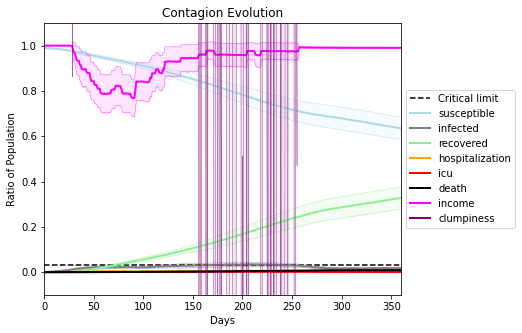

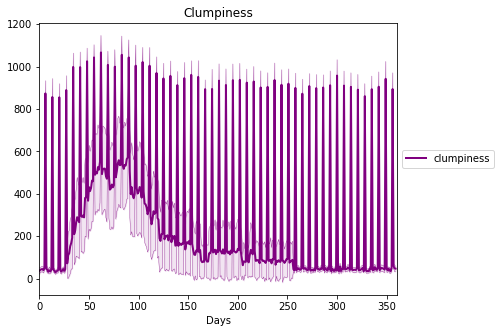

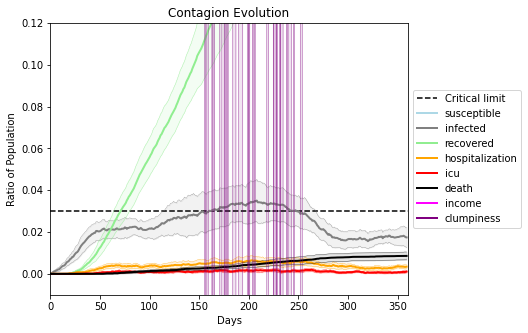

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4770, 9774, 9116, 9667, 9962, 6075, 4175, 9061, 4537, 696, 6081, 1014, 6700, 1186, 7190, 6129, 2409, 1305, 1784, 2048]
Average similarity between family members is 0.17996236766851312 at temperature 0
Average similarity between family and home is 0.9998546151042947 at temperature -1
Average similarity between students and their classroom is 0.19210891400761623 at temperature 0
Average classroom occupancy is 1.5028901734104045 and number classrooms is 173
Average similarity between workers is 0.1633932323899862 at temperature 0
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults: 0.20822724536891596 for kids: 0.2092976775642225
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.036097797194601405
avg restaurant similarity 0.0034983690804274007
avg restaurant similarity 0.025106376309599825
avg restaurant similarity 0.015407369480834914
avg restaurant similarity 0.026898663535340928
avg restaurant similarity 0.05406541692620224
avg restaurant similarity 0.07136176252036024
avg restaurant similarity 0.051251138203108636
avg restaurant similarity 0.047316133343098345
avg restaurant similarity 0.05407465872570534
avg restaurant similarity 0.058040920421731666
avg restaurant similarity -0.005300687121012943
avg restaurant similarity 0.0021582106140463964
avg restaurant similarity 0.02041104030285929
avg restaurant similarity -0.008839633911708935
avg restaurant similarity 0.07231024316675494
avg restaurant similarity 0.04676370413135147
avg restaurant similarity 0.029409233989414914
avg restaurant similarity 0.0443312249209468
avg restaurant similarity 0.05154584559793385
avg restaurant similarity 0.03507454394739137
avg restaurant simi

avg restaurant similarity 0.023176104401992727
avg restaurant similarity 0.0515896080450515
avg restaurant similarity 0.0652643929074132
avg restaurant similarity 0.0027712619430616094
avg restaurant similarity 0.05503192994413026
avg restaurant similarity 0.04860310102280342
avg restaurant similarity 0.04498472974537624
avg restaurant similarity 0.0027942134751003846
avg restaurant similarity 0.003033368712610086
avg restaurant similarity 0.048546305506080634
avg restaurant similarity 0.0362687780607345
avg restaurant similarity 0.03293102547928625
avg restaurant similarity 0.03916449642938612
avg restaurant similarity 0.03989113968236329
avg restaurant similarity 0.07425133453514526
avg restaurant similarity 0.04243666402152459
avg restaurant similarity 0.047128772516737104
avg restaurant similarity 0.05909598456614077
avg restaurant similarity 0.008642454708289124
avg restaurant similarity 0.017704041480692424
avg restaurant similarity 0.06805364914693965
avg restaurant similarity 0

avg restaurant similarity -0.010588444654023204
avg restaurant similarity 0.025854488987027326
avg restaurant similarity 0.046786328480447816
avg restaurant similarity 0.03257333223836394
avg restaurant similarity 0.06814378694524509
avg restaurant similarity 0.07826661165673553
Average similarity between family members is 0.15802141902387226 at temperature 0
Average similarity between family and home is 0.9998549450145388 at temperature -1
Average similarity between students and their classroom is 0.1557117884886732 at temperature 0
Average classroom occupancy is 1.6333333333333333 and number classrooms is 180
Average similarity between workers is 0.1404059988400986 at temperature 0
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.20402568875342775 for kids: 0.20728871064196147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a tot

avg restaurant similarity 0.07722803236172084
avg restaurant similarity 0.06753409628425608
avg restaurant similarity 0.05666131983497098
avg restaurant similarity 0.04524377073803629
avg restaurant similarity 0.07838729098233552
avg restaurant similarity 0.03152993772279448
avg restaurant similarity 0.048622607737747105
avg restaurant similarity 0.04419084735971082
avg restaurant similarity 0.06562960720493814
avg restaurant similarity 0.07998858010172964
avg restaurant similarity 0.031801876050085234
avg restaurant similarity 0.055211324593510545
avg restaurant similarity 0.0729622114046853
avg restaurant similarity 0.04697459079252515
avg restaurant similarity 0.05187749105893958
avg restaurant similarity 0.11589198675544124
avg restaurant similarity 0.06772431274136144
avg restaurant similarity 0.10994235721903983
avg restaurant similarity 0.07269292025884931
avg restaurant similarity 0.05847862286183944
avg restaurant similarity 0.051846296712967824
avg restaurant similarity 0.033

avg restaurant similarity 0.07760489315146855
avg restaurant similarity 0.030569008978518664
avg restaurant similarity 0.07151313575484002
avg restaurant similarity 0.02838169041003393
avg restaurant similarity 0.019268764244326716
avg restaurant similarity 0.04957083947278686
avg restaurant similarity 0.03805877192697941
avg restaurant similarity 0.07342272095993198
avg restaurant similarity 0.05120695920036208
avg restaurant similarity 0.08533661370406108
avg restaurant similarity 0.024414281583367985
avg restaurant similarity 0.018245156634996897
avg restaurant similarity 0.07203717294126741
avg restaurant similarity 0.05503617601537497
avg restaurant similarity 0.06410282157560353
avg restaurant similarity 0.0924612741701752
avg restaurant similarity 0.04710969578284921
avg restaurant similarity 0.07454238018013339
avg restaurant similarity 0.07397336708577022
avg restaurant similarity -0.003282059191939102
avg restaurant similarity -0.0003291950656164578
avg restaurant similarity 

avg restaurant similarity 0.05575513125868539
avg restaurant similarity 0.11373678554734515
avg restaurant similarity 0.0276923633401454
avg restaurant similarity 0.02130667629519715
Average similarity between family members is 0.14528198752260493 at temperature 0
Average similarity between family and home is 0.9998573132747856 at temperature -1
Average similarity between students and their classroom is 0.1697117450128532 at temperature 0
Average classroom occupancy is 1.5932203389830508 and number classrooms is 177
Average similarity between workers is 0.1480461952403531 at temperature 0
Average office occupancy is 3.2610837438423643 and number offices is 203
Average friend similarity for adults: 0.2105227127604717 for kids: 0.2120696476976377
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.0748500905220384
avg restaurant similarity 0.09813222946578376
avg restaurant similarity 0.06796258176403171
avg restaurant similarity 0.06407750048633984
avg restaurant similarity 0.06565631152694675
avg restaurant similarity 0.0997724183228492
avg restaurant similarity 0.06603801137023946
avg restaurant similarity 0.07548670697615256
avg restaurant similarity 0.03242428602585418
avg restaurant similarity 0.06802292085106046
avg restaurant similarity 0.05807742709444855
avg restaurant similarity 0.053559582028861075
avg restaurant similarity 0.09213471365971156
avg restaurant similarity 0.04334442436996702
avg restaurant similarity 0.05663435608638685
avg restaurant similarity 0.07526519059918384
avg restaurant similarity 0.03750136191492049
avg restaurant similarity 0.0406712371774762
avg restaurant similarity 0.054329156294935135
avg restaurant similarity 0.028768975289833767
avg restaurant similarity 0.09758456545878523
avg restaurant similarity 0.069959

avg restaurant similarity 0.07114342759825841
avg restaurant similarity 0.06871754943409132
avg restaurant similarity 0.043211988312990224
avg restaurant similarity 0.10161563246529252
avg restaurant similarity 0.04896711693698976
avg restaurant similarity 0.04098141152097372
avg restaurant similarity 0.06239295547393083
avg restaurant similarity 0.08284561376074297
avg restaurant similarity 0.0681969851901632
avg restaurant similarity 0.07852835012693334
avg restaurant similarity 0.0899007606842959
avg restaurant similarity 0.010809821946055596
avg restaurant similarity 0.05583203456730278
avg restaurant similarity 0.05301844643441486
avg restaurant similarity 0.08678787573710597
avg restaurant similarity 0.09327881230979049
avg restaurant similarity 0.00985708301111694
avg restaurant similarity 0.09346448659788843
avg restaurant similarity 0.05429013561456388
avg restaurant similarity 0.06077583953050606
avg restaurant similarity 0.05059211330270656
avg restaurant similarity 0.060989

avg restaurant similarity 0.0035058637130942288
avg restaurant similarity 0.07446235892493216
avg restaurant similarity 0.016691831478154673
avg restaurant similarity 0.040151689427077975
Average similarity between family members is 0.1750680712498861 at temperature 0
Average similarity between family and home is 0.9998605577540046 at temperature -1
Average similarity between students and their classroom is 0.17058682702105876 at temperature 0
Average classroom occupancy is 1.627659574468085 and number classrooms is 188
Average similarity between workers is 0.16296833769274263 at temperature 0
Average office occupancy is 3.2160804020100504 and number offices is 199
Average friend similarity for adults: 0.20803903393499 for kids: 0.21224823438724585
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.06570926955730491
avg restaurant similarity 0.03342063071946505
avg restaurant similarity 0.07359700714079544
avg restaurant similarity 0.0746947906549657
avg restaurant similarity 0.07123296367087578
avg restaurant similarity 0.12008406894375688
avg restaurant similarity 0.0925927646135799
avg restaurant similarity 0.07241392506239601
avg restaurant similarity 0.060145384039096916
avg restaurant similarity 0.09802681917872481
avg restaurant similarity 0.10011755794133789
avg restaurant similarity 0.042412372818018206
avg restaurant similarity 0.04774536567696947
avg restaurant similarity 0.05383923335015092
avg restaurant similarity 0.07327073144401153
avg restaurant similarity 0.03691899124097895
avg restaurant similarity 0.07586099470730862
avg restaurant similarity 0.09053516342475454
avg restaurant similarity 0.04582518530982758
avg restaurant similarity 0.06825644883508614
avg restaurant similarity 0.06511494717228239
avg restaurant similarity 0.024372

avg restaurant similarity 0.09582395734753016
avg restaurant similarity 0.08176561618843611
avg restaurant similarity 0.07670850778556144
avg restaurant similarity 0.05315538696416301
avg restaurant similarity 0.050524043450799534
avg restaurant similarity 0.052022525577325174
avg restaurant similarity 0.04471511262607091
avg restaurant similarity 0.04788388247685909
avg restaurant similarity 0.00490087456142248
avg restaurant similarity 0.05022306985124402
avg restaurant similarity 0.023468319126299673
avg restaurant similarity 0.07668181263124334
avg restaurant similarity 0.021654099000231877
avg restaurant similarity 0.06914987377495448
avg restaurant similarity 0.04742999725711892
avg restaurant similarity 0.10442145039677946
avg restaurant similarity 0.04807136399317645
avg restaurant similarity 0.05240309058195715
avg restaurant similarity 0.0343946409805538
avg restaurant similarity 0.021428411670221168
avg restaurant similarity 0.07792227523761631
avg restaurant similarity 0.03

avg restaurant similarity 0.07706081977707163
avg restaurant similarity 0.06704689587200986
Average similarity between family members is 0.1549996330279127 at temperature 0
Average similarity between family and home is 0.9998626274934401 at temperature -1
Average similarity between students and their classroom is 0.1549751052623922 at temperature 0
Average classroom occupancy is 1.5172413793103448 and number classrooms is 174
Average similarity between workers is 0.16250864763655332 at temperature 0
Average office occupancy is 3.4545454545454546 and number offices is 198
Average friend similarity for adults: 0.21087250394832446 for kids: 0.2249355630476907
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units wit

avg restaurant similarity 0.04009178988923992
avg restaurant similarity 0.08829816590099666
avg restaurant similarity 0.06328978990064775
avg restaurant similarity 0.052361460609949256
avg restaurant similarity 0.04149087892155985
avg restaurant similarity 0.06837800841679094
avg restaurant similarity 0.1025228272741115
avg restaurant similarity 0.06566342148557626
avg restaurant similarity 0.058918164136009255
avg restaurant similarity 0.047150205295973455
avg restaurant similarity 0.07713344097096257
avg restaurant similarity 0.029857862784116
avg restaurant similarity 0.08664362293579553
avg restaurant similarity 0.03999851878829994
avg restaurant similarity 0.06378230646405664
avg restaurant similarity 0.0829031377660218
avg restaurant similarity 0.04130703488562514
avg restaurant similarity 0.07504988408328117
avg restaurant similarity 0.08353331691217686
avg restaurant similarity 0.057725635247195754
avg restaurant similarity 0.08284607805244154
avg restaurant similarity 0.071810

avg restaurant similarity 0.05024825694763473
avg restaurant similarity 0.06242128564978246
avg restaurant similarity 0.05884473749515829
avg restaurant similarity 0.054868201929699975
avg restaurant similarity 0.046911043785158944
avg restaurant similarity 0.08700273163437586
avg restaurant similarity 0.0419778192529954
avg restaurant similarity 0.05097170968503686
avg restaurant similarity 0.08482343221878942
avg restaurant similarity 0.09031541183992275
avg restaurant similarity 0.04835312168871674
avg restaurant similarity 0.09403508871869191
avg restaurant similarity 0.008859057501281941
avg restaurant similarity 0.06379444562185516
avg restaurant similarity 0.04273965606684548
avg restaurant similarity 0.06500556268213974
avg restaurant similarity 0.07963372599661726
avg restaurant similarity 0.06183951369203557
avg restaurant similarity 0.07155106772730287
avg restaurant similarity 0.01783939765362166
avg restaurant similarity 0.07577415175176411
avg restaurant similarity 0.0593

avg restaurant similarity 0.03995290617819706
avg restaurant similarity 0.09478954267567632
avg restaurant similarity 0.06522852489159188
avg restaurant similarity 0.0813692652847099
Average similarity between family members is 0.14492632880352369 at temperature 0
Average similarity between family and home is 0.9998586363399049 at temperature -1
Average similarity between students and their classroom is 0.15903409377334807 at temperature 0
Average classroom occupancy is 1.6446700507614214 and number classrooms is 197
Average similarity between workers is 0.16062352720054224 at temperature 0
Average office occupancy is 3.15 and number offices is 200
Average friend similarity for adults: 0.19989635826836197 for kids: 0.20358982580399881
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.038179327816000336
avg restaurant similarity 0.04729556844901562
avg restaurant similarity 0.032012467025838244
avg restaurant similarity 0.05872242157241184
avg restaurant similarity 0.1115579352450581
avg restaurant similarity 0.10223033000411723
avg restaurant similarity 0.06036762438689838
avg restaurant similarity 0.04924355362445912
avg restaurant similarity 0.034801303643666404
avg restaurant similarity 0.0809420736139073
avg restaurant similarity 0.043954833375025974
avg restaurant similarity 0.056059900957955995
avg restaurant similarity 0.05608321841010698
avg restaurant similarity 0.1265436222118213
avg restaurant similarity 0.029892665650274784
avg restaurant similarity 0.07429672225528468
avg restaurant similarity 0.06313876003356288
avg restaurant similarity 0.09483118482219599
avg restaurant similarity 0.07145937965787039
avg restaurant similarity 0.08010592026633123
avg restaurant similarity 0.06364765890362199
avg restaurant similarity 0.070

avg restaurant similarity 0.0568472509821627
avg restaurant similarity 0.06276345177153995
avg restaurant similarity 0.1049794176528314
avg restaurant similarity 0.01696749891742417
avg restaurant similarity 0.05840785350655802
avg restaurant similarity 0.033834159474602436
avg restaurant similarity 0.060681790535266726
avg restaurant similarity 0.05731473954675196
avg restaurant similarity 0.04399988601867469
avg restaurant similarity 0.07025200602387054
avg restaurant similarity 0.08418493925540678
avg restaurant similarity 0.07111929674867579
avg restaurant similarity 0.07363913749697847
avg restaurant similarity 0.05754236031587505
avg restaurant similarity 0.0175933821597742
avg restaurant similarity 0.02875004560148264
avg restaurant similarity 0.05699266512507596
avg restaurant similarity 0.07620334747051359
avg restaurant similarity 0.08503351764048604
avg restaurant similarity 0.09364045942750476
avg restaurant similarity -0.005232657417115693
avg restaurant similarity 0.03011

avg restaurant similarity 0.01886035114502562
avg restaurant similarity 0.042375452414688104
avg restaurant similarity 0.020063006015628986
avg restaurant similarity 0.07969091184901138
Average similarity between family members is 0.15049277504635983 at temperature 0
Average similarity between family and home is 0.9998568698465996 at temperature -1
Average similarity between students and their classroom is 0.1738012428935254 at temperature 0
Average classroom occupancy is 1.6363636363636365 and number classrooms is 187
Average similarity between workers is 0.162620469988046 at temperature 0
Average office occupancy is 3.147783251231527 and number offices is 203
Average friend similarity for adults: 0.20919586877424168 for kids: 0.20602473955957998
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.05017737515997194
avg restaurant similarity 0.04306347176430691
avg restaurant similarity 0.021417664043948015
avg restaurant similarity 0.09383508707025787
avg restaurant similarity 0.07794982300361035
avg restaurant similarity 0.05142805095465093
avg restaurant similarity 0.04845384852065104
avg restaurant similarity 0.07850608521369037
avg restaurant similarity 0.06528317080200147
avg restaurant similarity -0.005745004012802899
avg restaurant similarity 0.0790808346495767
avg restaurant similarity 0.026278055336717482
avg restaurant similarity 0.04463330050272
avg restaurant similarity 0.05949321898727702
avg restaurant similarity 0.0036487437526019164
avg restaurant similarity 0.037782034360548646
avg restaurant similarity 0.03130356702927543
avg restaurant similarity 0.054787457537778535
avg restaurant similarity 0.06235910538807262
avg restaurant similarity 0.05185916207747055
avg restaurant similarity 0.058031680126157066
avg restaurant similarity 0.0

avg restaurant similarity 0.027368034959942233
avg restaurant similarity 0.021889041794224854
avg restaurant similarity 0.051022861628409966
avg restaurant similarity 0.0837092177431288
avg restaurant similarity 0.05370173994051923
avg restaurant similarity 0.027740043749119165
avg restaurant similarity 0.02427470274526925
avg restaurant similarity 0.02617369361501411
avg restaurant similarity 0.045422182622693576
avg restaurant similarity 0.008948763804457523
avg restaurant similarity 0.04369323457086602
avg restaurant similarity 0.07161097155544982
avg restaurant similarity 0.08136427929861134
avg restaurant similarity 0.047772370161541254
avg restaurant similarity 0.08145412815801069
avg restaurant similarity 0.051132779593362675
avg restaurant similarity -0.004333181278434229
avg restaurant similarity 0.05540561668209297
avg restaurant similarity 0.06117494233139528
avg restaurant similarity 0.045565816351573085
avg restaurant similarity 0.09474152297244823
avg restaurant similarit

avg restaurant similarity 0.05377087163874385
avg restaurant similarity -0.011051406181052072
avg restaurant similarity -0.0015883427213234636
avg restaurant similarity 0.04309981329964861
avg restaurant similarity 0.10244310268509814
avg restaurant similarity 0.023951774555073625
Average similarity between family members is 0.1377198553259958 at temperature 0
Average similarity between family and home is 0.9998499425143201 at temperature -1
Average similarity between students and their classroom is 0.2176295238847359 at temperature 0
Average classroom occupancy is 1.4593023255813953 and number classrooms is 172
Average similarity between workers is 0.12897609683878128 at temperature 0
Average office occupancy is 3.4824120603015074 and number offices is 199
Average friend similarity for adults: 0.2081549945911981 for kids: 0.20982672017785794
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a t

avg restaurant similarity 0.04828194888748629
avg restaurant similarity 0.04765668306432957
avg restaurant similarity 0.07172032190880165
avg restaurant similarity 0.04122697434240597
avg restaurant similarity 0.02706139038457177
avg restaurant similarity 0.03504974201769365
avg restaurant similarity 0.062005158036572854
avg restaurant similarity 0.0462460581117901
avg restaurant similarity 0.06605390895332668
avg restaurant similarity 0.08621053381540078
avg restaurant similarity 0.03854295896740101
avg restaurant similarity 0.06523061478936563
avg restaurant similarity 0.061289583629988084
avg restaurant similarity 0.05278724115132224
avg restaurant similarity 0.0590004149390441
avg restaurant similarity 0.02694945161983115
avg restaurant similarity 0.05035051191229847
avg restaurant similarity 0.005519900550097699
avg restaurant similarity 0.06710444410814728
avg restaurant similarity 0.08681725856730144
avg restaurant similarity 0.03892761438766175
avg restaurant similarity 0.05001

avg restaurant similarity 0.062256378881233095
avg restaurant similarity 0.07615799564513151
avg restaurant similarity 0.04218856565769854
avg restaurant similarity 0.05045826834691029
avg restaurant similarity 0.054449064779646304
avg restaurant similarity 0.057777128109645325
avg restaurant similarity 0.03075493310648299
avg restaurant similarity 0.044687812786713625
avg restaurant similarity 0.055153856645781124
avg restaurant similarity 0.045721556910838825
avg restaurant similarity 0.07193591029296281
avg restaurant similarity -0.03239330959051631
avg restaurant similarity 0.05967596552069521
avg restaurant similarity 0.004789887188427562
avg restaurant similarity 0.05282187749991306
avg restaurant similarity 0.05730401893027805
avg restaurant similarity 0.09788391605554211
avg restaurant similarity 0.05745912662286682
avg restaurant similarity 0.03750246822832745
avg restaurant similarity 0.06767017493317762
avg restaurant similarity 0.08542904893159042
avg restaurant similarity 

avg restaurant similarity 0.04912478169419316
avg restaurant similarity 0.034769186371748355
avg restaurant similarity 0.04990779046653694
avg restaurant similarity 0.04659549606458668
Average similarity between family members is 0.15284282316350686 at temperature 0
Average similarity between family and home is 0.9998508181552208 at temperature -1
Average similarity between students and their classroom is 0.17089191184026337 at temperature 0
Average classroom occupancy is 1.6627218934911243 and number classrooms is 169
Average similarity between workers is 0.17693090236237444 at temperature 0
Average office occupancy is 3.2755102040816326 and number offices is 196
Average friend similarity for adults: 0.2157197770280401 for kids: 0.2086870517634232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.09057605030879007
avg restaurant similarity 0.05021892182559854
avg restaurant similarity 0.08221013404491526
avg restaurant similarity 0.07512460844875468
avg restaurant similarity 0.048854593559198536
avg restaurant similarity 0.06384659634476873
avg restaurant similarity 0.0730842180312783
avg restaurant similarity 0.1109659856494018
avg restaurant similarity 0.06255101695353824
avg restaurant similarity 0.0758482254429001
avg restaurant similarity 0.05645254766930434
avg restaurant similarity 0.07179994084661004
avg restaurant similarity 0.10821067737597809
avg restaurant similarity 0.05242201362344096
avg restaurant similarity 0.05639058997959625
avg restaurant similarity 0.042280897556489117
avg restaurant similarity 0.09442442318199458
avg restaurant similarity 0.050658254090730395
avg restaurant similarity 0.0461872970166722
avg restaurant similarity 0.05942358255769931
avg restaurant similarity 0.053683024241647434
avg restaurant similarity 0.100606

avg restaurant similarity 0.09863271712701942
avg restaurant similarity 0.05653758702951995
avg restaurant similarity 0.06031129977991617
avg restaurant similarity 0.01729045084718891
avg restaurant similarity 0.057001455449059775
avg restaurant similarity 0.05591644579124389
avg restaurant similarity 0.10269578509700983
avg restaurant similarity 0.0850857955649621
avg restaurant similarity 0.09279433095010244
avg restaurant similarity 0.06826006139480506
avg restaurant similarity 0.05798289259147161
avg restaurant similarity 0.051602214186866675
avg restaurant similarity 0.052946605555069415
avg restaurant similarity 0.07521162743501777
avg restaurant similarity 0.08892040435997395
avg restaurant similarity 0.0510601484113289
avg restaurant similarity 0.10777632661986485
avg restaurant similarity 0.08876553915615663
avg restaurant similarity 0.06097869992146028
avg restaurant similarity 0.08341582037453737
avg restaurant similarity 0.07935533624462568
avg restaurant similarity 0.06341

avg restaurant similarity 0.09230420511203816
avg restaurant similarity 0.05150437541065255
Average similarity between family members is 0.15887379953864889 at temperature 0
Average similarity between family and home is 0.9998512503162454 at temperature -1
Average similarity between students and their classroom is 0.143143232203741 at temperature 0
Average classroom occupancy is 1.641025641025641 and number classrooms is 195
Average similarity between workers is 0.14022748675582447 at temperature 0
Average office occupancy is 3.221105527638191 and number offices is 199
Average friend similarity for adults: 0.20233098364283617 for kids: 0.21375970102869518
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wi

avg restaurant similarity 0.04021202706613662
avg restaurant similarity 0.07232632781904212
avg restaurant similarity 0.06674707925080105
avg restaurant similarity 0.049616383162501804
avg restaurant similarity 0.060185537876983185
avg restaurant similarity 0.07430877533706844
avg restaurant similarity 0.04895912233458267
avg restaurant similarity 0.07471243352586711
avg restaurant similarity 0.07908247080865934
avg restaurant similarity 0.05431023852524863
avg restaurant similarity 0.14686656774869342
avg restaurant similarity 0.04553946310627874
avg restaurant similarity 0.039397219572667314
avg restaurant similarity 0.11862269301398719
avg restaurant similarity 0.07271237630511808
avg restaurant similarity 0.0738919011633741
avg restaurant similarity 0.01822902062064537
avg restaurant similarity 0.04788962755603731
avg restaurant similarity 0.023623902022244653
avg restaurant similarity 0.12495468974196265
avg restaurant similarity 0.032273373445943596
avg restaurant similarity -0.0

avg restaurant similarity -0.002142056519016873
avg restaurant similarity 0.042340514293301046
avg restaurant similarity 0.07599019356245887
avg restaurant similarity 0.053814651058717536
avg restaurant similarity 0.05360117945786349
avg restaurant similarity 0.05385052257691548
avg restaurant similarity 0.08349642811523872
avg restaurant similarity 0.0682087524127051
avg restaurant similarity 0.06261206313948862
avg restaurant similarity 0.07820845857155695
avg restaurant similarity 0.006386726232687452
avg restaurant similarity 0.07467818538959635
avg restaurant similarity 0.050546209278278395
avg restaurant similarity 0.06715662659841765
avg restaurant similarity 0.08757876755993109
avg restaurant similarity 0.07131236387019341
avg restaurant similarity 0.011059958250544916
avg restaurant similarity 0.09797437883557389
avg restaurant similarity 0.0982467163435926
avg restaurant similarity 0.0011546682402312353
avg restaurant similarity 0.08190241840562257
avg restaurant similarity 0

avg restaurant similarity 0.09912108222044484
avg restaurant similarity 0.05789611139825787
avg restaurant similarity 0.06680613409965036
avg restaurant similarity 0.09553306721074814
Average similarity between family members is 0.1515764931663963 at temperature 0
Average similarity between family and home is 0.9998543672216312 at temperature -1
Average similarity between students and their classroom is 0.1962116628080868 at temperature 0
Average classroom occupancy is 1.5901639344262295 and number classrooms is 183
Average similarity between workers is 0.14439405548578327 at temperature 0
Average office occupancy is 3.135265700483092 and number offices is 207
Average friend similarity for adults: 0.22002342050547116 for kids: 0.21673888122205684
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.06789980511882171
avg restaurant similarity 0.06354860317473919
avg restaurant similarity 0.11046616137226566
avg restaurant similarity 0.06956612340372362
avg restaurant similarity 0.06577529397768635
avg restaurant similarity 0.03413745287818897
avg restaurant similarity 0.012314986767437518
avg restaurant similarity 0.13739499418038648
avg restaurant similarity 0.0631529413844219
avg restaurant similarity 0.04593814565318531
avg restaurant similarity 0.08047857023916839
avg restaurant similarity 0.08592878384500126
avg restaurant similarity 0.07259231078213955
avg restaurant similarity 0.0896423824244219
avg restaurant similarity 0.04646688175064001
avg restaurant similarity 0.08374520181287141
avg restaurant similarity 0.12641639696582127
avg restaurant similarity 0.06579496363480983
avg restaurant similarity 0.10284656559537497
avg restaurant similarity 0.021323793283612613
avg restaurant similarity 0.0757873603658003
avg restaurant similarity 0.0692681

avg restaurant similarity 0.0930807964350286
avg restaurant similarity 0.10756404769898505
avg restaurant similarity 0.020428873268228467
avg restaurant similarity 0.09685578001850817
avg restaurant similarity 0.06222416308415384
avg restaurant similarity 0.0721141076440774
avg restaurant similarity 0.08298273363863583
avg restaurant similarity 0.10395300028591271
avg restaurant similarity 0.05844693249818674
avg restaurant similarity 0.11708412730722918
avg restaurant similarity 0.08458709291575396
avg restaurant similarity 0.04395519073206516
avg restaurant similarity 0.09522279308368353
avg restaurant similarity 0.1650758012847623
avg restaurant similarity 0.06515154430814178
avg restaurant similarity 0.07327624728715608
avg restaurant similarity 0.05701839166966929
avg restaurant similarity 0.049743443060920725
avg restaurant similarity 0.038585907435041054
avg restaurant similarity 0.04907844995285873
avg restaurant similarity 0.10983934605675146
avg restaurant similarity 0.053957

avg restaurant similarity 0.092076668175239
avg restaurant similarity 0.0670107164595987
Average similarity between family members is 0.17325843757106202 at temperature 0
Average similarity between family and home is 0.9998712202339423 at temperature -1
Average similarity between students and their classroom is 0.1865059840005022 at temperature 0
Average classroom occupancy is 1.6353591160220995 and number classrooms is 181
Average similarity between workers is 0.15741241272718873 at temperature 0
Average office occupancy is 3.2019704433497536 and number offices is 203
Average friend similarity for adults: 0.20444053713438584 for kids: 0.2046933709947403
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.045789281298588634
avg restaurant similarity 0.07728050044735713
avg restaurant similarity 0.04378366655423821
avg restaurant similarity 0.06446959334640572
avg restaurant similarity 0.07052318750960494
avg restaurant similarity 0.07533473687663461
avg restaurant similarity 0.04047107627401971
avg restaurant similarity 0.09739707190172862
avg restaurant similarity 0.04179183016925059
avg restaurant similarity 0.04788094135778491
avg restaurant similarity 0.038791945323580886
avg restaurant similarity 0.07195756739371927
avg restaurant similarity 0.05670359053667477
avg restaurant similarity 0.04243118109474954
avg restaurant similarity 0.06320378404429702
avg restaurant similarity 0.0743080165597593
avg restaurant similarity 0.04393619394105728
avg restaurant similarity 0.0758770044178719
avg restaurant similarity 0.05606653006564713
avg restaurant similarity 0.05370605565451306
avg restaurant similarity 0.0676985094976702
avg restaurant similarity 0.0603183

avg restaurant similarity 0.04305961155525686
avg restaurant similarity 0.06835380520640423
avg restaurant similarity 0.05884842664177761
avg restaurant similarity 0.03805496447089527
avg restaurant similarity 0.06622122760557028
avg restaurant similarity 0.04570539528586105
avg restaurant similarity 0.04502281763390728
avg restaurant similarity 0.053356979575284756
avg restaurant similarity 0.04496723300596442
avg restaurant similarity 0.03291217169267504
avg restaurant similarity 0.09048867864879394
avg restaurant similarity 0.057742006650352846
avg restaurant similarity 0.06377491612944036
avg restaurant similarity 0.05747172601337516
avg restaurant similarity 0.06144655657000883
avg restaurant similarity 0.10248621000572418
avg restaurant similarity 0.058057157580857
avg restaurant similarity 0.023295333323005624
avg restaurant similarity 0.07073048747980488
avg restaurant similarity 0.07516480870466079
avg restaurant similarity 0.07726343605655393
avg restaurant similarity 0.07472

avg restaurant similarity 0.04743772426355018
avg restaurant similarity 0.05696146348611001
avg restaurant similarity 0.06636866098204067
Average similarity between family members is 0.1265232076829191 at temperature 0
Average similarity between family and home is 0.9998542442214811 at temperature -1
Average similarity between students and their classroom is 0.1745276439278336 at temperature 0
Average classroom occupancy is 1.5919540229885059 and number classrooms is 174
Average similarity between workers is 0.13588984334544826 at temperature 0
Average office occupancy is 3.3959390862944163 and number offices is 197
Average friend similarity for adults: 0.20612841724691847 for kids: 0.2103529273745573
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with

avg restaurant similarity 0.09815280336316394
avg restaurant similarity 0.049648067333356194
avg restaurant similarity 0.061905331940947245
avg restaurant similarity 0.10848169706105537
avg restaurant similarity 0.07193341380242123
avg restaurant similarity 0.09979086386824187
avg restaurant similarity 0.07993221059238584
avg restaurant similarity 0.05869791111088466
avg restaurant similarity 0.053984863831589715
avg restaurant similarity 0.046491145845362396
avg restaurant similarity 0.09030792292655034
avg restaurant similarity 0.0661308742077389
avg restaurant similarity 0.05356413569445229
avg restaurant similarity 0.125156414007433
avg restaurant similarity 0.05105128928993212
avg restaurant similarity 0.07405082685011967
avg restaurant similarity 0.033031692434096406
avg restaurant similarity 0.03267011593057468
avg restaurant similarity 0.04018135400170788
avg restaurant similarity 0.08559281762174832
avg restaurant similarity 0.0957041056588852
avg restaurant similarity 0.08838

avg restaurant similarity 0.022670620623921084
avg restaurant similarity 0.10123798816794101
avg restaurant similarity 0.06284451633365473
avg restaurant similarity 0.0848979202118983
avg restaurant similarity 0.0827849156237338
avg restaurant similarity 0.09662246466013935
avg restaurant similarity 0.05504960585095391
avg restaurant similarity 0.04528525080559877
avg restaurant similarity 0.09662841514084215
avg restaurant similarity 0.08594514704895558
avg restaurant similarity 0.07914055768906293
avg restaurant similarity 0.06824211000041996
avg restaurant similarity 0.0016510568115198766
avg restaurant similarity 0.08213281227783573
avg restaurant similarity 0.08604062848625225
avg restaurant similarity 0.14238043006097656
avg restaurant similarity 0.07293226198430708
avg restaurant similarity 0.0648794798013571
avg restaurant similarity 0.031035475032762862
avg restaurant similarity 0.050835275189362476
avg restaurant similarity 0.05915943264858427
avg restaurant similarity 0.0628

avg restaurant similarity 0.09124733473425967
avg restaurant similarity 0.10862148841668168
avg restaurant similarity 0.11967368128235693
Average similarity between family members is 0.16572543928916986 at temperature 0
Average similarity between family and home is 0.9998599010871643 at temperature -1
Average similarity between students and their classroom is 0.18566292519997035 at temperature 0
Average classroom occupancy is 1.6436170212765957 and number classrooms is 188
Average similarity between workers is 0.15981708558884697 at temperature 0
Average office occupancy is 3.116504854368932 and number offices is 206
Average friend similarity for adults: 0.21013952236686761 for kids: 0.21720433354040503
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.0760552297397511
avg restaurant similarity 0.050558629614807934
avg restaurant similarity 0.07853853126193905
avg restaurant similarity 0.1038954683088965
avg restaurant similarity 0.1318662437705921
avg restaurant similarity 0.057097413298704845
avg restaurant similarity 0.054173401331620345
avg restaurant similarity 0.07138306262537272
avg restaurant similarity 0.04201934959827539
avg restaurant similarity 0.08591907383325623
avg restaurant similarity 0.10059057506950257
avg restaurant similarity 0.08905163428682172
avg restaurant similarity 0.07351672818854575
avg restaurant similarity 0.08597237637649406
avg restaurant similarity 0.09786003104234207
avg restaurant similarity 0.09392525502474805
avg restaurant similarity 0.06084555316906773
avg restaurant similarity 0.052910860899819834
avg restaurant similarity 0.0995138086208153
avg restaurant similarity 0.11534379574764438
avg restaurant similarity 0.09579295042795077
avg restaurant similarity 0.047752

avg restaurant similarity 0.1067218348652204
avg restaurant similarity 0.08375496676705362
avg restaurant similarity 0.07610235977343364
avg restaurant similarity 0.12735610652798635
avg restaurant similarity 0.10201434632295149
avg restaurant similarity 0.05953516804553581
avg restaurant similarity 0.08576436321457406
avg restaurant similarity 0.010838179572437342
avg restaurant similarity 0.09403295535472538
avg restaurant similarity 0.09815873949897783
avg restaurant similarity 0.04608077111736802
avg restaurant similarity 0.07926412327425966
avg restaurant similarity 0.045370024277605475
avg restaurant similarity 0.04845460551694634
avg restaurant similarity 0.0935943439308943
avg restaurant similarity 0.10140076147781381
avg restaurant similarity 0.12515619426963792
avg restaurant similarity 0.029313618447841305
avg restaurant similarity 0.0704987635819729
avg restaurant similarity 0.10509821944819177
avg restaurant similarity 0.08696481353566703
avg restaurant similarity 0.099378

avg restaurant similarity 0.0885808472169666
avg restaurant similarity 0.10779774629790817
Average similarity between family members is 0.14522353695286708 at temperature 0
Average similarity between family and home is 0.9998497636708087 at temperature -1
Average similarity between students and their classroom is 0.1617035593454861 at temperature 0
Average classroom occupancy is 1.7241379310344827 and number classrooms is 174
Average similarity between workers is 0.1929933149138655 at temperature 0
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.2134056860013646 for kids: 0.20538570261639508
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units wi

avg restaurant similarity 0.06753176231053028
avg restaurant similarity 0.05736036036184426
avg restaurant similarity 0.06705782114150077
avg restaurant similarity 0.07887088535654092
avg restaurant similarity 0.049132659514756316
avg restaurant similarity 0.05356074890328665
avg restaurant similarity 0.05076803857090329
avg restaurant similarity 0.02753716687780359
avg restaurant similarity 0.09941845437398113
avg restaurant similarity 0.06080462995822986
avg restaurant similarity 0.052064794881876576
avg restaurant similarity 0.08216107979507406
avg restaurant similarity 0.07846384915934708
avg restaurant similarity 0.051660333585295995
avg restaurant similarity 0.050425973585123796
avg restaurant similarity 0.0679268395058603
avg restaurant similarity 0.05788836476877822
avg restaurant similarity 0.04846166776340042
avg restaurant similarity 0.06714086300144458
avg restaurant similarity 0.061221003120349234
avg restaurant similarity 0.04136406369634695
avg restaurant similarity 0.07

avg restaurant similarity 0.07017602409688962
avg restaurant similarity 0.0828510451973767
avg restaurant similarity 0.02462705826047747
avg restaurant similarity 0.08110397889990174
avg restaurant similarity 0.09818168619473257
avg restaurant similarity 0.11371714380648351
avg restaurant similarity 0.0618151252153464
avg restaurant similarity 0.04373572743518715
avg restaurant similarity 0.07432824026914785
avg restaurant similarity 0.05399822423765165
avg restaurant similarity 0.06484307081689733
avg restaurant similarity 0.05745925273930274
avg restaurant similarity 0.05279174291318111
avg restaurant similarity 0.05470098859808104
avg restaurant similarity 0.08911991193652609
avg restaurant similarity 0.06091881076646297
avg restaurant similarity 0.05163439504834355
avg restaurant similarity 0.07237607117931301
avg restaurant similarity 0.043768325074700215
avg restaurant similarity 0.041084401069931685
avg restaurant similarity 0.05232528682712437
avg restaurant similarity 0.032316

avg restaurant similarity 0.027382147278176443
avg restaurant similarity 0.08453257744668671
avg restaurant similarity 0.06716724290142319
avg restaurant similarity 0.05229396798799724
Average similarity between family members is 0.14241246324357937 at temperature 0
Average similarity between family and home is 0.9998426543097209 at temperature -1
Average similarity between students and their classroom is 0.16581200275839555 at temperature 0
Average classroom occupancy is 1.639344262295082 and number classrooms is 183
Average similarity between workers is 0.16356270616297905 at temperature 0
Average office occupancy is 3.1959798994974875 and number offices is 199
Average friend similarity for adults: 0.21403910968597611 for kids: 0.21146569570102794
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1

avg restaurant similarity 0.024802657147356594
avg restaurant similarity 0.01894086699491022
avg restaurant similarity 0.00445481919466266
avg restaurant similarity 0.061921395917412025
avg restaurant similarity 0.029467558190329816
avg restaurant similarity 0.04587244539687479
avg restaurant similarity 0.019296309238163414
avg restaurant similarity 0.04554178008149698
avg restaurant similarity 0.10850228665568051
avg restaurant similarity 0.014590260960808222
avg restaurant similarity 0.07212998750538636
avg restaurant similarity 0.042550560212570705
avg restaurant similarity 0.07831887545934563
avg restaurant similarity -0.00212196143712799
avg restaurant similarity 0.044034827716884585
avg restaurant similarity 0.02678160164070631
avg restaurant similarity 0.0484105650383351
avg restaurant similarity 0.023041910053460277
avg restaurant similarity 0.03361381706101834
avg restaurant similarity 0.0761974916545125
avg restaurant similarity 0.07293612655608907
avg restaurant similarity 0

avg restaurant similarity 0.03621240822177561
avg restaurant similarity 0.04929061728933032
avg restaurant similarity 0.05791152339172675
avg restaurant similarity 0.0743527326545385
avg restaurant similarity 0.05310705202496737
avg restaurant similarity 0.028893371710170958
avg restaurant similarity 0.08009337213161741
avg restaurant similarity 0.02320110083269962
avg restaurant similarity -0.0003937673008607138
avg restaurant similarity 0.05859169354415495
avg restaurant similarity 0.02892346343516307
avg restaurant similarity 0.06502879436273595
avg restaurant similarity 0.04559574341070509
avg restaurant similarity 0.06198556900774978
avg restaurant similarity 0.0828811318814024
avg restaurant similarity 0.10886527863134293
avg restaurant similarity 0.03398567470504042
avg restaurant similarity 0.0685041007504698
avg restaurant similarity 0.04523702955773411
avg restaurant similarity 0.0833639085163117
avg restaurant similarity 0.05279086962379941
avg restaurant similarity 0.081582

avg restaurant similarity 0.06177556882132568
avg restaurant similarity 0.06769546921520618
avg restaurant similarity 0.06577007660149313
avg restaurant similarity 0.04170099531601042
Average similarity between family members is 0.13238200196867791 at temperature 0
Average similarity between family and home is 0.9998480033867445 at temperature -1
Average similarity between students and their classroom is 0.13742590692601012 at temperature 0
Average classroom occupancy is 1.6206896551724137 and number classrooms is 174
Average similarity between workers is 0.15174209510977857 at temperature 0
Average office occupancy is 3.308457711442786 and number offices is 201
Average friend similarity for adults: 0.2049358464545204 for kids: 0.20561299944850236
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.06606209285133645
avg restaurant similarity 0.014430857425361756
avg restaurant similarity 0.025822148839321966
avg restaurant similarity 0.04494148559665347
avg restaurant similarity 0.07679648030901721
avg restaurant similarity 0.09519222794709878
avg restaurant similarity 0.07821362308210626
avg restaurant similarity 0.0567857262436651
avg restaurant similarity 0.07318157299401713
avg restaurant similarity 0.05165915128705574
avg restaurant similarity 0.02247567062833712
avg restaurant similarity 0.1009431533638999
avg restaurant similarity 0.0335775566560955
avg restaurant similarity 0.10757186697935686
avg restaurant similarity 0.05357031602493739
avg restaurant similarity 0.05573592707746503
avg restaurant similarity 0.07283069741201449
avg restaurant similarity 0.07912140052048172
avg restaurant similarity 0.07994002061345898
avg restaurant similarity 0.08494640439815347
avg restaurant similarity 0.03902246531636465
avg restaurant similarity 0.0546489

avg restaurant similarity 0.05426804500449947
avg restaurant similarity 0.02425632520119611
avg restaurant similarity 0.07253416830761995
avg restaurant similarity 0.10044884568336689
avg restaurant similarity 0.06750448752192428
avg restaurant similarity 0.08424627617655125
avg restaurant similarity 0.1145107224947621
avg restaurant similarity 0.07115713713625207
avg restaurant similarity 0.02888086903425936
avg restaurant similarity 0.06637351069174333
avg restaurant similarity 0.02396910348996442
avg restaurant similarity 0.11868403199133978
avg restaurant similarity 0.04779492553137137
avg restaurant similarity 0.07607136128194403
avg restaurant similarity 0.025580640189044095
avg restaurant similarity 0.08713663875518896
avg restaurant similarity 0.034114127080384776
avg restaurant similarity 0.03322518548892796
avg restaurant similarity 0.05383625626350088
avg restaurant similarity 0.07134278714568754
avg restaurant similarity 0.029038322801949172
avg restaurant similarity 0.0440

avg restaurant similarity 0.04770418637728093
avg restaurant similarity 0.0072396224264675135
avg restaurant similarity 0.03065064187545024
avg restaurant similarity 0.11103898398269632
Average similarity between family members is 0.1395438353088325 at temperature 0
Average similarity between family and home is 0.9998573539507352 at temperature -1
Average similarity between students and their classroom is 0.17891442732694907 at temperature 0
Average classroom occupancy is 1.5934065934065933 and number classrooms is 182
Average similarity between workers is 0.14923003555100423 at temperature 0
Average office occupancy is 3.217821782178218 and number offices is 202
Average friend similarity for adults: 0.21268533075239732 for kids: 0.21146620364095856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.04077188257502032
avg restaurant similarity 0.04694563062530303
avg restaurant similarity 0.058364639208465484
avg restaurant similarity 0.07018345507392523
avg restaurant similarity 0.0710290774913578
avg restaurant similarity 0.016050045652849763
avg restaurant similarity 0.06351505716687797
avg restaurant similarity 0.10260433027921652
avg restaurant similarity 0.08335804657174072
avg restaurant similarity 0.018456044406418445
avg restaurant similarity 0.03474480275294181
avg restaurant similarity 0.013802433806909417
avg restaurant similarity 0.03122520819647527
avg restaurant similarity 0.09110919674816609
avg restaurant similarity 0.08403526851664435
avg restaurant similarity 0.09020063153560119
avg restaurant similarity 0.0731037770304447
avg restaurant similarity 0.08061142760357286
avg restaurant similarity 0.11444499412004167
avg restaurant similarity 0.07782029176720408
avg restaurant similarity 0.055128866154042507
avg restaurant similarity 0.011

avg restaurant similarity 0.06131078886900715
avg restaurant similarity 0.05545307680047982
avg restaurant similarity 0.10384494289486572
avg restaurant similarity 0.029380371425097338
avg restaurant similarity 0.09510792595047805
avg restaurant similarity 0.03735366339404454
avg restaurant similarity 0.08283110565398139
avg restaurant similarity 0.10372706159457723
avg restaurant similarity 0.06865256104447823
avg restaurant similarity 0.028241455625050375
avg restaurant similarity 0.035784248034888784
avg restaurant similarity 0.0717519694604585
avg restaurant similarity 0.05379082347642841
avg restaurant similarity 0.090285851705683
avg restaurant similarity 0.05494109109693044
avg restaurant similarity 0.08701348294960402
avg restaurant similarity 0.015863097898596704
avg restaurant similarity 0.014592810258310648
avg restaurant similarity 0.050993385662985086
avg restaurant similarity 0.06416473216278114
avg restaurant similarity 0.047674647678807865
avg restaurant similarity 0.05

avg restaurant similarity 0.07377865169583708
avg restaurant similarity 0.04326890220410454
avg restaurant similarity 0.05292489663820489
avg restaurant similarity 0.008174028757252516
Average similarity between family members is 0.14245257349754903 at temperature 0
Average similarity between family and home is 0.9998517807528284 at temperature -1
Average similarity between students and their classroom is 0.19525079383397487 at temperature 0
Average classroom occupancy is 1.690217391304348 and number classrooms is 184
Average similarity between workers is 0.14480214533093272 at temperature 0
Average office occupancy is 3.0686274509803924 and number offices is 204
Average friend similarity for adults: 0.2022030474815809 for kids: 0.2120250888625876
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.10736753906840565
avg restaurant similarity 0.06833294673669606
avg restaurant similarity 0.0840273690768308
avg restaurant similarity 0.07495939203407578
avg restaurant similarity 0.07004787857710544
avg restaurant similarity 0.09718874844578522
avg restaurant similarity 0.05312244012173604
avg restaurant similarity 0.05178111230544899
avg restaurant similarity 0.05308260451490808
avg restaurant similarity 0.06556175593668997
avg restaurant similarity 0.04617059428042007
avg restaurant similarity 0.09847629951927346
avg restaurant similarity 0.04521812648842944
avg restaurant similarity 0.07713794149207102
avg restaurant similarity 0.08519977985088424
avg restaurant similarity 0.09309192890561421
avg restaurant similarity 0.03146171425498491
avg restaurant similarity 0.07986577455831693
avg restaurant similarity 0.0901062208492103
avg restaurant similarity 0.04247136790242459
avg restaurant similarity 0.06009466541288143
avg restaurant similarity 0.10375806

avg restaurant similarity 0.05674604686160816
avg restaurant similarity 0.0653390124963093
avg restaurant similarity 0.07750696194505234
avg restaurant similarity 0.07865980419384888
avg restaurant similarity 0.06406802826255781
avg restaurant similarity 0.09882371262572677
avg restaurant similarity 0.04440706658539427
avg restaurant similarity 0.10532596846111592
avg restaurant similarity 0.0628268734032536
avg restaurant similarity 0.046960237755298125
avg restaurant similarity 0.06917043985256188
avg restaurant similarity 0.08331139552170397
avg restaurant similarity 0.08246870453384028
avg restaurant similarity 0.09282732345955878
avg restaurant similarity 0.04268686115782231
avg restaurant similarity 0.08041607877740378
avg restaurant similarity 0.030397075198280166
avg restaurant similarity 0.06457882846335715
avg restaurant similarity 0.07894622406608845
avg restaurant similarity 0.10532631908024138
avg restaurant similarity 0.0925205131114055
avg restaurant similarity 0.0583307

avg restaurant similarity 0.06495505397933342
avg restaurant similarity 0.11000077638367323
avg restaurant similarity 0.06568830276007454
avg restaurant similarity 0.05235299711600282
Average similarity between family members is 0.15616961383466835 at temperature 0
Average similarity between family and home is 0.9998594269652238 at temperature -1
Average similarity between students and their classroom is 0.19069298327877826 at temperature 0
Average classroom occupancy is 1.6327683615819208 and number classrooms is 177
Average similarity between workers is 0.1547741697202515 at temperature 0
Average office occupancy is 3.401015228426396 and number offices is 197
Average friend similarity for adults: 0.2053217641921895 for kids: 0.22074072214069446
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.046812165731924475
avg restaurant similarity 0.07726069904376597
avg restaurant similarity 0.06181261428325069
avg restaurant similarity 0.03810649181664364
avg restaurant similarity 0.052520693084439234
avg restaurant similarity 0.047158039849810235
avg restaurant similarity 0.023639405006611436
avg restaurant similarity 0.05116645166817422
avg restaurant similarity 0.034449831611035285
avg restaurant similarity 0.03595672255820249
avg restaurant similarity 0.04272501675460685
avg restaurant similarity 0.07889024908638821
avg restaurant similarity 0.05935308321909955
avg restaurant similarity 0.03856183136988187
avg restaurant similarity 0.09969746032469216
avg restaurant similarity 0.092997271394156
avg restaurant similarity 0.04570638029767511
avg restaurant similarity 0.05560896474846426
avg restaurant similarity 0.05853533442663666
avg restaurant similarity 0.07238956066176061
avg restaurant similarity 0.05276499084452159
avg restaurant similarity 0.069

avg restaurant similarity 0.050367294540108354
avg restaurant similarity 0.02015243394826579
avg restaurant similarity 0.09600098454564963
avg restaurant similarity 0.007833848014035963
avg restaurant similarity 0.06243505097164087
avg restaurant similarity 0.06240546640214534
avg restaurant similarity 0.054955933047908946
avg restaurant similarity 0.08510432911880209
avg restaurant similarity 0.009426670214588439
avg restaurant similarity 0.0697314994994781
avg restaurant similarity 0.04803093727109046
avg restaurant similarity 0.044760441470576076
avg restaurant similarity 0.06919630196213925
avg restaurant similarity 0.08401551868290105
avg restaurant similarity 0.10148096761987876
avg restaurant similarity 0.062040013605886624
avg restaurant similarity 0.05375756460698688
avg restaurant similarity 0.03569393463856444
avg restaurant similarity 0.04840005010053923
avg restaurant similarity 0.05637426293591929
avg restaurant similarity 0.04673425365351238
avg restaurant similarity 0.0

avg restaurant similarity 0.0670388829233485
avg restaurant similarity 0.10435189662011342
avg restaurant similarity 0.07503845086024528
avg restaurant similarity 0.08458570448741361
using average of time series:
stats on susceptible:
data: [0.7270805555555556, 0.8214638888888888, 0.8198555555555554, 0.8450111111111109, 0.8739166666666667, 0.8694555555555556, 0.9080750000000001, 0.8244138888888889, 0.7342166666666666, 0.8072694444444444, 0.8149666666666667, 0.7644799644799646, 0.8146936396936397, 0.8142694444444445, 0.8134722222222223, 0.8112388888888888, 0.7977944444444445, 0.7722583333333333, 0.7916555555555556, 0.8365666666666667]
min:
0.7270805555555556
max:
0.9080750000000001
std:
0.04248555815980083
mean:
0.813107707986458
median:
0.8144815420690421
95% confidence interval for the mean:
(0.79270730496147,0.8335081110114461)
using average of time series:
stats on infected:
data: [0.03594166666666666, 0.018894444444444446, 0.021175, 0.018199999999999997, 0.015224999999999999, 0.016

(<function dict.items>, <function dict.items>, <function dict.items>)

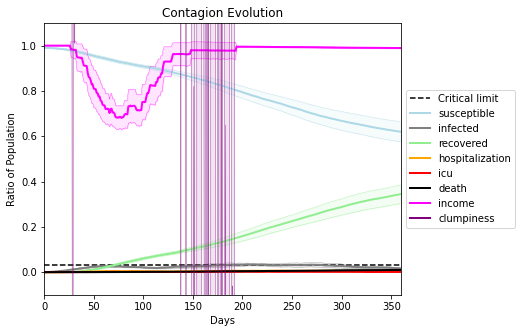

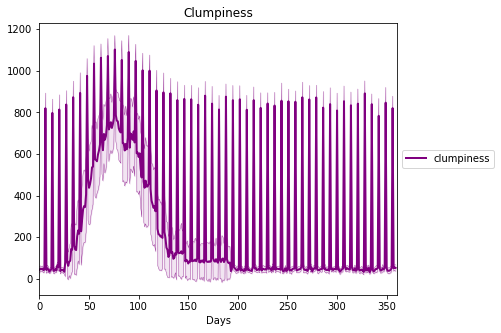

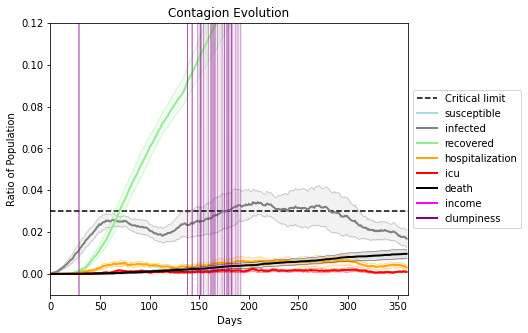

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9943, 2745, 3246, 4641, 2008, 6506, 5061, 3435, 7075, 2124, 1353, 867, 1670, 748, 1267, 8445, 3887, 1322, 121, 1629]
Average similarity between family members is 0.09136434091512631 at temperature 0.33
Average similarity between family and home is 0.9998528498852369 at temperature -1
Average similarity between students and their classroom is 0.12090026459676091 at temperature 0.33
Average classroom occupancy is 1.6547619047619047 and number classrooms is 168
Average similarity between workers is 0.08758391254019984 at temperature 0.33
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.1746880537516968 for kids: 0.17093503609370966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.02169645188908449
avg restaurant similarity 0.05321941208275019
avg restaurant similarity 0.06725922132536341
avg restaurant similarity 0.04709403206595321
avg restaurant similarity 0.07699317089118425
avg restaurant similarity 0.04998022762038088
avg restaurant similarity 0.04212055036071951
avg restaurant similarity 0.03380628591666552
avg restaurant similarity 0.04302549905620991
avg restaurant similarity 0.03395867735376959
avg restaurant similarity 0.03231287089674923
avg restaurant similarity 0.02815794405373679
avg restaurant similarity 0.05747940325624409
avg restaurant similarity 0.0392518463094699
avg restaurant similarity 0.038066158184589104
avg restaurant similarity 0.041006818731849214
avg restaurant similarity 0.057306075444254666
avg restaurant similarity -0.0033965950047828686
avg restaurant similarity 0.1056907233141853
avg restaurant similarity 0.013874342410269509
avg restaurant similarity 0.04129138098612379
avg restaurant similarity 0.0

avg restaurant similarity 0.055647319325244304
avg restaurant similarity 0.020711045087887542
avg restaurant similarity 0.01422567070684135
avg restaurant similarity -0.030858783351481067
avg restaurant similarity 0.06077300145941684
avg restaurant similarity 0.026902300150037264
avg restaurant similarity 0.06549186819647945
avg restaurant similarity 0.08609303989040952
avg restaurant similarity 0.0101643684514525
avg restaurant similarity 0.0003486856458180287
avg restaurant similarity 0.040873683240371654
avg restaurant similarity 0.010751400883824798
avg restaurant similarity 0.03365987198692998
avg restaurant similarity 0.0504616195637258
avg restaurant similarity 0.01712081901698442
avg restaurant similarity 0.014728660556632857
avg restaurant similarity 0.03628234162466812
avg restaurant similarity 0.024322376619746656
avg restaurant similarity 0.0431051780157739
avg restaurant similarity -0.011539222440708442
avg restaurant similarity 0.03796571230164355
avg restaurant similarit

avg restaurant similarity 0.0737001054977878
avg restaurant similarity 0.03892990870708739
avg restaurant similarity 0.03645361948815969
avg restaurant similarity 0.08717507559319752
avg restaurant similarity 0.016141163889765896
avg restaurant similarity 0.016946669505287913
Average similarity between family members is 0.1120231325820702 at temperature 0.33
Average similarity between family and home is 0.9998523508462978 at temperature -1
Average similarity between students and their classroom is 0.12495517288128619 at temperature 0.33
Average classroom occupancy is 1.5176470588235293 and number classrooms is 170
Average similarity between workers is 0.11294434802760298 at temperature 0.33
Average office occupancy is 3.4527363184079602 and number offices is 201
Average friend similarity for adults: 0.17052248160073136 for kids: 0.18240088771837312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wi

avg restaurant similarity 0.08260258797607997
avg restaurant similarity 0.049815530884493246
avg restaurant similarity 0.04711687413494363
avg restaurant similarity 0.1038768343791233
avg restaurant similarity 0.0466901625189856
avg restaurant similarity 0.05778607331307859
avg restaurant similarity 0.03043679662836577
avg restaurant similarity 0.06872164144989179
avg restaurant similarity 0.1032160539634536
avg restaurant similarity 0.05283695014665051
avg restaurant similarity 0.05581908296176789
avg restaurant similarity 0.039556157910126864
avg restaurant similarity 0.04457491267342196
avg restaurant similarity 0.03189783601599785
avg restaurant similarity 0.06851480007588785
avg restaurant similarity 0.09615569873957437
avg restaurant similarity -0.0025323013085534465
avg restaurant similarity 0.09554153583601559
avg restaurant similarity 0.04595039880602085
avg restaurant similarity 0.06814603509274614
avg restaurant similarity 0.08941329887337987
avg restaurant similarity 0.0807

avg restaurant similarity 0.06219577495338515
avg restaurant similarity 0.044671348285064985
avg restaurant similarity 0.06510067663037053
avg restaurant similarity 0.09415366977611932
avg restaurant similarity 0.06466722241788546
avg restaurant similarity 0.019424764800242463
avg restaurant similarity 0.05781012046916467
avg restaurant similarity 0.05489419669058023
avg restaurant similarity 0.021851957764127045
avg restaurant similarity 0.060831128798512255
avg restaurant similarity 0.04639031104486728
avg restaurant similarity 0.04318214501789584
avg restaurant similarity 0.031764526418568216
avg restaurant similarity 0.07175208664656445
avg restaurant similarity 0.023297670467624685
avg restaurant similarity 0.09808864562082735
avg restaurant similarity 0.08127694549134805
avg restaurant similarity 0.05786977103958555
avg restaurant similarity 0.07990331867118333
avg restaurant similarity 0.04035355251469258
avg restaurant similarity 0.05644269587113901
avg restaurant similarity 0.

avg restaurant similarity 0.07126894899185204
avg restaurant similarity 0.024272083286628325
avg restaurant similarity 0.04083357564943569
avg restaurant similarity 0.07770752819228287
Average similarity between family members is 0.11642617260274553 at temperature 0.33
Average similarity between family and home is 0.9998583152010903 at temperature -1
Average similarity between students and their classroom is 0.07918384904405981 at temperature 0.33
Average classroom occupancy is 1.722543352601156 and number classrooms is 173
Average similarity between workers is 0.08078161242295338 at temperature 0.33
Average office occupancy is 3.217821782178218 and number offices is 202
Average friend similarity for adults: 0.15994374588282825 for kids: 0.16408838555722782
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.05061784611538161
avg restaurant similarity 0.029228244579382334
avg restaurant similarity 0.018018611660815566
avg restaurant similarity 0.06409425660918928
avg restaurant similarity 0.020111942876927257
avg restaurant similarity 0.029870438257390188
avg restaurant similarity 0.05192899426494858
avg restaurant similarity 0.025729425119568824
avg restaurant similarity 0.03983269644004997
avg restaurant similarity 0.02786616705243088
avg restaurant similarity 0.02600919541827244
avg restaurant similarity 0.039649615908645644
avg restaurant similarity 0.016861486237428135
avg restaurant similarity 0.03799389977712457
avg restaurant similarity 0.01999467409070204
avg restaurant similarity 0.0007640550486087418
avg restaurant similarity 0.03694892359563121
avg restaurant similarity 0.06537973407346159
avg restaurant similarity 0.02183003296556516
avg restaurant similarity 0.021959947007486543
avg restaurant similarity 0.09596863889519613
avg restaurant similarit

avg restaurant similarity 0.11464060532252188
avg restaurant similarity 0.0212888469886279
avg restaurant similarity 0.044847612491094806
avg restaurant similarity 0.06523956588542973
avg restaurant similarity 0.03858740192471224
avg restaurant similarity 0.009647918663409845
avg restaurant similarity 0.014688819219178452
avg restaurant similarity 0.05540138899008075
avg restaurant similarity 0.06213894430443808
avg restaurant similarity 0.055577078503339296
avg restaurant similarity 0.05816996946014252
avg restaurant similarity 0.08384405852467379
avg restaurant similarity 0.07747296185687955
avg restaurant similarity 0.028262201167743518
avg restaurant similarity 0.02257135413267576
avg restaurant similarity 0.010789562302421115
avg restaurant similarity 0.03661302294533728
avg restaurant similarity 0.046919471462173255
avg restaurant similarity 0.024869253985859544
avg restaurant similarity 0.01616952158165871
avg restaurant similarity 0.029475910596177837
avg restaurant similarity 

avg restaurant similarity 0.04969677707606513
avg restaurant similarity 0.09846987642342861
avg restaurant similarity 0.025157853741112433
avg restaurant similarity 0.03859376263317144
avg restaurant similarity 0.03502229063645641
avg restaurant similarity 0.00041738089382881746
avg restaurant similarity 0.016978444904756012
Average similarity between family members is 0.11900015122549214 at temperature 0.33
Average similarity between family and home is 0.999864821683887 at temperature -1
Average similarity between students and their classroom is 0.06658006001958498 at temperature 0.33
Average classroom occupancy is 1.6685714285714286 and number classrooms is 175
Average similarity between workers is 0.10562863349047959 at temperature 0.33
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.17374525049718606 for kids: 0.16918022074224529
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.06718859314891876
avg restaurant similarity 0.12833135847470392
avg restaurant similarity 0.08164164900353216
avg restaurant similarity 0.05496378379556005
avg restaurant similarity 0.05508669422560967
avg restaurant similarity 0.09359392803037485
avg restaurant similarity 0.10248252554936313
avg restaurant similarity 0.09664851823274749
avg restaurant similarity 0.04155192046275011
avg restaurant similarity 0.05479171749330346
avg restaurant similarity 0.06277795150799019
avg restaurant similarity 0.08748957811523701
avg restaurant similarity 0.0762364044075378
avg restaurant similarity 0.08100431142476656
avg restaurant similarity 0.05772838388324165
avg restaurant similarity 0.11265441415043595
avg restaurant similarity 0.09782233040643881
avg restaurant similarity 0.1065180046296854
avg restaurant similarity 0.053900893840806235
avg restaurant similarity 0.07281277231117729
avg restaurant similarity 0.03677892440875524
avg restaurant similarity 0.0740917

avg restaurant similarity 0.03335772367556949
avg restaurant similarity 0.043377400798708624
avg restaurant similarity 0.07194343649157012
avg restaurant similarity 0.05590710829624466
avg restaurant similarity 0.09469188196634089
avg restaurant similarity 0.07869486984469481
avg restaurant similarity 0.08980420132511799
avg restaurant similarity 0.07669629222987645
avg restaurant similarity 0.10644436634480216
avg restaurant similarity 0.08830092001919063
avg restaurant similarity 0.07972981667488044
avg restaurant similarity 0.055932831277384215
avg restaurant similarity 0.05975938143600487
avg restaurant similarity 0.09596999671990801
avg restaurant similarity 0.09193266539552526
avg restaurant similarity 0.09015458321808488
avg restaurant similarity 0.07360064746839447
avg restaurant similarity 0.048931620886340774
avg restaurant similarity 0.07687307603607121
avg restaurant similarity 0.0876125987651313
avg restaurant similarity 0.07823433267195185
avg restaurant similarity 0.0427

avg restaurant similarity 0.06629431878442163
avg restaurant similarity 0.050869549072010925
Average similarity between family members is 0.09514468977510622 at temperature 0.33
Average similarity between family and home is 0.9998512262697353 at temperature -1
Average similarity between students and their classroom is 0.12426203253710029 at temperature 0.33
Average classroom occupancy is 1.5497076023391814 and number classrooms is 171
Average similarity between workers is 0.0929703111245998 at temperature 0.33
Average office occupancy is 3.405940594059406 and number offices is 202
Average friend similarity for adults: 0.16610687553198375 for kids: 0.17671501179452154
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 alloca

avg restaurant similarity 0.04376939202571099
avg restaurant similarity 0.06141213808415803
avg restaurant similarity 0.09335563609008007
avg restaurant similarity 0.03621944829747177
avg restaurant similarity 0.05199279433562597
avg restaurant similarity 0.022843964617366055
avg restaurant similarity 0.06387451246930743
avg restaurant similarity 0.07973209835504626
avg restaurant similarity 0.039879670155324724
avg restaurant similarity 0.062282087203277915
avg restaurant similarity 0.05542423465727517
avg restaurant similarity 0.0685668167435877
avg restaurant similarity 0.04160785677132354
avg restaurant similarity 0.04234438206876756
avg restaurant similarity 0.049902263138754496
avg restaurant similarity 0.046862310007809715
avg restaurant similarity 0.023064025198300628
avg restaurant similarity 0.09777286089453492
avg restaurant similarity 0.06643469566865837
avg restaurant similarity 0.08922667450427726
avg restaurant similarity 0.05714150834779702
avg restaurant similarity 0.0

avg restaurant similarity 0.07855404323837918
avg restaurant similarity 0.06205810729250704
avg restaurant similarity 0.08079938027522506
avg restaurant similarity 0.049803677645458413
avg restaurant similarity 0.055089168214293625
avg restaurant similarity 0.024012833984401346
avg restaurant similarity 0.054520293695231474
avg restaurant similarity 0.06722664425676514
avg restaurant similarity 0.04936088992174902
avg restaurant similarity 0.08457448372789136
avg restaurant similarity 0.062251052625281876
avg restaurant similarity 0.06862479589890394
avg restaurant similarity 0.0449779706734442
avg restaurant similarity 0.0832418211096127
avg restaurant similarity 0.041177599893752755
avg restaurant similarity 0.0922050694243457
avg restaurant similarity 0.05908185499051893
avg restaurant similarity 0.08157809188926089
avg restaurant similarity 0.05272033378103962
avg restaurant similarity 0.06416753369466525
avg restaurant similarity 0.053899883634040135
avg restaurant similarity 0.05

avg restaurant similarity 0.09351262727191902
avg restaurant similarity 0.021420834004371694
avg restaurant similarity 0.019726978894651984
avg restaurant similarity 0.06955666174438646
Average similarity between family members is 0.09954969899924178 at temperature 0.33
Average similarity between family and home is 0.999850284289973 at temperature -1
Average similarity between students and their classroom is 0.15499298434751269 at temperature 0.33
Average classroom occupancy is 1.60989010989011 and number classrooms is 182
Average similarity between workers is 0.1076554904898446 at temperature 0.33
Average office occupancy is 3.212871287128713 and number offices is 202
Average friend similarity for adults: 0.1608662290540006 for kids: 0.16947628472331494
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.03620912011282428
avg restaurant similarity 0.04765438296202672
avg restaurant similarity 0.07573129436705661
avg restaurant similarity -0.00033262012196631465
avg restaurant similarity 0.050776007468060574
avg restaurant similarity 0.04261534046294252
avg restaurant similarity 0.060255680976140334
avg restaurant similarity 0.08437954177016371
avg restaurant similarity 0.04629236433423356
avg restaurant similarity 0.04350075338438587
avg restaurant similarity 0.025285857857117948
avg restaurant similarity 0.06286924441645303
avg restaurant similarity 0.06814123946905329
avg restaurant similarity 0.003695965839860781
avg restaurant similarity 0.06877604381252267
avg restaurant similarity 0.07738219934303246
avg restaurant similarity 0.07638461003508468
avg restaurant similarity 0.028862785072986046
avg restaurant similarity 0.03126572114023501
avg restaurant similarity 0.04453275685370433
avg restaurant similarity 0.032463182149139416
avg restaurant similarit

avg restaurant similarity 0.058148725847145824
avg restaurant similarity 0.048968233177217275
avg restaurant similarity 0.046064346605769926
avg restaurant similarity 0.08458748247835235
avg restaurant similarity 0.06280265108529347
avg restaurant similarity 0.06359972045982835
avg restaurant similarity 0.06578689813934677
avg restaurant similarity 0.083155843667522
avg restaurant similarity 0.0877391611044398
avg restaurant similarity 0.046127632289688025
avg restaurant similarity 0.08227709206270699
avg restaurant similarity 0.03160604862053127
avg restaurant similarity 0.09316582320459826
avg restaurant similarity 0.07639681405730168
avg restaurant similarity 0.08212968004978635
avg restaurant similarity 0.011983822629497173
avg restaurant similarity 0.08008447281995128
avg restaurant similarity 0.08692347069303727
avg restaurant similarity 0.005544808018707155
avg restaurant similarity 0.024312491328022434
avg restaurant similarity 0.06987084122583981
avg restaurant similarity 0.09

avg restaurant similarity 0.07497685959063949
avg restaurant similarity 0.05757238611769688
avg restaurant similarity 0.0732959469144378
avg restaurant similarity 0.04257984064818918
Average similarity between family members is 0.11595860934371992 at temperature 0.33
Average similarity between family and home is 0.9998502841861485 at temperature -1
Average similarity between students and their classroom is 0.11383550904702358 at temperature 0.33
Average classroom occupancy is 1.5780346820809248 and number classrooms is 173
Average similarity between workers is 0.09322908467050632 at temperature 0.33
Average office occupancy is 3.3737373737373737 and number offices is 198
Average friend similarity for adults: 0.16844429872692382 for kids: 0.165359159058633
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity -0.02404776299559415
avg restaurant similarity 0.004844476275477253
avg restaurant similarity -0.023207367400224707
avg restaurant similarity 0.0163780382825282
avg restaurant similarity 0.008250046231925705
avg restaurant similarity -0.035674915871630054
avg restaurant similarity -0.002641869631668516
avg restaurant similarity 0.022864084470770915
avg restaurant similarity 0.026311056314221763
avg restaurant similarity 0.020205627046398042
avg restaurant similarity 0.0011742554407477384
avg restaurant similarity 0.07119850969015988
avg restaurant similarity 0.028888361223985734
avg restaurant similarity 0.06670772928491318
avg restaurant similarity 0.03463932862285045
avg restaurant similarity 0.025085747429200004
avg restaurant similarity 0.047447295678260754
avg restaurant similarity 0.04708030648471312
avg restaurant similarity -0.013307996324440154
avg restaurant similarity 0.021052716603592647
avg restaurant similarity -0.004075594322344027
avg restauran

avg restaurant similarity 0.03298758985229585
avg restaurant similarity 0.09047101984233162
avg restaurant similarity 0.009173149806750377
avg restaurant similarity 0.017772990759533237
avg restaurant similarity 0.07281845010558745
avg restaurant similarity -0.004838604827851925
avg restaurant similarity 0.06140112905673979
avg restaurant similarity 0.03614506941559994
avg restaurant similarity 0.02414341262312541
avg restaurant similarity 0.050125357473991466
avg restaurant similarity 0.09779967330702088
avg restaurant similarity 0.026335401192623818
avg restaurant similarity -0.0052234584352436
avg restaurant similarity 0.007260719333577799
avg restaurant similarity 0.00837613524598676
avg restaurant similarity 0.04538654862611428
avg restaurant similarity -0.007186092459819039
avg restaurant similarity 0.03716188188798738
avg restaurant similarity 0.038515487341639856
avg restaurant similarity 0.020517118095756345
avg restaurant similarity 0.10873648981297973
avg restaurant similari

avg restaurant similarity -0.021208208039072595
avg restaurant similarity 0.013583742661446201
avg restaurant similarity 0.042412163720751565
avg restaurant similarity 0.0548711782937468
avg restaurant similarity -0.009043039795361706
avg restaurant similarity -0.0029421001306512017
avg restaurant similarity 0.03228902447605002
avg restaurant similarity 0.04426903124818477
avg restaurant similarity 0.016755051734141393
Average similarity between family members is 0.12390610858355995 at temperature 0.33
Average similarity between family and home is 0.9998520372912305 at temperature -1
Average similarity between students and their classroom is 0.13685445643518035 at temperature 0.33
Average classroom occupancy is 1.5923913043478262 and number classrooms is 184
Average similarity between workers is 0.09323319955283638 at temperature 0.33
Average office occupancy is 3.1881188118811883 and number offices is 202
Average friend similarity for adults: 0.16080235833030118 for kids: 0.1776795346

avg restaurant similarity 0.041913472236104574
avg restaurant similarity 0.04541531486659884
avg restaurant similarity 0.0240203880477879
avg restaurant similarity -0.010872880658936808
avg restaurant similarity 0.023189022315364866
avg restaurant similarity 0.05049289720051234
avg restaurant similarity 0.06825679063701716
avg restaurant similarity 0.03832503291335856
avg restaurant similarity 0.076662482358775
avg restaurant similarity 0.04300122586434564
avg restaurant similarity 0.06426127150600787
avg restaurant similarity 0.028912090334197123
avg restaurant similarity 0.0600255783914696
avg restaurant similarity 0.053818875527811
avg restaurant similarity -0.0001789170590198699
avg restaurant similarity 0.04776036281574397
avg restaurant similarity 0.0368726857262321
avg restaurant similarity 0.005240506385879718
avg restaurant similarity 0.03911156552423038
avg restaurant similarity 0.007279954090166247
avg restaurant similarity 0.02514726930737879
avg restaurant similarity 0.040

avg restaurant similarity 0.022881414644733176
avg restaurant similarity 0.039266777259700104
avg restaurant similarity 0.08125541949832694
avg restaurant similarity 0.02445251062485371
avg restaurant similarity 0.025308468566460917
avg restaurant similarity 0.05031256556654829
avg restaurant similarity 0.0638171241055845
avg restaurant similarity 0.04564861029130045
avg restaurant similarity 0.020365208517756663
avg restaurant similarity 0.0392342715941785
avg restaurant similarity 0.014970438940187184
avg restaurant similarity 0.052305413002348256
avg restaurant similarity 0.0438820414995662
avg restaurant similarity 0.03791505898165064
avg restaurant similarity 0.0058975140790342925
avg restaurant similarity 0.003991685892206372
avg restaurant similarity -0.02154703721180719
avg restaurant similarity 0.03563251080796021
avg restaurant similarity 0.04594532640203855
avg restaurant similarity -0.0031094766479820768
avg restaurant similarity 0.027869938939446174
avg restaurant similari

avg restaurant similarity 0.01328667401465067
avg restaurant similarity 0.04786457751053294
avg restaurant similarity 0.04316086560087416
avg restaurant similarity 0.04728598289809762
avg restaurant similarity 0.02988851535273972
avg restaurant similarity -0.0038044481839843124
Average similarity between family members is 0.09291312858036994 at temperature 0.33
Average similarity between family and home is 0.9998598627269688 at temperature -1
Average similarity between students and their classroom is 0.09059982067239969 at temperature 0.33
Average classroom occupancy is 1.6987951807228916 and number classrooms is 166
Average similarity between workers is 0.1194152763888638 at temperature 0.33
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.17035249252516796 for kids: 0.17919101194875584
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units 

avg restaurant similarity 0.03775710846786538
avg restaurant similarity 0.03401803202154511
avg restaurant similarity 0.052518130325290804
avg restaurant similarity 0.03393675314209086
avg restaurant similarity 0.04015696443183171
avg restaurant similarity 0.03627970882789744
avg restaurant similarity 0.0363075317803883
avg restaurant similarity -0.01089346242384798
avg restaurant similarity 0.040219609942768776
avg restaurant similarity 0.0227752990816792
avg restaurant similarity 0.08566466308181606
avg restaurant similarity 0.0033272690306543205
avg restaurant similarity 0.005217924758197136
avg restaurant similarity -0.030944913818433784
avg restaurant similarity 0.04064574238947968
avg restaurant similarity 0.016252818350641494
avg restaurant similarity 0.03285771754055161
avg restaurant similarity 0.029779401363609705
avg restaurant similarity 0.04817091148165958
avg restaurant similarity 0.04156041888543953
avg restaurant similarity -0.014059356021928576
avg restaurant similarit

avg restaurant similarity -0.0005017353141067755
avg restaurant similarity -0.015339432717447043
avg restaurant similarity 0.03732495814013221
avg restaurant similarity 0.0380848427615786
avg restaurant similarity 0.004545920039698219
avg restaurant similarity -0.008327426746218893
avg restaurant similarity 0.022644209424546948
avg restaurant similarity 0.04264044404981931
avg restaurant similarity 0.05818656723030678
avg restaurant similarity 0.061799873649510936
avg restaurant similarity 0.07919494396352561
avg restaurant similarity 0.025336732397264212
avg restaurant similarity 0.00801917583582982
avg restaurant similarity 0.027366639086888748
avg restaurant similarity 0.02324839837001642
avg restaurant similarity 0.04637435715704353
avg restaurant similarity 0.06081906814461511
avg restaurant similarity 0.037062568806483405
avg restaurant similarity 0.02700816484660322
avg restaurant similarity 0.06300267861223958
avg restaurant similarity 0.051337927905046835
avg restaurant simila

avg restaurant similarity 0.026079928269785068
avg restaurant similarity 0.019920695072293243
avg restaurant similarity 0.006618048952393845
avg restaurant similarity 0.04766970894894883
avg restaurant similarity 0.05993361213781433
avg restaurant similarity 0.017800944770696967
avg restaurant similarity 0.016790187381293835
avg restaurant similarity 0.04971385849606873
Average similarity between family members is 0.0852577281297757 at temperature 0.33
Average similarity between family and home is 0.9998484191897922 at temperature -1
Average similarity between students and their classroom is 0.11230295067323921 at temperature 0.33
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.103912530839265 at temperature 0.33
Average office occupancy is 3.2741116751269037 and number offices is 197
Average friend similarity for adults: 0.16503298327352803 for kids: 0.17403427019024845
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.06957418715023762
avg restaurant similarity 0.009575771762921223
avg restaurant similarity 0.009026496655618416
avg restaurant similarity 0.00834249035033114
avg restaurant similarity 0.0332423206578756
avg restaurant similarity -0.0024985208024065745
avg restaurant similarity 0.02780782509765191
avg restaurant similarity -0.0007284075427960486
avg restaurant similarity 0.047652441533197025
avg restaurant similarity 0.029518797695673702
avg restaurant similarity 0.02404414354260453
avg restaurant similarity 0.03506051903800536
avg restaurant similarity 0.02599703037906383
avg restaurant similarity -0.0005998553710869251
avg restaurant similarity -0.0001143115931352562
avg restaurant similarity -0.017749689363241377
avg restaurant similarity 0.029899480475874957
avg restaurant similarity 0.044487140825509044
avg restaurant similarity -0.031524264788683115
avg restaurant similarity 0.015447026389406588
avg restaurant similarity 0.03837765569534017
avg restaura

avg restaurant similarity 0.017379974074978596
avg restaurant similarity -0.03864869831098554
avg restaurant similarity 0.07691173809727948
avg restaurant similarity -0.006208965115730319
avg restaurant similarity 0.011262406237962737
avg restaurant similarity -0.02373282933545362
avg restaurant similarity -0.021652582629060075
avg restaurant similarity 0.0035570172824391524
avg restaurant similarity -0.0018105914912938661
avg restaurant similarity 0.06523488958024184
avg restaurant similarity -0.01997143428913725
avg restaurant similarity 0.03298213091837716
avg restaurant similarity 0.001595515705771939
avg restaurant similarity 0.04461423689098673
avg restaurant similarity 0.01195179797268112
avg restaurant similarity 0.012354092217454071
avg restaurant similarity 0.00715361725111501
avg restaurant similarity 0.014962847239991075
avg restaurant similarity 0.026297992475702168
avg restaurant similarity 0.019892659119988772
avg restaurant similarity -0.02219700284313471
avg restaurant

avg restaurant similarity 0.026114884919042135
avg restaurant similarity 0.004068269481005238
avg restaurant similarity 0.028397207425587528
avg restaurant similarity 0.03930557191374991
avg restaurant similarity 0.051743940422639884
avg restaurant similarity -0.005011371958653413
avg restaurant similarity 0.03854727753762208
avg restaurant similarity 0.03457058709971122
avg restaurant similarity 0.047540425536458056
Average similarity between family members is 0.11399953324777981 at temperature 0.33
Average similarity between family and home is 0.999851122720725 at temperature -1
Average similarity between students and their classroom is 0.11922622985954706 at temperature 0.33
Average classroom occupancy is 1.5411764705882354 and number classrooms is 170
Average similarity between workers is 0.11871272651239118 at temperature 0.33
Average office occupancy is 3.4292929292929295 and number offices is 198
Average friend similarity for adults: 0.1724103438562764 for kids: 0.17778263858889

avg restaurant similarity 0.0642190988794732
avg restaurant similarity 0.04874183889009644
avg restaurant similarity 0.07104613979506945
avg restaurant similarity 0.0015700506436280668
avg restaurant similarity 0.041637785990545476
avg restaurant similarity 0.046392655603879895
avg restaurant similarity 0.029656257981704997
avg restaurant similarity 0.07623280738524954
avg restaurant similarity 0.0063119354387264764
avg restaurant similarity 0.05888885536971509
avg restaurant similarity 0.02348118382269698
avg restaurant similarity 0.10513213917434872
avg restaurant similarity 0.029554267022697627
avg restaurant similarity 0.06174165117409816
avg restaurant similarity 0.06281850773457202
avg restaurant similarity 0.05626393943859817
avg restaurant similarity -0.00748482354501939
avg restaurant similarity 0.0478170937319447
avg restaurant similarity 0.05947784722316611
avg restaurant similarity 0.02192585394503689
avg restaurant similarity 0.024871366270627537
avg restaurant similarity 

avg restaurant similarity 0.05492341806469575
avg restaurant similarity -0.020553171187142637
avg restaurant similarity 0.04852155737284078
avg restaurant similarity 0.011124448739839227
avg restaurant similarity 0.05623638501396642
avg restaurant similarity -0.01686258490258132
avg restaurant similarity 0.06065957954474141
avg restaurant similarity 0.027118906298259873
avg restaurant similarity 0.008108018254561072
avg restaurant similarity 0.06361380427501738
avg restaurant similarity 0.03934577282885415
avg restaurant similarity 0.034913696313102996
avg restaurant similarity -0.024764152509855208
avg restaurant similarity 0.005090682258737608
avg restaurant similarity 0.0032562842769007175
avg restaurant similarity 0.027553284127752743
avg restaurant similarity 0.04797905371244635
avg restaurant similarity 0.04950223092961507
avg restaurant similarity 0.047385709699217335
avg restaurant similarity 0.07314482433884538
avg restaurant similarity 0.05960275090583248
avg restaurant simil

avg restaurant similarity 0.016160441169015608
avg restaurant similarity 0.04158155995919255
avg restaurant similarity 0.03560903978690244
avg restaurant similarity 0.03533401485456663
avg restaurant similarity 0.04084125744544202
avg restaurant similarity 0.024045614729138805
avg restaurant similarity 0.01993723492775038
Average similarity between family members is 0.13737896210220488 at temperature 0.33
Average similarity between family and home is 0.9998579968536301 at temperature -1
Average similarity between students and their classroom is 0.10548531164771303 at temperature 0.33
Average classroom occupancy is 1.6229508196721312 and number classrooms is 183
Average similarity between workers is 0.10408181277841276 at temperature 0.33
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.16642595672237523 for kids: 0.17038163968774525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.07724347831053166
avg restaurant similarity 0.04255730148808284
avg restaurant similarity 0.03869509200691218
avg restaurant similarity 0.04927358236122579
avg restaurant similarity 0.02820224617954468
avg restaurant similarity 0.01621886789853977
avg restaurant similarity 0.10143693481827783
avg restaurant similarity 0.044243545565680074
avg restaurant similarity 0.026811195938242466
avg restaurant similarity 0.0621507568912615
avg restaurant similarity 0.020479732509073298
avg restaurant similarity 0.07344661372807133
avg restaurant similarity 0.06847236749519882
avg restaurant similarity 0.019448966336431277
avg restaurant similarity 0.038892714657005154
avg restaurant similarity 0.04573668465694843
avg restaurant similarity 0.04144021064440216
avg restaurant similarity 0.02522245709744381
avg restaurant similarity 0.04039278511982597
avg restaurant similarity -0.006509502372992731
avg restaurant similarity 0.026762568440785776
avg restaurant similarity 0

avg restaurant similarity 0.0184467506933496
avg restaurant similarity 0.03364525223772091
avg restaurant similarity 0.061024171421801957
avg restaurant similarity 0.05761864315053529
avg restaurant similarity 0.0518738685221568
avg restaurant similarity 0.05732551534164231
avg restaurant similarity 0.012933484752700323
avg restaurant similarity 0.037417079847724764
avg restaurant similarity 0.046396134046016786
avg restaurant similarity 0.03247217044637465
avg restaurant similarity 0.019147763367784183
avg restaurant similarity 0.04624733434985339
avg restaurant similarity 0.06165553594248633
avg restaurant similarity 0.07935106787065611
avg restaurant similarity 0.05260583032740968
avg restaurant similarity 0.039297928233533536
avg restaurant similarity 0.02721253632583705
avg restaurant similarity 0.05169275380556873
avg restaurant similarity 0.06248198558328589
avg restaurant similarity 0.06151015946408161
avg restaurant similarity 0.03792730035830911
avg restaurant similarity 0.09

avg restaurant similarity 0.039360445248394035
avg restaurant similarity 0.029470769546477555
avg restaurant similarity 0.0745751645510575
avg restaurant similarity 0.017804581838978928
avg restaurant similarity 0.06283477214042674
avg restaurant similarity 0.028936902824378274
Average similarity between family members is 0.11427891037723499 at temperature 0.33
Average similarity between family and home is 0.9998503346883411 at temperature -1
Average similarity between students and their classroom is 0.11217227953838914 at temperature 0.33
Average classroom occupancy is 1.5846153846153845 and number classrooms is 195
Average similarity between workers is 0.13194713264993663 at temperature 0.33
Average office occupancy is 3.24 and number offices is 200
Average friend similarity for adults: 0.17103432377554958 for kids: 0.17093873522140057
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total 

avg restaurant similarity 0.03602362798025242
avg restaurant similarity 0.060921423269075965
avg restaurant similarity 0.03092290730828179
avg restaurant similarity 0.06564185136611907
avg restaurant similarity 0.01826948114417186
avg restaurant similarity 0.028488658693833387
avg restaurant similarity 0.04125738929925022
avg restaurant similarity 0.018397062668623346
avg restaurant similarity 0.06988346901276735
avg restaurant similarity 0.048874508093477396
avg restaurant similarity -0.02396819657441185
avg restaurant similarity 0.03251556787993171
avg restaurant similarity 0.024397723165870206
avg restaurant similarity 0.043374218259854484
avg restaurant similarity 0.02069054514111203
avg restaurant similarity 0.05254057553750041
avg restaurant similarity 0.02874525453506896
avg restaurant similarity -0.02596509084837198
avg restaurant similarity 0.034268094230647396
avg restaurant similarity 0.046581323758883394
avg restaurant similarity 0.008547262569170135
avg restaurant similari

avg restaurant similarity 0.0019891472864638216
avg restaurant similarity 0.05769271067637579
avg restaurant similarity -0.002493690281154849
avg restaurant similarity 0.05489965278715108
avg restaurant similarity 0.04892799028023975
avg restaurant similarity 0.045579665888122435
avg restaurant similarity 0.02515853842077871
avg restaurant similarity 0.05332625895297682
avg restaurant similarity -0.0054152883892596895
avg restaurant similarity 0.04638037979107387
avg restaurant similarity 0.05466676200464888
avg restaurant similarity 0.05357913687096286
avg restaurant similarity 0.05152470715857252
avg restaurant similarity 0.03505268786119485
avg restaurant similarity 0.04102950999850052
avg restaurant similarity 0.00494378440792059
avg restaurant similarity 0.03598491183727545
avg restaurant similarity 0.03716576497465431
avg restaurant similarity 0.02189978617875029
avg restaurant similarity 0.060076264805875176
avg restaurant similarity -0.00011062536499841094
avg restaurant simila

avg restaurant similarity -0.0069863197703412495
avg restaurant similarity 0.031288941513467464
avg restaurant similarity 0.03238807487402944
avg restaurant similarity 0.04485183308366246
avg restaurant similarity 0.02866900104876824
avg restaurant similarity 0.05566045064562751
avg restaurant similarity 0.08402659568863316
avg restaurant similarity 0.062168588393953124
Average similarity between family members is 0.09979669389774329 at temperature 0.33
Average similarity between family and home is 0.9998627324404868 at temperature -1
Average similarity between students and their classroom is 0.11228857275554763 at temperature 0.33
Average classroom occupancy is 1.625 and number classrooms is 176
Average similarity between workers is 0.09441048047284743 at temperature 0.33
Average office occupancy is 3.358974358974359 and number offices is 195
Average friend similarity for adults: 0.16539644542728912 for kids: 0.1603033594983999
home_districts
[
Home (0,0) district with 1 Buildings
Hom

avg restaurant similarity 0.06265743127497614
avg restaurant similarity 0.03498380754134297
avg restaurant similarity 0.033548860296405955
avg restaurant similarity 0.05538427247000832
avg restaurant similarity 0.047951225673501005
avg restaurant similarity 0.023163134185461884
avg restaurant similarity 0.04016407028867463
avg restaurant similarity 0.1160552361971426
avg restaurant similarity 0.046647141861722086
avg restaurant similarity 0.08733825800070592
avg restaurant similarity 0.06345541878568077
avg restaurant similarity 0.09401408234929395
avg restaurant similarity 0.019178871546877935
avg restaurant similarity 0.06075592527437287
avg restaurant similarity 0.06972393877901577
avg restaurant similarity 0.0499117453281999
avg restaurant similarity 0.06452498125746484
avg restaurant similarity 0.009109119190479114
avg restaurant similarity 0.04181361331296498
avg restaurant similarity 0.01773790640675771
avg restaurant similarity 0.05703687507189831
avg restaurant similarity -0.0

avg restaurant similarity 0.027386621869031794
avg restaurant similarity 0.07019467552720551
avg restaurant similarity 0.05774252728139626
avg restaurant similarity 0.0838002436769949
avg restaurant similarity 0.09551481330065127
avg restaurant similarity 0.007534597486811718
avg restaurant similarity 0.028743512119337983
avg restaurant similarity 0.048351867452879956
avg restaurant similarity 0.04578220459950967
avg restaurant similarity 0.013982446341866947
avg restaurant similarity 0.05919316889527032
avg restaurant similarity 0.05261265063637981
avg restaurant similarity 0.059857859977022275
avg restaurant similarity 0.06417928857062566
avg restaurant similarity 0.04291100720342491
avg restaurant similarity 0.02950449131785605
avg restaurant similarity 0.04857889236780471
avg restaurant similarity 0.019394371972509816
avg restaurant similarity 0.05795688706473059
avg restaurant similarity 0.01384176369342594
avg restaurant similarity 0.021528504120862088
avg restaurant similarity 0

avg restaurant similarity 0.007165557908753235
avg restaurant similarity 0.04412520596238933
avg restaurant similarity 0.05866007952065178
avg restaurant similarity 0.07314231996434757
avg restaurant similarity 0.038607952105474214
avg restaurant similarity 0.04451163812337443
Average similarity between family members is 0.09069034754173737 at temperature 0.33
Average similarity between family and home is 0.9998554348761168 at temperature -1
Average similarity between students and their classroom is 0.11883963473418344 at temperature 0.33
Average classroom occupancy is 1.6035502958579881 and number classrooms is 169
Average similarity between workers is 0.11070216109332504 at temperature 0.33
Average office occupancy is 3.3681592039800994 and number offices is 201
Average friend similarity for adults: 0.16913832575827842 for kids: 0.16950860723833444
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units 

avg restaurant similarity 0.06686576914552998
avg restaurant similarity 0.010974954165689997
avg restaurant similarity 0.0003990789422252045
avg restaurant similarity 0.06837534674146019
avg restaurant similarity 0.03051184820749566
avg restaurant similarity 0.03843939551875561
avg restaurant similarity 0.013712476986134746
avg restaurant similarity 0.05856548559444961
avg restaurant similarity 0.0280627884385329
avg restaurant similarity 0.050738971667703386
avg restaurant similarity 0.02243173102042811
avg restaurant similarity 0.048311406417309966
avg restaurant similarity 0.04655719719192658
avg restaurant similarity 0.02954982937746627
avg restaurant similarity 0.06204153628943891
avg restaurant similarity 0.0039627499483458175
avg restaurant similarity 0.01687261365517415
avg restaurant similarity 0.015062251068742415
avg restaurant similarity 0.01704083342225507
avg restaurant similarity 0.03792711781200936
avg restaurant similarity 0.00966693725622492
avg restaurant similarity 

avg restaurant similarity 0.030370372399690464
avg restaurant similarity 0.016046876170805868
avg restaurant similarity 0.0002292680242995795
avg restaurant similarity 0.06735420870200955
avg restaurant similarity 0.026463675982155127
avg restaurant similarity 0.015557451116881293
avg restaurant similarity 0.03382646870130786
avg restaurant similarity 0.018004205267953353
avg restaurant similarity -0.0164990844913024
avg restaurant similarity 0.00021048494189078145
avg restaurant similarity -0.009706200567018056
avg restaurant similarity -0.007323542476640099
avg restaurant similarity 0.07078208656184806
avg restaurant similarity 0.05253332088604948
avg restaurant similarity 0.03236113299680408
avg restaurant similarity 0.057929801931310206
avg restaurant similarity 0.07119437364913533
avg restaurant similarity 0.03105896539826623
avg restaurant similarity 0.06903924100604658
avg restaurant similarity 0.05131349599795341
avg restaurant similarity 0.060267934211023326
avg restaurant sim

avg restaurant similarity 0.003662261234111873
avg restaurant similarity 0.013974797355088725
avg restaurant similarity 0.03149961983457786
avg restaurant similarity 0.04947171493092814
avg restaurant similarity 0.011099517219598651
avg restaurant similarity 0.04201379439055038
avg restaurant similarity 0.016177386572429904
avg restaurant similarity 0.028609302647337055
Average similarity between family members is 0.10894103384475257 at temperature 0.33
Average similarity between family and home is 0.9998453999761313 at temperature -1
Average similarity between students and their classroom is 0.10244835364400016 at temperature 0.33
Average classroom occupancy is 1.5681818181818181 and number classrooms is 176
Average similarity between workers is 0.10116043331277468 at temperature 0.33
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.16752922590916658 for kids: 0.17909316540455406
home_districts
[
Home (0,0) district with 1 Buildings
Ho

avg restaurant similarity 0.01855000462026803
avg restaurant similarity 0.04288300309517715
avg restaurant similarity 0.06605859305314878
avg restaurant similarity 0.03392125321356855
avg restaurant similarity 0.02779557822347325
avg restaurant similarity 0.08067276929737331
avg restaurant similarity 0.04875875644089852
avg restaurant similarity 0.03911644306500158
avg restaurant similarity 0.06876524396811913
avg restaurant similarity 0.04862035816835677
avg restaurant similarity 0.04612292797811617
avg restaurant similarity 0.048336472682460524
avg restaurant similarity 0.04073980326925729
avg restaurant similarity 0.005206470450209454
avg restaurant similarity 0.0983955690095502
avg restaurant similarity -0.0025186329950281604
avg restaurant similarity 0.014178538677379478
avg restaurant similarity 0.07477744555986258
avg restaurant similarity 0.08323562149874214
avg restaurant similarity 0.05253574443277794
avg restaurant similarity 0.09057521929241727
avg restaurant similarity 0.0

avg restaurant similarity 0.03476621642179403
avg restaurant similarity 0.04798485780409383
avg restaurant similarity 0.0434744463588431
avg restaurant similarity 0.05859664727616493
avg restaurant similarity 0.034598796794104505
avg restaurant similarity 0.08284071685706718
avg restaurant similarity 0.0463125468195334
avg restaurant similarity -0.011920075668327963
avg restaurant similarity 0.04438910042202452
avg restaurant similarity 0.006078766693213386
avg restaurant similarity 0.02012627816625995
avg restaurant similarity 0.03626384135600187
avg restaurant similarity 0.03578920202148882
avg restaurant similarity 0.07078163216064749
avg restaurant similarity 0.03557673514403024
avg restaurant similarity 0.05002393835755199
avg restaurant similarity 0.058859278744822455
avg restaurant similarity 0.05120111286299834
avg restaurant similarity 0.028758813418748162
avg restaurant similarity -0.014235907241150496
avg restaurant similarity 0.03129198642788296
avg restaurant similarity 0.

avg restaurant similarity 0.0420296796631136
avg restaurant similarity 0.001961907680025634
avg restaurant similarity 0.052694513799580116
avg restaurant similarity 0.03868228961770984
avg restaurant similarity 0.06434770570085274
avg restaurant similarity 0.05881027453451695
Average similarity between family members is 0.10244753767241109 at temperature 0.33
Average similarity between family and home is 0.9998441714910997 at temperature -1
Average similarity between students and their classroom is 0.11105640010090452 at temperature 0.33
Average classroom occupancy is 1.6196319018404908 and number classrooms is 163
Average similarity between workers is 0.11414011823698401 at temperature 0.33
Average office occupancy is 3.3969849246231156 and number offices is 199
Average friend similarity for adults: 0.1706653950260493 for kids: 0.17285553755528651
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units wi

avg restaurant similarity 0.016782334139787088
avg restaurant similarity 0.05728477369813077
avg restaurant similarity 0.01790627992305427
avg restaurant similarity 0.0454394780983684
avg restaurant similarity 0.05701450650231708
avg restaurant similarity 0.034813691702864955
avg restaurant similarity -0.006631737009784046
avg restaurant similarity 0.043598845039974084
avg restaurant similarity 0.03368934160235594
avg restaurant similarity 0.025955063639014335
avg restaurant similarity 0.039500071533861536
avg restaurant similarity 0.003967768637872719
avg restaurant similarity 0.047555297182221526
avg restaurant similarity 0.046963782478676844
avg restaurant similarity 0.03619626353035572
avg restaurant similarity 0.05470924298154116
avg restaurant similarity 0.04297878788804978
avg restaurant similarity 0.010596385481487931
avg restaurant similarity 0.020646524340651184
avg restaurant similarity 0.049777068953880704
avg restaurant similarity 0.008830969480162869
avg restaurant simila

avg restaurant similarity 0.051019909126587895
avg restaurant similarity 0.05590327359377166
avg restaurant similarity 0.007550400432249633
avg restaurant similarity 0.050837238599920356
avg restaurant similarity 0.03856029620795809
avg restaurant similarity 0.012076420661274935
avg restaurant similarity 0.004406195038554908
avg restaurant similarity 0.043695863098516904
avg restaurant similarity 0.02723366820574827
avg restaurant similarity 0.037080517979983116
avg restaurant similarity 0.04852295779961768
avg restaurant similarity 0.036736999922176786
avg restaurant similarity 0.03904792335909599
avg restaurant similarity 0.06257295744200222
avg restaurant similarity -0.012386833645835912
avg restaurant similarity 0.036933615642363415
avg restaurant similarity 0.03379191974839571
avg restaurant similarity 0.035376512465406
avg restaurant similarity 0.0330517992712914
avg restaurant similarity 0.02177190048377252
avg restaurant similarity 0.025059732505323534
avg restaurant similarity

avg restaurant similarity 0.03214123955244671
avg restaurant similarity 0.03640359743077258
avg restaurant similarity 0.0861440870601135
avg restaurant similarity 0.06671295127643931
avg restaurant similarity 0.003629018232584471
avg restaurant similarity 0.009437550217939608
Average similarity between family members is 0.1008831187015813 at temperature 0.33
Average similarity between family and home is 0.9998519025299061 at temperature -1
Average similarity between students and their classroom is 0.1480991098983623 at temperature 0.33
Average classroom occupancy is 1.5681818181818181 and number classrooms is 176
Average similarity between workers is 0.10875229279517361 at temperature 0.33
Average office occupancy is 3.341708542713568 and number offices is 199
Average friend similarity for adults: 0.1784530287213423 for kids: 0.17691594837108796
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.010520083468605852
avg restaurant similarity 0.07128865490125438
avg restaurant similarity 0.02957803906534862
avg restaurant similarity 0.040748352481590956
avg restaurant similarity 0.009489750904095134
avg restaurant similarity 0.043420989432605646
avg restaurant similarity 0.05367600089781704
avg restaurant similarity 0.05962642723007377
avg restaurant similarity 0.026606089259874642
avg restaurant similarity 0.04839337657939646
avg restaurant similarity 0.04555097363942358
avg restaurant similarity 0.026874696283951897
avg restaurant similarity 0.022055550069076595
avg restaurant similarity 0.06118133807964752
avg restaurant similarity 0.02654149448721312
avg restaurant similarity 0.05894468717735769
avg restaurant similarity 0.06672860024402513
avg restaurant similarity 0.02137189844861981
avg restaurant similarity 0.06247115925015354
avg restaurant similarity 0.04457681888310928
avg restaurant similarity 0.07276216877374538
avg restaurant similarity 0

avg restaurant similarity 0.029777183299722895
avg restaurant similarity 0.02848288487652231
avg restaurant similarity 0.04453219013859198
avg restaurant similarity 0.09050820445186711
avg restaurant similarity 0.0951770323417421
avg restaurant similarity 0.0983029297809453
avg restaurant similarity 0.09767576634036394
avg restaurant similarity 0.05131303801901675
avg restaurant similarity 0.04815631650651385
avg restaurant similarity 0.026304824108711183
avg restaurant similarity 0.07999783871905504
avg restaurant similarity 0.04168582553953638
avg restaurant similarity 0.026550655183875553
avg restaurant similarity 0.05810242959123156
avg restaurant similarity 0.027137528101173803
avg restaurant similarity 0.03687680464156345
avg restaurant similarity 0.09013832766318935
avg restaurant similarity 0.0987185476609589
avg restaurant similarity 0.06526919612000148
avg restaurant similarity 0.05311615397842938
avg restaurant similarity 0.06995249735492091
avg restaurant similarity 0.06476

avg restaurant similarity 0.043970647867203276
avg restaurant similarity 0.07292214458734762
avg restaurant similarity 0.06765159835084007
avg restaurant similarity 0.07180536611025948
Average similarity between family members is 0.1246170394487746 at temperature 0.33
Average similarity between family and home is 0.9998409092016605 at temperature -1
Average similarity between students and their classroom is 0.08906635098435442 at temperature 0.33
Average classroom occupancy is 1.6129032258064515 and number classrooms is 186
Average similarity between workers is 0.07970819829983455 at temperature 0.33
Average office occupancy is 3.198019801980198 and number offices is 202
Average friend similarity for adults: 0.16852357199894516 for kids: 0.16777374714881385
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.030718538490555836
avg restaurant similarity 0.04374448368842139
avg restaurant similarity -0.0022243007366503724
avg restaurant similarity 0.07951582596754174
avg restaurant similarity 0.022105975846177156
avg restaurant similarity 0.0625334027073758
avg restaurant similarity 0.04713550443420755
avg restaurant similarity 0.06978123510882969
avg restaurant similarity 0.06410198408891471
avg restaurant similarity 0.026871654831513762
avg restaurant similarity 0.04117443697452323
avg restaurant similarity 0.05788342303819813
avg restaurant similarity 0.02537155737968381
avg restaurant similarity 0.07044641441242448
avg restaurant similarity -0.018866391280811412
avg restaurant similarity 0.09312157612315412
avg restaurant similarity 0.08666743866654139
avg restaurant similarity 0.040865387311067924
avg restaurant similarity 0.06588577272658215
avg restaurant similarity 0.0393317284961012
avg restaurant similarity 0.05431435816751343
avg restaurant similarity 0

avg restaurant similarity 0.05552418164274122
avg restaurant similarity 0.12072729928995722
avg restaurant similarity 0.0005175199025200003
avg restaurant similarity -0.0010940302526259932
avg restaurant similarity 0.045679443920288575
avg restaurant similarity 0.10055948843512065
avg restaurant similarity 0.05018868618455757
avg restaurant similarity -0.006783810203179165
avg restaurant similarity 0.045655810946299516
avg restaurant similarity 0.03902521040334017
avg restaurant similarity 0.05592281227204607
avg restaurant similarity 0.057629645443707064
avg restaurant similarity 0.040675683440728076
avg restaurant similarity 0.07410920754022753
avg restaurant similarity 0.0830324388844393
avg restaurant similarity 0.07666570253256585
avg restaurant similarity 0.0381533701316945
avg restaurant similarity 0.04678792739184051
avg restaurant similarity 0.03959640946918305
avg restaurant similarity 0.0748374411188481
avg restaurant similarity 0.023940540661795934
avg restaurant similarity

avg restaurant similarity 0.056969678245677356
avg restaurant similarity 0.030962648360673136
avg restaurant similarity 0.0351631936505343
avg restaurant similarity 0.052745755651034884
avg restaurant similarity 0.018231112093105583
avg restaurant similarity 0.03978383752971464
Average similarity between family members is 0.09630543641498641 at temperature 0.33
Average similarity between family and home is 0.9998554899736716 at temperature -1
Average similarity between students and their classroom is 0.12399193303904853 at temperature 0.33
Average classroom occupancy is 1.4576271186440677 and number classrooms is 177
Average similarity between workers is 0.0790852200025466 at temperature 0.33
Average office occupancy is 3.3251231527093594 and number offices is 203
Average friend similarity for adults: 0.16508563050969458 for kids: 0.17002123291880525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units 

avg restaurant similarity -0.006713200957117789
avg restaurant similarity 0.033813053073769916
avg restaurant similarity 0.03779669253616262
avg restaurant similarity -0.03165172968130869
avg restaurant similarity 0.036815392700794015
avg restaurant similarity 0.04186750793371238
avg restaurant similarity 0.05758550811942854
avg restaurant similarity 0.07348799922680903
avg restaurant similarity 0.05175676174777815
avg restaurant similarity 0.02413314109919332
avg restaurant similarity 0.02325984907244281
avg restaurant similarity 0.025178841049707846
avg restaurant similarity 0.04919250012662077
avg restaurant similarity 0.04362491028697549
avg restaurant similarity 0.03812868316344982
avg restaurant similarity 0.015129966434844697
avg restaurant similarity 0.03224072482538229
avg restaurant similarity -0.014176874025079314
avg restaurant similarity 0.04865603563989879
avg restaurant similarity 0.012341987587378136
avg restaurant similarity 0.00793179524364367
avg restaurant similarit

avg restaurant similarity 0.011065669930692528
avg restaurant similarity 0.03427580601696096
avg restaurant similarity 0.006718764680169347
avg restaurant similarity 0.005997036572882266
avg restaurant similarity 0.03848891168274831
avg restaurant similarity 0.049387597353516804
avg restaurant similarity 0.029938205761276277
avg restaurant similarity 0.055739188720467854
avg restaurant similarity 0.04092862391169634
avg restaurant similarity -0.004780694441549182
avg restaurant similarity 0.04129071125586068
avg restaurant similarity 0.02879377923328039
avg restaurant similarity 0.0390795300135575
avg restaurant similarity 0.048178668609602245
avg restaurant similarity 0.04207302775353125
avg restaurant similarity 0.021784690342184103
avg restaurant similarity 0.0022656194933359844
avg restaurant similarity 0.028775208514537663
avg restaurant similarity 0.009297899178209341
avg restaurant similarity 0.006063318574374496
avg restaurant similarity 0.027798824764535497
avg restaurant simi

avg restaurant similarity -0.0035787645446567476
avg restaurant similarity 0.024893867616956722
avg restaurant similarity 0.023043717571819767
avg restaurant similarity -0.015071200761956198
avg restaurant similarity 0.018125203274363528
avg restaurant similarity 0.021342522845674977
avg restaurant similarity 0.039432166097508915
avg restaurant similarity 0.06186843015805445
using average of time series:
stats on susceptible:
data: [0.7866027777777779, 0.7902388888888888, 0.804275, 0.7953305555555554, 0.8595297441010302, 0.7953388888888889, 0.8477805555555556, 0.7904194444444446, 0.78305, 0.860588888888889, 0.722186111111111, 0.7718138888888888, 0.760242363877822, 0.8462611111111111, 0.8768500000000001, 0.807925, 0.840136111111111, 0.8454267954267954, 0.8140777777777777, 0.8361722222222222]
min:
0.722186111111111
max:
0.8768500000000001
std:
0.03820336612581444
mean:
0.8117123062813935
median:
0.8061
95% confidence interval for the mean:
(0.7933680947508218,0.8300565178119651)
using av

(<function dict.items>, <function dict.items>, <function dict.items>)

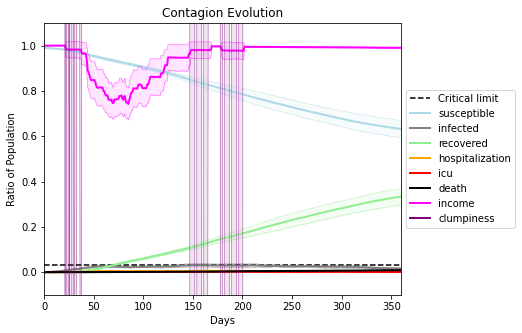

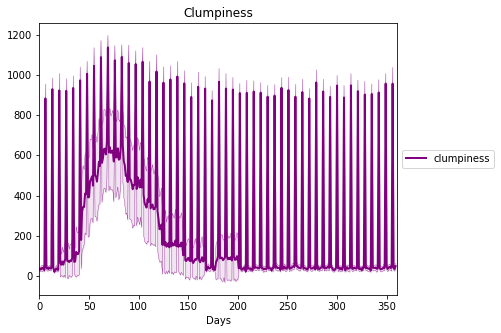

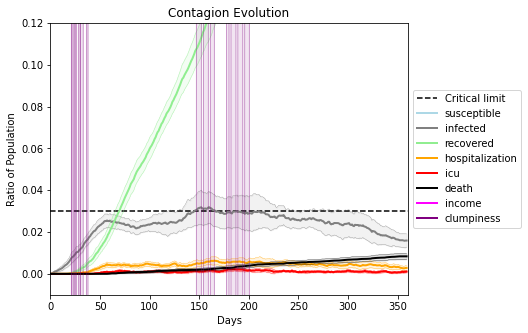

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9899, 3420, 9007, 6997, 5741, 8942, 3729, 4804, 7354, 2817, 6926, 5560, 6604, 4724, 4125, 1442, 4897, 8783, 7012, 366]
Average similarity between family members is 0.05668267773290328 at temperature 0.66
Average similarity between family and home is 0.9998492419619888 at temperature -1
Average similarity between students and their classroom is 0.06689677452795162 at temperature 0.66
Average classroom occupancy is 1.5511363636363635 and number classrooms is 176
Average similarity between workers is 0.08748014812265686 at temperature 0.66
Average office occupancy is 3.3582089552238807 and number offices is 201
Average friend similarity for adults: 0.12527323102026852 for kids: 0.1437114298392802
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity -0.017177392589148497
avg restaurant similarity -0.029307330055160417
avg restaurant similarity 0.03031821434494661
avg restaurant similarity -0.011679285309333586
avg restaurant similarity 0.036146621638686
avg restaurant similarity 0.03233835686326099
avg restaurant similarity -0.0033000043316772074
avg restaurant similarity 0.008830344658022822
avg restaurant similarity 0.008117286548944853
avg restaurant similarity 0.06309916227070453
avg restaurant similarity 0.004429484006306911
avg restaurant similarity 0.01236492881163663
avg restaurant similarity -0.040199234751018935
avg restaurant similarity -0.011374293254122078
avg restaurant similarity -0.0026499735081050736
avg restaurant similarity 0.014939278746425646
avg restaurant similarity -0.019269722303238403
avg restaurant similarity 0.010369303926944467
avg restaurant similarity -0.025482622973086146
avg restaurant similarity 0.012716651410816878
avg restaurant similarity 0.030844348521330483
avg resta

avg restaurant similarity -0.030857645079696502
avg restaurant similarity 0.006268019972267526
avg restaurant similarity 0.020967044525557334
avg restaurant similarity 0.03250334632852406
avg restaurant similarity 0.022497886576880337
avg restaurant similarity 0.018657007998807238
avg restaurant similarity -0.0009482638886098222
avg restaurant similarity 0.010292304264599693
avg restaurant similarity 0.015224933905537546
avg restaurant similarity 0.028409159724154948
avg restaurant similarity -0.0038043058828692916
avg restaurant similarity 0.029425865504668258
avg restaurant similarity -0.01100657328763816
avg restaurant similarity 0.047960979305587695
avg restaurant similarity 0.08210973308411958
avg restaurant similarity 0.010175431976859417
avg restaurant similarity 0.05330356168984
avg restaurant similarity -0.03689643475996875
avg restaurant similarity 0.0030024272442616138
avg restaurant similarity 0.014803703319792418
avg restaurant similarity 0.0033537685050763987
avg restaura

avg restaurant similarity 0.0072540835773196545
avg restaurant similarity 0.016521119168754355
avg restaurant similarity -0.010927006137763312
avg restaurant similarity 0.01571179099023766
avg restaurant similarity 0.052524334285309365
avg restaurant similarity -0.03765994077451382
avg restaurant similarity -0.03689147716640055
avg restaurant similarity 0.027964660920582127
avg restaurant similarity -0.00588702491671667
avg restaurant similarity 0.02024428968469694
avg restaurant similarity -0.004557257063423483
avg restaurant similarity 0.020622677751747743
Average similarity between family members is 0.06079101516429847 at temperature 0.66
Average similarity between family and home is 0.9998703242221343 at temperature -1
Average similarity between students and their classroom is 0.06114880599355308 at temperature 0.66
Average classroom occupancy is 1.6166666666666667 and number classrooms is 180
Average similarity between workers is 0.06292795179862486 at temperature 0.66
Average off

avg restaurant similarity 0.018706165374295706
avg restaurant similarity 0.014786119417782408
avg restaurant similarity 0.041156933222979274
avg restaurant similarity 0.016529902615622854
avg restaurant similarity 0.002295226437454314
avg restaurant similarity 0.04694316857844405
avg restaurant similarity 0.02119488508859744
avg restaurant similarity 0.03182937244281734
avg restaurant similarity 0.050097009562935585
avg restaurant similarity -0.0054297544466672745
avg restaurant similarity 0.03535676426764554
avg restaurant similarity -0.011233842929630965
avg restaurant similarity 0.03358797473984443
avg restaurant similarity 0.026303759668948965
avg restaurant similarity 0.05878343097931769
avg restaurant similarity -0.0040341787256105354
avg restaurant similarity 0.056711216763530505
avg restaurant similarity 0.02716775176351556
avg restaurant similarity 0.029032786698260062
avg restaurant similarity 0.019523895144014865
avg restaurant similarity 0.03270513606448914
avg restaurant s

avg restaurant similarity 0.014534457549988899
avg restaurant similarity 0.01172600457805563
avg restaurant similarity 0.006007160988656492
avg restaurant similarity 0.02993199952457667
avg restaurant similarity 0.07021958397299637
avg restaurant similarity -0.006106577148552795
avg restaurant similarity 0.0018114476974540733
avg restaurant similarity -0.017815254718121218
avg restaurant similarity 0.02790955455649848
avg restaurant similarity 0.0031499053106125623
avg restaurant similarity 0.0754369634385576
avg restaurant similarity -0.0010383871257666946
avg restaurant similarity 0.015197948452276266
avg restaurant similarity 0.025936100934992816
avg restaurant similarity 0.04809987860521424
avg restaurant similarity 0.035654024894610205
avg restaurant similarity 0.023773396778017434
avg restaurant similarity 0.04706727452366847
avg restaurant similarity 0.016734448544847083
avg restaurant similarity 0.050505306296735865
avg restaurant similarity 0.036863324718029784
avg restaurant 

avg restaurant similarity 0.003979180980436161
avg restaurant similarity 0.07067197237409223
avg restaurant similarity 0.026092416398471777
avg restaurant similarity 0.02461682760658775
avg restaurant similarity 0.028228865994540685
avg restaurant similarity 0.012585315889944172
avg restaurant similarity 0.0038307568179939805
avg restaurant similarity 0.0332014672625599
Average similarity between family members is 0.08200145459868455 at temperature 0.66
Average similarity between family and home is 0.9998601438843024 at temperature -1
Average similarity between students and their classroom is 0.11966998477831113 at temperature 0.66
Average classroom occupancy is 1.491891891891892 and number classrooms is 185
Average similarity between workers is 0.0546098348943392 at temperature 0.66
Average office occupancy is 3.3333333333333335 and number offices is 204
Average friend similarity for adults: 0.1385771606502373 for kids: 0.15083757535229922
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.04898804265159579
avg restaurant similarity 0.033038803137233674
avg restaurant similarity 0.03968227436191563
avg restaurant similarity 0.06713012392907738
avg restaurant similarity 0.024508700757309022
avg restaurant similarity 0.04626949662309733
avg restaurant similarity 0.05835080153812984
avg restaurant similarity 0.04206184015926099
avg restaurant similarity 0.04647116616573955
avg restaurant similarity 0.02925258427069407
avg restaurant similarity 0.03874341298168034
avg restaurant similarity 0.06456182742443595
avg restaurant similarity 0.04673400641565192
avg restaurant similarity 0.00934832504553734
avg restaurant similarity 0.033254954186712135
avg restaurant similarity 0.07298980294935566
avg restaurant similarity 0.06979547961635622
avg restaurant similarity 0.0417013498566826
avg restaurant similarity 0.05299255961875468
avg restaurant similarity 0.020487537476068726
avg restaurant similarity 0.024532977170338588
avg restaurant similarity 0.04

avg restaurant similarity 0.07124880884713879
avg restaurant similarity 0.04763037780113276
avg restaurant similarity 0.04509980818046764
avg restaurant similarity 0.1109082257427088
avg restaurant similarity 0.06782114237729163
avg restaurant similarity 0.03175467340780013
avg restaurant similarity 0.05654076809384647
avg restaurant similarity 0.05990594983037807
avg restaurant similarity 0.07383754857577131
avg restaurant similarity 0.06746000445182354
avg restaurant similarity 0.06219207193714418
avg restaurant similarity 0.04891900029490887
avg restaurant similarity 0.04028168538688138
avg restaurant similarity 0.022221362665417493
avg restaurant similarity 0.029425218870189385
avg restaurant similarity 0.06287745885358428
avg restaurant similarity 0.09307739961462842
avg restaurant similarity 0.05823243425848501
avg restaurant similarity 0.03231198837846173
avg restaurant similarity 0.06309879896496913
avg restaurant similarity 0.05276920028195666
avg restaurant similarity 0.04205

avg restaurant similarity 0.017278163478523588
avg restaurant similarity 0.04388967828068697
avg restaurant similarity 0.04803469419337485
avg restaurant similarity 0.050288953220222865
Average similarity between family members is 0.055025222415176094 at temperature 0.66
Average similarity between family and home is 0.9998549888627709 at temperature -1
Average similarity between students and their classroom is 0.06429380414186292 at temperature 0.66
Average classroom occupancy is 1.6407185628742516 and number classrooms is 167
Average similarity between workers is 0.05246769041191155 at temperature 0.66
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults: 0.1228335397328606 for kids: 0.1270493405007863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.051704715406370554
avg restaurant similarity 0.006235674918206809
avg restaurant similarity 0.0050079701639405335
avg restaurant similarity 0.047419047551084594
avg restaurant similarity 0.023466648734783102
avg restaurant similarity 0.011267975744345935
avg restaurant similarity 0.010375729646371823
avg restaurant similarity -0.00020158295573655062
avg restaurant similarity -0.03026226623259406
avg restaurant similarity 0.047659549318175023
avg restaurant similarity 0.07285396816082287
avg restaurant similarity 0.013608706778783551
avg restaurant similarity 0.03205768977472692
avg restaurant similarity 0.04735369953917531
avg restaurant similarity 0.004024205988106977
avg restaurant similarity 0.04863059005545401
avg restaurant similarity -0.010586604022726868
avg restaurant similarity 0.029079720624811237
avg restaurant similarity -0.008242870341464759
avg restaurant similarity -0.0059543370620680335
avg restaurant similarity 0.01659284226334796
avg restau

avg restaurant similarity 0.036816923317228044
avg restaurant similarity 0.04473192260941192
avg restaurant similarity 0.025212914883677225
avg restaurant similarity 0.06156017807049853
avg restaurant similarity 0.005200078209545844
avg restaurant similarity -0.003194207349606631
avg restaurant similarity 0.012694085640813571
avg restaurant similarity 0.003748898640046458
avg restaurant similarity 0.0037720932097830115
avg restaurant similarity 0.0020283192327846594
avg restaurant similarity 0.013384836017616345
avg restaurant similarity 0.022258505432089248
avg restaurant similarity 0.04854560828293181
avg restaurant similarity 0.01960350826630531
avg restaurant similarity 0.06756420127163627
avg restaurant similarity 0.035108233644036375
avg restaurant similarity 0.06110668068106862
avg restaurant similarity 0.03468890467158844
avg restaurant similarity 0.050130530167450255
avg restaurant similarity 0.012193857973670787
avg restaurant similarity 0.004132605121901922
avg restaurant si

avg restaurant similarity 0.034072357625991104
avg restaurant similarity 0.029986088101220252
avg restaurant similarity 0.013558835684010326
avg restaurant similarity 0.04832596876941635
avg restaurant similarity -0.014756913513009999
avg restaurant similarity -0.0006098785034344837
avg restaurant similarity 0.004912869889010107
avg restaurant similarity 0.039519465737679414
avg restaurant similarity 0.020377324231461068
Average similarity between family members is 0.051788451990641804 at temperature 0.66
Average similarity between family and home is 0.999842055458881 at temperature -1
Average similarity between students and their classroom is 0.08489508059930397 at temperature 0.66
Average classroom occupancy is 1.5777777777777777 and number classrooms is 180
Average similarity between workers is 0.0676957727703793 at temperature 0.66
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.13212239493435063 for kids: 0.13487678295172914
home_

avg restaurant similarity -0.013141334271613306
avg restaurant similarity -0.0417888504675174
avg restaurant similarity 0.038882867888732256
avg restaurant similarity 0.0340629337226208
avg restaurant similarity 0.015847402891402754
avg restaurant similarity 0.03775034377728834
avg restaurant similarity 0.009968956555355672
avg restaurant similarity 0.020035520137507992
avg restaurant similarity 0.011221941902652948
avg restaurant similarity 0.036464838129499653
avg restaurant similarity 0.06371065990030185
avg restaurant similarity 0.03921802524085152
avg restaurant similarity 0.014548155674282066
avg restaurant similarity 0.05360973481973565
avg restaurant similarity 0.023253061376811962
avg restaurant similarity 0.014308109825880535
avg restaurant similarity 0.06089885100824434
avg restaurant similarity 0.010756471865730838
avg restaurant similarity 0.01406737745090984
avg restaurant similarity 0.05609060243484
avg restaurant similarity 0.06506165652851909
avg restaurant similarity 

avg restaurant similarity -0.01676921908524619
avg restaurant similarity 0.048380889741631176
avg restaurant similarity 0.01771790219955302
avg restaurant similarity 0.0320567605886109
avg restaurant similarity 0.0020701359116121203
avg restaurant similarity 0.029065794737474004
avg restaurant similarity 0.03098139143559315
avg restaurant similarity 0.0900922443766485
avg restaurant similarity 0.03266549348102453
avg restaurant similarity 0.037006125847263996
avg restaurant similarity 0.008173257007034326
avg restaurant similarity 0.020432030788354847
avg restaurant similarity 0.008877768834878215
avg restaurant similarity 0.038013635407230434
avg restaurant similarity 0.018187893959065043
avg restaurant similarity 0.050122870090914796
avg restaurant similarity 0.0060167911294799325
avg restaurant similarity 0.02560434330020218
avg restaurant similarity 0.01795812488892646
avg restaurant similarity 0.0007951760141894399
avg restaurant similarity 0.03048295370478126
avg restaurant simil

avg restaurant similarity 0.03449148519066096
avg restaurant similarity -0.012610657314199844
avg restaurant similarity 0.02180121816336231
avg restaurant similarity 0.05175170523240303
avg restaurant similarity 0.03386312472211573
avg restaurant similarity 0.023577274015575096
avg restaurant similarity 0.039467336003148695
avg restaurant similarity 0.026405558240594876
Average similarity between family members is 0.06051129021367777 at temperature 0.66
Average similarity between family and home is 0.9998618846719757 at temperature -1
Average similarity between students and their classroom is 0.07297166774007112 at temperature 0.66
Average classroom occupancy is 1.5555555555555556 and number classrooms is 180
Average similarity between workers is 0.04464239465833804 at temperature 0.66
Average office occupancy is 3.31 and number offices is 200
Average friend similarity for adults: 0.132187543508244 for kids: 0.1303916550442941
home_districts
[
Home (0,0) district with 1 Buildings
Homog

avg restaurant similarity -0.008206856970123334
avg restaurant similarity 0.023869425156318024
avg restaurant similarity 0.03878221838124007
avg restaurant similarity 0.10213107678235492
avg restaurant similarity -0.010572218185700777
avg restaurant similarity -0.0015256593519093614
avg restaurant similarity 0.005016447609519594
avg restaurant similarity 0.02688562438286993
avg restaurant similarity 0.035954402582286146
avg restaurant similarity -0.020560920165273236
avg restaurant similarity 0.020751725239818126
avg restaurant similarity 0.006527220219151291
avg restaurant similarity -0.01016791541517758
avg restaurant similarity 0.010638100162273425
avg restaurant similarity -0.005564955642012902
avg restaurant similarity 0.08585958842137771
avg restaurant similarity 0.009535914747601845
avg restaurant similarity 0.06428409599614913
avg restaurant similarity -0.017789286507375046
avg restaurant similarity 0.010325322002584732
avg restaurant similarity 0.03695913738322836
avg restaura

avg restaurant similarity -0.03501179631807057
avg restaurant similarity 0.033335333630895685
avg restaurant similarity 0.07061484565112361
avg restaurant similarity 0.05183576014730786
avg restaurant similarity 0.06834988621933562
avg restaurant similarity -0.04088715442988125
avg restaurant similarity 0.05703600341515801
avg restaurant similarity 0.06785368303998726
avg restaurant similarity -0.025619246985228113
avg restaurant similarity 0.03864454560776883
avg restaurant similarity 0.006205079228744785
avg restaurant similarity 0.08761100042919377
avg restaurant similarity 0.028543758772331573
avg restaurant similarity 0.039850772291313695
avg restaurant similarity 0.11483752169500679
avg restaurant similarity 0.05811064490854794
avg restaurant similarity 0.02820123062332006
avg restaurant similarity 0.03767872517860489
avg restaurant similarity 0.015936353535246806
avg restaurant similarity -0.004491777985170078
avg restaurant similarity 0.015700705780240184
avg restaurant similar

avg restaurant similarity 0.024000058981955334
avg restaurant similarity -0.006490666299726484
avg restaurant similarity -0.001568849301542571
avg restaurant similarity 0.031101372541665843
avg restaurant similarity 0.03961185331601234
avg restaurant similarity 0.039676820524543445
avg restaurant similarity 0.05451182580603051
avg restaurant similarity 0.007828544342062984
avg restaurant similarity -0.009017327720343919
avg restaurant similarity 0.03220962817162982
Average similarity between family members is 0.06510497878580013 at temperature 0.66
Average similarity between family and home is 0.9998433342773614 at temperature -1
Average similarity between students and their classroom is 0.04232325919630256 at temperature 0.66
Average classroom occupancy is 1.6702702702702703 and number classrooms is 185
Average similarity between workers is 0.07025699234720194 at temperature 0.66
Average office occupancy is 3.2 and number offices is 200
Average friend similarity for adults: 0.13336749

avg restaurant similarity 0.035426143450804304
avg restaurant similarity 0.022497317257925475
avg restaurant similarity 0.020825140008099447
avg restaurant similarity 0.041813318700823825
avg restaurant similarity 0.039291791770766235
avg restaurant similarity -0.007822264400892542
avg restaurant similarity 0.04043858262295915
avg restaurant similarity 0.04307643208340801
avg restaurant similarity 0.03956343023462421
avg restaurant similarity 0.04503050987174921
avg restaurant similarity 0.030249235985778354
avg restaurant similarity 0.040101887638857435
avg restaurant similarity 7.334399037108301e-05
avg restaurant similarity 0.0006041810043061649
avg restaurant similarity 0.02935809048561077
avg restaurant similarity 0.004424719158982324
avg restaurant similarity 0.00223862153575412
avg restaurant similarity 0.05473177094975782
avg restaurant similarity 0.042069385822024304
avg restaurant similarity 0.04932579542738412
avg restaurant similarity 0.013647673273668247
avg restaurant sim

avg restaurant similarity 0.048957062765892935
avg restaurant similarity 0.05186085851078389
avg restaurant similarity -0.008750866568257533
avg restaurant similarity 0.0717621577019042
avg restaurant similarity 0.032776605795069524
avg restaurant similarity 0.0017544473317250642
avg restaurant similarity 0.02567534308906328
avg restaurant similarity 0.038763538911076686
avg restaurant similarity 0.016712838624419538
avg restaurant similarity 0.008271347674468943
avg restaurant similarity 0.04296393149946867
avg restaurant similarity 0.03993790002985988
avg restaurant similarity 0.04821334697968351
avg restaurant similarity 0.05308691464648604
avg restaurant similarity 0.046702649480898646
avg restaurant similarity 0.040297295789855976
avg restaurant similarity 0.03609244444851866
avg restaurant similarity 0.06292334686925068
avg restaurant similarity 0.0336545553438898
avg restaurant similarity 0.01715617273108003
avg restaurant similarity 0.06226032335022435
avg restaurant similarity

avg restaurant similarity 0.010986742106801636
avg restaurant similarity 0.02777920084035085
avg restaurant similarity 0.03492014836476332
avg restaurant similarity 0.07005230237807149
avg restaurant similarity 0.02153038859936557
avg restaurant similarity 0.05197033322570103
avg restaurant similarity 0.05193440660424296
Average similarity between family members is 0.05774013230021198 at temperature 0.66
Average similarity between family and home is 0.9998568075045322 at temperature -1
Average similarity between students and their classroom is 0.08343200727331247 at temperature 0.66
Average classroom occupancy is 1.6171428571428572 and number classrooms is 175
Average similarity between workers is 0.05691016418910108 at temperature 0.66
Average office occupancy is 3.2610837438423643 and number offices is 203
Average friend similarity for adults: 0.1285674010665213 for kids: 0.12271257262817122
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wit

avg restaurant similarity -0.004954249124805285
avg restaurant similarity -0.01642643223468378
avg restaurant similarity 0.01799506468734303
avg restaurant similarity 0.03173773115722109
avg restaurant similarity 0.03266055870198201
avg restaurant similarity -0.003526818957021167
avg restaurant similarity 0.005628395061232057
avg restaurant similarity 0.01168407049881361
avg restaurant similarity 0.029322626812484338
avg restaurant similarity -0.011879798019381974
avg restaurant similarity 0.03835660224385967
avg restaurant similarity 0.04248792405063461
avg restaurant similarity 0.006791503924004493
avg restaurant similarity 0.07143825917670064
avg restaurant similarity 0.038783842253319004
avg restaurant similarity 0.027931324348408393
avg restaurant similarity 0.024007496952537104
avg restaurant similarity 0.013477077546311356
avg restaurant similarity 0.04044250141441022
avg restaurant similarity 0.01932343961462373
avg restaurant similarity 0.025895197755203502
avg restaurant simi

avg restaurant similarity 0.03525486223441585
avg restaurant similarity 0.05908411389142497
avg restaurant similarity 0.0030342002277749885
avg restaurant similarity 0.03771103869424228
avg restaurant similarity 0.04067874860043152
avg restaurant similarity -0.013107921098872157
avg restaurant similarity 0.048550470343757986
avg restaurant similarity -0.028659801707810812
avg restaurant similarity 0.005958021842809212
avg restaurant similarity -0.007254085218066865
avg restaurant similarity 0.07283329081830921
avg restaurant similarity -0.05002394599813947
avg restaurant similarity 0.04933609628193008
avg restaurant similarity 0.04929869787694084
avg restaurant similarity 0.017913001391103016
avg restaurant similarity 0.05426632325827731
avg restaurant similarity 0.011739106315030688
avg restaurant similarity -0.0196717910917319
avg restaurant similarity 0.004813058445111164
avg restaurant similarity 0.05155145984225946
avg restaurant similarity 0.01938074058728101
avg restaurant simil

avg restaurant similarity 0.007543936565035941
avg restaurant similarity 0.04408118647364749
avg restaurant similarity -0.016562395098034442
avg restaurant similarity 0.007102342839876404
avg restaurant similarity -0.008898386629714854
avg restaurant similarity 0.005155396432965496
avg restaurant similarity -0.00011502316515791921
avg restaurant similarity -0.0013868080302987342
avg restaurant similarity 0.0004615859749611243
avg restaurant similarity -0.038700550800702886
Average similarity between family members is 0.044462125242247005 at temperature 0.66
Average similarity between family and home is 0.9998620094896897 at temperature -1
Average similarity between students and their classroom is 0.04414601215684028 at temperature 0.66
Average classroom occupancy is 1.6611111111111112 and number classrooms is 180
Average similarity between workers is 0.0484160791758632 at temperature 0.66
Average office occupancy is 3.2388059701492535 and number offices is 201
Average friend similarity

avg restaurant similarity 0.028775275712373156
avg restaurant similarity 0.03428157456087746
avg restaurant similarity 0.04280048742320657
avg restaurant similarity 0.04416020072415626
avg restaurant similarity 0.03565030428394486
avg restaurant similarity 0.06899590087437388
avg restaurant similarity 0.059668426589605444
avg restaurant similarity 0.018182476320415968
avg restaurant similarity 0.007381948772942012
avg restaurant similarity 0.05171393296694048
avg restaurant similarity 0.007294820780675694
avg restaurant similarity 0.029371522988367937
avg restaurant similarity 0.01242575120820049
avg restaurant similarity 0.05932777028863385
avg restaurant similarity 0.048508684363372426
avg restaurant similarity 0.04890802993385928
avg restaurant similarity 0.03141071932836093
avg restaurant similarity 0.01565375397665104
avg restaurant similarity 0.032728642527132056
avg restaurant similarity 0.0011625894693336383
avg restaurant similarity 0.029547400740598032
avg restaurant similari

avg restaurant similarity 0.0029458298119475145
avg restaurant similarity 0.015658680308084517
avg restaurant similarity 0.03721565819216249
avg restaurant similarity 0.011502626801662695
avg restaurant similarity 0.007264404734014657
avg restaurant similarity 0.06266563571445473
avg restaurant similarity 0.008148815065402304
avg restaurant similarity 0.03803391183192729
avg restaurant similarity 0.04501088200850483
avg restaurant similarity 0.025782839610856624
avg restaurant similarity 0.04275505362753192
avg restaurant similarity 0.04002351823479464
avg restaurant similarity 0.024249875116012017
avg restaurant similarity 0.025857993094803095
avg restaurant similarity 0.039501248821495964
avg restaurant similarity 0.04587009310786432
avg restaurant similarity 0.06086833162591627
avg restaurant similarity 0.04576069984885123
avg restaurant similarity 0.04390691899650226
avg restaurant similarity 0.01398823333732509
avg restaurant similarity 0.01955246761855585
avg restaurant similarit

avg restaurant similarity 0.012399073274088061
avg restaurant similarity 0.026921151858256567
avg restaurant similarity -0.001328778570572196
avg restaurant similarity 0.04409931626496669
avg restaurant similarity 0.03290358466010036
avg restaurant similarity -0.007801231363874439
avg restaurant similarity -0.013309628081349141
Average similarity between family members is 0.04053156943805831 at temperature 0.66
Average similarity between family and home is 0.9998540081274683 at temperature -1
Average similarity between students and their classroom is 0.039187780128287705 at temperature 0.66
Average classroom occupancy is 1.6497175141242937 and number classrooms is 177
Average similarity between workers is 0.05832489925343331 at temperature 0.66
Average office occupancy is 3.2390243902439027 and number offices is 205
Average friend similarity for adults: 0.12823316950155716 for kids: 0.12508617190235863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity -0.01743514252837989
avg restaurant similarity 0.0032361618436788473
avg restaurant similarity 0.06334696472147572
avg restaurant similarity 0.012167371332809802
avg restaurant similarity -0.007018854523448016
avg restaurant similarity -0.0002812442842067914
avg restaurant similarity -0.028764688094547398
avg restaurant similarity 0.006943282581058217
avg restaurant similarity -0.014015100150022613
avg restaurant similarity 0.026446602678578554
avg restaurant similarity 0.06972444444047353
avg restaurant similarity -0.007024781807507865
avg restaurant similarity 0.015562136752305826
avg restaurant similarity -0.01493291455556926
avg restaurant similarity 0.0341753896099757
avg restaurant similarity 0.010619341239196872
avg restaurant similarity 0.04583429667861625
avg restaurant similarity 0.03976430663822645
avg restaurant similarity -0.009108168508862233
avg restaurant similarity 0.02103472009994072
avg restaurant similarity -0.05247799639949899
avg restaura

avg restaurant similarity 0.023550417157045846
avg restaurant similarity -0.007734555213466633
avg restaurant similarity 0.03590852258299661
avg restaurant similarity -0.01712718458745511
avg restaurant similarity 0.019399925667688365
avg restaurant similarity -0.003320653464225295
avg restaurant similarity 0.008149668515256009
avg restaurant similarity 0.04797104456668867
avg restaurant similarity 0.03645164256432848
avg restaurant similarity 0.02326318582748403
avg restaurant similarity -0.03338489768052837
avg restaurant similarity 0.0034979282640567252
avg restaurant similarity 0.014447682786031698
avg restaurant similarity 0.05512232963045525
avg restaurant similarity 0.005727441604188233
avg restaurant similarity 0.023291623255699067
avg restaurant similarity 0.062945453271578
avg restaurant similarity 0.03335472317313557
avg restaurant similarity 0.04559650715277748
avg restaurant similarity 0.01387886749867762
avg restaurant similarity 0.007986063092033863
avg restaurant simila

avg restaurant similarity -0.03788205821149827
avg restaurant similarity -0.0252375821655244
avg restaurant similarity 0.008984873518360767
avg restaurant similarity 0.011119539348253169
avg restaurant similarity 0.023474964628151514
avg restaurant similarity 0.004641271288704165
avg restaurant similarity -0.0026035253188162522
avg restaurant similarity 0.00683272409284418
avg restaurant similarity 0.01897936341661759
avg restaurant similarity 0.019644884470108405
Average similarity between family members is 0.05307091989845217 at temperature 0.66
Average similarity between family and home is 0.9998601008375682 at temperature -1
Average similarity between students and their classroom is 0.03007770697426921 at temperature 0.66
Average classroom occupancy is 1.576271186440678 and number classrooms is 177
Average similarity between workers is 0.05461861141623733 at temperature 0.66
Average office occupancy is 3.3009708737864076 and number offices is 206
Average friend similarity for adult

avg restaurant similarity 0.05304584375538599
avg restaurant similarity -0.00045086254953716356
avg restaurant similarity 0.026081818076661593
avg restaurant similarity 0.033587609115584074
avg restaurant similarity 0.07095511899799767
avg restaurant similarity 0.00022220679088664734
avg restaurant similarity 0.03302191978414283
avg restaurant similarity 0.05577908559666641
avg restaurant similarity -0.013615168257461561
avg restaurant similarity 0.05088598098532177
avg restaurant similarity 0.011449464785883968
avg restaurant similarity 0.025637022638166893
avg restaurant similarity 0.01936453507245733
avg restaurant similarity 0.02330624921413075
avg restaurant similarity 0.009970155522512174
avg restaurant similarity -0.02262549001379467
avg restaurant similarity 0.039442897787275284
avg restaurant similarity 0.024045278569024647
avg restaurant similarity -0.005367310098199352
avg restaurant similarity -0.0052679261339514775
avg restaurant similarity 0.009849389867069423
avg restaur

avg restaurant similarity 0.002034943732573764
avg restaurant similarity 0.029101174342017592
avg restaurant similarity 0.015609425270591754
avg restaurant similarity 0.01395483808467607
avg restaurant similarity 0.05400055220694305
avg restaurant similarity -0.01260417256324545
avg restaurant similarity -0.017767062933185376
avg restaurant similarity 0.02471480067634329
avg restaurant similarity 0.06817910668658173
avg restaurant similarity 0.04857974248377951
avg restaurant similarity 0.010218800462220377
avg restaurant similarity -0.013463833205226868
avg restaurant similarity 0.051046125464396394
avg restaurant similarity 0.013137063104003434
avg restaurant similarity 0.02827829914927608
avg restaurant similarity 0.030805031205944383
avg restaurant similarity 0.03844459722910053
avg restaurant similarity 0.026495428884021482
avg restaurant similarity 0.033033245527342825
avg restaurant similarity 0.05409289538679371
avg restaurant similarity 0.021013085564304028
avg restaurant simi

avg restaurant similarity 0.06319502814717157
avg restaurant similarity 0.04090855971069465
avg restaurant similarity 0.028288144148348997
avg restaurant similarity -0.0007237103569361195
avg restaurant similarity 0.01687811814309629
avg restaurant similarity 0.02220318199498549
avg restaurant similarity 0.0523174947090695
avg restaurant similarity 0.0165995932413469
avg restaurant similarity 0.029233278158556926
Average similarity between family members is 0.05679222363904652 at temperature 0.66
Average similarity between family and home is 0.9998533502298743 at temperature -1
Average similarity between students and their classroom is 0.05551025916853532 at temperature 0.66
Average classroom occupancy is 1.5642458100558658 and number classrooms is 179
Average similarity between workers is 0.067224656528957 at temperature 0.66
Average office occupancy is 3.3004926108374386 and number offices is 203
Average friend similarity for adults: 0.12385853575229826 for kids: 0.1220384173133758
h

avg restaurant similarity 0.0008655636029003744
avg restaurant similarity 0.02089283800920436
avg restaurant similarity 0.023835585032648033
avg restaurant similarity 0.06893599302224263
avg restaurant similarity 0.04244317574888026
avg restaurant similarity 0.03140267057851376
avg restaurant similarity 0.05726561480850004
avg restaurant similarity -0.012880917979030841
avg restaurant similarity 0.030118060740816157
avg restaurant similarity 0.028847932335894253
avg restaurant similarity 0.07365503527181001
avg restaurant similarity 0.0055595482564974
avg restaurant similarity 0.0902620026970657
avg restaurant similarity 0.0412585812746477
avg restaurant similarity 0.05676571819727813
avg restaurant similarity 0.060605987484594406
avg restaurant similarity 0.03994355943492954
avg restaurant similarity -0.040315894188590426
avg restaurant similarity 0.07419088463726865
avg restaurant similarity 0.06921253034702216
avg restaurant similarity -0.002982055513310544
avg restaurant similarity

avg restaurant similarity 0.004846814976214988
avg restaurant similarity 0.04393299882613081
avg restaurant similarity 0.011563426133081726
avg restaurant similarity 0.05421937490640436
avg restaurant similarity 0.054224785695555645
avg restaurant similarity 0.041617746140227514
avg restaurant similarity 0.023260552848936022
avg restaurant similarity 0.045492687676968936
avg restaurant similarity -0.009039162684480406
avg restaurant similarity 0.02418696919450519
avg restaurant similarity 0.00018237347339762787
avg restaurant similarity 0.024283424291227675
avg restaurant similarity -0.007279913063030506
avg restaurant similarity 0.056091872121879806
avg restaurant similarity -0.007979590864351942
avg restaurant similarity 0.06550487873224044
avg restaurant similarity -4.7189030468960944e-05
avg restaurant similarity 0.012411029523301517
avg restaurant similarity 0.02517090413336637
avg restaurant similarity 0.023000373121521003
avg restaurant similarity 0.048492297418716315
avg restau

avg restaurant similarity 0.06323956983289697
avg restaurant similarity 0.08473362767281753
avg restaurant similarity 0.04008745164195929
avg restaurant similarity 0.03957805689864515
avg restaurant similarity -0.009661145365250668
avg restaurant similarity -0.004564807032668087
avg restaurant similarity 0.02286702160437284
Average similarity between family members is 0.06379365331741933 at temperature 0.66
Average similarity between family and home is 0.9998527671498596 at temperature -1
Average similarity between students and their classroom is 0.06527552929332409 at temperature 0.66
Average classroom occupancy is 1.6077348066298343 and number classrooms is 181
Average similarity between workers is 0.053887708564999935 at temperature 0.66
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.11994185179937521 for kids: 0.12031596842262232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity 0.018621259695838856
avg restaurant similarity -0.010278337880124194
avg restaurant similarity -0.039953423370650984
avg restaurant similarity 0.005325880969626791
avg restaurant similarity -0.01070713678112527
avg restaurant similarity 0.030956686855315014
avg restaurant similarity 0.06045760099792643
avg restaurant similarity 0.07118718280930461
avg restaurant similarity -0.005045546005440912
avg restaurant similarity 0.017730845451910764
avg restaurant similarity 0.016029296947180572
avg restaurant similarity 0.10090038453436266
avg restaurant similarity 0.024609046624539558
avg restaurant similarity 0.006264797382634142
avg restaurant similarity -0.02066948149638197
avg restaurant similarity 0.0729174503417772
avg restaurant similarity 0.03783681376725446
avg restaurant similarity 0.018538791104425602
avg restaurant similarity 0.07311340966811877
avg restaurant similarity 0.015729139818881174
avg restaurant similarity 0.031004225661673785
avg restaurant si

avg restaurant similarity 0.07368640218776684
avg restaurant similarity 0.08969833173349866
avg restaurant similarity 0.04929842973927328
avg restaurant similarity -0.0021404712279552746
avg restaurant similarity 0.0379744070249839
avg restaurant similarity 0.03799542655091413
avg restaurant similarity 0.020774990641321264
avg restaurant similarity 0.011879353492132984
avg restaurant similarity 0.021271090764145024
avg restaurant similarity 0.05965959852407861
avg restaurant similarity 0.08078814671001947
avg restaurant similarity 0.02935685634683634
avg restaurant similarity 0.04196614267233393
avg restaurant similarity 0.01329575510175715
avg restaurant similarity 0.03331329729414028
avg restaurant similarity 0.020839121832701007
avg restaurant similarity 0.06721917409453886
avg restaurant similarity -0.013709261675709891
avg restaurant similarity 0.027306542125493886
avg restaurant similarity -0.014968051304872323
avg restaurant similarity 0.060779347376260125
avg restaurant similar

avg restaurant similarity 0.044647745674001704
avg restaurant similarity 0.09204690889407804
avg restaurant similarity 0.07308841796647626
avg restaurant similarity 0.0056782431124427985
avg restaurant similarity 0.047001944551141234
avg restaurant similarity 0.024711404227466566
avg restaurant similarity 0.06767108794510404
Average similarity between family members is 0.04436550987882349 at temperature 0.66
Average similarity between family and home is 0.9998418691390931 at temperature -1
Average similarity between students and their classroom is 0.052446990849358825 at temperature 0.66
Average classroom occupancy is 1.668639053254438 and number classrooms is 169
Average similarity between workers is 0.05996886056699576 at temperature 0.66
Average office occupancy is 3.209756097560976 and number offices is 205
Average friend similarity for adults: 0.12343117494588281 for kids: 0.12263883714327593
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.04215287459746297
avg restaurant similarity -0.012330704159547946
avg restaurant similarity 0.07596262912224593
avg restaurant similarity 0.00394371673669755
avg restaurant similarity -0.012117978401952454
avg restaurant similarity 0.025957275186451592
avg restaurant similarity -0.0010492524288608443
avg restaurant similarity -0.047971340525357134
avg restaurant similarity -0.04578750562716622
avg restaurant similarity -0.08381828057112956
avg restaurant similarity 0.007321290954688261
avg restaurant similarity -0.026465148303482667
avg restaurant similarity 0.008611791294458236
avg restaurant similarity 0.0011491789305069287
avg restaurant similarity 0.04233943637644408
avg restaurant similarity -0.0009377404814517377
avg restaurant similarity 0.022573434358413986
avg restaurant similarity 0.006995190160780384
avg restaurant similarity -0.034920794301478236
avg restaurant similarity -0.04179568186192397
avg restaurant similarity -0.016183598405763607
avg re

avg restaurant similarity 0.09156164854692904
avg restaurant similarity 0.008928757989412568
avg restaurant similarity 0.003481777731932024
avg restaurant similarity 0.03608945636989165
avg restaurant similarity -0.018836993398996988
avg restaurant similarity 0.02601394996647979
avg restaurant similarity 0.008011481473421435
avg restaurant similarity -0.006377859482142263
avg restaurant similarity 0.08783579978485122
avg restaurant similarity -0.021090112906163905
avg restaurant similarity -0.0035561213309543704
avg restaurant similarity 0.03162209609464788
avg restaurant similarity -0.005738011020133944
avg restaurant similarity 0.02614560476526297
avg restaurant similarity -0.050790148866269584
avg restaurant similarity 0.0711461433950347
avg restaurant similarity -0.00623457366441405
avg restaurant similarity 0.03664492367473261
avg restaurant similarity 0.011203822096184696
avg restaurant similarity 0.01378230730655334
avg restaurant similarity 0.015819519696586685
avg restaurant s

avg restaurant similarity 0.021091648903374453
avg restaurant similarity -0.027072809597217626
avg restaurant similarity 0.0029972504167256244
avg restaurant similarity 0.023119671386226386
avg restaurant similarity 0.004566028378225118
avg restaurant similarity 0.024627221761062388
avg restaurant similarity -0.003439683887997029
avg restaurant similarity -0.030069245623365326
avg restaurant similarity 0.04521778236141
avg restaurant similarity -0.03358065118258647
Average similarity between family members is 0.040798249955650824 at temperature 0.66
Average similarity between family and home is 0.9998591751612949 at temperature -1
Average similarity between students and their classroom is 0.04858205923433954 at temperature 0.66
Average classroom occupancy is 1.5953757225433527 and number classrooms is 173
Average similarity between workers is 0.04230636519270236 at temperature 0.66
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for ad

avg restaurant similarity 0.02289003173571884
avg restaurant similarity 0.010784373520917368
avg restaurant similarity -0.01990858490617373
avg restaurant similarity 0.018188801614497322
avg restaurant similarity 0.06659316422292574
avg restaurant similarity 0.03750270876081987
avg restaurant similarity 0.028084622796770216
avg restaurant similarity 0.042015942261075793
avg restaurant similarity 0.041841969136450476
avg restaurant similarity 0.0330646251526303
avg restaurant similarity 0.018751947757940902
avg restaurant similarity 0.007914382214283778
avg restaurant similarity 0.02733362518981181
avg restaurant similarity 0.046654251518976494
avg restaurant similarity 0.004753436288959484
avg restaurant similarity 0.02753956342297263
avg restaurant similarity 0.023584321019205566
avg restaurant similarity 0.021369429283883336
avg restaurant similarity 0.07661934441091148
avg restaurant similarity 0.0463727313571129
avg restaurant similarity -0.0018521231699321604
avg restaurant simila

avg restaurant similarity 0.012020090521555548
avg restaurant similarity 0.07218277173846262
avg restaurant similarity 0.007868273505111396
avg restaurant similarity 0.01051387922718245
avg restaurant similarity 0.021085717090844107
avg restaurant similarity 0.000160751135961474
avg restaurant similarity 0.04460766170758972
avg restaurant similarity 0.06682296490695844
avg restaurant similarity 0.023672512613784627
avg restaurant similarity 0.006165622322997231
avg restaurant similarity 0.01580535625099442
avg restaurant similarity 0.017789873739021148
avg restaurant similarity -0.01262967657040379
avg restaurant similarity 0.01780077126198189
avg restaurant similarity 0.038883786262040365
avg restaurant similarity 0.04848276300570478
avg restaurant similarity 0.03339923592662639
avg restaurant similarity 0.02206642138505322
avg restaurant similarity 0.02996510776488542
avg restaurant similarity 0.019219590792411492
avg restaurant similarity 0.0014336165470278889
avg restaurant similar

avg restaurant similarity 0.043977774559786374
avg restaurant similarity 0.01889832849104084
avg restaurant similarity 0.015409485574670322
avg restaurant similarity 0.029352919032870888
avg restaurant similarity 0.028725651855518345
avg restaurant similarity 0.07876375872628548
avg restaurant similarity 0.042632224216554875
avg restaurant similarity -0.0014537883338380062
Average similarity between family members is 0.07062434901540278 at temperature 0.66
Average similarity between family and home is 0.9998564940524018 at temperature -1
Average similarity between students and their classroom is 0.1086377173427114 at temperature 0.66
Average classroom occupancy is 1.5119047619047619 and number classrooms is 168
Average similarity between workers is 0.06636720358088913 at temperature 0.66
Average office occupancy is 3.4088669950738915 and number offices is 203
Average friend similarity for adults: 0.12258852899934018 for kids: 0.13958261985081744
home_districts
[
Home (0,0) district wit

avg restaurant similarity 0.022990627590847818
avg restaurant similarity 0.0021742291982075573
avg restaurant similarity 0.027087566738594394
avg restaurant similarity 0.04969819117370848
avg restaurant similarity 0.02118922210059754
avg restaurant similarity 0.025034409131682336
avg restaurant similarity 0.03471069078558898
avg restaurant similarity 0.0799066218914523
avg restaurant similarity 0.044478244812391786
avg restaurant similarity 0.04006297539728259
avg restaurant similarity 0.04781589894373962
avg restaurant similarity 0.03379587886019677
avg restaurant similarity 0.010728198216281373
avg restaurant similarity 0.061945675982110975
avg restaurant similarity -0.012503739674191702
avg restaurant similarity 0.0016419086332304766
avg restaurant similarity 0.02367112053818016
avg restaurant similarity 0.02784023082832242
avg restaurant similarity 0.023291742707726968
avg restaurant similarity 0.05332333897954078
avg restaurant similarity 0.07597753726049124
avg restaurant similar

avg restaurant similarity 0.06224239000789748
avg restaurant similarity 0.06565453481507075
avg restaurant similarity 0.0758659363037545
avg restaurant similarity 0.048030183940681134
avg restaurant similarity 0.003628077720480437
avg restaurant similarity 0.035131441720765856
avg restaurant similarity 0.043891219398107924
avg restaurant similarity 0.08541692990355548
avg restaurant similarity 0.03847584256891644
avg restaurant similarity 0.026054027206027595
avg restaurant similarity 0.043456173601967615
avg restaurant similarity 0.01921872667668755
avg restaurant similarity -0.007779683941761406
avg restaurant similarity 0.06252734095549424
avg restaurant similarity 0.04169236380153449
avg restaurant similarity 0.00809601827236465
avg restaurant similarity 0.06923694776259467
avg restaurant similarity 0.03386144977125437
avg restaurant similarity 0.03209215379976626
avg restaurant similarity 0.0045777526363137274
avg restaurant similarity 0.03592112712509073
avg restaurant similarity

avg restaurant similarity 0.048180921042211465
avg restaurant similarity 0.029431527428035353
avg restaurant similarity 0.031686682509080535
avg restaurant similarity 0.05638380494228067
avg restaurant similarity 0.02692847189598261
avg restaurant similarity 0.07833947907128778
Average similarity between family members is 0.04471442908052568 at temperature 0.66
Average similarity between family and home is 0.999855702073084 at temperature -1
Average similarity between students and their classroom is 0.06657523668914314 at temperature 0.66
Average classroom occupancy is 1.5513513513513513 and number classrooms is 185
Average similarity between workers is 0.028944670494156534 at temperature 0.66
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.12274505178114364 for kids: 0.11834028944460871
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units

avg restaurant similarity -0.01660740110815282
avg restaurant similarity -0.0063801628381712095
avg restaurant similarity 0.030120977166688635
avg restaurant similarity 0.020515391585844193
avg restaurant similarity 0.027783906673859205
avg restaurant similarity 0.029381587357389712
avg restaurant similarity 0.009175866837218685
avg restaurant similarity 0.02696167833361988
avg restaurant similarity 0.06601096685129601
avg restaurant similarity 0.02223959045549776
avg restaurant similarity 0.005254416706724392
avg restaurant similarity 0.009322460981015282
avg restaurant similarity 0.05668655249164594
avg restaurant similarity -0.011226626299604824
avg restaurant similarity 0.025130347160651545
avg restaurant similarity 0.04680239099438166
avg restaurant similarity 0.0050753877383744395
avg restaurant similarity -0.01288105662075521
avg restaurant similarity 0.009811767543679215
avg restaurant similarity -0.008876212159203395
avg restaurant similarity -0.028690930661282248
avg restaura

avg restaurant similarity -0.021026373102572386
avg restaurant similarity 0.01341349917649202
avg restaurant similarity 0.041326508795041385
avg restaurant similarity 0.0605567697558739
avg restaurant similarity 0.017609177932178532
avg restaurant similarity 0.020989465556245358
avg restaurant similarity 0.012407061243699785
avg restaurant similarity 0.018783618308005668
avg restaurant similarity 0.04992957006572033
avg restaurant similarity -0.004979848397156386
avg restaurant similarity 0.038440850815245814
avg restaurant similarity -0.01055174914064467
avg restaurant similarity 0.004025002223854984
avg restaurant similarity 0.021197717037094246
avg restaurant similarity 0.03308956138958742
avg restaurant similarity -0.00627004407009873
avg restaurant similarity 0.04276327274970422
avg restaurant similarity 0.0024088182120540107
avg restaurant similarity 0.008252929901174324
avg restaurant similarity 0.008496479684076573
avg restaurant similarity 0.0027050442065218038
avg restaurant 

avg restaurant similarity 0.033511653321090205
avg restaurant similarity 0.04592119581036461
avg restaurant similarity -0.028342221437966095
avg restaurant similarity 0.04553661618392403
avg restaurant similarity 0.009088491593811823
avg restaurant similarity 0.0464433593652189
avg restaurant similarity 0.01045986486120981
avg restaurant similarity -0.013782623047548249
avg restaurant similarity 0.036752751329480714
avg restaurant similarity -0.02869100102979987
Average similarity between family members is 0.05169816688903734 at temperature 0.66
Average similarity between family and home is 0.9998532964385408 at temperature -1
Average similarity between students and their classroom is 0.06703489759644608 at temperature 0.66
Average classroom occupancy is 1.5257142857142858 and number classrooms is 175
Average similarity between workers is 0.050305890307412664 at temperature 0.66
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults

avg restaurant similarity 0.05399916400730663
avg restaurant similarity 0.059583790084834685
avg restaurant similarity 0.017929466914656488
avg restaurant similarity 0.02885849596843816
avg restaurant similarity 0.029333933234889215
avg restaurant similarity 0.046185196034838456
avg restaurant similarity 0.056002524744886456
avg restaurant similarity 0.05377051007123431
avg restaurant similarity 0.06884814262701364
avg restaurant similarity 0.03576944824631694
avg restaurant similarity -0.0034896088227096595
avg restaurant similarity 0.040481365515397986
avg restaurant similarity 0.022222188764690915
avg restaurant similarity 0.055950792558752474
avg restaurant similarity 0.013690506638624776
avg restaurant similarity 0.05046658617408868
avg restaurant similarity 0.06520015287623528
avg restaurant similarity 0.021347853924891965
avg restaurant similarity 0.05404786776676458
avg restaurant similarity 0.029567637884198507
avg restaurant similarity -0.018337764585742797
avg restaurant sim

avg restaurant similarity 0.073367769905308
avg restaurant similarity 0.10073611290095683
avg restaurant similarity 0.02748775654119252
avg restaurant similarity 0.037776764126132435
avg restaurant similarity 0.05990539010592316
avg restaurant similarity 0.021731082351538738
avg restaurant similarity 0.04690567271046692
avg restaurant similarity 0.006690961909123035
avg restaurant similarity 0.03782832592932278
avg restaurant similarity 0.05539242332641808
avg restaurant similarity 0.03445667415088466
avg restaurant similarity 0.05107442227128309
avg restaurant similarity 0.048002292496573576
avg restaurant similarity 0.014056727269895005
avg restaurant similarity 0.06460083369548357
avg restaurant similarity 0.02038567373179809
avg restaurant similarity 0.04555788419723618
avg restaurant similarity -0.001062642166088057
avg restaurant similarity 0.04026792639235641
avg restaurant similarity 0.057310921243852786
avg restaurant similarity 0.02316819835389683
avg restaurant similarity 0.

avg restaurant similarity 0.040582890100000435
avg restaurant similarity 0.053767762128304857
avg restaurant similarity 0.057221462545601696
avg restaurant similarity 0.02257804284889635
avg restaurant similarity 0.030643435894592664
avg restaurant similarity 0.039958976509943664
avg restaurant similarity 0.03501202764372516
Average similarity between family members is 0.07977243104813372 at temperature 0.66
Average similarity between family and home is 0.9998680959047522 at temperature -1
Average similarity between students and their classroom is 0.07136713301387526 at temperature 0.66
Average classroom occupancy is 1.611764705882353 and number classrooms is 170
Average similarity between workers is 0.05252968336220135 at temperature 0.66
Average office occupancy is 3.303921568627451 and number offices is 204
Average friend similarity for adults: 0.11917607561843208 for kids: 0.1382638675603588
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each w

avg restaurant similarity -0.007360781475113122
avg restaurant similarity 0.0068488710308160375
avg restaurant similarity 0.007944029721648033
avg restaurant similarity 0.027975358256139005
avg restaurant similarity 0.031318353112768385
avg restaurant similarity 0.032258675824624196
avg restaurant similarity 0.030088237373136047
avg restaurant similarity 0.030250877992125284
avg restaurant similarity 0.030346407193610023
avg restaurant similarity -0.008158074247251254
avg restaurant similarity -0.0005440506387637754
avg restaurant similarity 0.018608169898607262
avg restaurant similarity 0.05957443622958775
avg restaurant similarity 0.022582417265805177
avg restaurant similarity 0.039651622012721155
avg restaurant similarity -0.006135519485054423
avg restaurant similarity 0.051901867881189716
avg restaurant similarity -0.03148963425469015
avg restaurant similarity 0.009262328644973917
avg restaurant similarity 0.0201061297948309
avg restaurant similarity -0.005501669726713684
avg resta

avg restaurant similarity -0.020675040367483712
avg restaurant similarity 0.016189703952923587
avg restaurant similarity -0.005877608715470014
avg restaurant similarity -0.006339846095063377
avg restaurant similarity 0.03945505524142195
avg restaurant similarity -0.004630053324389264
avg restaurant similarity -0.0012024439540639692
avg restaurant similarity 0.06265541258977343
avg restaurant similarity 0.007416595542054386
avg restaurant similarity -0.023162613208264727
avg restaurant similarity 0.014327213500649309
avg restaurant similarity -0.007032677591969627
avg restaurant similarity 0.01705120924409979
avg restaurant similarity 0.015843325120882063
avg restaurant similarity 0.024429305907863293
avg restaurant similarity 0.022944257499516195
avg restaurant similarity 0.04118480004194017
avg restaurant similarity -0.0011742840859425528
avg restaurant similarity 0.018672928875393062
avg restaurant similarity 0.020751042882933213
avg restaurant similarity -0.005923969319846296
avg re

avg restaurant similarity -0.005763000353371667
avg restaurant similarity 0.0039480035207430314
avg restaurant similarity -0.016740101775645368
avg restaurant similarity 0.0035440310831681165
avg restaurant similarity -0.0030119880250081906
avg restaurant similarity 0.013759333622651816
avg restaurant similarity -0.038649503704338076
avg restaurant similarity -0.0126237031956632
avg restaurant similarity 0.04443911577996484
avg restaurant similarity 0.02553384956137234
avg restaurant similarity 0.030786669190032496
avg restaurant similarity 0.024303801385794483
Average similarity between family members is 0.05347144280080195 at temperature 0.66
Average similarity between family and home is 0.9998503572114799 at temperature -1
Average similarity between students and their classroom is 0.08974016843877192 at temperature 0.66
Average classroom occupancy is 1.6703296703296704 and number classrooms is 182
Average similarity between workers is 0.05135691927682467 at temperature 0.66
Average 

avg restaurant similarity 0.04187700228741134
avg restaurant similarity 0.03894085978571577
avg restaurant similarity 0.013121050255352866
avg restaurant similarity -0.02103797533354729
avg restaurant similarity 0.06029875794931755
avg restaurant similarity 0.01857312786920329
avg restaurant similarity 0.045924238275462125
avg restaurant similarity 0.058693884563762275
avg restaurant similarity 0.0204951821118193
avg restaurant similarity 0.03534606628822783
avg restaurant similarity 0.046113734530453254
avg restaurant similarity 0.0013487541285690725
avg restaurant similarity 0.044457911457506424
avg restaurant similarity 0.046178158399124834
avg restaurant similarity 0.021613797653190388
avg restaurant similarity 0.05222172254914645
avg restaurant similarity 0.034169686470497306
avg restaurant similarity 0.07989046138984829
avg restaurant similarity -0.008798939117665758
avg restaurant similarity 0.008279881431163275
avg restaurant similarity 0.0024202018764429285
avg restaurant simi

avg restaurant similarity 0.046046671474669995
avg restaurant similarity 0.058028982812209966
avg restaurant similarity 0.04292548208324863
avg restaurant similarity 0.017922392244603628
avg restaurant similarity 0.08275973323787678
avg restaurant similarity 0.03020969610194117
avg restaurant similarity 0.04035401716471149
avg restaurant similarity 0.04106625809328606
avg restaurant similarity 0.03621646252766572
avg restaurant similarity 0.02608290235752799
avg restaurant similarity 0.03379510319387023
avg restaurant similarity 0.0048562547465493735
avg restaurant similarity 0.02256582008135534
avg restaurant similarity 0.004671812176129775
avg restaurant similarity 0.06273761732680787
avg restaurant similarity 0.03663092386328478
avg restaurant similarity 0.013659856625568217
avg restaurant similarity 0.05440261728064081
avg restaurant similarity 0.04295591492535309
avg restaurant similarity 0.04803436094130032
avg restaurant similarity 0.03987407395187199
avg restaurant similarity 0

avg restaurant similarity 0.03623702876423131
avg restaurant similarity 0.05037524460065641
avg restaurant similarity 0.037462169468231735
avg restaurant similarity 0.05117939591191629
avg restaurant similarity 0.02006849253169605
avg restaurant similarity 0.0991206276011541
avg restaurant similarity 0.029944748326959134
using average of time series:
stats on susceptible:
data: [0.8348749999999998, 0.7758361111111111, 0.7966074000221558, 0.7744611111111113, 0.8222305555555555, 0.7749305555555556, 0.7051670551670552, 0.8276249999999999, 0.8474416666666665, 0.8699305555555555, 0.8572916666666667, 0.794725, 0.8682749999999999, 0.8531750000000001, 0.8136999999999999, 0.8526083333333332, 0.8491073408738079, 0.9034888888888888, 0.8418444444444445, 0.8412750000000001]
min:
0.7051670551670552
max:
0.9034888888888888
std:
0.04363700745219686
mean:
0.8252297842475953
median:
0.8380749999999999
95% confidence interval for the mean:
(0.8042764867651692,0.8461830817300214)
using average of time ser

(<function dict.items>, <function dict.items>, <function dict.items>)

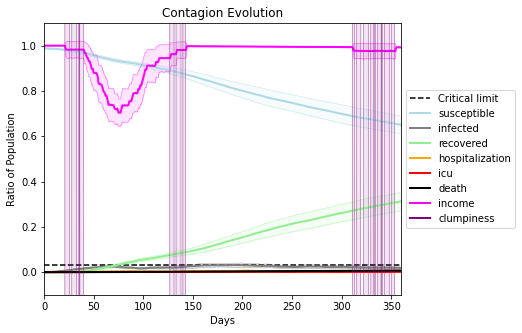

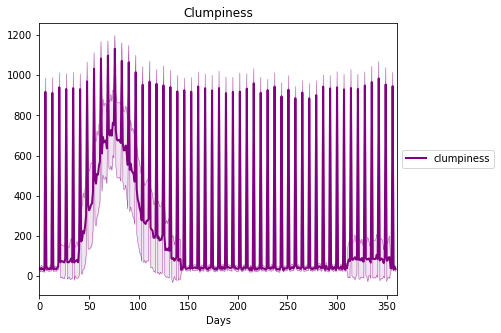

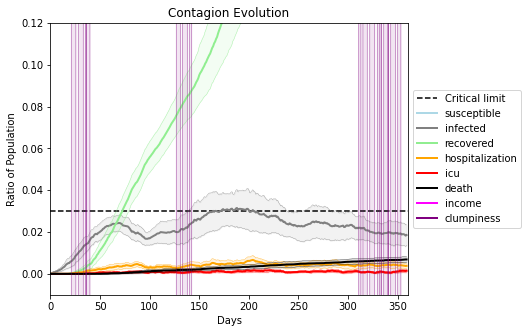

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7888, 6341, 6216, 6095, 9928, 6971, 4770, 4898, 4886, 3128, 6829, 801, 7912, 202, 4743, 7667, 4803, 2558, 8426, 4809]
Average similarity between family members is 0.01359754200358174 at temperature 1
Average similarity between family and home is 0.9998561863390731 at temperature -1
Average similarity between students and their classroom is -0.014596415725216232 at temperature 1
Average classroom occupancy is 1.548913043478261 and number classrooms is 184
Average similarity between workers is 0.006262635368817806 at temperature 1
Average office occupancy is 3.27363184079602 and number offices is 201
Average friend similarity for adults: 0.07685139413080902 for kids: 0.08716703920598358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity -0.0019357323694926556
avg restaurant similarity 0.023564962267295902
avg restaurant similarity -0.0054016611870418675
avg restaurant similarity 0.03250337896910302
avg restaurant similarity -0.0012214338290466923
avg restaurant similarity -0.010111666829133881
avg restaurant similarity 0.0006984779327804598
avg restaurant similarity 0.03817491644279349
avg restaurant similarity -0.04844643913053302
avg restaurant similarity 0.003635341629716514
avg restaurant similarity -0.015161250594527009
avg restaurant similarity -0.03243923606065842
avg restaurant similarity -0.0004697891875760085
avg restaurant similarity 0.044675603417947074
avg restaurant similarity 0.006518483394290401
avg restaurant similarity -0.02975512453182899
avg restaurant similarity -0.02116878196294345
avg restaurant similarity 0.01927124992939895
avg restaurant similarity 0.025866685201153414
avg restaurant similarity -0.02735486253491545
avg restaurant similarity -0.01272273797180627
avg r

avg restaurant similarity 0.00037444309316495017
avg restaurant similarity 0.009058547797265705
avg restaurant similarity -0.026008795536874792
avg restaurant similarity -0.05144515079799133
avg restaurant similarity -0.015891062201802312
avg restaurant similarity -0.00016801940142254846
avg restaurant similarity -0.027833504216531132
avg restaurant similarity -0.02571651977373524
avg restaurant similarity 0.014571966911734699
avg restaurant similarity -0.017711027522116334
avg restaurant similarity -0.05202926022617265
avg restaurant similarity 0.0007938674404508693
avg restaurant similarity -3.0461375826514127e-05
avg restaurant similarity 0.023509875415500158
avg restaurant similarity 0.015116673780315247
avg restaurant similarity 0.027473569752839152
avg restaurant similarity -0.0024646271412283554
avg restaurant similarity -0.025986990138356376
avg restaurant similarity -0.003781067325547253
avg restaurant similarity 0.003684316177443368
avg restaurant similarity -0.02459519939656

avg restaurant similarity -0.03960704885913753
avg restaurant similarity 0.03332292032432927
avg restaurant similarity 0.016810418287902137
avg restaurant similarity 0.004014601626209185
avg restaurant similarity -0.0024452236058955827
avg restaurant similarity -0.023961553088884712
avg restaurant similarity 0.0023544572902953866
avg restaurant similarity -0.0019207924823430073
avg restaurant similarity -0.027318256758413675
avg restaurant similarity -0.027147695296994873
avg restaurant similarity 0.05744692040325503
avg restaurant similarity -0.006804801368372666
avg restaurant similarity -0.005956847792076638
Average similarity between family members is 0.026828970118348647 at temperature 1
Average similarity between family and home is 0.9998583928256649 at temperature -1
Average similarity between students and their classroom is 0.017889198385756384 at temperature 1
Average classroom occupancy is 1.5714285714285714 and number classrooms is 189
Average similarity between workers is 0

avg restaurant similarity 0.01573999007057376
avg restaurant similarity 0.05586386290033015
avg restaurant similarity 0.029144195780855392
avg restaurant similarity 0.0371678352258311
avg restaurant similarity 0.01460902033488962
avg restaurant similarity -0.036255023478005334
avg restaurant similarity 0.03421143971747106
avg restaurant similarity 0.013712177691411908
avg restaurant similarity 0.009942190805354544
avg restaurant similarity -0.0006769300522810152
avg restaurant similarity 0.019991984436118937
avg restaurant similarity 0.06558188575616879
avg restaurant similarity 0.045542089468707934
avg restaurant similarity 0.06723363669316303
avg restaurant similarity 0.004526930925371899
avg restaurant similarity 0.02006729302069305
avg restaurant similarity 0.014955659463279326
avg restaurant similarity 0.04450074430551327
avg restaurant similarity 0.01820887449299606
avg restaurant similarity 0.003925020465223513
avg restaurant similarity -0.006143350435657402
avg restaurant simil

avg restaurant similarity -0.01859673435578881
avg restaurant similarity 0.018417878053675087
avg restaurant similarity 0.0036762725124706913
avg restaurant similarity -0.0024369294064178525
avg restaurant similarity -0.031698524018702726
avg restaurant similarity 0.02630110865490777
avg restaurant similarity 0.02622451462816571
avg restaurant similarity 0.016096946428211894
avg restaurant similarity 0.06857051701721614
avg restaurant similarity 0.02426204942111063
avg restaurant similarity 0.024669301314711557
avg restaurant similarity 0.03844450691625631
avg restaurant similarity 0.020496795988486617
avg restaurant similarity 0.0401495721902013
avg restaurant similarity 0.010069253726937588
avg restaurant similarity 0.04040417399203264
avg restaurant similarity -0.015654634951697038
avg restaurant similarity -0.003587281207943239
avg restaurant similarity -0.014788898881422742
avg restaurant similarity 0.05841281971654565
avg restaurant similarity 0.0031511877051226375
avg restaurant

avg restaurant similarity 0.02687330594001342
avg restaurant similarity 0.06661783293778804
avg restaurant similarity 0.02133240199950819
avg restaurant similarity 0.04028386179606647
avg restaurant similarity 0.0056103701053340175
avg restaurant similarity 0.023667329659396448
avg restaurant similarity -0.011934665346202522
avg restaurant similarity 0.03779671732005751
avg restaurant similarity 0.04797396021881469
Average similarity between family members is 0.024964078644248756 at temperature 1
Average similarity between family and home is 0.9998624624454852 at temperature -1
Average similarity between students and their classroom is 0.030425357655023456 at temperature 1
Average classroom occupancy is 1.5925925925925926 and number classrooms is 189
Average similarity between workers is 0.0367272058498176 at temperature 1
Average office occupancy is 3.1658536585365855 and number offices is 205
Average friend similarity for adults: 0.08747691955881369 for kids: 0.09082670807008211
home

avg restaurant similarity -0.008903341086206164
avg restaurant similarity 0.028649028517681637
avg restaurant similarity 4.1972200803397995e-05
avg restaurant similarity 0.05153730048990439
avg restaurant similarity 0.03467245905469554
avg restaurant similarity 0.021588419217403284
avg restaurant similarity -0.01691583637397219
avg restaurant similarity 0.027327879757081654
avg restaurant similarity -0.019104898679454085
avg restaurant similarity 0.0049402589062859
avg restaurant similarity -0.002044002747280343
avg restaurant similarity -0.003926182849292652
avg restaurant similarity 0.02597206362535135
avg restaurant similarity 0.018666190380085233
avg restaurant similarity 0.04531927721098597
avg restaurant similarity 0.010132483158443163
avg restaurant similarity 0.019388253238630193
avg restaurant similarity 0.006575159513272321
avg restaurant similarity 0.036834909090699815
avg restaurant similarity -0.024697720101389473
avg restaurant similarity 0.012633935977203208
avg restaura

avg restaurant similarity 0.00874218919059326
avg restaurant similarity 0.040566228421581176
avg restaurant similarity -0.022494303420452506
avg restaurant similarity 0.01950156590790758
avg restaurant similarity 0.048738057612673774
avg restaurant similarity 0.036705714588960416
avg restaurant similarity 0.026007978122713066
avg restaurant similarity -0.01190368368131764
avg restaurant similarity 0.024590862243934097
avg restaurant similarity 0.05048929893678441
avg restaurant similarity 0.030914474272236436
avg restaurant similarity 0.04306925943982059
avg restaurant similarity 0.023318676764784767
avg restaurant similarity 0.02762175339225846
avg restaurant similarity 0.04456031932867188
avg restaurant similarity 0.003227056886049998
avg restaurant similarity 0.030726349917038157
avg restaurant similarity 0.05596009263789317
avg restaurant similarity 0.00025609276776553797
avg restaurant similarity 0.018240420380802227
avg restaurant similarity 0.023217430919255728
avg restaurant si

avg restaurant similarity 0.009023655739468764
avg restaurant similarity 0.022638015371706458
avg restaurant similarity 0.0473307696348616
avg restaurant similarity 0.02160845072493745
avg restaurant similarity 0.010417632407325404
avg restaurant similarity -0.009756177919204852
avg restaurant similarity 0.052127327127112336
avg restaurant similarity 0.049195595582435483
Average similarity between family members is 0.013255560683024392 at temperature 1
Average similarity between family and home is 0.9998612838337059 at temperature -1
Average similarity between students and their classroom is 0.01674258703827006 at temperature 1
Average classroom occupancy is 1.608187134502924 and number classrooms is 171
Average similarity between workers is 0.0003570082032865269 at temperature 1
Average office occupancy is 3.3088235294117645 and number offices is 204
Average friend similarity for adults: 0.08013767172176971 for kids: 0.08264755134419897
home_districts
[
Home (0,0) district with 1 Buil

avg restaurant similarity -0.0013876645618881682
avg restaurant similarity 0.02299444489879571
avg restaurant similarity 0.004875900821210673
avg restaurant similarity 0.020776980752298377
avg restaurant similarity 0.014427766450249246
avg restaurant similarity -0.014691198051678797
avg restaurant similarity 0.0008677933761891307
avg restaurant similarity 0.01985630907151532
avg restaurant similarity -0.018694799457062518
avg restaurant similarity -0.0031306928472458204
avg restaurant similarity 0.004642275700648039
avg restaurant similarity 0.022691947081455163
avg restaurant similarity 0.04858322017891316
avg restaurant similarity -0.01685399167242599
avg restaurant similarity -0.020984006300115692
avg restaurant similarity 0.07064655006627177
avg restaurant similarity -0.025988570366812024
avg restaurant similarity 0.026605739132052584
avg restaurant similarity 0.09178251518334693
avg restaurant similarity -0.014428726458783256
avg restaurant similarity 0.018926610793483987
avg rest

avg restaurant similarity 0.035162964498405475
avg restaurant similarity -0.024460122668731342
avg restaurant similarity 0.030813213245477134
avg restaurant similarity -0.012508604455732915
avg restaurant similarity 0.04840911867634326
avg restaurant similarity 0.024848034213262957
avg restaurant similarity -0.01830133940538219
avg restaurant similarity -0.008630489879975861
avg restaurant similarity 0.033560846193863104
avg restaurant similarity 0.021760415865421715
avg restaurant similarity 0.007696780926875304
avg restaurant similarity 0.008311751200163779
avg restaurant similarity 0.047879203195892533
avg restaurant similarity 0.042545760474857704
avg restaurant similarity 0.0075702773040338565
avg restaurant similarity 0.011372169909766614
avg restaurant similarity 0.008538070798945231
avg restaurant similarity 0.02042829212552104
avg restaurant similarity 0.03823076203710793
avg restaurant similarity -0.017988722837268045
avg restaurant similarity 0.029667224536765333
avg restaur

avg restaurant similarity 0.01760553077213568
avg restaurant similarity 0.017021843571412423
avg restaurant similarity 0.00613435189413064
avg restaurant similarity 0.021478632039287095
avg restaurant similarity 0.008097467553281579
avg restaurant similarity 0.008034411185351885
avg restaurant similarity 0.0012022457203668556
avg restaurant similarity 0.019287602758560427
avg restaurant similarity 0.01937203346844149
avg restaurant similarity 0.06434694779560356
avg restaurant similarity 0.039591963705537726
Average similarity between family members is 0.013164670259502336 at temperature 1
Average similarity between family and home is 0.9998508638666357 at temperature -1
Average similarity between students and their classroom is 0.05656423099849941 at temperature 1
Average classroom occupancy is 1.5628415300546448 and number classrooms is 183
Average similarity between workers is 0.03226997098022869 at temperature 1
Average office occupancy is 3.262376237623762 and number offices is 20

avg restaurant similarity 0.02042603855761418
avg restaurant similarity 0.036364321777910304
avg restaurant similarity 0.016358182235926038
avg restaurant similarity -0.009734514080076811
avg restaurant similarity 0.05455989548562007
avg restaurant similarity 0.062404434979896554
avg restaurant similarity 0.008743422820592251
avg restaurant similarity 0.03635522290624709
avg restaurant similarity 0.062042243849071615
avg restaurant similarity 0.020080583636297313
avg restaurant similarity 0.044027977531864465
avg restaurant similarity 0.07240205728147517
avg restaurant similarity 0.022195357740557056
avg restaurant similarity 0.04592679008944735
avg restaurant similarity 0.04614891299048663
avg restaurant similarity 0.06178207603037281
avg restaurant similarity 0.01947582382664768
avg restaurant similarity 0.04026896810449211
avg restaurant similarity 0.030194692920553674
avg restaurant similarity 0.04845730730451487
avg restaurant similarity 0.01152433383075074
avg restaurant similari

avg restaurant similarity 0.03939755325114083
avg restaurant similarity 0.01723239033291139
avg restaurant similarity 0.04990253069493626
avg restaurant similarity 0.003594367128225848
avg restaurant similarity 0.023765120588028862
avg restaurant similarity 0.022235927360880512
avg restaurant similarity 0.04502890767030371
avg restaurant similarity 0.03677741648390805
avg restaurant similarity 0.0575151485746783
avg restaurant similarity 0.027282707272222036
avg restaurant similarity 0.001905220519255416
avg restaurant similarity 0.00376830683124423
avg restaurant similarity 0.05078189351886638
avg restaurant similarity 0.006580980038841714
avg restaurant similarity -0.022141917962394054
avg restaurant similarity 0.0699281307770415
avg restaurant similarity 0.049220980906963745
avg restaurant similarity 0.02907114110395365
avg restaurant similarity 0.05273888806906868
avg restaurant similarity 0.03532509487171374
avg restaurant similarity 0.04370360438104601
avg restaurant similarity 0

avg restaurant similarity 0.004873171668679666
avg restaurant similarity 0.0026868095169820805
avg restaurant similarity 0.040626845446242774
avg restaurant similarity 0.017138546452148448
avg restaurant similarity 0.04450015672448143
avg restaurant similarity 0.004862814974397871
avg restaurant similarity 0.009325492240786144
avg restaurant similarity 0.009558904528953851
Average similarity between family members is 0.015921322796756402 at temperature 1
Average similarity between family and home is 0.9998530595963956 at temperature -1
Average similarity between students and their classroom is 0.010430221821916464 at temperature 1
Average classroom occupancy is 1.5380116959064327 and number classrooms is 171
Average similarity between workers is 0.01251559321080602 at temperature 1
Average office occupancy is 3.37 and number offices is 200
Average friend similarity for adults: 0.09026122168855323 for kids: 0.08988758101823063
home_districts
[
Home (0,0) district with 1 Buildings
Homoge

avg restaurant similarity -0.050754454641416626
avg restaurant similarity -0.015666674489322272
avg restaurant similarity 0.02498080782206595
avg restaurant similarity -0.03048393035259872
avg restaurant similarity -0.016270171407758577
avg restaurant similarity 0.03066734739484811
avg restaurant similarity -0.008072231209002618
avg restaurant similarity -0.00829385234169543
avg restaurant similarity 0.03615535858399611
avg restaurant similarity -0.0033785216779542346
avg restaurant similarity -0.03758971145550596
avg restaurant similarity 0.04352062844493396
avg restaurant similarity 0.04129990818908913
avg restaurant similarity 0.011410789475160716
avg restaurant similarity 0.002100286683010221
avg restaurant similarity 0.014051534456756927
avg restaurant similarity 0.03376794134371942
avg restaurant similarity -0.030691288239420723
avg restaurant similarity 0.017477144427174084
avg restaurant similarity 0.03102997349792127
avg restaurant similarity 0.019333052674686633
avg restauran

avg restaurant similarity 0.001730841931449461
avg restaurant similarity 0.018355261039341656
avg restaurant similarity 0.026572602259810795
avg restaurant similarity 0.041413571586855574
avg restaurant similarity -0.005871143377676605
avg restaurant similarity 0.030289560101910303
avg restaurant similarity 0.009811677879413446
avg restaurant similarity 0.03384410999506727
avg restaurant similarity 0.01854263889405652
avg restaurant similarity 9.738904747744232e-05
avg restaurant similarity 0.04518480491829739
avg restaurant similarity -0.008649151164034466
avg restaurant similarity 0.015088835940511414
avg restaurant similarity 0.04186421558604155
avg restaurant similarity -0.001044807418148849
avg restaurant similarity 0.015991330869702017
avg restaurant similarity 0.004663058043929745
avg restaurant similarity -0.0055877357492792774
avg restaurant similarity 0.01663891488069933
avg restaurant similarity 0.0005709404246549671
avg restaurant similarity -0.025969485390210073
avg restau

avg restaurant similarity -0.0055059824637342875
avg restaurant similarity -0.024247933918478414
avg restaurant similarity 0.020541264547940263
avg restaurant similarity 0.002489696235878819
avg restaurant similarity 0.018061755314220967
avg restaurant similarity -0.009828279049588176
avg restaurant similarity 0.0002908736480360838
avg restaurant similarity 0.003382800203677658
avg restaurant similarity 0.02858768743728038
avg restaurant similarity 0.034800244228244556
Average similarity between family members is 0.003717134094384293 at temperature 1
Average similarity between family and home is 0.9998480623218589 at temperature -1
Average similarity between students and their classroom is 0.019349065315580213 at temperature 1
Average classroom occupancy is 1.5116279069767442 and number classrooms is 172
Average similarity between workers is 0.004284863493842966 at temperature 1
Average office occupancy is 3.315270935960591 and number offices is 203
Average friend similarity for adults

avg restaurant similarity 0.011993577617406354
avg restaurant similarity 0.012870903424433606
avg restaurant similarity 0.015898999108325016
avg restaurant similarity 0.012348988429617345
avg restaurant similarity 0.0031376599327073633
avg restaurant similarity 0.025993708413490392
avg restaurant similarity 0.001983557231081452
avg restaurant similarity 0.017519908114926853
avg restaurant similarity -0.015104811534553631
avg restaurant similarity 0.0028097314032550454
avg restaurant similarity 0.014022336445331334
avg restaurant similarity 0.036146334111461655
avg restaurant similarity 0.009405618316003313
avg restaurant similarity 0.005621005748417363
avg restaurant similarity 0.00426263613078637
avg restaurant similarity -0.013718638382389946
avg restaurant similarity 0.053795082820232355
avg restaurant similarity -0.017036767308602672
avg restaurant similarity 0.034591384234780725
avg restaurant similarity 0.001605072860758919
avg restaurant similarity 0.057191922208944763
avg resta

avg restaurant similarity 0.0396543189514962
avg restaurant similarity 0.03299725075311114
avg restaurant similarity 0.05190587563283774
avg restaurant similarity 0.023038396533693467
avg restaurant similarity 0.013194159533890209
avg restaurant similarity -0.005525652940295758
avg restaurant similarity -0.0004620653813536138
avg restaurant similarity -0.022954883635556374
avg restaurant similarity -0.010466923032539413
avg restaurant similarity 0.0282236742236554
avg restaurant similarity 0.020244415778095638
avg restaurant similarity 0.0278234374251753
avg restaurant similarity -0.016359512524414373
avg restaurant similarity -0.007109705941192775
avg restaurant similarity -0.03875854171658719
avg restaurant similarity 0.05019190768535405
avg restaurant similarity 0.019701377138306227
avg restaurant similarity 0.018842585475603683
avg restaurant similarity 0.012494618573384637
avg restaurant similarity 0.03470824778386142
avg restaurant similarity 0.025128654621647522
avg restaurant s

avg restaurant similarity 0.019189914213002045
avg restaurant similarity 0.002063705546958519
avg restaurant similarity -0.024890017601960992
avg restaurant similarity 0.03565787237670129
avg restaurant similarity -0.01730488221541562
avg restaurant similarity 0.01604314803892303
avg restaurant similarity -0.05034230837341641
avg restaurant similarity 0.004515909322985755
Average similarity between family members is 0.00664971369159397 at temperature 1
Average similarity between family and home is 0.9998455627271594 at temperature -1
Average similarity between students and their classroom is 0.02055911859765965 at temperature 1
Average classroom occupancy is 1.6457142857142857 and number classrooms is 175
Average similarity between workers is 0.015595503404805297 at temperature 1
Average office occupancy is 3.3877551020408165 and number offices is 196
Average friend similarity for adults: 0.08912657371574738 for kids: 0.09265820517052736
home_districts
[
Home (0,0) district with 1 Buil

avg restaurant similarity 0.022382847047129402
avg restaurant similarity 0.045474103619392955
avg restaurant similarity 0.02236174760691531
avg restaurant similarity 0.03651257465322223
avg restaurant similarity 0.06167608478881921
avg restaurant similarity 0.021156228075837606
avg restaurant similarity 0.033413321923388264
avg restaurant similarity 0.04688901295056047
avg restaurant similarity 0.005473047193864874
avg restaurant similarity 0.09727317295174796
avg restaurant similarity -0.01641349880293892
avg restaurant similarity 0.026387130461635554
avg restaurant similarity 0.00635668995396823
avg restaurant similarity 0.031583544767227044
avg restaurant similarity 0.03849231502882861
avg restaurant similarity 0.05519522370897402
avg restaurant similarity 0.04936973336473505
avg restaurant similarity 0.019554615231983527
avg restaurant similarity 0.006672826961531764
avg restaurant similarity 0.04413526839282839
avg restaurant similarity 0.0017485369477190072
avg restaurant similar

avg restaurant similarity 0.01938863627781247
avg restaurant similarity -0.0002188261141183835
avg restaurant similarity 0.029608548466821066
avg restaurant similarity 0.0216594772355373
avg restaurant similarity 0.011130743185971854
avg restaurant similarity -0.01556988410432911
avg restaurant similarity -0.021063402709902656
avg restaurant similarity -0.007051131804895289
avg restaurant similarity 0.0520212884990972
avg restaurant similarity 0.01602136502026789
avg restaurant similarity -0.006574745622210117
avg restaurant similarity 0.03927854393409761
avg restaurant similarity -0.004891400901316782
avg restaurant similarity 0.01967481582978878
avg restaurant similarity 0.010314880608217145
avg restaurant similarity -0.001074962698750653
avg restaurant similarity 0.032086511759468174
avg restaurant similarity 0.03357977204730653
avg restaurant similarity 0.039407174474715014
avg restaurant similarity -0.013565129623222311
avg restaurant similarity 0.03975769554223749
avg restaurant 

avg restaurant similarity -0.0015127765377644462
avg restaurant similarity 0.02406442757455437
avg restaurant similarity -0.0012646624885471666
avg restaurant similarity 0.03193040930341319
avg restaurant similarity 0.00468302085889357
avg restaurant similarity -0.014443679139732145
avg restaurant similarity 0.015690424763212186
avg restaurant similarity 0.016257753364824573
avg restaurant similarity -0.017085524815802524
avg restaurant similarity 0.022486155178758575
Average similarity between family members is -0.002686585937927837 at temperature 1
Average similarity between family and home is 0.9998577818267501 at temperature -1
Average similarity between students and their classroom is 0.03390493503103521 at temperature 1
Average classroom occupancy is 1.6939890710382515 and number classrooms is 183
Average similarity between workers is 0.011373690615719925 at temperature 1
Average office occupancy is 3.1576354679802954 and number offices is 203
Average friend similarity for adults

avg restaurant similarity -0.04089921836701081
avg restaurant similarity -0.012230476283904317
avg restaurant similarity 0.001497069712503843
avg restaurant similarity 0.02141927608291455
avg restaurant similarity -0.020695613497482637
avg restaurant similarity -0.001198743311608348
avg restaurant similarity -0.008687288039415327
avg restaurant similarity -0.03137552476997551
avg restaurant similarity 0.011252158965683368
avg restaurant similarity -0.008242827292581691
avg restaurant similarity 0.033223349342974565
avg restaurant similarity 0.010263823691765124
avg restaurant similarity -0.005490675102308553
avg restaurant similarity 0.016232938240478858
avg restaurant similarity 0.014265327339514725
avg restaurant similarity 0.007630353187914801
avg restaurant similarity -0.025620101802819796
avg restaurant similarity -0.02086511933402347
avg restaurant similarity -0.02239743928424077
avg restaurant similarity 0.0063559176769252485
avg restaurant similarity -0.015999013927870884
avg r

avg restaurant similarity 0.020892426061050514
avg restaurant similarity -0.024444310965166565
avg restaurant similarity -0.003936249795928011
avg restaurant similarity -0.03344518753248666
avg restaurant similarity 0.03613320749722767
avg restaurant similarity -0.0004104726359338772
avg restaurant similarity 0.031543985078468915
avg restaurant similarity -0.028766052225946036
avg restaurant similarity 0.03523715316213687
avg restaurant similarity 0.0032024793975134374
avg restaurant similarity -0.0029593788368230704
avg restaurant similarity 0.021999150354771253
avg restaurant similarity 0.0431746893601986
avg restaurant similarity -0.022466797100089135
avg restaurant similarity 0.021715953609712884
avg restaurant similarity 0.0425794581268539
avg restaurant similarity 0.013656744625697874
avg restaurant similarity -0.009537290771989138
avg restaurant similarity 0.050838731295180045
avg restaurant similarity 0.005595539609814921
avg restaurant similarity -0.010007755071160352
avg rest

avg restaurant similarity -0.0180574568886341
avg restaurant similarity -0.01127554902367044
avg restaurant similarity -0.017601657597020856
avg restaurant similarity -0.0006342665277797935
avg restaurant similarity -0.026106284570585944
avg restaurant similarity -0.02138717623177942
avg restaurant similarity 0.02791855588348017
avg restaurant similarity 0.0022153747251979915
avg restaurant similarity -0.04631774781406561
avg restaurant similarity 0.008956725414028931
avg restaurant similarity 0.03146216657142702
avg restaurant similarity -0.021020419416679877
Average similarity between family members is -0.014511439733898693 at temperature 1
Average similarity between family and home is 0.9998697319376303 at temperature -1
Average similarity between students and their classroom is -0.02427609403880345 at temperature 1
Average classroom occupancy is 1.592783505154639 and number classrooms is 194
Average similarity between workers is -0.0008385957138116214 at temperature 1
Average offic

avg restaurant similarity -0.007653004150210348
avg restaurant similarity -0.0028487909103602476
avg restaurant similarity 0.03478533091487803
avg restaurant similarity -0.0011682689208008707
avg restaurant similarity 0.036416638352308496
avg restaurant similarity -0.0034878025215263155
avg restaurant similarity 0.02095279226621374
avg restaurant similarity 0.01240430109325909
avg restaurant similarity -0.008637650100374745
avg restaurant similarity -0.0040139989216892505
avg restaurant similarity 0.019091688405590643
avg restaurant similarity 0.0014886602689778723
avg restaurant similarity -0.01723650816351638
avg restaurant similarity 0.028691699024585092
avg restaurant similarity -0.009152418347671658
avg restaurant similarity -0.009080149292666461
avg restaurant similarity 0.01434844605083564
avg restaurant similarity 0.017749469645089066
avg restaurant similarity 0.022232598780966884
avg restaurant similarity -0.006521437432763732
avg restaurant similarity 0.012692394463461439
avg

avg restaurant similarity 0.006180406847648723
avg restaurant similarity 0.0034000603199164357
avg restaurant similarity 0.016712783719308063
avg restaurant similarity 0.015761788074934776
avg restaurant similarity 0.0025870862923776483
avg restaurant similarity 0.02624426911104656
avg restaurant similarity -0.0044462700912883055
avg restaurant similarity 0.03284508008162342
avg restaurant similarity -0.010879140045842409
avg restaurant similarity -0.011994891523289976
avg restaurant similarity 0.01914913293574069
avg restaurant similarity 0.03855857818303105
avg restaurant similarity 0.010500766588222311
avg restaurant similarity 0.0159973414308684
avg restaurant similarity 0.013157993630734206
avg restaurant similarity 0.009740581205989493
avg restaurant similarity 0.029682539501427564
avg restaurant similarity 0.011552044647106787
avg restaurant similarity -0.013588733147527454
avg restaurant similarity 0.045567348191794046
avg restaurant similarity 0.06909207343226091
avg restauran

avg restaurant similarity 0.02265135689009382
avg restaurant similarity 0.01822065143314186
avg restaurant similarity 0.016090518233687012
avg restaurant similarity 0.029505017870370104
avg restaurant similarity 0.026205774344173646
avg restaurant similarity 0.01673598939317383
avg restaurant similarity 0.046854133753275656
avg restaurant similarity 0.003845713626798296
avg restaurant similarity 0.006110623563843296
avg restaurant similarity 0.009369425061635557
avg restaurant similarity 0.015449234567528548
avg restaurant similarity 0.012055026712388405
Average similarity between family members is -0.004473314083832085 at temperature 1
Average similarity between family and home is 0.9998570840125455 at temperature -1
Average similarity between students and their classroom is 0.018055760857808502 at temperature 1
Average classroom occupancy is 1.6149425287356323 and number classrooms is 174
Average similarity between workers is -0.0029507070104170647 at temperature 1
Average office occ

avg restaurant similarity 0.02390240845193632
avg restaurant similarity 0.023943395923247776
avg restaurant similarity 0.018647353035094332
avg restaurant similarity -0.0035818280003488794
avg restaurant similarity 0.023736272939027758
avg restaurant similarity 0.05098834307327069
avg restaurant similarity 0.04150544624348477
avg restaurant similarity 0.025010129154277267
avg restaurant similarity -0.03516591155616184
avg restaurant similarity 0.017714958492183675
avg restaurant similarity -0.02017060828857489
avg restaurant similarity 0.005493408754536739
avg restaurant similarity 0.07107284866031552
avg restaurant similarity 0.002346099036828141
avg restaurant similarity 0.009804170461539195
avg restaurant similarity 0.08514384076577174
avg restaurant similarity 0.007514310500960944
avg restaurant similarity 0.019099798574944277
avg restaurant similarity 0.029807762901277686
avg restaurant similarity 0.03305603323829618
avg restaurant similarity 0.011028362239119155
avg restaurant si

avg restaurant similarity 0.0004390053140874473
avg restaurant similarity 0.01781275538524973
avg restaurant similarity 0.0934942299800606
avg restaurant similarity 0.03649916714937585
avg restaurant similarity -0.0402760215104584
avg restaurant similarity 0.05579071413961678
avg restaurant similarity 0.0211747855113535
avg restaurant similarity 0.05883910577305945
avg restaurant similarity 0.026196115628445277
avg restaurant similarity 0.006620627771849692
avg restaurant similarity 0.03589570678250111
avg restaurant similarity 0.010860604285014779
avg restaurant similarity 0.03669883363439228
avg restaurant similarity 0.004845144973660791
avg restaurant similarity 0.04928710456656557
avg restaurant similarity 0.027702675851726997
avg restaurant similarity 0.04356507863943289
avg restaurant similarity -0.004611322510813473
avg restaurant similarity 0.06495402955244603
avg restaurant similarity 0.057948526236721455
avg restaurant similarity -0.012574617380626969
avg restaurant similarit

avg restaurant similarity -0.04574614681362475
avg restaurant similarity 0.018461018276776868
avg restaurant similarity -0.01936527002069798
avg restaurant similarity 0.055265671556262885
avg restaurant similarity 0.07052906519592064
avg restaurant similarity 0.010965757323665167
avg restaurant similarity -0.0067285592028269985
avg restaurant similarity 0.019062123153020062
Average similarity between family members is 0.015151327940673066 at temperature 1
Average similarity between family and home is 0.9998562603937381 at temperature -1
Average similarity between students and their classroom is 0.016327961109580662 at temperature 1
Average classroom occupancy is 1.564516129032258 and number classrooms is 186
Average similarity between workers is 0.003038516889410682 at temperature 1
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.08393159987585369 for kids: 0.08505312463087475
home_districts
[
Home (0,0) district with 1 Bu

avg restaurant similarity 0.016131053085119817
avg restaurant similarity 0.0030836336059248304
avg restaurant similarity -0.03128624177613442
avg restaurant similarity 0.003355416252436996
avg restaurant similarity 0.03570292997132682
avg restaurant similarity -0.015609663179057867
avg restaurant similarity -0.04588759892562889
avg restaurant similarity -0.00019785442016397798
avg restaurant similarity 0.007819792409706644
avg restaurant similarity 0.05419581746070561
avg restaurant similarity 0.019511551331029782
avg restaurant similarity 0.0033446954023235863
avg restaurant similarity 0.026389393877403536
avg restaurant similarity 0.015451246001198985
avg restaurant similarity -0.001717245553069191
avg restaurant similarity 0.01825358083571955
avg restaurant similarity 0.002846880357613783
avg restaurant similarity 0.008951971961506369
avg restaurant similarity -0.016395585457727502
avg restaurant similarity -0.024876680861881557
avg restaurant similarity -0.019337174297350813
avg re

avg restaurant similarity 0.01844142135836642
avg restaurant similarity -0.00875736338443582
avg restaurant similarity 0.019420995269571344
avg restaurant similarity -0.0510408898097611
avg restaurant similarity 0.013946763823734078
avg restaurant similarity -0.0022556954690161127
avg restaurant similarity 0.025643799230544967
avg restaurant similarity 0.04678366120755056
avg restaurant similarity 0.018291653026125863
avg restaurant similarity 0.024867727202191242
avg restaurant similarity -0.002403998892287343
avg restaurant similarity 0.014032312524727086
avg restaurant similarity 0.0328633242039065
avg restaurant similarity 0.023519647937426776
avg restaurant similarity -0.020499760399934914
avg restaurant similarity 0.02599456321357125
avg restaurant similarity -0.002580634212680143
avg restaurant similarity 0.02761964590126282
avg restaurant similarity 0.0058323582534102365
avg restaurant similarity -0.006361750102090341
avg restaurant similarity 0.04854312907072942
avg restaurant

avg restaurant similarity 0.035977507042809984
avg restaurant similarity 0.026541986059184446
avg restaurant similarity -0.000130478959352074
avg restaurant similarity 0.043640891561604486
avg restaurant similarity 0.004212523389703356
avg restaurant similarity 0.012362123897589894
avg restaurant similarity 0.02596503408317486
avg restaurant similarity -0.00017455978155523274
avg restaurant similarity 0.015419052300733982
avg restaurant similarity 0.0007434530288596408
Average similarity between family members is 0.02872958176997073 at temperature 1
Average similarity between family and home is 0.9998490653585402 at temperature -1
Average similarity between students and their classroom is 0.023895280156389632 at temperature 1
Average classroom occupancy is 1.586021505376344 and number classrooms is 186
Average similarity between workers is 0.011103697074986551 at temperature 1
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.09728769653

avg restaurant similarity 0.0013071413725899092
avg restaurant similarity 0.013848918413099605
avg restaurant similarity 0.06782618479305613
avg restaurant similarity 0.045264877425792494
avg restaurant similarity 0.003276743463797876
avg restaurant similarity 0.07185852374665468
avg restaurant similarity 0.025363159503248304
avg restaurant similarity 0.034763240709842144
avg restaurant similarity 0.05929469376359441
avg restaurant similarity -0.0011369616066458674
avg restaurant similarity -0.0064686175791522655
avg restaurant similarity 0.025406283334664263
avg restaurant similarity 0.025218201386103107
avg restaurant similarity 0.04442661582165779
avg restaurant similarity -0.00455350089176512
avg restaurant similarity -0.0026257472092014902
avg restaurant similarity 0.06182338911559171
avg restaurant similarity 0.019981193089190514
avg restaurant similarity 0.08944957797051914
avg restaurant similarity 0.02061316114434705
avg restaurant similarity 0.03911929263988458
avg restaurant

avg restaurant similarity 0.08080648813237132
avg restaurant similarity 0.04662600936551839
avg restaurant similarity -0.008741495089613254
avg restaurant similarity 0.034876442772254705
avg restaurant similarity 0.011396093203944685
avg restaurant similarity 0.03390582202788495
avg restaurant similarity 0.04785774234576052
avg restaurant similarity 0.016985471339403514
avg restaurant similarity -0.004180946617590102
avg restaurant similarity 0.03346199489683304
avg restaurant similarity 0.048277373023508305
avg restaurant similarity -0.01125198141426667
avg restaurant similarity 0.013345676069183325
avg restaurant similarity 0.03714332700718727
avg restaurant similarity 0.02406399580039531
avg restaurant similarity 0.04219016574303564
avg restaurant similarity -0.01140182683644021
avg restaurant similarity 0.03272187729346725
avg restaurant similarity 0.05035066903208482
avg restaurant similarity -0.011244362301260266
avg restaurant similarity 0.006754558542235894
avg restaurant simil

avg restaurant similarity 0.07939015281098542
avg restaurant similarity 0.017183742048154368
avg restaurant similarity 0.05390617860699504
avg restaurant similarity 0.03724020189175821
avg restaurant similarity 0.023589294392732617
avg restaurant similarity 0.07819231633708851
avg restaurant similarity 0.048207941241357785
avg restaurant similarity 0.011098838788080028
Average similarity between family members is -0.004738043644942112 at temperature 1
Average similarity between family and home is 0.9998507625282549 at temperature -1
Average similarity between students and their classroom is 0.0470506453547063 at temperature 1
Average classroom occupancy is 1.6741573033707866 and number classrooms is 178
Average similarity between workers is -0.001006077915951552 at temperature 1
Average office occupancy is 3.1732673267326734 and number offices is 202
Average friend similarity for adults: 0.08571458678246416 for kids: 0.09430041646756121
home_districts
[
Home (0,0) district with 1 Build

avg restaurant similarity 0.020975460465667478
avg restaurant similarity 0.025728414570508937
avg restaurant similarity 0.03799222297784714
avg restaurant similarity 0.050178667413282224
avg restaurant similarity 0.057086162879068016
avg restaurant similarity 0.0033162392898198187
avg restaurant similarity 0.018698855671484934
avg restaurant similarity 0.002836990384252284
avg restaurant similarity -0.006873380246048032
avg restaurant similarity -0.0031284577438844274
avg restaurant similarity 0.00873437886461741
avg restaurant similarity 0.016684925903966728
avg restaurant similarity 0.03813003163024774
avg restaurant similarity 0.01894510182229187
avg restaurant similarity 0.05296412493392732
avg restaurant similarity 0.006697586760237629
avg restaurant similarity -0.004842392531546042
avg restaurant similarity 0.04244874107696417
avg restaurant similarity -0.056506685941438296
avg restaurant similarity 0.013159820486042938
avg restaurant similarity 0.029575119077672112
avg restauran

avg restaurant similarity 0.053988359232580496
avg restaurant similarity 0.046145975900094435
avg restaurant similarity 0.0683972549148251
avg restaurant similarity -0.022023514829855827
avg restaurant similarity -0.012945875086282085
avg restaurant similarity 0.05142700521407564
avg restaurant similarity 0.027306055092952315
avg restaurant similarity -0.028250269179206745
avg restaurant similarity 0.004851147434403729
avg restaurant similarity 0.034629122066116895
avg restaurant similarity -0.002364948275617061
avg restaurant similarity -0.020989476178158585
avg restaurant similarity -0.012777743021768753
avg restaurant similarity 0.02088222807786927
avg restaurant similarity 0.027776583082769157
avg restaurant similarity 0.04228669834905197
avg restaurant similarity 0.08705907308728324
avg restaurant similarity -0.038880133408119404
avg restaurant similarity 0.04876183744624809
avg restaurant similarity 0.024548498270203736
avg restaurant similarity 0.011975420086810722
avg restauran

avg restaurant similarity 0.0026638640446914946
avg restaurant similarity -0.006599341464640608
avg restaurant similarity 0.05376089258524774
avg restaurant similarity 0.028015130852850907
avg restaurant similarity 0.018447246372979162
avg restaurant similarity 0.03628885138227399
avg restaurant similarity 0.05862142269713792
avg restaurant similarity 0.015166026792898064
avg restaurant similarity 0.011707159742136196
Average similarity between family members is -0.004771731551863487 at temperature 1
Average similarity between family and home is 0.9998637018728986 at temperature -1
Average similarity between students and their classroom is -0.012553992507698593 at temperature 1
Average classroom occupancy is 1.53551912568306 and number classrooms is 183
Average similarity between workers is 0.01348139218347145 at temperature 1
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.0856563429381481 for kids: 0.09323734548646252
h

avg restaurant similarity 0.009412840407114199
avg restaurant similarity -0.041223262395984284
avg restaurant similarity 0.013021400769476164
avg restaurant similarity -0.018486342592180505
avg restaurant similarity 0.060131118289790376
avg restaurant similarity -0.013257020760828575
avg restaurant similarity 0.029834203416714607
avg restaurant similarity 0.019234151751384748
avg restaurant similarity 0.017738516953540322
avg restaurant similarity 0.020561817401736456
avg restaurant similarity -0.009391427565657385
avg restaurant similarity 0.023441378566411694
avg restaurant similarity 0.0026620897211132367
avg restaurant similarity 0.02154545128784562
avg restaurant similarity 0.0132312877202726
avg restaurant similarity 0.009301553102577043
avg restaurant similarity 0.05172874674557797
avg restaurant similarity -0.01852012033991367
avg restaurant similarity -0.00899959762659055
avg restaurant similarity -0.01003195192396732
avg restaurant similarity 0.030952835706327817
avg restaura

avg restaurant similarity -0.007079878885585048
avg restaurant similarity 0.022083272005020294
avg restaurant similarity -0.02104280374723006
avg restaurant similarity 0.021401263785971788
avg restaurant similarity 0.03937402109309562
avg restaurant similarity -0.014808159963248576
avg restaurant similarity -0.05058446600181044
avg restaurant similarity 0.012957412130879161
avg restaurant similarity -0.049294982900834845
avg restaurant similarity 0.015812964027058143
avg restaurant similarity 0.019783537432415524
avg restaurant similarity 0.027706330270892424
avg restaurant similarity -0.02566207992286357
avg restaurant similarity 0.025037801901593788
avg restaurant similarity -0.05369880145006259
avg restaurant similarity 0.01038911231932045
avg restaurant similarity -0.00611260217539981
avg restaurant similarity 0.01267959380160183
avg restaurant similarity 0.06459123367052777
avg restaurant similarity 0.009486381385763217
avg restaurant similarity -0.007053487155113692
avg restauran

avg restaurant similarity 0.009239082641339802
avg restaurant similarity 0.03114943704225477
avg restaurant similarity -0.006941057295425196
avg restaurant similarity 0.029696359200562295
avg restaurant similarity 0.03219869932972604
avg restaurant similarity 0.042673923466835365
avg restaurant similarity 0.00686871805942962
avg restaurant similarity 0.0181337497243051
avg restaurant similarity -0.009907345919457513
avg restaurant similarity -0.012846153981471958
avg restaurant similarity 0.014991136946331609
avg restaurant similarity 0.03352744967222557
Average similarity between family members is -0.008249685170579208 at temperature 1
Average similarity between family and home is 0.9998630236621934 at temperature -1
Average similarity between students and their classroom is 0.014064795699426627 at temperature 1
Average classroom occupancy is 1.5698324022346368 and number classrooms is 179
Average similarity between workers is 0.000807672088392863 at temperature 1
Average office occup

avg restaurant similarity -0.014126286303312684
avg restaurant similarity 0.048541840081133276
avg restaurant similarity 0.006986147240844094
avg restaurant similarity 0.011117076736102639
avg restaurant similarity 0.010703217151288323
avg restaurant similarity -0.029505621127415123
avg restaurant similarity 0.03593375186712565
avg restaurant similarity 0.03136172801552176
avg restaurant similarity 0.02436654015801378
avg restaurant similarity 0.043431314059132343
avg restaurant similarity -0.011159610585117712
avg restaurant similarity 0.008302180832158232
avg restaurant similarity 0.04660659988527367
avg restaurant similarity -0.007304025801561392
avg restaurant similarity 0.006774143443659805
avg restaurant similarity -0.003560254761166504
avg restaurant similarity 0.0068022558608071895
avg restaurant similarity 0.017808469988919978
avg restaurant similarity -0.013610526376410408
avg restaurant similarity -0.000781490872582242
avg restaurant similarity 0.03678252665362311
avg restau

avg restaurant similarity 0.015982040654425336
avg restaurant similarity 0.023867887327407418
avg restaurant similarity 0.01576311380524767
avg restaurant similarity 0.011273786446207995
avg restaurant similarity 0.01606665506002699
avg restaurant similarity 0.04891231987627202
avg restaurant similarity 0.035954989597686296
avg restaurant similarity 0.034296182899725046
avg restaurant similarity 0.008519019496325662
avg restaurant similarity -0.0259071618193795
avg restaurant similarity -0.0024772332036009106
avg restaurant similarity 0.016142546225846342
avg restaurant similarity -0.009623166183869542
avg restaurant similarity -0.004542807258199113
avg restaurant similarity 0.034589785969084234
avg restaurant similarity 0.026428391594704066
avg restaurant similarity 0.014751545902794984
avg restaurant similarity 0.0296555482206522
avg restaurant similarity 0.023624241017848862
avg restaurant similarity 0.020270178433095334
avg restaurant similarity 0.023531809262227203
avg restaurant 

avg restaurant similarity -0.05942956731196559
avg restaurant similarity 0.03376234131142017
avg restaurant similarity 0.0057566413702053254
avg restaurant similarity 0.01240101970515381
avg restaurant similarity 0.014041183858319742
avg restaurant similarity -0.0006162382626085255
avg restaurant similarity 0.011199240215175732
avg restaurant similarity -0.0032266194921553534
avg restaurant similarity 0.029967713768342303
avg restaurant similarity 0.013239066168869293
avg restaurant similarity 0.02778762551829523
Average similarity between family members is -0.005642148812037002 at temperature 1
Average similarity between family and home is 0.9998534162230571 at temperature -1
Average similarity between students and their classroom is 0.040037419022708624 at temperature 1
Average classroom occupancy is 1.5977653631284916 and number classrooms is 179
Average similarity between workers is 0.007641162881443836 at temperature 1
Average office occupancy is 3.2281553398058254 and number offi

avg restaurant similarity 0.037805031260366204
avg restaurant similarity -0.007914527845832048
avg restaurant similarity -0.01249916258993256
avg restaurant similarity 0.023505978212112855
avg restaurant similarity 0.016305455190325956
avg restaurant similarity 0.03699234774018394
avg restaurant similarity -0.02969370600608972
avg restaurant similarity 0.01905986709307454
avg restaurant similarity 0.0010394005482401954
avg restaurant similarity 0.022315465192521308
avg restaurant similarity 0.027522418614322988
avg restaurant similarity 0.004090871319461119
avg restaurant similarity -0.018444370510497216
avg restaurant similarity 0.004347420846700552
avg restaurant similarity 0.009039650282252218
avg restaurant similarity 0.0027281893900071587
avg restaurant similarity 0.007132324005240631
avg restaurant similarity 0.0221826841873767
avg restaurant similarity 0.019460824230752686
avg restaurant similarity 0.03024472447061747
avg restaurant similarity 0.024367337641045417
avg restaurant

avg restaurant similarity 0.053955856675566606
avg restaurant similarity 0.014295119495359937
avg restaurant similarity 0.020581774040857214
avg restaurant similarity -0.007976708835810932
avg restaurant similarity -0.021293069519002433
avg restaurant similarity -0.017294286360484173
avg restaurant similarity -0.006804528118997015
avg restaurant similarity 0.014564418000182173
avg restaurant similarity 0.02439027540705906
avg restaurant similarity -0.009257702931684089
avg restaurant similarity 0.027266124237205765
avg restaurant similarity 0.0776337880992091
avg restaurant similarity 0.01801502384496408
avg restaurant similarity 0.0453423406702187
avg restaurant similarity 0.005786255843817033
avg restaurant similarity 0.01855906240679231
avg restaurant similarity 0.026534210375701972
avg restaurant similarity 0.01822498421926706
avg restaurant similarity -0.0018692484230889755
avg restaurant similarity 0.0005252986679136806
avg restaurant similarity 0.024977271110148254
avg restauran

avg restaurant similarity 0.019353558329006842
avg restaurant similarity 0.04089084229394486
avg restaurant similarity 0.02748587806325293
avg restaurant similarity 0.04897697227891985
avg restaurant similarity 0.03615862317948162
avg restaurant similarity 0.0026990508875227243
avg restaurant similarity 0.04332169812131959
avg restaurant similarity 0.04959133654285626
avg restaurant similarity 0.0025300527393482034
avg restaurant similarity 0.02797317175677676
Average similarity between family members is 0.00908494102523556 at temperature 1
Average similarity between family and home is 0.9998685758696186 at temperature -1
Average similarity between students and their classroom is 0.023144341471720006 at temperature 1
Average classroom occupancy is 1.4648648648648648 and number classrooms is 185
Average similarity between workers is 0.004228085432578273 at temperature 1
Average office occupancy is 3.366336633663366 and number offices is 202
Average friend similarity for adults: 0.079218

avg restaurant similarity -0.02246566956167999
avg restaurant similarity 0.00903119739841862
avg restaurant similarity 0.04068047067879932
avg restaurant similarity 0.013520756360687365
avg restaurant similarity -0.007879853990319085
avg restaurant similarity 0.0367105134678069
avg restaurant similarity 0.021575330293568073
avg restaurant similarity -0.010435886736871692
avg restaurant similarity 0.021063177688995113
avg restaurant similarity -0.015229586709825521
avg restaurant similarity 0.010187698209384616
avg restaurant similarity -0.01852895550570796
avg restaurant similarity 0.02350647136617579
avg restaurant similarity 0.01130512683342026
avg restaurant similarity 0.0030627126850366706
avg restaurant similarity -0.03843159437474442
avg restaurant similarity -0.01214490777727238
avg restaurant similarity -0.018902903663341315
avg restaurant similarity -0.02627808460451266
avg restaurant similarity -0.004495127414305452
avg restaurant similarity 0.012006528788982136
avg restauran

avg restaurant similarity -0.030224812324359755
avg restaurant similarity -0.04824737899683534
avg restaurant similarity -0.030822895431535255
avg restaurant similarity 0.017094885940543505
avg restaurant similarity -0.013085050769475219
avg restaurant similarity -0.016742880817486528
avg restaurant similarity -0.02191739227228718
avg restaurant similarity -0.026379964199386194
avg restaurant similarity -0.009138015005615386
avg restaurant similarity -0.02679911769839165
avg restaurant similarity -0.02995973817605891
avg restaurant similarity 0.00021582387951072504
avg restaurant similarity -0.055061306139732154
avg restaurant similarity 0.043323067449673874
avg restaurant similarity 0.01751841119949828
avg restaurant similarity -0.04105240957982219
avg restaurant similarity -0.018496266169521734
avg restaurant similarity 0.032439412059458994
avg restaurant similarity 0.004489798667547877
avg restaurant similarity -0.003967495916816459
avg restaurant similarity 0.027123236124042258
avg

avg restaurant similarity 0.00017935888403757168
avg restaurant similarity 0.014251420768896546
avg restaurant similarity 0.007665777303033661
avg restaurant similarity -0.00546790921395746
avg restaurant similarity -0.013625835360118112
avg restaurant similarity -0.004455824457252566
avg restaurant similarity -0.02394947435503596
avg restaurant similarity -0.016293304574298766
avg restaurant similarity -0.025165080772468776
avg restaurant similarity 0.009946048620682558
avg restaurant similarity 0.004934206112830045
avg restaurant similarity 0.028253712767135876
avg restaurant similarity -0.003894315502476967
avg restaurant similarity 0.03347351510267114
Average similarity between family members is -0.004554466687842148 at temperature 1
Average similarity between family and home is 0.9998446981426706 at temperature -1
Average similarity between students and their classroom is 0.00818021804491582 at temperature 1
Average classroom occupancy is 1.664804469273743 and number classrooms is

avg restaurant similarity 0.005668398506929525
avg restaurant similarity 0.03871392097502668
avg restaurant similarity 0.03780547095662156
avg restaurant similarity -0.0236187435722768
avg restaurant similarity 0.013419876445750642
avg restaurant similarity 0.018939968081360458
avg restaurant similarity 0.005705234792566432
avg restaurant similarity 0.05347258463159422
avg restaurant similarity 0.015633379784540942
avg restaurant similarity 0.02787603538176786
avg restaurant similarity 0.021970435659432123
avg restaurant similarity 0.009349918264606013
avg restaurant similarity 0.00949165816706123
avg restaurant similarity 0.05847580767176502
avg restaurant similarity 0.04778834388428196
avg restaurant similarity 0.04361549549859527
avg restaurant similarity 0.010390992630498141
avg restaurant similarity 0.0347553374752332
avg restaurant similarity -0.004157372929227462
avg restaurant similarity 0.017964840423101792
avg restaurant similarity 0.004897118778144307
avg restaurant similari

avg restaurant similarity -0.016371804818717695
avg restaurant similarity -0.0112430011227801
avg restaurant similarity 0.005029410646949893
avg restaurant similarity 0.027338732986807692
avg restaurant similarity -0.015725788381542517
avg restaurant similarity 0.014227459254716315
avg restaurant similarity 0.05522598509924968
avg restaurant similarity 0.006817857884961911
avg restaurant similarity 0.03714815693608274
avg restaurant similarity 0.029676229562162933
avg restaurant similarity 0.0007359022936193975
avg restaurant similarity -0.0019230916649488842
avg restaurant similarity -0.02598591962028671
avg restaurant similarity 0.08151536679637059
avg restaurant similarity 0.016833226535384067
avg restaurant similarity 0.05330683452275536
avg restaurant similarity -0.019044378222188726
avg restaurant similarity 0.01256076932499203
avg restaurant similarity 0.006463364729820886
avg restaurant similarity 0.07360156103139175
avg restaurant similarity -0.009665238143233485
avg restauran

avg restaurant similarity 0.060571462388152496
avg restaurant similarity 0.0226938015576834
avg restaurant similarity -0.00469908209261726
avg restaurant similarity 0.027313624209365145
avg restaurant similarity -0.006249227269154893
avg restaurant similarity 0.036526374060997825
avg restaurant similarity -0.028737683955015067
avg restaurant similarity -0.01105209359846686
avg restaurant similarity -0.0028407145047173597
Average similarity between family members is 0.014660100384447981 at temperature 1
Average similarity between family and home is 0.9998532183048041 at temperature -1
Average similarity between students and their classroom is 0.004120755922010712 at temperature 1
Average classroom occupancy is 1.598901098901099 and number classrooms is 182
Average similarity between workers is -0.0046359902945692436 at temperature 1
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.08006992558056063 for kids: 0.0865851818226

avg restaurant similarity 0.008938840757540603
avg restaurant similarity -0.005884896019923707
avg restaurant similarity 0.0016904398724523905
avg restaurant similarity 0.05334927450112556
avg restaurant similarity 0.0020185055061296736
avg restaurant similarity 0.0003327517060542848
avg restaurant similarity -0.02848740925773543
avg restaurant similarity 0.05031642628450206
avg restaurant similarity -0.00621064663651101
avg restaurant similarity -0.02427256077777001
avg restaurant similarity -0.015009751579827358
avg restaurant similarity 0.024765777612209286
avg restaurant similarity 0.03497719023370005
avg restaurant similarity 0.024910974649338075
avg restaurant similarity 0.003713697359323901
avg restaurant similarity 0.02737939687808501
avg restaurant similarity 0.030816872942624078
avg restaurant similarity 0.03399250179698351
avg restaurant similarity 0.030352428633781785
avg restaurant similarity 0.0010346737316751736
avg restaurant similarity 0.020661929807285803
avg restaura

avg restaurant similarity -0.019174596311824894
avg restaurant similarity 0.015491391483805345
avg restaurant similarity 0.019342644011310823
avg restaurant similarity 0.0430001134494877
avg restaurant similarity 0.007114119907371378
avg restaurant similarity 0.03195276318639715
avg restaurant similarity -0.0039016537303224394
avg restaurant similarity 0.01633589821661416
avg restaurant similarity -0.005899807148638038
avg restaurant similarity 0.00026453709175729763
avg restaurant similarity -0.03555093824726109
avg restaurant similarity 0.02532983749247753
avg restaurant similarity 0.008752786263608623
avg restaurant similarity 0.010936999911493694
avg restaurant similarity 0.0019204007854366377
avg restaurant similarity 0.018987061781128085
avg restaurant similarity -0.031814271262321316
avg restaurant similarity -0.008761490969279659
avg restaurant similarity 0.052533159404441226
avg restaurant similarity -0.013422056858097034
avg restaurant similarity 0.04143104568403757
avg resta

avg restaurant similarity -0.04903211977354876
avg restaurant similarity -0.004125941000604557
avg restaurant similarity -0.0011248706271825212
avg restaurant similarity 0.012384960495134194
avg restaurant similarity -0.006120808511383694
avg restaurant similarity -0.03273470377675898
avg restaurant similarity -0.03239921122353995
avg restaurant similarity 0.00786791987158245
avg restaurant similarity -0.03084470840597127
avg restaurant similarity 0.007480872375613634
using average of time series:
stats on susceptible:
data: [0.7881444444444443, 0.7363805555555555, 0.8658848968729207, 0.8559805555555556, 0.8216555555555556, 0.7714666666666665, 0.7491027777777778, 0.7721833333333333, 0.8191370333444112, 0.7692111111111113, 0.7679305555555556, 0.8005777777777778, 0.8151724329119537, 0.7731805555555554, 0.8253555555555555, 0.8017094017094017, 0.8176722222222222, 0.7159111111111112, 0.8310078810078811, 0.7939833333333335]
min:
0.7159111111111112
max:
0.8658848968729207
std:
0.0374447874307

(<function dict.items>, <function dict.items>, <function dict.items>)

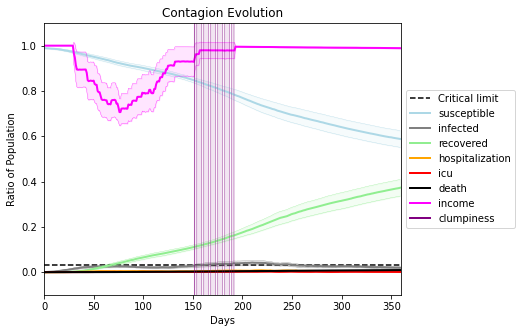

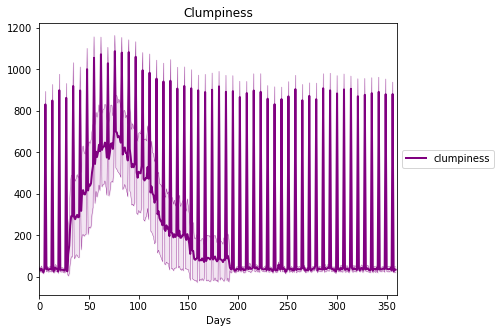

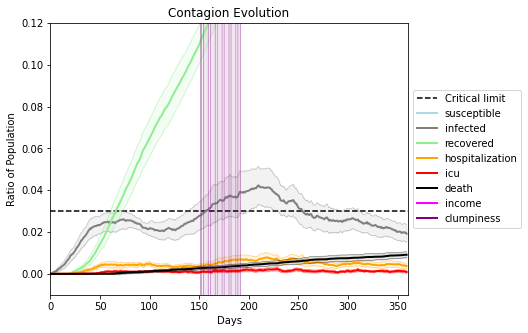

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)